In [1]:
import pandas as pd
import os

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import datetime 

In [3]:
import statistics
import warnings

In [4]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

In [5]:
from sklearn.model_selection import train_test_split

In [6]:
from scipy.fft import fft, fftfreq
from scipy.stats import linregress
from scipy import stats

In [7]:
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import kpss
from statsmodels.tsa.seasonal import seasonal_decompose

In [8]:
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

In [9]:
from sklearn.metrics import mean_squared_error

In [10]:
warnings.filterwarnings('ignore')

In [11]:
import seaborn as sns

In [12]:
#pip uninstall tensorflow

In [13]:
#pip install tensorflow==2.10.0

In [14]:
#pip install tensorflow

In [15]:
!jupyter --version

Selected Jupyter core packages...
IPython          : 8.10.0
ipykernel        : 6.19.2
ipywidgets       : 7.6.5
jupyter_client   : 7.3.4
jupyter_core     : 5.2.0
jupyter_server   : 1.23.4
jupyterlab       : 3.5.3
nbclient         : 0.5.13
nbconvert        : 6.5.4
nbformat         : 5.7.0
notebook         : 6.5.2
qtconsole        : 5.4.0
traitlets        : 5.7.1


In [16]:
import tensorflow as tf
import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Bidirectional

In [17]:
tf.config.list_physical_devices('GPU')

[]

In [18]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  0


In [19]:
#tf.debugging.set_log_device_placement(True)

In [20]:
#Változónevek: 
#Vilagossz = a teljes adatforrás, 599 sorral 12+1 oszloppal
#Vilago = Vilagossz, de csak az utolso 241 bejegyzés (Utolsó 20 év + 1 bejegyzés a differenciálás miatt)
#Vilagkorr = Vilago korrelációja
#Vilagoadf = adf vizsgálathoz alakítva a Vilago forrás
#Vilagoo = Vilago - 24 hónap, ez az arimához kell, 12 hónap teszt 12 hónap validáció
#Vilagoonorm = Vilagoo normalizalt
#Vilagonorm = Vilago Normalizalt
#Vilagooscaled = Vilagoo Normalizalt
#Vilagoscaled = Vilagoo Normalizalt
#diffes = differenciált
#diftransz = differenciált és köbgyökvont
#diftran = diftransz - az első nan érték
#diftrapd = 
#vilagvalid =a validációs év

# Adatelőkészítés

In [21]:
ldir = os.chdir(r'C:\Users\Admin\Downloads\archive\Energy Statistics')

In [22]:
Vilagossz = pd.read_csv('World Energy Overview.csv')
pd.to_datetime(Vilagossz['Date'], format ='%Y-%m-%d')

0     1973-01-31
1     1973-02-28
2     1973-03-31
3     1973-04-30
4     1973-05-31
         ...    
594   2022-07-31
595   2022-08-31
596   2022-09-30
597   2022-10-31
598   2022-11-30
Name: Date, Length: 599, dtype: datetime64[ns]

In [23]:
Vilagossz 

,Date,Total Fossil Fuels Production,Nuclear Electric Power Production,Total Renewable Energy Production,Total Primary Energy Production,Primary Energy Imports,Primary Energy Exports,Primary Energy Net Imports,Primary Energy Stock Change and Other,Total Fossil Fuels Consumption,Nuclear Electric Power Consumption,Total Renewable Energy Consumption,Total Primary Energy Consumption
0,1973-01-31,4.932632,0.068103,0.403981,5.404715,1.173080,0.125781,1.047299,0.771858,6.747651,0.068103,0.403981,7.223873
1,1973-02-28,4.729582,0.064634,0.360900,5.155115,1.168005,0.120883,1.047122,0.390129,6.163095,0.064634,0.360900,6.592366
2,1973-03-31,4.946902,0.072494,0.400161,5.419556,1.309473,0.139950,1.169523,-0.067640,6.044647,0.072494,0.400161,6.521439
3,1973-04-30,4.716271,0.064070,0.380470,5.160812,1.085169,0.194185,0.890984,-0.110067,5.493184,0.064070,0.380470,5.941729
4,1973-05-31,4.956995,0.062111,0.392141,5.411246,1.162804,0.196775,0.966029,-0.305335,5.613551,0.062111,0.392141,6.071940
...,...,...,...,...,...,...,...,...,...,...,...,...,...
594,2022-07-31,6.921426,0.718109,1.132400,8.771935,1.907862,2.294320,-0.386458,0.199327,6.736891,0.718109,1.111161,8.584805
595,2022-08-31,7.047525,0.718526,1.044026,8.810077,1.821828,2.327090,-0.505262,0.225628,6.755154,0.718526,1.036589,8.530444
596,2022-09-30,6.915201,0.664673,0.978647,8.558521,1.702048,2.219831,-0.517784,-0.257997,6.144280,0.664673,0.960694,7.782741
597,2022-10-31,7.126618,0.614741,1.019209,8.760568,1.767733,2.322475,-0.554743,-0.394651,6.179721,0.614741,1.006859,7.811175


In [24]:
#Van e null érték
Vilagossz.isnull().sum()

Date                                     0
Total Fossil Fuels Production            0
Nuclear Electric Power Production        0
Total Renewable Energy Production        0
Total Primary Energy Production          0
Primary Energy Imports                   0
Primary Energy Exports                   0
Primary Energy Net Imports               0
Primary Energy Stock Change and Other    0
Total Fossil Fuels Consumption           0
Nuclear Electric Power Consumption       0
Total Renewable Energy Consumption       0
Total Primary Energy Consumption         0
dtype: int64

In [25]:
#van e nan érték
Vilagossz.isna().sum()

Date                                     0
Total Fossil Fuels Production            0
Nuclear Electric Power Production        0
Total Renewable Energy Production        0
Total Primary Energy Production          0
Primary Energy Imports                   0
Primary Energy Exports                   0
Primary Energy Net Imports               0
Primary Energy Stock Change and Other    0
Total Fossil Fuels Consumption           0
Nuclear Electric Power Consumption       0
Total Renewable Energy Consumption       0
Total Primary Energy Consumption         0
dtype: int64

In [26]:
#Általános tudnivalók az adathalmazról
Vilagossz.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 599 entries, 0 to 598
Data columns (total 13 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   Date                                   599 non-null    object 
 1   Total Fossil Fuels Production          599 non-null    float64
 2   Nuclear Electric Power Production      599 non-null    float64
 3   Total Renewable Energy Production      599 non-null    float64
 4   Total Primary Energy Production        599 non-null    float64
 5   Primary Energy Imports                 599 non-null    float64
 6   Primary Energy Exports                 599 non-null    float64
 7   Primary Energy Net Imports             599 non-null    float64
 8   Primary Energy Stock Change and Other  599 non-null    float64
 9   Total Fossil Fuels Consumption         599 non-null    float64
 10  Nuclear Electric Power Consumption     599 non-null    float64
 11  Total 

In [27]:
#leíró statisztikák
Vilagossz.describe()

,Total Fossil Fuels Production,Nuclear Electric Power Production,Total Renewable Energy Production,Total Primary Energy Production,Primary Energy Imports,Primary Energy Exports,Primary Energy Net Imports,Primary Energy Stock Change and Other,Total Fossil Fuels Consumption,Nuclear Electric Power Consumption,Total Renewable Energy Consumption,Total Primary Energy Consumption
count,599.000000,599.000000,599.000000,599.000000,599.000000,599.000000,599.000000,599.000000,599.000000,599.000000,599.000000,599.000000
mean,5.034634,0.519567,0.593709,6.147909,1.873459,0.611704,1.261755,0.031835,6.321391,0.519567,0.591620,7.441499
std,0.610126,0.202697,0.193351,0.895076,0.561286,0.544532,0.724907,0.476652,0.708356,0.202697,0.189229,0.946882
min,3.676065,0.062111,0.304328,4.306800,0.710558,0.056798,-0.554743,-0.894627,4.783910,0.062111,0.304328,5.435627
25%,4.683559,0.328635,0.467414,5.590289,1.447091,0.310775,0.856081,-0.327821,5.798086,0.328635,0.467414,6.659050
50%,4.831601,0.594293,0.527479,5.906173,1.848642,0.373346,1.200957,-0.081028,6.338503,0.594293,0.527257,7.617372
75%,5.087384,0.681056,0.685252,6.290192,2.281205,0.680119,1.759529,0.324711,6.789340,0.681056,0.683567,8.111785
max,7.126618,0.780456,1.218790,8.810077,3.149640,2.386337,2.741692,1.551345,8.096323,0.780456,1.199383,9.664299


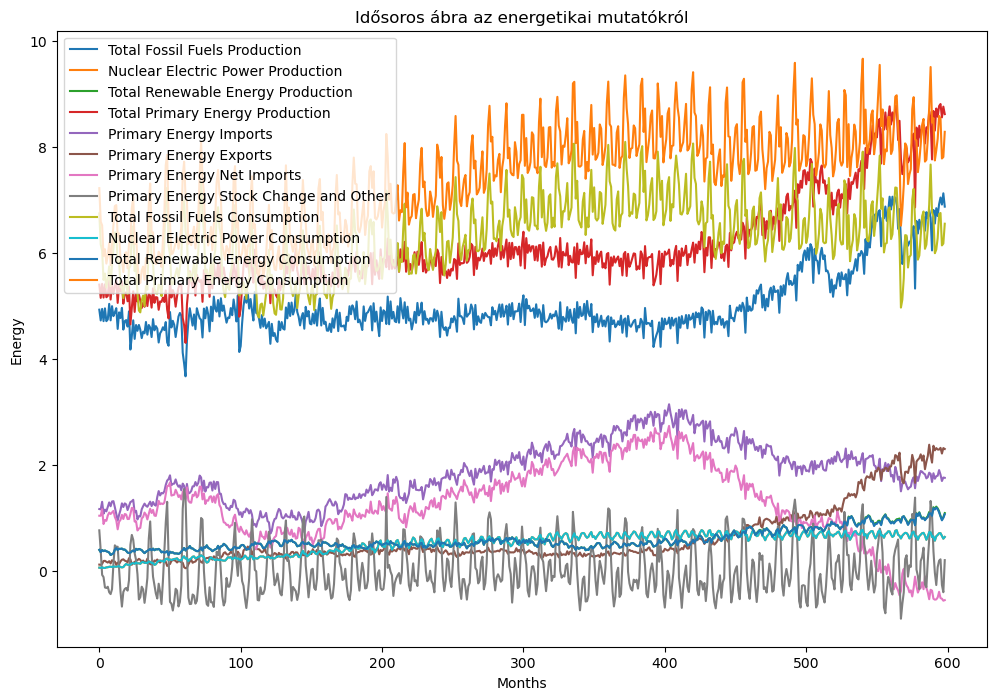

In [28]:
#Vilagossz.set_index('Date', inplace=True)
Vilagossz[Vilagossz.columns].plot(figsize=(12,8))

plt.title('Idősoros ábra az energetikai mutatókról')
plt.xlabel('Months')
plt.ylabel('Energy')

plt.show()

In [29]:
#Vilagoo=Vilagoo.set_index('Date')

In [30]:
Vilagoo[['Total Fossil Fuels Production','Total Fossil Fuels Consumption']].plot(figsize=(8,6))
plt.title('Idősoros ábra az a fosszilis energia előállításáról és fogyasztásáról')
plt.xlabel('Months')
plt.ylabel('Energy')

plt.show()

NameError: name 'Vilagoo' is not defined

In [31]:
Vilagoo[['Total Fossil Fuels Production','Total Renewable Energy Production']].plot(figsize=(8,6))
plt.title('Idősoros ábra az a fosszilis energia előállításáról és megújuló energia előállításra')
plt.xlabel('Months')
plt.ylabel('Energy')

plt.show()

NameError: name 'Vilagoo' is not defined

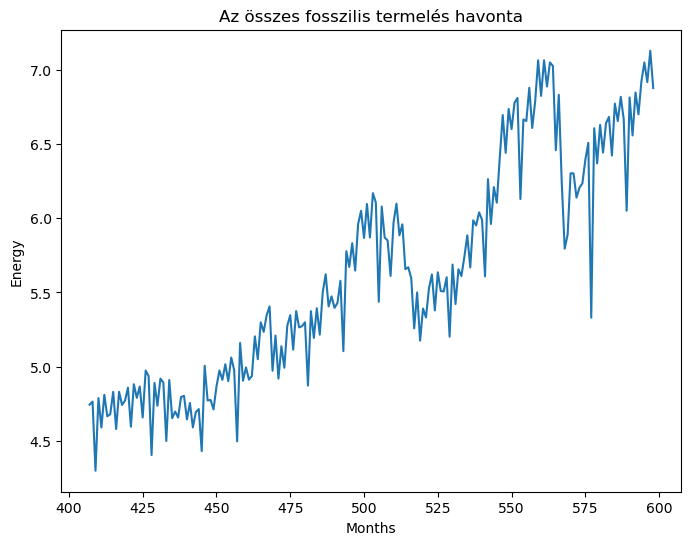

In [32]:
Vilagossz['Total Fossil Fuels Production'].iloc[-192:].plot(figsize=(8,6))

plt.title('Az összes fosszilis termelés havonta')
plt.xlabel('Months')
plt.ylabel('Energy')

plt.show()

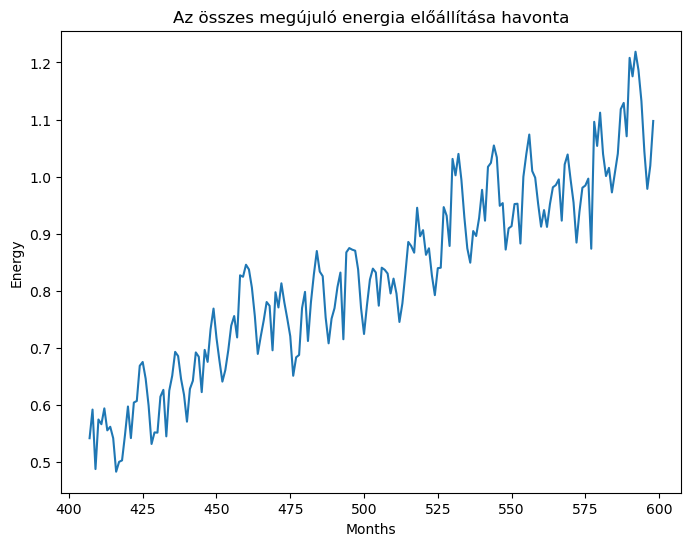

In [33]:
Vilagossz['Total Renewable Energy Production'].iloc[-192:].plot(figsize=(8,6))

plt.title('Az összes megújuló energia előállítása havonta')
plt.xlabel('Months')
plt.ylabel('Energy')

plt.show()

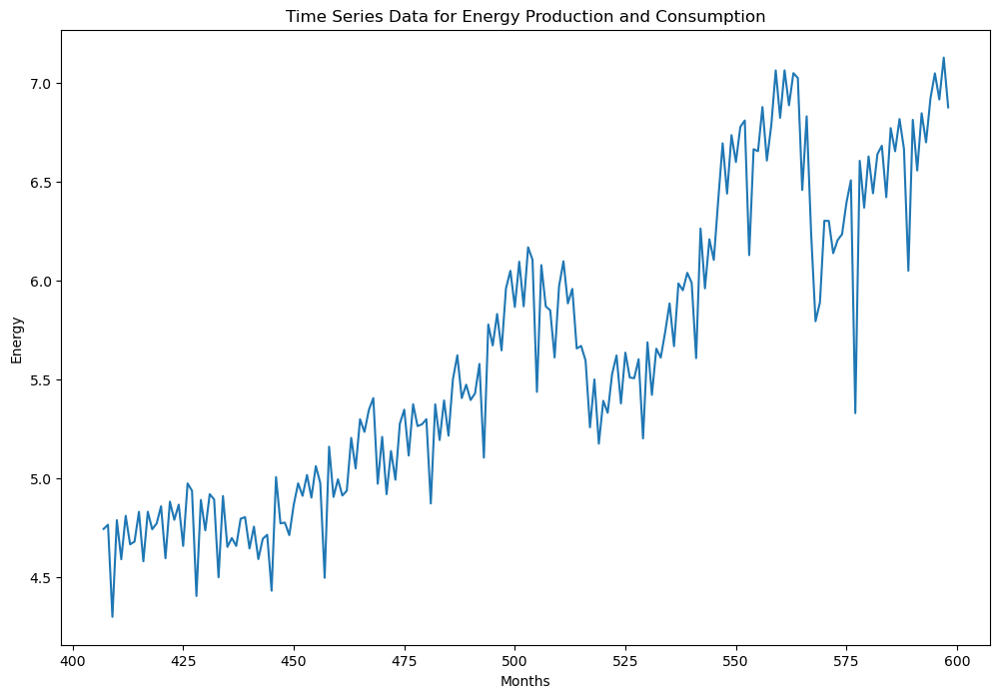

In [34]:
Vilagossz['Total Fossil Fuels Production'].iloc[-192:].plot(figsize=(12,8))

plt.title('Time Series Data for Energy Production and Consumption')
plt.xlabel('Months')
plt.ylabel('Energy')

plt.show()

In [35]:
Vilago = Vilagossz.iloc[-193:]
Vilago

,Date,Total Fossil Fuels Production,Nuclear Electric Power Production,Total Renewable Energy Production,Total Primary Energy Production,Primary Energy Imports,Primary Energy Exports,Primary Energy Net Imports,Primary Energy Stock Change and Other,Total Fossil Fuels Consumption,Nuclear Electric Power Consumption,Total Renewable Energy Consumption,Total Primary Energy Consumption
406,2006-11-30,4.631319,0.640629,0.515816,5.787764,2.711032,0.423896,2.287135,-0.046576,6.862516,0.640629,0.522590,8.028324
407,2006-12-31,4.744882,0.735560,0.542022,6.022463,2.794248,0.383833,2.410416,0.360415,7.501847,0.735560,0.548344,8.793294
408,2007-01-31,4.766295,0.776251,0.592181,6.134727,2.981632,0.434676,2.546956,0.536106,7.838025,0.776251,0.597023,9.217789
409,2007-02-28,4.300942,0.684143,0.488023,5.473109,2.461838,0.339708,2.122130,1.155593,7.566001,0.684143,0.491007,8.750832
410,2007-03-31,4.789460,0.674497,0.574791,6.038748,3.044348,0.410738,2.633610,-0.117210,7.297420,0.674497,0.577080,8.555148
...,...,...,...,...,...,...,...,...,...,...,...,...,...
594,2022-07-31,6.921426,0.718109,1.132400,8.771935,1.907862,2.294320,-0.386458,0.199327,6.736891,0.718109,1.111161,8.584805
595,2022-08-31,7.047525,0.718526,1.044026,8.810077,1.821828,2.327090,-0.505262,0.225628,6.755154,0.718526,1.036589,8.530444
596,2022-09-30,6.915201,0.664673,0.978647,8.558521,1.702048,2.219831,-0.517784,-0.257997,6.144280,0.664673,0.960694,7.782741
597,2022-10-31,7.126618,0.614741,1.019209,8.760568,1.767733,2.322475,-0.554743,-0.394651,6.179721,0.614741,1.006859,7.811175


In [36]:
#Vilago.set_index('Date', inplace=True)

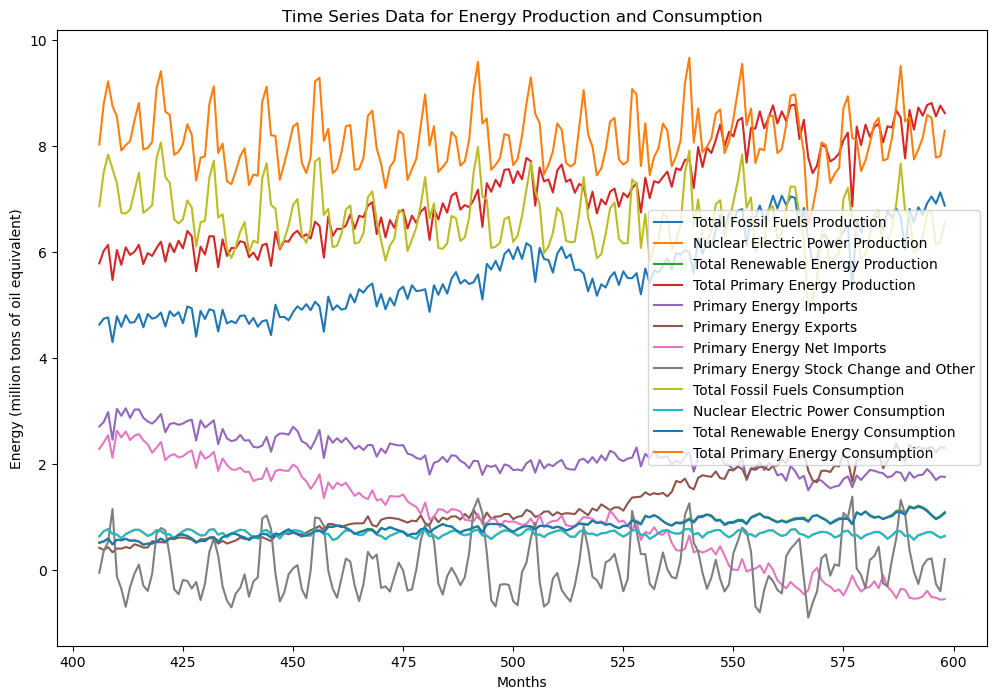

In [37]:
#Vilagossz.set_index('Date', inplace=True)
Vilago[Vilago.columns].plot(figsize=(12,8))

plt.title('Time Series Data for Energy Production and Consumption')
plt.xlabel('Months')
plt.ylabel('Energy (million tons of oil equivalent)')

plt.show()

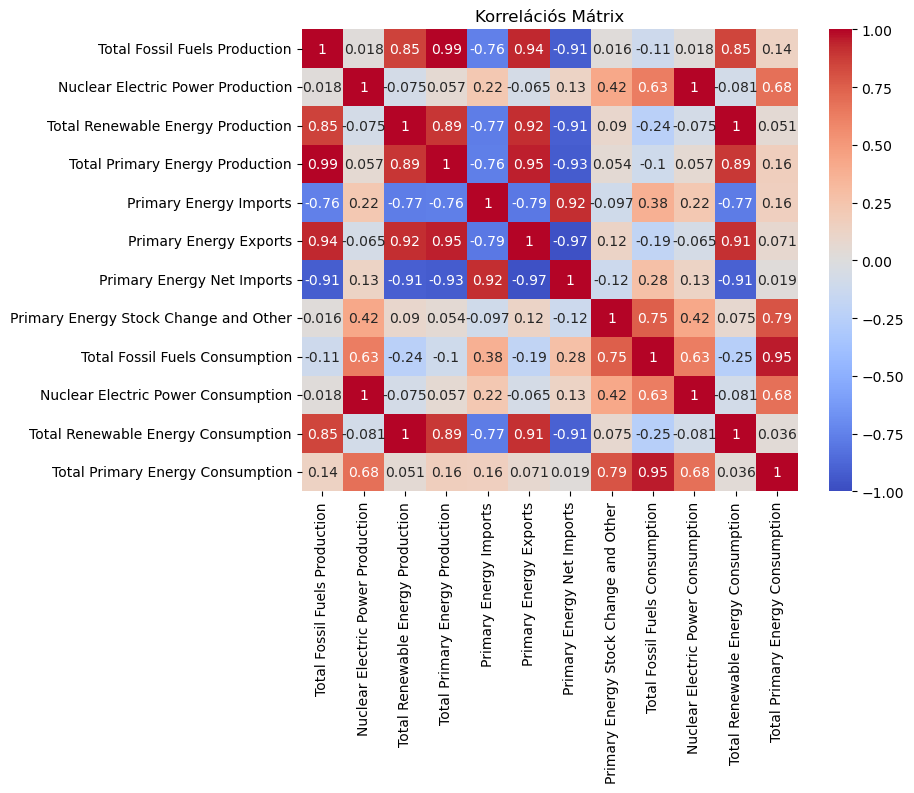

In [38]:
#korreláció vizsgálat
Vilagkorr=Vilago.drop('Date',axis=1).corr()
plt.figure(figsize=(8, 6))
sns.heatmap(Vilagkorr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("Korrelációs Mátrix")
plt.show()

In [39]:
Vilagkorr=Vilagoo[['Total Fossil Fuels Production','Total Renewable Energy Production']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(Vilagkorr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("Korrelációs Mátrix")
plt.show()

NameError: name 'Vilagoo' is not defined

In [40]:
kimentos=Vilago.describe(include='all')

In [41]:
kimentos

,Date,Total Fossil Fuels Production,Nuclear Electric Power Production,Total Renewable Energy Production,Total Primary Energy Production,Primary Energy Imports,Primary Energy Exports,Primary Energy Net Imports,Primary Energy Stock Change and Other,Total Fossil Fuels Consumption,Nuclear Electric Power Consumption,Total Renewable Energy Consumption,Total Primary Energy Consumption
count,193,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000
unique,193,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,2006-11-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,5.617313,0.692894,0.824471,7.134678,2.175290,1.228287,0.947003,0.058052,6.616428,0.692894,0.817693,8.139734
std,NaN,0.749337,0.050943,0.167026,0.897361,0.360430,0.587137,0.899632,0.500861,0.544725,0.050943,0.161655,0.560917
min,NaN,4.300942,0.570783,0.483353,5.473109,1.507487,0.339708,-0.554743,-0.894627,4.971870,0.570783,0.482390,6.516376
25%,NaN,4.920737,0.658367,0.695961,6.334980,1.899391,0.753172,0.131721,-0.311600,6.189718,0.658367,0.689455,7.724107
50%,NaN,5.506708,0.687698,0.830355,7.110887,2.114327,1.053589,0.936845,-0.058512,6.617114,0.687698,0.826800,8.063531
75%,NaN,6.204600,0.737537,0.952043,7.783309,2.403862,1.774731,1.680187,0.334034,6.899031,0.737537,0.936539,8.515059


In [42]:
kimentos.to_excel('describe.xlsx', sheet_name='describe')

In [43]:
print("Skewness \n",Vilago.skew())
print("Kurtosis \n",Vilago.kurt())
print("Variance \n",Vilago.var())

Skewness 
 Total Fossil Fuels Production            0.331205
Nuclear Electric Power Production       -0.227237
Total Renewable Energy Production       -0.007656
Total Primary Energy Production          0.239598
Primary Energy Imports                   0.576105
Primary Energy Exports                   0.442357
Primary Energy Net Imports              -0.036851
Primary Energy Stock Change and Other    0.701418
Total Fossil Fuels Consumption           0.371992
Nuclear Electric Power Consumption      -0.227237
Total Renewable Energy Consumption      -0.024828
Total Primary Energy Consumption         0.416066
dtype: float64
Kurtosis 
 Total Fossil Fuels Production           -1.067939
Nuclear Electric Power Production       -0.725791
Total Renewable Energy Production       -0.675904
Total Primary Energy Production         -1.094741
Primary Energy Imports                  -0.394594
Primary Energy Exports                  -1.109810
Primary Energy Net Imports              -1.028199
Primary Energ

In [44]:
#trend ellenőrzése augmentált dickey fouler teszttel
print("Az egész időszakban időszakban")
Vilagoadf= Vilagossz.drop(['Date'], axis=1)
Vilagoadfnev = Vilagoadf.columns
for i in range(len(Vilagoadfnev)):
    print(Vilagoadfnev[i])
# ADF teszt elvégzése
    result = adfuller(Vilagoadf.iloc[:,i], autolag='AIC')

# Eredmény kiértékelése
    adf_statistic = result[0]
    p_value = result[1]
    critical_values = result[4]

    print(f'ADF statisztika: {adf_statistic}')
    print(f'p-érték: {p_value}')
    print('Kritikus értékek:')
    for key, value in critical_values.items():
        print(f'{key}: {value}')
    print("\n")
    if p_value<0.05:
        print("Stacionárius")
    elif p_value>0.05 and p_value<=0.10:
        print("Kisebb szignifikancán stacionárius lehet")
    else:
        print('Nem stacionárius, megfigyelhető valamilyen trend')
    for i in range(20):
        print('-', end =" ")
    
    print("\n")

Az egész időszakban időszakban
Total Fossil Fuels Production
ADF statisztika: 0.6186111918948557
p-érték: 0.988065491676307
Kritikus értékek:
1%: -3.4416749612171467
5%: -2.8665360672844318
10%: -2.5694307639714626


Nem stacionárius, megfigyelhető valamilyen trend
- - - - - - - - - - - - - - - - - - - - 

Nuclear Electric Power Production
ADF statisztika: -3.372789817827124
p-érték: 0.01192218672167132
Kritikus értékek:
1%: -3.441635870156286
5%: -2.866518854162241
10%: -2.569421591856497


Stacionárius
- - - - - - - - - - - - - - - - - - - - 

Total Renewable Energy Production
ADF statisztika: 1.4414664510811905
p-érték: 0.9972946112835633
Kritikus értékek:
1%: -3.4416553818946145
5%: -2.8665274458710064
10%: -2.5694261699959413


Nem stacionárius, megfigyelhető valamilyen trend
- - - - - - - - - - - - - - - - - - - - 

Total Primary Energy Production
ADF statisztika: 0.9353358021996873
p-érték: 0.9935345678747359
Kritikus értékek:
1%: -3.4415777369651717
5%: -2.866493255736561
10%: 

In [45]:
#trend ellenőrzése augmentált dickey fouler teszttel
print("A modellezett időszakban")
Vilagoadf= Vilago.drop(['Date'], axis=1)
Vilagoadfnev = Vilagoadf.columns
for i in range(len(Vilagoadfnev)):
    print(Vilagoadfnev[i])
# ADF teszt elvégzése
    result = adfuller(Vilagoadf.iloc[:,i], autolag='AIC')

# Eredmény kiértékelése
    adf_statistic = result[0]
    p_value = result[1]
    critical_values = result[4]

    print(f'ADF statisztika: {adf_statistic}')
    print(f'p-érték: {p_value}')
    print('Kritikus értékek:')
    for key, value in critical_values.items():
        print(f'{key}: {value}')
    print("\n")
    if p_value<0.05:
        print("Stacionárius")
    elif p_value>0.05 and p_value<=0.10:
        print("Kisebb szignifikancán stacionárius lehet")
    else:
        print('Nem stacionárius, megfigyelhető valamilyen trend')
    for i in range(20):
        print('-', end =" ")
    
    print("\n")

A modellezett időszakban
Total Fossil Fuels Production
ADF statisztika: -0.5588020834354626
p-érték: 0.8800220249471385
Kritikus értékek:
1%: -3.4674201432469816
5%: -2.877826051844538
10%: -2.575452082332012


Nem stacionárius, megfigyelhető valamilyen trend
- - - - - - - - - - - - - - - - - - - - 

Nuclear Electric Power Production
ADF statisztika: -1.7442524629261469
p-érték: 0.40846847231562267
Kritikus értékek:
1%: -3.467845319799907
5%: -2.878011745497439
10%: -2.575551186759871


Nem stacionárius, megfigyelhető valamilyen trend
- - - - - - - - - - - - - - - - - - - - 

Total Renewable Energy Production
ADF statisztika: -0.6831506430528765
p-érték: 0.8510657625197804
Kritikus értékek:
1%: -3.467845319799907
5%: -2.878011745497439
10%: -2.575551186759871


Nem stacionárius, megfigyelhető valamilyen trend
- - - - - - - - - - - - - - - - - - - - 

Total Primary Energy Production
ADF statisztika: -0.6468198440191256
p-érték: 0.8600479246857069
Kritikus értékek:
1%: -3.4672111510631
5

In [46]:
#Ciklikusság ellenőrzése Fourier vizsgálattal az utolsó 16 évre
vilagfornev = Vilago.columns
for i in range(12):
    print(vilagfornev[i+1],": ", end="")
# Idősor adatok kinyerése
    time = np.array(Vilago['Date'])
    signal = np.array(Vilago.iloc[:,i+1])

# Fourier-transzformáció
    fft_values = fft(signal)
    power_spectrum = np.abs(fft_values) ** 2
    frequencies = fftfreq(len(signal))

# Fourier-teszt
    slope, intercept, _, _, _ = linregress(frequencies, power_spectrum)
    if slope < 0:
        result = 'Ciklikus minta'
    else:
        result = 'Nincs ciklikus minta'
    print(result)

Total Fossil Fuels Production : Nincs ciklikus minta
Nuclear Electric Power Production : Ciklikus minta
Total Renewable Energy Production : Ciklikus minta
Total Primary Energy Production : Nincs ciklikus minta
Primary Energy Imports : Nincs ciklikus minta
Primary Energy Exports : Nincs ciklikus minta
Primary Energy Net Imports : Ciklikus minta
Primary Energy Stock Change and Other : Nincs ciklikus minta
Total Fossil Fuels Consumption : Nincs ciklikus minta
Nuclear Electric Power Consumption : Ciklikus minta
Total Renewable Energy Consumption : Ciklikus minta
Total Primary Energy Consumption : Nincs ciklikus minta


In [47]:
vilagfornev

Index(['Date', 'Total Fossil Fuels Production',
       'Nuclear Electric Power Production',
       'Total Renewable Energy Production', 'Total Primary Energy Production',
       'Primary Energy Imports', 'Primary Energy Exports',
       'Primary Energy Net Imports', 'Primary Energy Stock Change and Other',
       'Total Fossil Fuels Consumption', 'Nuclear Electric Power Consumption',
       'Total Renewable Energy Consumption',
       'Total Primary Energy Consumption'],
      dtype='object')

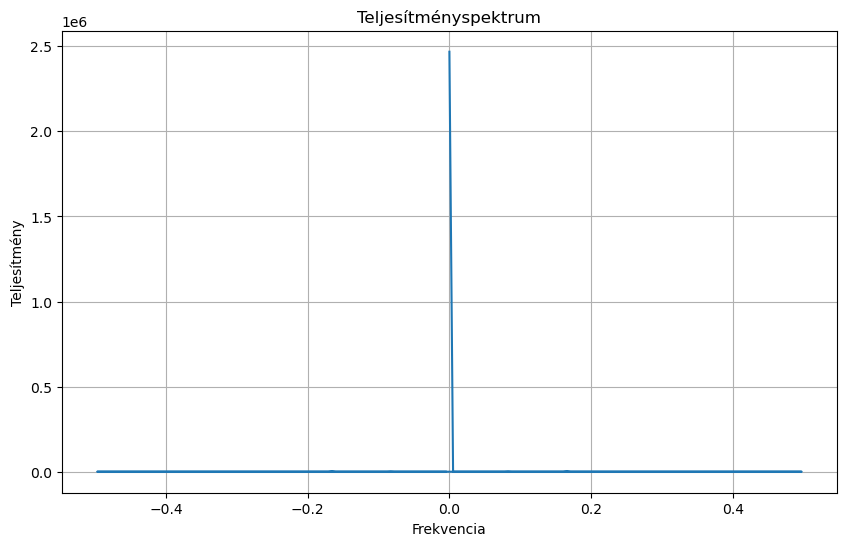

In [48]:
# Teljesítményspektrum ábrázolása
plt.figure(figsize=(10, 6))
plt.plot(frequencies, power_spectrum)
plt.title('Teljesítményspektrum')
plt.xlabel('Frekvencia')
plt.ylabel('Teljesítmény')
plt.grid(True)
plt.show()

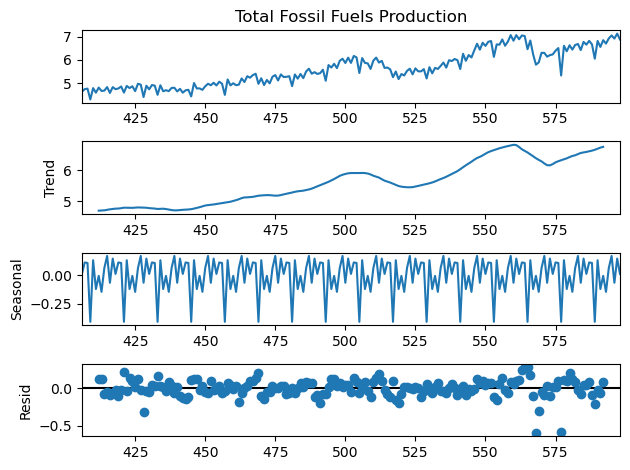

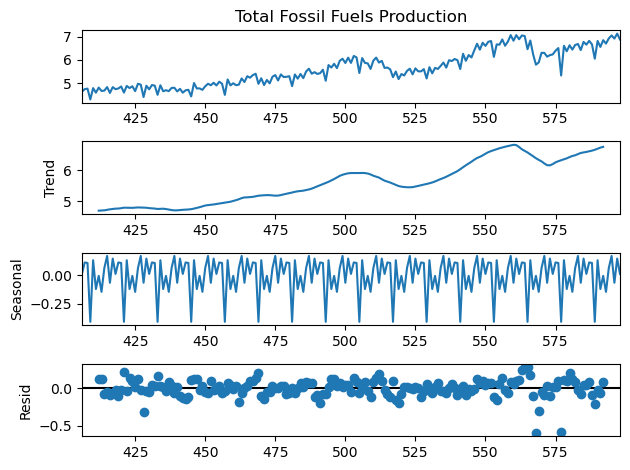

In [49]:
# Idősor dekompozíció
result = seasonal_decompose(Vilago['Total Fossil Fuels Production'], model='additive', period=12)
result.plot()

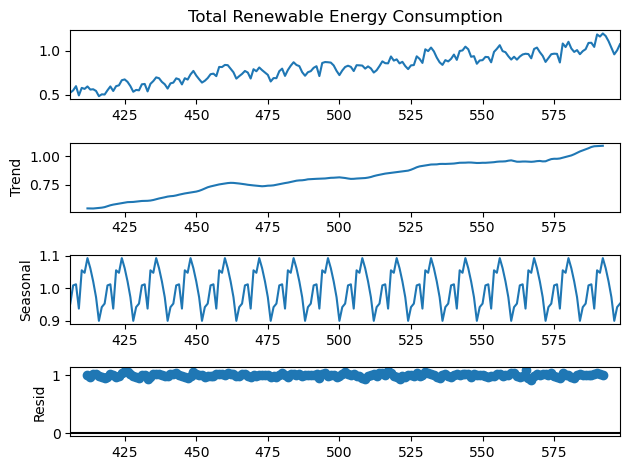

In [50]:
result = seasonal_decompose(Vilago['Total Renewable Energy Consumption'], model='multiplicative', period=12)
result.plot();

In [51]:
var1,var2=Vilagossz['Total Fossil Fuels Production'],Vilagossz['Total Renewable Energy Production']
var1x,var1y=Vilago['Total Fossil Fuels Production'],Vilago['Total Renewable Energy Production']

In [54]:
#var1normx = range_scaler.fit_transform(np.array(Vilago[['Total Fossil Fuels Production']]))
#var1normy = range_scaler.fit_transform(np.array(Vilago[['Total Renewable Energy Production']]))
#var1normx = pd.Series([item for sublist in var1normx for item in sublist])
#var1normy = pd.Series([item for sublist in var1normy for item in sublist])

In [56]:
var1 = var1.diff()
var2 = var2.diff()
var1x = var1x.diff()
var1y = var1y.diff()
#var1normx =var1normx.diff()
#var1normy = var1normy.diff()

# Átlagos növekedési sebesség számítása
print("Az egész időszakban")
átlagos_növekedés_1 = var1.mean()
összes_növekedés_1=var1.sum()
átlagos_növekedés_2 = var2.mean()
összes_növekedés_2=var2.sum()
print("Átlagos növekedés fosszilis: ",átlagos_növekedés_1)
print("Átlagos növekedés megújuló: ",átlagos_növekedés_2)
print("Összes változás fosszilis: ",összes_növekedés_1)
print("Összes változás megújúló: ",összes_növekedés_2)
if átlagos_növekedés_1 > átlagos_növekedés_2:
    print('Változó A nagyobb ütemben növekszik.')
else:
    print('Változó B nagyobb ütemben növekszik.')

print("A modellezett időszakban")
átlagos_növekedés_1 = var1x.mean()
összes_növekedés_1=var1x.sum()
átlagos_növekedés_2 = var1y.mean()
összes_növekedés_2=var1y.sum()
print("Átlagos növekedés fosszilis: ",átlagos_növekedés_1)
print("Átlagos növekedés megújuló: ",átlagos_növekedés_2)
print("Összes változás fosszilis: ",összes_növekedés_1)
print("Összes változás megújúló: ",összes_növekedés_2)
if átlagos_növekedés_1 > átlagos_növekedés_2:
    print('Változó A nagyobb ütemben növekszik.')
else:
    print('Változó B nagyobb ütemben növekszik.')
    
#print("A modellezett időszakban normalizálva")
#átlagos_növekedés_1 = var1normx.mean()
#összes_növekedés_1=var1normx.sum()
#átlagos_növekedés_2 = var1normy.mean()
#összes_növekedés_2=var1normy.sum()
#print("Átlagos növekedés fosszilis: ",átlagos_növekedés_1)
#print("Átlagos növekedés megújuló: ",átlagos_növekedés_2)
#print("Összes változás fosszilis: ",összes_növekedés_1)
#print("Összes változás megújúló: ",összes_növekedés_2)
#if átlagos_növekedés_1 > átlagos_növekedés_2:
    #print('Változó A nagyobb ütemben növekszik.')
#else:
    #print('Változó B nagyobb ütemben növekszik.')


Az egész időszakban
Átlagos növekedés fosszilis:  -0.0014816057046979864
Átlagos növekedés megújuló:  -7.482214765100713e-05
Összes változás fosszilis:  -0.8830369999999998
Összes változás megújúló:  -0.044594000000000245
Változó B nagyobb ütemben növekszik.
A modellezett időszakban
Átlagos növekedés fosszilis:  -0.001950089473684208
Átlagos növekedés megújuló:  7.260526315789474e-05
Összes változás fosszilis:  -0.37051699999999954
Összes változás megújúló:  0.013795000000000002
Változó B nagyobb ütemben növekszik.


# Transzformációk

## Normalizálás

In [57]:
Vilagoo= Vilago[:-48]

In [58]:
Vilagoo

,Date,Total Fossil Fuels Production,Nuclear Electric Power Production,Total Renewable Energy Production,Total Primary Energy Production,Primary Energy Imports,Primary Energy Exports,Primary Energy Net Imports,Primary Energy Stock Change and Other,Total Fossil Fuels Consumption,Nuclear Electric Power Consumption,Total Renewable Energy Consumption,Total Primary Energy Consumption
406,2006-11-30,4.631319,0.640629,0.515816,5.787764,2.711032,0.423896,2.287135,-0.046576,6.862516,0.640629,0.522590,8.028324
407,2006-12-31,4.744882,0.735560,0.542022,6.022463,2.794248,0.383833,2.410416,0.360415,7.501847,0.735560,0.548344,8.793294
408,2007-01-31,4.766295,0.776251,0.592181,6.134727,2.981632,0.434676,2.546956,0.536106,7.838025,0.776251,0.597023,9.217789
409,2007-02-28,4.300942,0.684143,0.488023,5.473109,2.461838,0.339708,2.122130,1.155593,7.566001,0.684143,0.491007,8.750832
410,2007-03-31,4.789460,0.674497,0.574791,6.038748,3.044348,0.410738,2.633610,-0.117210,7.297420,0.674497,0.577080,8.555148
...,...,...,...,...,...,...,...,...,...,...,...,...,...
546,2018-07-31,6.406754,0.757528,0.948984,8.113266,2.161450,1.863194,0.298256,0.198555,6.904313,0.757528,0.933103,8.610077
547,2018-08-31,6.693918,0.755713,0.953714,8.403345,2.191516,1.737064,0.454452,-0.168194,6.977060,0.755713,0.939764,8.689603
548,2018-09-30,6.439581,0.676697,0.872342,7.988620,1.998803,1.723356,0.275447,-0.400679,6.322819,0.676697,0.852988,7.863388
549,2018-10-31,6.734886,0.620995,0.909450,8.265331,1.981975,1.893627,0.088348,-0.267908,6.564261,0.620995,0.890844,8.085771


In [59]:
adatok=Vilagoo['Total Fossil Fuels Production'].tolist()
adatok_rend = Vilagoo['Total Fossil Fuels Production'].iloc[1:].tolist()
adatok_full=Vilago['Total Fossil Fuels Production'].iloc[1:].tolist()

In [60]:
adatok_full

[4.744882,
 4.766295,
 4.300942,
 4.78946,
 4.591832,
 4.811407,
 4.66717,
 4.680978,
 4.831601,
 4.581483,
 4.831938,
 4.743522,
 4.772485,
 4.859584,
 4.596865,
 4.88269,
 4.79135,
 4.867863,
 4.659152,
 4.975041,
 4.937988,
 4.40615,
 4.891401,
 4.738032,
 4.920737,
 4.894487,
 4.501076,
 4.911425,
 4.654185,
 4.699176,
 4.659088,
 4.796858,
 4.804587,
 4.646178,
 4.756574,
 4.592522,
 4.695395,
 4.715521,
 4.432809,
 5.007242,
 4.77354,
 4.776965,
 4.713787,
 4.867467,
 4.975638,
 4.912295,
 5.017727,
 4.903486,
 5.062813,
 4.977779,
 4.498148,
 5.160762,
 4.906942,
 4.996022,
 4.913867,
 4.937955,
 5.205101,
 5.051033,
 5.299419,
 5.235448,
 5.347022,
 5.406309,
 4.97344,
 5.210542,
 4.920631,
 5.138538,
 4.993785,
 5.277106,
 5.347837,
 5.115761,
 5.375267,
 5.264784,
 5.273745,
 5.299858,
 4.873636,
 5.374701,
 5.194314,
 5.39429,
 5.216461,
 5.501214,
 5.622376,
 5.406128,
 5.4739,
 5.396623,
 5.430086,
 5.578825,
 5.1054,
 5.778049,
 5.672104,
 5.831354,
 5.647544,
 5.960544,


In [61]:
z_score_scaler = StandardScaler()
Vilagoonorm = z_score_scaler.fit_transform(np.array(Vilagoo[['Total Fossil Fuels Production']]))
Vilagonorm = z_score_scaler.fit_transform(np.array(Vilago[['Total Fossil Fuels Production']]))
print("\nZ-score normalizáció:")
print(Vilagoonorm)


Z-score normalizáció:
[[-1.25118219]
 [-1.03707207]
 [-0.9967003 ]
 [-1.87407041]
 [-0.95302533]
 [-1.32563043]
 [-0.91164676]
 [-1.18358921]
 [-1.15755579]
 [-0.87357327]
 [-1.34514229]
 [-0.8729379 ]
 [-1.0396362 ]
 [-0.98502976]
 [-0.82081451]
 [-1.31614128]
 [-0.77725078]
 [-0.94946195]
 [-0.8052054 ]
 [-1.19870623]
 [-0.60313348]
 [-0.67299269]
 [-1.67571271]
 [-0.76082718]
 [-1.04998697]
 [-0.70551749]
 [-0.75500888]
 [-1.49674054]
 [-0.7230742 ]
 [-1.20807094]
 [-1.12324554]
 [-1.1988269 ]
 [-0.93907724]
 [-0.92450509]
 [-1.22316723]
 [-1.01502814]
 [-1.32432951]
 [-1.13037418]
 [-1.0924289 ]
 [-1.6254502 ]
 [-0.54242216]
 [-0.98304068]
 [-0.97658323]
 [-1.09569816]
 [-0.80595201]
 [-0.6020079 ]
 [-0.72143392]
 [-0.52265388]
 [-0.73804229]
 [-0.43764936]
 [-0.59797129]
 [-1.50226095]
 [-0.25297767]
 [-0.73152639]
 [-0.56357619]
 [-0.71847009]
 [-0.67305491]
 [-0.16938153]
 [-0.45985921]
 [ 0.00844432]
 [-0.11216572]
 [ 0.09819436]
 [ 0.20997325]
 [-0.60615198]
 [-0.15912315]
 [

In [62]:
range_scaler = StandardScaler(with_std=False)
Vilagooscaled = range_scaler.fit_transform(np.array(Vilagoo[['Total Fossil Fuels Production']]))
Vilagoscaled = range_scaler.fit_transform(np.array(Vilago[['Total Fossil Fuels Production']]))
print("\nSkálázás:")
print(Vilagooscaled)


Skálázás:
[[-0.66362117]
 [-0.55005817]
 [-0.52864517]
 [-0.99399817]
 [-0.50548017]
 [-0.70310817]
 [-0.48353317]
 [-0.62777017]
 [-0.61396217]
 [-0.46333917]
 [-0.71345717]
 [-0.46300217]
 [-0.55141817]
 [-0.52245517]
 [-0.43535617]
 [-0.69807517]
 [-0.41225017]
 [-0.50359017]
 [-0.42707717]
 [-0.63578817]
 [-0.31989917]
 [-0.35695217]
 [-0.88879017]
 [-0.40353917]
 [-0.55690817]
 [-0.37420317]
 [-0.40045317]
 [-0.79386417]
 [-0.38351517]
 [-0.64075517]
 [-0.59576417]
 [-0.63585217]
 [-0.49808217]
 [-0.49035317]
 [-0.64876217]
 [-0.53836617]
 [-0.70241817]
 [-0.59954517]
 [-0.57941917]
 [-0.86213117]
 [-0.28769817]
 [-0.52140017]
 [-0.51797517]
 [-0.58115317]
 [-0.42747317]
 [-0.31930217]
 [-0.38264517]
 [-0.27721317]
 [-0.39145417]
 [-0.23212717]
 [-0.31716117]
 [-0.79679217]
 [-0.13417817]
 [-0.38799817]
 [-0.29891817]
 [-0.38107317]
 [-0.35698517]
 [-0.08983917]
 [-0.24390717]
 [ 0.00447883]
 [-0.05949217]
 [ 0.05208183]
 [ 0.11136883]
 [-0.32150017]
 [-0.08439817]
 [-0.37430917]

In [63]:
# ADF teszt elvégzése
result = adfuller(Vilagooscaled, autolag='AIC')

# Eredmény kiértékelése
adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

print(f'ADF statisztika: {adf_statistic}')
print(f'p-érték: {p_value}')
print('Kritikus értékek:')
for key, value in critical_values.items():
    print(f'{key}: {value}')
print("\n")
if p_value<0.05:
    print("Stacionárius")
elif p_value>0.05 and p_value<=0.10:
    print("Kisebb szignifikancán stacionárius lehet")
else:
    print('Nem stacionárius, megfigyelhető valamilyen trend')

ADF statisztika: -0.11754695860748786
p-érték: 0.9476624987066556
Kritikus értékek:
1%: -3.4816817173418295
5%: -2.8840418343195267
10%: -2.578770059171598


Nem stacionárius, megfigyelhető valamilyen trend


In [64]:
# ADF teszt elvégzése
result = adfuller(Vilagoonorm, autolag='AIC')

# Eredmény kiértékelése
adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

print(f'ADF statisztika: {adf_statistic}')
print(f'p-érték: {p_value}')
print('Kritikus értékek:')
for key, value in critical_values.items():
    print(f'{key}: {value}')
print("\n")
if p_value<0.05:
    print("Stacionárius")
elif p_value>0.05 and p_value<=0.10:
    print("Kisebb szignifikancán stacionárius lehet")
else:
    print('Nem stacionárius, megfigyelhető valamilyen trend')

ADF statisztika: -0.11754695860747687
p-érték: 0.9476624987066569
Kritikus értékek:
1%: -3.4816817173418295
5%: -2.8840418343195267
10%: -2.578770059171598


Nem stacionárius, megfigyelhető valamilyen trend


In [65]:
flat_list = [item for sublist in Vilagooscaled for item in sublist]

<Axes: >

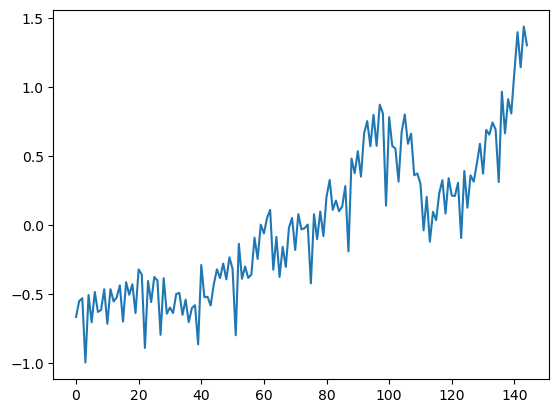

In [66]:
pd.Series(flat_list).plot()

In [67]:
Vilago

,Date,Total Fossil Fuels Production,Nuclear Electric Power Production,Total Renewable Energy Production,Total Primary Energy Production,Primary Energy Imports,Primary Energy Exports,Primary Energy Net Imports,Primary Energy Stock Change and Other,Total Fossil Fuels Consumption,Nuclear Electric Power Consumption,Total Renewable Energy Consumption,Total Primary Energy Consumption
406,2006-11-30,4.631319,0.640629,0.515816,5.787764,2.711032,0.423896,2.287135,-0.046576,6.862516,0.640629,0.522590,8.028324
407,2006-12-31,4.744882,0.735560,0.542022,6.022463,2.794248,0.383833,2.410416,0.360415,7.501847,0.735560,0.548344,8.793294
408,2007-01-31,4.766295,0.776251,0.592181,6.134727,2.981632,0.434676,2.546956,0.536106,7.838025,0.776251,0.597023,9.217789
409,2007-02-28,4.300942,0.684143,0.488023,5.473109,2.461838,0.339708,2.122130,1.155593,7.566001,0.684143,0.491007,8.750832
410,2007-03-31,4.789460,0.674497,0.574791,6.038748,3.044348,0.410738,2.633610,-0.117210,7.297420,0.674497,0.577080,8.555148
...,...,...,...,...,...,...,...,...,...,...,...,...,...
594,2022-07-31,6.921426,0.718109,1.132400,8.771935,1.907862,2.294320,-0.386458,0.199327,6.736891,0.718109,1.111161,8.584805
595,2022-08-31,7.047525,0.718526,1.044026,8.810077,1.821828,2.327090,-0.505262,0.225628,6.755154,0.718526,1.036589,8.530444
596,2022-09-30,6.915201,0.664673,0.978647,8.558521,1.702048,2.219831,-0.517784,-0.257997,6.144280,0.664673,0.960694,7.782741
597,2022-10-31,7.126618,0.614741,1.019209,8.760568,1.767733,2.322475,-0.554743,-0.394651,6.179721,0.614741,1.006859,7.811175


## Logaritmikus átalakítás

In [68]:
log_transformed_data = np.log10(Vilagoo['Total Fossil Fuels Production'])
#log_transformed_data = np.log(log_transformed_data)

In [69]:
# ADF teszt elvégzése
result = adfuller(log_transformed_data, autolag='AIC')

# Eredmény kiértékelése
adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

print(f'ADF statisztika: {adf_statistic}')
print(f'p-érték: {p_value}')
print('Kritikus értékek:')
for key, value in critical_values.items():
    print(f'{key}: {value}')
print("\n")
if p_value<0.05:
    print("Stacionárius")
elif p_value>0.05 and p_value<=0.10:
    print("Kisebb szignifikancán stacionárius lehet")
else:
    print('Nem stacionárius, megfigyelhető valamilyen trend')
    

ADF statisztika: -0.1811413558783003
p-érték: 0.9407325021719604
Kritikus értékek:
1%: -3.4816817173418295
5%: -2.8840418343195267
10%: -2.578770059171598


Nem stacionárius, megfigyelhető valamilyen trend


## Gördülő átlag

In [70]:
gordulo = pd.DataFrame(Vilagoo['Date'])
gordulo['Total Fossil Fuels Production'] = Vilago['Total Fossil Fuels Production']

In [71]:
Total_fossil=Vilagoo['Total Fossil Fuels Production'].tolist()

In [72]:
rolling_mean = Vilagoo['Total Fossil Fuels Production'].rolling(window = 12).mean()
gordulo['rolling mean'] = pd.Series(rolling_mean)

In [73]:
alpha=0.3
weigted_rolling_mean = Vilagoo['Total Fossil Fuels Production'].ewm(alpha=alpha).mean()
gordulo['weighted rolling mean'] = pd.Series(weigted_rolling_mean)

In [74]:
cumulative_rolling_mean = Vilagoo['Total Fossil Fuels Production'].expanding().mean()
gordulo['cumulative rolling mean'] = pd.Series(cumulative_rolling_mean)

In [75]:
gordulo

,Date,Total Fossil Fuels Production,rolling mean,weighted rolling mean,cumulative rolling mean
406,2006-11-30,4.631319,NaN,4.631319,4.631319
407,2006-12-31,4.744882,NaN,4.698121,4.688101
408,2007-01-31,4.766295,NaN,4.729251,4.714165
409,2007-02-28,4.300942,NaN,4.560159,4.610860
410,2007-03-31,4.789460,NaN,4.642847,4.646580
...,...,...,...,...,...
546,2018-07-31,6.406754,6.005832,6.160492,5.257437
547,2018-08-31,6.693918,6.073250,6.320520,5.267554
548,2018-09-30,6.439581,6.137494,6.356238,5.275750
549,2018-10-31,6.734886,6.199932,6.469832,5.285882


<Axes: >

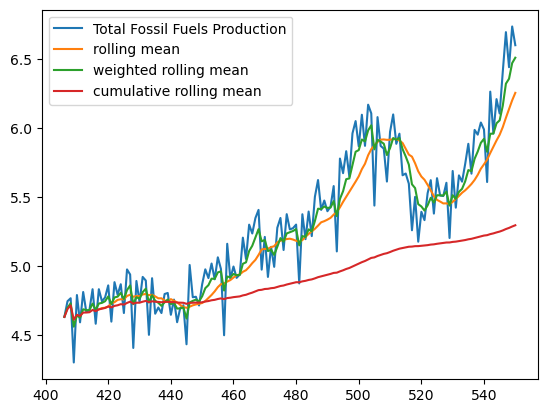

In [76]:
gordulo.plot()

In [77]:
# ADF teszt elvégzése
result = adfuller(Total_fossil, autolag='AIC')

# Eredmény kiértékelése
adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

print(f'ADF statisztika: {adf_statistic}')
print(f'p-érték: {p_value}')
print('Kritikus értékek:')
for key, value in critical_values.items():
    print(f'{key}: {value}')
print("\n")
if p_value<0.05:
    print("Stacionárius")
elif p_value>0.05 and p_value<=0.10:
    print("Kisebb szignifikancán stacionárius lehet")
else:
    print('Nem stacionárius, megfigyelhető valamilyen trend')
    

ADF statisztika: -0.11754695860740144
p-érték: 0.9476624987066645
Kritikus értékek:
1%: -3.4816817173418295
5%: -2.8840418343195267
10%: -2.578770059171598


Nem stacionárius, megfigyelhető valamilyen trend


In [78]:
#gördülő átlag kivonása az eredeti sorból

In [79]:
diff_sor= Vilagoo['Total Fossil Fuels Production'].tolist()-weigted_rolling_mean

In [80]:
# ADF teszt elvégzése
result = adfuller(diff_sor, autolag='AIC')

# Eredmény kiértékelése
adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

print(f'ADF statisztika: {adf_statistic}')
print(f'p-érték: {p_value}')
print('Kritikus értékek:')
for key, value in critical_values.items():
    print(f'{key}: {value}')
print("\n")
if p_value<0.05:
    print("Stacionárius")
elif p_value>0.05 and p_value<=0.10:
    print("Kisebb szignifikancán stacionárius lehet")
else:
    print('Nem stacionárius, megfigyelhető valamilyen trend')
    
# KPSS próba elvégzése
print("\n")
result = kpss(diff_sor, regression='c') 
print("KPSS statisztika:", result[0])
print("P-érték:", result[1])
print("Lags:", result[2])
print("Crit értékek:", result[3])

# Eredmény értékelése
if result[1] > 0.05:
    print("Stacionárius")
else:
    print("Nem stacionárius")

ADF statisztika: -1.8582619565311733
p-érték: 0.3519433821088735
Kritikus értékek:
1%: -3.4816817173418295
5%: -2.8840418343195267
10%: -2.578770059171598


Nem stacionárius, megfigyelhető valamilyen trend


KPSS statisztika: 0.21280243904158896
P-érték: 0.1
Lags: 6
Crit értékek: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Stacionárius


## Gyökös átalakítás

In [81]:
gyokos = np.sqrt(Vilago['Total Fossil Fuels Production'])

In [82]:
kobos = np.cbrt(Vilago['Total Fossil Fuels Production'])

<Axes: >

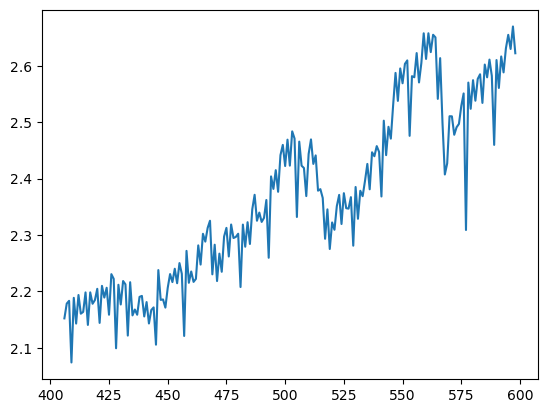

In [83]:
gyokos.plot()

<Axes: >

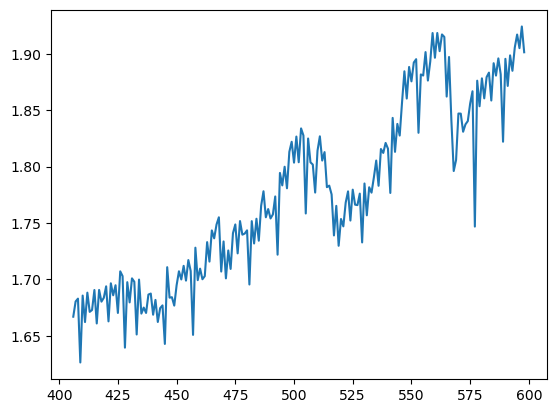

In [84]:
kobos.plot()

In [85]:
# ADF teszt elvégzése
result = adfuller(kobos, autolag='AIC')

# Eredmény kiértékelése
adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

print(f'ADF statisztika: {adf_statistic}')
print(f'p-érték: {p_value}')
print('Kritikus értékek:')
for key, value in critical_values.items():
    print(f'{key}: {value}')
print("\n")
if p_value<0.05:
    print("Stacionárius")
elif p_value>0.05 and p_value<=0.10:
    print("Kisebb szignifikancán stacionárius lehet")
else:
    print('Nem stacionárius, megfigyelhető valamilyen trend')

ADF statisztika: -0.5960709486578183
p-érték: 0.8718673621986532
Kritikus értékek:
1%: -3.4674201432469816
5%: -2.877826051844538
10%: -2.575452082332012


Nem stacionárius, megfigyelhető valamilyen trend


## differenciálás

In [86]:
diffes=pd.Series(Vilagoo['Total Fossil Fuels Production'])
diffes = diffes.diff()#(periods=12).#dropna()
diffes

406         NaN
407    0.113563
408    0.021413
409   -0.465353
410    0.488518
         ...   
546    0.302185
547    0.287164
548   -0.254337
549    0.295305
550   -0.135630
Name: Total Fossil Fuels Production, Length: 145, dtype: float64

In [87]:
diffes_full=pd.Series(Vilagossz['Total Fossil Fuels Production'].iloc[-193:])
diffes_full = diffes_full.diff()
print(len(diffes_full))
diffes_full

193


406         NaN
407    0.113563
408    0.021413
409   -0.465353
410    0.488518
         ...   
594    0.222734
595    0.126099
596   -0.132324
597    0.211417
598   -0.251250
Name: Total Fossil Fuels Production, Length: 193, dtype: float64

***
x = [0,11,24,37,49,59]
print(x)
z = np.diff(x)
print(z)
z = np.insert(z,0,x[0])
print(z)
print(np.cumsum(z))
***

In [88]:
#differenciális visszafejtő kulcs
diffes_vissza = []
diffeses= diffes.tolist()
diffes_vissza.append(adatok[0])
i=1
N=len(diffeses)
while i!=N:
    diffes_vissza.append(diffeses[i]+diffes_vissza[i-1])
    i+=1
print(diffes_vissza[:20])
print(adatok[:20])

[4.631319, 4.744882, 4.766295, 4.300942, 4.78946, 4.591832, 4.811407, 4.66717, 4.680978, 4.831601, 4.581483, 4.831938, 4.743522, 4.772485, 4.859584, 4.596865, 4.88269, 4.79135, 4.867863, 4.659152]
[4.631319, 4.744882, 4.766295, 4.300942, 4.78946, 4.591832, 4.811407, 4.66717, 4.680978, 4.831601, 4.581483, 4.831938, 4.743522, 4.772485, 4.859584, 4.596865, 4.88269, 4.79135, 4.867863, 4.659152]


<Axes: >

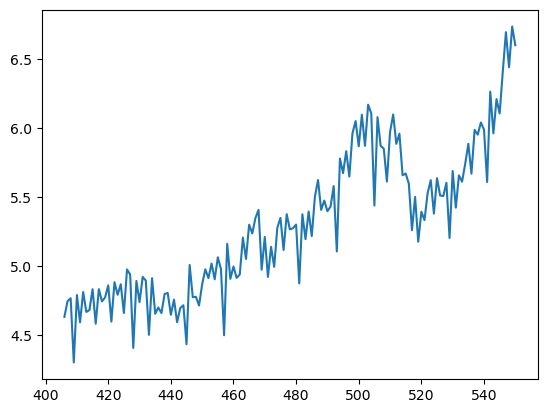

In [89]:
Vilagoo['Total Fossil Fuels Production'].plot()

<Axes: >

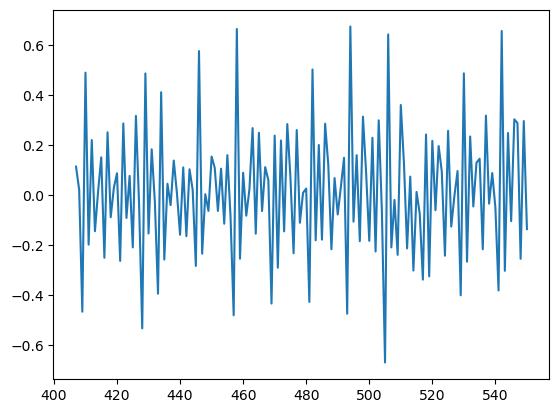

In [90]:
diffes.plot()

In [91]:
# ADF teszt elvégzése
result = adfuller(diffes.dropna(), autolag='AIC')

# Eredmény kiértékelése
adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

print(f'ADF statisztika: {adf_statistic}')
print(f'p-érték: {p_value}')
print('Kritikus értékek:')
for key, value in critical_values.items():
    print(f'{key}: {value}')
print("\n")
if p_value<0.05:
    print("Stacionárius")
elif p_value>0.05 and p_value<=0.10:
    print("Kisebb szignifikancán stacionárius lehet")
else:
    print('Nem stacionárius, megfigyelhető valamilyen trend')
    
# KPSS próba elvégzése
result = kpss(diffes.dropna(), regression='c') 
print("KPSS statisztika:", result[0])
print("P-érték:", result[1])
print("Lags:", result[2])
print("Crit értékek:", result[3])

# Eredmény értékelése
if result[1] > 0.05:
    print("Stacionárius")
else:
    print("Nem stacionárius")

ADF statisztika: -1.8540587670295534
p-érték: 0.353972102552983
Kritikus értékek:
1%: -3.4808880719210005
5%: -2.8836966192225284
10%: -2.5785857598714417


Nem stacionárius, megfigyelhető valamilyen trend
KPSS statisztika: 0.12400444731475116
P-érték: 0.1
Lags: 9
Crit értékek: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Stacionárius


## differenciált és gyökösen transzformált

In [92]:
diftransz = np.cbrt(diffes)
diftransz_full = np.cbrt(diffes_full)
print(diftransz,diftransz_full)

406         NaN
407    0.484260
408    0.277689
409   -0.774927
410    0.787578
         ...   
546    0.671054
547    0.659746
548   -0.633583
549    0.665922
550   -0.513790
Name: Total Fossil Fuels Production, Length: 145, dtype: float64 406         NaN
407    0.484260
408    0.277689
409   -0.774927
410    0.787578
         ...   
594    0.606171
595    0.501461
596   -0.509581
597    0.595726
598   -0.631009
Name: Total Fossil Fuels Production, Length: 193, dtype: float64


<Axes: >

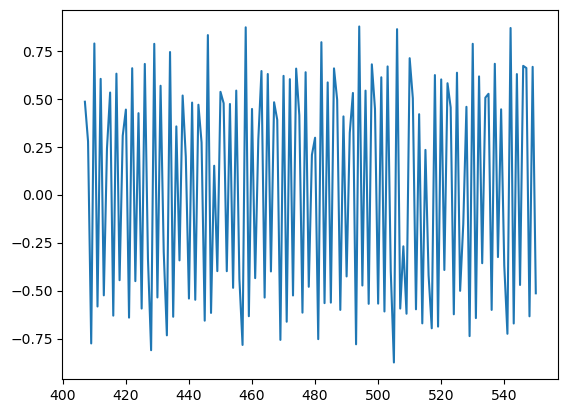

In [93]:
diftransz.plot()

In [94]:
# ADF teszt elvégzése
result = adfuller(diftransz_full.dropna(), autolag='AIC')

# Eredmény kiértékelése
adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

print(f'ADF statisztika: {adf_statistic}')
print(f'p-érték: {p_value}')
print('Kritikus értékek:')
for key, value in critical_values.items():
    print(f'{key}: {value}')
print("\n")
if p_value<0.05:
    print("Stacionárius")
elif p_value>0.05 and p_value<=0.10:
    print("Kisebb szignifikancán stacionárius lehet")
else:
    print('Nem stacionárius, megfigyelhető valamilyen trend')
    
# KPSS próba elvégzése
result = kpss(diftransz.dropna(), regression='c') 
print("KPSS statisztika:", result[0])
print("P-érték:", result[1])
print("Lags:", result[2])
print("Crit értékek:", result[3])

# Eredmény értékelése
if result[1] > 0.05:
    print("Stacionárius")
else:
    print("Nem stacionárius")

ADF statisztika: -3.3501929974681315
p-érték: 0.01277860061423474
Kritikus értékek:
1%: -3.4672111510631
5%: -2.877734766803841
10%: -2.575403364197531


Stacionárius
KPSS statisztika: 0.028086494663885447
P-érték: 0.1
Lags: 3
Crit értékek: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Stacionárius


In [95]:
#visszafejtés
diftransz= diftransz**3
diffeskob_vissza = []
diffeseskob= diftransz.tolist()
diffeskob_vissza.append(adatok[0])
i=1
N=len(diffeseskob)
while i!=N:
    diffeskob_vissza.append(diffeseskob[i]+diffeskob_vissza[i-1])
    i+=1
print(diffeskob_vissza[:20])
print(adatok[:20])

[4.631319, 4.744882, 4.766295, 4.300942, 4.78946, 4.591832, 4.811407, 4.66717, 4.680978, 4.831601, 4.581483, 4.831938, 4.743522, 4.772485, 4.859584, 4.596865, 4.88269, 4.79135, 4.867863, 4.659152]
[4.631319, 4.744882, 4.766295, 4.300942, 4.78946, 4.591832, 4.811407, 4.66717, 4.680978, 4.831601, 4.581483, 4.831938, 4.743522, 4.772485, 4.859584, 4.596865, 4.88269, 4.79135, 4.867863, 4.659152]


In [96]:
print(diftransz.dropna())

407    0.113563
408    0.021413
409   -0.465353
410    0.488518
411   -0.197628
         ...   
546    0.302185
547    0.287164
548   -0.254337
549    0.295305
550   -0.135630
Name: Total Fossil Fuels Production, Length: 144, dtype: float64


## logaritmikus differenciálás 

In [97]:
log_diff = np.log1p(pd.Series(Vilagoo['Total Fossil Fuels Production']))
log_diff = log_diff.diff()

<Axes: >

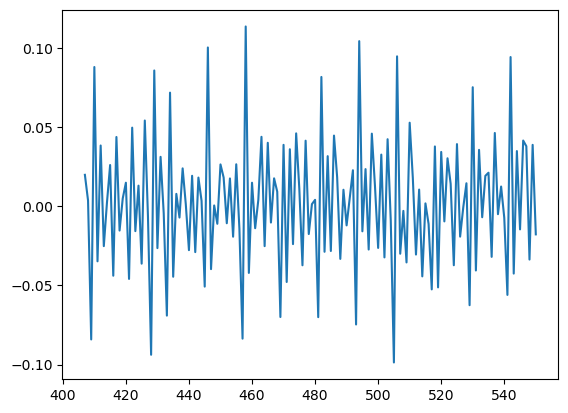

In [98]:
log_diff.plot()

In [99]:
# ADF teszt elvégzése
result = adfuller(log_diff.dropna(), autolag='AIC')

# Eredmény kiértékelése
adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

print(f'ADF statisztika: {adf_statistic}')
print(f'p-érték: {p_value}')
print('Kritikus értékek:')
for key, value in critical_values.items():
    print(f'{key}: {value}')
print("\n")
if p_value<0.05:
    print("Stacionárius")
elif p_value>0.05 and p_value<=0.10:
    print("Kisebb szignifikancán stacionárius lehet")
else:
    print('Nem stacionárius, megfigyelhető valamilyen trend')

# KPSS próba elvégzése
result = kpss(log_diff.dropna(), regression='c') 
print("KPSS statisztika:", result[0])
print("P-érték:", result[1])
print("Lags:", result[2])
print("Crit értékek:", result[3])

# Eredmény értékelése
if result[1] > 0.05:
    print("Stacionárius")
else:
    print("Nem stacionárius")

ADF statisztika: -1.771237019247635
p-érték: 0.3948322892593059
Kritikus értékek:
1%: -3.4816817173418295
5%: -2.8840418343195267
10%: -2.578770059171598


Nem stacionárius, megfigyelhető valamilyen trend
KPSS statisztika: 0.08679327186585607
P-érték: 0.1
Lags: 10
Crit értékek: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Stacionárius


## duplán differenciált

In [100]:
diffdiff=diffes.diff()

In [101]:
diffdiff

406         NaN
407         NaN
408   -0.092150
409   -0.486766
410    0.953871
         ...   
546    0.406232
547   -0.015021
548   -0.541501
549    0.549642
550   -0.430935
Name: Total Fossil Fuels Production, Length: 145, dtype: float64

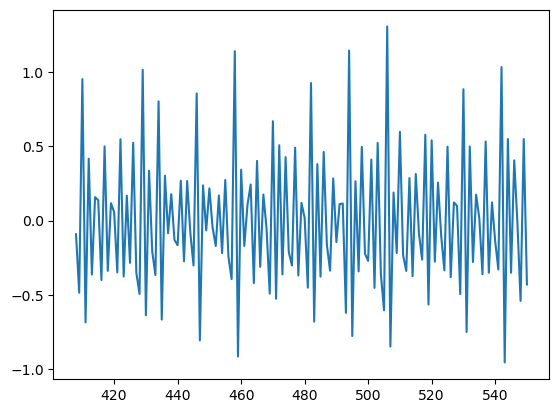

In [102]:
plt.plot(diffdiff)

In [103]:
# ADF teszt elvégzése
result = adfuller(diffdiff.dropna(), autolag='AIC')

# Eredmény kiértékelése
adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

print(f'ADF statisztika: {adf_statistic}')
print(f'p-érték: {p_value}')
print('Kritikus értékek:')
for key, value in critical_values.items():
    print(f'{key}: {value}')
print("\n")
if p_value<0.05:
    print("Stacionárius")
elif p_value>0.05 and p_value<=0.10:
    print("Kisebb szignifikancán stacionárius lehet")
else:
    print('Nem stacionárius, megfigyelhető valamilyen trend')

# KPSS próba elvégzése
result = kpss(log_diff.dropna(), regression='c') 
print("KPSS statisztika:", result[0])
print("P-érték:", result[1])
print("Lags:", result[2])
print("Crit értékek:", result[3])

# Eredmény értékelése
if result[1] > 0.05:
    print("Stacionárius")
else:
    print("Nem stacionárius")

ADF statisztika: -5.901701103506897
p-érték: 2.76827653792911e-07
Kritikus értékek:
1%: -3.4825006939887997
5%: -2.884397984161377
10%: -2.578960197753906


Stacionárius
KPSS statisztika: 0.08679327186585607
P-érték: 0.1
Lags: 10
Crit értékek: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Stacionárius


In [104]:
#diffdiff visszafejtő kulcs
diffes_vissza = []
diffeses= diffes.tolist()
diffes_vissza.append(adatok[0])
i=1
N=len(diffeses)
while i!=N:
    diffes_vissza.append(diffeses[i]+diffes_vissza[i-1])
    i+=1
print(diffes_vissza[:20])
print(adatok[:20])

[4.631319, 4.744882, 4.766295, 4.300942, 4.78946, 4.591832, 4.811407, 4.66717, 4.680978, 4.831601, 4.581483, 4.831938, 4.743522, 4.772485, 4.859584, 4.596865, 4.88269, 4.79135, 4.867863, 4.659152]
[4.631319, 4.744882, 4.766295, 4.300942, 4.78946, 4.591832, 4.811407, 4.66717, 4.680978, 4.831601, 4.581483, 4.831938, 4.743522, 4.772485, 4.859584, 4.596865, 4.88269, 4.79135, 4.867863, 4.659152]


# Modellezés

In [105]:
import statsmodels.api as sm

In [106]:
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)

In [107]:
vilagvalid=Vilagossz['Total Fossil Fuels Production'].iloc[-48:-24]
vilagvalidd = vilagvalid.to_list()
vilagtest= Vilagossz['Total Fossil Fuels Production'].iloc[-24:]
vilagtestt = vilagtest.to_list()
print(vilagvalid)
print(vilagtest)

551    6.776997
552    6.809097
553    6.128950
554    6.663949
555    6.654140
556    6.877088
557    6.606718
558    6.785362
559    7.062180
560    6.822768
561    7.062514
562    6.886113
563    7.048279
564    7.023966
565    6.457747
566    6.830089
567    6.242222
568    5.794635
569    5.889961
570    6.302331
571    6.301563
572    6.138334
573    6.204600
574    6.234271
Name: Total Fossil Fuels Production, dtype: float64
575    6.393932
576    6.506760
577    5.330326
578    6.605408
579    6.368644
580    6.627368
581    6.441243
582    6.638882
583    6.681408
584    6.421360
585    6.770603
586    6.653553
587    6.816448
588    6.666196
589    6.049793
590    6.812384
591    6.556500
592    6.845556
593    6.698692
594    6.921426
595    7.047525
596    6.915201
597    7.126618
598    6.875368
Name: Total Fossil Fuels Production, dtype: float64


In [108]:
diftran=diftransz.dropna()
diftran_full=diftransz_full.dropna()

In [109]:
diftran

407    0.113563
408    0.021413
409   -0.465353
410    0.488518
411   -0.197628
         ...   
546    0.302185
547    0.287164
548   -0.254337
549    0.295305
550   -0.135630
Name: Total Fossil Fuels Production, Length: 144, dtype: float64

In [110]:
Vilagooscaled=Vilagooscaled[1:]

## Acf,pacf plotok az adatokról

In [111]:
Vilagooscaled

array([[-0.55005817],
       [-0.52864517],
       [-0.99399817],
       [-0.50548017],
       [-0.70310817],
       [-0.48353317],
       [-0.62777017],
       [-0.61396217],
       [-0.46333917],
       [-0.71345717],
       [-0.46300217],
       [-0.55141817],
       [-0.52245517],
       [-0.43535617],
       [-0.69807517],
       [-0.41225017],
       [-0.50359017],
       [-0.42707717],
       [-0.63578817],
       [-0.31989917],
       [-0.35695217],
       [-0.88879017],
       [-0.40353917],
       [-0.55690817],
       [-0.37420317],
       [-0.40045317],
       [-0.79386417],
       [-0.38351517],
       [-0.64075517],
       [-0.59576417],
       [-0.63585217],
       [-0.49808217],
       [-0.49035317],
       [-0.64876217],
       [-0.53836617],
       [-0.70241817],
       [-0.59954517],
       [-0.57941917],
       [-0.86213117],
       [-0.28769817],
       [-0.52140017],
       [-0.51797517],
       [-0.58115317],
       [-0.42747317],
       [-0.31930217],
       [-0

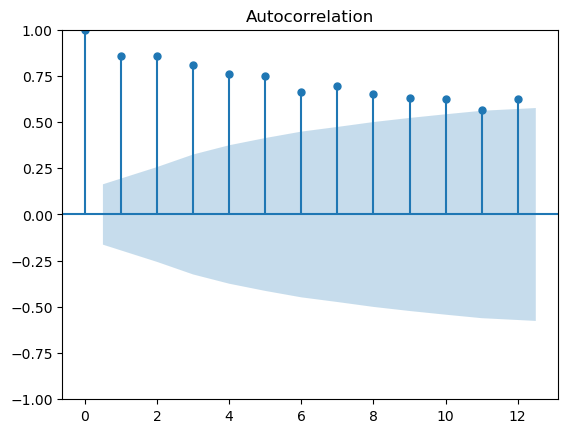

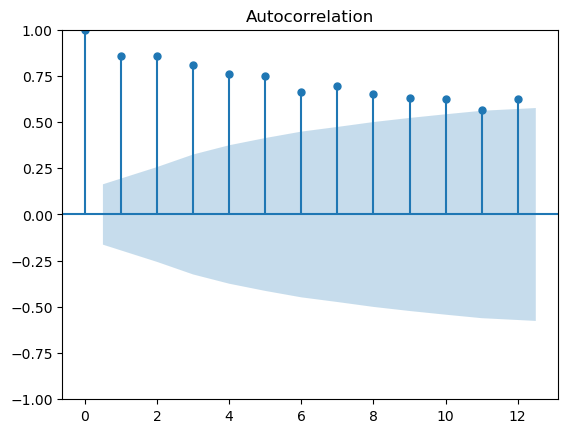

In [112]:
plot_acf(Vilagooscaled, lags=12)

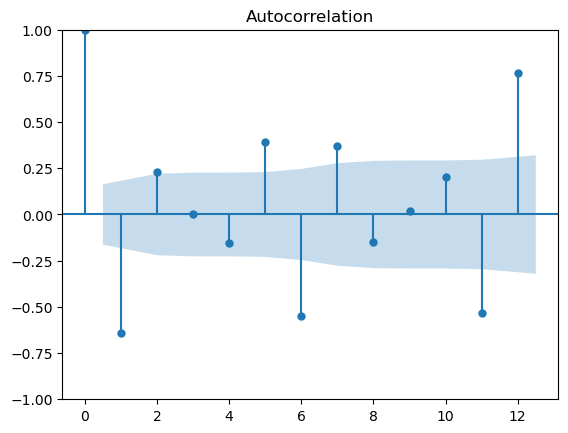

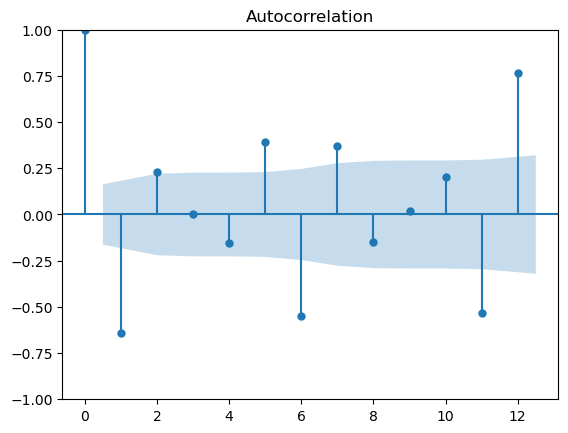

In [113]:
plot_acf(np.asarray(diftran), lags=12)

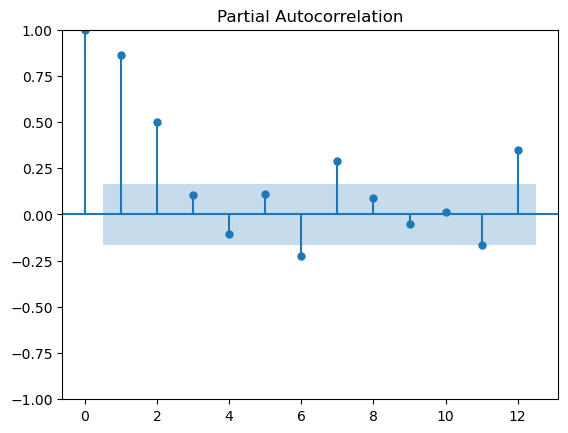

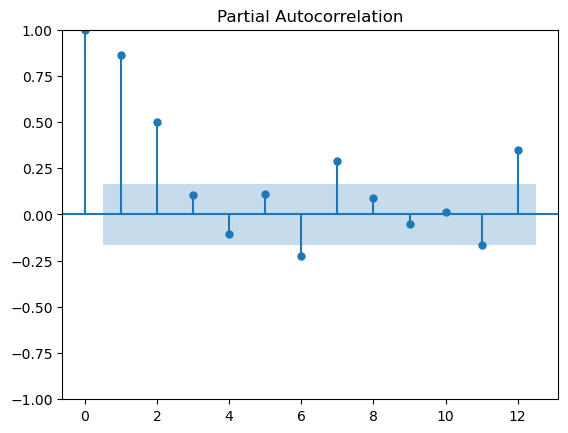

In [114]:
plot_pacf(Vilagooscaled, lags=12)

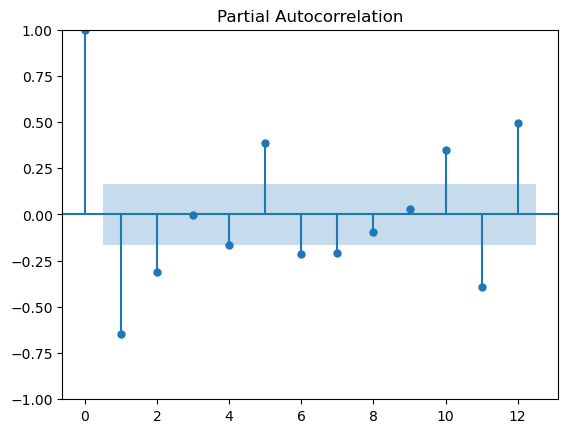

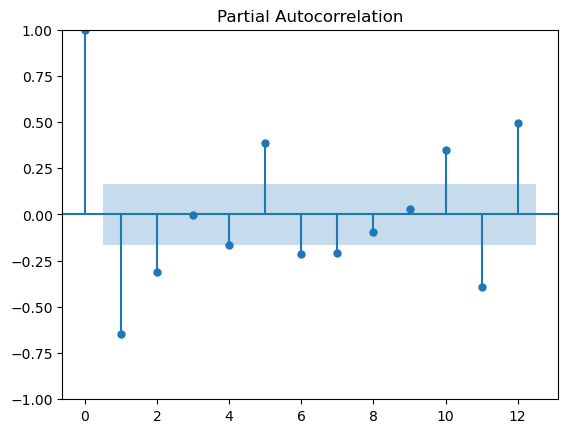

In [115]:
plot_pacf(diftran, lags=12)

In [116]:
#Általános elkészítése a modellnek
vilagosszprob2 = Vilagoo[['Date','Total Fossil Fuels Production']]
ts3 = vilagosszprob2['Total Fossil Fuels Production']
model3 = sm.tsa.ARIMA(ts3, order=(2, 1, 5), seasonal_order=(0, 1, 1, 12)).fit()
Predikcio = pd.Series(model3.forecast(steps = 12))
predkcios_teszt2= Vilagossz[['Date','Total Fossil Fuels Production']].loc[575:586]
predkcios_teszt2['Predikcio'] = Predikcio

In [117]:
predkcios_teszt2

,Date,Total Fossil Fuels Production,Predikcio
575,2020-12-31,6.393932,NaN
576,2021-01-31,6.506760,NaN
577,2021-02-28,5.330326,NaN
578,2021-03-31,6.605408,NaN
579,2021-04-30,6.368644,NaN
580,2021-05-31,6.627368,NaN
581,2021-06-30,6.441243,NaN
582,2021-07-31,6.638882,NaN
583,2021-08-31,6.681408,NaN
584,2021-09-30,6.421360,NaN


# Arima differenciált és transzformált értékekkel

In [118]:
#arima az acf, pacf szerinti ideális értékekkel
ts3 = diftran
model3 = sm.tsa.ARIMA(ts3, order=(5, 1, 6), seasonal_order=(0, 1, 1, 12)).fit()
Predikcio = pd.Series(model3.forecast(steps = 12))
predkcios_teszt2= Vilagossz[['Date','Total Fossil Fuels Production']].loc[575:586]
predkcios_teszt2['Predikcio'] = Predikcio.tolist()
predkcios_teszt2= predkcios_teszt2.reset_index()

In [119]:
Predikcio

144    0.112060
145    0.019897
146   -0.365740
147    0.466417
148   -0.192784
149    0.168657
150   -0.128660
151    0.258468
152    0.121802
153   -0.214066
154    0.261593
155   -0.136760
Name: predicted_mean, dtype: float64

In [120]:
Predikcio = Predikcio.tolist()

In [121]:
predkcios_teszt2

,index,Date,Total Fossil Fuels Production,Predikcio
0,575,2020-12-31,6.393932,0.112060
1,576,2021-01-31,6.506760,0.019897
2,577,2021-02-28,5.330326,-0.365740
3,578,2021-03-31,6.605408,0.466417
4,579,2021-04-30,6.368644,-0.192784
5,580,2021-05-31,6.627368,0.168657
6,581,2021-06-30,6.441243,-0.128660
7,582,2021-07-31,6.638882,0.258468
8,583,2021-08-31,6.681408,0.121802
9,584,2021-09-30,6.421360,-0.214066


In [122]:
#visszafejtő az Arima predikciókhoz
#1-es a validációs visszafejtés, 2. a teszt a visszafejtés, bármi más magának a predikciónak a visszafejtése
def visszafejto(predikcio,arima_valid=1):
    ar=arima_valid
    if ar == 1:
        diffeskob_vissza = []
        diffeskob_vissza.append(adatok[-1])
        i=0
        N=len(predikcio)
        while i!=N:
            diffeskob_vissza.append(predikcio[i]+diffeskob_vissza[i])
            i+=1
        diffeskob_vissza=diffeskob_vissza[1:]
        return diffeskob_vissza
    elif ar == 2:
        diffeskob_vissza = []
        diffeskob_vissza.append(vilagvalidd[-1])
        i=0
        N=len(predikcio)
        while i!=N:
            diffeskob_vissza.append(predikcio[i]+diffeskob_vissza[i])
            i+=1
        diffeskob_vissza=diffeskob_vissza[1:]
        return diffeskob_vissza
    else:
        diffeskob_vissza = []
        diffeskob_vissza.append(adatok_full[-1])
        i=0
        N=len(predikcio)
        while i!=N:
            diffeskob_vissza.append(predikcio[i]+diffeskob_vissza[i])
            i+=1
        diffeskob_vissza=diffeskob_vissza[1:]
        return diffeskob_vissza
visszafejto(Predikcio,1)

[6.711315739692935,
 6.731212640742313,
 6.365472854617912,
 6.831889409996708,
 6.639105537200782,
 6.807762269538567,
 6.679102085476816,
 6.937570508014153,
 7.059373005658116,
 6.845306674040487,
 7.106899361433536,
 6.970139265704973]

In [123]:
#Visszafejtő az RNN predikciókhoz
#teszt = 0 azt jelenti, hogy a predikciót fejtük vissza, bármi más azt hogy a teszthez képzett prdikciókat fejtjük vissza
def visszafejtolstm(predikcioko,teszt=0):
    if teszt==0:
        diffeskob_vissza = []
        ddd=Vilagossz['Total Fossil Fuels Production'].tolist()
        diffeskob_vissza.append(ddd[-1])
        i=0
        N=len(predikcioko)
        while i!=N:
            diffeskob_vissza.append(predikcioko[i]+diffeskob_vissza[i])
            i+=1
        diffeskob_vissza= diffeskob_vissza[1:]
        return diffeskob_vissza
    else:
        diffeskob_vissza = []
        ddd=Vilagossz['Total Fossil Fuels Production'].tolist()
        diffeskob_vissza.append(ddd[-25])
        i=0
        N=len(predikcioko)
        while i!=N:
            diffeskob_vissza.append(predikcioko[i]+diffeskob_vissza[i])
            i+=1
        diffeskob_vissza= diffeskob_vissza[1:]
        return diffeskob_vissza
#visszafejtolstm(predi)

In [124]:
def visszafejto_temp(predikcio,elsoertekhez):
    diffeskob_vissza = []
    diffeskob_vissza.append(elsoertekhez[-1])
    i=1
    N=len(predikcio)
    while i!=N:
        diffeskob_vissza.append(predikcio[i]+diffeskob_vissza[i-1])
        i+=1
    return diffeskob_vissza
#visszafejto_temp(predictions,ddd)

In [125]:
predkcios_teszt2['visszafejtett eredmények'] = pd.Series(visszafejto(Predikcio))
predkcios_teszt2

,index,Date,Total Fossil Fuels Production,Predikcio,visszafejtett eredmények
0,575,2020-12-31,6.393932,0.112060,6.711316
1,576,2021-01-31,6.506760,0.019897,6.731213
2,577,2021-02-28,5.330326,-0.365740,6.365473
3,578,2021-03-31,6.605408,0.466417,6.831889
4,579,2021-04-30,6.368644,-0.192784,6.639106
5,580,2021-05-31,6.627368,0.168657,6.807762
6,581,2021-06-30,6.441243,-0.128660,6.679102
7,582,2021-07-31,6.638882,0.258468,6.937571
8,583,2021-08-31,6.681408,0.121802,7.059373
9,584,2021-09-30,6.421360,-0.214066,6.845307


## ARIMA modell optimalizálása

In [126]:
def arimadef(adatforras,nt,p,d,q,kell_kulcs,adatforras_neve,van_e_sarima):
    diftrapd= pd.DataFrame()
    diftrapd['adatforrás'] = None
    diftrapd['ARIMA/SARIMA'] = None
    diftrapd['p,d,q értékek']=None
    diftrapd['MAE']=None
    diftrapd['RMSE']=None
    diftrapd['AIC']=None
    diftrapd['BIC']=None
    ts = adatforras
    adatforr=adatforras_neve
    p,q,d=p,q,d
    kell_kulcs = kell_kulcs
    nt=nt
    if van_e_sarima ==0:
        for pp in range(p, nt+1):
            for dd in range(d, 4):
                for qq in range(q, nt+1):
                    model = sm.tsa.ARIMA(ts, order=(pp,dd,qq)).fit()
                    Predikcio = model.forecast(steps = 24)
                    Predikcio = np.array(Predikcio).reshape(-1,).tolist()
                    if kell_kulcs == 1:
                        Predikcio = visszafejto(Predikcio)
                    aicc=model.aic
                    bicc=model.bic
                    kulonbseg=0
                    negyzetes_kulonbseg=0
                    for j in range(len(vilagvalidd)):
                        kivon = Predikcio[j]-vilagvalidd[j]
                        kulonbseg = kulonbseg + abs(kivon)
                        negyzetes_kulonbseg = negyzetes_kulonbseg + kivon**2
                    MAE=kulonbseg/24
                    MSE=negyzetes_kulonbseg/24
                    RMSE = np.sqrt(MSE)
                    ertekek=[pp,dd,qq]
                    diftrapd = diftrapd.append({'adatforrás':adatforr,'ARIMA/SARIMA':'ARIMA','p,d,q értékek':ertekek,'MAE': MAE,'RMSE':RMSE,'AIC':aicc,'BIC':bicc}, ignore_index=True)
    else:
        for pp in range(p, nt+1):
            for dd in range(d, 4):
                for qq in range(q, nt+1):
                    model = sm.tsa.ARIMA(ts, order=(pp,dd,qq),seasonal_order=(0,1,1,12)).fit()
                    Predikcio = model.forecast(steps = 24)
                    Predikcio = np.array(Predikcio).reshape(-1,).tolist()
                    if kell_kulcs == 1:
                        Predikcio = visszafejto(Predikcio)
                    aicc=model.aic
                    bicc=model.bic
                    kulonbseg=0
                    negyzetes_kulonbseg=0
                    for j in range(len(vilagvalidd)):
                        kivon = Predikcio[j]-vilagvalidd[j]
                        kulonbseg = kulonbseg + abs(kivon)
                        negyzetes_kulonbseg = negyzetes_kulonbseg + kivon**2
                    MAE=kulonbseg/24
                    MSE=negyzetes_kulonbseg/24
                    RMSE = np.sqrt(MSE)
                    ertekek=[pp,dd,qq]
                    diftrapd = diftrapd.append({'adatforrás':adatforr,'ARIMA/SARIMA':'SARIMA','p,d,q értékek':ertekek,'MAE': MAE,'RMSE':RMSE,'AIC':aicc,'BIC':bicc}, ignore_index=True)
    return diftrapd


In [127]:
vegso_pdA=arimadef(diftran,5,1,0,1,1,'differenciált és transzformált',0)
vegso_pdS=arimadef(diftran,4,1,0,1,1,'differenciált és transzformált',1)
vegso_pd2A=arimadef(diffes.dropna(),5,1,0,1,1,'differenciált',0)
vegso_pd2S=arimadef(diffes.dropna(),4,1,0,1,1,'differenciált',1)
vegso_pd3A=arimadef(adatok,5,1,0,1,0,'Alap',0)
vegso_pd3S=arimadef(adatok,4,1,0,1,0,'Alap',1)
vegso_pd= pd.concat([vegso_pdA,vegso_pdS],ignore_index=True)
vegso_pd2= pd.concat([vegso_pd2A,vegso_pd2S],ignore_index=True)
vegso_pd3= pd.concat([vegso_pd3A,vegso_pd3S],ignore_index=True)

In [128]:
#del vegso_pdA
#vegso_pdA

In [129]:
vegso_pdd =pd.concat([vegso_pd,vegso_pd2,vegso_pd3],ignore_index=True)

In [130]:
vegso_pdd

,adatforrás,ARIMA/SARIMA,"p,d,q értékek",MAE,RMSE,AIC,BIC
0,differenciált és transzformált,ARIMA,"[1, 0, 1]",0.374336,0.493542,-61.388418,-49.509165
1,differenciált és transzformált,ARIMA,"[1, 0, 2]",0.378762,0.510693,-62.771929,-47.922863
2,differenciált és transzformált,ARIMA,"[1, 0, 3]",0.376365,0.507378,-62.294484,-44.475604
3,differenciált és transzformált,ARIMA,"[1, 0, 4]",0.373623,0.498522,-61.389217,-40.600524
4,differenciált és transzformált,ARIMA,"[1, 0, 5]",0.354349,0.435831,-60.919148,-37.160642
...,...,...,...,...,...,...,...
487,Alap,SARIMA,"[4, 2, 4]",0.965416,1.248859,-185.636594,-156.884621
488,Alap,SARIMA,"[4, 3, 1]",0.927069,1.213462,-154.472844,-134.400103
489,Alap,SARIMA,"[4, 3, 2]",0.667786,0.921560,-144.983138,-122.042863
490,Alap,SARIMA,"[4, 3, 3]",0.668753,0.919453,-147.150964,-121.343154


In [131]:
vegso_pdd=vegso_pdd.sort_values(by=['MAE']).reset_index()
vegso_pdd_tovabb=vegso_pdd.head(100)
vegso_pdd.head(30)

,index,adatforrás,ARIMA/SARIMA,"p,d,q értékek",MAE,RMSE,AIC,BIC
0,375,Alap,ARIMA,"[3, 1, 3]",0.275173,0.340687,-92.581968,-71.793275
1,350,Alap,ARIMA,"[2, 0, 3]",0.277237,0.349947,-57.132923,-36.295786
2,330,Alap,ARIMA,"[1, 0, 3]",0.277674,0.346116,-57.232277,-39.371874
3,349,Alap,ARIMA,"[2, 0, 2]",0.278021,0.345386,-57.204930,-39.344527
4,329,Alap,ARIMA,"[1, 0, 2]",0.279904,0.343707,-59.110884,-44.227215
5,351,Alap,ARIMA,"[2, 0, 4]",0.281648,0.344794,-55.544337,-31.730467
6,396,Alap,ARIMA,"[4, 1, 4]",0.292343,0.367767,-129.388412,-102.660092
7,411,Alap,ARIMA,"[5, 0, 4]",0.292978,0.372175,-119.513026,-86.768955
8,368,Alap,ARIMA,"[3, 0, 1]",0.293148,0.345377,-60.816469,-42.956067
9,412,Alap,ARIMA,"[5, 0, 5]",0.293241,0.355494,-118.864673,-83.143868


In [162]:
kimentos2 = vegso_pdd[:20]
kimentos2.to_excel('Arima_predikciok_valid.xlsx', sheet_name='Arima_predikciok_valid')

In [132]:
#del vegso_pd
#del diftrapd

In [133]:
#diftrapd

In [134]:
#adatok beforgatása
diftran_valid = diftran_full[:-24]
diffes_valid = diffes_full[:-24]

In [135]:
pdd = pd.DataFrame()
for i in range(len(vegso_pdd_tovabb)):
    if vegso_pdd_tovabb.loc[i, "adatforrás"]=='differenciált és transzformált':
        ts=diftran_valid
    elif vegso_pdd_tovabb.loc[i, "adatforrás"]=='differenciált':
        ts=diffes_valid.dropna()
    else:
        ts=adatok_full[:-24]
    if vegso_pdd_tovabb.loc[i, "ARIMA/SARIMA"] =='ARIMA':
        pqd_lista=vegso_pdd_tovabb['p,d,q értékek'].iloc[i]
        model = sm.tsa.ARIMA(ts, order=(pqd_lista[0],pqd_lista[1],pqd_lista[2])).fit()
        Predikcio = model.forecast(steps = 36)
        Predikcio = np.array(Predikcio).reshape(-1,).tolist()
        if vegso_pdd_tovabb.loc[i, "adatforrás"]=='differenciált és transzformált' or vegso_pdd_tovabb.loc[i, "adatforrás"]=='differenciált':
            Predikcio = visszafejto(Predikcio,2)
        aicc=model.aic
        bicc=model.bic
        kulonbseg=0
        negyzetes_kulonbseg=0
        for j in range(len(vilagtestt)):
            kivon = Predikcio[j]-vilagtestt[j]
            kulonbseg = kulonbseg + abs(kivon)
            negyzetes_kulonbseg = negyzetes_kulonbseg + kivon**2
        MAE=kulonbseg/24
        MSE=negyzetes_kulonbseg/24
        RMSE = np.sqrt(MSE)
        ertekek=[pqd_lista[0],pqd_lista[1],pqd_lista[2]]
        vegso_jovo_pred=Predikcio[-12:]
        pdd = pdd.append({'adatforrás':vegso_pdd_tovabb['adatforrás'].iloc[i],
                          'ARIMA/SARIMA':'ARIMA','p,d,q értékek':ertekek,
                          'MAE': MAE,'RMSE':RMSE,'AIC':aicc,'BIC':bicc,'Végső predikció':vegso_jovo_pred}, ignore_index=True)
        
    else:
        pqd_lista=vegso_pdd_tovabb['p,d,q értékek'].iloc[i]
        model = sm.tsa.ARIMA(ts, order=(pqd_lista[0],pqd_lista[1],pqd_lista[2]),seasonal_order=(0,1,1,12)).fit()
        Predikcio = model.forecast(steps = 36)
        Predikcio = np.array(Predikcio).reshape(-1,).tolist()
        if vegso_pdd_tovabb.loc[i, "adatforrás"]=='differenciált és transzformált' or vegso_pdd_tovabb.loc[i, "adatforrás"]=='differenciált':
            Predikcio = visszafejto(Predikcio,2)
        aicc=model.aic
        bicc=model.bic
        kulonbseg=0
        negyzetes_kulonbseg=0
        for j in range(len(vilagtestt)):
            kivon = Predikcio[j]-vilagtestt[j]
            kulonbseg = kulonbseg + abs(kivon)
            negyzetes_kulonbseg = negyzetes_kulonbseg + kivon**2
        MAE=kulonbseg/24
        MSE=negyzetes_kulonbseg/24
        RMSE = np.sqrt(MSE)
        ertekek=[pqd_lista[0],pqd_lista[1],pqd_lista[2]]
        vegso_jovo_pred=Predikcio[-12:]
        pdd = pdd.append({'adatforrás':vegso_pdd_tovabb['adatforrás'].iloc[i],
                          'ARIMA/SARIMA':'SARIMA','p,d,q értékek':ertekek,
                          'MAE': MAE,'RMSE':RMSE,'AIC':aicc,'BIC':bicc,'Végső predikció':vegso_jovo_pred}, ignore_index=True)
        
        

In [163]:
pdd

,adatforrás,ARIMA/SARIMA,"p,d,q értékek",MAE,RMSE,AIC,BIC,Végső predikció
0,Alap,ARIMA,"[3, 1, 3]",0.423898,0.484120,-75.831869,-54.005913,"[6.2339294943909485, 6.295144914949205, 6.1011..."
1,Alap,ARIMA,"[2, 0, 3]",0.610820,0.673042,-31.089663,-9.221915,"[5.928800938167863, 5.972010814188039, 5.91271..."
2,Alap,ARIMA,"[1, 0, 3]",0.626880,0.693537,-31.622998,-12.879214,"[5.9189149075624625, 5.909673657951543, 5.9006..."
3,Alap,ARIMA,"[2, 0, 2]",0.622259,0.688537,-31.521683,-12.777900,"[5.927416888800043, 5.918340391444083, 5.90944..."
4,Alap,ARIMA,"[1, 0, 2]",0.611905,0.676157,-33.235117,-17.615297,"[5.951842362329647, 5.943484094601698, 5.93527..."
...,...,...,...,...,...,...,...,...
95,differenciált és transzformált,SARIMA,"[2, 0, 3]",0.264961,0.328073,14.924482,36.273474,"[6.936991732263847, 6.94989804853041, 6.311091..."
96,Alap,SARIMA,"[2, 1, 3]",0.315501,0.348049,-180.672951,-159.368975,"[6.573344528085665, 6.582292783852162, 6.13696..."
97,differenciált,SARIMA,"[2, 0, 3]",0.315636,0.348183,-183.061855,-161.712863,"[6.573150084622309, 6.58207216698876, 6.136672..."
98,differenciált és transzformált,SARIMA,"[2, 0, 4]",0.254808,0.318441,18.176703,42.575551,"[6.962457835999189, 6.952658204465211, 6.30900..."


In [137]:
#pdd['Végső predikció'].iloc[0]

In [138]:
pddmn=pdd.sort_values(by=['MAE'])
pddmn.iloc[:30]

,adatforrás,ARIMA/SARIMA,"p,d,q értékek",MAE,RMSE,AIC,BIC,Végső predikció
83,differenciált és transzformált,SARIMA,"[1, 0, 4]",0.187289,0.226705,23.354382,44.703374,"[7.202575115118536, 7.248972950894775, 6.49879..."
69,differenciált és transzformált,SARIMA,"[1, 0, 3]",0.187954,0.227761,21.443582,39.742718,"[7.201420577791893, 7.247306342922683, 6.49767..."
81,differenciált és transzformált,SARIMA,"[4, 0, 1]",0.191744,0.233358,23.763603,45.112595,"[7.1738971866839725, 7.219849685491212, 6.4670..."
76,differenciált és transzformált,SARIMA,"[3, 0, 1]",0.193023,0.233907,22.405483,40.704619,"[7.185000106505029, 7.23198904606898, 6.480812..."
82,differenciált és transzformált,SARIMA,"[1, 0, 1]",0.198972,0.248109,22.456935,34.656360,"[7.125723150817912, 7.179331743324751, 6.42095..."
88,differenciált és transzformált,SARIMA,"[1, 0, 2]",0.201069,0.260505,21.491247,36.740527,"[7.085220383877276, 7.146465507841776, 6.38278..."
74,differenciált és transzformált,SARIMA,"[2, 0, 2]",0.251668,0.314876,13.910186,32.209322,"[6.95322888926067, 6.983620019688812, 6.359020..."
98,differenciált és transzformált,SARIMA,"[2, 0, 4]",0.254808,0.318441,18.176703,42.575551,"[6.962457835999189, 6.952658204465211, 6.30900..."
64,differenciált és transzformált,SARIMA,"[3, 0, 3]",0.256633,0.319842,16.607372,41.006220,"[6.943053766114488, 6.98086254527857, 6.343584..."
95,differenciált és transzformált,SARIMA,"[2, 0, 3]",0.264961,0.328073,14.924482,36.273474,"[6.936991732263847, 6.94989804853041, 6.311091..."


In [161]:
kimentos3=pddmn.iloc[:20]
kimentos3.to_excel('Arima_predikciok_teszt.xlsx', sheet_name='Arima_predikciok_teszt')

Text(0.5, 1.0, 'Hetedik modell modell predikció')

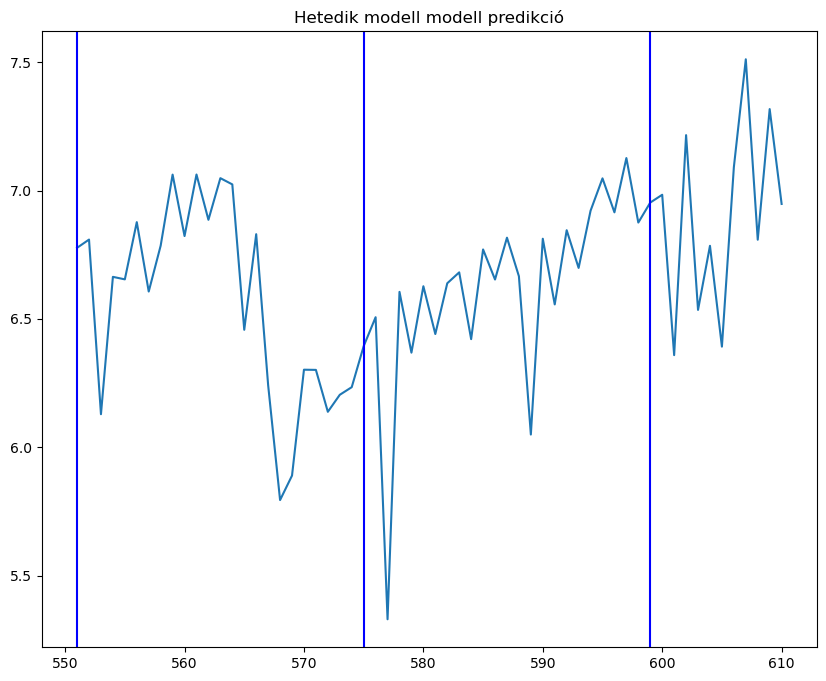

In [176]:
pre = pd.Series(pddmn['Végső predikció'].iloc[6][:12])
pre=Vilagossz['Total Fossil Fuels Production'].append(pre, ignore_index=True)
pre= pre.iloc[-60:]
pre.plot(figsize=(10,8))
plt.axvline(x = 551, color = 'b', label = 'axvline - full height')
plt.axvline(x = 575, color = 'b', label = 'axvline - full height')
plt.axvline(x = 599, color = 'b', label = 'axvline - full height')
plt.title('Hetedik modell modell predikció')

## Neurális háló

In [140]:
tf.random.set_seed(42)

In [141]:
#pip install h5py

In [142]:
from keras.layers import Bidirectional, Dropout
from keras.callbacks import ModelCheckpoint
import keras.callbacks
from keras.regularizers import l2

In [143]:
filepath1='yourmodelname.hdf5'
checkpointer = ModelCheckpoint(filepath=filepath1, 
                               monitor='val_loss', 
                               verbose=1, 
                               save_best_only=True)

In [144]:
#import tensorflow as tf
#from tensorflow.keras.models import Sequential
#from tensorflow.keras.layers import LSTM, Dense

In [145]:
#data = np.array(Vilagossz['Total Fossil Fuels Production'].iloc[-204:])
data = np.array(diftran_full)
features = 1
time_steps = 12

In [146]:
X, y = [], []
for i in range(len(data) - time_steps+1):
    X.append(data[i:i+time_steps])
    y.append(data[i+time_steps-1])  # Utolsó érték hozzáadása
X = np.array(X).reshape(-1, time_steps, 1)
y = np.array(y)
print(X, y)

[[[ 0.4842604 ]
  [ 0.27768932]
  [-0.77492708]
  ...
  [-0.63005962]
  [ 0.63034247]
  [-0.44549581]]

 [[ 0.27768932]
  [-0.77492708]
  [ 0.7875779 ]
  ...
  [ 0.63034247]
  [-0.44549581]
  [ 0.30710097]]

 [[-0.77492708]
  [ 0.7875779 ]
  [-0.58248242]
  ...
  [-0.44549581]
  [ 0.30710097]
  [ 0.44327277]]

 ...

 [[ 0.70422143]
  [-0.48916699]
  [ 0.54613824]
  ...
  [ 0.60617149]
  [ 0.50146106]
  [-0.50958059]]

 [[-0.48916699]
  [ 0.54613824]
  [-0.53162666]
  ...
  [ 0.50146106]
  [-0.50958059]
  [ 0.59572611]]

 [[ 0.54613824]
  [-0.53162666]
  [-0.85104968]
  ...
  [-0.50958059]
  [ 0.59572611]
  [-0.63100871]]] [-0.44549581  0.30710097  0.44327277 -0.64046759  0.65871882 -0.45035363
  0.42453328 -0.59317355  0.6810487  -0.33338122 -0.81020165  0.78581831
 -0.53527775  0.5674359  -0.2971961  -0.7327382   0.74310661 -0.63598397
  0.35566562 -0.3422458   0.51647767  0.19771568 -0.54107809  0.47971627
 -0.54742821  0.46856208  0.2720106  -0.65631865  0.83127833 -0.61596232
  0.1

In [147]:
# Adatok felosztása tanító, validációs és tesztadathalmazokra
test_size = int(0.875 * len(y))
train_size = int(test_size/2)
X_train,X_valid= X[:train_size], X[train_size:test_size]
y_train,y_valid= y[:train_size], y[train_size:test_size]
X_test, y_test = X[test_size:],y[test_size:]

In [148]:
# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(y))
X_train= X[:train_size]
y_train= y[:train_size]
X_test, y_test = X[train_size:],y[train_size:]

In [149]:
print(X_valid,y_valid)

[[[ 0.65789427]
  [ 0.49482938]
  [-0.60022954]
  [ 0.40770881]
  [-0.42594163]
  [ 0.32224656]
  [ 0.52983619]
  [-0.77938204]
  [ 0.87618571]
  [-0.47318048]
  [ 0.54203394]
  [-0.56857756]]

 [[ 0.49482938]
  [-0.60022954]
  [ 0.40770881]
  [-0.42594163]
  [ 0.32224656]
  [ 0.52983619]
  [-0.77938204]
  [ 0.87618571]
  [-0.47318048]
  [ 0.54203394]
  [-0.56857756]
  [ 0.67896613]]

 [[-0.60022954]
  [ 0.40770881]
  [-0.42594163]
  [ 0.32224656]
  [ 0.52983619]
  [-0.77938204]
  [ 0.87618571]
  [-0.47318048]
  [ 0.54203394]
  [-0.56857756]
  [ 0.67896613]
  [ 0.44661493]]

 [[ 0.40770881]
  [-0.42594163]
  [ 0.32224656]
  [ 0.52983619]
  [-0.77938204]
  [ 0.87618571]
  [-0.47318048]
  [ 0.54203394]
  [-0.56857756]
  [ 0.67896613]
  [ 0.44661493]
  [-0.56748766]]

 [[-0.42594163]
  [ 0.32224656]
  [ 0.52983619]
  [-0.77938204]
  [ 0.87618571]
  [-0.47318048]
  [ 0.54203394]
  [-0.56857756]
  [ 0.67896613]
  [ 0.44661493]
  [-0.56748766]
  [ 0.61146383]]

 [[ 0.32224656]
  [ 0.52983619

## Szimpla LSTM

In [150]:
# LSTM modell létrehozása
model = Sequential()
model.add(LSTM(128,activation="relu", input_shape=(time_steps, 1),recurrent_dropout=0.1),)
model.add(Dropout(0.2))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=100, batch_size=128, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []

for _ in range(12):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)
teszt_prediction = model.predict(X_test)

print("Jövőbeli értékek előrejelzése:")
print(predictions)
print(teszt_prediction)

Epoch 1/100
2/2 [==============================] - 3s 29ms/step - loss: 0.3305
Epoch 2/100
2/2 [==============================] - 0s 9ms/step - loss: 0.3242
Epoch 3/100
2/2 [==============================] - 0s 9ms/step - loss: 0.3188
Epoch 4/100
2/2 [==============================] - 0s 9ms/step - loss: 0.3142
Epoch 5/100
2/2 [==============================] - 0s 9ms/step - loss: 0.3092
Epoch 6/100
2/2 [==============================] - 0s 9ms/step - loss: 0.3022
Epoch 7/100
2/2 [==============================] - 0s 10ms/step - loss: 0.3014
Epoch 8/100
2/2 [==============================] - 0s 10ms/step - loss: 0.2912
Epoch 9/100
2/2 [==============================] - 0s 9ms/step - loss: 0.2863
Epoch 10/100
2/2 [==============================] - 0s 9ms/step - loss: 0.2864
Epoch 11/100
2/2 [==============================] - 0s 9ms/step - loss: 0.2791
Epoch 12/100
2/2 [==============================] - 0s 10ms/step - loss: 0.2730
Epoch 13/100
2/2 [==============================] - 0s 9m

2/2 [==============================] - 0s 3ms/step
Jövőbeli értékek előrejelzése:
[-0.637941, -0.32750946, -0.13104019, -0.22577572, -0.08574113, -0.1437487, -0.026918488, -0.09085162, -0.065496996, 0.070328034, 0.06871785, 0.16593222]
[[-0.5774545 ]
 [ 0.5682692 ]
 [-0.21842341]
 [-0.77900904]
 [ 0.60528344]
 [-0.7554696 ]
 [-0.44692495]
 [ 0.33907777]
 [ 0.5650477 ]
 [ 0.02421299]
 [-0.4183494 ]
 [ 0.5158487 ]
 [ 0.20715754]
 [ 0.58988243]
 [ 0.52262986]
 [-0.74564564]
 [ 1.0327395 ]
 [-0.4410388 ]
 [ 0.3937996 ]
 [-0.62479466]
 [ 0.57211703]
 [ 0.2644244 ]
 [-0.69886214]
 [ 0.5508734 ]
 [-0.6478899 ]
 [ 0.69813406]
 [-0.4911088 ]
 [-0.7894098 ]
 [ 0.8676604 ]
 [-0.6331129 ]
 [ 0.7697454 ]
 [-0.5676928 ]
 [ 0.6778323 ]
 [ 0.47257653]
 [-0.4919997 ]
 [ 0.72689295]
 [-0.63794106]]


In [151]:
len(y_test)

37

In [152]:
from sklearn.metrics import mean_absolute_error

In [153]:
# LSTM modell létrehozása
model = Sequential()
model.add(LSTM(128, input_shape=(time_steps, 1),return_sequences=True, kernel_regularizer=l2(0.01)))
model.add(Bidirectional(LSTM(64, input_shape=(time_steps, 1))))
model.add(Dropout(0.2))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')
teszthiba =[]


for x in range(2):
    # Modell tanítása
    model.fit(X_train, y_train, epochs=10, batch_size=32,validation_data=(X_valid, y_valid), verbose=1,callbacks=[checkpointer])
    # Modell kiértékelése a tesztadathalmazon
    test_loss= model.evaluate(X_test, y_test)
    print(f"Teszt hiba: {test_loss}")
    teszthiba.append(test_loss)

# Jövőbeli értékek előrejelzése
try:
    model.load_weights(filepath1)
    print("volt jobb modell")
except:
    print("nem volt jobb modell")
#Predikció megszerzése regresszív módszerrel
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []
for _ in range(24):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)

nyers_teszt =model.predict(X_test).reshape(23)
teszt_prediction = model.predict(X_test).reshape(23)
teszt_prediction = visszafejtolstm(teszt_prediction,1)
Mae = mean_absolute_error(vilagvalidd[:23],teszt_prediction)

print("Jövőbeli értékek előrejelzése:")
print(predictions)
print(nyers_teszt)
print(teszt_prediction)
print(Mae)
print(model.evaluate(X_test, y_test))

Epoch 1/10
4/5 [=======================>......] - ETA: 0s - loss: 0.3533 
Epoch 1: val_loss improved from inf to 0.34371, saving model to yourmodelname.hdf5
5/5 [==============================] - 6s 331ms/step - loss: 0.3427 - val_loss: 0.3437
Epoch 2/10
1/5 [=====>........................] - ETA: 0s - loss: 0.2981
Epoch 2: val_loss improved from 0.34371 to 0.30774, saving model to yourmodelname.hdf5
5/5 [==============================] - 0s 26ms/step - loss: 0.3083 - val_loss: 0.3077
Epoch 3/10
1/5 [=====>........................] - ETA: 0s - loss: 0.2476
Epoch 3: val_loss did not improve from 0.30774
5/5 [==============================] - 0s 21ms/step - loss: 0.2624 - val_loss: 0.3310
Epoch 4/10
1/5 [=====>........................] - ETA: 0s - loss: 0.2482
Epoch 4: val_loss improved from 0.30774 to 0.28745, saving model to yourmodelname.hdf5
5/5 [==============================] - 0s 27ms/step - loss: 0.2404 - val_loss: 0.2875
Epoch 5/10
1/5 [=====>........................] - ETA: 0s 

ValueError: cannot reshape array of size 37 into shape (23,)

In [177]:
visszafejtolstm(predictions)

[7.057499722569466,
 7.477067367165565,
 7.897931353180885,
 7.387980536549568,
 7.760251239865303,
 7.363119260399818,
 7.58803407940197,
 6.96088723930645,
 6.883642354040623,
 7.124901928930759,
 6.956904762416363,
 7.202158697872639,
 6.923009046345234,
 6.67406619432497,
 6.678428313221067,
 6.859608239020437,
 6.9115414009347855,
 7.13197398045215,
 7.321180684949487,
 7.655510826493829,
 7.873724831725687,
 8.055980740572542,
 8.405577181364626,
 8.720474360968202]

In [178]:
predictions

[0.18213172,
 0.41956764,
 0.420864,
 -0.5099508,
 0.3722707,
 -0.39713198,
 0.22491482,
 -0.62714684,
 -0.077244885,
 0.24125957,
 -0.16799717,
 0.24525394,
 -0.27914965,
 -0.24894285,
 0.004362119,
 0.18117993,
 0.051933162,
 0.22043258,
 0.1892067,
 0.33433014,
 0.218214,
 0.18225591,
 0.34959644,
 0.31489718]

In [179]:
pre = pd.Series(visszafejtolstm(predictions))
#pre2 = pd.Series(visszafejtolstm(test_predictions,1))

In [180]:
#pre = pd.Series(predictions)
#pre=Vilagossz['Total Fossil Fuels Production'].append(pre, ignore_index=True)
#pre= pre.iloc[-36:]
#pre.plot(figsize=(12,8))

In [181]:
pre=Vilagossz['Total Fossil Fuels Production'].append(pre, ignore_index=True)
#pre2=Vilagossz['Total Fossil Fuels Production'].append(pre2, ignore_index=True)

In [182]:
pre= pre.iloc[-36:]


<Axes: >

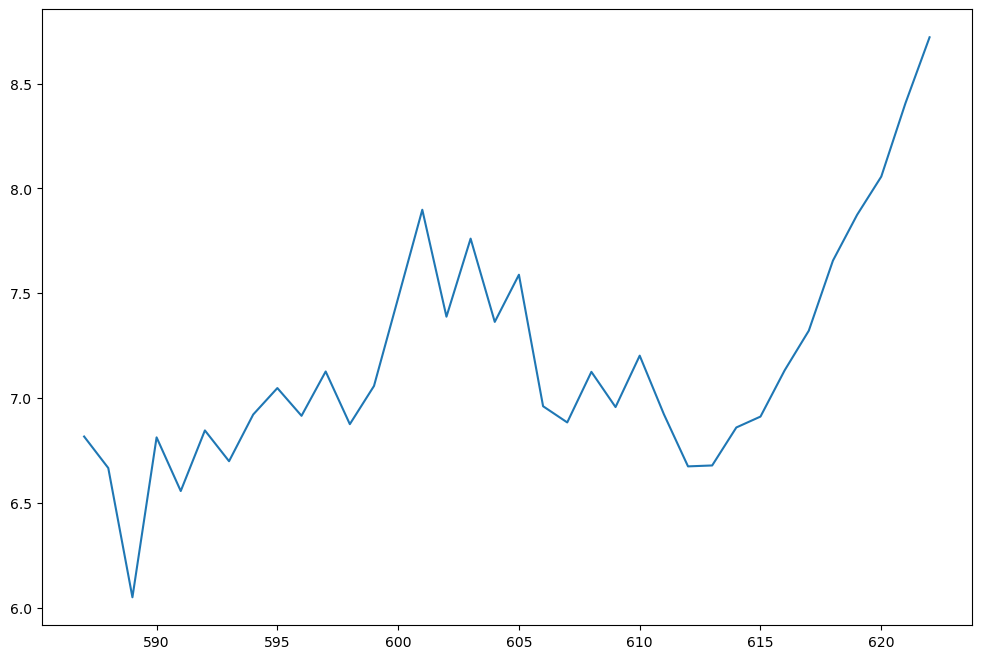

In [183]:
pre.plot(figsize=(12,8))

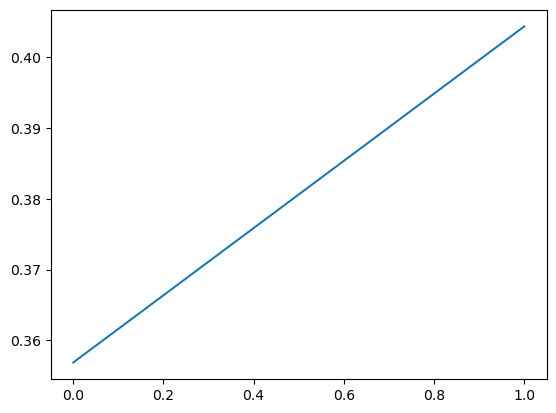

In [184]:
plt.plot(teszthiba)

## Többszörös LSTM

In [185]:
data = np.array(Vilagossz['Total Primary Energy Consumption'].loc[467:586]) # 120 havi adat

# Adatok előkészítése a modell számára
time_steps = 12  # Az előző 12 havi adatot használjuk az előrejelzéshez
X, y = [], []
for i in range(len(data) - time_steps):
    X.append(data[i:i+time_steps])
    y.append(data[i+time_steps])
X = np.array(X).reshape(-1, time_steps, 1)
y = np.array(y)

# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(data))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]



# LSTM modell létrehozása
model = Sequential()
#model.add(LSTM(64, input_shape=(time_steps, 1)))
model.add(LSTM(64, activation='relu', return_sequences=True, input_shape=(12, 1)))
model.add(LSTM(64, activation='relu', return_sequences=True))
model.add(LSTM(64, activation='relu'))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=1000, batch_size=32, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []

for _ in range(24):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)

print("Jövőbeli értékek előrejelzése:")
print(predictions)

Epoch 1/1000
3/3 [==============================] - 5s 37ms/step - loss: 64.6194
Epoch 2/1000
3/3 [==============================] - 0s 10ms/step - loss: 56.4063
Epoch 3/1000
3/3 [==============================] - 0s 9ms/step - loss: 37.8409
Epoch 4/1000
3/3 [==============================] - 0s 9ms/step - loss: 9.2859
Epoch 5/1000
3/3 [==============================] - 0s 9ms/step - loss: 5.3435
Epoch 6/1000
3/3 [==============================] - 0s 9ms/step - loss: 3.3945
Epoch 7/1000
3/3 [==============================] - 0s 9ms/step - loss: 4.5334
Epoch 8/1000
3/3 [==============================] - 0s 9ms/step - loss: 1.0660
Epoch 9/1000
3/3 [==============================] - 0s 9ms/step - loss: 1.8998
Epoch 10/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.7057
Epoch 11/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.8473
Epoch 12/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.8850
Epoch 13/1000
3/3 [=========================

3/3 [==============================] - 0s 10ms/step - loss: 0.1813
Epoch 104/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.1934
Epoch 105/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.1989
Epoch 106/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.1944
Epoch 107/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.1955
Epoch 108/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.1864
Epoch 109/1000
3/3 [==============================] - 0s 11ms/step - loss: 0.1836
Epoch 110/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.1800
Epoch 111/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.1889
Epoch 112/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.1918
Epoch 113/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.1773
Epoch 114/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.1834
Epoch 115/1000
3/3 [==============

3/3 [==============================] - 0s 9ms/step - loss: 0.0921
Epoch 204/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0817
Epoch 205/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0903
Epoch 206/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.0823
Epoch 207/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0844
Epoch 208/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0874
Epoch 209/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0821
Epoch 210/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.1014
Epoch 211/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0987
Epoch 212/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0836
Epoch 213/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0818
Epoch 214/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0754
Epoch 215/1000
3/3 [=====================

3/3 [==============================] - 0s 9ms/step - loss: 0.0818
Epoch 304/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0789
Epoch 305/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0756
Epoch 306/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0923
Epoch 307/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0586
Epoch 308/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0661
Epoch 309/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0687
Epoch 310/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0585
Epoch 311/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.0570
Epoch 312/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0683
Epoch 313/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0718
Epoch 314/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0654
Epoch 315/1000
3/3 [======================

3/3 [==============================] - 0s 8ms/step - loss: 0.0458
Epoch 405/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0453
Epoch 406/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0539
Epoch 407/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0549
Epoch 408/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0504
Epoch 409/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0464
Epoch 410/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0457
Epoch 411/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0463
Epoch 412/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0580
Epoch 413/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0602
Epoch 414/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0506
Epoch 415/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0499
Epoch 416/1000
3/3 [=======================

3/3 [==============================] - 0s 11ms/step - loss: 0.0602
Epoch 506/1000
3/3 [==============================] - 0s 11ms/step - loss: 0.0586
Epoch 507/1000
3/3 [==============================] - 0s 11ms/step - loss: 0.0624
Epoch 508/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.0598
Epoch 509/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0566
Epoch 510/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0511
Epoch 511/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0668
Epoch 512/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.0684
Epoch 513/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0540
Epoch 514/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0586
Epoch 515/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0416
Epoch 516/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0427
Epoch 517/1000
3/3 [==================

3/3 [==============================] - 0s 8ms/step - loss: 0.0340
Epoch 607/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0384
Epoch 608/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0391
Epoch 609/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0395
Epoch 610/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0361
Epoch 611/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0364
Epoch 612/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0429
Epoch 613/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0411
Epoch 614/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0597
Epoch 615/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0499
Epoch 616/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0529
Epoch 617/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0604
Epoch 618/1000
3/3 [=======================

3/3 [==============================] - 0s 9ms/step - loss: 0.0327
Epoch 708/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0346
Epoch 709/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0324
Epoch 710/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0316
Epoch 711/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0383
Epoch 712/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0375
Epoch 713/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0669
Epoch 714/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0519
Epoch 715/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0461
Epoch 716/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0345
Epoch 717/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0583
Epoch 718/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0442
Epoch 719/1000
3/3 [=======================

3/3 [==============================] - 0s 9ms/step - loss: 0.0398
Epoch 809/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0580
Epoch 810/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0407
Epoch 811/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0532
Epoch 812/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0637
Epoch 813/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0478
Epoch 814/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0733
Epoch 815/1000
3/3 [==============================] - 0s 10ms/step - loss: 0.0784
Epoch 816/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0830
Epoch 817/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0889
Epoch 818/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.1203
Epoch 819/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0912
Epoch 820/1000
3/3 [======================

3/3 [==============================] - 0s 8ms/step - loss: 0.0316
Epoch 910/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0288
Epoch 911/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0250
Epoch 912/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0278
Epoch 913/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0362
Epoch 914/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0251
Epoch 915/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0224
Epoch 916/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0209
Epoch 917/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0226
Epoch 918/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0201
Epoch 919/1000
3/3 [==============================] - 0s 8ms/step - loss: 0.0212
Epoch 920/1000
3/3 [==============================] - 0s 9ms/step - loss: 0.0231
Epoch 921/1000
3/3 [=======================

1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[8.873788, 9.188254, 8.057044, 8.331245, 7.2922063, 7.6493287, 7.830457, 8.379289, 8.274115, 7.6308036, 7.42839, 7.7801013, 8.577274, 8.8872, 7.7534056, 8.033035, 7.200887, 7.656727, 8.014879, 8.421999, 7.8780727, 7.7041774, 7.215679, 7.9724436]


In [186]:
len(diftran_full)

192

## LSTM optimalizáció 

In [187]:
#aktiváció relu, sigmoid, tanh, softmax
#lstm_batch_meret = 4,16,32,64,128,256
#batch_meret = 32,64,128
#optimalizalo: adam, rmsprop, 
def LSTM_opt(adatok=diftran_full,epochok=10,ciklus=3,batch_meret=32,
             vane_valid=False,
             lstm_neuron=64, lstm_neuron2=64, lstm_neuron3=64,
             optimizalo='adam',aktivacio='relu',veszteseg='mae',
             reteg_1=1,reteg_2=0,reteg_3=0, 
             predikció_hossza = 12,
             kell_kulcs=1):
    # Adatok előkészítése a modell számára
    data = np.array(adatok)
    # Az előző 12 havi adatot használjuk az előrejelzéshez
    X, y = [], []
    for i in range(len(data) - time_steps):
        X.append(data[i:i+time_steps])
        y.append(data[i+time_steps])
    X = np.array(X).reshape(-1, time_steps, 1)
    y = np.array(y)
    if vane_valid==True:
        # Adatok felosztása tanító, validációs és tesztadathalmazokra
        test_size = 156
        train_size = 78
        X_train,X_valid= X[:train_size], X[train_size:test_size]
        y_train,y_valid= y[:train_size], y[train_size:test_size]
        X_test, y_test = X[test_size:],y[test_size:]
    else:
        # Adatok felosztása tanító és tesztadathalmazokra
        train_size = 156
        X_train= X[:train_size]
        y_train= y[:train_size]
        X_test, y_test = X[train_size:],y[train_size:]
    


    # LSTM modell létrehozása
    model = Sequential()
    filepath1='yourmodelname.hdf5'
    #1. réteg
    if reteg_1 == 1 and reteg_2 == 0:
        model.add(LSTM(lstm_neuron, activation=aktivacio))
    elif reteg_1 == 2 and reteg_2 == 0:
        model.add(Bidirectional(LSTM(lstm_neuron, activation=aktivacio)))
    elif reteg_1 == 1 and reteg_2 != 0:
        model.add(LSTM(lstm_neuron, activation=aktivacio, return_sequences=True))
    elif reteg_1 == 2 and reteg_2 != 0:
        model.add(Bidirectional(LSTM(lstm_neuron, activation=aktivacio, return_sequences=True)))

    #2. réteg
    if reteg_2 == 1 and reteg_3 == 0:
        model.add(LSTM(lstm_neuron2, activation=aktivacio))
    elif reteg_2 == 2 and reteg_3 == 0:
        model.add(Bidirectional(LSTM(lstm_neuron2, activation=aktivacio)))
    elif reteg_2 == 1 and reteg_3 != 0:
        model.add(LSTM(lstm_neuron2, activation=aktivacio, return_sequences=True))
    elif reteg_2 == 2 and reteg_3 != 0:
        model.add(Bidirectional(LSTM(lstm_neuron2, activation=aktivacio, return_sequences=True)))
    
    #3. réteg
    if reteg_3 == 1 and reteg_2 !=0:
        model.add(LSTM(lstm_neuron3, activation=aktivacio))
    elif reteg_3 == 2 and reteg_2 !=0:
        model.add(Bidirectional(LSTM(lstm_neuron3, activation=aktivacio)))
                  
    model.add(Dense(1))
    model.add(Dropout(0.2))
    model.compile(optimizer=optimizalo, loss=veszteseg)
    # Modell tanítása
    teszthiba = []
    for x in range(ciklus):
        if vane_valid==True:
            model.fit(X_train, y_train, epochs=epochok, batch_size=batch_meret,validation_data=(X_valid, y_valid), verbose=1,callbacks=[checkpointer])
        else:
            model.fit(X_train, y_train, epochs=epochok, batch_size=batch_meret, verbose=1)
        # Modell kiértékelése a tesztadathalmazon
        loss = model.evaluate(X_test, y_test)
        print(f"Teszt hiba: {loss}")
        teszthiba.append(loss)
    
    # Jövőbeli értékek előrejelzése
    if vane_valid==True:
        try:
            model.load_weights(filepath1)
            print("volt jobb modell")
        except:
            print("nem volt jobb modell")
    #predikció megszerzése
    future_data = data[-time_steps:].reshape(1, time_steps, 1)
    predictions = []
    for _ in range(predikció_hossza):
        prediction = model.predict(future_data)
        predictions.append(prediction[0][0])
        future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)
    print("Jövőbeli értékek előrejelzése:")
    print(predictions)
    
    nyers_teszt =model.predict(X_test).reshape(24)
    teszt_prediction = model.predict(X_test).reshape(24)
    if kell_kulcs == 1:
        preddk = visszafejtolstm(predictions)
        teszt_prediction = visszafejtolstm(teszt_prediction,1)
        Mae = mean_absolute_error(vilagtestt,teszt_prediction)
    elif kell_kulcs==2:
        preddk = visszafejtolstm(predictions)
        teszt_prediction = visszafejtolstm(teszt_prediction,1)
        Mae = mean_absolute_error(vilagtestt,teszt_prediction)
    else:
        preddk = predictions
        Mae = mean_absolute_error(vilagtestt,teszt_prediction)
    #os.remove('yourmodelname.hdf5')
    #checkpointer = ModelCheckpoint(filepath=filepath1, 
                               #monitor='val_loss', 
                               #verbose=1, 
                               #save_best_only=True)
    return preddk,teszt_prediction,Mae

In [188]:
#Általános szabály empírikus adatok alapján: a nyersadatot nagyon kilapítja az LSTM, nem tudja megtanulni a sor varianciáját
#Azonban jóval jobb hibaszázalékot tud hozni, ezért azt ha monoton növekszik vagy csökken el kell dobni
#A differenciált adaton meg tudja tanulni a varianciát, azonban sokkal nehezebb neki jó végeredményt hoznia a teszt halmazra

In [196]:
dfLSTM= pd.DataFrame()
dfLSTM['adatforrás'] = None
dfLSTM['aktiváció'] = None
dfLSTM['Batch méret'] = None
dfLSTM['MAE']=None
dfLSTM['Konfiguráció']=None
dfLSTM['Predikció']=None

In [190]:
predi=LSTM_opt(adatok=diftran_full,epochok=10,ciklus=3,batch_meret=32,
               vane_valid=True,reteg_1=1,reteg_2=2,reteg_3=1,
               lstm_neuron=256, lstm_neuron2=128, lstm_neuron3=64,
               kell_kulcs=1)
dfLSTM = dfLSTM.append({'adatforrás':'diftran_full','aktiváció':'sigmoid','Batch méret':32,'MAE': predi[2],'Konfiguráció': xzy, 'Predikció':predi[0]}, ignore_index=True)

Epoch 1/10
3/3 [==============================] - ETA: 0s - loss: 0.5353
Epoch 1: val_loss did not improve from 0.24252
3/3 [==============================] - 5s 263ms/step - loss: 0.5353 - val_loss: 0.5692
Epoch 2/10
3/3 [==============================] - ETA: 0s - loss: 0.5325
Epoch 2: val_loss did not improve from 0.24252
3/3 [==============================] - 0s 58ms/step - loss: 0.5325 - val_loss: 0.5690
Epoch 3/10
3/3 [==============================] - ETA: 0s - loss: 0.5339
Epoch 3: val_loss did not improve from 0.24252
3/3 [==============================] - 0s 59ms/step - loss: 0.5339 - val_loss: 0.5687
Epoch 4/10
3/3 [==============================] - ETA: 0s - loss: 0.5268
Epoch 4: val_loss did not improve from 0.24252
3/3 [==============================] - 0s 59ms/step - loss: 0.5268 - val_loss: 0.5682
Epoch 5/10
3/3 [==============================] - ETA: 0s - loss: 0.5225
Epoch 5: val_loss did not improve from 0.24252
3/3 [==============================] - 0s 57ms/step - l

In [203]:
#differenciált transzformált
batch=[32]
aktivacio=['sigmoid','relu','tanh']
for z in range(0,3):
    for y in range(0,3):
        if y == 0 and z!=0:
            continue
        for x in range(1,3):
            filepath1 = str('sajat_file_sulyok'+''+str(x)+str(y)+str(z))
            checkpointer = ModelCheckpoint(filepath=filepath1, monitor='val_loss', verbose=1,save_weights_only = True, save_best_only=True)
            for akt in aktivacio:
                for bat in batch:
                    predi=LSTM_opt(adatok=diftran_full,epochok=50,ciklus=40,batch_meret=bat,
                                    vane_valid=True,reteg_1=x,reteg_2=y,reteg_3=z,
                                    lstm_neuron=128, lstm_neuron2=64, lstm_neuron3=64, aktivacio=akt,
                                    kell_kulcs=1)
                    konfig =str(x) + str(y) + str(z)
                    dfLSTM = dfLSTM.append({'adatforrás':'diftran_full','aktiváció':akt,'Batch méret':bat,'MAE': predi[2],'Konfiguráció': konfig,'Predikció':predi[0]}, ignore_index=True)
            


Epoch 1/50
1/3 [=========>....................] - ETA: 2s - loss: 0.6407
Epoch 1: val_loss improved from inf to 0.56859, saving model to sajat_file_sulyok100
3/3 [==============================] - 1s 117ms/step - loss: 0.5599 - val_loss: 0.5686
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5223
Epoch 2: val_loss did not improve from 0.56859
3/3 [==============================] - 0s 22ms/step - loss: 0.5889 - val_loss: 0.5901
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.6612
Epoch 3: val_loss improved from 0.56859 to 0.56640, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 35ms/step - loss: 0.5510 - val_loss: 0.5664
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5402
Epoch 4: val_loss improved from 0.56640 to 0.55775, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 37ms/step - loss: 0.5521 - val_loss: 0.5578
Epoch 5/50
1/3 [=========>....................] - ETA

1/3 [=========>....................] - ETA: 0s - loss: 0.4183
Epoch 34: val_loss improved from 0.46267 to 0.45902, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 35ms/step - loss: 0.4080 - val_loss: 0.4590
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4271
Epoch 35: val_loss improved from 0.45902 to 0.45458, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 40ms/step - loss: 0.4242 - val_loss: 0.4546
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3838
Epoch 36: val_loss improved from 0.45458 to 0.45096, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 35ms/step - loss: 0.4129 - val_loss: 0.4510
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4319
Epoch 37: val_loss improved from 0.45096 to 0.44779, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 39ms/step - loss: 0.3946 - val_loss: 0.4478
Epoch 38/50


3/3 [==============================] - 0s 21ms/step - loss: 0.3627 - val_loss: 0.3902
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4048
Epoch 19: val_loss did not improve from 0.38025
3/3 [==============================] - 0s 23ms/step - loss: 0.3420 - val_loss: 0.3840
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2567
Epoch 20: val_loss did not improve from 0.38025
3/3 [==============================] - 0s 21ms/step - loss: 0.3363 - val_loss: 0.3904
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3374
Epoch 21: val_loss did not improve from 0.38025
3/3 [==============================] - 0s 21ms/step - loss: 0.3838 - val_loss: 0.3805
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 22: val_loss improved from 0.38025 to 0.37843, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 36ms/step - loss: 0.3572 - val_loss: 0.3784
Epoch 23/50
1/3 [=========>.............

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3257
Epoch 5: val_loss did not improve from 0.36567
3/3 [==============================] - 0s 22ms/step - loss: 0.3320 - val_loss: 0.3676
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2821
Epoch 6: val_loss did not improve from 0.36567
3/3 [==============================] - 0s 22ms/step - loss: 0.3002 - val_loss: 0.3668
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3154
Epoch 7: val_loss improved from 0.36567 to 0.36542, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 36ms/step - loss: 0.3044 - val_loss: 0.3654
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3408
Epoch 8: val_loss did not improve from 0.36542
3/3 [==============================] - 0s 20ms/step - loss: 0.3488 - val_loss: 0.3669
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3050
Epoch 9: val_loss improved from 0.36542 to 0.36537, saving mo

1/3 [=========>....................] - ETA: 0s - loss: 0.4225
Epoch 43: val_loss did not improve from 0.36336
3/3 [==============================] - 0s 22ms/step - loss: 0.3287 - val_loss: 0.3639
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2998
Epoch 44: val_loss did not improve from 0.36336
3/3 [==============================] - 0s 22ms/step - loss: 0.2957 - val_loss: 0.3679
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3237
Epoch 45: val_loss did not improve from 0.36336
3/3 [==============================] - 0s 22ms/step - loss: 0.3234 - val_loss: 0.3642
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3223
Epoch 46: val_loss did not improve from 0.36336
3/3 [==============================] - 0s 21ms/step - loss: 0.3072 - val_loss: 0.3673
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2740
Epoch 47: val_loss did not improve from 0.36336
3/3 [==============================] - 0s 22ms/step - loss

3/3 [==============================] - 0s 22ms/step - loss: 0.2633 - val_loss: 0.3592
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3873
Epoch 31: val_loss did not improve from 0.35908
3/3 [==============================] - 0s 21ms/step - loss: 0.3347 - val_loss: 0.3595
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 32: val_loss did not improve from 0.35908
3/3 [==============================] - 0s 22ms/step - loss: 0.3074 - val_loss: 0.3600
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3093
Epoch 33: val_loss improved from 0.35908 to 0.35836, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 37ms/step - loss: 0.2972 - val_loss: 0.3584
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2920
Epoch 34: val_loss did not improve from 0.35836
3/3 [==============================] - 0s 21ms/step - loss: 0.3202 - val_loss: 0.3610
Epoch 35/50
1/3 [=========>.............

3/3 [==============================] - 0s 22ms/step - loss: 0.3222 - val_loss: 0.3603
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2819
Epoch 20: val_loss did not improve from 0.35836
3/3 [==============================] - 0s 22ms/step - loss: 0.3305 - val_loss: 0.3645
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3149
Epoch 21: val_loss did not improve from 0.35836
3/3 [==============================] - 0s 21ms/step - loss: 0.3101 - val_loss: 0.3598
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2212
Epoch 22: val_loss did not improve from 0.35836
3/3 [==============================] - 0s 22ms/step - loss: 0.3076 - val_loss: 0.3617
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2831
Epoch 23: val_loss did not improve from 0.35836
3/3 [==============================] - 0s 24ms/step - loss: 0.3035 - val_loss: 0.3633
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3178
Epoch 24

3/3 [==============================] - 0s 22ms/step - loss: 0.3220 - val_loss: 0.3695
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3799
Epoch 9: val_loss did not improve from 0.35836
3/3 [==============================] - 0s 23ms/step - loss: 0.3364 - val_loss: 0.3639
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3033
Epoch 10: val_loss did not improve from 0.35836
3/3 [==============================] - 0s 22ms/step - loss: 0.3401 - val_loss: 0.3686
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3353
Epoch 11: val_loss did not improve from 0.35836
3/3 [==============================] - 0s 21ms/step - loss: 0.3279 - val_loss: 0.3639
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3558
Epoch 12: val_loss did not improve from 0.35836
3/3 [==============================] - 0s 22ms/step - loss: 0.3467 - val_loss: 0.3768
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3483
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3421
Epoch 48: val_loss did not improve from 0.35819
3/3 [==============================] - 0s 20ms/step - loss: 0.3046 - val_loss: 0.3587
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3248
Epoch 49: val_loss did not improve from 0.35819
3/3 [==============================] - 0s 20ms/step - loss: 0.3370 - val_loss: 0.3591
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3651
Epoch 50: val_loss did not improve from 0.35819
1/1 [==============================] - 0s 18ms/step - loss: 0.3527
Teszt hiba: 0.3526587188243866
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2744
Epoch 1: val_loss did not improve from 0.35819
3/3 [==============================] - 0s 32ms/step - loss: 0.3243 - val_loss: 0.3587
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2976
Epoch 2: val_loss did not improve from 0.35819
3/3 [==============================] -

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3402
Epoch 37: val_loss did not improve from 0.35596
3/3 [==============================] - 0s 20ms/step - loss: 0.2942 - val_loss: 0.3567
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3754
Epoch 38: val_loss did not improve from 0.35596
3/3 [==============================] - 0s 21ms/step - loss: 0.3300 - val_loss: 0.3575
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3390
Epoch 39: val_loss did not improve from 0.35596
3/3 [==============================] - 0s 20ms/step - loss: 0.3489 - val_loss: 0.3622
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3088
Epoch 40: val_loss did not improve from 0.35596
3/3 [==============================] - 0s 20ms/step - loss: 0.3043 - val_loss: 0.3621
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3058
Epoch 41: val_loss did not improve from 0.35596
3/3 [==============================] - 0s 20ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3268
Epoch 26: val_loss did not improve from 0.35596
3/3 [==============================] - 0s 20ms/step - loss: 0.3183 - val_loss: 0.3630
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2847
Epoch 27: val_loss did not improve from 0.35596
3/3 [==============================] - 0s 20ms/step - loss: 0.3425 - val_loss: 0.3622
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3074
Epoch 28: val_loss did not improve from 0.35596
3/3 [==============================] - 0s 20ms/step - loss: 0.2882 - val_loss: 0.3575
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3309
Epoch 29: val_loss did not improve from 0.35596
3/3 [==============================] - 0s 20ms/step - loss: 0.3031 - val_loss: 0.3599
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3116
Epoch 30: val_loss did not improve from 0.35596
3/3 [==============================] - 0s 20ms

3/3 [==============================] - 0s 20ms/step - loss: 0.2995 - val_loss: 0.3515
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2998
Epoch 15: val_loss did not improve from 0.35019
3/3 [==============================] - 0s 21ms/step - loss: 0.2884 - val_loss: 0.3520
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 16: val_loss did not improve from 0.35019
3/3 [==============================] - 0s 21ms/step - loss: 0.2878 - val_loss: 0.3559
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3332
Epoch 17: val_loss did not improve from 0.35019
3/3 [==============================] - 0s 20ms/step - loss: 0.2722 - val_loss: 0.3544
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3198
Epoch 18: val_loss did not improve from 0.35019
3/3 [==============================] - 0s 21ms/step - loss: 0.2859 - val_loss: 0.3524
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3183
Epoch 19

1/3 [=========>....................] - ETA: 0s - loss: 0.2994
Epoch 3: val_loss did not improve from 0.34929
3/3 [==============================] - 0s 21ms/step - loss: 0.2995 - val_loss: 0.3495
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2668
Epoch 4: val_loss did not improve from 0.34929
3/3 [==============================] - 0s 35ms/step - loss: 0.2762 - val_loss: 0.3517
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3462
Epoch 5: val_loss did not improve from 0.34929
3/3 [==============================] - 0s 29ms/step - loss: 0.3158 - val_loss: 0.3499
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3097
Epoch 6: val_loss did not improve from 0.34929
3/3 [==============================] - 0s 21ms/step - loss: 0.2821 - val_loss: 0.3500
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2996
Epoch 7: val_loss did not improve from 0.34929
3/3 [==============================] - 0s 20ms/step - loss: 0.2832 

1/3 [=========>....................] - ETA: 0s - loss: 0.3246
Epoch 42: val_loss did not improve from 0.34608
3/3 [==============================] - 0s 21ms/step - loss: 0.3131 - val_loss: 0.3516
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3502
Epoch 43: val_loss did not improve from 0.34608
3/3 [==============================] - 0s 22ms/step - loss: 0.2872 - val_loss: 0.3516
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3152
Epoch 44: val_loss did not improve from 0.34608
3/3 [==============================] - 0s 22ms/step - loss: 0.3150 - val_loss: 0.3532
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2984
Epoch 45: val_loss did not improve from 0.34608
3/3 [==============================] - 0s 21ms/step - loss: 0.2884 - val_loss: 0.3542
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3384
Epoch 46: val_loss did not improve from 0.34608
3/3 [==============================] - 0s 21ms/step - loss

3/3 [==============================] - 0s 20ms/step - loss: 0.3112 - val_loss: 0.3472
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3398
Epoch 31: val_loss did not improve from 0.34304
3/3 [==============================] - 0s 21ms/step - loss: 0.3114 - val_loss: 0.3479
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2902
Epoch 32: val_loss did not improve from 0.34304
3/3 [==============================] - 0s 21ms/step - loss: 0.3022 - val_loss: 0.3471
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2723
Epoch 33: val_loss did not improve from 0.34304
3/3 [==============================] - 0s 20ms/step - loss: 0.2993 - val_loss: 0.3456
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2451
Epoch 34: val_loss did not improve from 0.34304
3/3 [==============================] - 0s 20ms/step - loss: 0.2761 - val_loss: 0.3454
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3062
Epoch 35

3/3 [==============================] - 0s 20ms/step - loss: 0.3000 - val_loss: 0.3460
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2616
Epoch 20: val_loss improved from 0.34134 to 0.34122, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 34ms/step - loss: 0.2806 - val_loss: 0.3412
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3267
Epoch 21: val_loss did not improve from 0.34122
3/3 [==============================] - 0s 22ms/step - loss: 0.3140 - val_loss: 0.3478
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2989
Epoch 22: val_loss did not improve from 0.34122
3/3 [==============================] - 0s 23ms/step - loss: 0.3314 - val_loss: 0.3425
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2867
Epoch 23: val_loss did not improve from 0.34122
3/3 [==============================] - 0s 22ms/step - loss: 0.3127 - val_loss: 0.3446
Epoch 24/50
1/3 [=========>.............

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3170
Epoch 8: val_loss did not improve from 0.33825
3/3 [==============================] - 0s 21ms/step - loss: 0.2928 - val_loss: 0.3465
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3388
Epoch 9: val_loss did not improve from 0.33825
3/3 [==============================] - 0s 20ms/step - loss: 0.2786 - val_loss: 0.3455
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2114
Epoch 10: val_loss did not improve from 0.33825
3/3 [==============================] - 0s 21ms/step - loss: 0.2775 - val_loss: 0.3412
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 11: val_loss did not improve from 0.33825
3/3 [==============================] - 0s 21ms/step - loss: 0.2968 - val_loss: 0.3396
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2306
Epoch 12: val_loss did not improve from 0.33825
3/3 [==============================] - 0s 23ms/ste

1/3 [=========>....................] - ETA: 0s - loss: 0.2232
Epoch 47: val_loss did not improve from 0.33410
3/3 [==============================] - 0s 20ms/step - loss: 0.2680 - val_loss: 0.3492
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3131
Epoch 48: val_loss did not improve from 0.33410
3/3 [==============================] - 0s 20ms/step - loss: 0.3148 - val_loss: 0.3479
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3623
Epoch 49: val_loss did not improve from 0.33410
3/3 [==============================] - 0s 21ms/step - loss: 0.3251 - val_loss: 0.3452
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3186
Epoch 50: val_loss did not improve from 0.33410
1/1 [==============================] - 0s 21ms/step - loss: 0.3506
Teszt hiba: 0.3505757749080658
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2821
Epoch 1: val_loss did not improve from 0.33410
3/3 [==============================] - 0s 33ms/s

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3516
Epoch 36: val_loss did not improve from 0.33377
3/3 [==============================] - 0s 21ms/step - loss: 0.3160 - val_loss: 0.3384
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3089
Epoch 37: val_loss did not improve from 0.33377
3/3 [==============================] - 0s 23ms/step - loss: 0.3141 - val_loss: 0.3385
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3586
Epoch 38: val_loss did not improve from 0.33377
3/3 [==============================] - 0s 23ms/step - loss: 0.2774 - val_loss: 0.3399
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3336
Epoch 39: val_loss did not improve from 0.33377
3/3 [==============================] - 0s 22ms/step - loss: 0.3059 - val_loss: 0.3426
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3304
Epoch 40: val_loss did not improve from 0.33377
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2471
Epoch 23: val_loss did not improve from 0.32738
3/3 [==============================] - 0s 22ms/step - loss: 0.2597 - val_loss: 0.3334
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2593
Epoch 24: val_loss did not improve from 0.32738
3/3 [==============================] - 0s 22ms/step - loss: 0.3005 - val_loss: 0.3337
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3317
Epoch 25: val_loss did not improve from 0.32738
3/3 [==============================] - 0s 20ms/step - loss: 0.3077 - val_loss: 0.3341
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2704
Epoch 26: val_loss did not improve from 0.32738
3/3 [==============================] - 0s 20ms/step - loss: 0.2964 - val_loss: 0.3326
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2941
Epoch 27: val_loss did not improve from 0.32738
3/3 [==============================] - 0s 20ms/step - loss

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 11: val_loss did not improve from 0.31819
3/3 [==============================] - 0s 22ms/step - loss: 0.2887 - val_loss: 0.3248
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2517
Epoch 12: val_loss did not improve from 0.31819
3/3 [==============================] - 0s 22ms/step - loss: 0.2860 - val_loss: 0.3205
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3135
Epoch 13: val_loss did not improve from 0.31819
3/3 [==============================] - 0s 22ms/step - loss: 0.3197 - val_loss: 0.3193
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3644
Epoch 14: val_loss did not improve from 0.31819
3/3 [==============================] - 0s 21ms/step - loss: 0.3124 - val_loss: 0.3183
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2232
Epoch 15: val_loss improved from 0.31819 to 0.31716, saving model to sajat_file_sulyok100
3/3 

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3343
Epoch 49: val_loss did not improve from 0.30979
3/3 [==============================] - 0s 22ms/step - loss: 0.2799 - val_loss: 0.3118
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2834
Epoch 50: val_loss improved from 0.30979 to 0.30922, saving model to sajat_file_sulyok100
1/1 [==============================] - 0s 20ms/step - loss: 0.3203
Teszt hiba: 0.3203355073928833
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 1: val_loss improved from 0.30922 to 0.30880, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 48ms/step - loss: 0.2789 - val_loss: 0.3088
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2699
Epoch 2: val_loss improved from 0.30880 to 0.30748, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 34ms/step - loss: 0.2780 - val_loss: 0.3075
Epoch 3/50
1/3 [=========>........

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2591
Epoch 36: val_loss did not improve from 0.29344
3/3 [==============================] - 0s 21ms/step - loss: 0.2422 - val_loss: 0.2986
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2036
Epoch 37: val_loss did not improve from 0.29344
3/3 [==============================] - 0s 21ms/step - loss: 0.2692 - val_loss: 0.3029
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2908
Epoch 38: val_loss did not improve from 0.29344
3/3 [==============================] - 0s 21ms/step - loss: 0.2672 - val_loss: 0.3011
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2707
Epoch 39: val_loss did not improve from 0.29344
3/3 [==============================] - 0s 20ms/step - loss: 0.2873 - val_loss: 0.3015
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2313
Epoch 40: val_loss did not improve from 0.29344
3/3 [==============================] - 0s 20ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2492
Epoch 23: val_loss did not improve from 0.26336
3/3 [==============================] - 0s 20ms/step - loss: 0.2680 - val_loss: 0.2805
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2226
Epoch 24: val_loss did not improve from 0.26336
3/3 [==============================] - 0s 20ms/step - loss: 0.2578 - val_loss: 0.2855
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2710
Epoch 25: val_loss did not improve from 0.26336
3/3 [==============================] - 0s 21ms/step - loss: 0.2737 - val_loss: 0.2836
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2136
Epoch 26: val_loss did not improve from 0.26336
3/3 [==============================] - 0s 20ms/step - loss: 0.2644 - val_loss: 0.2865
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2691
Epoch 27: val_loss did not improve from 0.26336
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1314
Epoch 11: val_loss did not improve from 0.24774
3/3 [==============================] - 0s 20ms/step - loss: 0.1912 - val_loss: 0.2557
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2682
Epoch 12: val_loss did not improve from 0.24774
3/3 [==============================] - 0s 20ms/step - loss: 0.2438 - val_loss: 0.2555
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 13: val_loss did not improve from 0.24774
3/3 [==============================] - 0s 20ms/step - loss: 0.2270 - val_loss: 0.2563
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2326
Epoch 14: val_loss did not improve from 0.24774
3/3 [==============================] - 0s 20ms/step - loss: 0.2179 - val_loss: 0.2528
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2054
Epoch 15: val_loss did not improve from 0.24774
3/3 [==============================] - 0s 20ms/step - loss

Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2229
Epoch 50: val_loss did not improve from 0.24392
1/1 [==============================] - 0s 19ms/step - loss: 0.3282
Teszt hiba: 0.32817503809928894
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1763
Epoch 1: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 32ms/step - loss: 0.1972 - val_loss: 0.2525
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2185
Epoch 2: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 21ms/step - loss: 0.2466 - val_loss: 0.2499
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2352
Epoch 3: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 20ms/step - loss: 0.2186 - val_loss: 0.2514
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2029
Epoch 4: val_loss did not improve from 0.24392
3/3 [==============================] - 0s

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2291
Epoch 39: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 20ms/step - loss: 0.2208 - val_loss: 0.2527
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1631
Epoch 40: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 21ms/step - loss: 0.2068 - val_loss: 0.2529
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 41: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 21ms/step - loss: 0.1968 - val_loss: 0.2517
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 42: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 21ms/step - loss: 0.1901 - val_loss: 0.2517
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2169
Epoch 43: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 20ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 28: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 20ms/step - loss: 0.1996 - val_loss: 0.2491
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1834
Epoch 29: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 20ms/step - loss: 0.1876 - val_loss: 0.2449
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 30: val_loss improved from 0.24392 to 0.24231, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 35ms/step - loss: 0.2240 - val_loss: 0.2423
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1865
Epoch 31: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 20ms/step - loss: 0.1948 - val_loss: 0.2433
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2245
Epoch 32: val_loss did not improve from 0.24231
3/3 

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2748
Epoch 17: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 22ms/step - loss: 0.2412 - val_loss: 0.2507
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2240
Epoch 18: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 22ms/step - loss: 0.2178 - val_loss: 0.2451
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1926
Epoch 19: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 21ms/step - loss: 0.2193 - val_loss: 0.2467
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1947
Epoch 20: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 21ms/step - loss: 0.2089 - val_loss: 0.2503
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2185
Epoch 21: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 20ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 6: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 21ms/step - loss: 0.2114 - val_loss: 0.2609
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2667
Epoch 7: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 20ms/step - loss: 0.2176 - val_loss: 0.2586
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 8: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 20ms/step - loss: 0.2089 - val_loss: 0.2541
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2268
Epoch 9: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 20ms/step - loss: 0.2486 - val_loss: 0.2495
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 10: val_loss did not improve from 0.24231
3/3 [==============================] - 0s 21ms/step - 

Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2160
Epoch 45: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 21ms/step - loss: 0.2170 - val_loss: 0.2564
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 46: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 21ms/step - loss: 0.2025 - val_loss: 0.2590
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2303
Epoch 47: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 26ms/step - loss: 0.2605 - val_loss: 0.2597
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 48: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 21ms/step - loss: 0.2350 - val_loss: 0.2599
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2437
Epoch 49: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 21ms

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2113
Epoch 34: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 21ms/step - loss: 0.2412 - val_loss: 0.2524
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2289
Epoch 35: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 20ms/step - loss: 0.2058 - val_loss: 0.2579
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2063
Epoch 36: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 21ms/step - loss: 0.2090 - val_loss: 0.2583
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2091
Epoch 37: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 21ms/step - loss: 0.2280 - val_loss: 0.2529
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2640
Epoch 38: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 20ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 23: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 21ms/step - loss: 0.2360 - val_loss: 0.2475
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1591
Epoch 24: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 20ms/step - loss: 0.1857 - val_loss: 0.2474
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 25: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 20ms/step - loss: 0.2155 - val_loss: 0.2440
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 26: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 20ms/step - loss: 0.1867 - val_loss: 0.2410
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 27: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 12: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 21ms/step - loss: 0.2204 - val_loss: 0.2555
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1270
Epoch 13: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 20ms/step - loss: 0.1647 - val_loss: 0.2546
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 14: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 20ms/step - loss: 0.1917 - val_loss: 0.2513
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 15: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 20ms/step - loss: 0.2250 - val_loss: 0.2477
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 16: val_loss did not improve from 0.23956
3/3 [==============================] - 0s 20ms/step - loss

1/1 [==============================] - 0s 19ms/step - loss: 0.3230
Teszt hiba: 0.3230397701263428
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 1: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 34ms/step - loss: 0.2202 - val_loss: 0.2496
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 2: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 21ms/step - loss: 0.1958 - val_loss: 0.2583
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 3: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss: 0.1936 - val_loss: 0.2610
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 4: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss: 0.1884 - val_loss: 0.2609
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch

1/3 [=========>....................] - ETA: 0s - loss: 0.2354
Epoch 40: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 21ms/step - loss: 0.1886 - val_loss: 0.2479
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 41: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss: 0.2187 - val_loss: 0.2484
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2990
Epoch 42: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss: 0.2508 - val_loss: 0.2515
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2404
Epoch 43: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 21ms/step - loss: 0.2275 - val_loss: 0.2573
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1821
Epoch 44: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2143
Epoch 29: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 22ms/step - loss: 0.2413 - val_loss: 0.2509
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1634
Epoch 30: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 22ms/step - loss: 0.2003 - val_loss: 0.2476
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 31: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 22ms/step - loss: 0.1783 - val_loss: 0.2474
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2544
Epoch 32: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 22ms/step - loss: 0.2496 - val_loss: 0.2496
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 33: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2347
Epoch 18: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss: 0.2253 - val_loss: 0.2477
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 19: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss: 0.1762 - val_loss: 0.2507
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1833
Epoch 20: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 21ms/step - loss: 0.1987 - val_loss: 0.2541
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 21: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss: 0.1776 - val_loss: 0.2541
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2725
Epoch 22: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2210
Epoch 7: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 23ms/step - loss: 0.2126 - val_loss: 0.2359
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2018
Epoch 8: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 21ms/step - loss: 0.1982 - val_loss: 0.2433
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 9: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 21ms/step - loss: 0.2243 - val_loss: 0.2515
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 10: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 22ms/step - loss: 0.1944 - val_loss: 0.2576
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1462
Epoch 11: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 21ms/step - loss: 0.1

3/3 [==============================] - 0s 20ms/step - loss: 0.1833 - val_loss: 0.2505
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1970
Epoch 47: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss: 0.2187 - val_loss: 0.2431
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 48: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss: 0.1850 - val_loss: 0.2419
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 49: val_loss did not improve from 0.23331
3/3 [==============================] - 0s 20ms/step - loss: 0.1882 - val_loss: 0.2435
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2459
Epoch 50: val_loss did not improve from 0.23331
1/1 [==============================] - 0s 18ms/step - loss: 0.3285
Teszt hiba: 0.3285277187824249
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.22

3/3 [==============================] - 0s 23ms/step - loss: 0.1753 - val_loss: 0.2597
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2399
Epoch 36: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.2142 - val_loss: 0.2545
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1720
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1846 - val_loss: 0.2495
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 38: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1794 - val_loss: 0.2447
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1847 - val_loss: 0.2501
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1998
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1779
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2025 - val_loss: 0.2544
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1470
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1952 - val_loss: 0.2553
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1573
Epoch 27: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1878 - val_loss: 0.2569
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1836 - val_loss: 0.2544
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2429
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1528
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2290 - val_loss: 0.2479
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2286
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1998 - val_loss: 0.2487
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 16: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1975 - val_loss: 0.2509
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1852 - val_loss: 0.2506
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2545
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1842 - val_loss: 0.2523
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1945 - val_loss: 0.2567
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2007 - val_loss: 0.2555
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2412
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2161 - val_loss: 0.2541
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - lo

3/3 [==============================] - 0s 22ms/step - loss: 0.1942 - val_loss: 0.2480
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1732
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1854 - val_loss: 0.2531
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1954
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1764 - val_loss: 0.2528
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 45: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2043 - val_loss: 0.2506
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2012
Epoch 46: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2125 - val_loss: 0.2535
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2270
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2239 - val_loss: 0.2511
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1838
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2231 - val_loss: 0.2501
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1472 - val_loss: 0.2495
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 35: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1761 - val_loss: 0.2493
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2158
Epoch 36: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1634 - val_loss: 0.2427
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1705 - val_loss: 0.2463
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2091 - val_loss: 0.2493
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2187
Epoch 24: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1833 - val_loss: 0.2478
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1846
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2036
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2055 - val_loss: 0.2590
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1720
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2001 - val_loss: 0.2529
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1944 - val_loss: 0.2411
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1838
Epoch 13: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1891 - val_loss: 0.2324
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms

3/3 [==============================] - 0s 20ms/step - loss: 0.1694 - val_loss: 0.2548
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1871
Epoch 50: val_loss did not improve from 0.23091
1/1 [==============================] - 0s 19ms/step - loss: 0.3438
Teszt hiba: 0.34380480647087097
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1972
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 33ms/step - loss: 0.2267 - val_loss: 0.2660
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2004 - val_loss: 0.2647
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1871
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1844 - val_loss: 0.2566
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Ep

3/3 [==============================] - 0s 20ms/step - loss: 0.1830 - val_loss: 0.2413
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2064
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1963 - val_loss: 0.2395
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2356
Epoch 40: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1781 - val_loss: 0.2476
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2203
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1953 - val_loss: 0.2556
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1987
Epoch 42: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2148 - val_loss: 0.2542
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2110 - val_loss: 0.2496
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1905 - val_loss: 0.2489
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1726
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1838 - val_loss: 0.2540
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1465
Epoch 31: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1669 - val_loss: 0.2553
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1789
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2227 - val_loss: 0.2548
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1764
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1894 - val_loss: 0.2489
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1908 - val_loss: 0.2414
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1300
Epoch 20: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1720 - val_loss: 0.2384
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

3/3 [==============================] - 1s 97ms/step - loss: 0.5350 - val_loss: 0.5652
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5383
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.5267 - val_loss: 0.5609
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5638
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.5235 - val_loss: 0.5570
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4570
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.5143 - val_loss: 0.5537
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5289
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.5069 - val_loss: 0.5500
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5626
Epoch 6: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.3160
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.3062 - val_loss: 0.3482
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2555
Epoch 42: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.2838 - val_loss: 0.3592
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3540
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.3175 - val_loss: 0.3661
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3805
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.3373 - val_loss: 0.3579
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3183
Epoch 45: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2197 - val_loss: 0.2600
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2254
Epoch 31: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2162 - val_loss: 0.2690
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2110 - val_loss: 0.2694
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2279 - val_loss: 0.2714
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2981
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2318
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2342 - val_loss: 0.2634
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 20: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2523 - val_loss: 0.2568
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2538
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2548 - val_loss: 0.2556
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2581
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2611 - val_loss: 0.2605
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2237
Epoch 8: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2349 - val_loss: 0.2762
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2292
Epoch 9: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2134 - val_loss: 0.2589
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1954
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.2193 - val_loss: 0.2570
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2152
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2251 - val_loss: 0.2663
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2892
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0

3/3 [==============================] - 0s 21ms/step - loss: 0.2272 - val_loss: 0.2588
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2665
Epoch 48: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2260 - val_loss: 0.2717
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3070
Epoch 49: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2490 - val_loss: 0.2793
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2529
Epoch 50: val_loss did not improve from 0.23091
1/1 [==============================] - 0s 19ms/step - loss: 0.3501
Teszt hiba: 0.3500925302505493
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1840
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 32ms/step - loss: 0.1836 - val_loss: 0.2596
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2190

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2310
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2412 - val_loss: 0.2789
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 38: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1856 - val_loss: 0.2618
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2106 - val_loss: 0.2562
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2586
Epoch 40: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2109 - val_loss: 0.2629
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2011
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2057 - val_loss: 0.2690
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 27: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1938 - val_loss: 0.2516
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1865
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2213 - val_loss: 0.2479
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2096
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2297 - val_loss: 0.2630
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2461
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1597
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1994 - val_loss: 0.2627
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1738
Epoch 16: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2113 - val_loss: 0.2450
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1763
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.1774 - val_loss: 0.2434
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2140
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1963 - val_loss: 0.2643
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1919 - val_loss: 0.2607
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2499
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2204 - val_loss: 0.2477
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2323
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2188 - val_loss: 0.2459
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1828 - val_loss: 0.2562
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 8: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1847 

3/3 [==============================] - 0s 21ms/step - loss: 0.2320 - val_loss: 0.2459
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1826 - val_loss: 0.2628
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1972
Epoch 45: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1846 - val_loss: 0.2735
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 46: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2012 - val_loss: 0.2617
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 47: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1593 - val_loss: 0.2518
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1958
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1903
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1711 - val_loss: 0.2549
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2739
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2374 - val_loss: 0.2602
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2281
Epoch 35: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1963 - val_loss: 0.2697
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 36: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1599 - val_loss: 0.2671
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1834
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2361 - val_loss: 0.2506
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2073
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2427 - val_loss: 0.2543
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2998
Epoch 24: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2330 - val_loss: 0.2711
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2051 - val_loss: 0.2723
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1606
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1622 - val_loss: 0.2594
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2381
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1972 - val_loss: 0.2560
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 13: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1930 - val_loss: 0.2682
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1803
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1783 - val_loss: 0.2756
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/1 [==============================] - 0s 20ms/step - loss: 0.3586
Teszt hiba: 0.3585756719112396
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 33ms/step - loss: 0.2077 - val_loss: 0.2604
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1316
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1687 - val_loss: 0.2511
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1912 - val_loss: 0.2605
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1775
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1717 - val_loss: 0.2736
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 40: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1720 - val_loss: 0.2583
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1455
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1750 - val_loss: 0.2659
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 42: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1721 - val_loss: 0.2610
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.1726 - val_loss: 0.2617
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2478
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1730
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1622 - val_loss: 0.2545
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1952 - val_loss: 0.2570
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1245
Epoch 31: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1426 - val_loss: 0.2741
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1707 - val_loss: 0.2668
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1925 - val_loss: 0.2704
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1547 - val_loss: 0.2598
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1373
Epoch 20: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1756 - val_loss: 0.2539
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1649
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1920 - val_loss: 0.2618
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1957 - val_loss: 0.2680
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1488
Epoch 8: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2027 - val_loss: 0.2596
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 9: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1581 - val_loss: 0.2650
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.1795 - val_loss: 0.2678
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step 

3/3 [==============================] - 0s 21ms/step - loss: 0.1626 - val_loss: 0.2586
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1067
Epoch 47: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1647 - val_loss: 0.2715
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 48: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1869 - val_loss: 0.2682
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epoch 49: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1775 - val_loss: 0.2577
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1929
Epoch 50: val_loss did not improve from 0.23091
1/1 [==============================] - 0s 18ms/step - loss: 0.3650
Teszt hiba: 0.3649655878543854
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.20

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 36: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1799 - val_loss: 0.2764
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1402 - val_loss: 0.2568
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2340
Epoch 38: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1688 - val_loss: 0.2601
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1169
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1301 - val_loss: 0.2670
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1788
Epoch 40: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1778 - val_loss: 0.2767
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1484 - val_loss: 0.2576
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 27: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1697 - val_loss: 0.2627
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1528 - val_loss: 0.2735
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1611 - val_loss: 0.2724
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1025
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1119 - val_loss: 0.2674
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1240
Epoch 16: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1440 - val_loss: 0.2573
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2487
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1926 - val_loss: 0.2643
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1695
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1983 - val_loss: 0.2642
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2333
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1722 - val_loss: 0.2792
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1330
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.1518 - val_loss: 0.2649
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1603
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1779 - val_loss: 0.2689
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1597
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - lo

3/3 [==============================] - 0s 20ms/step - loss: 0.1613 - val_loss: 0.2783
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1480 - val_loss: 0.2724
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1758 - val_loss: 0.2640
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1095
Epoch 45: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1323 - val_loss: 0.2695
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 46: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1605 - val_loss: 0.2767
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1445
Epoch 47

3/3 [==============================] - 0s 20ms/step - loss: 0.1390 - val_loss: 0.2703
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1310 - val_loss: 0.2714
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1912
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1636 - val_loss: 0.2567
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1300
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1307 - val_loss: 0.2751
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 35: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1250 - val_loss: 0.2793
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1403
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1260 - val_loss: 0.2715
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1353
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1203 - val_loss: 0.2729
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1968
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1905 - val_loss: 0.2674
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 24: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1505 - val_loss: 0.2642
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1264
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1509 - val_loss: 0.2864
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1282
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1644 - val_loss: 0.2811
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1591 - val_loss: 0.2754
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epoch 13: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1759 - val_loss: 0.2660
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

3/3 [==============================] - 0s 21ms/step - loss: 0.1649 - val_loss: 0.2723
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 50: val_loss did not improve from 0.23091
1/1 [==============================] - 0s 18ms/step - loss: 0.3703
Teszt hiba: 0.3703064024448395
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 32ms/step - loss: 0.1305 - val_loss: 0.2714
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2063
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1903 - val_loss: 0.2715
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1884 - val_loss: 0.2629
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1200
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1546 - val_loss: 0.2719
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 40: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1561 - val_loss: 0.2687
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1886
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1668 - val_loss: 0.2722
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 42: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1995 - val_loss: 0.2692
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2013
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1703 - val_loss: 0.2788
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1391 - val_loss: 0.2608
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1200 - val_loss: 0.2679
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1332
Epoch 31: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1214 - val_loss: 0.2786
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1605 - val_loss: 0.2737
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1936 - val_loss: 0.2798
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0639
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1419 - val_loss: 0.2632
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1913
Epoch 20: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1896 - val_loss: 0.2721
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0959
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.1376 - val_loss: 0.2674
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1521
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1559 - val_loss: 0.2701
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1268
Epoch 8: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1556 - val_loss: 0.2721
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 9: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1544 - val_loss: 0.2710
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.137

3/3 [==============================] - 0s 20ms/step - loss: 0.1963 - val_loss: 0.2648
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435
Epoch 46: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1509 - val_loss: 0.2625
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 47: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1776 - val_loss: 0.2761
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1431
Epoch 48: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1256 - val_loss: 0.2673
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 49: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1531 - val_loss: 0.2665
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1481
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 35: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1652 - val_loss: 0.2629
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1835
Epoch 36: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1483 - val_loss: 0.2650
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0901
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1600 - val_loss: 0.2736
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 38: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1186 - val_loss: 0.2737
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 24: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1455 - val_loss: 0.2664
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1271 - val_loss: 0.2738
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2359
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2074 - val_loss: 0.2706
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1278
Epoch 27: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1411 - val_loss: 0.2698
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2156
Epoch 13: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1838 - val_loss: 0.2711
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1427 - val_loss: 0.2745
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0677
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1451 - val_loss: 0.2609
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 16: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.1469 - val_loss: 0.2661
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2375
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2194
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1563 - val_loss: 0.2584
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0908
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1163 - val_loss: 0.2632
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0851
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1396 - val_loss: 0.2692
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1597 - val_loss: 0.2655
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - lo

3/3 [==============================] - 0s 19ms/step - loss: 0.2070 - val_loss: 0.2720
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0948
Epoch 42: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1246 - val_loss: 0.2671
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1776 - val_loss: 0.2702
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0932
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1082 - val_loss: 0.2709
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 45: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1428 - val_loss: 0.2711
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1644
Epoch 46

3/3 [==============================] - 0s 20ms/step - loss: 0.1231 - val_loss: 0.2726
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 31: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1647 - val_loss: 0.2739
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1794
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1549 - val_loss: 0.2669
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2360
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1985 - val_loss: 0.2771
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.1117 - val_loss: 0.2684
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1134
Epoch 35

3/3 [==============================] - 0s 20ms/step - loss: 0.1496 - val_loss: 0.2602
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 20: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.0973 - val_loss: 0.2676
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1729 - val_loss: 0.2698
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1546
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1484 - val_loss: 0.2638
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0950
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1061 - val_loss: 0.2694
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1677
Epoch 24

3/3 [==============================] - 0s 22ms/step - loss: 0.1400 - val_loss: 0.2590
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1471
Epoch 9: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1472 - val_loss: 0.2643
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1557
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1535 - val_loss: 0.2634
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0682
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1514 - val_loss: 0.2720
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2365
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1425 - val_loss: 0.2765
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1070
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1304
Epoch 48: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1524 - val_loss: 0.2650
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0567
Epoch 49: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1038 - val_loss: 0.2669
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2606
Epoch 50: val_loss did not improve from 0.23091
1/1 [==============================] - 0s 18ms/step - loss: 0.3732
Teszt hiba: 0.3731962740421295
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1190
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 32ms/step - loss: 0.1094 - val_loss: 0.2653
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0826
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] -

1/3 [=========>....................] - ETA: 0s - loss: 0.1321
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1042 - val_loss: 0.2703
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 38: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1265 - val_loss: 0.2713
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1635 - val_loss: 0.2602
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1304
Epoch 40: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1394 - val_loss: 0.2730
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1052
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1063
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1029 - val_loss: 0.2759
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0643
Epoch 27: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.0839 - val_loss: 0.2606
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1705 - val_loss: 0.2594
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1115 - val_loss: 0.2654
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2543
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1839 - val_loss: 0.2646
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 16: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1616 - val_loss: 0.2606
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1510 - val_loss: 0.2559
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1362 - val_loss: 0.2694
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1576 - val_loss: 0.2678
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0714
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.0976 - val_loss: 0.2567
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 19ms/step - loss: 0.1707 - val_loss: 0.2413
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1453
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1676 - val_loss: 0.2579
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0751
Epoch 8: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1409 

3/3 [==============================] - 0s 20ms/step - loss: 0.1287 - val_loss: 0.2591
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1499 - val_loss: 0.2685
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 45: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1355 - val_loss: 0.2583
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 46: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1234 - val_loss: 0.2483
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1269
Epoch 47: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1276 - val_loss: 0.2545
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.0984 - val_loss: 0.2572
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1681 - val_loss: 0.2704
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 35: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1339 - val_loss: 0.2610
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1191
Epoch 36: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1153 - val_loss: 0.2464
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1295
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1262 - val_loss: 0.2494
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1103 - val_loss: 0.2586
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 24: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.0779 - val_loss: 0.2561
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1192
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1099 - val_loss: 0.2565
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0728
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1128
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1056 - val_loss: 0.2603
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1486 - val_loss: 0.2554
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 13: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.0956 - val_loss: 0.2501
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1148 - val_loss: 0.2591
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1754
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

1/1 [==============================] - 0s 18ms/step - loss: 0.3608
Teszt hiba: 0.36075177788734436
nem volt jobb modell
1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[0.47152555, 0.4151345, -0.7113383, 0.71006393, -0.49703103, 0.5701493, -0.5039213, 0.4043704, 0.108225, -0.40055066, 0.3724836, -0.5021013]
1/1 [==============================] - 0s 16ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 3s - loss: 0.5563
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 2s 186ms/step - loss: 0.5373 - val_loss: 0.5663
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5411
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.5251 - val_loss: 0.5578
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5539
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.5113 - va

1/3 [=========>....................] - ETA: 0s - loss: 0.3667
Epoch 35: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.3241 - val_loss: 0.3373
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2808
Epoch 36: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.3181 - val_loss: 0.3529
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2619
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2560 - val_loss: 0.2958
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2994
Epoch 38: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.3110 - val_loss: 0.2917
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3568
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1926
Epoch 24: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2452 - val_loss: 0.3231
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2543
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2477 - val_loss: 0.3292
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2666
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2594 - val_loss: 0.3178
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 27: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2258 - val_loss: 0.3111
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2494
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 13: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2163 - val_loss: 0.3669
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2651
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2338 - val_loss: 0.3524
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2203
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2438 - val_loss: 0.3163
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2274
Epoch 16: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2362 - val_loss: 0.3254
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3453
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2211 - val_loss: 0.3425
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2615
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2500 - val_loss: 0.3319
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2372
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2561 - val_loss: 0.3534
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2151
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2338 - val_loss: 0.3514
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2629
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - lo

3/3 [==============================] - 0s 20ms/step - loss: 0.2296 - val_loss: 0.3482
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2336
Epoch 42: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2454 - val_loss: 0.3571
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2624
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2449 - val_loss: 0.3640
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2763
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2422 - val_loss: 0.3580
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2248
Epoch 45: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2144 - val_loss: 0.3518
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2349
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2882
Epoch 31: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2624 - val_loss: 0.3515
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2350
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2272 - val_loss: 0.3547
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2645
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2421 - val_loss: 0.3559
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2336
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 25ms/step - loss: 0.1983 - val_loss: 0.3559
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2839
Epoch 35: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2104
Epoch 20: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2264 - val_loss: 0.3350
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2278
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2386 - val_loss: 0.3326
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1760 - val_loss: 0.3322
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2403
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2216 - val_loss: 0.3370
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 24: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2620
Epoch 9: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2888 - val_loss: 0.3173
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1625
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2264 - val_loss: 0.3411
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2363 - val_loss: 0.3344
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2742
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2132 - val_loss: 0.3166
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2188
Epoch 13: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/s

3/3 [==============================] - 0s 21ms/step - loss: 0.1915 - val_loss: 0.3275
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2395
Epoch 49: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2048 - val_loss: 0.3196
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2284
Epoch 50: val_loss did not improve from 0.23091
1/1 [==============================] - 0s 18ms/step - loss: 0.4459
Teszt hiba: 0.44592738151550293
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1982
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 37ms/step - loss: 0.1900 - val_loss: 0.3291
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2246 - val_loss: 0.3240
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2143


3/3 [==============================] - 0s 20ms/step - loss: 0.1871 - val_loss: 0.3054
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2136
Epoch 38: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2029 - val_loss: 0.3110
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1888 - val_loss: 0.3096
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2039
Epoch 40: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1676 - val_loss: 0.3042
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1668 - val_loss: 0.3063
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2059
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2110
Epoch 27: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2151 - val_loss: 0.3083
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2144
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2251 - val_loss: 0.3540
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2666
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2466 - val_loss: 0.3079
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2086 - val_loss: 0.2857
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2284
Epoch 31: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 16: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2126 - val_loss: 0.3194
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2192
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2258 - val_loss: 0.2930
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2196 - val_loss: 0.3003
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1900
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2126 - val_loss: 0.3177
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 20: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1765 - val_loss: 0.3158
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2268
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2119 - val_loss: 0.2913
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1902 - val_loss: 0.3197
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2263
Epoch 8: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2215 - val_loss: 0.3359
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1874
Epoch 9: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - lo

3/3 [==============================] - 0s 20ms/step - loss: 0.1928 - val_loss: 0.2898
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 45: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1866 - val_loss: 0.2782
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2024
Epoch 46: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2071 - val_loss: 0.3138
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 47: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1918 - val_loss: 0.3094
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2140
Epoch 48: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2077 - val_loss: 0.2862
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2199
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1899 - val_loss: 0.3109
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1863
Epoch 35: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1895 - val_loss: 0.2958
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1500
Epoch 36: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1585 - val_loss: 0.2919
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2001
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1932 - val_loss: 0.2996
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1764
Epoch 38: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1276
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2002 - val_loss: 0.2934
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2207
Epoch 24: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1971 - val_loss: 0.3053
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2390
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1821 - val_loss: 0.3048
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1619 - val_loss: 0.3004
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 27: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2245 - val_loss: 0.2890
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1874
Epoch 13: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1725 - val_loss: 0.2897
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1805 - val_loss: 0.2985
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2055 - val_loss: 0.3011
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 16: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 35ms/step - loss: 0.1759 - val_loss: 0.2992
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.2146 - val_loss: 0.2875
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1805
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1643 - val_loss: 0.2995
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1738
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1797 - val_loss: 0.2962
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1546
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 24ms/step - loss: 0.1777 

3/3 [==============================] - 0s 20ms/step - loss: 0.1840 - val_loss: 0.3010
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1991 - val_loss: 0.2942
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 42: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1814 - val_loss: 0.3156
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1478 - val_loss: 0.3149
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2310
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2074 - val_loss: 0.2864
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2251
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1560 - val_loss: 0.2942
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 31: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1678 - val_loss: 0.3114
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2544
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2173 - val_loss: 0.2970
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2043 - val_loss: 0.2882
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1410
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1941 - val_loss: 0.3025
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 20: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1613 - val_loss: 0.2874
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1205
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1376 - val_loss: 0.2783
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1950
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2187 - val_loss: 0.2916
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1945
Epoch 8: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1637 - val_loss: 0.2896
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 9: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2039 - val_loss: 0.2919
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1938 - val_loss: 0.2931
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1187
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1572 - val_loss: 0.2800
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/ste

3/3 [==============================] - 0s 20ms/step - loss: 0.1550 - val_loss: 0.2939
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1230
Epoch 48: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1385 - val_loss: 0.2982
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1446
Epoch 49: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1708 - val_loss: 0.2968
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 50: val_loss did not improve from 0.23091
1/1 [==============================] - 0s 18ms/step - loss: 0.4277
Teszt hiba: 0.4277004301548004
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2803
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 32ms/step - loss: 0.2367 - val_loss: 0.3230
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2434

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1836
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1732 - val_loss: 0.2880
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1604
Epoch 38: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1758 - val_loss: 0.2835
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1887 - val_loss: 0.2970
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 40: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1664 - val_loss: 0.3058
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2116
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1804 - val_loss: 0.3052
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 27: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1819 - val_loss: 0.2964
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1770 - val_loss: 0.2938
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1094
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1364 - val_loss: 0.2922
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1733 - val_loss: 0.2967
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1752
Epoch 16: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1768 - val_loss: 0.3094
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2208
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1808 - val_loss: 0.2939
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2204
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1910 - val_loss: 0.2920
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1803 - val_loss: 0.2935
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1890
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2003 - val_loss: 0.2970
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.2060 - val_loss: 0.2848
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2069
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2064 - val_loss: 0.2924
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2253
Epoch 8: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1930 

3/3 [==============================] - 0s 20ms/step - loss: 0.1532 - val_loss: 0.3088
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2465
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1744 - val_loss: 0.3026
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1371
Epoch 45: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1346 - val_loss: 0.3049
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 46: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1514 - val_loss: 0.3060
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2166
Epoch 47: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1904 - val_loss: 0.3072
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1085
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1845 - val_loss: 0.2967
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1573
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.2020 - val_loss: 0.3000
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1935
Epoch 35: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1632 - val_loss: 0.3023
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2374
Epoch 36: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2091 - val_loss: 0.2982
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1763
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1445
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1829 - val_loss: 0.3036
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2140
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2069 - val_loss: 0.3016
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1453
Epoch 24: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1418 - val_loss: 0.3049
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1937 - val_loss: 0.3039
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0681
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1458 - val_loss: 0.2933
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1815 - val_loss: 0.3170
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2194
Epoch 13: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2076 - val_loss: 0.3129
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2090 - val_loss: 0.2806
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1300
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/1 [==============================] - 0s 20ms/step - loss: 0.4093
Teszt hiba: 0.4092985689640045
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1649
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 34ms/step - loss: 0.1446 - val_loss: 0.3074
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1722 - val_loss: 0.3032
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1373 - val_loss: 0.3003
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1580 - val_loss: 0.3056
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 40: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1740 - val_loss: 0.3025
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1345 - val_loss: 0.3061
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2259
Epoch 42: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1664 - val_loss: 0.3043
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1648
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1639 - val_loss: 0.2970
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1484 - val_loss: 0.2985
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1589
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 24ms/step - loss: 0.1997 - val_loss: 0.2950
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 31: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1948 - val_loss: 0.3056
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1842
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1460 - val_loss: 0.3061
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2626
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1391 - val_loss: 0.3090
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0906
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.0995 - val_loss: 0.2976
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 20: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1249 - val_loss: 0.2999
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0952
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1411 - val_loss: 0.3029
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1410
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1297 - val_loss: 0.3026
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1846
Epoch 8: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1798 - val_loss: 0.3080
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2756
Epoch 9: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.2227 - val_loss: 0.3002
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1820 - val_loss: 0.3020
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0947
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1

3/3 [==============================] - 0s 21ms/step - loss: 0.1946 - val_loss: 0.2995
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 47: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1677 - val_loss: 0.3027
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 48: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1671 - val_loss: 0.2995
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2721
Epoch 49: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1973 - val_loss: 0.3076
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1383
Epoch 50: val_loss did not improve from 0.23091
1/1 [==============================] - 0s 18ms/step - loss: 0.3922
Teszt hiba: 0.39223232865333557
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 21ms/step - loss: 0.1244 - val_loss: 0.3008
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1910
Epoch 36: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1297 - val_loss: 0.3005
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 37: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1531 - val_loss: 0.2955
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1040
Epoch 38: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1798 - val_loss: 0.2972
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1340
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1585 - val_loss: 0.2895
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1455
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1482 - val_loss: 0.3074
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 26: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1340 - val_loss: 0.2882
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1389
Epoch 27: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 29ms/step - loss: 0.1285 - val_loss: 0.2930
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1448 - val_loss: 0.3013
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1172
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 24ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 24ms/step - loss: 0.1014 - val_loss: 0.2893
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 15: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1407 - val_loss: 0.2943
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1413
Epoch 16: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1456 - val_loss: 0.3105
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1885
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1640 - val_loss: 0.2969
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2218
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1647 - val_loss: 0.2850
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1467
Epoch 4: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1631 - val_loss: 0.2978
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1280
Epoch 5: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1295 - val_loss: 0.2966
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1527 - val_loss: 0.2840
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0904
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - lo

3/3 [==============================] - 0s 24ms/step - loss: 0.1374 - val_loss: 0.2913
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1121
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1479 - val_loss: 0.2903
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1710
Epoch 44: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 26ms/step - loss: 0.1142 - val_loss: 0.2926
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1616
Epoch 45: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 25ms/step - loss: 0.1540 - val_loss: 0.2939
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epoch 46: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1122 - val_loss: 0.2834
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 47

3/3 [==============================] - 0s 22ms/step - loss: 0.1556 - val_loss: 0.2859
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1371 - val_loss: 0.2868
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 33: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1434 - val_loss: 0.2941
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1052
Epoch 34: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1674 - val_loss: 0.2846
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 35: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1744 - val_loss: 0.2949
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1222 - val_loss: 0.2899
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0639
Epoch 22: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1188 - val_loss: 0.2720
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1950
Epoch 23: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1726 - val_loss: 0.2866
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0758
Epoch 24: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1087 - val_loss: 0.3116
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 25: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1540 - val_loss: 0.2945
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 11: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1540 - val_loss: 0.2819
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 12: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1345 - val_loss: 0.2839
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 13: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1368 - val_loss: 0.2870
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 14: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms

3/3 [==============================] - 0s 20ms/step - loss: 0.1375 - val_loss: 0.2896
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 50: val_loss did not improve from 0.23091
1/1 [==============================] - 0s 19ms/step - loss: 0.3913
Teszt hiba: 0.3913455903530121
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1235
Epoch 1: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 35ms/step - loss: 0.0922 - val_loss: 0.2743
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 2: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1417 - val_loss: 0.2837
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1004
Epoch 3: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1092 - val_loss: 0.2882
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 39: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 24ms/step - loss: 0.1534 - val_loss: 0.2811
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 40: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1363 - val_loss: 0.2721
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0845
Epoch 41: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.0958 - val_loss: 0.2833
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2281
Epoch 42: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1510 - val_loss: 0.2869
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1519
Epoch 43: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 28: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1047 - val_loss: 0.2761
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0802
Epoch 29: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1081 - val_loss: 0.2797
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 30: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1361 - val_loss: 0.2902
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1765
Epoch 31: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1398 - val_loss: 0.2800
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 32: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1491
Epoch 17: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1317 - val_loss: 0.2840
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 18: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1164 - val_loss: 0.2741
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 19: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1606 - val_loss: 0.2857
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 20: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 23ms/step - loss: 0.1766 - val_loss: 0.2830
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1652
Epoch 21: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 6: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1221 - val_loss: 0.2853
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0985
Epoch 7: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 20ms/step - loss: 0.1190 - val_loss: 0.2871
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 8: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1192 - val_loss: 0.2859
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1836
Epoch 9: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1383 - val_loss: 0.2851
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0879
Epoch 10: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.094

3/3 [==============================] - 0s 21ms/step - loss: 0.1191 - val_loss: 0.2825
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1034
Epoch 46: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1299 - val_loss: 0.2832
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1164
Epoch 47: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.1250 - val_loss: 0.2830
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0654
Epoch 48: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 22ms/step - loss: 0.0936 - val_loss: 0.2856
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 49: val_loss did not improve from 0.23091
3/3 [==============================] - 0s 21ms/step - loss: 0.1043 - val_loss: 0.2831
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 50

3/3 [==============================] - 0s 41ms/step - loss: 0.4266 - val_loss: 0.4573
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4077
Epoch 26: val_loss improved from 0.45725 to 0.45132, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 41ms/step - loss: 0.4005 - val_loss: 0.4513
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3791
Epoch 27: val_loss improved from 0.45132 to 0.44667, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 40ms/step - loss: 0.3889 - val_loss: 0.4467
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3671
Epoch 28: val_loss improved from 0.44667 to 0.44239, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 40ms/step - loss: 0.3808 - val_loss: 0.4424
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3561
Epoch 29: val_loss improved from 0.44239 to 0.43680, saving model to sajat_file_sulyok200


1/3 [=========>....................] - ETA: 0s - loss: 0.2427
Epoch 9: val_loss did not improve from 0.29521
3/3 [==============================] - 0s 23ms/step - loss: 0.2831 - val_loss: 0.2972
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3129
Epoch 10: val_loss did not improve from 0.29521
3/3 [==============================] - 0s 24ms/step - loss: 0.3439 - val_loss: 0.3018
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2418
Epoch 11: val_loss did not improve from 0.29521
3/3 [==============================] - 0s 24ms/step - loss: 0.2601 - val_loss: 0.3368
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3258
Epoch 12: val_loss did not improve from 0.29521
3/3 [==============================] - 0s 24ms/step - loss: 0.3009 - val_loss: 0.2976
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2849
Epoch 13: val_loss did not improve from 0.29521
3/3 [==============================] - 0s 24ms/step - loss:

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2588
Epoch 47: val_loss did not improve from 0.28688
3/3 [==============================] - 0s 25ms/step - loss: 0.2584 - val_loss: 0.2910
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2568
Epoch 48: val_loss did not improve from 0.28688
3/3 [==============================] - 0s 24ms/step - loss: 0.2385 - val_loss: 0.2911
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3159
Epoch 49: val_loss did not improve from 0.28688
3/3 [==============================] - 0s 24ms/step - loss: 0.2606 - val_loss: 0.2883
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2809
Epoch 50: val_loss did not improve from 0.28688
1/1 [==============================] - 0s 19ms/step - loss: 0.3293
Teszt hiba: 0.3293299674987793
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1751
Epoch 1: val_loss did not improve from 0.28688
3/3 [==============================]

1/3 [=========>....................] - ETA: 0s - loss: 0.3413
Epoch 35: val_loss did not improve from 0.28250
3/3 [==============================] - 0s 24ms/step - loss: 0.2639 - val_loss: 0.2851
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2728
Epoch 36: val_loss did not improve from 0.28250
3/3 [==============================] - 0s 24ms/step - loss: 0.2424 - val_loss: 0.2840
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2186
Epoch 37: val_loss improved from 0.28250 to 0.28211, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 42ms/step - loss: 0.2815 - val_loss: 0.2821
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2409
Epoch 38: val_loss did not improve from 0.28211
3/3 [==============================] - 0s 23ms/step - loss: 0.2437 - val_loss: 0.2823
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2312
Epoch 39: val_loss did not improve from 0.28211
3/3 [===========

3/3 [==============================] - 0s 29ms/step - loss: 0.2088 - val_loss: 0.2829
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2595
Epoch 24: val_loss did not improve from 0.28040
3/3 [==============================] - 0s 25ms/step - loss: 0.2427 - val_loss: 0.2818
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2071
Epoch 25: val_loss did not improve from 0.28040
3/3 [==============================] - 0s 24ms/step - loss: 0.2366 - val_loss: 0.2806
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2237
Epoch 26: val_loss did not improve from 0.28040
3/3 [==============================] - 0s 24ms/step - loss: 0.2406 - val_loss: 0.2823
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
Epoch 27: val_loss did not improve from 0.28040
3/3 [==============================] - 0s 23ms/step - loss: 0.2279 - val_loss: 0.2818
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2221
Epoch 28

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 12: val_loss did not improve from 0.27834
3/3 [==============================] - 0s 24ms/step - loss: 0.2395 - val_loss: 0.2832
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2509
Epoch 13: val_loss did not improve from 0.27834
3/3 [==============================] - 0s 24ms/step - loss: 0.2197 - val_loss: 0.2829
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2876
Epoch 14: val_loss did not improve from 0.27834
3/3 [==============================] - 0s 23ms/step - loss: 0.2450 - val_loss: 0.2828
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 15: val_loss did not improve from 0.27834
3/3 [==============================] - 0s 23ms/step - loss: 0.2227 - val_loss: 0.2842
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 16: val_loss did not improve from 0.27834
3/3 [==============================] - 0s 23ms

1/1 [==============================] - 0s 19ms/step - loss: 0.3160
Teszt hiba: 0.3160073757171631
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 1: val_loss did not improve from 0.27686
3/3 [==============================] - 0s 39ms/step - loss: 0.2526 - val_loss: 0.2822
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 2: val_loss did not improve from 0.27686
3/3 [==============================] - 0s 24ms/step - loss: 0.2435 - val_loss: 0.2799
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3126
Epoch 3: val_loss did not improve from 0.27686
3/3 [==============================] - 0s 24ms/step - loss: 0.2655 - val_loss: 0.2802
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2130
Epoch 4: val_loss did not improve from 0.27686
3/3 [==============================] - 0s 24ms/step - loss: 0.2397 - val_loss: 0.2808
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2430
Epoch

3/3 [==============================] - 0s 26ms/step - loss: 0.2262 - val_loss: 0.2838
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 40: val_loss did not improve from 0.27495
3/3 [==============================] - 0s 27ms/step - loss: 0.2029 - val_loss: 0.2821
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 41: val_loss did not improve from 0.27495
3/3 [==============================] - 0s 27ms/step - loss: 0.2189 - val_loss: 0.2803
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2951
Epoch 42: val_loss did not improve from 0.27495
3/3 [==============================] - 0s 25ms/step - loss: 0.2858 - val_loss: 0.2820
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2354
Epoch 43: val_loss did not improve from 0.27495
3/3 [==============================] - 0s 26ms/step - loss: 0.2390 - val_loss: 0.2810
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2455
Epoch 44

3/3 [==============================] - 0s 23ms/step - loss: 0.2501 - val_loss: 0.2798
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2302
Epoch 29: val_loss did not improve from 0.27495
3/3 [==============================] - 0s 23ms/step - loss: 0.2509 - val_loss: 0.2808
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2700
Epoch 30: val_loss did not improve from 0.27495
3/3 [==============================] - 0s 23ms/step - loss: 0.2552 - val_loss: 0.2785
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2501
Epoch 31: val_loss did not improve from 0.27495
3/3 [==============================] - 0s 27ms/step - loss: 0.2290 - val_loss: 0.2767
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2936
Epoch 32: val_loss did not improve from 0.27495
3/3 [==============================] - 0s 25ms/step - loss: 0.2460 - val_loss: 0.2756
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 33

1/3 [=========>....................] - ETA: 0s - loss: 0.2179
Epoch 17: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2309 - val_loss: 0.2761
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2017
Epoch 18: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2146 - val_loss: 0.2791
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2573
Epoch 19: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2811 - val_loss: 0.2780
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2723
Epoch 20: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 24ms/step - loss: 0.2399 - val_loss: 0.2783
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2008
Epoch 21: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 24ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 6: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 24ms/step - loss: 0.2210 - val_loss: 0.2886
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2425
Epoch 7: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 24ms/step - loss: 0.2467 - val_loss: 0.2879
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2097
Epoch 8: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 30ms/step - loss: 0.2223 - val_loss: 0.2838
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2818
Epoch 9: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 26ms/step - loss: 0.2465 - val_loss: 0.2819
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2532
Epoch 10: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 28ms/step - loss: 0.258

3/3 [==============================] - 0s 24ms/step - loss: 0.2320 - val_loss: 0.2822
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2670
Epoch 46: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 25ms/step - loss: 0.2507 - val_loss: 0.2828
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2177
Epoch 47: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 25ms/step - loss: 0.2606 - val_loss: 0.2852
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2398
Epoch 48: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 25ms/step - loss: 0.2108 - val_loss: 0.2838
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2480
Epoch 49: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 25ms/step - loss: 0.2438 - val_loss: 0.2827
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2405
Epoch 50

3/3 [==============================] - 0s 23ms/step - loss: 0.2407 - val_loss: 0.2785
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoch 35: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2136 - val_loss: 0.2789
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2386
Epoch 36: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2338 - val_loss: 0.2778
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
Epoch 37: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 24ms/step - loss: 0.2190 - val_loss: 0.2770
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2257
Epoch 38: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2192 - val_loss: 0.2766
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1991
Epoch 39

3/3 [==============================] - 0s 24ms/step - loss: 0.2168 - val_loss: 0.2828
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2529
Epoch 24: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 27ms/step - loss: 0.2605 - val_loss: 0.2824
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2265
Epoch 25: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 27ms/step - loss: 0.2239 - val_loss: 0.2827
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3203
Epoch 26: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 25ms/step - loss: 0.2671 - val_loss: 0.2837
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 27: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 25ms/step - loss: 0.2416 - val_loss: 0.2846
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2402
Epoch 28

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2521
Epoch 13: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2126 - val_loss: 0.2824
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2377
Epoch 14: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2364 - val_loss: 0.2824
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2271
Epoch 15: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2562 - val_loss: 0.2863
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2590
Epoch 16: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2315 - val_loss: 0.2831
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3220
Epoch 17: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2064
Epoch 2: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 24ms/step - loss: 0.2265 - val_loss: 0.2838
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2274
Epoch 3: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 24ms/step - loss: 0.2201 - val_loss: 0.2833
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 4: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2421 - val_loss: 0.2837
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2477
Epoch 5: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2355 - val_loss: 0.2843
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2283
Epoch 6: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 24ms/step - lo

3/3 [==============================] - 0s 23ms/step - loss: 0.2715 - val_loss: 0.2845
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2460
Epoch 42: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2389 - val_loss: 0.2825
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2996
Epoch 43: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 23ms/step - loss: 0.2517 - val_loss: 0.2815
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2643
Epoch 44: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 24ms/step - loss: 0.2475 - val_loss: 0.2823
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2633
Epoch 45: val_loss did not improve from 0.27459
3/3 [==============================] - 0s 24ms/step - loss: 0.2447 - val_loss: 0.2834
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 46

3/3 [==============================] - 0s 25ms/step - loss: 0.2512 - val_loss: 0.2868
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1912
Epoch 31: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2215 - val_loss: 0.2897
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2252
Epoch 32: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 26ms/step - loss: 0.2580 - val_loss: 0.2867
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 33: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 26ms/step - loss: 0.2278 - val_loss: 0.2860
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3558
Epoch 34: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 25ms/step - loss: 0.2741 - val_loss: 0.2866
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2805
Epoch 35

3/3 [==============================] - 0s 24ms/step - loss: 0.2673 - val_loss: 0.2783
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2399
Epoch 20: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2288 - val_loss: 0.2780
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2633
Epoch 21: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 26ms/step - loss: 0.2338 - val_loss: 0.2780
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2655
Epoch 22: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 26ms/step - loss: 0.2239 - val_loss: 0.2793
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1501
Epoch 23: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.1974 - val_loss: 0.2813
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2311
Epoch 24

3/3 [==============================] - 0s 25ms/step - loss: 0.2277 - val_loss: 0.2778
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2381
Epoch 9: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 33ms/step - loss: 0.2429 - val_loss: 0.2801
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3431
Epoch 10: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 27ms/step - loss: 0.2847 - val_loss: 0.2790
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 11: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 29ms/step - loss: 0.2312 - val_loss: 0.2784
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2112
Epoch 12: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 29ms/step - loss: 0.2284 - val_loss: 0.2795
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2287
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 48: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2069 - val_loss: 0.2852
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2755
Epoch 49: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms/step - loss: 0.2261 - val_loss: 0.2840
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2392
Epoch 50: val_loss did not improve from 0.27366
1/1 [==============================] - 0s 18ms/step - loss: 0.3390
Teszt hiba: 0.33895620703697205
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2036
Epoch 1: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 36ms/step - loss: 0.2412 - val_loss: 0.2818
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2242
Epoch 2: val_loss did not improve from 0.27366
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 37: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 25ms/step - loss: 0.2365 - val_loss: 0.2812
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 38: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2350 - val_loss: 0.2813
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2281
Epoch 39: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2537 - val_loss: 0.2817
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2139
Epoch 40: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2351 - val_loss: 0.2833
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 41: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2127
Epoch 26: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2549 - val_loss: 0.2860
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2501
Epoch 27: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms/step - loss: 0.2509 - val_loss: 0.2854
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2509
Epoch 28: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms/step - loss: 0.2435 - val_loss: 0.2852
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2492
Epoch 29: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2378 - val_loss: 0.2865
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2451
Epoch 30: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 15: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2250 - val_loss: 0.2828
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2324
Epoch 16: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2230 - val_loss: 0.2829
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2687
Epoch 17: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2448 - val_loss: 0.2819
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2327
Epoch 18: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms/step - loss: 0.2320 - val_loss: 0.2820
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2655
Epoch 19: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2321
Epoch 4: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2610 - val_loss: 0.2808
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2445
Epoch 5: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2244 - val_loss: 0.2811
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2746
Epoch 6: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms/step - loss: 0.2618 - val_loss: 0.2818
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 7: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 25ms/step - loss: 0.1791 - val_loss: 0.2822
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1603
Epoch 8: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 25ms/step - loss: 0.1863 

3/3 [==============================] - 0s 23ms/step - loss: 0.2285 - val_loss: 0.2805
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2663
Epoch 44: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms/step - loss: 0.2415 - val_loss: 0.2828
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2158
Epoch 45: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms/step - loss: 0.1976 - val_loss: 0.2811
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3187
Epoch 46: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms/step - loss: 0.2541 - val_loss: 0.2811
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 47: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 23ms/step - loss: 0.2092 - val_loss: 0.2816
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3106
Epoch 48

3/3 [==============================] - 0s 24ms/step - loss: 0.1901 - val_loss: 0.2775
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1857
Epoch 33: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2052 - val_loss: 0.2782
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 34: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 25ms/step - loss: 0.1791 - val_loss: 0.2793
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2286
Epoch 35: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 24ms/step - loss: 0.2183 - val_loss: 0.2804
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2402
Epoch 36: val_loss did not improve from 0.27366
3/3 [==============================] - 0s 26ms/step - loss: 0.2642 - val_loss: 0.2819
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2218
Epoch 37

3/3 [==============================] - 0s 25ms/step - loss: 0.2251 - val_loss: 0.2748
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2468
Epoch 22: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 25ms/step - loss: 0.1982 - val_loss: 0.2759
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2179
Epoch 23: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 25ms/step - loss: 0.2302 - val_loss: 0.2759
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2227
Epoch 24: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 25ms/step - loss: 0.2196 - val_loss: 0.2767
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2154
Epoch 25: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 24ms/step - loss: 0.2450 - val_loss: 0.2796
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2490
Epoch 26

3/3 [==============================] - 0s 24ms/step - loss: 0.1902 - val_loss: 0.2750
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1245
Epoch 11: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 25ms/step - loss: 0.1749 - val_loss: 0.2763
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2306
Epoch 12: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 23ms/step - loss: 0.2538 - val_loss: 0.2754
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1954
Epoch 13: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 23ms/step - loss: 0.1901 - val_loss: 0.2769
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 14: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 23ms/step - loss: 0.2121 - val_loss: 0.2782
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 15

Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2208
Epoch 50: val_loss did not improve from 0.27254
1/1 [==============================] - 0s 18ms/step - loss: 0.3296
Teszt hiba: 0.32964202761650085
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2041
Epoch 1: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 35ms/step - loss: 0.2259 - val_loss: 0.2829
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 2: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 23ms/step - loss: 0.2433 - val_loss: 0.2803
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 3: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 23ms/step - loss: 0.1836 - val_loss: 0.2789
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1744
Epoch 4: val_loss did not improve from 0.27254
3/3 [==============================] - 0s

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1892
Epoch 39: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 24ms/step - loss: 0.2057 - val_loss: 0.2770
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2148
Epoch 40: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 24ms/step - loss: 0.2198 - val_loss: 0.2745
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1988
Epoch 41: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 23ms/step - loss: 0.2407 - val_loss: 0.2741
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 42: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 23ms/step - loss: 0.1940 - val_loss: 0.2761
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2310
Epoch 43: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 26ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2046
Epoch 28: val_loss did not improve from 0.27254
3/3 [==============================] - 0s 23ms/step - loss: 0.2561 - val_loss: 0.2730
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1594
Epoch 29: val_loss improved from 0.27254 to 0.27088, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 41ms/step - loss: 0.1819 - val_loss: 0.2709
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2149
Epoch 30: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 23ms/step - loss: 0.2045 - val_loss: 0.2722
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 31: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 24ms/step - loss: 0.1942 - val_loss: 0.2759
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2200
Epoch 32: val_loss did not improve from 0.27088
3/3 

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2087
Epoch 17: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 23ms/step - loss: 0.1761 - val_loss: 0.2768
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 18: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 24ms/step - loss: 0.2179 - val_loss: 0.2768
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 19: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 24ms/step - loss: 0.1875 - val_loss: 0.2766
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 20: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 25ms/step - loss: 0.1986 - val_loss: 0.2734
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1912
Epoch 21: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 26ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2134
Epoch 6: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 24ms/step - loss: 0.1843 - val_loss: 0.2736
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 7: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 24ms/step - loss: 0.1805 - val_loss: 0.2718
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1640
Epoch 8: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 25ms/step - loss: 0.2124 - val_loss: 0.2716
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2082
Epoch 9: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 24ms/step - loss: 0.2306 - val_loss: 0.2721
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1914
Epoch 10: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 25ms/step - 

3/3 [==============================] - 0s 23ms/step - loss: 0.1752 - val_loss: 0.2772
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2298
Epoch 46: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 24ms/step - loss: 0.1972 - val_loss: 0.2777
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 47: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 23ms/step - loss: 0.2006 - val_loss: 0.2740
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1998
Epoch 48: val_loss did not improve from 0.27088
3/3 [==============================] - 0s 23ms/step - loss: 0.1896 - val_loss: 0.2710
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2225
Epoch 49: val_loss improved from 0.27088 to 0.27069, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 39ms/step - loss: 0.2075 - val_loss: 0.2707
Epoch 50/50
1/3 [=========>.............

1/3 [=========>....................] - ETA: 0s - loss: 0.2247
Epoch 34: val_loss did not improve from 0.27054
3/3 [==============================] - 0s 23ms/step - loss: 0.2102 - val_loss: 0.2784
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 35: val_loss did not improve from 0.27054
3/3 [==============================] - 0s 23ms/step - loss: 0.1776 - val_loss: 0.2768
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2308
Epoch 36: val_loss did not improve from 0.27054
3/3 [==============================] - 0s 24ms/step - loss: 0.1828 - val_loss: 0.2775
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 37: val_loss did not improve from 0.27054
3/3 [==============================] - 0s 25ms/step - loss: 0.2510 - val_loss: 0.2779
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 38: val_loss did not improve from 0.27054
3/3 [==============================] - 0s 25ms/step - loss

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2283
Epoch 23: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 27ms/step - loss: 0.2431 - val_loss: 0.2747
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 24: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 26ms/step - loss: 0.2150 - val_loss: 0.2726
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2368
Epoch 25: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 26ms/step - loss: 0.2148 - val_loss: 0.2748
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2558
Epoch 26: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.2077 - val_loss: 0.2757
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 27: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 12: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.1671 - val_loss: 0.2770
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2389
Epoch 13: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 27ms/step - loss: 0.2205 - val_loss: 0.2792
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2758
Epoch 14: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2180 - val_loss: 0.2783
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 15: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.2327 - val_loss: 0.2750
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2903
Epoch 16: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2122
Epoch 1: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 37ms/step - loss: 0.2487 - val_loss: 0.2723
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2243
Epoch 2: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.2267 - val_loss: 0.2723
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 3: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.2011 - val_loss: 0.2722
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2412
Epoch 4: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2109 - val_loss: 0.2728
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1946
Epoch 5: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - lo

3/3 [==============================] - 0s 25ms/step - loss: 0.1898 - val_loss: 0.2712
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 41: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.2112 - val_loss: 0.2721
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2379
Epoch 42: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.2151 - val_loss: 0.2741
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2207
Epoch 43: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.2098 - val_loss: 0.2734
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1708
Epoch 44: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2091 - val_loss: 0.2708
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1962
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 30: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.1965 - val_loss: 0.2714
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2320
Epoch 31: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.1985 - val_loss: 0.2710
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2578
Epoch 32: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2208 - val_loss: 0.2728
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2908
Epoch 33: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2418 - val_loss: 0.2737
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2954
Epoch 34: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2318
Epoch 19: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2281 - val_loss: 0.2757
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1523
Epoch 20: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.1703 - val_loss: 0.2729
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2009
Epoch 21: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2006 - val_loss: 0.2712
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2332
Epoch 22: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2334 - val_loss: 0.2693
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1996
Epoch 23: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 8: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.1865 - val_loss: 0.2740
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1905
Epoch 9: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2142 - val_loss: 0.2705
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2013
Epoch 10: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.1852 - val_loss: 0.2707
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 11: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2132 - val_loss: 0.2719
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2011
Epoch 12: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0

3/3 [==============================] - 0s 23ms/step - loss: 0.1912 - val_loss: 0.2744
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2595
Epoch 48: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.2314 - val_loss: 0.2721
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2261
Epoch 49: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.2082 - val_loss: 0.2711
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 50: val_loss did not improve from 0.26513
1/1 [==============================] - 0s 20ms/step - loss: 0.3138
Teszt hiba: 0.3137609660625458
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 1: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 36ms/step - loss: 0.1726 - val_loss: 0.2716
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2361
Epoch 37: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2177 - val_loss: 0.2811
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 38: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.1875 - val_loss: 0.2811
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 39: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2104 - val_loss: 0.2791
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2204
Epoch 40: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.1804 - val_loss: 0.2735
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 41: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2514
Epoch 26: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.2002 - val_loss: 0.2788
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 27: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.1822 - val_loss: 0.2798
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2017
Epoch 28: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.2168 - val_loss: 0.2786
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 29: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 26ms/step - loss: 0.2279 - val_loss: 0.2780
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 30: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 30ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 15: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 27ms/step - loss: 0.1972 - val_loss: 0.2762
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 16: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.1524 - val_loss: 0.2771
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2397
Epoch 17: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.2204 - val_loss: 0.2751
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 18: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.2148 - val_loss: 0.2758
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1937
Epoch 19: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 4: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.2333 - val_loss: 0.2777
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2231
Epoch 5: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.2003 - val_loss: 0.2774
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 6: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.1716 - val_loss: 0.2774
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2455
Epoch 7: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2287 - val_loss: 0.2776
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 8: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - lo

3/3 [==============================] - 0s 23ms/step - loss: 0.1801 - val_loss: 0.2778
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2576
Epoch 44: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 25ms/step - loss: 0.2039 - val_loss: 0.2759
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2388
Epoch 45: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.1930 - val_loss: 0.2766
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 46: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.1767 - val_loss: 0.2773
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 47: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.1758 - val_loss: 0.2745
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1890
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2301
Epoch 33: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.2154 - val_loss: 0.2740
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 34: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2491 - val_loss: 0.2765
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch 35: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.1630 - val_loss: 0.2806
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1983
Epoch 36: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.1828 - val_loss: 0.2820
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1838
Epoch 37: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2714
Epoch 22: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 23ms/step - loss: 0.2107 - val_loss: 0.2755
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1623
Epoch 23: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2076 - val_loss: 0.2775
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2417
Epoch 24: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2032 - val_loss: 0.2794
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2601
Epoch 25: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.2224 - val_loss: 0.2816
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1953
Epoch 26: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms

3/3 [==============================] - 0s 24ms/step - loss: 0.4992 - val_loss: 0.5395
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4930
Epoch 7: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.4962 - val_loss: 0.5325
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5339
Epoch 8: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.4823 - val_loss: 0.5249
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4548
Epoch 9: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.4706 - val_loss: 0.5190
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4827
Epoch 10: val_loss did not improve from 0.26513
3/3 [==============================] - 0s 24ms/step - loss: 0.4861 - val_loss: 0.5125
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4329
Epoch 11: val_

Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2639
Epoch 46: val_loss did not improve from 0.26079
3/3 [==============================] - 0s 24ms/step - loss: 0.2452 - val_loss: 0.2753
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2538
Epoch 47: val_loss did not improve from 0.26079
3/3 [==============================] - 0s 25ms/step - loss: 0.2478 - val_loss: 0.2805
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2824
Epoch 48: val_loss did not improve from 0.26079
3/3 [==============================] - 0s 24ms/step - loss: 0.2511 - val_loss: 0.2833
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2607
Epoch 49: val_loss did not improve from 0.26079
3/3 [==============================] - 0s 24ms/step - loss: 0.2290 - val_loss: 0.2750
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2650
Epoch 50: val_loss did not improve from 0.26079
1/1 [==============================] - 0s 20ms

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2521
Epoch 35: val_loss did not improve from 0.26032
3/3 [==============================] - 0s 25ms/step - loss: 0.2103 - val_loss: 0.2729
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2199
Epoch 36: val_loss did not improve from 0.26032
3/3 [==============================] - 0s 23ms/step - loss: 0.2470 - val_loss: 0.2744
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1737
Epoch 37: val_loss did not improve from 0.26032
3/3 [==============================] - 0s 25ms/step - loss: 0.2215 - val_loss: 0.2646
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2520
Epoch 38: val_loss improved from 0.26032 to 0.25458, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 43ms/step - loss: 0.2503 - val_loss: 0.2546
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2814
Epoch 39: val_loss did not improve from 0.25458
3/3 

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2205
Epoch 24: val_loss improved from 0.25019 to 0.24496, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 42ms/step - loss: 0.2169 - val_loss: 0.2450
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 25: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 23ms/step - loss: 0.2308 - val_loss: 0.2738
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2229
Epoch 26: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 23ms/step - loss: 0.2154 - val_loss: 0.2871
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2338
Epoch 27: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 23ms/step - loss: 0.2116 - val_loss: 0.2678
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 28: val_loss did not improve from 0.24496
3/3 

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2676
Epoch 13: val_loss did not improve from 0.24049
3/3 [==============================] - 0s 23ms/step - loss: 0.2532 - val_loss: 0.2777
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1697
Epoch 14: val_loss did not improve from 0.24049
3/3 [==============================] - 0s 24ms/step - loss: 0.2152 - val_loss: 0.2681
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 15: val_loss did not improve from 0.24049
3/3 [==============================] - 0s 23ms/step - loss: 0.2349 - val_loss: 0.2793
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 16: val_loss did not improve from 0.24049
3/3 [==============================] - 0s 23ms/step - loss: 0.2459 - val_loss: 0.2760
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1947
Epoch 17: val_loss did not improve from 0.24049
3/3 [==============================] - 0s 23ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2374
Epoch 2: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.2623 - val_loss: 0.2888
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2145
Epoch 3: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.2103 - val_loss: 0.2654
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 4: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 32ms/step - loss: 0.2123 - val_loss: 0.2494
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1908
Epoch 5: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.2202 - val_loss: 0.2517
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 6: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - lo

3/3 [==============================] - 0s 24ms/step - loss: 0.1914 - val_loss: 0.2585
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 42: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 24ms/step - loss: 0.2508 - val_loss: 0.2742
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 43: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 24ms/step - loss: 0.1630 - val_loss: 0.2668
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2145
Epoch 44: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 24ms/step - loss: 0.1807 - val_loss: 0.2516
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2087
Epoch 45: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.1730 - val_loss: 0.2640
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 46

3/3 [==============================] - 0s 23ms/step - loss: 0.2165 - val_loss: 0.2645
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 31: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.2042 - val_loss: 0.2741
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 32: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 24ms/step - loss: 0.1525 - val_loss: 0.2550
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 33: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.1957 - val_loss: 0.2465
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1408
Epoch 34: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.1732 - val_loss: 0.2741
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2352
Epoch 35

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2197
Epoch 20: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.2050 - val_loss: 0.2833
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1885
Epoch 21: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.1962 - val_loss: 0.2933
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1816
Epoch 22: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.1869 - val_loss: 0.2564
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 23: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.2284 - val_loss: 0.2456
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2178
Epoch 24: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 9: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.1870 - val_loss: 0.2544
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2338
Epoch 10: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.2194 - val_loss: 0.2450
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 11: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 25ms/step - loss: 0.1544 - val_loss: 0.2392
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epoch 12: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.1565 - val_loss: 0.2592
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1638
Epoch 13: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/s

3/3 [==============================] - 0s 23ms/step - loss: 0.1677 - val_loss: 0.2688
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2683
Epoch 49: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.1912 - val_loss: 0.2725
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1763
Epoch 50: val_loss did not improve from 0.23471
1/1 [==============================] - 0s 19ms/step - loss: 0.3822
Teszt hiba: 0.38218483328819275
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1955
Epoch 1: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 36ms/step - loss: 0.1799 - val_loss: 0.2744
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1236
Epoch 2: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 24ms/step - loss: 0.1770 - val_loss: 0.2704
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461


3/3 [==============================] - 0s 25ms/step - loss: 0.1966 - val_loss: 0.2635
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 38: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.2043 - val_loss: 0.3031
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1750
Epoch 39: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.1817 - val_loss: 0.3115
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 40: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 23ms/step - loss: 0.1481 - val_loss: 0.3062
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1859
Epoch 41: val_loss did not improve from 0.23471
3/3 [==============================] - 0s 24ms/step - loss: 0.1910 - val_loss: 0.3167
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 42

3/3 [==============================] - 0s 23ms/step - loss: 0.1990 - val_loss: 0.2483
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1211
Epoch 27: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1276 - val_loss: 0.2645
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1638
Epoch 28: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1656 - val_loss: 0.2889
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2033
Epoch 29: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.2040 - val_loss: 0.2713
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 30: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1519 - val_loss: 0.2657
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1273
Epoch 31

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2237
Epoch 16: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 27ms/step - loss: 0.1808 - val_loss: 0.2588
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2259
Epoch 17: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 28ms/step - loss: 0.1802 - val_loss: 0.2374
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1787
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.2056 - val_loss: 0.2429
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 19: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 28ms/step - loss: 0.1926 - val_loss: 0.2757
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 20: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 27ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1456
Epoch 5: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1675 - val_loss: 0.2481
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1816
Epoch 6: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1884 - val_loss: 0.2558
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1318
Epoch 7: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1565 - val_loss: 0.2692
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2048
Epoch 8: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1606 - val_loss: 0.2526
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 9: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - lo

3/3 [==============================] - 0s 24ms/step - loss: 0.1893 - val_loss: 0.3092
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 45: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1576 - val_loss: 0.2998
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 46: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1149 - val_loss: 0.2759
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0924
Epoch 47: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1392 - val_loss: 0.3138
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1838
Epoch 48: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1843 - val_loss: 0.3474
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1816
Epoch 49

3/3 [==============================] - 0s 23ms/step - loss: 0.1469 - val_loss: 0.2846
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2152
Epoch 34: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2074 - val_loss: 0.2852
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1393
Epoch 35: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1387 - val_loss: 0.2791
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 36: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1597 - val_loss: 0.2804
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1836
Epoch 37: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1915 - val_loss: 0.2881
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 23: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1546 - val_loss: 0.2887
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 24: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1874 - val_loss: 0.2904
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 25: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1571 - val_loss: 0.2888
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1230
Epoch 26: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1671 - val_loss: 0.3078
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2223
Epoch 27: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1288
Epoch 12: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1601 - val_loss: 0.2680
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 13: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1749 - val_loss: 0.2561
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 14: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1716 - val_loss: 0.2568
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0939
Epoch 15: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1308 - val_loss: 0.2777
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 16: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1776
Epoch 1: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 41ms/step - loss: 0.1841 - val_loss: 0.2794
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 2: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1393 - val_loss: 0.2686
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoch 3: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 27ms/step - loss: 0.1532 - val_loss: 0.2783
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 4: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1484 - val_loss: 0.2852
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2160
Epoch 5: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - lo

3/3 [==============================] - 0s 27ms/step - loss: 0.1778 - val_loss: 0.2746
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 41: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1543 - val_loss: 0.2683
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 42: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 28ms/step - loss: 0.1394 - val_loss: 0.2834
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1786
Epoch 43: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 27ms/step - loss: 0.1661 - val_loss: 0.2799
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 44: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 29ms/step - loss: 0.2041 - val_loss: 0.2707
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1548
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1029
Epoch 30: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1490 - val_loss: 0.2657
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 31: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1478 - val_loss: 0.2825
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 32: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1282 - val_loss: 0.2824
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 33: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 26ms/step - loss: 0.1643 - val_loss: 0.2683
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 34: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2151
Epoch 19: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1446 - val_loss: 0.2813
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 20: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1609 - val_loss: 0.2617
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 21: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1552 - val_loss: 0.2620
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1148
Epoch 22: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1378 - val_loss: 0.2766
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1340
Epoch 23: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2337
Epoch 8: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1622 - val_loss: 0.2830
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 9: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1643 - val_loss: 0.2684
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1764
Epoch 10: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1841 - val_loss: 0.2735
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0658
Epoch 11: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1226 - val_loss: 0.2967
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2014
Epoch 12: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/ste

3/3 [==============================] - 0s 26ms/step - loss: 0.1673 - val_loss: 0.2787
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 48: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 27ms/step - loss: 0.1133 - val_loss: 0.2894
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 49: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 29ms/step - loss: 0.1372 - val_loss: 0.2809
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 50: val_loss did not improve from 0.23395
1/1 [==============================] - 0s 21ms/step - loss: 0.3569
Teszt hiba: 0.3568982183933258
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 1: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 39ms/step - loss: 0.1223 - val_loss: 0.2846
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1570

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 37: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1413 - val_loss: 0.2762
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0802
Epoch 38: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1074 - val_loss: 0.2726
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 39: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 27ms/step - loss: 0.1591 - val_loss: 0.2725
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1048
Epoch 40: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 27ms/step - loss: 0.1284 - val_loss: 0.2762
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0880
Epoch 41: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 26: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 32ms/step - loss: 0.1221 - val_loss: 0.2730
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 27: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1160 - val_loss: 0.2969
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1155
Epoch 28: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 30ms/step - loss: 0.1246 - val_loss: 0.3090
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 29: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 30ms/step - loss: 0.1149 - val_loss: 0.2814
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 30: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0780
Epoch 15: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.0816 - val_loss: 0.2956
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 16: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1293 - val_loss: 0.2887
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1955
Epoch 17: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1528 - val_loss: 0.2765
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1349 - val_loss: 0.2766
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 19: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 4: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1690 - val_loss: 0.2837
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 5: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1468 - val_loss: 0.2800
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1471
Epoch 6: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1585 - val_loss: 0.2889
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2135
Epoch 7: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 22ms/step - loss: 0.1448 - val_loss: 0.2980
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 8: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - lo

3/3 [==============================] - 0s 23ms/step - loss: 0.1155 - val_loss: 0.2638
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 44: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1198 - val_loss: 0.2659
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 45: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1445 - val_loss: 0.2788
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1155
Epoch 46: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1343 - val_loss: 0.2867
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1543
Epoch 47: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1772 - val_loss: 0.2715
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1798
Epoch 33: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1289 - val_loss: 0.2639
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1164
Epoch 34: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1585 - val_loss: 0.2822
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0919
Epoch 35: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1234 - val_loss: 0.2762
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 36: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1223 - val_loss: 0.2804
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 37: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 22: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1445 - val_loss: 0.2705
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 23: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1582 - val_loss: 0.2803
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0735
Epoch 24: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0985 - val_loss: 0.2712
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0877
Epoch 25: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1279 - val_loss: 0.2664
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 26: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 11: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1072 - val_loss: 0.2743
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1156
Epoch 12: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1287 - val_loss: 0.2739
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0395
Epoch 13: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.0702 - val_loss: 0.2778
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1008
Epoch 14: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1136 - val_loss: 0.2831
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 15: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/1 [==============================] - 0s 18ms/step - loss: 0.3695
Teszt hiba: 0.36945226788520813
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1067
Epoch 1: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 36ms/step - loss: 0.1387 - val_loss: 0.2704
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 2: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1221 - val_loss: 0.2640
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1264
Epoch 3: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1488 - val_loss: 0.2769
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0892
Epoch 4: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1209 - val_loss: 0.2835
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoc

3/3 [==============================] - 0s 23ms/step - loss: 0.1306 - val_loss: 0.2760
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 40: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0925 - val_loss: 0.2761
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 41: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1397 - val_loss: 0.2608
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 42: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1628 - val_loss: 0.2605
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 43: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1463 - val_loss: 0.2825
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0838
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1462
Epoch 29: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1659 - val_loss: 0.2590
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0639
Epoch 30: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1250 - val_loss: 0.2655
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0920
Epoch 31: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0889 - val_loss: 0.2687
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 32: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 22ms/step - loss: 0.1895 - val_loss: 0.2659
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 33: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1569 - val_loss: 0.2530
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1068
Epoch 19: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1080 - val_loss: 0.2557
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1189
Epoch 20: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1294 - val_loss: 0.2580
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0840
Epoch 21: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.0972 - val_loss: 0.2725
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2163
Epoch 22: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1894
Epoch 7: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1528 - val_loss: 0.2645
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1591
Epoch 8: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1335 - val_loss: 0.2679
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch 9: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1543 - val_loss: 0.2538
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0853
Epoch 10: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1200 - val_loss: 0.2498
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 11: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1

3/3 [==============================] - 0s 23ms/step - loss: 0.1088 - val_loss: 0.2625
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 47: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1426 - val_loss: 0.2614
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1196
Epoch 48: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1184 - val_loss: 0.2701
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0867
Epoch 49: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1020 - val_loss: 0.2628
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 50: val_loss did not improve from 0.23395
1/1 [==============================] - 0s 19ms/step - loss: 0.3209
Teszt hiba: 0.32090887427330017
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 23ms/step - loss: 0.0928 - val_loss: 0.2653
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 36: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1303 - val_loss: 0.2703
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1012
Epoch 37: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1083 - val_loss: 0.2559
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1017
Epoch 38: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1160 - val_loss: 0.2699
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0859
Epoch 39: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1153 - val_loss: 0.2693
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1142
Epoch 40

3/3 [==============================] - 0s 23ms/step - loss: 0.1010 - val_loss: 0.2642
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0928
Epoch 25: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1192 - val_loss: 0.2635
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0714
Epoch 26: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1306 - val_loss: 0.2596
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1184
Epoch 27: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1321 - val_loss: 0.2581
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0975
Epoch 28: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1194 - val_loss: 0.2573
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1807
Epoch 29

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0785
Epoch 14: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1477 - val_loss: 0.2586
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1913
Epoch 15: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1297 - val_loss: 0.2625
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0935
Epoch 16: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1152 - val_loss: 0.2724
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0855
Epoch 17: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1078 - val_loss: 0.2552
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0865
Epoch 3: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1148 - val_loss: 0.2608
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 4: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1113 - val_loss: 0.2628
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 5: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1309 - val_loss: 0.2513
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 6: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1549 - val_loss: 0.2567
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1273
Epoch 7: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - lo

3/3 [==============================] - 0s 24ms/step - loss: 0.1314 - val_loss: 0.2564
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0917
Epoch 43: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1232 - val_loss: 0.2515
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0962
Epoch 44: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1023 - val_loss: 0.2501
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 45: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1335 - val_loss: 0.2505
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 46: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1362 - val_loss: 0.2582
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1199
Epoch 47

3/3 [==============================] - 0s 23ms/step - loss: 0.0885 - val_loss: 0.2722
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 32: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1513 - val_loss: 0.2617
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1268
Epoch 33: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1402 - val_loss: 0.2520
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0667
Epoch 34: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0754 - val_loss: 0.2546
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0817
Epoch 35: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1145 - val_loss: 0.2572
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 36

3/3 [==============================] - 0s 23ms/step - loss: 0.1079 - val_loss: 0.2566
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 21: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0988 - val_loss: 0.2618
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 22: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0966 - val_loss: 0.2554
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 23: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1523 - val_loss: 0.2560
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 24: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1358 - val_loss: 0.2565
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1190
Epoch 25

3/3 [==============================] - 0s 24ms/step - loss: 0.1147 - val_loss: 0.2617
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 10: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1429 - val_loss: 0.2662
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1286
Epoch 11: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1349 - val_loss: 0.2525
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 12: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1395 - val_loss: 0.2469
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1623
Epoch 13: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1324 - val_loss: 0.2522
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 49: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0911 - val_loss: 0.2498
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0875
Epoch 50: val_loss did not improve from 0.23395
1/1 [==============================] - 0s 18ms/step - loss: 0.3220
Teszt hiba: 0.3220432698726654
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1223
Epoch 1: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 36ms/step - loss: 0.1434 - val_loss: 0.2565
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0823
Epoch 2: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1036 - val_loss: 0.2492
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1091
Epoch 3: val_loss did not improve from 0.23395
3/3 [==============================] - 0

1/3 [=========>....................] - ETA: 0s - loss: 0.1652
Epoch 38: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1109 - val_loss: 0.2509
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 39: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1254 - val_loss: 0.2495
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 40: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1064 - val_loss: 0.2544
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 41: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1287 - val_loss: 0.2492
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1205
Epoch 42: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0746
Epoch 27: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1005 - val_loss: 0.2658
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1491
Epoch 28: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1403 - val_loss: 0.2669
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 29: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1183 - val_loss: 0.2525
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1166
Epoch 30: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1111 - val_loss: 0.2554
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0633
Epoch 31: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0474
Epoch 16: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 22ms/step - loss: 0.1047 - val_loss: 0.2508
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1442
Epoch 17: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1504 - val_loss: 0.2572
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1067
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1207 - val_loss: 0.2551
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 19: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1274 - val_loss: 0.2513
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0635
Epoch 20: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss

1/1 [==============================] - 0s 16ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 5s - loss: 0.5523
Epoch 1: val_loss did not improve from 0.23395
3/3 [==============================] - 4s 321ms/step - loss: 0.5328 - val_loss: 0.5572
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5326
Epoch 2: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.5150 - val_loss: 0.5436
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5399
Epoch 3: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.4992 - val_loss: 0.5261
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4133
Epoch 4: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.4710 - val_loss: 0.4992
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4577
Epoch 5: val_loss did not improve from 0.23395
3/3

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2651
Epoch 40: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2286 - val_loss: 0.2742
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2175
Epoch 41: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2277 - val_loss: 0.2704
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 42: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.2257 - val_loss: 0.2831
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2719
Epoch 43: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.2548 - val_loss: 0.2932
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3099
Epoch 44: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 29: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2192 - val_loss: 0.2837
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1560
Epoch 30: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1997 - val_loss: 0.2935
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 31: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1913 - val_loss: 0.2772
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1788
Epoch 32: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1889 - val_loss: 0.2716
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 33: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2301
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2364 - val_loss: 0.2879
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2299
Epoch 19: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2270 - val_loss: 0.2789
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2327
Epoch 20: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2356 - val_loss: 0.2742
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2439
Epoch 21: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2379 - val_loss: 0.2852
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2518
Epoch 22: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2245
Epoch 7: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 22ms/step - loss: 0.2269 - val_loss: 0.3007
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2176
Epoch 8: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2231 - val_loss: 0.2883
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2200
Epoch 9: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2159 - val_loss: 0.2762
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2200
Epoch 10: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2194 - val_loss: 0.2745
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1743
Epoch 11: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step 

3/3 [==============================] - 0s 23ms/step - loss: 0.2206 - val_loss: 0.2679
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 47: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2131 - val_loss: 0.2796
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2531
Epoch 48: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2249 - val_loss: 0.2659
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2995
Epoch 49: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2406 - val_loss: 0.2647
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2275
Epoch 50: val_loss did not improve from 0.23395
1/1 [==============================] - 0s 18ms/step - loss: 0.3677
Teszt hiba: 0.3677345812320709
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.19

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 36: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2041 - val_loss: 0.2776
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2154
Epoch 37: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2277 - val_loss: 0.2734
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 38: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1827 - val_loss: 0.2611
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1921
Epoch 39: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1999 - val_loss: 0.2671
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2498
Epoch 40: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 25: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1909 - val_loss: 0.2830
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2181
Epoch 26: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.2072 - val_loss: 0.2830
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1807
Epoch 27: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1867 - val_loss: 0.2693
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 28: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.2133 - val_loss: 0.2636
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 29: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 14: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1853 - val_loss: 0.2623
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 15: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1918 - val_loss: 0.2588
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 16: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.2109 - val_loss: 0.2761
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 17: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1665 - val_loss: 0.2765
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2012
Epoch 3: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1909 - val_loss: 0.2602
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 4: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1816 - val_loss: 0.2527
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2554
Epoch 5: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2071 - val_loss: 0.2524
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2071
Epoch 6: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2057 - val_loss: 0.2512
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 7: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - lo

3/3 [==============================] - 0s 23ms/step - loss: 0.1521 - val_loss: 0.2725
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2579
Epoch 43: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2250 - val_loss: 0.2546
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 44: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1566 - val_loss: 0.2497
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 45: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1751 - val_loss: 0.2627
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1704
Epoch 46: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1842 - val_loss: 0.2722
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1044
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2277
Epoch 32: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1637 - val_loss: 0.2689
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 33: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1697 - val_loss: 0.2615
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2573
Epoch 34: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2222 - val_loss: 0.2587
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 35: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1754 - val_loss: 0.2591
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1122
Epoch 36: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0944
Epoch 21: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1257 - val_loss: 0.2564
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1466
Epoch 22: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1970 - val_loss: 0.2627
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 23: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1980 - val_loss: 0.2585
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2866
Epoch 24: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2136 - val_loss: 0.2606
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 25: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 10: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1346 - val_loss: 0.2748
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 11: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1557 - val_loss: 0.2788
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2335
Epoch 12: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1746 - val_loss: 0.2790
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1272
Epoch 13: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1735 - val_loss: 0.2817
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 14: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss

3/3 [==============================] - 0s 24ms/step - loss: 0.1238 - val_loss: 0.2826
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2103
Epoch 50: val_loss did not improve from 0.23395
1/1 [==============================] - 0s 21ms/step - loss: 0.4117
Teszt hiba: 0.41165581345558167
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 1: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 37ms/step - loss: 0.1847 - val_loss: 0.2763
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1251
Epoch 2: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1496 - val_loss: 0.2874
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1857
Epoch 3: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1717 - val_loss: 0.2864
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Ep

3/3 [==============================] - 0s 23ms/step - loss: 0.1253 - val_loss: 0.2905
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 39: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.2160 - val_loss: 0.2938
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 40: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1536 - val_loss: 0.2935
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1362
Epoch 41: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1549 - val_loss: 0.2956
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1570
Epoch 42: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1320 - val_loss: 0.2974
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1299
Epoch 28: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1311 - val_loss: 0.2918
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 29: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1326 - val_loss: 0.2961
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1035
Epoch 30: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1633 - val_loss: 0.2911
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0938
Epoch 31: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1156 - val_loss: 0.2903
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 32: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1745
Epoch 17: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1522 - val_loss: 0.2968
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1470 - val_loss: 0.2956
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 19: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1210 - val_loss: 0.2926
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1133
Epoch 20: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 22ms/step - loss: 0.1308 - val_loss: 0.2948
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 21: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 6: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1405 - val_loss: 0.2886
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 7: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1587 - val_loss: 0.2901
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1335
Epoch 8: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1719 - val_loss: 0.2910
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
Epoch 9: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1199 - val_loss: 0.2913
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 10: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.145

3/3 [==============================] - 0s 23ms/step - loss: 0.1752 - val_loss: 0.2826
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2044
Epoch 46: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1305 - val_loss: 0.2818
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0836
Epoch 47: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1293 - val_loss: 0.2868
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 48: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1499 - val_loss: 0.2866
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch 49: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1388 - val_loss: 0.2840
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 50

3/3 [==============================] - 0s 23ms/step - loss: 0.1444 - val_loss: 0.2837
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0914
Epoch 35: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1113 - val_loss: 0.2799
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0976
Epoch 36: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1407 - val_loss: 0.2785
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1118
Epoch 37: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.0985 - val_loss: 0.2822
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2087
Epoch 38: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 26ms/step - loss: 0.1345 - val_loss: 0.2811
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0815
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1093
Epoch 24: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1199 - val_loss: 0.2672
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 25: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1490 - val_loss: 0.2689
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1269
Epoch 26: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1100 - val_loss: 0.2690
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1246
Epoch 27: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1323 - val_loss: 0.2678
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 28: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 13: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1389 - val_loss: 0.2596
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0982
Epoch 14: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1345 - val_loss: 0.2623
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0876
Epoch 15: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0789 - val_loss: 0.2613
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0999
Epoch 16: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1116 - val_loss: 0.2594
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1979
Epoch 17: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 2: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1245 - val_loss: 0.2596
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 3: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1636 - val_loss: 0.2600
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2123
Epoch 4: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1372 - val_loss: 0.2565
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0916
Epoch 5: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1265 - val_loss: 0.2578
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1318
Epoch 6: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - lo

3/3 [==============================] - 0s 23ms/step - loss: 0.1380 - val_loss: 0.2562
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1356
Epoch 42: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1316 - val_loss: 0.2583
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1169
Epoch 43: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1105 - val_loss: 0.2589
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1807
Epoch 44: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1559 - val_loss: 0.2586
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0855
Epoch 45: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1034 - val_loss: 0.2617
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0787
Epoch 31: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0833 - val_loss: 0.2572
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0581
Epoch 32: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 26ms/step - loss: 0.0826 - val_loss: 0.2570
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1389
Epoch 33: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1094 - val_loss: 0.2574
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0940
Epoch 34: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0910 - val_loss: 0.2570
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0660
Epoch 35: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 20: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1087 - val_loss: 0.2561
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 21: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0832 - val_loss: 0.2640
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0952
Epoch 22: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0848 - val_loss: 0.2639
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1887
Epoch 23: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1652 - val_loss: 0.2579
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1268
Epoch 24: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2419
Epoch 9: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1575 - val_loss: 0.2582
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0916
Epoch 10: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 25ms/step - loss: 0.1166 - val_loss: 0.2544
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1080
Epoch 11: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1253 - val_loss: 0.2521
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 12: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1206 - val_loss: 0.2539
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 13: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss:

3/3 [==============================] - 0s 23ms/step - loss: 0.0797 - val_loss: 0.2574
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1030
Epoch 49: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1265 - val_loss: 0.2595
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 50: val_loss did not improve from 0.23395
1/1 [==============================] - 0s 20ms/step - loss: 0.4099
Teszt hiba: 0.4099389314651489
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0730
Epoch 1: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 37ms/step - loss: 0.0867 - val_loss: 0.2569
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 2: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1396 - val_loss: 0.2546
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1729
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 38: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1231 - val_loss: 0.2586
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0755
Epoch 39: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1188 - val_loss: 0.2623
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0900
Epoch 40: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1096 - val_loss: 0.2630
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1727
Epoch 41: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1234 - val_loss: 0.2602
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 42: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0994
Epoch 27: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1177 - val_loss: 0.2590
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 28: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1245 - val_loss: 0.2586
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0976
Epoch 29: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1092 - val_loss: 0.2583
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 30: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0935 - val_loss: 0.2608
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 31: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 16: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1490 - val_loss: 0.2614
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 17: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1322 - val_loss: 0.2551
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1145
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1526 - val_loss: 0.2579
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0317
Epoch 19: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0956 - val_loss: 0.2609
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1618
Epoch 20: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 5: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0918 - val_loss: 0.2596
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0613
Epoch 6: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1099 - val_loss: 0.2624
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 7: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1265 - val_loss: 0.2613
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0929
Epoch 8: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1218 - val_loss: 0.2626
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 9: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - lo

3/3 [==============================] - 0s 23ms/step - loss: 0.1358 - val_loss: 0.2589
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 45: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1486 - val_loss: 0.2600
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1108
Epoch 46: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1148 - val_loss: 0.2616
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 47: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1435 - val_loss: 0.2629
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1111
Epoch 48: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1037 - val_loss: 0.2636
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0993
Epoch 49

3/3 [==============================] - 0s 23ms/step - loss: 0.1420 - val_loss: 0.2616
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 34: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1164 - val_loss: 0.2631
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 35: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1334 - val_loss: 0.2639
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 36: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1169 - val_loss: 0.2603
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0719
Epoch 37: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1306 - val_loss: 0.2604
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0440
Epoch 38

3/3 [==============================] - 0s 23ms/step - loss: 0.0961 - val_loss: 0.2604
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 23: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1120 - val_loss: 0.2623
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0915
Epoch 24: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1066 - val_loss: 0.2601
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 25: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0947 - val_loss: 0.2589
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1889
Epoch 26: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1711 - val_loss: 0.2602
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 27

3/3 [==============================] - 0s 23ms/step - loss: 0.1135 - val_loss: 0.2623
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 12: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1418 - val_loss: 0.2633
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 13: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1386 - val_loss: 0.2615
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0997
Epoch 14: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1162 - val_loss: 0.2622
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0496
Epoch 15: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1187 - val_loss: 0.2675
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 16

1/1 [==============================] - 0s 20ms/step - loss: 0.4104
Teszt hiba: 0.4103670120239258
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1550
Epoch 1: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 36ms/step - loss: 0.1541 - val_loss: 0.2644
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 2: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1237 - val_loss: 0.2637
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0581
Epoch 3: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0833 - val_loss: 0.2640
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0596
Epoch 4: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1122 - val_loss: 0.2654
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch

1/3 [=========>....................] - ETA: 0s - loss: 0.0840
Epoch 40: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1179 - val_loss: 0.2633
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1865
Epoch 41: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1910 - val_loss: 0.2614
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0722
Epoch 42: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1059 - val_loss: 0.2639
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1442
Epoch 43: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1520 - val_loss: 0.2627
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0641
Epoch 44: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0751
Epoch 29: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1173 - val_loss: 0.2642
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0602
Epoch 30: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1001 - val_loss: 0.2639
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
Epoch 31: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1384 - val_loss: 0.2622
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 32: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1257 - val_loss: 0.2629
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2203
Epoch 33: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1631
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1081 - val_loss: 0.2646
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 19: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1371 - val_loss: 0.2644
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1313
Epoch 20: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0787 - val_loss: 0.2604
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1230
Epoch 21: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1396 - val_loss: 0.2609
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1260
Epoch 22: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0660
Epoch 7: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.0902 - val_loss: 0.2634
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 8: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1116 - val_loss: 0.2616
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1273
Epoch 9: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1175 - val_loss: 0.2629
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 10: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1168 - val_loss: 0.2660
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0673
Epoch 11: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1

3/3 [==============================] - 0s 23ms/step - loss: 0.0886 - val_loss: 0.2626
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 47: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1182 - val_loss: 0.2630
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 48: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1404 - val_loss: 0.2648
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0271
Epoch 49: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0878 - val_loss: 0.2666
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2264
Epoch 50: val_loss did not improve from 0.23395
1/1 [==============================] - 0s 19ms/step - loss: 0.4038
Teszt hiba: 0.4037948548793793
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.10

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0536
Epoch 36: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1230 - val_loss: 0.2655
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 37: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0687 - val_loss: 0.2641
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1120
Epoch 38: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1009 - val_loss: 0.2621
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 39: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1400 - val_loss: 0.2619
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1031
Epoch 40: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 25: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1521 - val_loss: 0.2647
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0841
Epoch 26: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0846 - val_loss: 0.2627
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0410
Epoch 27: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0593 - val_loss: 0.2594
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1058
Epoch 28: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1393 - val_loss: 0.2623
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1312
Epoch 29: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 14: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1294 - val_loss: 0.2618
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2382
Epoch 15: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1675 - val_loss: 0.2610
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 16: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1504 - val_loss: 0.2629
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 17: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1330 - val_loss: 0.2616
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1260
Epoch 18: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0873
Epoch 3: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0903 - val_loss: 0.2613
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1225
Epoch 4: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1389 - val_loss: 0.2596
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0482
Epoch 5: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0818 - val_loss: 0.2606
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1578
Epoch 6: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1439 - val_loss: 0.2627
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 7: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - lo

3/3 [==============================] - 0s 24ms/step - loss: 0.1341 - val_loss: 0.2635
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1431
Epoch 43: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1065 - val_loss: 0.2654
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0955
Epoch 44: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1210 - val_loss: 0.2635
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 45: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1172 - val_loss: 0.2600
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0913
Epoch 46: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1033 - val_loss: 0.2629
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0991
Epoch 47

3/3 [==============================] - 0s 24ms/step - loss: 0.1219 - val_loss: 0.2653
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 32: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 26ms/step - loss: 0.1249 - val_loss: 0.2647
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0735
Epoch 33: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0723 - val_loss: 0.2621
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 34: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.1595 - val_loss: 0.2643
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0972
Epoch 35: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1109 - val_loss: 0.2643
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0995
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1604
Epoch 21: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0960 - val_loss: 0.2655
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 22: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1177 - val_loss: 0.2655
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 23: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1032 - val_loss: 0.2641
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0967
Epoch 24: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0651 - val_loss: 0.2642
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1008
Epoch 25: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0807
Epoch 10: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0858 - val_loss: 0.2606
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1052
Epoch 11: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 24ms/step - loss: 0.0952 - val_loss: 0.2611
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 12: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.1360 - val_loss: 0.2620
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1080
Epoch 13: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss: 0.0820 - val_loss: 0.2619
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 14: val_loss did not improve from 0.23395
3/3 [==============================] - 0s 23ms/step - loss

3/3 [==============================] - 0s 23ms/step - loss: 0.0943 - val_loss: 0.2642
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1690
Epoch 50: val_loss did not improve from 0.23395
1/1 [==============================] - 0s 18ms/step - loss: 0.4037
Teszt hiba: 0.4036698341369629
nem volt jobb modell
1/1 [==============================] - 0s 15ms/step
Jövőbeli értékek előrejelzése:
[0.37344912, 0.5491239, -0.72540605, 0.7308655, -0.345984, 0.5482458, -0.602527, 0.51228845, 0.301285, -0.36685166, 0.20108777, -0.5811199]
1/1 [==============================] - 0s 16ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 3s - loss: 0.7911
Epoch 1: val_loss improved from inf to 0.56881, saving model to sajat_file_sulyok110
3/3 [==============================] - 2s 160ms/step - loss: 0.6508 - val_loss: 0.5688
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5365
Epoch 2: val_loss did not improve from 0.56881
3/3 [============================

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5289
Epoch 30: val_loss improved from 0.55630 to 0.55524, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 42ms/step - loss: 0.5231 - val_loss: 0.5552
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5110
Epoch 31: val_loss improved from 0.55524 to 0.55408, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 41ms/step - loss: 0.5004 - val_loss: 0.5541
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4326
Epoch 32: val_loss improved from 0.55408 to 0.55325, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 41ms/step - loss: 0.4989 - val_loss: 0.5532
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5679
Epoch 33: val_loss improved from 0.55325 to 0.55117, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 43ms/step - loss: 0.5040 - val_loss: 0.5512


3/3 [==============================] - 0s 41ms/step - loss: 0.3775 - val_loss: 0.4493
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4623
Epoch 13: val_loss improved from 0.44926 to 0.44363, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 42ms/step - loss: 0.4465 - val_loss: 0.4436
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3462
Epoch 14: val_loss did not improve from 0.44363
3/3 [==============================] - 0s 25ms/step - loss: 0.3731 - val_loss: 0.4492
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3579
Epoch 15: val_loss improved from 0.44363 to 0.43883, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 41ms/step - loss: 0.3896 - val_loss: 0.4388
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2985
Epoch 16: val_loss improved from 0.43883 to 0.43170, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4258
Epoch 49: val_loss improved from 0.38092 to 0.37842, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 41ms/step - loss: 0.3471 - val_loss: 0.3784
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3627
Epoch 50: val_loss improved from 0.37842 to 0.37586, saving model to sajat_file_sulyok110
1/1 [==============================] - 0s 21ms/step - loss: 0.3720
Teszt hiba: 0.3720114231109619
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2388
Epoch 1: val_loss did not improve from 0.37586
3/3 [==============================] - 0s 38ms/step - loss: 0.3223 - val_loss: 0.3781
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2726
Epoch 2: val_loss improved from 0.37586 to 0.37337, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 41ms/step - loss: 0.3275 - val_loss: 0.3734
Epoch 3/50
1/3 [=========>........

3/3 [==============================] - 0s 29ms/step - loss: 0.3289 - val_loss: 0.3837
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3816
Epoch 36: val_loss did not improve from 0.36426
3/3 [==============================] - 0s 26ms/step - loss: 0.3510 - val_loss: 0.3658
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3224
Epoch 37: val_loss did not improve from 0.36426
3/3 [==============================] - 0s 26ms/step - loss: 0.3379 - val_loss: 0.3735
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3398
Epoch 38: val_loss did not improve from 0.36426
3/3 [==============================] - 0s 25ms/step - loss: 0.3100 - val_loss: 0.3670
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3283
Epoch 39: val_loss did not improve from 0.36426
3/3 [==============================] - 0s 25ms/step - loss: 0.3343 - val_loss: 0.3754
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3334
Epoch 40

3/3 [==============================] - 0s 41ms/step - loss: 0.2958 - val_loss: 0.3603
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3165
Epoch 24: val_loss did not improve from 0.36026
3/3 [==============================] - 0s 26ms/step - loss: 0.3079 - val_loss: 0.3642
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2407
Epoch 25: val_loss did not improve from 0.36026
3/3 [==============================] - 0s 26ms/step - loss: 0.2998 - val_loss: 0.3606
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2911
Epoch 26: val_loss improved from 0.36026 to 0.35869, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 45ms/step - loss: 0.3070 - val_loss: 0.3587
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2785
Epoch 27: val_loss did not improve from 0.35869
3/3 [==============================] - 0s 28ms/step - loss: 0.3154 - val_loss: 0.3616
Epoch 28/50
1/3 [=========>.............

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2611
Epoch 12: val_loss did not improve from 0.35386
3/3 [==============================] - 0s 26ms/step - loss: 0.3085 - val_loss: 0.3556
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3146
Epoch 13: val_loss did not improve from 0.35386
3/3 [==============================] - 0s 26ms/step - loss: 0.2775 - val_loss: 0.3571
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3656
Epoch 14: val_loss did not improve from 0.35386
3/3 [==============================] - 0s 26ms/step - loss: 0.3135 - val_loss: 0.3563
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2328
Epoch 15: val_loss improved from 0.35386 to 0.35232, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 41ms/step - loss: 0.2804 - val_loss: 0.3523
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2566
Epoch 16: val_loss did not improve from 0.35232
3/3 

1/3 [=========>....................] - ETA: 0s - loss: 0.3979
Epoch 50: val_loss did not improve from 0.34761
1/1 [==============================] - 0s 20ms/step - loss: 0.3498
Teszt hiba: 0.34978723526000977
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2525
Epoch 1: val_loss did not improve from 0.34761
3/3 [==============================] - 0s 39ms/step - loss: 0.3306 - val_loss: 0.3525
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2746
Epoch 2: val_loss did not improve from 0.34761
3/3 [==============================] - 0s 26ms/step - loss: 0.3085 - val_loss: 0.3573
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3749
Epoch 3: val_loss did not improve from 0.34761
3/3 [==============================] - 0s 27ms/step - loss: 0.3519 - val_loss: 0.3550
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3035
Epoch 4: val_loss did not improve from 0.34761
3/3 [==============================] - 0s 27ms/step -

1/3 [=========>....................] - ETA: 0s - loss: 0.3300
Epoch 38: val_loss did not improve from 0.34057
3/3 [==============================] - 0s 25ms/step - loss: 0.3067 - val_loss: 0.3438
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3211
Epoch 39: val_loss did not improve from 0.34057
3/3 [==============================] - 0s 25ms/step - loss: 0.2975 - val_loss: 0.3435
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2381
Epoch 40: val_loss did not improve from 0.34057
3/3 [==============================] - 0s 26ms/step - loss: 0.2610 - val_loss: 0.3465
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2729
Epoch 41: val_loss did not improve from 0.34057
3/3 [==============================] - 0s 26ms/step - loss: 0.2965 - val_loss: 0.3461
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3243
Epoch 42: val_loss did not improve from 0.34057
3/3 [==============================] - 0s 27ms/step - loss

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2900
Epoch 27: val_loss did not improve from 0.33939
3/3 [==============================] - 0s 26ms/step - loss: 0.3263 - val_loss: 0.3438
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3343
Epoch 28: val_loss did not improve from 0.33939
3/3 [==============================] - 0s 26ms/step - loss: 0.3183 - val_loss: 0.3432
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2993
Epoch 29: val_loss did not improve from 0.33939
3/3 [==============================] - 0s 27ms/step - loss: 0.3072 - val_loss: 0.3418
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3311
Epoch 30: val_loss did not improve from 0.33939
3/3 [==============================] - 0s 26ms/step - loss: 0.3098 - val_loss: 0.3416
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3498
Epoch 31: val_loss did not improve from 0.33939
3/3 [==============================] - 0s 26ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2635
Epoch 16: val_loss did not improve from 0.33939
3/3 [==============================] - 0s 26ms/step - loss: 0.2930 - val_loss: 0.3406
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3449
Epoch 17: val_loss did not improve from 0.33939
3/3 [==============================] - 0s 26ms/step - loss: 0.3034 - val_loss: 0.3405
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3095
Epoch 18: val_loss did not improve from 0.33939
3/3 [==============================] - 0s 26ms/step - loss: 0.2734 - val_loss: 0.3397
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3486
Epoch 19: val_loss did not improve from 0.33939
3/3 [==============================] - 0s 26ms/step - loss: 0.3190 - val_loss: 0.3398
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2798
Epoch 20: val_loss did not improve from 0.33939
3/3 [==============================] - 0s 26ms

3/3 [==============================] - 0s 30ms/step - loss: 0.2826 - val_loss: 0.3475
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3596
Epoch 5: val_loss did not improve from 0.33681
3/3 [==============================] - 0s 26ms/step - loss: 0.3214 - val_loss: 0.3417
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3178
Epoch 6: val_loss did not improve from 0.33681
3/3 [==============================] - 0s 27ms/step - loss: 0.2863 - val_loss: 0.3378
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3093
Epoch 7: val_loss did not improve from 0.33681
3/3 [==============================] - 0s 26ms/step - loss: 0.2883 - val_loss: 0.3384
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2929
Epoch 8: val_loss improved from 0.33681 to 0.33550, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 42ms/step - loss: 0.2887 - val_loss: 0.3355
Epoch 9/50
1/3 [=========>....................] 

1/3 [=========>....................] - ETA: 0s - loss: 0.3685
Epoch 43: val_loss did not improve from 0.33461
3/3 [==============================] - 0s 26ms/step - loss: 0.2778 - val_loss: 0.3428
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2627
Epoch 44: val_loss did not improve from 0.33461
3/3 [==============================] - 0s 26ms/step - loss: 0.2678 - val_loss: 0.3392
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2558
Epoch 45: val_loss did not improve from 0.33461
3/3 [==============================] - 0s 26ms/step - loss: 0.2741 - val_loss: 0.3362
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3430
Epoch 46: val_loss did not improve from 0.33461
3/3 [==============================] - 0s 26ms/step - loss: 0.2948 - val_loss: 0.3375
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2637
Epoch 47: val_loss did not improve from 0.33461
3/3 [==============================] - 0s 26ms/step - loss

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3055
Epoch 31: val_loss did not improve from 0.32723
3/3 [==============================] - 0s 26ms/step - loss: 0.2719 - val_loss: 0.3311
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2601
Epoch 32: val_loss did not improve from 0.32723
3/3 [==============================] - 0s 26ms/step - loss: 0.2856 - val_loss: 0.3299
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3105
Epoch 33: val_loss did not improve from 0.32723
3/3 [==============================] - 0s 27ms/step - loss: 0.3145 - val_loss: 0.3293
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2801
Epoch 34: val_loss did not improve from 0.32723
3/3 [==============================] - 0s 27ms/step - loss: 0.2922 - val_loss: 0.3283
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2718
Epoch 35: val_loss did not improve from 0.32723
3/3 [==============================] - 0s 28ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2668
Epoch 18: val_loss did not improve from 0.31776
3/3 [==============================] - 0s 27ms/step - loss: 0.2887 - val_loss: 0.3214
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3165
Epoch 19: val_loss did not improve from 0.31776
3/3 [==============================] - 0s 26ms/step - loss: 0.3012 - val_loss: 0.3213
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3063
Epoch 20: val_loss did not improve from 0.31776
3/3 [==============================] - 0s 26ms/step - loss: 0.3074 - val_loss: 0.3235
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2631
Epoch 21: val_loss did not improve from 0.31776
3/3 [==============================] - 0s 25ms/step - loss: 0.2727 - val_loss: 0.3242
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2535
Epoch 22: val_loss did not improve from 0.31776
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.3384
Epoch 6: val_loss did not improve from 0.31343
3/3 [==============================] - 0s 26ms/step - loss: 0.2960 - val_loss: 0.3200
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2736
Epoch 7: val_loss did not improve from 0.31343
3/3 [==============================] - 0s 26ms/step - loss: 0.2620 - val_loss: 0.3178
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3236
Epoch 8: val_loss did not improve from 0.31343
3/3 [==============================] - 0s 26ms/step - loss: 0.2686 - val_loss: 0.3163
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2778
Epoch 9: val_loss did not improve from 0.31343
3/3 [==============================] - 0s 26ms/step - loss: 0.2615 - val_loss: 0.3158
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2738
Epoch 10: val_loss did not improve from 0.31343
3/3 [==============================] - 0s 26ms/step - loss: 0.289

3/3 [==============================] - 0s 26ms/step - loss: 0.2508 - val_loss: 0.3001
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3048
Epoch 44: val_loss did not improve from 0.29973
3/3 [==============================] - 0s 26ms/step - loss: 0.2742 - val_loss: 0.3037
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2513
Epoch 45: val_loss did not improve from 0.29973
3/3 [==============================] - 0s 26ms/step - loss: 0.2384 - val_loss: 0.3046
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2528
Epoch 46: val_loss did not improve from 0.29973
3/3 [==============================] - 0s 26ms/step - loss: 0.2174 - val_loss: 0.3045
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 47: val_loss did not improve from 0.29973
3/3 [==============================] - 0s 26ms/step - loss: 0.2412 - val_loss: 0.3020
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2971
Epoch 48

1/3 [=========>....................] - ETA: 0s - loss: 0.2089
Epoch 30: val_loss improved from 0.27813 to 0.27542, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 45ms/step - loss: 0.2322 - val_loss: 0.2754
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2179
Epoch 31: val_loss did not improve from 0.27542
3/3 [==============================] - 0s 26ms/step - loss: 0.2111 - val_loss: 0.2762
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2223
Epoch 32: val_loss did not improve from 0.27542
3/3 [==============================] - 0s 26ms/step - loss: 0.2335 - val_loss: 0.2767
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2197
Epoch 33: val_loss did not improve from 0.27542
3/3 [==============================] - 0s 26ms/step - loss: 0.2169 - val_loss: 0.2767
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2796
Epoch 34: val_loss did not improve from 0.27542
3/3 [===========

3/3 [==============================] - 0s 41ms/step - loss: 0.2180 - val_loss: 0.2606
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2292
Epoch 18: val_loss improved from 0.26064 to 0.25743, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 41ms/step - loss: 0.2294 - val_loss: 0.2574
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 19: val_loss improved from 0.25743 to 0.25652, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 41ms/step - loss: 0.1948 - val_loss: 0.2565
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 20: val_loss did not improve from 0.25652
3/3 [==============================] - 0s 25ms/step - loss: 0.2169 - val_loss: 0.2603
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 21: val_loss did not improve from 0.25652
3/3 [==============================] - 0s 26ms/step - loss: 0.2356 - val_loss: 0.260

3/3 [==============================] - 0s 27ms/step - loss: 0.1913 - val_loss: 0.2520
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2559
Epoch 6: val_loss did not improve from 0.24435
3/3 [==============================] - 0s 26ms/step - loss: 0.2129 - val_loss: 0.2493
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 7: val_loss did not improve from 0.24435
3/3 [==============================] - 0s 27ms/step - loss: 0.2284 - val_loss: 0.2507
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1810
Epoch 8: val_loss did not improve from 0.24435
3/3 [==============================] - 0s 26ms/step - loss: 0.2340 - val_loss: 0.2571
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2679
Epoch 9: val_loss did not improve from 0.24435
3/3 [==============================] - 0s 27ms/step - loss: 0.2018 - val_loss: 0.2615
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 10: val_lo

1/3 [=========>....................] - ETA: 0s - loss: 0.2432
Epoch 45: val_loss did not improve from 0.24435
3/3 [==============================] - 0s 26ms/step - loss: 0.2424 - val_loss: 0.2641
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2609
Epoch 46: val_loss did not improve from 0.24435
3/3 [==============================] - 0s 26ms/step - loss: 0.1996 - val_loss: 0.2670
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 47: val_loss did not improve from 0.24435
3/3 [==============================] - 0s 26ms/step - loss: 0.2111 - val_loss: 0.2664
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2426
Epoch 48: val_loss did not improve from 0.24435
3/3 [==============================] - 0s 26ms/step - loss: 0.2289 - val_loss: 0.2620
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2460
Epoch 49: val_loss did not improve from 0.24435
3/3 [==============================] - 0s 26ms/step - loss

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1817
Epoch 34: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 26ms/step - loss: 0.2196 - val_loss: 0.2536
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2281
Epoch 35: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 26ms/step - loss: 0.1957 - val_loss: 0.2595
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 36: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 25ms/step - loss: 0.2122 - val_loss: 0.2621
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 37: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 26ms/step - loss: 0.1942 - val_loss: 0.2548
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2634
Epoch 38: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 28ms

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 23: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 26ms/step - loss: 0.2162 - val_loss: 0.2472
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 24: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 26ms/step - loss: 0.1986 - val_loss: 0.2441
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 25: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 26ms/step - loss: 0.2169 - val_loss: 0.2460
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1876
Epoch 26: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 27ms/step - loss: 0.1860 - val_loss: 0.2472
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 27: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 26ms

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 12: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 26ms/step - loss: 0.1748 - val_loss: 0.2558
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1921
Epoch 13: val_loss did not improve from 0.24086
3/3 [==============================] - 0s 26ms/step - loss: 0.2066 - val_loss: 0.2483
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 14: val_loss improved from 0.24086 to 0.24076, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 43ms/step - loss: 0.2023 - val_loss: 0.2408
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1470
Epoch 15: val_loss improved from 0.24076 to 0.23742, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 42ms/step - loss: 0.1696 - val_loss: 0.2374
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1787
Epoch 16: 

1/1 [==============================] - 0s 19ms/step - loss: 0.2862
Teszt hiba: 0.286184698343277
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2865
Epoch 1: val_loss did not improve from 0.23663
3/3 [==============================] - 0s 38ms/step - loss: 0.2566 - val_loss: 0.2436
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2387
Epoch 2: val_loss did not improve from 0.23663
3/3 [==============================] - 0s 26ms/step - loss: 0.2095 - val_loss: 0.2568
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 3: val_loss did not improve from 0.23663
3/3 [==============================] - 0s 26ms/step - loss: 0.2212 - val_loss: 0.2638
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2504
Epoch 4: val_loss did not improve from 0.23663
3/3 [==============================] - 0s 26ms/step - loss: 0.2130 - val_loss: 0.2687
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1641
Epoch 

1/3 [=========>....................] - ETA: 0s - loss: 0.1875
Epoch 40: val_loss did not improve from 0.23663
3/3 [==============================] - 0s 26ms/step - loss: 0.1993 - val_loss: 0.2400
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2101
Epoch 41: val_loss did not improve from 0.23663
3/3 [==============================] - 0s 26ms/step - loss: 0.2193 - val_loss: 0.2444
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 42: val_loss did not improve from 0.23663
3/3 [==============================] - 0s 27ms/step - loss: 0.2049 - val_loss: 0.2523
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2096
Epoch 43: val_loss did not improve from 0.23663
3/3 [==============================] - 0s 27ms/step - loss: 0.1877 - val_loss: 0.2594
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2464
Epoch 44: val_loss did not improve from 0.23663
3/3 [==============================] - 0s 27ms/step - loss

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1366
Epoch 29: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.1632 - val_loss: 0.2441
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 30: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.1760 - val_loss: 0.2357
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1616
Epoch 31: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.1710 - val_loss: 0.2364
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 32: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 27ms/step - loss: 0.1664 - val_loss: 0.2463
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1890
Epoch 33: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2417
Epoch 18: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.2141 - val_loss: 0.2511
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 19: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.1943 - val_loss: 0.2518
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 20: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.1928 - val_loss: 0.2472
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 21: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.1743 - val_loss: 0.2412
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
Epoch 22: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2411
Epoch 7: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.2342 - val_loss: 0.2502
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2437
Epoch 8: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.2169 - val_loss: 0.2631
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2988
Epoch 9: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.2351 - val_loss: 0.2658
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 10: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step - loss: 0.2044 - val_loss: 0.2629
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1543
Epoch 11: val_loss did not improve from 0.23040
3/3 [==============================] - 0s 26ms/step 

1/3 [=========>....................] - ETA: 0s - loss: 0.2252
Epoch 46: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss: 0.1825 - val_loss: 0.2463
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2574
Epoch 47: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss: 0.2173 - val_loss: 0.2435
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 48: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss: 0.1577 - val_loss: 0.2451
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2085
Epoch 49: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss: 0.2052 - val_loss: 0.2508
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2299
Epoch 50: val_loss did not improve from 0.22962
1/1 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2298
Epoch 35: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss: 0.1889 - val_loss: 0.2568
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2655
Epoch 36: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss: 0.2345 - val_loss: 0.2617
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 37: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss: 0.1929 - val_loss: 0.2595
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2304
Epoch 38: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 25ms/step - loss: 0.2039 - val_loss: 0.2528
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 39: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 24: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss: 0.1748 - val_loss: 0.2377
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2191
Epoch 25: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 27ms/step - loss: 0.2178 - val_loss: 0.2351
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 26: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss: 0.2009 - val_loss: 0.2382
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1750
Epoch 27: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 27ms/step - loss: 0.1840 - val_loss: 0.2418
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 28: val_loss did not improve from 0.22962
3/3 [==============================] - 0s 26ms/step - loss

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2365
Epoch 13: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 27ms/step - loss: 0.2247 - val_loss: 0.2392
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2237
Epoch 14: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 27ms/step - loss: 0.2354 - val_loss: 0.2415
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 15: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.1925 - val_loss: 0.2482
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2589
Epoch 16: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.2080 - val_loss: 0.2574
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2566
Epoch 17: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 29ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1789
Epoch 2: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.1980 - val_loss: 0.2422
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 3: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 25ms/step - loss: 0.1679 - val_loss: 0.2431
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1881
Epoch 4: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 25ms/step - loss: 0.1962 - val_loss: 0.2463
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1696
Epoch 5: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.1752 - val_loss: 0.2444
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1150
Epoch 6: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 25ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.1582 - val_loss: 0.2438
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2345
Epoch 42: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 25ms/step - loss: 0.1900 - val_loss: 0.2431
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 43: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.1900 - val_loss: 0.2391
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 44: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.2092 - val_loss: 0.2373
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 45: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.2176 - val_loss: 0.2419
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1574
Epoch 46

3/3 [==============================] - 0s 26ms/step - loss: 0.2329 - val_loss: 0.2340
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1972
Epoch 31: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.2236 - val_loss: 0.2404
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1907
Epoch 32: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.1686 - val_loss: 0.2381
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2694
Epoch 33: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.1991 - val_loss: 0.2346
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 34: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.1818 - val_loss: 0.2312
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2280
Epoch 35

3/3 [==============================] - 0s 26ms/step - loss: 0.1366 - val_loss: 0.2291
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1616
Epoch 20: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.1591 - val_loss: 0.2265
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 21: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.1668 - val_loss: 0.2314
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 22: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 25ms/step - loss: 0.1547 - val_loss: 0.2413
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2009
Epoch 23: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.1877 - val_loss: 0.2463
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1454
Epoch 24

3/3 [==============================] - 0s 29ms/step - loss: 0.1991 - val_loss: 0.2333
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2964
Epoch 9: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 28ms/step - loss: 0.2419 - val_loss: 0.2330
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 10: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 26ms/step - loss: 0.2013 - val_loss: 0.2413
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 11: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 27ms/step - loss: 0.1797 - val_loss: 0.2427
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2021
Epoch 12: val_loss did not improve from 0.22529
3/3 [==============================] - 0s 27ms/step - loss: 0.2134 - val_loss: 0.2367
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2358
Epoch 13: 

3/3 [==============================] - 0s 26ms/step - loss: 0.1937 - val_loss: 0.2385
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 48: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1841 - val_loss: 0.2369
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2745
Epoch 49: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2205 - val_loss: 0.2388
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 50: val_loss did not improve from 0.21925
1/1 [==============================] - 0s 19ms/step - loss: 0.2963
Teszt hiba: 0.2963440418243408
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 38ms/step - loss: 0.2234 - val_loss: 0.2390
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2349

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1550
Epoch 37: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1809 - val_loss: 0.2300
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 38: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2066 - val_loss: 0.2347
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 39: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1884 - val_loss: 0.2389
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 40: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1789 - val_loss: 0.2369
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1636 - val_loss: 0.2426
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 27: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1619 - val_loss: 0.2417
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1640
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1800 - val_loss: 0.2375
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1448
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1897 - val_loss: 0.2329
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1798
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1762 - val_loss: 0.2351
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1769 - val_loss: 0.2365
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1811 - val_loss: 0.2389
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2193
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1653 - val_loss: 0.2417
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1312
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1786
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1837 - val_loss: 0.2479
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1517 - val_loss: 0.2514
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1842 - val_loss: 0.2461
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1602 - val_loss: 0.2450
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - lo

3/3 [==============================] - 0s 27ms/step - loss: 0.1883 - val_loss: 0.2441
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1943
Epoch 44: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1559 - val_loss: 0.2469
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 45: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1811 - val_loss: 0.2485
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1634
Epoch 46: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1587 - val_loss: 0.2433
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1667
Epoch 47: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1812 - val_loss: 0.2420
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 33: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1771 - val_loss: 0.2498
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2050 - val_loss: 0.2575
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2723
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2105 - val_loss: 0.2548
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 36: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1798 - val_loss: 0.2473
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 37: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1192
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1542 - val_loss: 0.2451
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2042
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1943 - val_loss: 0.2403
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1061
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1452 - val_loss: 0.2408
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2126 - val_loss: 0.2470
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1799 - val_loss: 0.2458
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1711 - val_loss: 0.2528
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2056
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1934 - val_loss: 0.2490
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1864 - val_loss: 0.2465
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2827
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss

1/1 [==============================] - 0s 20ms/step - loss: 0.3076
Teszt hiba: 0.30759957432746887
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 39ms/step - loss: 0.1388 - val_loss: 0.2512
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1769 - val_loss: 0.2571
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1468 - val_loss: 0.2507
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1895 - val_loss: 0.2503
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0927
Epoc

3/3 [==============================] - 0s 26ms/step - loss: 0.1997 - val_loss: 0.2490
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 40: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1693 - val_loss: 0.2481
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1459 - val_loss: 0.2502
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2668
Epoch 42: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1874 - val_loss: 0.2576
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 43: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1548 - val_loss: 0.2546
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1471
Epoch 44

3/3 [==============================] - 0s 27ms/step - loss: 0.1270 - val_loss: 0.2449
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1094
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1479 - val_loss: 0.2423
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2113
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1785 - val_loss: 0.2528
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2069
Epoch 31: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1872 - val_loss: 0.2646
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2591
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1913 - val_loss: 0.2593
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 33

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1538 - val_loss: 0.2550
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1975 - val_loss: 0.2558
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2443
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2147 - val_loss: 0.2521
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2172
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1519 - val_loss: 0.2511
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1983
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1746 - val_loss: 0.2707
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2425
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1793 - val_loss: 0.2487
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2189
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1834 - val_loss: 0.2390
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1519
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1504 - val_loss: 0.2515
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step 

3/3 [==============================] - 0s 26ms/step - loss: 0.1765 - val_loss: 0.2509
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 47: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1762 - val_loss: 0.2538
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1016
Epoch 48: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1282 - val_loss: 0.2536
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 49: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1449 - val_loss: 0.2502
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2044
Epoch 50: val_loss did not improve from 0.21925
1/1 [==============================] - 0s 20ms/step - loss: 0.3112
Teszt hiba: 0.3111934959888458
nem volt jobb modell
1/1 [==============================] - 0s 15ms/st

1/3 [=========>....................] - ETA: 0s - loss: 0.2983
Epoch 31: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.3115 - val_loss: 0.3792
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2802
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2816 - val_loss: 0.3523
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3184
Epoch 33: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.3031 - val_loss: 0.3396
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2546
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.3013 - val_loss: 0.3157
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3650
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2181 - val_loss: 0.2679
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2569
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2839 - val_loss: 0.2805
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2362
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2297 - val_loss: 0.2890
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2358 - val_loss: 0.2774
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2244
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2320 - val_loss: 0.2808
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1628
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2404 - val_loss: 0.2690
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2523
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2337 - val_loss: 0.2673
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2206 - val_loss: 0.2777
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss:

3/3 [==============================] - 0s 26ms/step - loss: 0.2260 - val_loss: 0.2445
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2473
Epoch 49: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2346 - val_loss: 0.2656
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2580
Epoch 50: val_loss did not improve from 0.21925
1/1 [==============================] - 0s 18ms/step - loss: 0.4010
Teszt hiba: 0.40099504590034485
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2733
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 38ms/step - loss: 0.2691 - val_loss: 0.3254
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1871
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2209 - val_loss: 0.2910
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2789


3/3 [==============================] - 0s 26ms/step - loss: 0.2587 - val_loss: 0.2654
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2246
Epoch 38: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2192 - val_loss: 0.2586
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 39: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1695 - val_loss: 0.2775
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2160
Epoch 40: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1700 - val_loss: 0.2737
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2029 - val_loss: 0.2550
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 27: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1803 - val_loss: 0.2710
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2603
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2253 - val_loss: 0.2663
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1924 - val_loss: 0.2580
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1935 - val_loss: 0.2748
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2721
Epoch 31: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2561
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2246 - val_loss: 0.2654
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1988 - val_loss: 0.2471
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2298
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2120 - val_loss: 0.2600
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2181 - val_loss: 0.2687
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2304
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2053 - val_loss: 0.2663
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1663
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1631 - val_loss: 0.2578
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1759
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2003 - val_loss: 0.2695
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1382
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1806 - val_loss: 0.2627
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2138
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2528 

3/3 [==============================] - 0s 25ms/step - loss: 0.2171 - val_loss: 0.2823
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2228
Epoch 45: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2250 - val_loss: 0.2920
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1909
Epoch 46: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1886 - val_loss: 0.2578
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1744
Epoch 47: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1798 - val_loss: 0.2472
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2181
Epoch 48: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1862 - val_loss: 0.2621
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2304
Epoch 49

3/3 [==============================] - 0s 25ms/step - loss: 0.1887 - val_loss: 0.2712
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2108
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2214 - val_loss: 0.2826
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2149
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1775 - val_loss: 0.2783
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1621
Epoch 36: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1880 - val_loss: 0.2575
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 37: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1880 - val_loss: 0.2698
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2101
Epoch 38

3/3 [==============================] - 0s 25ms/step - loss: 0.2117 - val_loss: 0.2749
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1817 - val_loss: 0.2675
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2642
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1975 - val_loss: 0.2609
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1845 - val_loss: 0.2729
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1932
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1712 - val_loss: 0.2648
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1776
Epoch 27

3/3 [==============================] - 0s 25ms/step - loss: 0.2038 - val_loss: 0.2532
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2220
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1919 - val_loss: 0.2705
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1693 - val_loss: 0.2760
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1661
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2035 - val_loss: 0.2691
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1691 - val_loss: 0.2624
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1929
Epoch 16

1/1 [==============================] - 0s 20ms/step - loss: 0.3396
Teszt hiba: 0.33964529633522034
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1617
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 38ms/step - loss: 0.2033 - val_loss: 0.2702
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1945 - val_loss: 0.2643
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2262 - val_loss: 0.2604
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1408
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1971 - val_loss: 0.2687
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoc

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2600
Epoch 40: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2055 - val_loss: 0.2720
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1697 - val_loss: 0.2758
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2679
Epoch 42: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1842 - val_loss: 0.2699
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1950
Epoch 43: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2066 - val_loss: 0.2653
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895
Epoch 44: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1648 - val_loss: 0.2666
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1576 - val_loss: 0.2625
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 31: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1661 - val_loss: 0.2692
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2544
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1857 - val_loss: 0.2678
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1029
Epoch 33: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1756 - val_loss: 0.2706
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1100
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1778 - val_loss: 0.2623
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2043
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1666 - val_loss: 0.2488
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1759 - val_loss: 0.2606
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1522 - val_loss: 0.2593
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1786
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1529 - val_loss: 0.2636
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1947 - val_loss: 0.2766
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1809
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1592 - val_loss: 0.2709
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step 

3/3 [==============================] - 0s 25ms/step - loss: 0.1654 - val_loss: 0.2591
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 47: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1653 - val_loss: 0.2646
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 48: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1450 - val_loss: 0.2697
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1363
Epoch 49: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1578 - val_loss: 0.2645
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 50: val_loss did not improve from 0.21925
1/1 [==============================] - 0s 20ms/step - loss: 0.3969
Teszt hiba: 0.39688220620155334
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0

3/3 [==============================] - 0s 25ms/step - loss: 0.1543 - val_loss: 0.2934
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 36: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1767 - val_loss: 0.2621
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1877
Epoch 37: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1844 - val_loss: 0.2572
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 38: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1592 - val_loss: 0.2670
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 39: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1945 - val_loss: 0.2725
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1528
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1605 - val_loss: 0.2712
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2178
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1893 - val_loss: 0.2662
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1654
Epoch 27: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1556 - val_loss: 0.2715
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2055 - val_loss: 0.2948
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1197
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1570 - val_loss: 0.2721
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2158
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1977 - val_loss: 0.2695
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1344 - val_loss: 0.2692
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2200
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1769 - val_loss: 0.2732
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 24ms/step - loss: 0.1893 - val_loss: 0.2818
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1383
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1378 - val_loss: 0.2928
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1889 - val_loss: 0.2670
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1394 - val_loss: 0.2685
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1910
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - lo

3/3 [==============================] - 0s 25ms/step - loss: 0.1616 - val_loss: 0.2809
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 43: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1371 - val_loss: 0.2817
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 44: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1453 - val_loss: 0.2878
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 45: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1394 - val_loss: 0.2761
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 46: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1228 - val_loss: 0.2721
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1007
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1545 - val_loss: 0.2653
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1912
Epoch 33: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1952 - val_loss: 0.2595
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2163
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.2071 - val_loss: 0.2745
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1406 - val_loss: 0.2650
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1688
Epoch 36: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1078 - val_loss: 0.2842
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1714 - val_loss: 0.2880
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1022
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1326 - val_loss: 0.2846
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1012
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1433 - val_loss: 0.2939
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0823
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1149 - val_loss: 0.2780
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0757
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1185 - val_loss: 0.2853
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0983
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1362 - val_loss: 0.2867
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1588 - val_loss: 0.2684
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss

3/3 [==============================] - 0s 26ms/step - loss: 0.1576 - val_loss: 0.2697
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1144
Epoch 50: val_loss did not improve from 0.21925
1/1 [==============================] - 0s 21ms/step - loss: 0.3689
Teszt hiba: 0.36888518929481506
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0875
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 39ms/step - loss: 0.1117 - val_loss: 0.2840
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1033
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1515 - val_loss: 0.2914
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1905
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1484 - val_loss: 0.2889
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1004
Ep

3/3 [==============================] - 0s 26ms/step - loss: 0.1503 - val_loss: 0.2908
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 39: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1615 - val_loss: 0.2738
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0943
Epoch 40: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1340 - val_loss: 0.2834
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1268
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1535 - val_loss: 0.2938
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 42: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1314 - val_loss: 0.2774
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1260
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1398 - val_loss: 0.2762
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0446
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0801 - val_loss: 0.2854
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1023
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1250 - val_loss: 0.2869
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 31: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1392 - val_loss: 0.2899
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1223
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1580 - val_loss: 0.2726
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1172 - val_loss: 0.2875
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1834 - val_loss: 0.2830
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0912 - val_loss: 0.2806
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1186 - val_loss: 0.2819
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1567
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1474 - val_loss: 0.2680
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1353
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1090 - val_loss: 0.2685
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1035
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1124 - val_loss: 0.2698
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0987
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - 

3/3 [==============================] - 0s 25ms/step - loss: 0.1228 - val_loss: 0.2767
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1291
Epoch 46: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1379 - val_loss: 0.2841
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 47: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1558 - val_loss: 0.2805
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0974
Epoch 48: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1064 - val_loss: 0.2707
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 49: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1303 - val_loss: 0.2803
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 50

3/3 [==============================] - 0s 26ms/step - loss: 0.1239 - val_loss: 0.2763
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1568
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1125 - val_loss: 0.2879
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1525
Epoch 36: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1377 - val_loss: 0.2810
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 37: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1164 - val_loss: 0.2786
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0898
Epoch 38: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1201 - val_loss: 0.2764
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1552
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2411
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1954 - val_loss: 0.2800
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1020
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1128 - val_loss: 0.2759
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0922
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1029 - val_loss: 0.2759
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 27: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1427 - val_loss: 0.2802
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0923
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1382
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1264 - val_loss: 0.2733
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1005 - val_loss: 0.2752
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0903
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1110 - val_loss: 0.2788
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0920
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1217 - val_loss: 0.2743
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1356 - val_loss: 0.2700
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1599
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1123 - val_loss: 0.2803
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0942
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1294 - val_loss: 0.2826
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2096
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1497 - val_loss: 0.2659
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1663
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - lo

3/3 [==============================] - 0s 25ms/step - loss: 0.1217 - val_loss: 0.2762
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1260
Epoch 42: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1383 - val_loss: 0.2746
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1195
Epoch 43: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1365 - val_loss: 0.2741
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 44: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1234 - val_loss: 0.2789
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0403
Epoch 45: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0986 - val_loss: 0.2785
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2175
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 31: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1446 - val_loss: 0.2796
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0914
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1268 - val_loss: 0.2703
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 33: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1319 - val_loss: 0.2779
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1221 - val_loss: 0.2790
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0551
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0967 - val_loss: 0.2814
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1618
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1545 - val_loss: 0.2810
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1141
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1106 - val_loss: 0.2771
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0627
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1255 - val_loss: 0.2836
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1440
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1362 - val_loss: 0.2950
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1318 - val_loss: 0.2766
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1471
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1326 - val_loss: 0.2681
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.0951 - val_loss: 0.2881
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/s

3/3 [==============================] - 0s 25ms/step - loss: 0.1268 - val_loss: 0.2712
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0993
Epoch 49: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0892 - val_loss: 0.2722
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 50: val_loss did not improve from 0.21925
1/1 [==============================] - 0s 20ms/step - loss: 0.3531
Teszt hiba: 0.35310545563697815
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1282
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 37ms/step - loss: 0.1629 - val_loss: 0.2864
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0811
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0822 - val_loss: 0.2797
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1449


3/3 [==============================] - 0s 25ms/step - loss: 0.0830 - val_loss: 0.2773
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0877
Epoch 38: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1046 - val_loss: 0.2749
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 39: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1537 - val_loss: 0.2779
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1756
Epoch 40: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1214 - val_loss: 0.2777
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0820
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0900 - val_loss: 0.2715
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1319
Epoch 42

3/3 [==============================] - 0s 25ms/step - loss: 0.1292 - val_loss: 0.2761
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 27: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1035 - val_loss: 0.2778
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0577
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0991 - val_loss: 0.2860
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1280 - val_loss: 0.2726
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0627
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1180 - val_loss: 0.2836
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1673
Epoch 31

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1587
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1322 - val_loss: 0.2780
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1192 - val_loss: 0.2849
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1776
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1646 - val_loss: 0.2786
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1148
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0950 - val_loss: 0.2796
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1144
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1048
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.0885 - val_loss: 0.2718
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0886
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1220 - val_loss: 0.2731
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1141
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1187 - val_loss: 0.2774
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1163 - val_loss: 0.2760
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0942
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.1094 - val_loss: 0.2847
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1894
Epoch 45: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1332 - val_loss: 0.2765
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0725
Epoch 46: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.0835 - val_loss: 0.2716
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 47: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1469 - val_loss: 0.2855
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1464
Epoch 48: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1329 - val_loss: 0.2737
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1546 - val_loss: 0.2760
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1039 - val_loss: 0.2815
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0373
Epoch 36: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0686 - val_loss: 0.2743
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1280
Epoch 37: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0853 - val_loss: 0.2781
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0586
Epoch 38: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1128
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1132 - val_loss: 0.2764
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1563 - val_loss: 0.2835
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1350 - val_loss: 0.2746
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0939
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1154 - val_loss: 0.2778
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0739
Epoch 27: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0607
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0848 - val_loss: 0.2782
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1035
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1052 - val_loss: 0.2858
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1481
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1605 - val_loss: 0.2804
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0955
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1233 - val_loss: 0.2818
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0650
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1107
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 38ms/step - loss: 0.0978 - val_loss: 0.2831
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1157
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0975 - val_loss: 0.2766
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1851
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1307 - val_loss: 0.2709
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1144 - val_loss: 0.2842
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2263
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.1269 - val_loss: 0.2870
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0942
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.0886 - val_loss: 0.2733
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 42: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1463 - val_loss: 0.2826
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 43: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1069 - val_loss: 0.2732
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 44: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 25ms/step - loss: 0.1243 - val_loss: 0.2707
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 45

1/3 [=========>....................] - ETA: 0s - loss: 0.3053
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.3359 - val_loss: 0.3701
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3106
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2892 - val_loss: 0.3404
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3233
Epoch 27: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2732 - val_loss: 0.3288
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3026
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2816 - val_loss: 0.3446
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2828
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2711 - val_loss: 0.4127
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3003
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2816 - val_loss: 0.3732
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2214
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2704 - val_loss: 0.3498
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2548
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2503 - val_loss: 0.3538
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2754
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2294
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2300 - val_loss: 0.3276
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2373
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2477 - val_loss: 0.3324
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2380 - val_loss: 0.3260
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2289
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2299 - val_loss: 0.3161
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2052
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - lo

3/3 [==============================] - 0s 27ms/step - loss: 0.1997 - val_loss: 0.3418
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2299
Epoch 43: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2299 - val_loss: 0.3375
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1945
Epoch 44: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1927 - val_loss: 0.3201
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2330
Epoch 45: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2286 - val_loss: 0.3188
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 46: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2084 - val_loss: 0.3133
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 47

3/3 [==============================] - 0s 28ms/step - loss: 0.2556 - val_loss: 0.3013
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1968 - val_loss: 0.3177
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2228
Epoch 33: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.2177 - val_loss: 0.3060
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2607
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 29ms/step - loss: 0.2160 - val_loss: 0.3060
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3178
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 29ms/step - loss: 0.2666 - val_loss: 0.3243
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2688
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2136 - val_loss: 0.3262
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2041 - val_loss: 0.3245
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2013
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1884 - val_loss: 0.3048
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2525
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2248 - val_loss: 0.3042
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2510
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2235 - val_loss: 0.3071
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1894
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1943 - val_loss: 0.2881
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2414
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2324 - val_loss: 0.2887
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2384
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1680 - val_loss: 0.2992
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss

3/3 [==============================] - 0s 26ms/step - loss: 0.2252 - val_loss: 0.3003
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 50: val_loss did not improve from 0.21925
1/1 [==============================] - 0s 19ms/step - loss: 0.4323
Teszt hiba: 0.43226900696754456
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2014
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 39ms/step - loss: 0.1951 - val_loss: 0.3131
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2021
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1694 - val_loss: 0.3034
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1924 - val_loss: 0.3016
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Ep

3/3 [==============================] - 0s 27ms/step - loss: 0.2130 - val_loss: 0.2833
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2428
Epoch 39: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2250 - val_loss: 0.3015
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2143
Epoch 40: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2016 - val_loss: 0.2972
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2035 - val_loss: 0.2798
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 42: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1914 - val_loss: 0.2873
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2527
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1949
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1922 - val_loss: 0.3157
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2037 - val_loss: 0.2951
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2452
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2067 - val_loss: 0.2949
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 31: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1861 - val_loss: 0.3209
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 29ms/step - loss: 0.1519 - val_loss: 0.2869
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1857 - val_loss: 0.2971
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1826 - val_loss: 0.2930
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1635
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2093 - val_loss: 0.2901
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1883
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1992
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1694 - val_loss: 0.2851
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2071 - val_loss: 0.2986
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1666 - val_loss: 0.2870
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1911 - val_loss: 0.2881
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2390
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.204

3/3 [==============================] - 0s 27ms/step - loss: 0.1728 - val_loss: 0.3089
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1823
Epoch 46: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1956 - val_loss: 0.3074
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1764
Epoch 47: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1854 - val_loss: 0.2856
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2560
Epoch 48: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2315 - val_loss: 0.3057
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 49: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1680 - val_loss: 0.2929
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 50

3/3 [==============================] - 0s 27ms/step - loss: 0.1563 - val_loss: 0.2901
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2108
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1763 - val_loss: 0.2977
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 36: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1902 - val_loss: 0.2889
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 37: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1915 - val_loss: 0.2836
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 38: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2169 - val_loss: 0.2934
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2227
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2057 - val_loss: 0.2967
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1831 - val_loss: 0.2898
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1928 - val_loss: 0.2815
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 27: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1566 - val_loss: 0.2930
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1940
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2544
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2341 - val_loss: 0.2987
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2192
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1966 - val_loss: 0.3032
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1728 - val_loss: 0.2954
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2503
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1855 - val_loss: 0.3148
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2063
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1893 - val_loss: 0.3154
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1648
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 29ms/step - loss: 0.1659 - val_loss: 0.3024
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1197
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1884 - val_loss: 0.3085
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1096
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1681 - val_loss: 0.3213
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3219
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.2084 - val_loss: 0.3048
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 42: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1730 - val_loss: 0.3061
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2082
Epoch 43: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1874 - val_loss: 0.3105
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2213
Epoch 44: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1783 - val_loss: 0.2966
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1692
Epoch 45: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1641 - val_loss: 0.3005
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 46

3/3 [==============================] - 0s 26ms/step - loss: 0.2063 - val_loss: 0.2997
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 31: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1728 - val_loss: 0.3033
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1991
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1831 - val_loss: 0.3095
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1967
Epoch 33: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1990 - val_loss: 0.3101
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1603 - val_loss: 0.3051
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 35

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1697
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1677 - val_loss: 0.3135
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1751 - val_loss: 0.3038
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1552 - val_loss: 0.3054
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1840
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1743 - val_loss: 0.3086
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1883
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1148
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1652 - val_loss: 0.3282
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1725 - val_loss: 0.3216
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1873 - val_loss: 0.3101
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2054
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.2440 - val_loss: 0.3125
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1049
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/s

3/3 [==============================] - 0s 26ms/step - loss: 0.1467 - val_loss: 0.3186
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 49: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1981 - val_loss: 0.3134
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1028
Epoch 50: val_loss did not improve from 0.21925
1/1 [==============================] - 0s 19ms/step - loss: 0.4165
Teszt hiba: 0.41651690006256104
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 39ms/step - loss: 0.1563 - val_loss: 0.3284
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1074
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1375 - val_loss: 0.3274
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804


3/3 [==============================] - 0s 28ms/step - loss: 0.1763 - val_loss: 0.3242
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1396
Epoch 38: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1296 - val_loss: 0.3328
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1528
Epoch 39: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1346 - val_loss: 0.3338
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 40: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1680 - val_loss: 0.3305
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1324 - val_loss: 0.3247
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 42

3/3 [==============================] - 0s 26ms/step - loss: 0.1801 - val_loss: 0.3184
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1749
Epoch 27: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1814 - val_loss: 0.3382
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2128
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.2006 - val_loss: 0.3304
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1606
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1427 - val_loss: 0.3202
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1186 - val_loss: 0.3308
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 31

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0732
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1341 - val_loss: 0.3309
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1349 - val_loss: 0.3400
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1303 - val_loss: 0.3342
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2050
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1916 - val_loss: 0.3260
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0773
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1053 - val_loss: 0.3389
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1751 - val_loss: 0.3364
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0819
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.0965 - val_loss: 0.3447
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1498 - val_loss: 0.3370
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0880
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.1842 - val_loss: 0.3303
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1914
Epoch 45: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1571 - val_loss: 0.3267
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1550
Epoch 46: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1470 - val_loss: 0.3332
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epoch 47: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1059 - val_loss: 0.3384
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 48: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1192 - val_loss: 0.3363
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1278
Epoch 49

3/3 [==============================] - 0s 27ms/step - loss: 0.1340 - val_loss: 0.3345
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1208
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1409 - val_loss: 0.3411
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1519
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1302 - val_loss: 0.3368
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 36: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1543 - val_loss: 0.3303
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 37: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1427 - val_loss: 0.3338
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 38

3/3 [==============================] - 0s 28ms/step - loss: 0.1193 - val_loss: 0.3361
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1177
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1348 - val_loss: 0.3321
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0865
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.0698 - val_loss: 0.3328
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1692
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1469 - val_loss: 0.3368
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1023
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.0950 - val_loss: 0.3325
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0318
Epoch 27

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0934
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 30ms/step - loss: 0.1060 - val_loss: 0.3331
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1068
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1387 - val_loss: 0.3314
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1034 - val_loss: 0.3324
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1837
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1324 - val_loss: 0.3347
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0332
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 39ms/step - loss: 0.1203 - val_loss: 0.3441
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1017 - val_loss: 0.3444
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1854
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1577 - val_loss: 0.3416
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1158
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1389 - val_loss: 0.3425
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1501
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1440 

3/3 [==============================] - 0s 27ms/step - loss: 0.1281 - val_loss: 0.3270
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1789
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1468 - val_loss: 0.3272
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1410
Epoch 42: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1110 - val_loss: 0.3335
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 43: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1372 - val_loss: 0.3340
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1877
Epoch 44: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1247 - val_loss: 0.3364
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0731
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0929
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.0987 - val_loss: 0.3403
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 31: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1456 - val_loss: 0.3373
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0488
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.0476 - val_loss: 0.3409
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 33: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1246 - val_loss: 0.3359
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1134
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0441
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1010 - val_loss: 0.3385
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1099
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1328 - val_loss: 0.3363
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1374 - val_loss: 0.3426
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0998
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1188 - val_loss: 0.3451
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0792
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1248 - val_loss: 0.3441
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1220 - val_loss: 0.3408
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1191
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.0860 - val_loss: 0.3404
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1470 - val_loss: 0.3396
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0703
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0

3/3 [==============================] - 0s 26ms/step - loss: 0.1727 - val_loss: 0.3382
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0985
Epoch 48: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1211 - val_loss: 0.3443
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0821
Epoch 49: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.0836 - val_loss: 0.3430
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1231
Epoch 50: val_loss did not improve from 0.21925
1/1 [==============================] - 0s 20ms/step - loss: 0.4051
Teszt hiba: 0.4051468074321747
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 38ms/step - loss: 0.1257 - val_loss: 0.3423
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1859

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0940
Epoch 37: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1204 - val_loss: 0.3473
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1615
Epoch 38: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1416 - val_loss: 0.3456
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0789
Epoch 39: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.0887 - val_loss: 0.3339
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0936
Epoch 40: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1331 - val_loss: 0.3367
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1069
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1024
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1183 - val_loss: 0.3387
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0548
Epoch 27: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.0954 - val_loss: 0.3379
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1260
Epoch 28: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1365 - val_loss: 0.3335
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1135
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1169 - val_loss: 0.3340
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0816
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1364 - val_loss: 0.3468
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0575
Epoch 16: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 29ms/step - loss: 0.1176 - val_loss: 0.3390
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0973
Epoch 17: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1225 - val_loss: 0.3426
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1263 - val_loss: 0.3468
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1062 - val_loss: 0.3433
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1266
Epoch 5: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1195 - val_loss: 0.3421
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0362
Epoch 6: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1139 - val_loss: 0.3413
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1445
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1058 - val_loss: 0.3393
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1112
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - lo

3/3 [==============================] - 0s 27ms/step - loss: 0.1124 - val_loss: 0.3419
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 44: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1132 - val_loss: 0.3456
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1208
Epoch 45: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1354 - val_loss: 0.3426
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0239
Epoch 46: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.0854 - val_loss: 0.3434
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0786
Epoch 47: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.0759 - val_loss: 0.3443
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1070
Epoch 48

3/3 [==============================] - 0s 26ms/step - loss: 0.1396 - val_loss: 0.3366
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1492
Epoch 33: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.0989 - val_loss: 0.3375
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1563
Epoch 34: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1381 - val_loss: 0.3470
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0537
Epoch 35: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.0994 - val_loss: 0.3456
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 36: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1846 - val_loss: 0.3448
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0967
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1069 - val_loss: 0.3398
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 23: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1550 - val_loss: 0.3401
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0955
Epoch 24: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1295 - val_loss: 0.3427
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0771
Epoch 25: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1180 - val_loss: 0.3429
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0943
Epoch 26: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0754
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1005 - val_loss: 0.3445
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1199
Epoch 12: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1125 - val_loss: 0.3412
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1197
Epoch 13: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1091 - val_loss: 0.3393
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1784
Epoch 14: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1203 - val_loss: 0.3402
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0564
Epoch 15: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss

1/1 [==============================] - 0s 19ms/step - loss: 0.4449
Teszt hiba: 0.4448760449886322
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1043
Epoch 1: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 38ms/step - loss: 0.0832 - val_loss: 0.3471
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 2: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1137 - val_loss: 0.3411
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 3: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1162 - val_loss: 0.3384
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 4: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1323 - val_loss: 0.3414
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0956
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1004
Epoch 40: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.0840 - val_loss: 0.3432
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 41: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1424 - val_loss: 0.3435
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1363
Epoch 42: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1096 - val_loss: 0.3452
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 43: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1205 - val_loss: 0.3459
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0768
Epoch 44: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 29: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1240 - val_loss: 0.3454
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 30: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1217 - val_loss: 0.3467
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0990
Epoch 31: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.0766 - val_loss: 0.3455
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 32: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1249 - val_loss: 0.3469
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1107
Epoch 33: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0628
Epoch 18: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1047 - val_loss: 0.3411
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0902
Epoch 19: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1301 - val_loss: 0.3428
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 20: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1286 - val_loss: 0.3427
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1200
Epoch 21: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1275 - val_loss: 0.3450
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0705
Epoch 22: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 7: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1251 - val_loss: 0.3459
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1144
Epoch 8: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1246 - val_loss: 0.3442
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1383
Epoch 9: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1211 - val_loss: 0.3469
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1164
Epoch 10: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1069 - val_loss: 0.3441
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 11: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1

3/3 [==============================] - 0s 26ms/step - loss: 0.1877 - val_loss: 0.3471
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1112
Epoch 47: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1594 - val_loss: 0.3464
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 48: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1174 - val_loss: 0.3450
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0646
Epoch 49: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 26ms/step - loss: 0.1143 - val_loss: 0.3476
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0877
Epoch 50: val_loss did not improve from 0.21925
1/1 [==============================] - 0s 20ms/step - loss: 0.4533
Teszt hiba: 0.45332738757133484
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 28ms/step - loss: 0.1146 - val_loss: 0.3505
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epoch 36: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 28ms/step - loss: 0.1208 - val_loss: 0.3457
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1910
Epoch 37: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1745 - val_loss: 0.3437
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 38: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1054 - val_loss: 0.3447
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 39: val_loss did not improve from 0.21925
3/3 [==============================] - 0s 27ms/step - loss: 0.1435 - val_loss: 0.3436
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 40

3/3 [==============================] - 0s 49ms/step - loss: 0.4941 - val_loss: 0.5526
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4342
Epoch 18: val_loss did not improve from 0.55256
3/3 [==============================] - 0s 31ms/step - loss: 0.5008 - val_loss: 0.5536
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5102
Epoch 19: val_loss improved from 0.55256 to 0.55018, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 49ms/step - loss: 0.5243 - val_loss: 0.5502
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4637
Epoch 20: val_loss improved from 0.55018 to 0.54879, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 49ms/step - loss: 0.5008 - val_loss: 0.5488
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4883
Epoch 21: val_loss improved from 0.54879 to 0.54730, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 

Teszt hiba: 0.4077865779399872
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4054
Epoch 1: val_loss did not improve from 0.41196
3/3 [==============================] - 0s 44ms/step - loss: 0.4393 - val_loss: 0.4201
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3241
Epoch 2: val_loss improved from 0.41196 to 0.40326, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 49ms/step - loss: 0.3605 - val_loss: 0.4033
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3799
Epoch 3: val_loss did not improve from 0.40326
3/3 [==============================] - 0s 31ms/step - loss: 0.3931 - val_loss: 0.4269
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3572
Epoch 4: val_loss improved from 0.40326 to 0.40297, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 50ms/step - loss: 0.3630 - val_loss: 0.4030
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - l

1/3 [=========>....................] - ETA: 0s - loss: 0.4150
Epoch 38: val_loss did not improve from 0.37159
3/3 [==============================] - 0s 31ms/step - loss: 0.4040 - val_loss: 0.3748
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3390
Epoch 39: val_loss did not improve from 0.37159
3/3 [==============================] - 0s 30ms/step - loss: 0.3428 - val_loss: 0.3928
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3366
Epoch 40: val_loss did not improve from 0.37159
3/3 [==============================] - 0s 30ms/step - loss: 0.3074 - val_loss: 0.3766
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3367
Epoch 41: val_loss did not improve from 0.37159
3/3 [==============================] - 0s 31ms/step - loss: 0.3387 - val_loss: 0.3778
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3218
Epoch 42: val_loss did not improve from 0.37159
3/3 [==============================] - 0s 30ms/step - loss

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3241
Epoch 26: val_loss did not improve from 0.36391
3/3 [==============================] - 0s 30ms/step - loss: 0.3428 - val_loss: 0.3681
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3237
Epoch 27: val_loss did not improve from 0.36391
3/3 [==============================] - 0s 31ms/step - loss: 0.3067 - val_loss: 0.3696
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3089
Epoch 28: val_loss did not improve from 0.36391
3/3 [==============================] - 0s 31ms/step - loss: 0.3023 - val_loss: 0.3639
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3017
Epoch 29: val_loss did not improve from 0.36391
3/3 [==============================] - 0s 31ms/step - loss: 0.2824 - val_loss: 0.3657
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3403
Epoch 30: val_loss did not improve from 0.36391
3/3 [==============================] - 0s 30ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3464
Epoch 14: val_loss did not improve from 0.35781
3/3 [==============================] - 0s 33ms/step - loss: 0.3054 - val_loss: 0.3619
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2763
Epoch 15: val_loss did not improve from 0.35781
3/3 [==============================] - 0s 32ms/step - loss: 0.3200 - val_loss: 0.3652
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2756
Epoch 16: val_loss did not improve from 0.35781
3/3 [==============================] - 0s 31ms/step - loss: 0.3412 - val_loss: 0.3620
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3459
Epoch 17: val_loss did not improve from 0.35781
3/3 [==============================] - 0s 31ms/step - loss: 0.2957 - val_loss: 0.3620
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3559
Epoch 18: val_loss did not improve from 0.35781
3/3 [==============================] - 0s 30ms

3/3 [==============================] - 0s 30ms/step - loss: 0.3079 - val_loss: 0.3632
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2974
Epoch 3: val_loss did not improve from 0.35713
3/3 [==============================] - 0s 31ms/step - loss: 0.3129 - val_loss: 0.3601
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2519
Epoch 4: val_loss did not improve from 0.35713
3/3 [==============================] - 0s 31ms/step - loss: 0.3103 - val_loss: 0.3592
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2961
Epoch 5: val_loss did not improve from 0.35713
3/3 [==============================] - 0s 31ms/step - loss: 0.3015 - val_loss: 0.3587
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2864
Epoch 6: val_loss did not improve from 0.35713
3/3 [==============================] - 0s 30ms/step - loss: 0.3154 - val_loss: 0.3641
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3323
Epoch 7: val_loss

Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2969
Epoch 42: val_loss did not improve from 0.35677
3/3 [==============================] - 0s 30ms/step - loss: 0.3537 - val_loss: 0.3615
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3919
Epoch 43: val_loss did not improve from 0.35677
3/3 [==============================] - 0s 31ms/step - loss: 0.2656 - val_loss: 0.3596
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3425
Epoch 44: val_loss did not improve from 0.35677
3/3 [==============================] - 0s 31ms/step - loss: 0.2970 - val_loss: 0.3590
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2947
Epoch 45: val_loss did not improve from 0.35677
3/3 [==============================] - 0s 30ms/step - loss: 0.2947 - val_loss: 0.3628
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3746
Epoch 46: val_loss did not improve from 0.35677
3/3 [==============================] - 0s 32ms

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3500
Epoch 31: val_loss did not improve from 0.35272
3/3 [==============================] - 0s 31ms/step - loss: 0.3119 - val_loss: 0.3576
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2641
Epoch 32: val_loss did not improve from 0.35272
3/3 [==============================] - 0s 30ms/step - loss: 0.2758 - val_loss: 0.3556
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2700
Epoch 33: val_loss did not improve from 0.35272
3/3 [==============================] - 0s 30ms/step - loss: 0.2990 - val_loss: 0.3560
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2432
Epoch 34: val_loss did not improve from 0.35272
3/3 [==============================] - 0s 30ms/step - loss: 0.2918 - val_loss: 0.3553
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3415
Epoch 35: val_loss did not improve from 0.35272
3/3 [==============================] - 0s 31ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2628
Epoch 20: val_loss improved from 0.35183 to 0.35103, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 50ms/step - loss: 0.2838 - val_loss: 0.3510
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2907
Epoch 21: val_loss improved from 0.35103 to 0.34909, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 49ms/step - loss: 0.3081 - val_loss: 0.3491
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2430
Epoch 22: val_loss did not improve from 0.34909
3/3 [==============================] - 0s 31ms/step - loss: 0.2999 - val_loss: 0.3557
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3413
Epoch 23: val_loss did not improve from 0.34909
3/3 [==============================] - 0s 31ms/step - loss: 0.3509 - val_loss: 0.3511
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3188
Epoch 24: 

3/3 [==============================] - 0s 32ms/step - loss: 0.2952 - val_loss: 0.3546
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2868
Epoch 8: val_loss did not improve from 0.34542
3/3 [==============================] - 0s 31ms/step - loss: 0.3018 - val_loss: 0.3533
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3526
Epoch 9: val_loss did not improve from 0.34542
3/3 [==============================] - 0s 31ms/step - loss: 0.2992 - val_loss: 0.3548
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3428
Epoch 10: val_loss did not improve from 0.34542
3/3 [==============================] - 0s 31ms/step - loss: 0.3392 - val_loss: 0.3507
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2523
Epoch 11: val_loss did not improve from 0.34542
3/3 [==============================] - 0s 30ms/step - loss: 0.2934 - val_loss: 0.3510
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2160
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 47: val_loss did not improve from 0.34392
3/3 [==============================] - 0s 32ms/step - loss: 0.2549 - val_loss: 0.3503
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3410
Epoch 48: val_loss did not improve from 0.34392
3/3 [==============================] - 0s 31ms/step - loss: 0.2887 - val_loss: 0.3505
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3510
Epoch 49: val_loss did not improve from 0.34392
3/3 [==============================] - 0s 30ms/step - loss: 0.2974 - val_loss: 0.3530
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3356
Epoch 50: val_loss did not improve from 0.34392
1/1 [==============================] - 0s 21ms/step - loss: 0.3548
Teszt hiba: 0.3548184931278229
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2723
Epoch 1: val_loss did not improve from 0.34392
3/3 [==============================]

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2628
Epoch 36: val_loss did not improve from 0.34027
3/3 [==============================] - 0s 32ms/step - loss: 0.2704 - val_loss: 0.3469
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3197
Epoch 37: val_loss did not improve from 0.34027
3/3 [==============================] - 0s 30ms/step - loss: 0.3008 - val_loss: 0.3455
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3576
Epoch 38: val_loss did not improve from 0.34027
3/3 [==============================] - 0s 31ms/step - loss: 0.3186 - val_loss: 0.3462
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2883
Epoch 39: val_loss did not improve from 0.34027
3/3 [==============================] - 0s 31ms/step - loss: 0.3006 - val_loss: 0.3498
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2634
Epoch 40: val_loss did not improve from 0.34027
3/3 [==============================] - 0s 31ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2508
Epoch 25: val_loss did not improve from 0.33771
3/3 [==============================] - 0s 31ms/step - loss: 0.2863 - val_loss: 0.3422
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2677
Epoch 26: val_loss did not improve from 0.33771
3/3 [==============================] - 0s 31ms/step - loss: 0.3029 - val_loss: 0.3396
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2760
Epoch 27: val_loss did not improve from 0.33771
3/3 [==============================] - 0s 30ms/step - loss: 0.2683 - val_loss: 0.3436
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3038
Epoch 28: val_loss did not improve from 0.33771
3/3 [==============================] - 0s 31ms/step - loss: 0.2911 - val_loss: 0.3402
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3662
Epoch 29: val_loss did not improve from 0.33771
3/3 [==============================] - 0s 32ms

3/3 [==============================] - 0s 50ms/step - loss: 0.2912 - val_loss: 0.3277
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2673
Epoch 13: val_loss improved from 0.32768 to 0.32593, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 52ms/step - loss: 0.2901 - val_loss: 0.3259
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2904
Epoch 14: val_loss improved from 0.32593 to 0.32477, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 51ms/step - loss: 0.2740 - val_loss: 0.3248
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3164
Epoch 15: val_loss did not improve from 0.32477
3/3 [==============================] - 0s 30ms/step - loss: 0.3140 - val_loss: 0.3271
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2887
Epoch 16: val_loss improved from 0.32477 to 0.32448, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 

Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3155
Epoch 50: val_loss did not improve from 0.30578
1/1 [==============================] - 0s 22ms/step - loss: 0.3178
Teszt hiba: 0.3177917003631592
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2459
Epoch 1: val_loss did not improve from 0.30578
3/3 [==============================] - 0s 42ms/step - loss: 0.2745 - val_loss: 0.3076
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2426
Epoch 2: val_loss did not improve from 0.30578
3/3 [==============================] - 0s 30ms/step - loss: 0.2562 - val_loss: 0.3086
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2947
Epoch 3: val_loss did not improve from 0.30578
3/3 [==============================] - 0s 31ms/step - loss: 0.2559 - val_loss: 0.3095
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2383
Epoch 4: val_loss did not improve from 0.30578
3/3 [==============================] - 0s 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2196
Epoch 37: val_loss did not improve from 0.27483
3/3 [==============================] - 0s 31ms/step - loss: 0.2293 - val_loss: 0.2777
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2156
Epoch 38: val_loss did not improve from 0.27483
3/3 [==============================] - 0s 30ms/step - loss: 0.2162 - val_loss: 0.2798
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2105
Epoch 39: val_loss did not improve from 0.27483
3/3 [==============================] - 0s 31ms/step - loss: 0.2823 - val_loss: 0.2761
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2233
Epoch 40: val_loss improved from 0.27483 to 0.27400, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 50ms/step - loss: 0.2405 - val_loss: 0.2740
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 41: val_loss improved from 0.27400 to 0.27128,

1/3 [=========>....................] - ETA: 0s - loss: 0.2654
Epoch 24: val_loss did not improve from 0.25033
3/3 [==============================] - 0s 31ms/step - loss: 0.2403 - val_loss: 0.2625
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2599
Epoch 25: val_loss did not improve from 0.25033
3/3 [==============================] - 0s 32ms/step - loss: 0.2018 - val_loss: 0.2618
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2085
Epoch 26: val_loss did not improve from 0.25033
3/3 [==============================] - 0s 32ms/step - loss: 0.1941 - val_loss: 0.2581
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 27: val_loss did not improve from 0.25033
3/3 [==============================] - 0s 31ms/step - loss: 0.2289 - val_loss: 0.2535
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1763
Epoch 28: val_loss improved from 0.25033 to 0.24747, saving model to sajat_file_sulyok210
3/3 [===========

1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 12: val_loss did not improve from 0.23587
3/3 [==============================] - 0s 30ms/step - loss: 0.2294 - val_loss: 0.2455
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1976
Epoch 13: val_loss did not improve from 0.23587
3/3 [==============================] - 0s 31ms/step - loss: 0.1897 - val_loss: 0.2363
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2024
Epoch 14: val_loss did not improve from 0.23587
3/3 [==============================] - 0s 30ms/step - loss: 0.1996 - val_loss: 0.2360
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1977
Epoch 15: val_loss did not improve from 0.23587
3/3 [==============================] - 0s 30ms/step - loss: 0.2248 - val_loss: 0.2438
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1909
Epoch 16: val_loss did not improve from 0.23587
3/3 [==============================] - 0s 30ms/step - loss

1/1 [==============================] - 0s 19ms/step - loss: 0.2853
Teszt hiba: 0.2852899432182312
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 1: val_loss did not improve from 0.23292
3/3 [==============================] - 0s 43ms/step - loss: 0.1894 - val_loss: 0.2432
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 2: val_loss did not improve from 0.23292
3/3 [==============================] - 0s 31ms/step - loss: 0.2272 - val_loss: 0.2572
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 3: val_loss did not improve from 0.23292
3/3 [==============================] - 0s 31ms/step - loss: 0.1808 - val_loss: 0.2586
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 4: val_loss did not improve from 0.23292
3/3 [==============================] - 0s 31ms/step - loss: 0.1932 - val_loss: 0.2488
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1939
Epoch 40: val_loss did not improve from 0.22515
3/3 [==============================] - 0s 31ms/step - loss: 0.1966 - val_loss: 0.2288
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 41: val_loss did not improve from 0.22515
3/3 [==============================] - 0s 31ms/step - loss: 0.2147 - val_loss: 0.2349
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2172
Epoch 42: val_loss did not improve from 0.22515
3/3 [==============================] - 0s 31ms/step - loss: 0.1918 - val_loss: 0.2391
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 43: val_loss did not improve from 0.22515
3/3 [==============================] - 0s 30ms/step - loss: 0.1524 - val_loss: 0.2464
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2243
Epoch 44: val_loss did not improve from 0.22515
3/3 [==============================] - 0s 31ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1663
Epoch 29: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 31ms/step - loss: 0.1872 - val_loss: 0.2346
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1371
Epoch 30: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 33ms/step - loss: 0.1591 - val_loss: 0.2365
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2021
Epoch 31: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 31ms/step - loss: 0.1749 - val_loss: 0.2424
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2321
Epoch 32: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 31ms/step - loss: 0.2269 - val_loss: 0.2508
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 33: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 18: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 30ms/step - loss: 0.1993 - val_loss: 0.2304
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1661
Epoch 19: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 31ms/step - loss: 0.2011 - val_loss: 0.2338
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 20: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 31ms/step - loss: 0.1725 - val_loss: 0.2407
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 21: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 31ms/step - loss: 0.1410 - val_loss: 0.2400
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 22: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2117
Epoch 7: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 31ms/step - loss: 0.1887 - val_loss: 0.2357
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1908
Epoch 8: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 30ms/step - loss: 0.1704 - val_loss: 0.2328
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2179
Epoch 9: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 31ms/step - loss: 0.2127 - val_loss: 0.2336
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 10: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 31ms/step - loss: 0.1977 - val_loss: 0.2427
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 11: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 30ms/step - loss: 0.1

3/3 [==============================] - 0s 30ms/step - loss: 0.1672 - val_loss: 0.2465
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 47: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 30ms/step - loss: 0.1643 - val_loss: 0.2463
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 48: val_loss did not improve from 0.22358
3/3 [==============================] - 0s 30ms/step - loss: 0.1466 - val_loss: 0.2364
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1476
Epoch 49: val_loss improved from 0.22358 to 0.22043, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 50ms/step - loss: 0.1749 - val_loss: 0.2204
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1954
Epoch 50: val_loss improved from 0.22043 to 0.21923, saving model to sajat_file_sulyok210
1/1 [==============================] - 0s 20ms/step - loss: 0.2708
Teszt hiba: 0.270

1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 35: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 31ms/step - loss: 0.1662 - val_loss: 0.2550
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2048
Epoch 36: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 31ms/step - loss: 0.1840 - val_loss: 0.2482
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 37: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 31ms/step - loss: 0.1843 - val_loss: 0.2326
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 38: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 30ms/step - loss: 0.1701 - val_loss: 0.2291
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2003
Epoch 39: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 24: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 31ms/step - loss: 0.1949 - val_loss: 0.2434
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 25: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 30ms/step - loss: 0.1819 - val_loss: 0.2411
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 26: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 31ms/step - loss: 0.1777 - val_loss: 0.2405
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 27: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 30ms/step - loss: 0.1817 - val_loss: 0.2388
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 28: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 13: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 31ms/step - loss: 0.2084 - val_loss: 0.2268
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1876
Epoch 14: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 31ms/step - loss: 0.1828 - val_loss: 0.2296
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 15: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 30ms/step - loss: 0.1833 - val_loss: 0.2375
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2042
Epoch 16: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 30ms/step - loss: 0.1911 - val_loss: 0.2487
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2154
Epoch 17: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 31ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1326
Epoch 2: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 30ms/step - loss: 0.1984 - val_loss: 0.2604
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2295
Epoch 3: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 30ms/step - loss: 0.1921 - val_loss: 0.2482
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 4: val_loss did not improve from 0.21923
3/3 [==============================] - 0s 31ms/step - loss: 0.1858 - val_loss: 0.2269
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1837
Epoch 5: val_loss improved from 0.21923 to 0.21700, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 50ms/step - loss: 0.2050 - val_loss: 0.2170
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2225
Epoch 6: val_loss did not improve from 0.21700
3/3 [=========

1/3 [=========>....................] - ETA: 0s - loss: 0.1638
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1863 - val_loss: 0.2395
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2016
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1845 - val_loss: 0.2412
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1698 - val_loss: 0.2434
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2342
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1816 - val_loss: 0.2416
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1648
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1786 - val_loss: 0.2321
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1887
Epoch 31: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 33ms/step - loss: 0.1906 - val_loss: 0.2294
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1959
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1986 - val_loss: 0.2336
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 34ms/step - loss: 0.1909 - val_loss: 0.2396
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1652
Epoch 34: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2294
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2363 - val_loss: 0.2442
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 20: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1410 - val_loss: 0.2363
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2198
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2035 - val_loss: 0.2334
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1984 - val_loss: 0.2390
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2398
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1599 - val_loss: 0.2414
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 9: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1709 - val_loss: 0.2459
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1432 - val_loss: 0.2453
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0994
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1517 - val_loss: 0.2403
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0

3/3 [==============================] - 0s 31ms/step - loss: 0.2007 - val_loss: 0.2398
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 48: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1633 - val_loss: 0.2397
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2083
Epoch 49: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1788 - val_loss: 0.2414
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 50: val_loss did not improve from 0.21700
1/1 [==============================] - 0s 20ms/step - loss: 0.2734
Teszt hiba: 0.27337774634361267
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 43ms/step - loss: 0.1541 - val_loss: 0.2381
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.167

3/3 [==============================] - 0s 31ms/step - loss: 0.2002 - val_loss: 0.2470
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1594 - val_loss: 0.2364
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 38: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1875 - val_loss: 0.2289
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1595 - val_loss: 0.2321
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1903
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1807 - val_loss: 0.2391
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1637 - val_loss: 0.2464
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 27: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1897 - val_loss: 0.2394
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1856 - val_loss: 0.2305
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1841
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1653 - val_loss: 0.2279
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1346
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1674 - val_loss: 0.2420
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1644
Epoch 16: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1887 - val_loss: 0.2348
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2003
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1673 - val_loss: 0.2328
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1587 - val_loss: 0.2350
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0925
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1891 - val_loss: 0.2390
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2225
Epoch 5: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2055 - val_loss: 0.2371
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2104
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1996 - val_loss: 0.2369
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1608 - val_loss: 0.2363
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2018
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 31ms/step - loss: 0.1904 - val_loss: 0.2490
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1821 - val_loss: 0.2457
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1004
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1527 - val_loss: 0.2341
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2644
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2146 - val_loss: 0.2256
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1922 - val_loss: 0.2292
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2082
Epoch 48

3/3 [==============================] - 0s 31ms/step - loss: 0.1753 - val_loss: 0.2418
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1816 - val_loss: 0.2365
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 34: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1735 - val_loss: 0.2363
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1482 - val_loss: 0.2388
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2281
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1512 - val_loss: 0.2392
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1612 - val_loss: 0.2373
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1812 - val_loss: 0.2382
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 24: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1709 - val_loss: 0.2367
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1624
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1585 - val_loss: 0.2356
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1641
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1756 - val_loss: 0.2455
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2011
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1518 - val_loss: 0.2456
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 13: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1635 - val_loss: 0.2370
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1646
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1164 - val_loss: 0.2275
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

1/1 [==============================] - 0s 19ms/step - loss: 0.2940
Teszt hiba: 0.29404446482658386
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 43ms/step - loss: 0.2008 - val_loss: 0.2358
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1049
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1245 - val_loss: 0.2354
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2059
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1933 - val_loss: 0.2361
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1801 - val_loss: 0.2402
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1304
Epoc

3/3 [==============================] - 0s 30ms/step - loss: 0.1926 - val_loss: 0.2358
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2585
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1768 - val_loss: 0.2403
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1443 - val_loss: 0.2348
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1754
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1670 - val_loss: 0.2346
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1574
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1838 - val_loss: 0.2409
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 44

3/3 [==============================] - 0s 31ms/step - loss: 0.1567 - val_loss: 0.2351
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1824 - val_loss: 0.2317
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1264
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1694 - val_loss: 0.2386
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2043
Epoch 31: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1904 - val_loss: 0.2412
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1609 - val_loss: 0.2366
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 33

3/3 [==============================] - 0s 31ms/step - loss: 0.1654 - val_loss: 0.2369
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2306
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2120 - val_loss: 0.2321
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1409
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1382 - val_loss: 0.2264
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1658
Epoch 20: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1523 - val_loss: 0.2282
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1469 - val_loss: 0.2330
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1172
Epoch 22

3/3 [==============================] - 0s 31ms/step - loss: 0.1758 - val_loss: 0.2289
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1743 - val_loss: 0.2331
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1637 - val_loss: 0.2316
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1397
Epoch 9: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1542 - val_loss: 0.2273
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1764 - val_loss: 0.2304
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 11: val_

1/3 [=========>....................] - ETA: 0s - loss: 0.1464
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1481 - val_loss: 0.2384
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2023 - val_loss: 0.2329
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1817
Epoch 48: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1755 - val_loss: 0.2254
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 49: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1745 - val_loss: 0.2256
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 50: val_loss did not improve from 0.21700
1/1 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1628 - val_loss: 0.2415
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1092
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1265 - val_loss: 0.2348
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1593
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1334 - val_loss: 0.2249
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1069
Epoch 38: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1387 - val_loss: 0.2246
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2411
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 24: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2030 - val_loss: 0.2330
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1862 - val_loss: 0.2324
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1514
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1689 - val_loss: 0.2329
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 27: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1902 - val_loss: 0.2306
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1455
Epoch 13: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 33ms/step - loss: 0.1583 - val_loss: 0.2277
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2131 - val_loss: 0.2298
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1312
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1795 - val_loss: 0.2334
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 16: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1228 - val_loss: 0.2305
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1552
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1438 - val_loss: 0.2371
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2453
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1800 - val_loss: 0.2264
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1617 - val_loss: 0.2248
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2346
Epoch 5: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1878 - val_loss: 0.2304
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - lo

3/3 [==============================] - 0s 30ms/step - loss: 0.1445 - val_loss: 0.2334
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2059
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1965 - val_loss: 0.2350
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1499 - val_loss: 0.2363
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1715 - val_loss: 0.2360
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1575 - val_loss: 0.2405
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 46

1/3 [=========>....................] - ETA: 0s - loss: 0.3342
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2819 - val_loss: 0.3621
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3152
Epoch 27: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2914 - val_loss: 0.3400
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3351
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.3274 - val_loss: 0.3454
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3245
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.3064 - val_loss: 0.3579
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3747
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2401
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.2671 - val_loss: 0.2825
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 16: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2347 - val_loss: 0.2818
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2799
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2304 - val_loss: 0.2816
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2518
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2536 - val_loss: 0.2934
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2674
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2826
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2474 - val_loss: 0.2870
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2229
Epoch 5: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2513 - val_loss: 0.3166
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2227 - val_loss: 0.3021
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1794
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2139 - val_loss: 0.2920
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2322
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2389 

3/3 [==============================] - 0s 29ms/step - loss: 0.2271 - val_loss: 0.2974
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1898 - val_loss: 0.2830
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2378
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2277 - val_loss: 0.2857
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2090
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 29ms/step - loss: 0.2196 - val_loss: 0.2886
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2000 - val_loss: 0.2765
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2094
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2068 - val_loss: 0.2990
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2513
Epoch 34: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2265 - val_loss: 0.2781
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3203
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2703 - val_loss: 0.2596
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1517 - val_loss: 0.2545
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2306
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1892
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 29ms/step - loss: 0.1929 - val_loss: 0.2698
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1782 - val_loss: 0.2595
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2563
Epoch 24: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2162 - val_loss: 0.2599
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1466
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1706 - val_loss: 0.2729
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1776
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1975
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1949 - val_loss: 0.2667
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2326
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2256 - val_loss: 0.2558
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2286
Epoch 13: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1714 - val_loss: 0.2664
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1892 - val_loss: 0.2826
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

1/1 [==============================] - 0s 20ms/step - loss: 0.3535
Teszt hiba: 0.35351815819740295
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1779
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 43ms/step - loss: 0.1815 - val_loss: 0.2485
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1635 - val_loss: 0.2628
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1807 - val_loss: 0.2687
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1625 - val_loss: 0.2555
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoc

3/3 [==============================] - 0s 30ms/step - loss: 0.2270 - val_loss: 0.2852
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2166
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1993 - val_loss: 0.2641
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2049 - val_loss: 0.2406
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1653
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1996 - val_loss: 0.2447
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2365
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1745 - val_loss: 0.2743
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2350
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1891 - val_loss: 0.2683
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2221
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1959 - val_loss: 0.2601
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 31: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1857 - val_loss: 0.2540
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1931 - val_loss: 0.2555
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1817 - val_loss: 0.2787
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1138
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1750 - val_loss: 0.2604
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1505
Epoch 20: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1978 - val_loss: 0.2359
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1945
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2018 - val_loss: 0.2479
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2401
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1829 - val_loss: 0.2827
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1594
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1544 - val_loss: 0.2687
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 9: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1732 - val_loss: 0.2734
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2042
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2076 - val_loss: 0.2792
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step 

3/3 [==============================] - 0s 32ms/step - loss: 0.1940 - val_loss: 0.2778
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1651
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1715 - val_loss: 0.2765
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2373
Epoch 48: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2206 - val_loss: 0.2658
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1875
Epoch 49: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1544 - val_loss: 0.2601
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1754
Epoch 50: val_loss did not improve from 0.21700
1/1 [==============================] - 0s 20ms/step - loss: 0.3747
Teszt hiba: 0.3747340142726898
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.14

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1818 - val_loss: 0.2863
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2405
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1832 - val_loss: 0.2789
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2252
Epoch 38: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2036 - val_loss: 0.2713
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2048
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1799 - val_loss: 0.2718
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2238
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1419 - val_loss: 0.2570
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1688 - val_loss: 0.2625
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1606
Epoch 27: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1205 - val_loss: 0.2805
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1315 - val_loss: 0.2698
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1358
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1907
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1679 - val_loss: 0.2785
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1437 - val_loss: 0.2825
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2319
Epoch 16: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1655 - val_loss: 0.2334
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1623
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1688 - val_loss: 0.2388
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1309
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1596 - val_loss: 0.2257
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1244
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1734 - val_loss: 0.2552
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1055
Epoch 5: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1569 - val_loss: 0.2748
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3008
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1978 - val_loss: 0.2477
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1029
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - lo

3/3 [==============================] - 0s 31ms/step - loss: 0.1340 - val_loss: 0.2546
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1720 - val_loss: 0.2613
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1593 - val_loss: 0.2507
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1236
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1300 - val_loss: 0.2537
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1529 - val_loss: 0.2426
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1523
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1527 - val_loss: 0.2513
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1532 - val_loss: 0.2494
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0975
Epoch 34: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1026 - val_loss: 0.2502
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1012 - val_loss: 0.2620
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1498
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1570 - val_loss: 0.2500
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1454
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1199 - val_loss: 0.2527
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1304 - val_loss: 0.2418
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 24: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1282 - val_loss: 0.2538
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1225
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1581
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1647 - val_loss: 0.2502
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1557
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1745 - val_loss: 0.2390
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2195 - val_loss: 0.2533
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0862
Epoch 13: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1292 - val_loss: 0.2522
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1295
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

3/3 [==============================] - 0s 30ms/step - loss: 0.1607 - val_loss: 0.2394
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0553
Epoch 50: val_loss did not improve from 0.21700
1/1 [==============================] - 0s 20ms/step - loss: 0.3487
Teszt hiba: 0.34874391555786133
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 42ms/step - loss: 0.1303 - val_loss: 0.2427
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0889
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0992 - val_loss: 0.2405
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1464
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1599 - val_loss: 0.2427
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1201
Ep

3/3 [==============================] - 0s 31ms/step - loss: 0.1317 - val_loss: 0.2463
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1378 - val_loss: 0.2589
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1431
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1554 - val_loss: 0.2512
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1130
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1271 - val_loss: 0.2580
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1606 - val_loss: 0.2417
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 43

3/3 [==============================] - 0s 30ms/step - loss: 0.1519 - val_loss: 0.2535
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1922
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1818 - val_loss: 0.2567
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1289 - val_loss: 0.2291
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1330
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1081 - val_loss: 0.2436
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1106
Epoch 31: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1666 - val_loss: 0.2586
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1383
Epoch 32

3/3 [==============================] - 0s 30ms/step - loss: 0.1202 - val_loss: 0.2360
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0992
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1104 - val_loss: 0.2478
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0919
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1183 - val_loss: 0.2609
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1886
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1740 - val_loss: 0.2393
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 20: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1515 - val_loss: 0.2402
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 21

3/3 [==============================] - 0s 30ms/step - loss: 0.1288 - val_loss: 0.2688
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2411
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2114 - val_loss: 0.2612
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1031
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 29ms/step - loss: 0.1214 - val_loss: 0.2516
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1653 - val_loss: 0.2420
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1282
Epoch 9: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1408 - val_loss: 0.2499
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0946
Epoch 10: val_lo

1/3 [=========>....................] - ETA: 0s - loss: 0.1892
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1414 - val_loss: 0.2442
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1479
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1375 - val_loss: 0.2399
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1017 - val_loss: 0.2474
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 48: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1127 - val_loss: 0.2470
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1201
Epoch 49: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 34: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1426 - val_loss: 0.2526
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1380 - val_loss: 0.2464
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1585 - val_loss: 0.2282
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1717
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1497 - val_loss: 0.2419
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 38: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1340 - val_loss: 0.2396
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0893
Epoch 24: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0671 - val_loss: 0.2467
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1447 - val_loss: 0.2486
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1015
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0910 - val_loss: 0.2389
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0289
Epoch 27: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0833
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1049 - val_loss: 0.2437
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1031
Epoch 13: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1340 - val_loss: 0.2524
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1080
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1014 - val_loss: 0.2437
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1267 - val_loss: 0.2405
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0246
Epoch 16: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 43ms/step - loss: 0.1080 - val_loss: 0.2460
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0845 - val_loss: 0.2397
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1784
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1439 - val_loss: 0.2414
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1164 - val_loss: 0.2411
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 5: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1369 

3/3 [==============================] - 0s 29ms/step - loss: 0.1252 - val_loss: 0.2442
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1427 - val_loss: 0.2345
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1069 - val_loss: 0.2425
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1350 - val_loss: 0.2424
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1177 - val_loss: 0.2443
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0794
Epoch 45

3/3 [==============================] - 0s 30ms/step - loss: 0.1486 - val_loss: 0.2386
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0831
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0913 - val_loss: 0.2408
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 31: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1417 - val_loss: 0.2369
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0449
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0448 - val_loss: 0.2444
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1508
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1234 - val_loss: 0.2419
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0403
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1022 - val_loss: 0.2433
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 20: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1330 - val_loss: 0.2397
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1604
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1398 - val_loss: 0.2455
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1061
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1176 - val_loss: 0.2440
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1787
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0796
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1271 - val_loss: 0.2411
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 9: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1177 - val_loss: 0.2365
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1134
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 29ms/step - loss: 0.0792 - val_loss: 0.2397
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1413 - val_loss: 0.2393
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0706
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/ste

3/3 [==============================] - 0s 30ms/step - loss: 0.1663 - val_loss: 0.2389
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0959
Epoch 48: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1188 - val_loss: 0.2451
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0707
Epoch 49: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0715 - val_loss: 0.2408
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 50: val_loss did not improve from 0.21700
1/1 [==============================] - 0s 20ms/step - loss: 0.3353
Teszt hiba: 0.33531877398490906
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 42ms/step - loss: 0.1214 - val_loss: 0.2399
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.183

3/3 [==============================] - 0s 30ms/step - loss: 0.0909 - val_loss: 0.2362
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0988
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1203 - val_loss: 0.2426
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1465
Epoch 38: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1281 - val_loss: 0.2396
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0742
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0854 - val_loss: 0.2475
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0946
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1266 - val_loss: 0.2429
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1032
Epoch 41

3/3 [==============================] - 0s 30ms/step - loss: 0.1080 - val_loss: 0.2418
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0990
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1162 - val_loss: 0.2386
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0578
Epoch 27: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0895 - val_loss: 0.2357
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1241
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1357 - val_loss: 0.2405
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1031
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1083 - val_loss: 0.2387
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 30

3/3 [==============================] - 0s 31ms/step - loss: 0.1059 - val_loss: 0.2433
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1300 - val_loss: 0.2381
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0468
Epoch 16: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1101 - val_loss: 0.2388
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0935
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1144 - val_loss: 0.2481
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1226 - val_loss: 0.2431
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 19

3/3 [==============================] - 0s 30ms/step - loss: 0.0807 - val_loss: 0.2365
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1082 - val_loss: 0.2445
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 5: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1245 - val_loss: 0.2357
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0508
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1198 - val_loss: 0.2476
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0995 - val_loss: 0.2481
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1203
Epoch 8: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1155 - val_loss: 0.2378
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1172
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1105 - val_loss: 0.2341
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1197
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1347 - val_loss: 0.2466
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0304
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0935 - val_loss: 0.2417
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0775
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1393
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1352 - val_loss: 0.2457
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0946 - val_loss: 0.2505
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 34: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1379 - val_loss: 0.2388
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0447
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0922 - val_loss: 0.2375
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1074
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0986 - val_loss: 0.2417
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0934
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1008 - val_loss: 0.2384
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1396
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1544 - val_loss: 0.2366
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0987
Epoch 24: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1286 - val_loss: 0.2465
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0788
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0792
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0943 - val_loss: 0.2364
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0781
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1034 - val_loss: 0.2421
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1230
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1130 - val_loss: 0.2395
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 13: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1075 - val_loss: 0.2443
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1821
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

3/3 [==============================] - 0s 30ms/step - loss: 0.1335 - val_loss: 0.2531
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 50: val_loss did not improve from 0.21700
1/1 [==============================] - 0s 19ms/step - loss: 0.3273
Teszt hiba: 0.3273352384567261
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1067
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 42ms/step - loss: 0.0851 - val_loss: 0.2405
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1109 - val_loss: 0.2370
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1711
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1184 - val_loss: 0.2409
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1314 - val_loss: 0.2390
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0987
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0835 - val_loss: 0.2365
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 29ms/step - loss: 0.1387 - val_loss: 0.2417
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1339
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1090 - val_loss: 0.2428
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1266
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1529
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1543 - val_loss: 0.2343
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1237 - val_loss: 0.2426
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1330
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1215 - val_loss: 0.2375
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1012
Epoch 31: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0776 - val_loss: 0.2387
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1312 - val_loss: 0.2379
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0664
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1087 - val_loss: 0.2392
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0922
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1314 - val_loss: 0.2428
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 20: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1287 - val_loss: 0.2408
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1247
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0964
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0818 - val_loss: 0.2407
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1245 - val_loss: 0.2450
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1239 - val_loss: 0.2379
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 9: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1259 - val_loss: 0.2408
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1145
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.103

3/3 [==============================] - 0s 30ms/step - loss: 0.1083 - val_loss: 0.2415
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1765
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1857 - val_loss: 0.2322
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1570 - val_loss: 0.2408
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 48: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1203 - val_loss: 0.2430
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0687
Epoch 49: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1161 - val_loss: 0.2401
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0798
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1319
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1141 - val_loss: 0.2376
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1221 - val_loss: 0.2373
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1933
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1724 - val_loss: 0.2379
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1358
Epoch 38: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1017 - val_loss: 0.2469
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1564
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

3/3 [==============================] - 0s 31ms/step - loss: 0.2858 - val_loss: 0.3498
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2933
Epoch 20: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2795 - val_loss: 0.3516
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3062
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.3484 - val_loss: 0.3621
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3312
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.3534 - val_loss: 0.3372
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2628
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2668 - val_loss: 0.3520
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3044
Epoch 24

3/3 [==============================] - 0s 31ms/step - loss: 0.2237 - val_loss: 0.3495
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2419
Epoch 9: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2502 - val_loss: 0.3757
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3128
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2992 - val_loss: 0.3847
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2399 - val_loss: 0.3567
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2250
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2195 - val_loss: 0.3621
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2967
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2318
Epoch 48: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2363 - val_loss: 0.3748
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3066
Epoch 49: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2681 - val_loss: 0.3593
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2791
Epoch 50: val_loss did not improve from 0.21700
1/1 [==============================] - 0s 20ms/step - loss: 0.4142
Teszt hiba: 0.41419515013694763
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 43ms/step - loss: 0.2461 - val_loss: 0.3518
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2767
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1962
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2690 - val_loss: 0.3399
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 38: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2316 - val_loss: 0.3441
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2524
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2707 - val_loss: 0.3321
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2237
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2086 - val_loss: 0.3438
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2470
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2145 - val_loss: 0.3448
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1798
Epoch 27: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2009 - val_loss: 0.3231
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1988 - val_loss: 0.3272
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2176 - val_loss: 0.3321
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1509
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1465
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1655 - val_loss: 0.3352
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 16: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1905 - val_loss: 0.3264
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2152
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2190 - val_loss: 0.3172
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1729
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1823 - val_loss: 0.3341
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1834
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1969 - val_loss: 0.3384
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 5: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1926 - val_loss: 0.3240
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1625
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1911 - val_loss: 0.3248
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2969
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.2235 - val_loss: 0.3360
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1523
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 32ms/step - loss: 0.1954 - val_loss: 0.3323
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2554
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2165 - val_loss: 0.3026
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2522 - val_loss: 0.3215
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.2034 - val_loss: 0.3088
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2016 - val_loss: 0.3263
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1638
Epoch 48

3/3 [==============================] - 0s 30ms/step - loss: 0.1860 - val_loss: 0.3167
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1430 - val_loss: 0.3140
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1857
Epoch 34: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1512 - val_loss: 0.3128
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1472 - val_loss: 0.3019
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1493 - val_loss: 0.3054
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2138
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1563
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1646 - val_loss: 0.3190
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2133
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1764 - val_loss: 0.3090
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2175
Epoch 24: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1910 - val_loss: 0.3101
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2673
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.2453 - val_loss: 0.3200
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1986
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1809 - val_loss: 0.3011
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1904 - val_loss: 0.3172
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1223
Epoch 13: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1897 - val_loss: 0.3195
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1510 - val_loss: 0.3032
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms

1/1 [==============================] - 0s 20ms/step - loss: 0.4321
Teszt hiba: 0.4321258068084717
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1058
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 46ms/step - loss: 0.1166 - val_loss: 0.3130
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0788
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1247 - val_loss: 0.3146
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1537 - val_loss: 0.3208
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1145 - val_loss: 0.3087
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1975
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1771 - val_loss: 0.3210
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1452 - val_loss: 0.3133
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1759 - val_loss: 0.3208
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1406 - val_loss: 0.3128
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1442
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0659
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1033 - val_loss: 0.3231
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1405 - val_loss: 0.3174
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 31: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1540 - val_loss: 0.3234
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1429 - val_loss: 0.3222
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1002
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1370 - val_loss: 0.3280
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0681
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1066 - val_loss: 0.3171
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 20: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1199 - val_loss: 0.3263
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1737
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1440 - val_loss: 0.3387
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1328 - val_loss: 0.3421
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1148 - val_loss: 0.3455
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 9: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0965 - val_loss: 0.3357
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0449
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1045 - val_loss: 0.3344
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0877
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1

3/3 [==============================] - 0s 32ms/step - loss: 0.1089 - val_loss: 0.3366
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0530
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.0948 - val_loss: 0.3415
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 48: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1229 - val_loss: 0.3405
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 49: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1290 - val_loss: 0.3386
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 50: val_loss did not improve from 0.21700
1/1 [==============================] - 0s 25ms/step - loss: 0.4364
Teszt hiba: 0.43643224239349365
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 31ms/step - loss: 0.1270 - val_loss: 0.3477
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1409 - val_loss: 0.3411
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1998
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1732 - val_loss: 0.3480
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoch 38: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0774 - val_loss: 0.3474
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1316 - val_loss: 0.3399
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2169
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1568
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1176 - val_loss: 0.3450
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1107
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1233 - val_loss: 0.3447
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1332
Epoch 27: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1326 - val_loss: 0.3372
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0919
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.0921 - val_loss: 0.3339
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1181
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1473 - val_loss: 0.3434
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0630
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1234 - val_loss: 0.3451
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0686
Epoch 16: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1536 - val_loss: 0.3461
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1213 - val_loss: 0.3449
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0974 - val_loss: 0.3460
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1780 - val_loss: 0.3494
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 5: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0987 - val_loss: 0.3462
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0716
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0844 - val_loss: 0.3459
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0310
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - lo

3/3 [==============================] - 0s 32ms/step - loss: 0.1441 - val_loss: 0.3451
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1150 - val_loss: 0.3396
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1446 - val_loss: 0.3384
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1481 - val_loss: 0.3450
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0791
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 33ms/step - loss: 0.1120 - val_loss: 0.3397
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1273
Epoch 47

3/3 [==============================] - 0s 31ms/step - loss: 0.1344 - val_loss: 0.3449
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1030
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0918 - val_loss: 0.3410
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0911 - val_loss: 0.3442
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0779
Epoch 34: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1026 - val_loss: 0.3432
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0913 - val_loss: 0.3383
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 36

3/3 [==============================] - 0s 31ms/step - loss: 0.1243 - val_loss: 0.3407
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1033
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1367 - val_loss: 0.3423
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1347 - val_loss: 0.3402
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0660
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1076 - val_loss: 0.3369
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0518
Epoch 24: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0580 - val_loss: 0.3382
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0782
Epoch 25

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1141 - val_loss: 0.3301
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1785 - val_loss: 0.3327
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1066 - val_loss: 0.3393
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 13: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1235 - val_loss: 0.3297
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1166
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms

3/3 [==============================] - 0s 31ms/step - loss: 0.1363 - val_loss: 0.3439
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1624
Epoch 50: val_loss did not improve from 0.21700
1/1 [==============================] - 0s 20ms/step - loss: 0.4488
Teszt hiba: 0.4488157331943512
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 43ms/step - loss: 0.1471 - val_loss: 0.3386
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1345 - val_loss: 0.3443
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0745
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1012 - val_loss: 0.3395
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0661
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 33ms/step - loss: 0.0919 - val_loss: 0.3461
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0795
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.0944 - val_loss: 0.3391
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1625 - val_loss: 0.3390
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1331
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0763 - val_loss: 0.3434
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1115 - val_loss: 0.3464
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1102
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1348 - val_loss: 0.3454
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0865
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1139 - val_loss: 0.3415
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0893
Epoch 31: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0952 - val_loss: 0.3394
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1262 - val_loss: 0.3426
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1268
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1120 - val_loss: 0.3376
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0643
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0837 - val_loss: 0.3353
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1002
Epoch 20: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0963 - val_loss: 0.3444
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0998
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1579 - val_loss: 0.3487
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1332 - val_loss: 0.3397
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0996
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0819 - val_loss: 0.3445
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 9: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1140 - val_loss: 0.3480
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1621
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.129

3/3 [==============================] - 0s 31ms/step - loss: 0.1523 - val_loss: 0.3491
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1315 - val_loss: 0.3455
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0892
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1220 - val_loss: 0.3439
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0743
Epoch 48: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0966 - val_loss: 0.3438
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 49: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1377 - val_loss: 0.3399
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 50

3/3 [==============================] - 0s 32ms/step - loss: 0.1213 - val_loss: 0.3418
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0778
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.0940 - val_loss: 0.3500
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0944
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.0951 - val_loss: 0.3490
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 33ms/step - loss: 0.0914 - val_loss: 0.3423
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1315
Epoch 38: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 34ms/step - loss: 0.1204 - val_loss: 0.3424
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0754
Epoch 39

3/3 [==============================] - 0s 31ms/step - loss: 0.1270 - val_loss: 0.3409
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0823
Epoch 24: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1293 - val_loss: 0.3377
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0926
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 30ms/step - loss: 0.1175 - val_loss: 0.3425
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1112
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1064 - val_loss: 0.3382
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0811
Epoch 27: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1149 - val_loss: 0.3385
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 28

3/3 [==============================] - 0s 31ms/step - loss: 0.0975 - val_loss: 0.3469
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 13: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1588 - val_loss: 0.3446
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0998
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1324 - val_loss: 0.3423
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1702 - val_loss: 0.3440
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 16: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1357 - val_loss: 0.3401
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1871
Epoch 17

3/3 [==============================] - 0s 44ms/step - loss: 0.1052 - val_loss: 0.3407
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1068
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1254 - val_loss: 0.3423
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0903 - val_loss: 0.3517
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1345 - val_loss: 0.3476
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 5: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0911 - val_loss: 0.3456
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 6: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0949
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.0919 - val_loss: 0.3415
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 34ms/step - loss: 0.1664 - val_loss: 0.3465
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0717
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1336 - val_loss: 0.3442
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1143
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0963 - val_loss: 0.3478
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1076
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0970
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1012 - val_loss: 0.3391
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0815
Epoch 31: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0643 - val_loss: 0.3436
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1857
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1567 - val_loss: 0.3474
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0663
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0839 - val_loss: 0.3420
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0661
Epoch 34: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1091
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1206 - val_loss: 0.3439
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 20: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1445 - val_loss: 0.3426
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 21: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1270 - val_loss: 0.3447
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0964 - val_loss: 0.3423
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0855
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0427
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1100 - val_loss: 0.3473
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2194
Epoch 9: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1573 - val_loss: 0.3432
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 10: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1411 - val_loss: 0.3429
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1024
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1027 - val_loss: 0.3391
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1624
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0

3/3 [==============================] - 0s 31ms/step - loss: 0.0844 - val_loss: 0.3413
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0876
Epoch 48: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1063 - val_loss: 0.3403
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0911
Epoch 49: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0913 - val_loss: 0.3420
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0575
Epoch 50: val_loss did not improve from 0.21700
1/1 [==============================] - 0s 20ms/step - loss: 0.4547
Teszt hiba: 0.45470166206359863
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0756
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 43ms/step - loss: 0.0728 - val_loss: 0.3404
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.137

3/3 [==============================] - 0s 31ms/step - loss: 0.1088 - val_loss: 0.3470
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0572
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0775 - val_loss: 0.3428
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0766
Epoch 38: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1033 - val_loss: 0.3437
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 39: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1049 - val_loss: 0.3422
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1177 - val_loss: 0.3397
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1745
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0772
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1255 - val_loss: 0.3478
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1980
Epoch 27: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1203 - val_loss: 0.3474
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0737
Epoch 28: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0854 - val_loss: 0.3486
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0829
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.0820 - val_loss: 0.3493
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0737
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0882
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1306 - val_loss: 0.3430
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0944
Epoch 16: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1085 - val_loss: 0.3410
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 17: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1360 - val_loss: 0.3443
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 18: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1197 - val_loss: 0.3441
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1307
Epoch 19: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1509
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1097 - val_loss: 0.3394
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0440
Epoch 5: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0412 - val_loss: 0.3323
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1765
Epoch 6: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1330 - val_loss: 0.3354
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0610
Epoch 7: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0843 - val_loss: 0.3338
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 8: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 31ms/step - loss: 0.0865 - val_loss: 0.3389
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0380
Epoch 44: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0838 - val_loss: 0.3397
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1673
Epoch 45: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1460 - val_loss: 0.3346
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 46: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1346 - val_loss: 0.3337
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 47: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1226 - val_loss: 0.3434
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0403
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0443
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0641 - val_loss: 0.3429
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1299
Epoch 34: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1199 - val_loss: 0.3410
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0608
Epoch 35: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0828 - val_loss: 0.3428
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1270
Epoch 36: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1262 - val_loss: 0.3398
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 37: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2482
Epoch 22: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.2105 - val_loss: 0.3121
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0820
Epoch 23: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 33ms/step - loss: 0.1474 - val_loss: 0.3121
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2217
Epoch 24: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 34ms/step - loss: 0.1861 - val_loss: 0.3075
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0643
Epoch 25: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1415 - val_loss: 0.2951
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 26: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 33ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1530
Epoch 11: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1539 - val_loss: 0.2990
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0643
Epoch 12: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0904 - val_loss: 0.2969
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0822
Epoch 13: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0855 - val_loss: 0.2995
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0839
Epoch 14: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1590 - val_loss: 0.3005
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 15: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms

1/1 [==============================] - 0s 20ms/step - loss: 0.4395
Teszt hiba: 0.43953466415405273
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0701
Epoch 1: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 44ms/step - loss: 0.0895 - val_loss: 0.3030
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0787
Epoch 2: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1115 - val_loss: 0.3074
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1446
Epoch 3: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1241 - val_loss: 0.3086
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0572
Epoch 4: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0713 - val_loss: 0.3084
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoc

3/3 [==============================] - 0s 31ms/step - loss: 0.1312 - val_loss: 0.3012
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0600
Epoch 40: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0636 - val_loss: 0.3029
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0960
Epoch 41: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms/step - loss: 0.1153 - val_loss: 0.3049
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 42: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1069 - val_loss: 0.3057
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 43: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1145 - val_loss: 0.3050
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0644
Epoch 29: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0791 - val_loss: 0.2989
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0669
Epoch 30: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1325 - val_loss: 0.3008
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0909
Epoch 31: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.0863 - val_loss: 0.3044
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 32: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 31ms/step - loss: 0.1449 - val_loss: 0.3041
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0889
Epoch 33: val_loss did not improve from 0.21700
3/3 [==============================] - 0s 32ms

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5013
Epoch 12: val_loss improved from 0.56381 to 0.56326, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 47ms/step - loss: 0.5204 - val_loss: 0.5633
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5035
Epoch 13: val_loss did not improve from 0.56326
3/3 [==============================] - 0s 29ms/step - loss: 0.5432 - val_loss: 0.5643
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4905
Epoch 14: val_loss did not improve from 0.56326
3/3 [==============================] - 0s 29ms/step - loss: 0.4957 - val_loss: 0.5633
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4708
Epoch 15: val_loss improved from 0.56326 to 0.56142, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 49ms/step - loss: 0.5184 - val_loss: 0.5614
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4831
Epoch 16: 

1/3 [=========>....................] - ETA: 0s - loss: 0.4427
Epoch 45: val_loss improved from 0.50671 to 0.50339, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.4700 - val_loss: 0.5034
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4882
Epoch 46: val_loss improved from 0.50339 to 0.49524, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.4479 - val_loss: 0.4952
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4069
Epoch 47: val_loss improved from 0.49524 to 0.48948, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.4382 - val_loss: 0.4895
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4525
Epoch 48: val_loss improved from 0.48948 to 0.48311, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.4460 - val_loss: 0.4831
Epoch 49/50


1/3 [=========>....................] - ETA: 0s - loss: 0.2353
Epoch 28: val_loss improved from 0.29804 to 0.29741, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.2589 - val_loss: 0.2974
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2435
Epoch 29: val_loss improved from 0.29741 to 0.29313, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.2470 - val_loss: 0.2931
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2128
Epoch 30: val_loss improved from 0.29313 to 0.29255, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 47ms/step - loss: 0.2349 - val_loss: 0.2925
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2439
Epoch 31: val_loss improved from 0.29255 to 0.29230, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 47ms/step - loss: 0.2433 - val_loss: 0.2923
Epoch 32/50


1/3 [=========>....................] - ETA: 0s - loss: 0.2334
Epoch 15: val_loss did not improve from 0.28172
3/3 [==============================] - 0s 30ms/step - loss: 0.2282 - val_loss: 0.2825
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2236
Epoch 16: val_loss did not improve from 0.28172
3/3 [==============================] - 0s 32ms/step - loss: 0.2183 - val_loss: 0.2832
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3391
Epoch 17: val_loss did not improve from 0.28172
3/3 [==============================] - 0s 30ms/step - loss: 0.2536 - val_loss: 0.2833
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2686
Epoch 18: val_loss did not improve from 0.28172
3/3 [==============================] - 0s 29ms/step - loss: 0.2635 - val_loss: 0.2829
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2624
Epoch 19: val_loss did not improve from 0.28172
3/3 [==============================] - 0s 29ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3277
Epoch 3: val_loss did not improve from 0.27881
3/3 [==============================] - 0s 30ms/step - loss: 0.2577 - val_loss: 0.2853
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2116
Epoch 4: val_loss did not improve from 0.27881
3/3 [==============================] - 0s 30ms/step - loss: 0.2430 - val_loss: 0.2870
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 5: val_loss did not improve from 0.27881
3/3 [==============================] - 0s 31ms/step - loss: 0.2282 - val_loss: 0.2867
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2634
Epoch 6: val_loss did not improve from 0.27881
3/3 [==============================] - 0s 30ms/step - loss: 0.2526 - val_loss: 0.2900
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2678
Epoch 7: val_loss did not improve from 0.27881
3/3 [==============================] - 0s 29ms/step - lo

Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2640
Epoch 42: val_loss did not improve from 0.27808
3/3 [==============================] - 0s 29ms/step - loss: 0.2441 - val_loss: 0.2860
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2558
Epoch 43: val_loss did not improve from 0.27808
3/3 [==============================] - 0s 30ms/step - loss: 0.2461 - val_loss: 0.2867
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2224
Epoch 44: val_loss did not improve from 0.27808
3/3 [==============================] - 0s 30ms/step - loss: 0.2387 - val_loss: 0.2860
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2675
Epoch 45: val_loss did not improve from 0.27808
3/3 [==============================] - 0s 30ms/step - loss: 0.2276 - val_loss: 0.2836
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 46: val_loss did not improve from 0.27808
3/3 [==============================] - 0s 29ms

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2992
Epoch 31: val_loss did not improve from 0.27808
3/3 [==============================] - 0s 29ms/step - loss: 0.2702 - val_loss: 0.2810
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2679
Epoch 32: val_loss did not improve from 0.27808
3/3 [==============================] - 0s 29ms/step - loss: 0.2267 - val_loss: 0.2791
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2453
Epoch 33: val_loss improved from 0.27808 to 0.27741, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.2508 - val_loss: 0.2774
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2122
Epoch 34: val_loss improved from 0.27741 to 0.27558, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 47ms/step - loss: 0.1969 - val_loss: 0.2756
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3031
Epoch 35: 

1/3 [=========>....................] - ETA: 0s - loss: 0.2811
Epoch 19: val_loss did not improve from 0.27365
3/3 [==============================] - 0s 29ms/step - loss: 0.2761 - val_loss: 0.2832
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2250
Epoch 20: val_loss did not improve from 0.27365
3/3 [==============================] - 0s 29ms/step - loss: 0.2319 - val_loss: 0.2839
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2353
Epoch 21: val_loss did not improve from 0.27365
3/3 [==============================] - 0s 29ms/step - loss: 0.2468 - val_loss: 0.2825
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2130
Epoch 22: val_loss did not improve from 0.27365
3/3 [==============================] - 0s 29ms/step - loss: 0.1977 - val_loss: 0.2818
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2148
Epoch 23: val_loss did not improve from 0.27365
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1644
Epoch 8: val_loss did not improve from 0.27365
3/3 [==============================] - 0s 29ms/step - loss: 0.2234 - val_loss: 0.2759
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2939
Epoch 9: val_loss did not improve from 0.27365
3/3 [==============================] - 0s 30ms/step - loss: 0.2909 - val_loss: 0.2754
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1940
Epoch 10: val_loss did not improve from 0.27365
3/3 [==============================] - 0s 29ms/step - loss: 0.2409 - val_loss: 0.2746
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2211
Epoch 11: val_loss did not improve from 0.27365
3/3 [==============================] - 0s 30ms/step - loss: 0.2476 - val_loss: 0.2743
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2948
Epoch 12: val_loss did not improve from 0.27365
3/3 [==============================] - 0s 29ms/step - loss: 0

1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 47: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 33ms/step - loss: 0.2263 - val_loss: 0.2769
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2647
Epoch 48: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 31ms/step - loss: 0.2231 - val_loss: 0.2754
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2786
Epoch 49: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 30ms/step - loss: 0.2324 - val_loss: 0.2751
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2794
Epoch 50: val_loss did not improve from 0.27243
1/1 [==============================] - 0s 20ms/step - loss: 0.3224
Teszt hiba: 0.32242488861083984
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1816
Epoch 1: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 44ms/

1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoch 36: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 29ms/step - loss: 0.2457 - val_loss: 0.2821
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 37: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 29ms/step - loss: 0.2335 - val_loss: 0.2804
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2704
Epoch 38: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 29ms/step - loss: 0.2425 - val_loss: 0.2822
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2043
Epoch 39: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 29ms/step - loss: 0.2205 - val_loss: 0.2838
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2315
Epoch 40: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 25: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 29ms/step - loss: 0.2335 - val_loss: 0.2782
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2603
Epoch 26: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 29ms/step - loss: 0.2296 - val_loss: 0.2839
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2408
Epoch 27: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 29ms/step - loss: 0.2535 - val_loss: 0.2818
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2334
Epoch 28: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 29ms/step - loss: 0.2424 - val_loss: 0.2810
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2152
Epoch 29: val_loss did not improve from 0.27243
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2027
Epoch 14: val_loss improved from 0.27243 to 0.27216, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 46ms/step - loss: 0.2537 - val_loss: 0.2722
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2302
Epoch 15: val_loss did not improve from 0.27216
3/3 [==============================] - 0s 29ms/step - loss: 0.2297 - val_loss: 0.2751
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2450
Epoch 16: val_loss did not improve from 0.27216
3/3 [==============================] - 0s 29ms/step - loss: 0.2378 - val_loss: 0.2736
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2691
Epoch 17: val_loss did not improve from 0.27216
3/3 [==============================] - 0s 29ms/step - loss: 0.2651 - val_loss: 0.2763
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 18: val_loss did not improve from 0.27216
3/3 [===========

1/3 [=========>....................] - ETA: 0s - loss: 0.2423
Epoch 2: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 29ms/step - loss: 0.2507 - val_loss: 0.2805
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2709
Epoch 3: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 29ms/step - loss: 0.2670 - val_loss: 0.2798
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 4: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 29ms/step - loss: 0.2466 - val_loss: 0.2799
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1914
Epoch 5: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 29ms/step - loss: 0.2043 - val_loss: 0.2777
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2716
Epoch 6: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 29ms/step - loss: 0.2452 

3/3 [==============================] - 0s 30ms/step - loss: 0.2216 - val_loss: 0.2816
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2901
Epoch 42: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 29ms/step - loss: 0.2284 - val_loss: 0.2787
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2456
Epoch 43: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 29ms/step - loss: 0.2633 - val_loss: 0.2794
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2273
Epoch 44: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 29ms/step - loss: 0.2247 - val_loss: 0.2836
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2454
Epoch 45: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 30ms/step - loss: 0.2330 - val_loss: 0.2822
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2724
Epoch 46

3/3 [==============================] - 0s 29ms/step - loss: 0.2134 - val_loss: 0.2789
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 31: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 30ms/step - loss: 0.2182 - val_loss: 0.2779
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3085
Epoch 32: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 29ms/step - loss: 0.2342 - val_loss: 0.2744
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1243
Epoch 33: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 30ms/step - loss: 0.1882 - val_loss: 0.2711
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2014
Epoch 34: val_loss did not improve from 0.27027
3/3 [==============================] - 0s 29ms/step - loss: 0.2230 - val_loss: 0.2714
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2376
Epoch 35

3/3 [==============================] - 0s 46ms/step - loss: 0.2183 - val_loss: 0.2691
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2662
Epoch 20: val_loss improved from 0.26908 to 0.26762, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 47ms/step - loss: 0.2105 - val_loss: 0.2676
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1755
Epoch 21: val_loss did not improve from 0.26762
3/3 [==============================] - 0s 29ms/step - loss: 0.2153 - val_loss: 0.2679
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2531
Epoch 22: val_loss did not improve from 0.26762
3/3 [==============================] - 0s 29ms/step - loss: 0.2061 - val_loss: 0.2697
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 23: val_loss did not improve from 0.26762
3/3 [==============================] - 0s 30ms/step - loss: 0.2283 - val_loss: 0.2730
Epoch 24/50
1/3 [=========>.............

3/3 [==============================] - 0s 29ms/step - loss: 0.2138 - val_loss: 0.2777
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2235
Epoch 9: val_loss did not improve from 0.26762
3/3 [==============================] - 0s 29ms/step - loss: 0.2560 - val_loss: 0.2759
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2464
Epoch 10: val_loss did not improve from 0.26762
3/3 [==============================] - 0s 29ms/step - loss: 0.2160 - val_loss: 0.2705
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1652
Epoch 11: val_loss improved from 0.26762 to 0.26753, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 47ms/step - loss: 0.2314 - val_loss: 0.2675
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 12: val_loss improved from 0.26753 to 0.26460, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 47ms/step - loss: 0.2414 - val_loss: 0.2646


3/3 [==============================] - 0s 29ms/step - loss: 0.2270 - val_loss: 0.2768
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2140
Epoch 48: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 29ms/step - loss: 0.2154 - val_loss: 0.2751
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2273
Epoch 49: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 29ms/step - loss: 0.2221 - val_loss: 0.2734
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2703
Epoch 50: val_loss did not improve from 0.26359
1/1 [==============================] - 0s 20ms/step - loss: 0.3274
Teszt hiba: 0.3274252414703369
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 1: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 42ms/step - loss: 0.2130 - val_loss: 0.2717
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2063

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 37: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 29ms/step - loss: 0.2301 - val_loss: 0.2782
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2194
Epoch 38: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 29ms/step - loss: 0.2231 - val_loss: 0.2783
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2069
Epoch 39: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 30ms/step - loss: 0.2579 - val_loss: 0.2777
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2151
Epoch 40: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 29ms/step - loss: 0.2229 - val_loss: 0.2781
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2163
Epoch 41: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 29ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2708
Epoch 26: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 30ms/step - loss: 0.2602 - val_loss: 0.2733
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1889
Epoch 27: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 30ms/step - loss: 0.2038 - val_loss: 0.2694
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2690
Epoch 28: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 30ms/step - loss: 0.2641 - val_loss: 0.2669
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 29: val_loss did not improve from 0.26359
3/3 [==============================] - 0s 30ms/step - loss: 0.2154 - val_loss: 0.2662
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 30: val_loss improved from 0.26359 to 0.26349, saving model to sajat_file_sulyok120
3/3 

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2840
Epoch 15: val_loss did not improve from 0.26349
3/3 [==============================] - 0s 29ms/step - loss: 0.2536 - val_loss: 0.2680
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1669
Epoch 16: val_loss did not improve from 0.26349
3/3 [==============================] - 0s 30ms/step - loss: 0.2038 - val_loss: 0.2657
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2837
Epoch 17: val_loss did not improve from 0.26349
3/3 [==============================] - 0s 31ms/step - loss: 0.2372 - val_loss: 0.2641
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 18: val_loss did not improve from 0.26349
3/3 [==============================] - 0s 29ms/step - loss: 0.2263 - val_loss: 0.2645
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2091
Epoch 19: val_loss did not improve from 0.26349
3/3 [==============================] - 0s 29ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1695
Epoch 4: val_loss did not improve from 0.26349
3/3 [==============================] - 0s 29ms/step - loss: 0.1883 - val_loss: 0.2785
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2277
Epoch 5: val_loss did not improve from 0.26349
3/3 [==============================] - 0s 29ms/step - loss: 0.2421 - val_loss: 0.2750
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2433
Epoch 6: val_loss did not improve from 0.26349
3/3 [==============================] - 0s 29ms/step - loss: 0.2051 - val_loss: 0.2732
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2478
Epoch 7: val_loss did not improve from 0.26349
3/3 [==============================] - 0s 29ms/step - loss: 0.2219 - val_loss: 0.2722
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2130
Epoch 8: val_loss did not improve from 0.26349
3/3 [==============================] - 0s 29ms/step - lo

1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 43: val_loss did not improve from 0.26332
3/3 [==============================] - 0s 29ms/step - loss: 0.2072 - val_loss: 0.2708
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2487
Epoch 44: val_loss did not improve from 0.26332
3/3 [==============================] - 0s 29ms/step - loss: 0.2115 - val_loss: 0.2742
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 45: val_loss did not improve from 0.26332
3/3 [==============================] - 0s 29ms/step - loss: 0.2037 - val_loss: 0.2760
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2339
Epoch 46: val_loss did not improve from 0.26332
3/3 [==============================] - 0s 29ms/step - loss: 0.2030 - val_loss: 0.2785
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1548
Epoch 47: val_loss did not improve from 0.26332
3/3 [==============================] - 0s 29ms/step - loss

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2163
Epoch 32: val_loss improved from 0.26289 to 0.26226, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.1959 - val_loss: 0.2623
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 33: val_loss improved from 0.26226 to 0.25885, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 46ms/step - loss: 0.2442 - val_loss: 0.2588
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2648
Epoch 34: val_loss improved from 0.25885 to 0.25751, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.2588 - val_loss: 0.2575
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 35: val_loss did not improve from 0.25751
3/3 [==============================] - 0s 30ms/step - loss: 0.1907 - val_loss: 0.2580
Epoch 36/50
1/3 [=========>...............

3/3 [==============================] - 0s 30ms/step - loss: 0.2191 - val_loss: 0.2632
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2306
Epoch 21: val_loss did not improve from 0.25751
3/3 [==============================] - 0s 31ms/step - loss: 0.1941 - val_loss: 0.2638
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 22: val_loss did not improve from 0.25751
3/3 [==============================] - 0s 31ms/step - loss: 0.2437 - val_loss: 0.2655
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1751
Epoch 23: val_loss did not improve from 0.25751
3/3 [==============================] - 0s 31ms/step - loss: 0.2120 - val_loss: 0.2634
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1869
Epoch 24: val_loss did not improve from 0.25751
3/3 [==============================] - 0s 31ms/step - loss: 0.2216 - val_loss: 0.2628
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2302
Epoch 25

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 10: val_loss improved from 0.25751 to 0.25736, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 53ms/step - loss: 0.1989 - val_loss: 0.2574
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 11: val_loss did not improve from 0.25736
3/3 [==============================] - 0s 30ms/step - loss: 0.1921 - val_loss: 0.2608
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 12: val_loss did not improve from 0.25736
3/3 [==============================] - 0s 29ms/step - loss: 0.2113 - val_loss: 0.2601
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2454
Epoch 13: val_loss did not improve from 0.25736
3/3 [==============================] - 0s 29ms/step - loss: 0.2395 - val_loss: 0.2627
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2253
Epoch 14: val_loss did not improve from 0.25736
3/3 

3/3 [==============================] - 0s 29ms/step - loss: 0.2121 - val_loss: 0.2682
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2480
Epoch 49: val_loss did not improve from 0.25632
3/3 [==============================] - 0s 29ms/step - loss: 0.2174 - val_loss: 0.2648
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2163
Epoch 50: val_loss did not improve from 0.25632
1/1 [==============================] - 0s 20ms/step - loss: 0.3277
Teszt hiba: 0.3277357816696167
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 1: val_loss did not improve from 0.25632
3/3 [==============================] - 0s 42ms/step - loss: 0.1736 - val_loss: 0.2650
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 2: val_loss did not improve from 0.25632
3/3 [==============================] - 0s 31ms/step - loss: 0.2292 - val_loss: 0.2611
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2725
E

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2147
Epoch 37: val_loss did not improve from 0.25069
3/3 [==============================] - 0s 29ms/step - loss: 0.2245 - val_loss: 0.2584
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2176
Epoch 38: val_loss did not improve from 0.25069
3/3 [==============================] - 0s 30ms/step - loss: 0.2202 - val_loss: 0.2606
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2682
Epoch 39: val_loss did not improve from 0.25069
3/3 [==============================] - 0s 30ms/step - loss: 0.2433 - val_loss: 0.2589
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 40: val_loss did not improve from 0.25069
3/3 [==============================] - 0s 29ms/step - loss: 0.2109 - val_loss: 0.2580
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1950
Epoch 41: val_loss did not improve from 0.25069
3/3 [==============================] - 0s 29ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1752
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1856 - val_loss: 0.2613
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1184
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1876 - val_loss: 0.2574
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2256
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2237 - val_loss: 0.2573
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1709 - val_loss: 0.2604
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2319
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2243 - val_loss: 0.2559
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1758 - val_loss: 0.2572
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2113
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2286 - val_loss: 0.2649
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2246
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2162 - val_loss: 0.2649
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2619
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2130 - val_loss: 0.2557
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2128 - val_loss: 0.2531
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2497
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2046 - val_loss: 0.2556
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2424
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2335 - val_loss: 0.2566
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.2336 - val_loss: 0.2584
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2628
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1967 - val_loss: 0.2591
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 45: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1999 - val_loss: 0.2626
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2284
Epoch 46: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2126 - val_loss: 0.2645
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2289
Epoch 47: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2376 - val_loss: 0.2606
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2120
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2046 - val_loss: 0.2568
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2168 - val_loss: 0.2534
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2738
Epoch 35: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2020 - val_loss: 0.2538
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2488
Epoch 36: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2106 - val_loss: 0.2599
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2036
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2044
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1973 - val_loss: 0.2562
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2358
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2087 - val_loss: 0.2536
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3189
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2689 - val_loss: 0.2559
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1858
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2056 - val_loss: 0.2577
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1903
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2232 - val_loss: 0.2629
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1821 - val_loss: 0.2573
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2249
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2150 - val_loss: 0.2536
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2105
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2026 - val_loss: 0.2561
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1627
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

1/1 [==============================] - 0s 21ms/step - loss: 0.3373
Teszt hiba: 0.3372722566127777
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2140
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 42ms/step - loss: 0.2110 - val_loss: 0.2578
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2190
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2044 - val_loss: 0.2546
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2358
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1865 - val_loss: 0.2567
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.2105 - val_loss: 0.2584
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2654
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2020 - val_loss: 0.2663
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 41: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1997 - val_loss: 0.2636
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2062
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2150 - val_loss: 0.2672
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2124 - val_loss: 0.2695
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2246
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2001 - val_loss: 0.2599
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2253
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1896 - val_loss: 0.2625
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2116
Epoch 31: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2214 - val_loss: 0.2638
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2059
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2099 - val_loss: 0.2627
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2136
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1831 - val_loss: 0.2607
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1899 - val_loss: 0.2615
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435
Epoch 20: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1780 - val_loss: 0.2617
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2167
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2281 - val_loss: 0.2636
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2250
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2027
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1767 - val_loss: 0.2677
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1890 - val_loss: 0.2686
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1727
Epoch 9: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2077 - val_loss: 0.2656
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2463
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1980 - val_loss: 0.2654
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1863
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step 

3/3 [==============================] - 0s 30ms/step - loss: 0.1714 - val_loss: 0.2704
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1371
Epoch 47: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1561 - val_loss: 0.2716
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2052
Epoch 48: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1977 - val_loss: 0.2681
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1850
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1620 - val_loss: 0.2670
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 20ms/step - loss: 0.3415
Teszt hiba: 0.3414989411830902
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.19

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 36: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2495 - val_loss: 0.2680
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1696 - val_loss: 0.2668
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1646
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1880 - val_loss: 0.2662
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2157 - val_loss: 0.2674
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2631
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1956 - val_loss: 0.2679
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1528
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1966 - val_loss: 0.2668
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1662
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1766 - val_loss: 0.2682
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1783 - val_loss: 0.2690
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1841
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2330
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1905 - val_loss: 0.2647
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1838 - val_loss: 0.2652
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1934 - val_loss: 0.2660
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1874
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1767 - val_loss: 0.2674
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2385
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1896 - val_loss: 0.2687
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2048 - val_loss: 0.2688
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1593 - val_loss: 0.2669
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1941 - val_loss: 0.2677
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.1859 - val_loss: 0.2699
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2207
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1895 - val_loss: 0.2698
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1793 - val_loss: 0.2691
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2597
Epoch 45: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2028 - val_loss: 0.2713
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1730
Epoch 46: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1596 - val_loss: 0.2740
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1750
Epoch 47

3/3 [==============================] - 0s 31ms/step - loss: 0.1620 - val_loss: 0.2695
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2335
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1935 - val_loss: 0.2678
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1897 - val_loss: 0.2675
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2142 - val_loss: 0.2669
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2505
Epoch 35: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1806 - val_loss: 0.2679
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1199
Epoch 36

3/3 [==============================] - 0s 29ms/step - loss: 0.1968 - val_loss: 0.2687
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1962 - val_loss: 0.2669
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1418 - val_loss: 0.2647
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1789 - val_loss: 0.2636
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2088 - val_loss: 0.2661
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 25

3/3 [==============================] - 0s 29ms/step - loss: 0.1813 - val_loss: 0.2664
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2112
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1783 - val_loss: 0.2644
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1767 - val_loss: 0.2659
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1569 - val_loss: 0.2682
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1763
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1779 - val_loss: 0.2693
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2085
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1883
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1953 - val_loss: 0.2690
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 20ms/step - loss: 0.3459
Teszt hiba: 0.3459065854549408
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1589
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 42ms/step - loss: 0.1690 - val_loss: 0.2693
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1537 - val_loss: 0.2675
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2516
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0

1/3 [=========>....................] - ETA: 0s - loss: 0.1801
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1636 - val_loss: 0.2663
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2114
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2084 - val_loss: 0.2687
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2377
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1782 - val_loss: 0.2713
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 41: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1553 - val_loss: 0.2720
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2149
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2737
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.3016 - val_loss: 0.3771
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2873
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.3176 - val_loss: 0.3660
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3477
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.3514 - val_loss: 0.3603
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3256
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2974 - val_loss: 0.3570
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3522
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2081 - val_loss: 0.2755
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2599
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2328 - val_loss: 0.2809
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1857
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2619 - val_loss: 0.2921
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2445
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2743 - val_loss: 0.2820
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1859
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 41ms/step - loss: 0.2293 - val_loss: 0.2705
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2062
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2299 - val_loss: 0.2771
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2371
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2186 - val_loss: 0.2655
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2561
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2510 - val_loss: 0.2645
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2306
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.2100 - val_loss: 0.3067
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 41: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2361 - val_loss: 0.2952
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2301
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2151 - val_loss: 0.3202
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2133
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2411 - val_loss: 0.3139
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2311
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2014 - val_loss: 0.3015
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2641
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1725 - val_loss: 0.2577
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3078
Epoch 31: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.2809 - val_loss: 0.2582
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2127 - val_loss: 0.2860
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1943
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.2206 - val_loss: 0.2847
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2468
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2176 - val_loss: 0.2964
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 20: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2163 - val_loss: 0.2862
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2050 - val_loss: 0.3130
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1856
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2022 - val_loss: 0.3017
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2082
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1573
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2108 - val_loss: 0.2949
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2113
Epoch 9: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2208 - val_loss: 0.2785
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2550
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2177 - val_loss: 0.2887
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1882
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2008 - val_loss: 0.2904
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2399
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/ste

3/3 [==============================] - 0s 28ms/step - loss: 0.2024 - val_loss: 0.2664
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1730
Epoch 48: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1732 - val_loss: 0.2839
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2562
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2323 - val_loss: 0.3134
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2067
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 20ms/step - loss: 0.3986
Teszt hiba: 0.39858654141426086
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1912
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 41ms/step - loss: 0.1903 - val_loss: 0.2758
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.183

3/3 [==============================] - 0s 29ms/step - loss: 0.1698 - val_loss: 0.2730
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2211
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1957 - val_loss: 0.2745
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1940
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2035 - val_loss: 0.2944
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2362
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2274 - val_loss: 0.3038
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2084 - val_loss: 0.2838
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1653
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1962
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1959 - val_loss: 0.3021
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2325 - val_loss: 0.2949
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1774 - val_loss: 0.2810
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1853
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2002 - val_loss: 0.2801
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2477
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 32ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2287
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1886 - val_loss: 0.2970
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1749 - val_loss: 0.2922
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1528 - val_loss: 0.2788
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2158
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1832 - val_loss: 0.2917
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1756 - val_loss: 0.3062
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2073 - val_loss: 0.2813
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1698 - val_loss: 0.2771
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2204
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2033 - val_loss: 0.2922
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.1781 - val_loss: 0.3013
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2204
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2003 - val_loss: 0.2932
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2047
Epoch 45: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1735 - val_loss: 0.2875
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 46: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1920 - val_loss: 0.2847
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 47: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1825 - val_loss: 0.2881
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2457
Epoch 48

3/3 [==============================] - 0s 28ms/step - loss: 0.1873 - val_loss: 0.2812
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1416
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1749 - val_loss: 0.2912
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1260
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1550 - val_loss: 0.2866
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2134
Epoch 35: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1781 - val_loss: 0.2913
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 36: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1973 - val_loss: 0.2927
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2140
Epoch 37

3/3 [==============================] - 0s 28ms/step - loss: 0.1784 - val_loss: 0.2775
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2241
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2225 - val_loss: 0.2827
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1827 - val_loss: 0.2856
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2230
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2093 - val_loss: 0.2896
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1725 - val_loss: 0.2996
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 26

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1153
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1584 - val_loss: 0.2913
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1990 - val_loss: 0.2857
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2350
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2243 - val_loss: 0.2900
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2223
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2067 - val_loss: 0.2857
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1251
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms

1/1 [==============================] - 0s 20ms/step - loss: 0.4003
Teszt hiba: 0.40030133724212646
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 41ms/step - loss: 0.1823 - val_loss: 0.2883
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1867 - val_loss: 0.2914
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1577 - val_loss: 0.2904
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1192
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1859 - val_loss: 0.2842
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoc

3/3 [==============================] - 0s 29ms/step - loss: 0.1836 - val_loss: 0.2895
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2459
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2068 - val_loss: 0.2821
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 41: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2146 - val_loss: 0.2880
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1699 - val_loss: 0.2931
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1921 - val_loss: 0.2867
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2029
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1895 - val_loss: 0.3088
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1978 - val_loss: 0.2735
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2134
Epoch 31: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1751 - val_loss: 0.2703
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1958
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1802 - val_loss: 0.2968
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1916 - val_loss: 0.2810
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1417 - val_loss: 0.3013
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 20: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1551 - val_loss: 0.3014
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1728 - val_loss: 0.2832
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0817
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1364 - val_loss: 0.3083
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0984
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1471 - val_loss: 0.2854
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1015
Epoch 9: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1681 - val_loss: 0.2671
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1912
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1812 - val_loss: 0.2716
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1654
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step 

3/3 [==============================] - 0s 30ms/step - loss: 0.1692 - val_loss: 0.2884
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1628
Epoch 47: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1820 - val_loss: 0.2626
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 48: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1534 - val_loss: 0.2751
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2185
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.2055 - val_loss: 0.3001
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 20ms/step - loss: 0.4034
Teszt hiba: 0.40339329838752747
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 28ms/step - loss: 0.1291 - val_loss: 0.2989
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 36: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1213 - val_loss: 0.2644
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1784 - val_loss: 0.2702
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1393 - val_loss: 0.2941
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1330 - val_loss: 0.2870
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1970
Epoch 40

3/3 [==============================] - 0s 29ms/step - loss: 0.0874 - val_loss: 0.2707
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1352
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1446 - val_loss: 0.2726
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1450
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1714 - val_loss: 0.2940
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1854 - val_loss: 0.2863
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2017 - val_loss: 0.2755
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 29

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.0982 - val_loss: 0.2791
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1838
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1634 - val_loss: 0.2829
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0544
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1176 - val_loss: 0.2927
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1100
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1115 - val_loss: 0.2867
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1080
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0930
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1219 - val_loss: 0.2809
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1479
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1479 - val_loss: 0.2931
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0832
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1031 - val_loss: 0.2895
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1743 - val_loss: 0.2831
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0653
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.1125 - val_loss: 0.2806
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1884 - val_loss: 0.2703
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2087
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1845 - val_loss: 0.2959
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2084
Epoch 45: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1724 - val_loss: 0.3148
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 46: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1688 - val_loss: 0.3002
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1525
Epoch 47

3/3 [==============================] - 0s 28ms/step - loss: 0.0989 - val_loss: 0.2936
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1605
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1335 - val_loss: 0.2975
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2056
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1415 - val_loss: 0.2909
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1471 - val_loss: 0.2844
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 35: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1303 - val_loss: 0.2954
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1690
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1082
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1508 - val_loss: 0.2842
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0856
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1267 - val_loss: 0.2925
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1248
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1449 - val_loss: 0.2835
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0988
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0770 - val_loss: 0.2926
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1690
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1380 - val_loss: 0.3014
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1689
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1491 - val_loss: 0.2860
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0914
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1106 - val_loss: 0.2878
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1066
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1356 - val_loss: 0.2890
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1082
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

3/3 [==============================] - 0s 29ms/step - loss: 0.1592 - val_loss: 0.2933
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 20ms/step - loss: 0.4283
Teszt hiba: 0.42829740047454834
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1040
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 41ms/step - loss: 0.1271 - val_loss: 0.2890
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.0993 - val_loss: 0.2986
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1642 - val_loss: 0.2934
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1032
Ep

3/3 [==============================] - 0s 28ms/step - loss: 0.1274 - val_loss: 0.2873
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0849
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1447 - val_loss: 0.2852
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1296 - val_loss: 0.2991
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 41: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1440 - val_loss: 0.2926
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1126 - val_loss: 0.2972
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1479
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1180 - val_loss: 0.2870
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1573
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1571 - val_loss: 0.2918
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0928
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1037 - val_loss: 0.2862
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 31: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1555 - val_loss: 0.2881
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0514
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1938
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1738 - val_loss: 0.2874
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1096
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1321 - val_loss: 0.2951
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0309
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0984 - val_loss: 0.2959
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1096
Epoch 20: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1333 - val_loss: 0.2913
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1604
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1256 - val_loss: 0.2935
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1972
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1680 - val_loss: 0.2913
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1251 - val_loss: 0.2850
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 9: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1191 - val_loss: 0.2978
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1186
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.087

3/3 [==============================] - 0s 28ms/step - loss: 0.1519 - val_loss: 0.2862
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0862
Epoch 46: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1152 - val_loss: 0.2878
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 47: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1729 - val_loss: 0.2812
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1012
Epoch 48: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1327 - val_loss: 0.2960
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0846 - val_loss: 0.2969
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 35: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1274 - val_loss: 0.2952
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0796
Epoch 36: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0949 - val_loss: 0.2850
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0980
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1194 - val_loss: 0.2954
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1500
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1299 - val_loss: 0.2912
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0779
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1034
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1061 - val_loss: 0.2981
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1225
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1121 - val_loss: 0.2923
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1049
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1229 - val_loss: 0.2958
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0615
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.0969 - val_loss: 0.2887
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1274
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0974
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0943 - val_loss: 0.2982
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1019
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1144 - val_loss: 0.2917
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0858
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1357 - val_loss: 0.2880
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0472
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1119 - val_loss: 0.2876
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0909
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1182 - val_loss: 0.2838
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.0981 - val_loss: 0.2819
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1210 - val_loss: 0.2963
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1283 - val_loss: 0.2969
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0602
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.1493 - val_loss: 0.3051
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1269 - val_loss: 0.2956
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1188 - val_loss: 0.2814
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1257 - val_loss: 0.2998
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 45: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1507 - val_loss: 0.2952
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0445
Epoch 46

3/3 [==============================] - 0s 29ms/step - loss: 0.0850 - val_loss: 0.2891
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0856
Epoch 31: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1133 - val_loss: 0.2918
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1467
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1399 - val_loss: 0.2902
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0970 - val_loss: 0.2961
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1388 - val_loss: 0.2895
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0588
Epoch 35

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0692
Epoch 20: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.0622 - val_loss: 0.2880
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1010 - val_loss: 0.2957
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1018 - val_loss: 0.2954
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1503 - val_loss: 0.2808
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0982
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435
Epoch 9: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1322 - val_loss: 0.2950
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0770
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.0935 - val_loss: 0.2908
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0750
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1001 - val_loss: 0.2868
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1086 - val_loss: 0.2941
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/s

3/3 [==============================] - 0s 29ms/step - loss: 0.0644 - val_loss: 0.2769
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1453
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1335 - val_loss: 0.2849
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 19ms/step - loss: 0.4389
Teszt hiba: 0.4389244616031647
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1111
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 41ms/step - loss: 0.0890 - val_loss: 0.2926
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1139 - val_loss: 0.2870
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1727
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1488
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1205 - val_loss: 0.2938
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1273
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1368 - val_loss: 0.2898
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1061
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0911 - val_loss: 0.2936
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 41: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1420 - val_loss: 0.2864
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0572
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1145 - val_loss: 0.2959
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1597
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1590 - val_loss: 0.2860
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1318
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1276 - val_loss: 0.2888
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1270
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1226 - val_loss: 0.2941
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 31: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1079 - val_loss: 0.2863
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1271
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1298 - val_loss: 0.2942
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0659
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1134 - val_loss: 0.2973
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0980
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1373 - val_loss: 0.2905
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1188
Epoch 20: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1476 - val_loss: 0.3058
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1024
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.0894 - val_loss: 0.2896
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1275 - val_loss: 0.2884
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1159
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1251 - val_loss: 0.2930
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1449
Epoch 9: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.1072 - val_loss: 0.2992
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0911
Epoch 45: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1162 - val_loss: 0.2872
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 46: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1932 - val_loss: 0.2881
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1134
Epoch 47: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1611 - val_loss: 0.2899
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1740
Epoch 48: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1197 - val_loss: 0.2840
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0738
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1389
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1522 - val_loss: 0.2923
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 35: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1184 - val_loss: 0.2888
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1272
Epoch 36: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1203 - val_loss: 0.2889
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss: 0.1734 - val_loss: 0.2919
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1385
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

3/3 [==============================] - 0s 30ms/step - loss: 0.3506 - val_loss: 0.3718
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2945
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2971 - val_loss: 0.3579
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2965
Epoch 20: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2953 - val_loss: 0.3557
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2818
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.3238 - val_loss: 0.3521
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2801
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.3390 - val_loss: 0.3512
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2628
Epoch 23

3/3 [==============================] - 0s 29ms/step - loss: 0.2193 - val_loss: 0.3757
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1841
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2336 - val_loss: 0.3639
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2384
Epoch 9: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2660 - val_loss: 0.3526
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3282
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2903 - val_loss: 0.3676
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2348 - val_loss: 0.3662
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2186
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2567
Epoch 47: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2454 - val_loss: 0.3450
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2239
Epoch 48: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2249 - val_loss: 0.3306
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2953
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2349 - val_loss: 0.3262
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2360
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 20ms/step - loss: 0.4401
Teszt hiba: 0.44007357954978943
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2684
Epoch 36: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2136 - val_loss: 0.3134
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2661 - val_loss: 0.3149
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2107 - val_loss: 0.3165
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2219
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2535 - val_loss: 0.3243
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2064 - val_loss: 0.3178
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1992
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.2175 - val_loss: 0.3114
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1937 - val_loss: 0.2890
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2025 - val_loss: 0.2862
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2091
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2659
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2042 - val_loss: 0.3069
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1668 - val_loss: 0.3001
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1914 - val_loss: 0.2964
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2242
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2278 - val_loss: 0.2952
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 28ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2607
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.2221 - val_loss: 0.2809
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1623
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1839 - val_loss: 0.2772
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1947
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1831 - val_loss: 0.2832
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1887 - val_loss: 0.2837
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2679
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.2394 - val_loss: 0.2933
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1593
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1821 - val_loss: 0.2703
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2387
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2110 - val_loss: 0.2658
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2089
Epoch 45: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2487 - val_loss: 0.2762
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2101
Epoch 46: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1865 - val_loss: 0.2739
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1409
Epoch 47

3/3 [==============================] - 0s 29ms/step - loss: 0.1729 - val_loss: 0.2886
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2407
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1880 - val_loss: 0.2840
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1075
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1349 - val_loss: 0.2920
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1805
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1505 - val_loss: 0.3031
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 35: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1532 - val_loss: 0.3034
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1893 - val_loss: 0.2779
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1750 - val_loss: 0.2825
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2249
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1892 - val_loss: 0.2787
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2015 - val_loss: 0.2876
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2684
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1961 - val_loss: 0.3090
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1918 - val_loss: 0.3017
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1938 - val_loss: 0.3071
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2138 - val_loss: 0.3226
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

3/3 [==============================] - 0s 30ms/step - loss: 0.1697 - val_loss: 0.3063
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 21ms/step - loss: 0.3514
Teszt hiba: 0.3513718545436859
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1055
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 44ms/step - loss: 0.1361 - val_loss: 0.3020
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0775
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1293 - val_loss: 0.3213
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1688
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1862 - val_loss: 0.3137
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1099
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1466 - val_loss: 0.2952
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1760 - val_loss: 0.2999
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1243
Epoch 41: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1456 - val_loss: 0.3184
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1809
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1891 - val_loss: 0.3109
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1568
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.2009 - val_loss: 0.2904
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0815
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1147 - val_loss: 0.3073
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1967
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1617 - val_loss: 0.3147
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 31: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1702 - val_loss: 0.3041
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2559
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1849 - val_loss: 0.3142
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1445
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1461 - val_loss: 0.3101
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0742
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1188 - val_loss: 0.3081
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 20: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1326 - val_loss: 0.3079
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1181 - val_loss: 0.3221
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1553 - val_loss: 0.3342
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1921
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1489 - val_loss: 0.3253
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1875
Epoch 9: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1226 - val_loss: 0.3193
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0708
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.122

3/3 [==============================] - 0s 29ms/step - loss: 0.1341 - val_loss: 0.3203
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0995
Epoch 46: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1251 - val_loss: 0.3230
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 47: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1240 - val_loss: 0.3176
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0823
Epoch 48: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1378 - val_loss: 0.3147
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1521 - val_loss: 0.3159
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1801
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1268
Epoch 35: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1425 - val_loss: 0.3181
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 36: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1520 - val_loss: 0.3145
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2034
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1795 - val_loss: 0.3108
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1190
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0897 - val_loss: 0.3163
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0810
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1465 - val_loss: 0.3121
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1719
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1316 - val_loss: 0.3148
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1349 - val_loss: 0.3117
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1378 - val_loss: 0.3177
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1076
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1625 - val_loss: 0.3220
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2227
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1628 - val_loss: 0.3223
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0731
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1373 - val_loss: 0.3266
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0872
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1696 - val_loss: 0.3183
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1304
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1366 - val_loss: 0.3280
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0815
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1079 - val_loss: 0.3231
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1927 - val_loss: 0.3191
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1157 - val_loss: 0.3252
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0913
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.1268 - val_loss: 0.3232
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1817
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1531 - val_loss: 0.3214
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1289 - val_loss: 0.3270
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1509
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1502 - val_loss: 0.3322
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 45: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1590 - val_loss: 0.3292
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0964
Epoch 46

3/3 [==============================] - 0s 30ms/step - loss: 0.1525 - val_loss: 0.3255
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1386
Epoch 31: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1390 - val_loss: 0.3310
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1058
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1092 - val_loss: 0.3332
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1150
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1116 - val_loss: 0.3280
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0997
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1177 - val_loss: 0.3300
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 35

3/3 [==============================] - 0s 29ms/step - loss: 0.1387 - val_loss: 0.3243
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 20: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1370 - val_loss: 0.3210
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1135
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1488 - val_loss: 0.3207
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1533 - val_loss: 0.3178
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0770
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1150 - val_loss: 0.3129
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0651
Epoch 24

3/3 [==============================] - 0s 29ms/step - loss: 0.0768 - val_loss: 0.3070
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1049
Epoch 9: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0817 - val_loss: 0.3112
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1151 - val_loss: 0.3214
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1792 - val_loss: 0.3231
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1014
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1089 - val_loss: 0.3197
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1383
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 48: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1167 - val_loss: 0.3185
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2001
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1407 - val_loss: 0.3229
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1605
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 19ms/step - loss: 0.4164
Teszt hiba: 0.41638484597206116
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 41ms/step - loss: 0.1534 - val_loss: 0.3178
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1004
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1397 - val_loss: 0.3189
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1375 - val_loss: 0.3179
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0704
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0980 - val_loss: 0.3195
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1004 - val_loss: 0.3203
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 41: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1640
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1282 - val_loss: 0.3205
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1313 - val_loss: 0.3187
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.0975 - val_loss: 0.3157
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1311 - val_loss: 0.3130
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0797
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1431 - val_loss: 0.3150
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0889
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1190 - val_loss: 0.3124
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1268 - val_loss: 0.3146
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1145 - val_loss: 0.3146
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0680
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1250 - val_loss: 0.3217
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1019 - val_loss: 0.3182
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1654 - val_loss: 0.3159
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1210
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1360 - val_loss: 0.3154
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.0941 

3/3 [==============================] - 0s 29ms/step - loss: 0.1275 - val_loss: 0.3167
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1452 - val_loss: 0.3153
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1467
Epoch 45: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1630 - val_loss: 0.3187
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1448
Epoch 46: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1386 - val_loss: 0.3164
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0940
Epoch 47: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1297 - val_loss: 0.3095
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0834
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1254 - val_loss: 0.3151
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1256 - val_loss: 0.3174
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 35: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0994 - val_loss: 0.3145
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0971
Epoch 36: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0994 - val_loss: 0.3159
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0816
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1060 - val_loss: 0.3098
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0929
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1246 - val_loss: 0.3092
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0939
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1333 - val_loss: 0.3060
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0865
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1124 - val_loss: 0.3141
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1316
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1292 - val_loss: 0.3085
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0866
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - loss: 0.1131 - val_loss: 0.3144
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1650 - val_loss: 0.3214
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1117
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1398 - val_loss: 0.3132
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2024
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss

1/1 [==============================] - 0s 20ms/step - loss: 0.4136
Teszt hiba: 0.41364726424217224
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1260
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 43ms/step - loss: 0.1158 - val_loss: 0.3118
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1116
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1280 - val_loss: 0.3073
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0939 - val_loss: 0.3064
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1378 - val_loss: 0.3076
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0871
Epoc

3/3 [==============================] - 0s 29ms/step - loss: 0.1066 - val_loss: 0.3126
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1313 - val_loss: 0.3141
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0943
Epoch 41: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.0948 - val_loss: 0.3192
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1678 - val_loss: 0.3204
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0736
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1379 - val_loss: 0.3157
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1186
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1109 - val_loss: 0.3101
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0998
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1084 - val_loss: 0.3102
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0862
Epoch 31: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0638 - val_loss: 0.3133
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1853
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1569 - val_loss: 0.3160
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0631
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1065 - val_loss: 0.3068
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoch 19: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1289 - val_loss: 0.3181
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1366
Epoch 20: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1516 - val_loss: 0.3137
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1345 - val_loss: 0.3083
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1710
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1223 - val_loss: 0.3160
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0518
Epoch 8: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1183 - val_loss: 0.3137
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2230
Epoch 9: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1593 - val_loss: 0.3110
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1451 - val_loss: 0.3137
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1048
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step 

3/3 [==============================] - 0s 29ms/step - loss: 0.0842 - val_loss: 0.3165
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0796
Epoch 47: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0850 - val_loss: 0.3144
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0989
Epoch 48: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1123 - val_loss: 0.3101
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0995
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0985 - val_loss: 0.3104
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0647
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 20ms/step - loss: 0.3999
Teszt hiba: 0.3998776376247406
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.08

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1251
Epoch 36: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1164 - val_loss: 0.3183
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0681
Epoch 37: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0876 - val_loss: 0.3154
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0891
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1134 - val_loss: 0.3187
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1102 - val_loss: 0.3160
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1246
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0952
Epoch 25: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1094 - val_loss: 0.3141
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0836
Epoch 26: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1279 - val_loss: 0.3103
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1203 - val_loss: 0.3077
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0796
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.0902 - val_loss: 0.3095
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0900
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 14: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1006 - val_loss: 0.3115
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0939
Epoch 15: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1338 - val_loss: 0.3136
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0922
Epoch 16: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1127 - val_loss: 0.3188
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 17: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1393 - val_loss: 0.3109
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1604
Epoch 18: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1117
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1234 - val_loss: 0.3078
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1574
Epoch 4: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1136 - val_loss: 0.3156
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0478
Epoch 5: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.0453 - val_loss: 0.3139
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 6: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1344 - val_loss: 0.3089
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0644
Epoch 7: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 31ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.1391 - val_loss: 0.3100
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1315
Epoch 43: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0899 - val_loss: 0.3103
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0407
Epoch 44: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0874 - val_loss: 0.3105
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 45: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1503 - val_loss: 0.3086
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 46: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1411 - val_loss: 0.3115
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1562
Epoch 47

3/3 [==============================] - 0s 30ms/step - loss: 0.1218 - val_loss: 0.3041
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1159
Epoch 32: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1386 - val_loss: 0.3047
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0431
Epoch 33: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0639 - val_loss: 0.3095
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1335
Epoch 34: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1251 - val_loss: 0.3109
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0696
Epoch 35: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0897 - val_loss: 0.3098
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1332
Epoch 36

3/3 [==============================] - 0s 29ms/step - loss: 0.1238 - val_loss: 0.3047
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 21: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1206 - val_loss: 0.3084
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 22: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1870 - val_loss: 0.3020
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0879
Epoch 23: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1249 - val_loss: 0.3052
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2144
Epoch 24: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1518 - val_loss: 0.3113
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0657
Epoch 25

3/3 [==============================] - 0s 29ms/step - loss: 0.1066 - val_loss: 0.3125
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 10: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1676 - val_loss: 0.3147
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 11: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1321 - val_loss: 0.3058
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0607
Epoch 12: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 32ms/step - loss: 0.0782 - val_loss: 0.3031
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0787
Epoch 13: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0713 - val_loss: 0.3055
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0826
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1240
Epoch 49: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1416 - val_loss: 0.3045
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1346
Epoch 50: val_loss did not improve from 0.25001
1/1 [==============================] - 0s 21ms/step - loss: 0.4022
Teszt hiba: 0.40219971537590027
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0708
Epoch 1: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 42ms/step - loss: 0.0868 - val_loss: 0.3120
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0819
Epoch 2: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1064 - val_loss: 0.3114
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 3: val_loss did not improve from 0.25001
3/3 [==============================] - 

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 38: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1612 - val_loss: 0.3065
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 39: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1288 - val_loss: 0.3058
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0686
Epoch 40: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.0684 - val_loss: 0.3038
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 41: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1131 - val_loss: 0.3043
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0861
Epoch 42: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1143
Epoch 27: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1036 - val_loss: 0.2996
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1069
Epoch 28: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms/step - loss: 0.1520 - val_loss: 0.3026
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0657
Epoch 29: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.0814 - val_loss: 0.3059
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0717
Epoch 30: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 29ms/step - loss: 0.1375 - val_loss: 0.3053
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0960
Epoch 31: val_loss did not improve from 0.25001
3/3 [==============================] - 0s 30ms

3/3 [==============================] - 0s 58ms/step - loss: 0.5312 - val_loss: 0.5634
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5133
Epoch 11: val_loss improved from 0.56342 to 0.56261, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 61ms/step - loss: 0.5307 - val_loss: 0.5626
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5033
Epoch 12: val_loss improved from 0.56261 to 0.56179, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 58ms/step - loss: 0.5159 - val_loss: 0.5618
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4928
Epoch 13: val_loss did not improve from 0.56179
3/3 [==============================] - 0s 35ms/step - loss: 0.5443 - val_loss: 0.5632
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4868
Epoch 14: val_loss did not improve from 0.56179
3/3 [==============================] - 0s 35ms/step - loss: 0.4953 - val_loss: 0.561

Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4561
Epoch 44: val_loss improved from 0.47715 to 0.47125, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 60ms/step - loss: 0.4209 - val_loss: 0.4712
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4042
Epoch 45: val_loss improved from 0.47125 to 0.46255, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 61ms/step - loss: 0.4367 - val_loss: 0.4626
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4454
Epoch 46: val_loss improved from 0.46255 to 0.45181, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 60ms/step - loss: 0.4091 - val_loss: 0.4518
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3898
Epoch 47: val_loss improved from 0.45181 to 0.44075, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 57ms/step - loss: 0.3965 - val_loss: 0.4407


Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 29: val_loss did not improve from 0.28312
3/3 [==============================] - 0s 35ms/step - loss: 0.2564 - val_loss: 0.2879
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1991
Epoch 30: val_loss did not improve from 0.28312
3/3 [==============================] - 0s 35ms/step - loss: 0.2358 - val_loss: 0.2917
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2164
Epoch 31: val_loss did not improve from 0.28312
3/3 [==============================] - 0s 36ms/step - loss: 0.2193 - val_loss: 0.2954
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 32: val_loss did not improve from 0.28312
3/3 [==============================] - 0s 35ms/step - loss: 0.2112 - val_loss: 0.2976
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2360
Epoch 33: val_loss did not improve from 0.28312
3/3 [==============================] - 0s 35ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2713
Epoch 18: val_loss did not improve from 0.28312
3/3 [==============================] - 0s 35ms/step - loss: 0.2689 - val_loss: 0.2873
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2557
Epoch 19: val_loss did not improve from 0.28312
3/3 [==============================] - 0s 34ms/step - loss: 0.2441 - val_loss: 0.2868
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2681
Epoch 20: val_loss did not improve from 0.28312
3/3 [==============================] - 0s 36ms/step - loss: 0.2576 - val_loss: 0.2861
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2606
Epoch 21: val_loss did not improve from 0.28312
3/3 [==============================] - 0s 35ms/step - loss: 0.2574 - val_loss: 0.2874
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2798
Epoch 22: val_loss did not improve from 0.28312
3/3 [==============================] - 0s 35ms

3/3 [==============================] - 0s 35ms/step - loss: 0.2490 - val_loss: 0.2841
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2567
Epoch 7: val_loss did not improve from 0.27825
3/3 [==============================] - 0s 35ms/step - loss: 0.2492 - val_loss: 0.2827
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2682
Epoch 8: val_loss did not improve from 0.27825
3/3 [==============================] - 0s 35ms/step - loss: 0.2676 - val_loss: 0.2806
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 9: val_loss did not improve from 0.27825
3/3 [==============================] - 0s 35ms/step - loss: 0.2427 - val_loss: 0.2841
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2511
Epoch 10: val_loss did not improve from 0.27825
3/3 [==============================] - 0s 35ms/step - loss: 0.2495 - val_loss: 0.2861
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2276
Epoch 11: val_

1/3 [=========>....................] - ETA: 0s - loss: 0.2397
Epoch 46: val_loss did not improve from 0.27825
3/3 [==============================] - 0s 36ms/step - loss: 0.2533 - val_loss: 0.2844
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 47: val_loss did not improve from 0.27825
3/3 [==============================] - 0s 35ms/step - loss: 0.2585 - val_loss: 0.2832
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3100
Epoch 48: val_loss did not improve from 0.27825
3/3 [==============================] - 0s 36ms/step - loss: 0.2577 - val_loss: 0.2848
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3418
Epoch 49: val_loss did not improve from 0.27825
3/3 [==============================] - 0s 36ms/step - loss: 0.2702 - val_loss: 0.2814
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2537
Epoch 50: val_loss did not improve from 0.27825
1/1 [==============================] - 0s 21ms/step - loss

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3056
Epoch 35: val_loss did not improve from 0.27777
3/3 [==============================] - 0s 35ms/step - loss: 0.2574 - val_loss: 0.2807
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2619
Epoch 36: val_loss did not improve from 0.27777
3/3 [==============================] - 0s 35ms/step - loss: 0.2488 - val_loss: 0.2818
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2514
Epoch 37: val_loss did not improve from 0.27777
3/3 [==============================] - 0s 35ms/step - loss: 0.2676 - val_loss: 0.2804
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2066
Epoch 38: val_loss did not improve from 0.27777
3/3 [==============================] - 0s 35ms/step - loss: 0.2176 - val_loss: 0.2810
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 39: val_loss did not improve from 0.27777
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 24: val_loss did not improve from 0.27777
3/3 [==============================] - 0s 34ms/step - loss: 0.2341 - val_loss: 0.2799
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 25: val_loss did not improve from 0.27777
3/3 [==============================] - 0s 35ms/step - loss: 0.2242 - val_loss: 0.2797
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2485
Epoch 26: val_loss did not improve from 0.27777
3/3 [==============================] - 0s 35ms/step - loss: 0.2396 - val_loss: 0.2786
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2060
Epoch 27: val_loss did not improve from 0.27777
3/3 [==============================] - 0s 35ms/step - loss: 0.2226 - val_loss: 0.2809
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2262
Epoch 28: val_loss did not improve from 0.27777
3/3 [==============================] - 0s 36ms/step - loss

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2427
Epoch 13: val_loss did not improve from 0.27461
3/3 [==============================] - 0s 35ms/step - loss: 0.2155 - val_loss: 0.2771
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2530
Epoch 14: val_loss did not improve from 0.27461
3/3 [==============================] - 0s 35ms/step - loss: 0.2347 - val_loss: 0.2771
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 15: val_loss did not improve from 0.27461
3/3 [==============================] - 0s 35ms/step - loss: 0.2305 - val_loss: 0.2804
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2330
Epoch 16: val_loss did not improve from 0.27461
3/3 [==============================] - 0s 35ms/step - loss: 0.2535 - val_loss: 0.2792
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2225
Epoch 17: val_loss did not improve from 0.27461
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 1: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 46ms/step - loss: 0.2124 - val_loss: 0.2809
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 2: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2448 - val_loss: 0.2774
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2551
Epoch 3: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2269 - val_loss: 0.2756
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2262
Epoch 4: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2394 - val_loss: 0.2782
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2997
Epoch 5: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2569 

3/3 [==============================] - 0s 35ms/step - loss: 0.2085 - val_loss: 0.2849
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2144
Epoch 41: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2145 - val_loss: 0.2799
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2300
Epoch 42: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2156 - val_loss: 0.2798
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2739
Epoch 43: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2659 - val_loss: 0.2813
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2079
Epoch 44: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2279 - val_loss: 0.2886
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2547
Epoch 45

3/3 [==============================] - 0s 35ms/step - loss: 0.2306 - val_loss: 0.2862
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2270
Epoch 30: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2454 - val_loss: 0.2851
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 31: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2298 - val_loss: 0.2829
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2905
Epoch 32: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2228 - val_loss: 0.2834
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 33: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2177 - val_loss: 0.2834
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2976
Epoch 34

3/3 [==============================] - 0s 35ms/step - loss: 0.2436 - val_loss: 0.2863
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2547
Epoch 19: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2400 - val_loss: 0.2818
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2230
Epoch 20: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2255 - val_loss: 0.2776
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 21: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2055 - val_loss: 0.2797
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2331
Epoch 22: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2657 - val_loss: 0.2800
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2268
Epoch 23

3/3 [==============================] - 0s 35ms/step - loss: 0.2295 - val_loss: 0.2849
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2388
Epoch 8: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2559 - val_loss: 0.2913
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2613
Epoch 9: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 34ms/step - loss: 0.2576 - val_loss: 0.2825
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2235
Epoch 10: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2065 - val_loss: 0.2865
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2389
Epoch 11: val_loss did not improve from 0.27184
3/3 [==============================] - 0s 35ms/step - loss: 0.2295 - val_loss: 0.2788
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2519
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2050
Epoch 47: val_loss did not improve from 0.27096
3/3 [==============================] - 0s 36ms/step - loss: 0.2289 - val_loss: 0.2817
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2562
Epoch 48: val_loss did not improve from 0.27096
3/3 [==============================] - 0s 36ms/step - loss: 0.2460 - val_loss: 0.2805
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2955
Epoch 49: val_loss did not improve from 0.27096
3/3 [==============================] - 0s 35ms/step - loss: 0.2177 - val_loss: 0.2750
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2841
Epoch 50: val_loss did not improve from 0.27096
1/1 [==============================] - 0s 23ms/step - loss: 0.3309
Teszt hiba: 0.3308731019496918
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 1: val_loss did not improve from 0.27096
3/3 [==============================]

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 36: val_loss did not improve from 0.26850
3/3 [==============================] - 0s 35ms/step - loss: 0.1994 - val_loss: 0.2747
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2282
Epoch 37: val_loss did not improve from 0.26850
3/3 [==============================] - 0s 35ms/step - loss: 0.2299 - val_loss: 0.2800
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2021
Epoch 38: val_loss did not improve from 0.26850
3/3 [==============================] - 0s 35ms/step - loss: 0.2128 - val_loss: 0.2837
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2014
Epoch 39: val_loss did not improve from 0.26850
3/3 [==============================] - 0s 35ms/step - loss: 0.2862 - val_loss: 0.2812
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2555
Epoch 40: val_loss did not improve from 0.26850
3/3 [==============================] - 0s 35ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2529
Epoch 25: val_loss did not improve from 0.26850
3/3 [==============================] - 0s 35ms/step - loss: 0.2089 - val_loss: 0.2736
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2122
Epoch 26: val_loss did not improve from 0.26850
3/3 [==============================] - 0s 35ms/step - loss: 0.2020 - val_loss: 0.2788
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 27: val_loss did not improve from 0.26850
3/3 [==============================] - 0s 35ms/step - loss: 0.2480 - val_loss: 0.2829
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2107
Epoch 28: val_loss did not improve from 0.26850
3/3 [==============================] - 0s 35ms/step - loss: 0.2142 - val_loss: 0.2756
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2116
Epoch 29: val_loss did not improve from 0.26850
3/3 [==============================] - 0s 35ms

3/3 [==============================] - 0s 35ms/step - loss: 0.2006 - val_loss: 0.2674
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 14: val_loss did not improve from 0.26569
3/3 [==============================] - 0s 35ms/step - loss: 0.2086 - val_loss: 0.2736
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 15: val_loss did not improve from 0.26569
3/3 [==============================] - 0s 36ms/step - loss: 0.2357 - val_loss: 0.2732
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2156
Epoch 16: val_loss did not improve from 0.26569
3/3 [==============================] - 0s 35ms/step - loss: 0.2209 - val_loss: 0.2721
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2700
Epoch 17: val_loss did not improve from 0.26569
3/3 [==============================] - 0s 35ms/step - loss: 0.2402 - val_loss: 0.2773
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2154
Epoch 18

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 2: val_loss did not improve from 0.26146
3/3 [==============================] - 0s 35ms/step - loss: 0.2479 - val_loss: 0.2633
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2202
Epoch 3: val_loss did not improve from 0.26146
3/3 [==============================] - 0s 36ms/step - loss: 0.1863 - val_loss: 0.2696
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1855
Epoch 4: val_loss did not improve from 0.26146
3/3 [==============================] - 0s 36ms/step - loss: 0.1999 - val_loss: 0.2714
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1925
Epoch 5: val_loss did not improve from 0.26146
3/3 [==============================] - 0s 36ms/step - loss: 0.1985 - val_loss: 0.2678
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2648
Epoch 6: val_loss did not improve from 0.26146
3/3 [==============================] - 0s 36ms/step - lo

1/3 [=========>....................] - ETA: 0s - loss: 0.2174
Epoch 41: val_loss did not improve from 0.25758
3/3 [==============================] - 0s 36ms/step - loss: 0.2316 - val_loss: 0.2668
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2368
Epoch 42: val_loss did not improve from 0.25758
3/3 [==============================] - 0s 35ms/step - loss: 0.2078 - val_loss: 0.2655
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 43: val_loss did not improve from 0.25758
3/3 [==============================] - 0s 35ms/step - loss: 0.1842 - val_loss: 0.2705
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2497
Epoch 44: val_loss did not improve from 0.25758
3/3 [==============================] - 0s 35ms/step - loss: 0.2288 - val_loss: 0.2743
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2562
Epoch 45: val_loss did not improve from 0.25758
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 30: val_loss did not improve from 0.25758
3/3 [==============================] - 0s 35ms/step - loss: 0.1827 - val_loss: 0.2607
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 31: val_loss did not improve from 0.25758
3/3 [==============================] - 0s 35ms/step - loss: 0.1985 - val_loss: 0.2670
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2680
Epoch 32: val_loss did not improve from 0.25758
3/3 [==============================] - 0s 34ms/step - loss: 0.2491 - val_loss: 0.2632
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1638
Epoch 33: val_loss improved from 0.25758 to 0.25744, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 56ms/step - loss: 0.2186 - val_loss: 0.2574
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1975
Epoch 34: val_loss did not improve from 0.25744
3/3 [===========

3/3 [==============================] - 0s 37ms/step - loss: 0.2290 - val_loss: 0.2639
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 19: val_loss did not improve from 0.25566
3/3 [==============================] - 0s 36ms/step - loss: 0.2178 - val_loss: 0.2587
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2244
Epoch 20: val_loss did not improve from 0.25566
3/3 [==============================] - 0s 35ms/step - loss: 0.1993 - val_loss: 0.2667
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 21: val_loss did not improve from 0.25566
3/3 [==============================] - 0s 35ms/step - loss: 0.1753 - val_loss: 0.2632
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 22: val_loss did not improve from 0.25566
3/3 [==============================] - 0s 35ms/step - loss: 0.2317 - val_loss: 0.2603
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2274
Epoch 23

3/3 [==============================] - 0s 34ms/step - loss: 0.2268 - val_loss: 0.2686
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1910
Epoch 8: val_loss did not improve from 0.25566
3/3 [==============================] - 0s 35ms/step - loss: 0.1940 - val_loss: 0.2649
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2432
Epoch 9: val_loss did not improve from 0.25566
3/3 [==============================] - 0s 35ms/step - loss: 0.2391 - val_loss: 0.2567
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2207
Epoch 10: val_loss did not improve from 0.25566
3/3 [==============================] - 0s 34ms/step - loss: 0.2205 - val_loss: 0.2559
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 11: val_loss did not improve from 0.25566
3/3 [==============================] - 0s 35ms/step - loss: 0.1880 - val_loss: 0.2635
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2190
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 47: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 36ms/step - loss: 0.1807 - val_loss: 0.2639
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1646
Epoch 48: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1730 - val_loss: 0.2598
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 49: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 36ms/step - loss: 0.1957 - val_loss: 0.2608
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2436
Epoch 50: val_loss did not improve from 0.25453
1/1 [==============================] - 0s 21ms/step - loss: 0.3452
Teszt hiba: 0.3451724946498871
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2785
Epoch 1: val_loss did not improve from 0.25453
3/3 [==============================]

1/3 [=========>....................] - ETA: 0s - loss: 0.2364
Epoch 36: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2073 - val_loss: 0.2713
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 37: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2028 - val_loss: 0.2715
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 38: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2011 - val_loss: 0.2709
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 39: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2127 - val_loss: 0.2663
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 40: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 25: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2078 - val_loss: 0.2712
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2419
Epoch 26: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2220 - val_loss: 0.2699
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 27: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2092 - val_loss: 0.2661
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2396
Epoch 28: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2209 - val_loss: 0.2673
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 29: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2088
Epoch 14: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.2028 - val_loss: 0.2715
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 15: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2061 - val_loss: 0.2697
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2111
Epoch 16: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2072 - val_loss: 0.2665
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2568
Epoch 17: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2203 - val_loss: 0.2708
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2499
Epoch 18: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2498
Epoch 3: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2123 - val_loss: 0.2779
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 4: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2082 - val_loss: 0.2788
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2413
Epoch 5: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2373 - val_loss: 0.2805
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2299
Epoch 6: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 36ms/step - loss: 0.2284 - val_loss: 0.2867
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2506
Epoch 7: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 36ms/step - lo

3/3 [==============================] - 0s 35ms/step - loss: 0.1938 - val_loss: 0.2638
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1916
Epoch 43: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1850 - val_loss: 0.2670
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2807
Epoch 44: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.2135 - val_loss: 0.2678
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 45: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1676 - val_loss: 0.2654
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2453
Epoch 46: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1916 - val_loss: 0.2690
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2374
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2328
Epoch 32: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2139 - val_loss: 0.2703
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1945
Epoch 33: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2179 - val_loss: 0.2717
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
Epoch 34: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2273 - val_loss: 0.2695
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2346
Epoch 35: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1958 - val_loss: 0.2694
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2514
Epoch 36: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2159
Epoch 21: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2188 - val_loss: 0.2647
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1999
Epoch 22: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2183 - val_loss: 0.2664
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2528
Epoch 23: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.2322 - val_loss: 0.2680
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 24: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1826 - val_loss: 0.2693
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 25: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1988
Epoch 10: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1629 - val_loss: 0.2689
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 11: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1736 - val_loss: 0.2744
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2003
Epoch 12: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2074 - val_loss: 0.2656
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2478
Epoch 13: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.2247 - val_loss: 0.2645
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2288
Epoch 14: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss

3/3 [==============================] - 0s 35ms/step - loss: 0.1981 - val_loss: 0.2708
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2174
Epoch 50: val_loss did not improve from 0.25453
1/1 [==============================] - 0s 22ms/step - loss: 0.3391
Teszt hiba: 0.33909568190574646
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1967
Epoch 1: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 51ms/step - loss: 0.1825 - val_loss: 0.2697
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 2: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2088 - val_loss: 0.2744
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 3: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1833 - val_loss: 0.2710
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Ep

3/3 [==============================] - 0s 35ms/step - loss: 0.1904 - val_loss: 0.2647
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
Epoch 39: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1816 - val_loss: 0.2672
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 40: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.2014 - val_loss: 0.2689
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1548
Epoch 41: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1743 - val_loss: 0.2692
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2380
Epoch 42: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1952 - val_loss: 0.2720
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1938
Epoch 43

3/3 [==============================] - 0s 34ms/step - loss: 0.2084 - val_loss: 0.2714
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1519
Epoch 28: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2011 - val_loss: 0.2663
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1810
Epoch 29: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1856 - val_loss: 0.2686
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 30: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2399 - val_loss: 0.2667
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2062
Epoch 31: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2387 - val_loss: 0.2665
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2236
Epoch 32

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2208
Epoch 17: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1792 - val_loss: 0.2788
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2102
Epoch 18: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1949 - val_loss: 0.2788
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 19: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1509 - val_loss: 0.2677
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 20: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1693 - val_loss: 0.2670
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1144
Epoch 21: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2133
Epoch 6: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2009 - val_loss: 0.2650
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 7: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1682 - val_loss: 0.2627
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 8: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2098 - val_loss: 0.2622
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2998
Epoch 9: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.2501 - val_loss: 0.2648
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 10: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - 

3/3 [==============================] - 0s 35ms/step - loss: 0.1645 - val_loss: 0.2643
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2852
Epoch 46: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2314 - val_loss: 0.2623
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 47: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2080 - val_loss: 0.2623
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2083
Epoch 48: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1974 - val_loss: 0.2649
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3013
Epoch 49: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2355 - val_loss: 0.2703
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2301
Epoch 35: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1750 - val_loss: 0.2658
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2368
Epoch 36: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1739 - val_loss: 0.2688
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1501
Epoch 37: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1874 - val_loss: 0.2743
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1211
Epoch 38: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.2188 - val_loss: 0.2693
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 39: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2143
Epoch 24: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1898 - val_loss: 0.2644
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 25: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1798 - val_loss: 0.2635
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 26: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1580 - val_loss: 0.2623
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 27: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1590 - val_loss: 0.2639
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1599
Epoch 28: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2231
Epoch 13: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 35ms/step - loss: 0.1682 - val_loss: 0.2688
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1914
Epoch 14: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1384 - val_loss: 0.2690
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 15: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1845 - val_loss: 0.2666
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 16: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss: 0.1909 - val_loss: 0.2653
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2087
Epoch 17: val_loss did not improve from 0.25453
3/3 [==============================] - 0s 34ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 2: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1371 - val_loss: 0.2683
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 3: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2065 - val_loss: 0.2705
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 4: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1919 - val_loss: 0.2634
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1589
Epoch 5: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1615 - val_loss: 0.2596
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1786
Epoch 6: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - lo

3/3 [==============================] - 0s 34ms/step - loss: 0.1528 - val_loss: 0.2615
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2001
Epoch 42: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1879 - val_loss: 0.2681
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 43: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1993 - val_loss: 0.2704
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2282
Epoch 44: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1665 - val_loss: 0.2725
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2183
Epoch 45: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1969 - val_loss: 0.2726
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1754
Epoch 46

3/3 [==============================] - 0s 34ms/step - loss: 0.1834 - val_loss: 0.2710
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2335
Epoch 31: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1995 - val_loss: 0.2666
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1900
Epoch 32: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1815 - val_loss: 0.2660
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1448
Epoch 33: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1915 - val_loss: 0.2684
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1476
Epoch 34: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.2127 - val_loss: 0.2627
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2773
Epoch 35

3/3 [==============================] - 0s 34ms/step - loss: 0.1434 - val_loss: 0.2623
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 20: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1668 - val_loss: 0.2688
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 21: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1532 - val_loss: 0.2702
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1269
Epoch 22: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1656 - val_loss: 0.2657
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 23: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2033 - val_loss: 0.2645
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 24

3/3 [==============================] - 0s 34ms/step - loss: 0.1722 - val_loss: 0.2691
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 9: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1621 - val_loss: 0.2665
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2117
Epoch 10: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1803 - val_loss: 0.2651
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 11: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1737 - val_loss: 0.2671
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 12: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1662 - val_loss: 0.2630
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2102
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1735
Epoch 48: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1860 - val_loss: 0.2644
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2163
Epoch 49: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 37ms/step - loss: 0.1680 - val_loss: 0.2621
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2414
Epoch 50: val_loss did not improve from 0.25130
1/1 [==============================] - 0s 23ms/step - loss: 0.3143
Teszt hiba: 0.31428101658821106
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 1: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 47ms/step - loss: 0.1422 - val_loss: 0.2722
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epoch 2: val_loss did not improve from 0.25130
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1786
Epoch 37: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1467 - val_loss: 0.2664
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 38: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1468 - val_loss: 0.2654
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2420
Epoch 39: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2120 - val_loss: 0.2606
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 40: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1744 - val_loss: 0.2616
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1240
Epoch 41: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1655
Epoch 26: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1698 - val_loss: 0.2705
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1205
Epoch 27: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.2016 - val_loss: 0.2740
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 28: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1473 - val_loss: 0.2747
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1157
Epoch 29: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1535 - val_loss: 0.2681
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2095
Epoch 30: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 15: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1821 - val_loss: 0.2684
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 16: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1356 - val_loss: 0.2691
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1909
Epoch 17: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1688 - val_loss: 0.2717
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 18: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1705 - val_loss: 0.2673
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2012
Epoch 19: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1186
Epoch 4: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 36ms/step - loss: 0.1532 - val_loss: 0.2714
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2416
Epoch 5: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1822 - val_loss: 0.2716
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 6: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 36ms/step - loss: 0.1686 - val_loss: 0.2708
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 7: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 36ms/step - loss: 0.1666 - val_loss: 0.2687
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2261
Epoch 8: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 36ms/step - loss: 0.1742 

3/3 [==============================] - 0s 34ms/step - loss: 0.1525 - val_loss: 0.2696
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1856
Epoch 44: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1763 - val_loss: 0.2715
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 45: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1587 - val_loss: 0.2747
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 46: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1805 - val_loss: 0.2714
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 47: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1791 - val_loss: 0.2687
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1032
Epoch 48

1/3 [=========>....................] - ETA: 0s - loss: 0.3066
Epoch 28: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2806 - val_loss: 0.3183
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2831
Epoch 29: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2809 - val_loss: 0.3161
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3497
Epoch 30: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.3117 - val_loss: 0.3063
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2665
Epoch 31: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2620 - val_loss: 0.2915
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 32: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2548
Epoch 17: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2151 - val_loss: 0.2937
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2368
Epoch 18: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2324 - val_loss: 0.3873
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2887
Epoch 19: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2437 - val_loss: 0.2659
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 20: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2253 - val_loss: 0.2888
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 21: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1980
Epoch 6: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1935 - val_loss: 0.3074
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1382
Epoch 7: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1711 - val_loss: 0.3151
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 8: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2216 - val_loss: 0.3177
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 9: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2079 - val_loss: 0.3016
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 10: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.211

3/3 [==============================] - 0s 33ms/step - loss: 0.2169 - val_loss: 0.2980
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1669
Epoch 46: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2039 - val_loss: 0.3121
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 47: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1935 - val_loss: 0.2944
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 48: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 33ms/step - loss: 0.1983 - val_loss: 0.2874
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2300
Epoch 49: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2147 - val_loss: 0.2754
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2390
Epoch 50

3/3 [==============================] - 0s 35ms/step - loss: 0.2060 - val_loss: 0.2743
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3075
Epoch 35: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2420 - val_loss: 0.2786
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 36: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1460 - val_loss: 0.2846
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2201
Epoch 37: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2301 - val_loss: 0.2843
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 38: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1909 - val_loss: 0.2754
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 39

3/3 [==============================] - 0s 34ms/step - loss: 0.1983 - val_loss: 0.2943
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2529
Epoch 24: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 33ms/step - loss: 0.2218 - val_loss: 0.2771
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 25: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1804 - val_loss: 0.2843
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1788
Epoch 26: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1904 - val_loss: 0.2903
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1756
Epoch 27: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1821 - val_loss: 0.2897
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2496
Epoch 28

3/3 [==============================] - 0s 34ms/step - loss: 0.2193 - val_loss: 0.2720
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2295
Epoch 13: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1638 - val_loss: 0.2792
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1738
Epoch 14: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1888 - val_loss: 0.2989
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 15: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1829 - val_loss: 0.2888
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2587
Epoch 16: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 36ms/step - loss: 0.2161 - val_loss: 0.2743
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1573
Epoch 17

3/3 [==============================] - 0s 46ms/step - loss: 0.1846 - val_loss: 0.2749
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 2: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1660 - val_loss: 0.2777
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1910
Epoch 3: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 33ms/step - loss: 0.1778 - val_loss: 0.2799
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 4: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1603 - val_loss: 0.2780
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2145
Epoch 5: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1946 - val_loss: 0.2839
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 6: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1477
Epoch 41: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1970 - val_loss: 0.2786
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1529
Epoch 42: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 33ms/step - loss: 0.1863 - val_loss: 0.2781
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2373
Epoch 43: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1732 - val_loss: 0.2793
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2133
Epoch 44: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2115 - val_loss: 0.2850
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2101
Epoch 45: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 30: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1970 - val_loss: 0.2959
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 31: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1798 - val_loss: 0.2766
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 32: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 33ms/step - loss: 0.1841 - val_loss: 0.2893
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 33: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1861 - val_loss: 0.2977
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2133
Epoch 34: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1003
Epoch 19: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1658 - val_loss: 0.2880
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 20: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1969 - val_loss: 0.2708
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1842
Epoch 21: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1914 - val_loss: 0.2880
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2469
Epoch 22: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2069 - val_loss: 0.2993
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1331
Epoch 23: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 8: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1610 - val_loss: 0.2920
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1972
Epoch 9: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1812 - val_loss: 0.2788
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2285
Epoch 10: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1913 - val_loss: 0.2792
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1446
Epoch 11: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0.1861 - val_loss: 0.2807
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 12: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 35ms/step - loss: 0

3/3 [==============================] - 0s 34ms/step - loss: 0.1818 - val_loss: 0.2927
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2379
Epoch 48: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2233 - val_loss: 0.2958
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 49: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1494 - val_loss: 0.2813
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 50: val_loss did not improve from 0.25130
1/1 [==============================] - 0s 20ms/step - loss: 0.3813
Teszt hiba: 0.38127192854881287
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 1: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 46ms/step - loss: 0.1917 - val_loss: 0.2822
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.172

3/3 [==============================] - 0s 34ms/step - loss: 0.1790 - val_loss: 0.2829
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 37: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1850 - val_loss: 0.2881
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1851
Epoch 38: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.2011 - val_loss: 0.2925
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 39: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1820 - val_loss: 0.2683
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2540
Epoch 40: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1923 - val_loss: 0.2726
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1038
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 26: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1730 - val_loss: 0.2731
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1550
Epoch 27: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1207 - val_loss: 0.2808
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 28: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1337 - val_loss: 0.2889
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 29: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms/step - loss: 0.1477 - val_loss: 0.2927
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1395
Epoch 30: val_loss did not improve from 0.25130
3/3 [==============================] - 0s 34ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1425
Epoch 15: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1663 - val_loss: 0.2856
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2364
Epoch 16: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1721 - val_loss: 0.2918
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 17: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1695 - val_loss: 0.2850
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 18: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1640 - val_loss: 0.2777
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 19: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 4: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1561 - val_loss: 0.3013
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0923
Epoch 5: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1495 - val_loss: 0.2949
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2779
Epoch 6: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1903 - val_loss: 0.2881
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0972
Epoch 7: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1303 - val_loss: 0.2870
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1373
Epoch 8: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - lo

3/3 [==============================] - 0s 33ms/step - loss: 0.1731 - val_loss: 0.3101
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 44: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1528 - val_loss: 0.2756
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1427
Epoch 45: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1389 - val_loss: 0.2821
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1446
Epoch 46: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1520 - val_loss: 0.2817
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1199
Epoch 47: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1451 - val_loss: 0.2852
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0980
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 33: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1633 - val_loss: 0.3067
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 34: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1244 - val_loss: 0.2855
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 35: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1136 - val_loss: 0.3027
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1805
Epoch 36: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1543 - val_loss: 0.2903
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1889
Epoch 37: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1623
Epoch 22: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1372 - val_loss: 0.3684
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 23: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1717 - val_loss: 0.2946
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 24: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1700 - val_loss: 0.2652
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 25: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1526 - val_loss: 0.2869
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 26: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1530
Epoch 11: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.1834 - val_loss: 0.2817
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1842
Epoch 12: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.2198 - val_loss: 0.2976
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0866
Epoch 13: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1280 - val_loss: 0.2779
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 14: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1382 - val_loss: 0.2909
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 15: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss

1/1 [==============================] - 0s 20ms/step - loss: 0.3702
Teszt hiba: 0.370192289352417
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 1: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 45ms/step - loss: 0.1393 - val_loss: 0.2824
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1057
Epoch 2: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1237 - val_loss: 0.2981
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1550
Epoch 3: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1674 - val_loss: 0.2994
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 4: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1281 - val_loss: 0.2947
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1425
Epoch 40: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1521 - val_loss: 0.2957
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0900
Epoch 41: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1113 - val_loss: 0.2852
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 42: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1448 - val_loss: 0.2889
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0955
Epoch 43: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1172 - val_loss: 0.2957
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 44: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 29: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1322 - val_loss: 0.2870
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1264
Epoch 30: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0954 - val_loss: 0.3023
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 31: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1667 - val_loss: 0.3127
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1373
Epoch 32: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1325 - val_loss: 0.2817
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 33: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0908
Epoch 18: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1174 - val_loss: 0.3022
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1775
Epoch 19: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1711 - val_loss: 0.2881
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1568
Epoch 20: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1454 - val_loss: 0.2920
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 21: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0945 - val_loss: 0.2987
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 22: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0725
Epoch 7: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0838 - val_loss: 0.2832
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 8: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1505 - val_loss: 0.2919
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0963
Epoch 9: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1205 - val_loss: 0.2976
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0674
Epoch 10: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1088 - val_loss: 0.3082
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0760
Epoch 11: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.1

3/3 [==============================] - 0s 34ms/step - loss: 0.1414 - val_loss: 0.3110
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 47: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1147 - val_loss: 0.2910
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 48: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1186 - val_loss: 0.2841
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1393
Epoch 49: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1410 - val_loss: 0.2916
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1065
Epoch 50: val_loss did not improve from 0.25014
1/1 [==============================] - 0s 20ms/step - loss: 0.3422
Teszt hiba: 0.34218862652778625
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0

3/3 [==============================] - 0s 33ms/step - loss: 0.1273 - val_loss: 0.2881
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 36: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1592 - val_loss: 0.3005
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 37: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1342 - val_loss: 0.2942
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1402
Epoch 38: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1425 - val_loss: 0.2815
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 39: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1513 - val_loss: 0.2811
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0739
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1719
Epoch 25: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1561 - val_loss: 0.2748
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1168
Epoch 26: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1070 - val_loss: 0.2947
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0482
Epoch 27: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1169 - val_loss: 0.2947
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 28: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1629 - val_loss: 0.2993
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0586
Epoch 29: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1082
Epoch 14: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1063 - val_loss: 0.3007
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 15: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1341 - val_loss: 0.2906
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0470
Epoch 16: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0781 - val_loss: 0.2817
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 17: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1625 - val_loss: 0.2787
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 18: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1806
Epoch 3: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.1469 - val_loss: 0.2901
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0906
Epoch 4: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1253 - val_loss: 0.2992
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 5: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1501 - val_loss: 0.2985
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 6: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1156 - val_loss: 0.3012
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
Epoch 7: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - lo

3/3 [==============================] - 0s 37ms/step - loss: 0.1081 - val_loss: 0.2937
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1467
Epoch 43: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1376 - val_loss: 0.2921
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 44: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1226 - val_loss: 0.2988
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0825
Epoch 45: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1161 - val_loss: 0.2967
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1155
Epoch 46: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1254 - val_loss: 0.3091
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1697
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0538
Epoch 32: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0470 - val_loss: 0.3022
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 33: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.1303 - val_loss: 0.2910
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1245
Epoch 34: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1272 - val_loss: 0.2928
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 35: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1178 - val_loss: 0.2824
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1690
Epoch 36: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 21: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1385 - val_loss: 0.2784
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1072
Epoch 22: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1224 - val_loss: 0.2906
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1810
Epoch 23: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1314 - val_loss: 0.2966
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2393
Epoch 24: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1971 - val_loss: 0.2998
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 25: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 10: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.0827 - val_loss: 0.2880
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 11: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.1410 - val_loss: 0.2849
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0738
Epoch 12: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.0815 - val_loss: 0.2874
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 13: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.1264 - val_loss: 0.2733
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 14: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss

3/3 [==============================] - 0s 34ms/step - loss: 0.0748 - val_loss: 0.2897
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1165
Epoch 50: val_loss did not improve from 0.25014
1/1 [==============================] - 0s 21ms/step - loss: 0.3589
Teszt hiba: 0.3589489161968231
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 1: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 47ms/step - loss: 0.1235 - val_loss: 0.2954
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895
Epoch 2: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1276 - val_loss: 0.2837
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 3: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1088 - val_loss: 0.2886
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0858
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 39: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0916 - val_loss: 0.2933
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0895
Epoch 40: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1254 - val_loss: 0.2800
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1036
Epoch 41: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1173 - val_loss: 0.2882
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1208
Epoch 42: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1366 - val_loss: 0.2902
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1191
Epoch 43: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1241
Epoch 28: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1346 - val_loss: 0.2875
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1007
Epoch 29: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1090 - val_loss: 0.2885
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 30: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1262 - val_loss: 0.2903
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 31: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1409 - val_loss: 0.2811
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0842
Epoch 32: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0989
Epoch 17: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1163 - val_loss: 0.2806
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 18: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1187 - val_loss: 0.2928
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 19: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1208 - val_loss: 0.2874
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0440
Epoch 20: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.0896 - val_loss: 0.2857
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 21: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0353
Epoch 6: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1091 - val_loss: 0.2831
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1387
Epoch 7: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.0977 - val_loss: 0.2831
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 8: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.1181 - val_loss: 0.2818
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 9: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.1227 - val_loss: 0.2778
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 10: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.115

3/3 [==============================] - 0s 34ms/step - loss: 0.1472 - val_loss: 0.2736
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0287
Epoch 46: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0936 - val_loss: 0.2752
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0868
Epoch 47: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 33ms/step - loss: 0.0843 - val_loss: 0.2899
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1100
Epoch 48: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1273 - val_loss: 0.2949
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0966
Epoch 49: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0867 - val_loss: 0.2811
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 50

3/3 [==============================] - 0s 34ms/step - loss: 0.1377 - val_loss: 0.2861
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0568
Epoch 35: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0975 - val_loss: 0.2753
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1134
Epoch 36: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1842 - val_loss: 0.2799
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0916
Epoch 37: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0790 - val_loss: 0.2798
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 38: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1030 - val_loss: 0.2816
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1042
Epoch 24: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1349 - val_loss: 0.2857
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0771
Epoch 25: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1203 - val_loss: 0.2846
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0958
Epoch 26: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1265 - val_loss: 0.2747
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 27: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1018 - val_loss: 0.2751
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0587
Epoch 28: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 13: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 36ms/step - loss: 0.1056 - val_loss: 0.2839
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1846
Epoch 14: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 36ms/step - loss: 0.1201 - val_loss: 0.2765
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0570
Epoch 15: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.1017 - val_loss: 0.2807
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 16: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 37ms/step - loss: 0.1289 - val_loss: 0.2738
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 17: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1353
Epoch 2: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1112 - val_loss: 0.2740
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 3: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1156 - val_loss: 0.2785
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 4: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1320 - val_loss: 0.2760
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0952
Epoch 5: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0829 - val_loss: 0.2758
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0810
Epoch 6: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - lo

3/3 [==============================] - 0s 34ms/step - loss: 0.1433 - val_loss: 0.2769
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 42: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1114 - val_loss: 0.2741
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 43: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1227 - val_loss: 0.2780
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0831
Epoch 44: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1015 - val_loss: 0.2779
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 45: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1253 - val_loss: 0.2700
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 46

3/3 [==============================] - 0s 34ms/step - loss: 0.1201 - val_loss: 0.2835
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1055
Epoch 31: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0787 - val_loss: 0.2801
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1454
Epoch 32: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1279 - val_loss: 0.2744
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 33: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1069 - val_loss: 0.2825
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 34: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1579 - val_loss: 0.2782
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 35

3/3 [==============================] - 0s 34ms/step - loss: 0.1294 - val_loss: 0.2815
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 20: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1258 - val_loss: 0.2756
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1189
Epoch 21: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1257 - val_loss: 0.2745
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0699
Epoch 22: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.0691 - val_loss: 0.2757
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 23: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1038 - val_loss: 0.2796
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 24

3/3 [==============================] - 0s 35ms/step - loss: 0.1201 - val_loss: 0.2771
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 9: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.1188 - val_loss: 0.2815
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1127
Epoch 10: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 36ms/step - loss: 0.1007 - val_loss: 0.2765
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1172
Epoch 11: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 36ms/step - loss: 0.1131 - val_loss: 0.2792
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0549
Epoch 12: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.0806 - val_loss: 0.2792
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0955
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1732
Epoch 48: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1181 - val_loss: 0.2848
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0755
Epoch 49: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1228 - val_loss: 0.2775
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0891
Epoch 50: val_loss did not improve from 0.25014
1/1 [==============================] - 0s 20ms/step - loss: 0.3653
Teszt hiba: 0.36532971262931824
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1156
Epoch 1: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 47ms/step - loss: 0.1002 - val_loss: 0.2803
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1137
Epoch 2: val_loss did not improve from 0.25014
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1955
Epoch 37: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1745 - val_loss: 0.2742
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 38: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1068 - val_loss: 0.2743
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1570
Epoch 39: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1475 - val_loss: 0.2803
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1869
Epoch 40: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.1187 - val_loss: 0.2685
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0875
Epoch 41: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms

3/3 [==============================] - 0s 35ms/step - loss: 0.3424 - val_loss: 0.3532
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3059
Epoch 22: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.3382 - val_loss: 0.3299
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2663
Epoch 23: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.2640 - val_loss: 0.3391
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3043
Epoch 24: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.2888 - val_loss: 0.3339
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2727
Epoch 25: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.3265 - val_loss: 0.3386
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3283
Epoch 26

3/3 [==============================] - 0s 34ms/step - loss: 0.3061 - val_loss: 0.3425
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2334
Epoch 11: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.2518 - val_loss: 0.3427
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2430
Epoch 12: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.2205 - val_loss: 0.3188
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2957
Epoch 13: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.2505 - val_loss: 0.3240
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2489
Epoch 14: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 34ms/step - loss: 0.2596 - val_loss: 0.3319
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2458
Epoch 15

Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2422
Epoch 50: val_loss did not improve from 0.25014
1/1 [==============================] - 0s 22ms/step - loss: 0.3418
Teszt hiba: 0.341780424118042
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 1: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 49ms/step - loss: 0.2180 - val_loss: 0.2725
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 2: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.2072 - val_loss: 0.2732
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2590
Epoch 3: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 35ms/step - loss: 0.2167 - val_loss: 0.2837
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 4: val_loss did not improve from 0.25014
3/3 [==============================] - 0s 3

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2149
Epoch 39: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.2556 - val_loss: 0.2926
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2265
Epoch 40: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.2030 - val_loss: 0.2773
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1932
Epoch 41: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.2125 - val_loss: 0.2678
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 42: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.1940 - val_loss: 0.2826
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 43: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 28: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.1717 - val_loss: 0.2737
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1877
Epoch 29: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 35ms/step - loss: 0.2077 - val_loss: 0.2727
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 30: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 36ms/step - loss: 0.1527 - val_loss: 0.2816
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2739
Epoch 31: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 35ms/step - loss: 0.2318 - val_loss: 0.2812
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 32: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 37ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2134
Epoch 17: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.2130 - val_loss: 0.2718
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 18: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.1699 - val_loss: 0.2796
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1628
Epoch 19: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.2022 - val_loss: 0.2880
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2134
Epoch 20: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.2024 - val_loss: 0.2830
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2405
Epoch 21: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 6: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.1853 - val_loss: 0.2863
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2729
Epoch 7: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.2136 - val_loss: 0.2937
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 8: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.1993 - val_loss: 0.2814
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2041
Epoch 9: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.2018 - val_loss: 0.2822
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2378
Epoch 10: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.197

3/3 [==============================] - 0s 34ms/step - loss: 0.2365 - val_loss: 0.2713
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1784
Epoch 46: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.1741 - val_loss: 0.2789
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1440
Epoch 47: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.1796 - val_loss: 0.2715
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 48: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.1366 - val_loss: 0.2702
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2222
Epoch 49: val_loss did not improve from 0.24861
3/3 [==============================] - 0s 34ms/step - loss: 0.2060 - val_loss: 0.2787
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 50

3/3 [==============================] - 0s 34ms/step - loss: 0.1382 - val_loss: 0.2685
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 35: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1439 - val_loss: 0.2732
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 36: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1408 - val_loss: 0.2618
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 37: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1695 - val_loss: 0.2631
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 38: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1800 - val_loss: 0.2800
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2173
Epoch 39

3/3 [==============================] - 0s 34ms/step - loss: 0.1811 - val_loss: 0.2819
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2016
Epoch 24: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1846 - val_loss: 0.2672
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2607
Epoch 25: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.2475 - val_loss: 0.2608
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1829
Epoch 26: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1697 - val_loss: 0.2710
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1594
Epoch 27: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.2077 - val_loss: 0.2581
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1416
Epoch 28

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1237
Epoch 13: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1797 - val_loss: 0.2897
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 14: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1423 - val_loss: 0.2905
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 15: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1477 - val_loss: 0.2946
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 16: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 33ms/step - loss: 0.1301 - val_loss: 0.2936
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1373
Epoch 17: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0712
Epoch 2: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1157 - val_loss: 0.2866
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 3: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1472 - val_loss: 0.3062
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1028
Epoch 4: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 33ms/step - loss: 0.1058 - val_loss: 0.3120
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 5: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1509 - val_loss: 0.3015
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 6: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - lo

3/3 [==============================] - 0s 33ms/step - loss: 0.1173 - val_loss: 0.3056
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 42: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1631 - val_loss: 0.3039
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0850
Epoch 43: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1114 - val_loss: 0.3104
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 44: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1368 - val_loss: 0.3100
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 45: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1172 - val_loss: 0.3087
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1313
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 31: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1524 - val_loss: 0.2942
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1321
Epoch 32: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1322 - val_loss: 0.3040
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 33: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1359 - val_loss: 0.3060
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0768
Epoch 34: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.0949 - val_loss: 0.3026
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 35: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1069
Epoch 20: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1060 - val_loss: 0.3013
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1735
Epoch 21: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1388 - val_loss: 0.2992
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 22: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1589 - val_loss: 0.2932
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0930
Epoch 23: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1357 - val_loss: 0.2944
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 24: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 9: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0973 - val_loss: 0.2987
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0455
Epoch 10: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1049 - val_loss: 0.3056
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0920
Epoch 11: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1195 - val_loss: 0.2969
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0718
Epoch 12: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1380 - val_loss: 0.2982
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1943
Epoch 13: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss:

3/3 [==============================] - 0s 34ms/step - loss: 0.1267 - val_loss: 0.3000
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1208
Epoch 49: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1371 - val_loss: 0.2939
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1653
Epoch 50: val_loss did not improve from 0.23922
1/1 [==============================] - 0s 21ms/step - loss: 0.3907
Teszt hiba: 0.3907341957092285
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 1: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 46ms/step - loss: 0.1334 - val_loss: 0.3043
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1318
Epoch 2: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1435 - val_loss: 0.2986
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1089
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 38: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0805 - val_loss: 0.2933
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1874
Epoch 39: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1348 - val_loss: 0.2884
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2155
Epoch 40: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 33ms/step - loss: 0.1726 - val_loss: 0.2857
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 41: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1755 - val_loss: 0.2966
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1312
Epoch 42: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 27: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.1360 - val_loss: 0.2893
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0896
Epoch 28: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.0874 - val_loss: 0.2843
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1082
Epoch 29: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1228 - val_loss: 0.2904
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1166
Epoch 30: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1594 - val_loss: 0.2864
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1817
Epoch 31: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0740
Epoch 16: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1605 - val_loss: 0.2858
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1181
Epoch 17: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1268 - val_loss: 0.2877
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 18: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1552 - val_loss: 0.2846
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1137
Epoch 19: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0946 - val_loss: 0.2839
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 20: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 5: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1003 - val_loss: 0.2884
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0684
Epoch 6: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0855 - val_loss: 0.2848
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0352
Epoch 7: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0810 - val_loss: 0.2841
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0408
Epoch 8: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0898 - val_loss: 0.2845
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0874
Epoch 9: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1177 

3/3 [==============================] - 0s 34ms/step - loss: 0.1425 - val_loss: 0.2863
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1274
Epoch 45: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 33ms/step - loss: 0.1509 - val_loss: 0.2806
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0745
Epoch 46: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1108 - val_loss: 0.2780
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 47: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1442 - val_loss: 0.2855
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0759
Epoch 48: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1080 - val_loss: 0.2870
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 49

3/3 [==============================] - 0s 34ms/step - loss: 0.0982 - val_loss: 0.2710
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0864
Epoch 34: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1109 - val_loss: 0.2712
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1127
Epoch 35: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0930 - val_loss: 0.2863
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 36: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0871 - val_loss: 0.2753
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 37: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1581 - val_loss: 0.2702
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 38

3/3 [==============================] - 0s 34ms/step - loss: 0.1389 - val_loss: 0.2770
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0673
Epoch 23: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1069 - val_loss: 0.2809
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0511
Epoch 24: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0581 - val_loss: 0.2809
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0839
Epoch 25: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0924 - val_loss: 0.2800
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1072
Epoch 26: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1327 - val_loss: 0.2775
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 27

3/3 [==============================] - 0s 34ms/step - loss: 0.1755 - val_loss: 0.2750
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0967
Epoch 12: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1055 - val_loss: 0.2832
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1322
Epoch 13: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1264 - val_loss: 0.2813
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1137
Epoch 14: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0775 - val_loss: 0.2709
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 15: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1491 - val_loss: 0.2766
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0411
Epoch 16

1/1 [==============================] - 0s 21ms/step - loss: 0.3890
Teszt hiba: 0.3890458345413208
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 1: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 46ms/step - loss: 0.1498 - val_loss: 0.2782
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0849
Epoch 2: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1330 - val_loss: 0.2749
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0807
Epoch 3: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1074 - val_loss: 0.2791
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 4: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 33ms/step - loss: 0.1340 - val_loss: 0.2805
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0706
Epoch

1/3 [=========>....................] - ETA: 0s - loss: 0.0788
Epoch 40: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0959 - val_loss: 0.2772
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1195
Epoch 41: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1650 - val_loss: 0.2786
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 42: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0794 - val_loss: 0.2716
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 43: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1707 - val_loss: 0.2749
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1821
Epoch 44: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1057
Epoch 29: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1326 - val_loss: 0.2734
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0804
Epoch 30: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.1051 - val_loss: 0.2754
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0855
Epoch 31: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.0944 - val_loss: 0.2849
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1529
Epoch 32: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1211 - val_loss: 0.2781
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1939
Epoch 33: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 18: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1114 - val_loss: 0.2753
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0707
Epoch 19: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0840 - val_loss: 0.2816
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0989
Epoch 20: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0973 - val_loss: 0.2786
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1003
Epoch 21: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1406 - val_loss: 0.2763
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0713
Epoch 22: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 7: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1352 - val_loss: 0.2848
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1041
Epoch 8: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0845 - val_loss: 0.2744
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 9: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1156 - val_loss: 0.2814
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 10: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1299 - val_loss: 0.2836
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 11: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1

3/3 [==============================] - 0s 34ms/step - loss: 0.1358 - val_loss: 0.2764
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0879
Epoch 47: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1232 - val_loss: 0.2767
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0816
Epoch 48: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0961 - val_loss: 0.2831
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 49: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1447 - val_loss: 0.2764
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 50: val_loss did not improve from 0.23922
1/1 [==============================] - 0s 21ms/step - loss: 0.3877
Teszt hiba: 0.3877076804637909
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.08

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0929
Epoch 36: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0923 - val_loss: 0.2775
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1197
Epoch 37: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0924 - val_loss: 0.2746
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 38: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1188 - val_loss: 0.2761
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0765
Epoch 39: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1393 - val_loss: 0.2782
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 40: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0826
Epoch 25: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.1092 - val_loss: 0.2753
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 26: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.1056 - val_loss: 0.2761
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0765
Epoch 27: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.1105 - val_loss: 0.2773
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 28: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1081 - val_loss: 0.2752
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 29: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1033
Epoch 14: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1349 - val_loss: 0.2715
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1959
Epoch 15: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1758 - val_loss: 0.2696
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1258
Epoch 16: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1367 - val_loss: 0.2754
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 17: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 33ms/step - loss: 0.1686 - val_loss: 0.2709
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1066
Epoch 18: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1027
Epoch 3: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0926 - val_loss: 0.2796
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 4: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1312 - val_loss: 0.2796
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0824
Epoch 5: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0904 - val_loss: 0.2760
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1210
Epoch 6: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1159 - val_loss: 0.2803
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1912
Epoch 7: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - lo

3/3 [==============================] - 0s 34ms/step - loss: 0.1670 - val_loss: 0.2777
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0731
Epoch 43: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1371 - val_loss: 0.2728
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1159
Epoch 44: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 33ms/step - loss: 0.0968 - val_loss: 0.2730
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 45: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1475 - val_loss: 0.2771
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0743
Epoch 46: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1080 - val_loss: 0.2733
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 47

3/3 [==============================] - 0s 34ms/step - loss: 0.0672 - val_loss: 0.2704
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 32: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1595 - val_loss: 0.2778
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0658
Epoch 33: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.0841 - val_loss: 0.2749
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0653
Epoch 34: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.0925 - val_loss: 0.2734
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1086
Epoch 35: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1150 - val_loss: 0.2754
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0696
Epoch 36

3/3 [==============================] - 0s 34ms/step - loss: 0.1444 - val_loss: 0.2717
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 21: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1259 - val_loss: 0.2763
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1286
Epoch 22: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0985 - val_loss: 0.2760
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0894
Epoch 23: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1250 - val_loss: 0.2736
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0986
Epoch 24: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1024 - val_loss: 0.2818
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1187
Epoch 25

3/3 [==============================] - 0s 34ms/step - loss: 0.1594 - val_loss: 0.2762
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 10: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1426 - val_loss: 0.2734
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1002
Epoch 11: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1025 - val_loss: 0.2706
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1596
Epoch 12: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1271 - val_loss: 0.2720
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0917
Epoch 13: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0906 - val_loss: 0.2744
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0944
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0944
Epoch 49: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0984 - val_loss: 0.2731
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0605
Epoch 50: val_loss did not improve from 0.23922
1/1 [==============================] - 0s 21ms/step - loss: 0.3805
Teszt hiba: 0.3804788589477539
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0790
Epoch 1: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 47ms/step - loss: 0.0762 - val_loss: 0.2834
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 2: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1151 - val_loss: 0.2789
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1139
Epoch 3: val_loss did not improve from 0.23922
3/3 [==============================] - 0

1/3 [=========>....................] - ETA: 0s - loss: 0.0779
Epoch 38: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1050 - val_loss: 0.2753
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 39: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1075 - val_loss: 0.2786
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1211
Epoch 40: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1180 - val_loss: 0.2809
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 41: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 33ms/step - loss: 0.1425 - val_loss: 0.2785
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 42: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1986
Epoch 27: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 37ms/step - loss: 0.1203 - val_loss: 0.2760
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0749
Epoch 28: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.0866 - val_loss: 0.2756
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0837
Epoch 29: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.0813 - val_loss: 0.2717
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0778
Epoch 30: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.0827 - val_loss: 0.2748
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0824
Epoch 31: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0938
Epoch 16: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1091 - val_loss: 0.2759
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 17: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1354 - val_loss: 0.2744
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1568
Epoch 18: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1191 - val_loss: 0.2766
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1307
Epoch 19: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1430 - val_loss: 0.2769
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0681
Epoch 20: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0400
Epoch 5: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.0377 - val_loss: 0.2694
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 6: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1288 - val_loss: 0.2762
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0573
Epoch 7: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0842 - val_loss: 0.2737
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1247
Epoch 8: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1076 - val_loss: 0.2743
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 9: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1305 

3/3 [==============================] - 0s 34ms/step - loss: 0.0850 - val_loss: 0.2749
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 45: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1466 - val_loss: 0.2770
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 46: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1362 - val_loss: 0.2768
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 47: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1244 - val_loss: 0.2783
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0409
Epoch 48: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.0601 - val_loss: 0.2741
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 49

3/3 [==============================] - 0s 34ms/step - loss: 0.0641 - val_loss: 0.2700
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 34: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1225 - val_loss: 0.2741
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0644
Epoch 35: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0864 - val_loss: 0.2715
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 36: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1268 - val_loss: 0.2743
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 37: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1180 - val_loss: 0.2743
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 38

3/3 [==============================] - 0s 35ms/step - loss: 0.1829 - val_loss: 0.2754
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0789
Epoch 23: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.1180 - val_loss: 0.2753
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 24: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.1516 - val_loss: 0.2764
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0637
Epoch 25: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.1288 - val_loss: 0.2777
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 26: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1338 - val_loss: 0.2751
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0571
Epoch 27

3/3 [==============================] - 0s 34ms/step - loss: 0.1259 - val_loss: 0.2754
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0519
Epoch 12: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0724 - val_loss: 0.2763
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0777
Epoch 13: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.0650 - val_loss: 0.2708
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0783
Epoch 14: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1434 - val_loss: 0.2748
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 15: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1348 - val_loss: 0.2757
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1737
Epoch 16

1/1 [==============================] - 0s 21ms/step - loss: 0.3944
Teszt hiba: 0.3943921625614166
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0672
Epoch 1: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 47ms/step - loss: 0.0826 - val_loss: 0.2702
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0819
Epoch 2: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1067 - val_loss: 0.2701
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 3: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1240 - val_loss: 0.2723
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0565
Epoch 4: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.0710 - val_loss: 0.2728
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch

1/3 [=========>....................] - ETA: 0s - loss: 0.0601
Epoch 40: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.0599 - val_loss: 0.2722
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0899
Epoch 41: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1063 - val_loss: 0.2751
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0765
Epoch 42: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 34ms/step - loss: 0.1032 - val_loss: 0.2732
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 43: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.1100 - val_loss: 0.2775
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1276
Epoch 44: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0588
Epoch 29: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.0761 - val_loss: 0.2770
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0647
Epoch 30: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.1308 - val_loss: 0.2739
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0875
Epoch 31: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 35ms/step - loss: 0.0818 - val_loss: 0.2785
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1616
Epoch 32: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss: 0.1450 - val_loss: 0.2768
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0863
Epoch 33: val_loss did not improve from 0.23922
3/3 [==============================] - 0s 36ms/step - loss

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5301
Epoch 12: val_loss improved from 0.56871 to 0.56865, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 53ms/step - loss: 0.5260 - val_loss: 0.5687
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5084
Epoch 13: val_loss improved from 0.56865 to 0.56858, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 52ms/step - loss: 0.5409 - val_loss: 0.5686
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5035
Epoch 14: val_loss improved from 0.56858 to 0.56850, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 49ms/step - loss: 0.5035 - val_loss: 0.5685
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4862
Epoch 15: val_loss improved from 0.56850 to 0.56841, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 49ms/step - loss: 0.5262 - val_loss: 0.5684


1/3 [=========>....................] - ETA: 0s - loss: 0.4758
Epoch 45: val_loss improved from 0.54813 to 0.54622, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 52ms/step - loss: 0.5131 - val_loss: 0.5462
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5386
Epoch 46: val_loss improved from 0.54622 to 0.53992, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 49ms/step - loss: 0.4922 - val_loss: 0.5399
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4479
Epoch 47: val_loss improved from 0.53992 to 0.53597, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 51ms/step - loss: 0.4850 - val_loss: 0.5360
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4885
Epoch 48: val_loss improved from 0.53597 to 0.53084, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 50ms/step - loss: 0.4944 - val_loss: 0.5308
Epoch 49/50


1/3 [=========>....................] - ETA: 0s - loss: 0.3125
Epoch 29: val_loss did not improve from 0.30894
3/3 [==============================] - 0s 32ms/step - loss: 0.3048 - val_loss: 0.3417
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2563
Epoch 30: val_loss did not improve from 0.30894
3/3 [==============================] - 0s 32ms/step - loss: 0.2881 - val_loss: 0.3424
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2916
Epoch 31: val_loss did not improve from 0.30894
3/3 [==============================] - 0s 35ms/step - loss: 0.2756 - val_loss: 0.3413
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2616
Epoch 32: val_loss did not improve from 0.30894
3/3 [==============================] - 0s 36ms/step - loss: 0.2760 - val_loss: 0.3394
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2770
Epoch 33: val_loss did not improve from 0.30894
3/3 [==============================] - 0s 35ms/step - loss

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3391
Epoch 17: val_loss did not improve from 0.29471
3/3 [==============================] - 0s 33ms/step - loss: 0.2562 - val_loss: 0.3054
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2674
Epoch 18: val_loss did not improve from 0.29471
3/3 [==============================] - 0s 35ms/step - loss: 0.2745 - val_loss: 0.3075
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2487
Epoch 19: val_loss did not improve from 0.29471
3/3 [==============================] - 0s 33ms/step - loss: 0.2622 - val_loss: 0.2966
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2597
Epoch 20: val_loss improved from 0.29471 to 0.28647, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 50ms/step - loss: 0.2583 - val_loss: 0.2865
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2465
Epoch 21: val_loss improved from 0.28647 to 0.27694,

1/3 [=========>....................] - ETA: 0s - loss: 0.1662
Epoch 4: val_loss improved from 0.25994 to 0.25632, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 50ms/step - loss: 0.2088 - val_loss: 0.2563
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 5: val_loss improved from 0.25632 to 0.25527, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 49ms/step - loss: 0.2062 - val_loss: 0.2553
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2341
Epoch 6: val_loss did not improve from 0.25527
3/3 [==============================] - 0s 31ms/step - loss: 0.2261 - val_loss: 0.2555
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2430
Epoch 7: val_loss improved from 0.25527 to 0.25160, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 50ms/step - loss: 0.2316 - val_loss: 0.2516
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - l

1/3 [=========>....................] - ETA: 0s - loss: 0.2383
Epoch 42: val_loss did not improve from 0.23581
3/3 [==============================] - 0s 32ms/step - loss: 0.2244 - val_loss: 0.2461
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2278
Epoch 43: val_loss did not improve from 0.23581
3/3 [==============================] - 0s 32ms/step - loss: 0.2294 - val_loss: 0.2558
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 44: val_loss did not improve from 0.23581
3/3 [==============================] - 0s 32ms/step - loss: 0.2190 - val_loss: 0.2701
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2416
Epoch 45: val_loss did not improve from 0.23581
3/3 [==============================] - 0s 32ms/step - loss: 0.2107 - val_loss: 0.2713
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1929
Epoch 46: val_loss did not improve from 0.23581
3/3 [==============================] - 0s 32ms/step - loss

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2699
Epoch 31: val_loss did not improve from 0.23108
3/3 [==============================] - 0s 32ms/step - loss: 0.2512 - val_loss: 0.2418
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2334
Epoch 32: val_loss did not improve from 0.23108
3/3 [==============================] - 0s 31ms/step - loss: 0.1996 - val_loss: 0.2440
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2205
Epoch 33: val_loss did not improve from 0.23108
3/3 [==============================] - 0s 32ms/step - loss: 0.2280 - val_loss: 0.2404
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2127
Epoch 34: val_loss did not improve from 0.23108
3/3 [==============================] - 0s 31ms/step - loss: 0.1774 - val_loss: 0.2438
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2778
Epoch 35: val_loss did not improve from 0.23108
3/3 [==============================] - 0s 31ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1775
Epoch 20: val_loss did not improve from 0.23108
3/3 [==============================] - 0s 35ms/step - loss: 0.2033 - val_loss: 0.2349
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 21: val_loss did not improve from 0.23108
3/3 [==============================] - 0s 33ms/step - loss: 0.2152 - val_loss: 0.2369
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 22: val_loss did not improve from 0.23108
3/3 [==============================] - 0s 34ms/step - loss: 0.1604 - val_loss: 0.2417
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2134
Epoch 23: val_loss did not improve from 0.23108
3/3 [==============================] - 0s 33ms/step - loss: 0.2069 - val_loss: 0.2429
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 24: val_loss did not improve from 0.23108
3/3 [==============================] - 0s 34ms/step - loss

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2402
Epoch 9: val_loss did not improve from 0.22864
3/3 [==============================] - 0s 32ms/step - loss: 0.2622 - val_loss: 0.2329
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1744
Epoch 10: val_loss did not improve from 0.22864
3/3 [==============================] - 0s 32ms/step - loss: 0.2129 - val_loss: 0.2330
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 11: val_loss did not improve from 0.22864
3/3 [==============================] - 0s 32ms/step - loss: 0.2154 - val_loss: 0.2383
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2594
Epoch 12: val_loss did not improve from 0.22864
3/3 [==============================] - 0s 31ms/step - loss: 0.2036 - val_loss: 0.2349
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 13: val_loss did not improve from 0.22864
3/3 [==============================] - 0s 32ms/s

1/3 [=========>....................] - ETA: 0s - loss: 0.2132
Epoch 48: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 31ms/step - loss: 0.1900 - val_loss: 0.2387
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2169
Epoch 49: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 31ms/step - loss: 0.1968 - val_loss: 0.2382
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2288
Epoch 50: val_loss did not improve from 0.22615
1/1 [==============================] - 0s 21ms/step - loss: 0.2767
Teszt hiba: 0.2767076790332794
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 1: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 44ms/step - loss: 0.1730 - val_loss: 0.2312
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1627
Epoch 2: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 32ms/ste

1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 37: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 32ms/step - loss: 0.1849 - val_loss: 0.2372
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2130
Epoch 38: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 32ms/step - loss: 0.2074 - val_loss: 0.2367
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 39: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 32ms/step - loss: 0.1835 - val_loss: 0.2365
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2279
Epoch 40: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 32ms/step - loss: 0.1702 - val_loss: 0.2323
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 41: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2069
Epoch 26: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 32ms/step - loss: 0.1795 - val_loss: 0.2387
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1979
Epoch 27: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 32ms/step - loss: 0.1989 - val_loss: 0.2444
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 28: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 31ms/step - loss: 0.1879 - val_loss: 0.2459
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1989
Epoch 29: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 31ms/step - loss: 0.1979 - val_loss: 0.2435
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1643
Epoch 30: val_loss did not improve from 0.22615
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 15: val_loss improved from 0.22615 to 0.22347, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 52ms/step - loss: 0.1991 - val_loss: 0.2235
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2063
Epoch 16: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 34ms/step - loss: 0.1972 - val_loss: 0.2310
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2321
Epoch 17: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 34ms/step - loss: 0.2278 - val_loss: 0.2315
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1552
Epoch 18: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms/step - loss: 0.2163 - val_loss: 0.2448
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 19: val_loss did not improve from 0.22347
3/3 [===========

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1353
Epoch 4: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1975 - val_loss: 0.2444
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 5: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1719 - val_loss: 0.2430
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 6: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.2081 - val_loss: 0.2395
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1673
Epoch 7: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1852 - val_loss: 0.2402
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2181
Epoch 8: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 32ms/step - loss: 0.2172 - val_loss: 0.2426
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 44: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1891 - val_loss: 0.2431
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2039
Epoch 45: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1908 - val_loss: 0.2429
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1946
Epoch 46: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.2046 - val_loss: 0.2414
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1594
Epoch 47: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1843 - val_loss: 0.2404
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2068
Epoch 48

3/3 [==============================] - 0s 32ms/step - loss: 0.1975 - val_loss: 0.2357
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0997
Epoch 33: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1467 - val_loss: 0.2376
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 34: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms/step - loss: 0.1727 - val_loss: 0.2417
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 35: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1913 - val_loss: 0.2401
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 36: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1596 - val_loss: 0.2410
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2052
Epoch 37

3/3 [==============================] - 0s 32ms/step - loss: 0.1754 - val_loss: 0.2311
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2215
Epoch 22: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1703 - val_loss: 0.2319
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 23: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.2001 - val_loss: 0.2349
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2033
Epoch 24: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.2057 - val_loss: 0.2370
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2405
Epoch 25: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1825 - val_loss: 0.2411
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 26

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 11: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms/step - loss: 0.2091 - val_loss: 0.2323
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 12: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 34ms/step - loss: 0.2178 - val_loss: 0.2337
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 13: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms/step - loss: 0.1780 - val_loss: 0.2349
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 14: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 34ms/step - loss: 0.1830 - val_loss: 0.2345
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epoch 15: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 34ms

1/1 [==============================] - 0s 21ms/step - loss: 0.2591
Teszt hiba: 0.2590506374835968
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 1: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 43ms/step - loss: 0.1770 - val_loss: 0.2337
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1624
Epoch 2: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.2048 - val_loss: 0.2436
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1802
Epoch 3: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1623 - val_loss: 0.2456
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1708
Epoch 4: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1734 - val_loss: 0.2462
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2000
Epoch 40: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1786 - val_loss: 0.2293
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1740
Epoch 41: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.2017 - val_loss: 0.2319
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 42: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1855 - val_loss: 0.2374
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 43: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1449 - val_loss: 0.2447
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 44: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 29: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1828 - val_loss: 0.2315
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 30: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1513 - val_loss: 0.2328
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1882
Epoch 31: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1756 - val_loss: 0.2375
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2214
Epoch 32: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.2182 - val_loss: 0.2402
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 33: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 18: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.2084 - val_loss: 0.2357
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1564
Epoch 19: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1895 - val_loss: 0.2357
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 20: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1665 - val_loss: 0.2319
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 21: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1369 - val_loss: 0.2294
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 22: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2208
Epoch 7: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 34ms/step - loss: 0.1975 - val_loss: 0.2304
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2069
Epoch 8: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 34ms/step - loss: 0.1700 - val_loss: 0.2338
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2289
Epoch 9: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms/step - loss: 0.2141 - val_loss: 0.2327
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 10: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms/step - loss: 0.1978 - val_loss: 0.2335
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 11: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms/step 

3/3 [==============================] - 0s 31ms/step - loss: 0.1684 - val_loss: 0.2493
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1261
Epoch 47: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1611 - val_loss: 0.2468
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1470
Epoch 48: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1516 - val_loss: 0.2364
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 49: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1765 - val_loss: 0.2306
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 50: val_loss did not improve from 0.22347
1/1 [==============================] - 0s 21ms/step - loss: 0.2610
Teszt hiba: 0.26104936003685
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2445

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 36: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1795 - val_loss: 0.2431
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1784
Epoch 37: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1768 - val_loss: 0.2354
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 38: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1662 - val_loss: 0.2351
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 39: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1974 - val_loss: 0.2355
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 40: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 25: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1785 - val_loss: 0.2451
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 26: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms/step - loss: 0.1741 - val_loss: 0.2487
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 27: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1868 - val_loss: 0.2483
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2047
Epoch 28: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1786 - val_loss: 0.2447
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 29: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Epoch 14: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1789 - val_loss: 0.2432
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 15: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1772 - val_loss: 0.2424
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1843
Epoch 16: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1828 - val_loss: 0.2385
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 17: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1891 - val_loss: 0.2368
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2264
Epoch 18: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2227
Epoch 3: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1815 - val_loss: 0.2417
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 4: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 34ms/step - loss: 0.1932 - val_loss: 0.2386
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 5: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 34ms/step - loss: 0.2009 - val_loss: 0.2408
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2169
Epoch 6: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms/step - loss: 0.2225 - val_loss: 0.2390
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2274
Epoch 7: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 32ms/step - loss: 0.1831 - val_loss: 0.2360
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 43: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1702 - val_loss: 0.2434
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2373
Epoch 44: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1814 - val_loss: 0.2477
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 45: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1570 - val_loss: 0.2440
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2114
Epoch 46: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1709 - val_loss: 0.2392
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2346
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2020
Epoch 32: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1941 - val_loss: 0.2398
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1673
Epoch 33: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1922 - val_loss: 0.2315
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1624
Epoch 34: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.2089 - val_loss: 0.2349
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 35: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1766 - val_loss: 0.2458
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2640
Epoch 36: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 21: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1991 - val_loss: 0.2390
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1803
Epoch 22: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1918 - val_loss: 0.2378
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2349
Epoch 23: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.2091 - val_loss: 0.2404
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1431
Epoch 24: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1616 - val_loss: 0.2390
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2139
Epoch 25: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 10: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1324 - val_loss: 0.2404
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 11: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss: 0.1551 - val_loss: 0.2429
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 12: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1843 - val_loss: 0.2413
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2270
Epoch 13: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.2005 - val_loss: 0.2374
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2149
Epoch 14: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 31ms/step - loss

3/3 [==============================] - 0s 33ms/step - loss: 0.1741 - val_loss: 0.2451
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1999
Epoch 50: val_loss did not improve from 0.22347
1/1 [==============================] - 0s 22ms/step - loss: 0.2662
Teszt hiba: 0.26617273688316345
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 1: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 44ms/step - loss: 0.1544 - val_loss: 0.2439
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 2: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 32ms/step - loss: 0.1801 - val_loss: 0.2482
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 3: val_loss did not improve from 0.22347
3/3 [==============================] - 0s 33ms/step - loss: 0.1586 - val_loss: 0.2433
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1789
Ep

1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 38: val_loss did not improve from 0.22161
3/3 [==============================] - 0s 31ms/step - loss: 0.1939 - val_loss: 0.2326
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 39: val_loss did not improve from 0.22161
3/3 [==============================] - 0s 31ms/step - loss: 0.1637 - val_loss: 0.2328
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 40: val_loss did not improve from 0.22161
3/3 [==============================] - 0s 31ms/step - loss: 0.1831 - val_loss: 0.2363
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1470
Epoch 41: val_loss did not improve from 0.22161
3/3 [==============================] - 0s 31ms/step - loss: 0.1555 - val_loss: 0.2377
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2272
Epoch 42: val_loss did not improve from 0.22161
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2001
Epoch 27: val_loss did not improve from 0.22161
3/3 [==============================] - 0s 31ms/step - loss: 0.1920 - val_loss: 0.2433
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1729
Epoch 28: val_loss did not improve from 0.22161
3/3 [==============================] - 0s 31ms/step - loss: 0.1955 - val_loss: 0.2360
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1949
Epoch 29: val_loss did not improve from 0.22161
3/3 [==============================] - 0s 31ms/step - loss: 0.1715 - val_loss: 0.2376
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
Epoch 30: val_loss did not improve from 0.22161
3/3 [==============================] - 0s 31ms/step - loss: 0.2267 - val_loss: 0.2351
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1745
Epoch 31: val_loss did not improve from 0.22161
3/3 [==============================] - 0s 31ms/step - loss

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1442
Epoch 16: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1782 - val_loss: 0.2424
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 17: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1652 - val_loss: 0.2389
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1945
Epoch 18: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1588 - val_loss: 0.2387
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0987
Epoch 19: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1207 - val_loss: 0.2315
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 20: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2358
Epoch 5: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.2039 - val_loss: 0.2493
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2135
Epoch 6: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.2028 - val_loss: 0.2454
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 7: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 33ms/step - loss: 0.1480 - val_loss: 0.2374
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2035
Epoch 8: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1940 - val_loss: 0.2313
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2994
Epoch 9: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 34ms/step - loss: 0.1760 - val_loss: 0.2355
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 45: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1491 - val_loss: 0.2304
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2648
Epoch 46: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.2150 - val_loss: 0.2336
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1750
Epoch 47: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 33ms/step - loss: 0.1896 - val_loss: 0.2377
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2095
Epoch 48: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 33ms/step - loss: 0.1801 - val_loss: 0.2422
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2655
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1894
Epoch 34: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1736 - val_loss: 0.2392
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 35: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1501 - val_loss: 0.2407
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2171
Epoch 36: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1528 - val_loss: 0.2405
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1529
Epoch 37: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1818 - val_loss: 0.2426
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 38: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1078
Epoch 23: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1778 - val_loss: 0.2377
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 24: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1767 - val_loss: 0.2421
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 25: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1654 - val_loss: 0.2411
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 26: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1525 - val_loss: 0.2362
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 27: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2067
Epoch 12: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1496 - val_loss: 0.2434
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1974
Epoch 13: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1576 - val_loss: 0.2430
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 14: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1212 - val_loss: 0.2415
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 15: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1667 - val_loss: 0.2334
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 16: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 1: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 44ms/step - loss: 0.2030 - val_loss: 0.2366
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1061
Epoch 2: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1272 - val_loss: 0.2376
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2114
Epoch 3: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1942 - val_loss: 0.2396
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1711
Epoch 4: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1789 - val_loss: 0.2404
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 5: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1515 

3/3 [==============================] - 0s 33ms/step - loss: 0.1780 - val_loss: 0.2312
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 41: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 33ms/step - loss: 0.1450 - val_loss: 0.2314
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1991
Epoch 42: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1727 - val_loss: 0.2379
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 43: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 33ms/step - loss: 0.1856 - val_loss: 0.2484
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1889
Epoch 44: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 33ms/step - loss: 0.1442 - val_loss: 0.2383
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 45

3/3 [==============================] - 0s 32ms/step - loss: 0.1820 - val_loss: 0.2325
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 30: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1716 - val_loss: 0.2392
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 31: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1839 - val_loss: 0.2387
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 32: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1570 - val_loss: 0.2357
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 33: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1774 - val_loss: 0.2367
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1346
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 19: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1476 - val_loss: 0.2332
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 20: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1550 - val_loss: 0.2269
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 21: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1481 - val_loss: 0.2341
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 22: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1561 - val_loss: 0.2414
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2044
Epoch 23: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 8: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1642 - val_loss: 0.2370
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 9: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1543 - val_loss: 0.2405
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 10: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1773 - val_loss: 0.2447
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1587
Epoch 11: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1686 - val_loss: 0.2449
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 12: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/ste

3/3 [==============================] - 0s 32ms/step - loss: 0.2079 - val_loss: 0.2362
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 48: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 31ms/step - loss: 0.1785 - val_loss: 0.2308
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2132
Epoch 49: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1719 - val_loss: 0.2328
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 50: val_loss did not improve from 0.21904
1/1 [==============================] - 0s 21ms/step - loss: 0.2714
Teszt hiba: 0.2713968753814697
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 1: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 44ms/step - loss: 0.1333 - val_loss: 0.2415
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1623
Epoch 37: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 33ms/step - loss: 0.1389 - val_loss: 0.2281
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 38: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 33ms/step - loss: 0.1390 - val_loss: 0.2374
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2385
Epoch 39: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms/step - loss: 0.1958 - val_loss: 0.2451
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 40: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 33ms/step - loss: 0.1673 - val_loss: 0.2352
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 41: val_loss did not improve from 0.21904
3/3 [==============================] - 0s 32ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1700 - val_loss: 0.2413
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 27: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1937 - val_loss: 0.2315
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1304
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1319 - val_loss: 0.2292
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1141
Epoch 29: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1492 - val_loss: 0.2305
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2033
Epoch 30: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1291
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1763 - val_loss: 0.2326
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1166
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1275 - val_loss: 0.2370
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1836
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1722 - val_loss: 0.2399
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 18: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1534 - val_loss: 0.2342
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 19: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1536 - val_loss: 0.2418
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2537
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 38ms/step - loss: 0.1873 - val_loss: 0.2378
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1645 - val_loss: 0.2345
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1508
Epoch 7: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1649 - val_loss: 0.2323
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2243
Epoch 8: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1628 

3/3 [==============================] - 0s 31ms/step - loss: 0.1442 - val_loss: 0.2379
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1628 - val_loss: 0.2379
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 45: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1530 - val_loss: 0.2392
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1596
Epoch 46: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1744 - val_loss: 0.2364
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 47: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1711 - val_loss: 0.2397
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1060
Epoch 48

1/3 [=========>....................] - ETA: 0s - loss: 0.3089
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2912 - val_loss: 0.3331
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2557
Epoch 29: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2877 - val_loss: 0.3065
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3792
Epoch 30: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.3214 - val_loss: 0.2981
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2715
Epoch 31: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.2723 - val_loss: 0.3073
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2082
Epoch 32: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2709
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2335 - val_loss: 0.2757
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 18: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2516 - val_loss: 0.2878
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2516
Epoch 19: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2420 - val_loss: 0.2906
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 20: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2184 - val_loss: 0.2757
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2470
Epoch 21: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2220 - val_loss: 0.2672
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1751
Epoch 7: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2096 - val_loss: 0.2891
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2259
Epoch 8: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2389 - val_loss: 0.2997
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2224
Epoch 9: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2346 - val_loss: 0.2830
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 10: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.239

3/3 [==============================] - 0s 31ms/step - loss: 0.2262 - val_loss: 0.2945
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 46: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2138 - val_loss: 0.2954
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 47: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2015 - val_loss: 0.3012
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2120
Epoch 48: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2170 - val_loss: 0.2972
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2282
Epoch 49: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2106 - val_loss: 0.2947
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2404
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3143
Epoch 35: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.2597 - val_loss: 0.2916
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 36: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1653 - val_loss: 0.2764
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2473
Epoch 37: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2546 - val_loss: 0.2768
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2095
Epoch 38: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2081 - val_loss: 0.2922
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 39: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2579
Epoch 24: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2337 - val_loss: 0.2873
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 25: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1868 - val_loss: 0.2803
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1863
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2041 - val_loss: 0.2771
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 27: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1856 - val_loss: 0.2941
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2618
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2484
Epoch 13: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1816 - val_loss: 0.2789
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 14: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2058 - val_loss: 0.2966
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1928 - val_loss: 0.2912
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2777
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2335 - val_loss: 0.2796
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1930
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1962
Epoch 2: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1806 - val_loss: 0.2888
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 3: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2026 - val_loss: 0.2801
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1810
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1855 - val_loss: 0.2814
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2596
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2217 - val_loss: 0.2775
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - lo

3/3 [==============================] - 0s 31ms/step - loss: 0.2153 - val_loss: 0.2738
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 42: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2087 - val_loss: 0.2750
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2472
Epoch 43: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1931 - val_loss: 0.2836
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2465
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2328 - val_loss: 0.2800
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2340
Epoch 45: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2322 - val_loss: 0.2823
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1556
Epoch 31: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.2020 - val_loss: 0.2618
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 32: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.2021 - val_loss: 0.2838
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.2000 - val_loss: 0.2895
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2341
Epoch 34: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.2310 - val_loss: 0.2871
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2156
Epoch 35: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1729
Epoch 20: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2187 - val_loss: 0.2847
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 21: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2035 - val_loss: 0.2774
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2752
Epoch 22: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2255 - val_loss: 0.2827
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 23: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1939 - val_loss: 0.2786
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2554
Epoch 24: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 9: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2007 - val_loss: 0.2774
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2543
Epoch 10: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2089 - val_loss: 0.2887
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 11: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2130 - val_loss: 0.2817
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2200
Epoch 12: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1912 - val_loss: 0.2735
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 13: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/s

3/3 [==============================] - 0s 31ms/step - loss: 0.2526 - val_loss: 0.2876
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2257
Epoch 49: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1767 - val_loss: 0.2806
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 50: val_loss did not improve from 0.21879
1/1 [==============================] - 0s 20ms/step - loss: 0.4706
Teszt hiba: 0.4706193506717682
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 1: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 43ms/step - loss: 0.2154 - val_loss: 0.2764
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2058
Epoch 2: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2147 - val_loss: 0.2766
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2342
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2247
Epoch 38: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2358 - val_loss: 0.2808
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 39: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2058 - val_loss: 0.2764
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2707
Epoch 40: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2193 - val_loss: 0.2731
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1223
Epoch 41: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1829 - val_loss: 0.2818
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2737
Epoch 42: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 27: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1691 - val_loss: 0.2687
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1791 - val_loss: 0.2790
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 29: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1760 - val_loss: 0.2809
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1930
Epoch 30: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1751 - val_loss: 0.2834
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2116
Epoch 31: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2805
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2056 - val_loss: 0.2751
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2225
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2099 - val_loss: 0.2711
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 18: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1791 - val_loss: 0.3037
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1210
Epoch 19: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1918 - val_loss: 0.2924
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2079
Epoch 20: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1888 - val_loss: 0.2696
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3284
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2211 - val_loss: 0.2787
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 7: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1742 - val_loss: 0.2861
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1882
Epoch 8: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.1732 - val_loss: 0.2845
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 9: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2122 

3/3 [==============================] - 0s 31ms/step - loss: 0.2047 - val_loss: 0.2790
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 45: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1898 - val_loss: 0.2909
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1916
Epoch 46: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1928 - val_loss: 0.2829
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 47: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.1996 - val_loss: 0.2580
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 48: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1927 - val_loss: 0.2930
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 34: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1689 - val_loss: 0.2851
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 35: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1599 - val_loss: 0.2971
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 36: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.1946 - val_loss: 0.2785
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 37: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2092 - val_loss: 0.2877
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 38: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2127
Epoch 23: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1963 - val_loss: 0.2833
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2032
Epoch 24: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1906 - val_loss: 0.2829
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1717
Epoch 25: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1845 - val_loss: 0.2885
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2431
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.2140 - val_loss: 0.2926
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 27: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2117
Epoch 12: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2504 - val_loss: 0.2913
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 13: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1652 - val_loss: 0.3080
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1856
Epoch 14: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.1775 - val_loss: 0.3026
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2262
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2148 - val_loss: 0.2823
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1272
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1876
Epoch 1: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 43ms/step - loss: 0.1842 - val_loss: 0.3178
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 2: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1798 - val_loss: 0.3105
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 3: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2173 - val_loss: 0.2805
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1572 - val_loss: 0.2968
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1950
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.2164 

3/3 [==============================] - 0s 30ms/step - loss: 0.2018 - val_loss: 0.2849
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1309
Epoch 41: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1746 - val_loss: 0.2934
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1838
Epoch 42: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1883 - val_loss: 0.2868
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 43: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.1678 - val_loss: 0.2973
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2143
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1760 - val_loss: 0.2999
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 45

3/3 [==============================] - 0s 31ms/step - loss: 0.1710 - val_loss: 0.2942
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 30: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1543 - val_loss: 0.2927
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1627
Epoch 31: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2043 - val_loss: 0.3016
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 32: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1590 - val_loss: 0.2985
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1929
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 30ms/step - loss: 0.2099 - val_loss: 0.2847
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2223
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2068
Epoch 19: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.2125 - val_loss: 0.2902
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1953
Epoch 20: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1913 - val_loss: 0.2942
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1929
Epoch 21: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 31ms/step - loss: 0.1460 - val_loss: 0.3006
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 22: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.2031 - val_loss: 0.2942
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1281
Epoch 23: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2168
Epoch 8: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1912 - val_loss: 0.2975
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0991
Epoch 9: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1651 - val_loss: 0.2934
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1270
Epoch 10: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1609 - val_loss: 0.3325
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 11: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1797 - val_loss: 0.3222
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 12: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/ste

3/3 [==============================] - 0s 33ms/step - loss: 0.1740 - val_loss: 0.2907
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 48: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1689 - val_loss: 0.3181
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2033
Epoch 49: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1863 - val_loss: 0.3115
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 50: val_loss did not improve from 0.21879
1/1 [==============================] - 0s 21ms/step - loss: 0.4320
Teszt hiba: 0.4320143163204193
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1075
Epoch 1: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 45ms/step - loss: 0.1345 - val_loss: 0.3108
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 37: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1831 - val_loss: 0.2993
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 38: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1831 - val_loss: 0.3045
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2190
Epoch 39: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1993 - val_loss: 0.3021
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1519
Epoch 40: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1790 - val_loss: 0.3134
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 41: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1661
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1436 - val_loss: 0.3157
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0952
Epoch 27: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1465 - val_loss: 0.3004
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1765 - val_loss: 0.3127
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0812
Epoch 29: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1264 - val_loss: 0.3071
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1366
Epoch 30: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1955
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1823 - val_loss: 0.3063
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0958
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1216 - val_loss: 0.2980
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1890
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1971 - val_loss: 0.3155
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 18: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1719 - val_loss: 0.3210
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 19: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1033
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1628 - val_loss: 0.3120
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1850 - val_loss: 0.2957
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1614 - val_loss: 0.3048
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 7: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1857 - val_loss: 0.3071
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 8: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - lo

3/3 [==============================] - 0s 33ms/step - loss: 0.1868 - val_loss: 0.3119
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2209
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1637 - val_loss: 0.3084
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1187
Epoch 45: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1503 - val_loss: 0.3122
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 46: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1672 - val_loss: 0.3042
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 47: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1922 - val_loss: 0.3092
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1710
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1636 - val_loss: 0.3031
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1562
Epoch 34: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1666 - val_loss: 0.3093
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2197
Epoch 35: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1516 - val_loss: 0.3034
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1935
Epoch 36: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1742 - val_loss: 0.3094
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1593
Epoch 37: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 22: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1567 - val_loss: 0.2877
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2138
Epoch 23: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1778 - val_loss: 0.3091
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2749
Epoch 24: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.2326 - val_loss: 0.3009
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 25: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1548 - val_loss: 0.2988
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1627
Epoch 11: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1869 - val_loss: 0.2909
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1225
Epoch 12: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1264 - val_loss: 0.2999
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 13: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1684 - val_loss: 0.3026
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 14: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1531 - val_loss: 0.3045
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1042
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss

1/1 [==============================] - 0s 20ms/step - loss: 0.4398
Teszt hiba: 0.4397975206375122
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1727
Epoch 1: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 45ms/step - loss: 0.1680 - val_loss: 0.3191
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2048
Epoch 2: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1675 - val_loss: 0.3052
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1644
Epoch 3: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1367 - val_loss: 0.3075
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1737 - val_loss: 0.2996
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2395
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 40: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1633 - val_loss: 0.3126
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1120
Epoch 41: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1531 - val_loss: 0.2888
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 42: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1718 - val_loss: 0.3080
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1514
Epoch 43: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1806 - val_loss: 0.3064
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1759
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1186
Epoch 29: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1464 - val_loss: 0.3029
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1889
Epoch 30: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 32ms/step - loss: 0.1528 - val_loss: 0.2953
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1654
Epoch 31: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1733 - val_loss: 0.2980
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 32: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1658 - val_loss: 0.2914
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1992
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1281
Epoch 18: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1404 - val_loss: 0.3005
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 19: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1563 - val_loss: 0.3114
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0854
Epoch 20: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1277 - val_loss: 0.2977
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1989
Epoch 21: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1955 - val_loss: 0.3079
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 22: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 7: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1459 - val_loss: 0.2863
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1631
Epoch 8: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1550 - val_loss: 0.3087
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epoch 9: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1639 - val_loss: 0.3042
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2048
Epoch 10: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1543 - val_loss: 0.2944
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1568
Epoch 11: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1

3/3 [==============================] - 0s 33ms/step - loss: 0.1236 - val_loss: 0.2924
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0962
Epoch 47: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1094 - val_loss: 0.2923
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1425
Epoch 48: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1457 - val_loss: 0.2954
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1251
Epoch 49: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1096 - val_loss: 0.3115
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 50: val_loss did not improve from 0.21879
1/1 [==============================] - 0s 21ms/step - loss: 0.4644
Teszt hiba: 0.46437302231788635
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 33ms/step - loss: 0.1250 - val_loss: 0.3018
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 36: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.2087 - val_loss: 0.3075
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 37: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1117 - val_loss: 0.2959
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 38: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1346 - val_loss: 0.3024
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2205
Epoch 39: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1774 - val_loss: 0.3078
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 40

3/3 [==============================] - 0s 33ms/step - loss: 0.1421 - val_loss: 0.2988
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 25: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1426 - val_loss: 0.3118
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1547 - val_loss: 0.2977
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1339
Epoch 27: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1251 - val_loss: 0.3023
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0845
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1266 - val_loss: 0.3092
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1894
Epoch 29

3/3 [==============================] - 0s 34ms/step - loss: 0.1329 - val_loss: 0.2925
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 14: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 37ms/step - loss: 0.1468 - val_loss: 0.2907
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0782
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1350 - val_loss: 0.3011
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1754
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1554 - val_loss: 0.2928
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1258 - val_loss: 0.2941
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1933
Epoch 18

3/3 [==============================] - 0s 33ms/step - loss: 0.1424 - val_loss: 0.2909
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 3: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1313 - val_loss: 0.2810
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1527 - val_loss: 0.2973
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1122
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1059 - val_loss: 0.2998
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1015
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1325 - val_loss: 0.2833
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1238
Epoch 7: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 42: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1369 - val_loss: 0.2940
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1688
Epoch 43: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1522 - val_loss: 0.3021
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1125
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1259 - val_loss: 0.2875
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 45: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1406 - val_loss: 0.2943
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0882
Epoch 46: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 31: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.0951 - val_loss: 0.2872
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1616
Epoch 32: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1385 - val_loss: 0.2893
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1182 - val_loss: 0.2946
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1506
Epoch 34: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1693 - val_loss: 0.3007
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1356
Epoch 35: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 20: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1508 - val_loss: 0.2869
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 21: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1576 - val_loss: 0.3051
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0920
Epoch 22: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.0968 - val_loss: 0.2845
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 23: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1370 - val_loss: 0.2855
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 24: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1573
Epoch 9: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1343 - val_loss: 0.2892
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 10: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1222 - val_loss: 0.2846
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 11: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1269 - val_loss: 0.3021
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0677
Epoch 12: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.0969 - val_loss: 0.2929
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 13: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss:

3/3 [==============================] - 0s 33ms/step - loss: 0.1257 - val_loss: 0.2782
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0921
Epoch 49: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1363 - val_loss: 0.2943
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0976
Epoch 50: val_loss did not improve from 0.21879
1/1 [==============================] - 0s 21ms/step - loss: 0.4684
Teszt hiba: 0.4683849513530731
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 1: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 45ms/step - loss: 0.1124 - val_loss: 0.2845
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 2: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1044 - val_loss: 0.2934
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 38: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1058 - val_loss: 0.2923
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 39: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1573 - val_loss: 0.2929
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1907
Epoch 40: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1348 - val_loss: 0.3016
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0967
Epoch 41: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.0981 - val_loss: 0.2990
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1772
Epoch 42: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms

3/3 [==============================] - 0s 36ms/step - loss: 0.3187 - val_loss: 0.3755
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2564
Epoch 23: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 37ms/step - loss: 0.2582 - val_loss: 0.3463
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2511
Epoch 24: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2744 - val_loss: 0.3319
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2770
Epoch 25: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2979 - val_loss: 0.3530
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2682
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2671 - val_loss: 0.3715
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2838
Epoch 27

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2276
Epoch 12: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2246 - val_loss: 0.3732
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2851
Epoch 13: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2466 - val_loss: 0.3807
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2564
Epoch 14: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2764 - val_loss: 0.3590
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2885
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.2835 - val_loss: 0.3390
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2449
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 1: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 47ms/step - loss: 0.2570 - val_loss: 0.3630
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2818
Epoch 2: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2722 - val_loss: 0.3551
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2560
Epoch 3: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2696 - val_loss: 0.3405
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2557
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2769 - val_loss: 0.3534
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2440
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2571 

3/3 [==============================] - 0s 34ms/step - loss: 0.2221 - val_loss: 0.3562
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2190
Epoch 41: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2473 - val_loss: 0.3483
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2515
Epoch 42: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2192 - val_loss: 0.3313
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2449
Epoch 43: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2477 - val_loss: 0.3138
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1985 - val_loss: 0.3205
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2459
Epoch 45

3/3 [==============================] - 0s 36ms/step - loss: 0.2284 - val_loss: 0.3172
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 30: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1886 - val_loss: 0.2969
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3210
Epoch 31: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.2946 - val_loss: 0.3599
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 32: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 36ms/step - loss: 0.2282 - val_loss: 0.4183
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2962
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.2671 - val_loss: 0.3486
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3037
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 19: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2417 - val_loss: 0.3329
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2407
Epoch 20: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2377 - val_loss: 0.3094
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2749
Epoch 21: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2274 - val_loss: 0.3157
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2451
Epoch 22: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2366 - val_loss: 0.3342
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2355
Epoch 23: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1855
Epoch 8: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2336 - val_loss: 0.3527
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2608
Epoch 9: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2446 - val_loss: 0.3394
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2886
Epoch 10: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2396 - val_loss: 0.3042
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 11: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2221 - val_loss: 0.2824
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2510
Epoch 12: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/ste

3/3 [==============================] - 0s 34ms/step - loss: 0.2135 - val_loss: 0.3160
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1979
Epoch 48: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1837 - val_loss: 0.3063
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2589
Epoch 49: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2458 - val_loss: 0.3272
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2064
Epoch 50: val_loss did not improve from 0.21879
1/1 [==============================] - 0s 21ms/step - loss: 0.4743
Teszt hiba: 0.47432854771614075
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2270
Epoch 1: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 48ms/step - loss: 0.2194 - val_loss: 0.2938
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.207

3/3 [==============================] - 0s 34ms/step - loss: 0.1805 - val_loss: 0.3052
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2330
Epoch 37: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.2069 - val_loss: 0.3105
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2151
Epoch 38: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.2254 - val_loss: 0.3051
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2546
Epoch 39: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.2386 - val_loss: 0.3237
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2217
Epoch 40: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2158 - val_loss: 0.3086
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 41

3/3 [==============================] - 0s 34ms/step - loss: 0.2701 - val_loss: 0.3259
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2173
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.2137 - val_loss: 0.3258
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1916
Epoch 27: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2424 - val_loss: 0.3088
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1810
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1819 - val_loss: 0.3095
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1887
Epoch 29: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.2093 - val_loss: 0.3025
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2453
Epoch 30

3/3 [==============================] - 0s 34ms/step - loss: 0.1862 - val_loss: 0.3033
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2299
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1970 - val_loss: 0.2872
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1800 - val_loss: 0.2969
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1708 - val_loss: 0.3119
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2238
Epoch 18: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2003 - val_loss: 0.3628
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 19

3/3 [==============================] - 0s 34ms/step - loss: 0.2035 - val_loss: 0.3017
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1556
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1687 - val_loss: 0.3041
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2097 - val_loss: 0.3045
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1774 - val_loss: 0.3082
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2215
Epoch 7: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2203 - val_loss: 0.3229
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 8: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 43: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1923 - val_loss: 0.3380
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2531
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2261 - val_loss: 0.3107
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2334
Epoch 45: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1896 - val_loss: 0.2907
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2112
Epoch 46: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2078 - val_loss: 0.2933
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1802
Epoch 47: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2510
Epoch 32: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2051 - val_loss: 0.2923
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1820 - val_loss: 0.3088
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 34: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1674 - val_loss: 0.3037
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2241
Epoch 35: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1859 - val_loss: 0.3034
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1888
Epoch 36: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2035
Epoch 21: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1840 - val_loss: 0.3059
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2261
Epoch 22: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2171 - val_loss: 0.2965
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1341
Epoch 23: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1814 - val_loss: 0.2814
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2363
Epoch 24: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2215 - val_loss: 0.2884
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1643
Epoch 25: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 10: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1727 - val_loss: 0.3066
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 11: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1692 - val_loss: 0.2856
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 12: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2109 - val_loss: 0.2899
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2543
Epoch 13: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2360 - val_loss: 0.3093
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2273
Epoch 14: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss

3/3 [==============================] - 0s 34ms/step - loss: 0.1881 - val_loss: 0.2990
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2202
Epoch 50: val_loss did not improve from 0.21879
1/1 [==============================] - 0s 21ms/step - loss: 0.4313
Teszt hiba: 0.43130651116371155
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2058
Epoch 1: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 47ms/step - loss: 0.1947 - val_loss: 0.3146
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 2: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1856 - val_loss: 0.2998
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1690
Epoch 3: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1705 - val_loss: 0.2986
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Ep

3/3 [==============================] - 0s 34ms/step - loss: 0.1358 - val_loss: 0.2961
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2287
Epoch 39: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1891 - val_loss: 0.2993
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2438
Epoch 40: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2107 - val_loss: 0.3013
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 41: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2175 - val_loss: 0.3017
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2146
Epoch 42: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1746 - val_loss: 0.3016
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 43

3/3 [==============================] - 0s 36ms/step - loss: 0.1735 - val_loss: 0.3077
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 37ms/step - loss: 0.1500 - val_loss: 0.3078
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1440
Epoch 29: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 36ms/step - loss: 0.1770 - val_loss: 0.3009
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1488
Epoch 30: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 37ms/step - loss: 0.2043 - val_loss: 0.3145
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2315
Epoch 31: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1762 - val_loss: 0.2998
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 32

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1732 - val_loss: 0.3034
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 18: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2046 - val_loss: 0.3054
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 19: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1490 - val_loss: 0.3186
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1652
Epoch 20: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1682 - val_loss: 0.3163
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 21: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1347
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1349 - val_loss: 0.3065
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0811
Epoch 7: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1455 - val_loss: 0.3227
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1060
Epoch 8: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1512 - val_loss: 0.3102
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 9: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1770 - val_loss: 0.3000
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 10: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - 

3/3 [==============================] - 0s 34ms/step - loss: 0.1966 - val_loss: 0.3077
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 46: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1713 - val_loss: 0.3152
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1560
Epoch 47: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1858 - val_loss: 0.3216
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1244
Epoch 48: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1581 - val_loss: 0.3197
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2432
Epoch 49: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2008 - val_loss: 0.3112
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0949
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1950
Epoch 35: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1452 - val_loss: 0.3195
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1581
Epoch 36: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1530 - val_loss: 0.3293
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2993
Epoch 37: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.2432 - val_loss: 0.3110
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1806
Epoch 38: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1812 - val_loss: 0.2865
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 39: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0857
Epoch 24: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.0967 - val_loss: 0.3225
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 25: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1404 - val_loss: 0.3189
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1789 - val_loss: 0.3145
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 27: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1932 - val_loss: 0.3230
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2199
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 13: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1594 - val_loss: 0.3213
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 14: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1046 - val_loss: 0.3228
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1794 - val_loss: 0.3232
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0648
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1267 - val_loss: 0.3258
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 2: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1579 - val_loss: 0.3226
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1098
Epoch 3: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1397 - val_loss: 0.3310
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1619 - val_loss: 0.3197
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0724
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1136 - val_loss: 0.3252
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1988
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - lo

3/3 [==============================] - 0s 34ms/step - loss: 0.1947 - val_loss: 0.3256
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 42: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1075 - val_loss: 0.3331
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1663
Epoch 43: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1888 - val_loss: 0.3332
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1947
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1764 - val_loss: 0.3262
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 45: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1617 - val_loss: 0.3267
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1649
Epoch 46

3/3 [==============================] - 0s 34ms/step - loss: 0.1458 - val_loss: 0.2945
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 31: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1185 - val_loss: 0.3027
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 32: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1440 - val_loss: 0.2921
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1649 - val_loss: 0.3088
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 34: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1709 - val_loss: 0.3154
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 35

3/3 [==============================] - 0s 34ms/step - loss: 0.1271 - val_loss: 0.3120
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 20: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1334 - val_loss: 0.3190
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 21: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1712 - val_loss: 0.3136
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0973
Epoch 22: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 38ms/step - loss: 0.1508 - val_loss: 0.3062
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 23: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1635 - val_loss: 0.3089
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1210
Epoch 24

3/3 [==============================] - 0s 34ms/step - loss: 0.1114 - val_loss: 0.3105
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 9: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1375 - val_loss: 0.3169
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1982
Epoch 10: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1617 - val_loss: 0.3077
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1749
Epoch 11: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1615 - val_loss: 0.3048
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1066
Epoch 12: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1217 - val_loss: 0.3054
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0991
Epoch 48: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1138 - val_loss: 0.2997
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 49: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1561 - val_loss: 0.3052
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2152
Epoch 50: val_loss did not improve from 0.21879
1/1 [==============================] - 0s 21ms/step - loss: 0.4248
Teszt hiba: 0.42481136322021484
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 1: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 48ms/step - loss: 0.1314 - val_loss: 0.3092
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1163
Epoch 2: val_loss did not improve from 0.21879
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1358
Epoch 37: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1156 - val_loss: 0.3064
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1470
Epoch 38: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1333 - val_loss: 0.3115
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0963
Epoch 39: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1534 - val_loss: 0.3055
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 40: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1383 - val_loss: 0.3006
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 41: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 36ms/step - loss: 0.1215 - val_loss: 0.2977
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0958
Epoch 27: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1254 - val_loss: 0.3069
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1618
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1283 - val_loss: 0.3136
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 29: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1717 - val_loss: 0.2990
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0999
Epoch 30: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2008
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1838 - val_loss: 0.3022
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1471 - val_loss: 0.3013
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1753 - val_loss: 0.3051
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 18: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1344 - val_loss: 0.3048
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0392
Epoch 19: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1395 - val_loss: 0.3027
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0903
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1001 - val_loss: 0.3056
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1312
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1290 - val_loss: 0.3149
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 7: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1744 - val_loss: 0.3059
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0898
Epoch 8: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1328 

3/3 [==============================] - 0s 33ms/step - loss: 0.1451 - val_loss: 0.3073
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1019 - val_loss: 0.3053
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1133
Epoch 45: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1535 - val_loss: 0.3104
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0868
Epoch 46: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1182 - val_loss: 0.3030
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1546
Epoch 47: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1732 - val_loss: 0.3010
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0925
Epoch 48

3/3 [==============================] - 0s 34ms/step - loss: 0.1605 - val_loss: 0.3037
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0772
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0933 - val_loss: 0.3020
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0686
Epoch 34: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0970 - val_loss: 0.3089
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1168
Epoch 35: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1237 - val_loss: 0.3043
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0735
Epoch 36: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0957 - val_loss: 0.3069
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0962
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 22: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1013 - val_loss: 0.3067
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0888
Epoch 23: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1236 - val_loss: 0.3077
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1019
Epoch 24: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1028 - val_loss: 0.3104
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1150
Epoch 25: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1079 - val_loss: 0.3061
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 11: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1056 - val_loss: 0.3128
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 12: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1351 - val_loss: 0.3041
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0941
Epoch 13: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0952 - val_loss: 0.3027
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1008
Epoch 14: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1110 - val_loss: 0.3108
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0909
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms

1/1 [==============================] - 0s 21ms/step - loss: 0.4052
Teszt hiba: 0.4052073061466217
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0802
Epoch 1: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 47ms/step - loss: 0.0796 - val_loss: 0.3070
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 2: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1131 - val_loss: 0.3095
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1155
Epoch 3: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0787 - val_loss: 0.3037
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1090 - val_loss: 0.3051
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1291
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 40: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 37ms/step - loss: 0.1228 - val_loss: 0.3098
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1765
Epoch 41: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1445 - val_loss: 0.3025
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 42: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1121 - val_loss: 0.3085
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1309
Epoch 43: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1097 - val_loss: 0.3083
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1188
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 29: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 36ms/step - loss: 0.0857 - val_loss: 0.3014
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0757
Epoch 30: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.0830 - val_loss: 0.3046
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0856
Epoch 31: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1133 - val_loss: 0.3050
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 32: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 36ms/step - loss: 0.1365 - val_loss: 0.3040
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1568
Epoch 18: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1183 - val_loss: 0.3073
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 19: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1453 - val_loss: 0.3057
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0649
Epoch 20: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0588 - val_loss: 0.3067
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1022
Epoch 21: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0961 - val_loss: 0.3057
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 22: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0625
Epoch 7: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0870 - val_loss: 0.3028
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 8: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1057 - val_loss: 0.3075
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1448
Epoch 9: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1315 - val_loss: 0.3060
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0733
Epoch 10: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0913 - val_loss: 0.3025
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0776
Epoch 11: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step 

3/3 [==============================] - 0s 34ms/step - loss: 0.1378 - val_loss: 0.3046
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 47: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1246 - val_loss: 0.3049
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0424
Epoch 48: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0614 - val_loss: 0.2997
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 49: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - loss: 0.1245 - val_loss: 0.3055
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1437
Epoch 50: val_loss did not improve from 0.21879
1/1 [==============================] - 0s 21ms/step - loss: 0.4185
Teszt hiba: 0.41850996017456055
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 34ms/step - loss: 0.0894 - val_loss: 0.3078
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1314
Epoch 36: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1306 - val_loss: 0.3106
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1395
Epoch 37: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1204 - val_loss: 0.3042
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 38: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1205 - val_loss: 0.3034
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1238
Epoch 39: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1343 - val_loss: 0.3051
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1044
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0644
Epoch 25: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1283 - val_loss: 0.3082
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 26: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1304 - val_loss: 0.3072
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0571
Epoch 27: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 36ms/step - loss: 0.1123 - val_loss: 0.3076
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1528
Epoch 28: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 36ms/step - loss: 0.1538 - val_loss: 0.3057
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1261
Epoch 29: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0800
Epoch 14: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1421 - val_loss: 0.3068
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1352
Epoch 15: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1350 - val_loss: 0.3044
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1743
Epoch 16: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1042 - val_loss: 0.3081
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 17: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1268 - val_loss: 0.3094
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0617
Epoch 18: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 3: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1272 - val_loss: 0.3033
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0591
Epoch 4: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.0758 - val_loss: 0.3012
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 5: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1428 - val_loss: 0.2973
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1003
Epoch 6: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.0845 - val_loss: 0.3033
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1248
Epoch 7: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 33ms/step - lo

3/3 [==============================] - 0s 34ms/step - loss: 0.1049 - val_loss: 0.2989
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1195
Epoch 43: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1136 - val_loss: 0.3034
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1258
Epoch 44: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1008 - val_loss: 0.3079
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0849
Epoch 45: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1084 - val_loss: 0.3030
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1756
Epoch 46: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1869 - val_loss: 0.3066
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1135
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1604
Epoch 32: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1427 - val_loss: 0.3047
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0848
Epoch 33: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 36ms/step - loss: 0.0819 - val_loss: 0.3016
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 34: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 35ms/step - loss: 0.1495 - val_loss: 0.3058
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1286
Epoch 35: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms/step - loss: 0.1131 - val_loss: 0.3013
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1269
Epoch 36: val_loss did not improve from 0.21879
3/3 [==============================] - 0s 34ms

3/3 [==============================] - 0s 58ms/step - loss: 0.4980 - val_loss: 0.5681
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4781
Epoch 15: val_loss did not improve from 0.56807
3/3 [==============================] - 0s 38ms/step - loss: 0.5251 - val_loss: 0.5684
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4887
Epoch 16: val_loss improved from 0.56807 to 0.56781, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 59ms/step - loss: 0.5168 - val_loss: 0.5678
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5547
Epoch 17: val_loss improved from 0.56781 to 0.56770, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 59ms/step - loss: 0.5093 - val_loss: 0.5677
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4685
Epoch 18: val_loss improved from 0.56770 to 0.56758, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 

1/3 [=========>....................] - ETA: 0s - loss: 0.4559
Epoch 48: val_loss improved from 0.51789 to 0.51460, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 60ms/step - loss: 0.4724 - val_loss: 0.5146
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4669
Epoch 49: val_loss improved from 0.51460 to 0.50407, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 61ms/step - loss: 0.4897 - val_loss: 0.5041
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4654
Epoch 50: val_loss improved from 0.50407 to 0.49151, saving model to sajat_file_sulyok211
1/1 [==============================] - 0s 22ms/step - loss: 0.5143
Teszt hiba: 0.5143479704856873
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4676
Epoch 1: val_loss improved from 0.49151 to 0.48290, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 71ms/step - loss: 0.4429 - val_loss: 0.4829
Ep

1/3 [=========>....................] - ETA: 0s - loss: 0.3042
Epoch 33: val_loss improved from 0.37523 to 0.37354, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 61ms/step - loss: 0.3120 - val_loss: 0.3735
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3776
Epoch 34: val_loss did not improve from 0.37354
3/3 [==============================] - 0s 39ms/step - loss: 0.3374 - val_loss: 0.3762
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3586
Epoch 35: val_loss did not improve from 0.37354
3/3 [==============================] - 0s 39ms/step - loss: 0.3258 - val_loss: 0.3745
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3257
Epoch 36: val_loss did not improve from 0.37354
3/3 [==============================] - 0s 38ms/step - loss: 0.3412 - val_loss: 0.3805
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3397
Epoch 37: val_loss did not improve from 0.37354
3/3 [===========

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2797
Epoch 20: val_loss improved from 0.35632 to 0.35474, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 60ms/step - loss: 0.3183 - val_loss: 0.3547
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3010
Epoch 21: val_loss improved from 0.35474 to 0.35293, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 58ms/step - loss: 0.3022 - val_loss: 0.3529
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2892
Epoch 22: val_loss did not improve from 0.35293
3/3 [==============================] - 0s 37ms/step - loss: 0.3269 - val_loss: 0.3556
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2822
Epoch 23: val_loss did not improve from 0.35293
3/3 [==============================] - 0s 38ms/step - loss: 0.2919 - val_loss: 0.3563
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3506
Epoch 24: 

1/3 [=========>....................] - ETA: 0s - loss: 0.3558
Epoch 7: val_loss improved from 0.32995 to 0.32391, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 59ms/step - loss: 0.3160 - val_loss: 0.3239
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3032
Epoch 8: val_loss improved from 0.32391 to 0.32151, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 62ms/step - loss: 0.2893 - val_loss: 0.3215
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3289
Epoch 9: val_loss improved from 0.32151 to 0.32141, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 60ms/step - loss: 0.2824 - val_loss: 0.3214
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2869
Epoch 10: val_loss did not improve from 0.32141
3/3 [==============================] - 0s 38ms/step - loss: 0.2979 - val_loss: 0.3224
Epoch 11/50
1/3 [=========>....................] - ETA: 0s 

1/3 [=========>....................] - ETA: 0s - loss: 0.2496
Epoch 44: val_loss did not improve from 0.29289
3/3 [==============================] - 0s 38ms/step - loss: 0.2546 - val_loss: 0.3049
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2877
Epoch 45: val_loss did not improve from 0.29289
3/3 [==============================] - 0s 39ms/step - loss: 0.2481 - val_loss: 0.3057
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2521
Epoch 46: val_loss did not improve from 0.29289
3/3 [==============================] - 0s 38ms/step - loss: 0.2587 - val_loss: 0.3024
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2470
Epoch 47: val_loss did not improve from 0.29289
3/3 [==============================] - 0s 38ms/step - loss: 0.2747 - val_loss: 0.3038
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2975
Epoch 48: val_loss did not improve from 0.29289
3/3 [==============================] - 0s 38ms/step - loss

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2928
Epoch 31: val_loss did not improve from 0.26179
3/3 [==============================] - 0s 39ms/step - loss: 0.2570 - val_loss: 0.2696
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2413
Epoch 32: val_loss did not improve from 0.26179
3/3 [==============================] - 0s 39ms/step - loss: 0.2192 - val_loss: 0.2696
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2459
Epoch 33: val_loss did not improve from 0.26179
3/3 [==============================] - 0s 39ms/step - loss: 0.2378 - val_loss: 0.2662
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2223
Epoch 34: val_loss did not improve from 0.26179
3/3 [==============================] - 0s 39ms/step - loss: 0.1962 - val_loss: 0.2699
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3021
Epoch 35: val_loss did not improve from 0.26179
3/3 [==============================] - 0s 40ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2249
Epoch 19: val_loss did not improve from 0.23884
3/3 [==============================] - 0s 38ms/step - loss: 0.2281 - val_loss: 0.2555
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 20: val_loss did not improve from 0.23884
3/3 [==============================] - 0s 38ms/step - loss: 0.1962 - val_loss: 0.2612
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Epoch 21: val_loss did not improve from 0.23884
3/3 [==============================] - 0s 38ms/step - loss: 0.2146 - val_loss: 0.2623
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1972
Epoch 22: val_loss did not improve from 0.23884
3/3 [==============================] - 0s 39ms/step - loss: 0.1729 - val_loss: 0.2585
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2144
Epoch 23: val_loss did not improve from 0.23884
3/3 [==============================] - 0s 38ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1521
Epoch 8: val_loss did not improve from 0.23884
3/3 [==============================] - 0s 38ms/step - loss: 0.1908 - val_loss: 0.2463
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2283
Epoch 9: val_loss did not improve from 0.23884
3/3 [==============================] - 0s 38ms/step - loss: 0.2598 - val_loss: 0.2457
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1630
Epoch 10: val_loss did not improve from 0.23884
3/3 [==============================] - 0s 38ms/step - loss: 0.2119 - val_loss: 0.2432
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 11: val_loss did not improve from 0.23884
3/3 [==============================] - 0s 37ms/step - loss: 0.2168 - val_loss: 0.2422
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2622
Epoch 12: val_loss did not improve from 0.23884
3/3 [==============================] - 0s 38ms/ste

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 47: val_loss did not improve from 0.23123
3/3 [==============================] - 0s 38ms/step - loss: 0.2023 - val_loss: 0.2503
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 48: val_loss did not improve from 0.23123
3/3 [==============================] - 0s 38ms/step - loss: 0.1862 - val_loss: 0.2407
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2296
Epoch 49: val_loss did not improve from 0.23123
3/3 [==============================] - 0s 38ms/step - loss: 0.2000 - val_loss: 0.2367
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2310
Epoch 50: val_loss did not improve from 0.23123
1/1 [==============================] - 0s 22ms/step - loss: 0.2696
Teszt hiba: 0.26962539553642273
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1536
Epoch 1: val_loss did not improve from 0.23123
3/3 [==============================

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2069
Epoch 35: val_loss did not improve from 0.22101
3/3 [==============================] - 0s 38ms/step - loss: 0.1761 - val_loss: 0.2396
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 36: val_loss did not improve from 0.22101
3/3 [==============================] - 0s 39ms/step - loss: 0.2040 - val_loss: 0.2443
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1755
Epoch 37: val_loss did not improve from 0.22101
3/3 [==============================] - 0s 38ms/step - loss: 0.1922 - val_loss: 0.2406
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2229
Epoch 38: val_loss did not improve from 0.22101
3/3 [==============================] - 0s 39ms/step - loss: 0.2038 - val_loss: 0.2329
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch 39: val_loss did not improve from 0.22101
3/3 [==============================] - 0s 40ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2613
Epoch 24: val_loss did not improve from 0.21962
3/3 [==============================] - 0s 38ms/step - loss: 0.2126 - val_loss: 0.2357
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 25: val_loss did not improve from 0.21962
3/3 [==============================] - 0s 38ms/step - loss: 0.1954 - val_loss: 0.2376
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2054
Epoch 26: val_loss did not improve from 0.21962
3/3 [==============================] - 0s 38ms/step - loss: 0.1799 - val_loss: 0.2368
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 27: val_loss did not improve from 0.21962
3/3 [==============================] - 0s 38ms/step - loss: 0.1917 - val_loss: 0.2358
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 28: val_loss did not improve from 0.21962
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 13: val_loss did not improve from 0.21962
3/3 [==============================] - 0s 38ms/step - loss: 0.1783 - val_loss: 0.2284
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1596
Epoch 14: val_loss did not improve from 0.21962
3/3 [==============================] - 0s 38ms/step - loss: 0.2058 - val_loss: 0.2294
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 15: val_loss did not improve from 0.21962
3/3 [==============================] - 0s 38ms/step - loss: 0.1764 - val_loss: 0.2330
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 16: val_loss did not improve from 0.21962
3/3 [==============================] - 0s 38ms/step - loss: 0.2012 - val_loss: 0.2379
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2235
Epoch 17: val_loss did not improve from 0.21962
3/3 [==============================] - 0s 38ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 2: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.2041 - val_loss: 0.2418
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2249
Epoch 3: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 37ms/step - loss: 0.2311 - val_loss: 0.2386
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 4: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.1974 - val_loss: 0.2338
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 5: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.1684 - val_loss: 0.2290
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2119
Epoch 6: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1816 - val_loss: 0.2349
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2483
Epoch 42: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 39ms/step - loss: 0.1869 - val_loss: 0.2379
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2094
Epoch 43: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.2181 - val_loss: 0.2356
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 44: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 39ms/step - loss: 0.1859 - val_loss: 0.2331
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 45: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 39ms/step - loss: 0.1844 - val_loss: 0.2305
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1869
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1953
Epoch 31: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.1748 - val_loss: 0.2252
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2652
Epoch 32: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.1928 - val_loss: 0.2278
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0981
Epoch 33: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 39ms/step - loss: 0.1449 - val_loss: 0.2329
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 34: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.1731 - val_loss: 0.2373
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 35: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 20: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.1742 - val_loss: 0.2226
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 21: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.1765 - val_loss: 0.2227
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 22: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.1675 - val_loss: 0.2259
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1266
Epoch 23: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.1974 - val_loss: 0.2322
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 24: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1837
Epoch 9: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.2124 - val_loss: 0.2349
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 10: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.1700 - val_loss: 0.2357
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 11: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.2004 - val_loss: 0.2365
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 12: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss: 0.2148 - val_loss: 0.2351
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1727
Epoch 13: val_loss did not improve from 0.21912
3/3 [==============================] - 0s 38ms/step - loss:

1/3 [=========>....................] - ETA: 0s - loss: 0.1663
Epoch 48: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 40ms/step - loss: 0.1726 - val_loss: 0.2237
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1521
Epoch 49: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 41ms/step - loss: 0.1751 - val_loss: 0.2290
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 50: val_loss did not improve from 0.21901
1/1 [==============================] - 0s 23ms/step - loss: 0.2736
Teszt hiba: 0.27362194657325745
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 1: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 51ms/step - loss: 0.1725 - val_loss: 0.2335
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 2: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 39ms/st

1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 37: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.2049 - val_loss: 0.2346
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 38: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1871 - val_loss: 0.2274
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1856
Epoch 39: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.2206 - val_loss: 0.2225
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1992
Epoch 40: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1821 - val_loss: 0.2258
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 41: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 26: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.2171 - val_loss: 0.2252
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1730
Epoch 27: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1686 - val_loss: 0.2254
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2258
Epoch 28: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.2232 - val_loss: 0.2275
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 29: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1734 - val_loss: 0.2265
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 30: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2374
Epoch 15: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.2155 - val_loss: 0.2199
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 16: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1718 - val_loss: 0.2236
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2384
Epoch 17: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1994 - val_loss: 0.2309
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1335
Epoch 18: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1992 - val_loss: 0.2349
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 19: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1593
Epoch 4: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 40ms/step - loss: 0.1545 - val_loss: 0.2337
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 5: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 39ms/step - loss: 0.2012 - val_loss: 0.2314
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 6: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 39ms/step - loss: 0.1598 - val_loss: 0.2248
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 7: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1816 - val_loss: 0.2244
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1916
Epoch 8: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1578 

3/3 [==============================] - 0s 38ms/step - loss: 0.1721 - val_loss: 0.2367
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1929
Epoch 44: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 37ms/step - loss: 0.1723 - val_loss: 0.2376
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 45: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1668 - val_loss: 0.2328
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1798
Epoch 46: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1621 - val_loss: 0.2300
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 47: val_loss did not improve from 0.21901
3/3 [==============================] - 0s 38ms/step - loss: 0.1532 - val_loss: 0.2318
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 48

3/3 [==============================] - 0s 37ms/step - loss: 0.1714 - val_loss: 0.2250
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1974
Epoch 33: val_loss did not improve from 0.21750
3/3 [==============================] - 0s 38ms/step - loss: 0.2118 - val_loss: 0.2274
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 34: val_loss did not improve from 0.21750
3/3 [==============================] - 0s 38ms/step - loss: 0.2249 - val_loss: 0.2296
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 35: val_loss did not improve from 0.21750
3/3 [==============================] - 0s 38ms/step - loss: 0.1516 - val_loss: 0.2293
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 36: val_loss did not improve from 0.21750
3/3 [==============================] - 0s 38ms/step - loss: 0.1730 - val_loss: 0.2245
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 22: val_loss did not improve from 0.21750
3/3 [==============================] - 0s 40ms/step - loss: 0.2056 - val_loss: 0.2201
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 23: val_loss did not improve from 0.21750
3/3 [==============================] - 0s 38ms/step - loss: 0.1717 - val_loss: 0.2226
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1508
Epoch 24: val_loss did not improve from 0.21750
3/3 [==============================] - 0s 38ms/step - loss: 0.1921 - val_loss: 0.2254
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 25: val_loss did not improve from 0.21750
3/3 [==============================] - 0s 38ms/step - loss: 0.1701 - val_loss: 0.2299
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 26: val_loss did not improve from 0.21750
3/3 [==============================] - 0s 37ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0985
Epoch 11: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 39ms/step - loss: 0.1538 - val_loss: 0.2254
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 12: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 38ms/step - loss: 0.1727 - val_loss: 0.2234
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 13: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 39ms/step - loss: 0.1970 - val_loss: 0.2224
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1832
Epoch 14: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 38ms/step - loss: 0.1744 - val_loss: 0.2267
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1114
Epoch 15: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 40ms

1/1 [==============================] - 0s 22ms/step - loss: 0.2508
Teszt hiba: 0.2508373260498047
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0981
Epoch 1: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 50ms/step - loss: 0.1328 - val_loss: 0.2253
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 2: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 37ms/step - loss: 0.1843 - val_loss: 0.2247
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2178
Epoch 3: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 38ms/step - loss: 0.1728 - val_loss: 0.2284
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 4: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 38ms/step - loss: 0.1775 - val_loss: 0.2320
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 40: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 38ms/step - loss: 0.1678 - val_loss: 0.2266
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 41: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 37ms/step - loss: 0.1785 - val_loss: 0.2210
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1922
Epoch 42: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 38ms/step - loss: 0.1746 - val_loss: 0.2184
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1850
Epoch 43: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 38ms/step - loss: 0.1641 - val_loss: 0.2293
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2308
Epoch 44: val_loss did not improve from 0.21547
3/3 [==============================] - 0s 38ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0818
Epoch 29: val_loss did not improve from 0.21494
3/3 [==============================] - 0s 38ms/step - loss: 0.1195 - val_loss: 0.2245
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1521
Epoch 30: val_loss did not improve from 0.21494
3/3 [==============================] - 0s 38ms/step - loss: 0.1731 - val_loss: 0.2191
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 31: val_loss did not improve from 0.21494
3/3 [==============================] - 0s 38ms/step - loss: 0.1805 - val_loss: 0.2192
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 32: val_loss did not improve from 0.21494
3/3 [==============================] - 0s 38ms/step - loss: 0.1857 - val_loss: 0.2184
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1528
Epoch 33: val_loss did not improve from 0.21494
3/3 [==============================] - 0s 38ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 18: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 38ms/step - loss: 0.1625 - val_loss: 0.2197
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2275
Epoch 19: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 38ms/step - loss: 0.2246 - val_loss: 0.2158
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 20: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 40ms/step - loss: 0.1289 - val_loss: 0.2185
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 21: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 42ms/step - loss: 0.1964 - val_loss: 0.2234
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 22: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 40ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2201
Epoch 7: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 38ms/step - loss: 0.2118 - val_loss: 0.2391
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 8: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 39ms/step - loss: 0.1580 - val_loss: 0.2447
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 9: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 38ms/step - loss: 0.1781 - val_loss: 0.2343
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1663
Epoch 10: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 38ms/step - loss: 0.1357 - val_loss: 0.2215
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0973
Epoch 11: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 38ms/step 

3/3 [==============================] - 0s 38ms/step - loss: 0.1783 - val_loss: 0.2281
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 47: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 38ms/step - loss: 0.1923 - val_loss: 0.2224
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1574
Epoch 48: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 38ms/step - loss: 0.1527 - val_loss: 0.2193
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1923
Epoch 49: val_loss did not improve from 0.21299
3/3 [==============================] - 0s 38ms/step - loss: 0.1647 - val_loss: 0.2266
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 50: val_loss did not improve from 0.21299
1/1 [==============================] - 0s 22ms/step - loss: 0.2622
Teszt hiba: 0.2621772587299347
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.15

3/3 [==============================] - 0s 38ms/step - loss: 0.1484 - val_loss: 0.2319
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1816 - val_loss: 0.2289
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1485 - val_loss: 0.2277
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1379
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1694 - val_loss: 0.2267
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1491 - val_loss: 0.2244
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 25: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1603 - val_loss: 0.2326
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1544 - val_loss: 0.2299
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1920
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1783 - val_loss: 0.2228
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1714 - val_loss: 0.2176
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1557 - val_loss: 0.2176
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1528 - val_loss: 0.2221
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1665 - val_loss: 0.2290
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1469 - val_loss: 0.2255
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1485 - val_loss: 0.2299
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms/step - loss: 0.1760 - val_loss: 0.2226
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2279
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1909 - val_loss: 0.2245
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1983
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1911 - val_loss: 0.2296
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1784 - val_loss: 0.2293
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1779 - val_loss: 0.2411
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1762 - val_loss: 0.2363
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 45: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1457 - val_loss: 0.2214
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2793
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2174 - val_loss: 0.2233
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 47

3/3 [==============================] - 0s 38ms/step - loss: 0.1830 - val_loss: 0.2250
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1581
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1682 - val_loss: 0.2211
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1959
Epoch 33: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1695 - val_loss: 0.2216
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 34: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1623 - val_loss: 0.2286
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1618
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1374 - val_loss: 0.2282
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2133
Epoch 36

3/3 [==============================] - 0s 40ms/step - loss: 0.1441 - val_loss: 0.2320
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2189
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 41ms/step - loss: 0.1985 - val_loss: 0.2292
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1528 - val_loss: 0.2191
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1743 - val_loss: 0.2207
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1555 - val_loss: 0.2285
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 25

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2003
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1632 - val_loss: 0.2284
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1631 - val_loss: 0.2318
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1842
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1383 - val_loss: 0.2317
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1854
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1435 - val_loss: 0.2192
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

3/3 [==============================] - 0s 38ms/step - loss: 0.1223 - val_loss: 0.2286
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 50: val_loss did not improve from 0.20844
1/1 [==============================] - 0s 21ms/step - loss: 0.2535
Teszt hiba: 0.2534840404987335
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 50ms/step - loss: 0.1900 - val_loss: 0.2227
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0860
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1135 - val_loss: 0.2276
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1974
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1809 - val_loss: 0.2308
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1653
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2435
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1856 - val_loss: 0.2309
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2426
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1675 - val_loss: 0.2278
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 41: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1361 - val_loss: 0.2288
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1686
Epoch 42: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1544 - val_loss: 0.2331
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1403
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1427 - val_loss: 0.2257
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1712 - val_loss: 0.2277
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0961
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms/step - loss: 0.1560 - val_loss: 0.2304
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1858
Epoch 31: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1658 - val_loss: 0.2264
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1515 - val_loss: 0.2311
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2243
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1998 - val_loss: 0.2303
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1242 - val_loss: 0.2217
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 20: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1440 - val_loss: 0.2240
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1589 - val_loss: 0.2339
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1604 - val_loss: 0.2317
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1805
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1472 - val_loss: 0.2260
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1245
Epoch 9: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1373 - val_loss: 0.2291
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1786
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - 

3/3 [==============================] - 0s 38ms/step - loss: 0.1693 - val_loss: 0.2315
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1286
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1277 - val_loss: 0.2325
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 47: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1901 - val_loss: 0.2380
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 48: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1695 - val_loss: 0.2341
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1890
Epoch 49: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1560 - val_loss: 0.2278
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2048
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1876
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1491 - val_loss: 0.2351
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0830
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1090 - val_loss: 0.2337
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1231 - val_loss: 0.2316
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1085
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms/step - loss: 0.1280 - val_loss: 0.2331
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms/step - loss: 0.1925 - val_loss: 0.2374
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2008
Epoch 25: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1724 - val_loss: 0.2340
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1218
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1475 - val_loss: 0.2311
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1103
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1774 - val_loss: 0.2331
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1395 - val_loss: 0.2309
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1889
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1948 - val_loss: 0.2362
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1609 - val_loss: 0.2358
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1066
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1130 - val_loss: 0.2355
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1740
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1347 - val_loss: 0.2389
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1627 - val_loss: 0.2402
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1469 - val_loss: 0.2349
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1745 - val_loss: 0.2305
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.1330 - val_loss: 0.2285
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1929
Epoch 42: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1802 - val_loss: 0.2302
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms/step - loss: 0.1329 - val_loss: 0.2406
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1566 - val_loss: 0.2413
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 45: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1451 - val_loss: 0.2314
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 46

1/3 [=========>....................] - ETA: 0s - loss: 0.3419
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.3255 - val_loss: 0.3667
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3099
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2806 - val_loss: 0.3228
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3241
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2825 - val_loss: 0.3037
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3365
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.3093 - val_loss: 0.3025
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3830
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2446
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2723 - val_loss: 0.2838
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2312 - val_loss: 0.2659
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2732
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2333 - val_loss: 0.2582
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2488
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.2537 - val_loss: 0.2761
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2615
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2510
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2357 - val_loss: 0.2753
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2291
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2454 - val_loss: 0.2841
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2229
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2250 - val_loss: 0.2778
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2042 - val_loss: 0.2821
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2236
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 37ms/step - loss: 0.2529 - val_loss: 0.2775
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1995 - val_loss: 0.2598
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2609
Epoch 45: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2420 - val_loss: 0.2783
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2238
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2331 - val_loss: 0.3057
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1889
Epoch 47: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2198 - val_loss: 0.2859
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2186
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1850
Epoch 33: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1993 - val_loss: 0.2780
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2442
Epoch 34: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2177 - val_loss: 0.2823
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3047
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2605 - val_loss: 0.2917
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1301
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1610 - val_loss: 0.2915
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2311
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1953
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1972 - val_loss: 0.2820
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1908
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1816 - val_loss: 0.2659
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2492
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2253 - val_loss: 0.2817
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 25: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1786 - val_loss: 0.2983
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1881
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1920
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1976 - val_loss: 0.2845
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2385
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2238 - val_loss: 0.2700
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2262
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1723 - val_loss: 0.2684
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1757
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1897 - val_loss: 0.2738
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

1/1 [==============================] - 0s 20ms/step - loss: 0.4068
Teszt hiba: 0.40676626563072205
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 49ms/step - loss: 0.1884 - val_loss: 0.2702
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1674 - val_loss: 0.2686
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2056
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1857 - val_loss: 0.2867
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1751 - val_loss: 0.2752
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoc

3/3 [==============================] - 0s 37ms/step - loss: 0.2149 - val_loss: 0.2844
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1938 - val_loss: 0.2728
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 41: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2089 - val_loss: 0.2707
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 42: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1862 - val_loss: 0.2755
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2433
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1815 - val_loss: 0.2849
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2239
Epoch 44

3/3 [==============================] - 0s 37ms/step - loss: 0.1629 - val_loss: 0.2742
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1875 - val_loss: 0.2665
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2332
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1921 - val_loss: 0.2751
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 31: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1741 - val_loss: 0.2813
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1855 - val_loss: 0.2655
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 33

3/3 [==============================] - 0s 37ms/step - loss: 0.1447 - val_loss: 0.2640
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1733 - val_loss: 0.2888
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1058
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1673 - val_loss: 0.2657
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 20: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2013 - val_loss: 0.2581
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1891 - val_loss: 0.2842
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2427
Epoch 22

3/3 [==============================] - 0s 37ms/step - loss: 0.1618 - val_loss: 0.2781
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1983 - val_loss: 0.2953
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1580 - val_loss: 0.2764
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 9: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1946 - val_loss: 0.2679
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1977 - val_loss: 0.2659
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 11: val_

1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2086 - val_loss: 0.2635
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 47: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1703 - val_loss: 0.2902
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2420
Epoch 48: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2264 - val_loss: 0.3012
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1892
Epoch 49: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1578 - val_loss: 0.2639
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1621
Epoch 50: val_loss did not improve from 0.20844
1/1 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1724 - val_loss: 0.2740
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1780 - val_loss: 0.2761
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1737 - val_loss: 0.2664
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1970 - val_loss: 0.2715
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1958
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2404
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1893 - val_loss: 0.2740
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epoch 25: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1440 - val_loss: 0.2721
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1591
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1726 - val_loss: 0.2672
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1235 - val_loss: 0.2794
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2175
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2052 - val_loss: 0.2724
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2151
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1766 - val_loss: 0.2692
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1319
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1651 - val_loss: 0.2645
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2354
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1709 - val_loss: 0.2737
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1476
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1396
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1561 - val_loss: 0.2605
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1131
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1320 - val_loss: 0.2555
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1630 - val_loss: 0.2612
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0986
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1541 - val_loss: 0.2444
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2723
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - lo

3/3 [==============================] - 0s 37ms/step - loss: 0.1869 - val_loss: 0.2618
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 42: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1441 - val_loss: 0.2634
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1859 - val_loss: 0.2390
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2337
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1869 - val_loss: 0.2569
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1416
Epoch 45: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1548 - val_loss: 0.2763
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1654
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 31: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1394 - val_loss: 0.2430
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1596
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1609 - val_loss: 0.2650
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1992
Epoch 33: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1688 - val_loss: 0.2580
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1151
Epoch 34: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1165 - val_loss: 0.2524
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1546
Epoch 20: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1560 - val_loss: 0.2880
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1827 - val_loss: 0.2638
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1408 - val_loss: 0.2549
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1446 - val_loss: 0.2687
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1908
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1010
Epoch 9: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1334 - val_loss: 0.2456
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1470 - val_loss: 0.2572
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1462
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1687 - val_loss: 0.2563
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1649
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.2079 - val_loss: 0.2478
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0573
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss:

3/3 [==============================] - 0s 36ms/step - loss: 0.1259 - val_loss: 0.2688
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1688
Epoch 49: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1655 - val_loss: 0.2561
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0562
Epoch 50: val_loss did not improve from 0.20844
1/1 [==============================] - 0s 21ms/step - loss: 0.3879
Teszt hiba: 0.38790252804756165
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 50ms/step - loss: 0.1242 - val_loss: 0.2567
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0928
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1045 - val_loss: 0.2568
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527


3/3 [==============================] - 0s 37ms/step - loss: 0.1576 - val_loss: 0.2578
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1094
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1118 - val_loss: 0.2679
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1213 - val_loss: 0.2565
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1408 - val_loss: 0.2610
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1012
Epoch 41: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1089 - val_loss: 0.2431
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1270
Epoch 42

3/3 [==============================] - 0s 38ms/step - loss: 0.1422 - val_loss: 0.2586
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1552 - val_loss: 0.2515
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1693 - val_loss: 0.2553
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1282 - val_loss: 0.2732
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1052 - val_loss: 0.2520
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1106
Epoch 31

3/3 [==============================] - 0s 37ms/step - loss: 0.1594 - val_loss: 0.2476
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0455
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1168 - val_loss: 0.2697
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1120 - val_loss: 0.2609
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1060
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1198 - val_loss: 0.2640
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1707 - val_loss: 0.2435
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 20

3/3 [==============================] - 0s 37ms/step - loss: 0.1436 - val_loss: 0.2515
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0811
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0971 - val_loss: 0.2571
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1720
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1723 - val_loss: 0.2648
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0615
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0758 - val_loss: 0.2538
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1389 - val_loss: 0.2564
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0810
Epoch 9: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1888
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1723 - val_loss: 0.2380
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 45: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1578 - val_loss: 0.2589
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1373
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1391 - val_loss: 0.2701
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 47: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1111 - val_loss: 0.2530
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1509
Epoch 48: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 33: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1401 - val_loss: 0.2666
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1186
Epoch 34: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1420 - val_loss: 0.2612
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1269 - val_loss: 0.2431
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1582 - val_loss: 0.2594
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0768
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1222 - val_loss: 0.2714
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1128
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1381 - val_loss: 0.2658
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1027
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0778 - val_loss: 0.2681
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1765
Epoch 25: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1505 - val_loss: 0.2480
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1082
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1494 - val_loss: 0.2648
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0885
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1075 - val_loss: 0.2576
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1025
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1350 - val_loss: 0.2544
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1017 - val_loss: 0.2618
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1730
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

1/1 [==============================] - 0s 21ms/step - loss: 0.4236
Teszt hiba: 0.4235585629940033
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0843
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 49ms/step - loss: 0.1099 - val_loss: 0.2662
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1019
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0918 - val_loss: 0.2609
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1476 - val_loss: 0.2602
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0843
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1244 - val_loss: 0.2495
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1274 - val_loss: 0.2660
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1710
Epoch 41: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1403 - val_loss: 0.2630
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 42: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1136 - val_loss: 0.2481
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1389 - val_loss: 0.2605
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1481 - val_loss: 0.2528
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0827
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.0922 - val_loss: 0.2662
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 31: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1387 - val_loss: 0.2677
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0444
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0429 - val_loss: 0.2750
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 33: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1030
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1228 - val_loss: 0.2556
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0265
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.0897 - val_loss: 0.2595
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1095
Epoch 20: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1259 - val_loss: 0.2561
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1294 - val_loss: 0.2640
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1713 - val_loss: 0.2623
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0781
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1253 - val_loss: 0.2591
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 9: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1213 - val_loss: 0.2593
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1118
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.0810 - val_loss: 0.2459
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step 

3/3 [==============================] - 0s 37ms/step - loss: 0.1255 - val_loss: 0.2686
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 47: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1811 - val_loss: 0.2637
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1040
Epoch 48: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1225 - val_loss: 0.2674
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0840
Epoch 49: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0826 - val_loss: 0.2587
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 50: val_loss did not improve from 0.20844
1/1 [==============================] - 0s 21ms/step - loss: 0.4167
Teszt hiba: 0.4167079031467438
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.14

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0707
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.0980 - val_loss: 0.2676
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0945
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1180 - val_loss: 0.2454
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1334 - val_loss: 0.2594
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0776
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0894 - val_loss: 0.2595
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0833
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 25: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1050 - val_loss: 0.2692
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1038
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1167 - val_loss: 0.2595
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0567
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0912 - val_loss: 0.2622
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1309 - val_loss: 0.2554
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0994
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0935
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1072 - val_loss: 0.2658
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0777
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1283 - val_loss: 0.2632
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0452
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1079 - val_loss: 0.2623
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1126 - val_loss: 0.2670
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1067
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1128
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0775 - val_loss: 0.2644
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1039 - val_loss: 0.2748
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1281
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1162 - val_loss: 0.2559
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0400
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1122 - val_loss: 0.2635
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1175 - val_loss: 0.2461
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1352
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1151 - val_loss: 0.2561
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1112 - val_loss: 0.2667
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1196
Epoch 45: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1354 - val_loss: 0.2606
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0227
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0859 - val_loss: 0.2621
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0785
Epoch 47

3/3 [==============================] - 0s 37ms/step - loss: 0.1190 - val_loss: 0.2657
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1377 - val_loss: 0.2596
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1479
Epoch 33: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0955 - val_loss: 0.2689
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1478
Epoch 34: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1336 - val_loss: 0.2662
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0478
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.0961 - val_loss: 0.2663
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1085
Epoch 36

3/3 [==============================] - 0s 36ms/step - loss: 0.0681 - val_loss: 0.2666
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1099
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1028 - val_loss: 0.2580
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0969
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1022 - val_loss: 0.2610
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1487 - val_loss: 0.2675
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0863
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1242 - val_loss: 0.2525
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 25

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0801
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0950 - val_loss: 0.2703
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0766
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1068 - val_loss: 0.2734
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1211
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1107 - val_loss: 0.2523
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1142 - val_loss: 0.2552
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

3/3 [==============================] - 0s 37ms/step - loss: 0.1225 - val_loss: 0.2454
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 50: val_loss did not improve from 0.20844
1/1 [==============================] - 0s 21ms/step - loss: 0.4183
Teszt hiba: 0.4183405935764313
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1029
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 49ms/step - loss: 0.0794 - val_loss: 0.2538
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1331
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1087 - val_loss: 0.2617
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1646
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1117 - val_loss: 0.2611
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1638
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1237
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1316 - val_loss: 0.2526
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0992
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0851 - val_loss: 0.2578
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 41: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1390 - val_loss: 0.2521
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 42: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1084 - val_loss: 0.2552
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1223
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1539 - val_loss: 0.2609
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1236 - val_loss: 0.2551
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1236
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1164 - val_loss: 0.2541
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0979
Epoch 31: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0731 - val_loss: 0.2644
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1350
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1248
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1239 - val_loss: 0.2526
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0638
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1052 - val_loss: 0.2554
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0901
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1280 - val_loss: 0.2529
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 20: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1258 - val_loss: 0.2525
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1019
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0846 - val_loss: 0.2548
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1262 - val_loss: 0.2699
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1148
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1215 - val_loss: 0.2568
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 9: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1232 - val_loss: 0.2714
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.113

3/3 [==============================] - 0s 38ms/step - loss: 0.1072 - val_loss: 0.2544
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1866 - val_loss: 0.2566
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1115
Epoch 47: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1576 - val_loss: 0.2595
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 48: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1127 - val_loss: 0.2542
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0644
Epoch 49: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1137 - val_loss: 0.2576
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0811
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1301
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1136 - val_loss: 0.2582
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1191 - val_loss: 0.2562
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1888
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1703 - val_loss: 0.2565
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1379
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 36ms/step - loss: 0.1000 - val_loss: 0.2502
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

3/3 [==============================] - 0s 39ms/step - loss: 0.2770 - val_loss: 0.3527
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2885
Epoch 20: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.2830 - val_loss: 0.3517
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3050
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.3306 - val_loss: 0.3387
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2768
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.3284 - val_loss: 0.3421
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2667
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.2659 - val_loss: 0.3372
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3066
Epoch 24

3/3 [==============================] - 0s 39ms/step - loss: 0.2411 - val_loss: 0.3438
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2885
Epoch 9: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2794 - val_loss: 0.3489
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2950
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.3113 - val_loss: 0.3481
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2478 - val_loss: 0.3281
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2515
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2326 - val_loss: 0.3388
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3033
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2671
Epoch 48: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2549 - val_loss: 0.3697
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3059
Epoch 49: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2666 - val_loss: 0.3658
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2730
Epoch 50: val_loss did not improve from 0.20844
1/1 [==============================] - 0s 21ms/step - loss: 0.4485
Teszt hiba: 0.4485023319721222
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 50ms/step - loss: 0.2496 - val_loss: 0.3506
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2787
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] -

1/3 [=========>....................] - ETA: 0s - loss: 0.1882
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2688 - val_loss: 0.3031
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2157 - val_loss: 0.3011
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2165
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2504 - val_loss: 0.3055
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1986 - val_loss: 0.3307
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2090
Epoch 41: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2058 - val_loss: 0.3119
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1743
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1906 - val_loss: 0.3111
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1764
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1835 - val_loss: 0.3255
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.2143 - val_loss: 0.3181
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1788 - val_loss: 0.3063
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1919 - val_loss: 0.3484
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2368
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2280 - val_loss: 0.3501
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1762 - val_loss: 0.3263
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1730
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1689
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1940 - val_loss: 0.3226
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1920
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1934 - val_loss: 0.3224
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1951 - val_loss: 0.3107
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2809
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2212 - val_loss: 0.3221
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1509
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1968 - val_loss: 0.3313
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2393
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2149 - val_loss: 0.3064
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 45: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2494 - val_loss: 0.3204
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1940
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1809 - val_loss: 0.3231
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 47: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.2024 - val_loss: 0.3250
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1193
Epoch 33: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1412 - val_loss: 0.3307
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 34: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1506 - val_loss: 0.3056
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1188
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1420 - val_loss: 0.3022
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1518 - val_loss: 0.3045
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2110
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1589 - val_loss: 0.3150
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2190
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1763 - val_loss: 0.3059
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1856 - val_loss: 0.3101
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2761
Epoch 25: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.2451 - val_loss: 0.3183
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1953
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1716 - val_loss: 0.3070
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1859 - val_loss: 0.3070
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1832 - val_loss: 0.3010
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1483 - val_loss: 0.3153
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

1/1 [==============================] - 0s 21ms/step - loss: 0.3759
Teszt hiba: 0.37593570351600647
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1068
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 50ms/step - loss: 0.1203 - val_loss: 0.3143
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0717
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1205 - val_loss: 0.3092
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1485 - val_loss: 0.3217
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1157 - val_loss: 0.3102
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1801
Epoc

3/3 [==============================] - 0s 38ms/step - loss: 0.1425 - val_loss: 0.3023
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1740 - val_loss: 0.3154
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1264
Epoch 41: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1438 - val_loss: 0.3207
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 42: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1824 - val_loss: 0.3094
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1310 - val_loss: 0.3176
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1505
Epoch 44

3/3 [==============================] - 0s 38ms/step - loss: 0.1850 - val_loss: 0.3112
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0676
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1056 - val_loss: 0.3116
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1441 - val_loss: 0.3067
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 31: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1565 - val_loss: 0.3135
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1496 - val_loss: 0.3160
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1095
Epoch 33

3/3 [==============================] - 0s 37ms/step - loss: 0.1826 - val_loss: 0.3158
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1525
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1430 - val_loss: 0.3133
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0654
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1108 - val_loss: 0.3014
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 20: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1265 - val_loss: 0.3116
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1794
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1561 - val_loss: 0.3185
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 22

3/3 [==============================] - 0s 37ms/step - loss: 0.1048 - val_loss: 0.2998
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1341
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1367 - val_loss: 0.3041
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1360 - val_loss: 0.3023
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 9: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1124 - val_loss: 0.3116
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0527
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1237 - val_loss: 0.3066
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0985
Epoch 11: val_

1/3 [=========>....................] - ETA: 0s - loss: 0.1045
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1162 - val_loss: 0.3116
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0561
Epoch 47: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1072 - val_loss: 0.3043
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0861
Epoch 48: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1273 - val_loss: 0.3093
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 49: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1398 - val_loss: 0.3111
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epoch 50: val_loss did not improve from 0.20844
1/1 [==============================] - 0s 22ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1272
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1411 - val_loss: 0.3077
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1889
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1512 - val_loss: 0.2993
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1848 - val_loss: 0.3085
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0871 - val_loss: 0.3087
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2127
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0752
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1393 - val_loss: 0.3072
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 25: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1226 - val_loss: 0.3056
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1266
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1305 - val_loss: 0.3127
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1322
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1308 - val_loss: 0.3080
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1138
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1120
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1556 - val_loss: 0.3131
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2117
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1473 - val_loss: 0.3126
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0604
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1307 - val_loss: 0.3110
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0873
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1625 - val_loss: 0.3076
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1264 - val_loss: 0.3088
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0842
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1033 - val_loss: 0.3195
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1862 - val_loss: 0.3176
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1462
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1095 - val_loss: 0.3116
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0688
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.1270 - val_loss: 0.3215
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1705
Epoch 42: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1480 - val_loss: 0.3192
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1171 - val_loss: 0.3182
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1485 - val_loss: 0.3182
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1347
Epoch 45: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1546 - val_loss: 0.3162
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0858
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2291
Epoch 31: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1927 - val_loss: 0.3119
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1594 - val_loss: 0.2753
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1248
Epoch 33: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1558 - val_loss: 0.3146
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1704
Epoch 34: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1769 - val_loss: 0.3188
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2265
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1089
Epoch 20: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1443 - val_loss: 0.2579
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1064
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1523 - val_loss: 0.2591
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1690
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1565 - val_loss: 0.2660
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0717
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1305 - val_loss: 0.2731
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0557
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 9: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0739 - val_loss: 0.2703
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0848
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1112 - val_loss: 0.2624
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1477
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1802 - val_loss: 0.2640
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1028
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1068 - val_loss: 0.2732
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1331
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss:

3/3 [==============================] - 0s 39ms/step - loss: 0.1097 - val_loss: 0.2793
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 49: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1323 - val_loss: 0.2791
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1627
Epoch 50: val_loss did not improve from 0.20844
1/1 [==============================] - 0s 22ms/step - loss: 0.4305
Teszt hiba: 0.43046021461486816
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1968
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 51ms/step - loss: 0.1492 - val_loss: 0.2805
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0903
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1349 - val_loss: 0.2728
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0780


3/3 [==============================] - 0s 38ms/step - loss: 0.1450 - val_loss: 0.2804
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1355 - val_loss: 0.2830
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0698
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0955 - val_loss: 0.2754
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0848
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0979 - val_loss: 0.2756
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 41: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1704 - val_loss: 0.2781
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1310 - val_loss: 0.2816
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1019 - val_loss: 0.2762
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1340 - val_loss: 0.2763
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0791
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1096 - val_loss: 0.2762
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0868
Epoch 31: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0819
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1139 - val_loss: 0.2745
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1246
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1244 - val_loss: 0.2716
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1240
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1070 - val_loss: 0.2741
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0633
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0793 - val_loss: 0.2747
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0917
Epoch 20: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms/step - loss: 0.0918 - val_loss: 0.2772
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1206
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1554 - val_loss: 0.2753
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1304 - val_loss: 0.2822
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0988
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0809 - val_loss: 0.2797
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 9: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1395 - val_loss: 0.2846
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 45: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1496 - val_loss: 0.2824
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1301 - val_loss: 0.2853
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0865
Epoch 47: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1194 - val_loss: 0.2816
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0720
Epoch 48: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0922 - val_loss: 0.2802
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1387
Epoch 34: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1228 - val_loss: 0.2714
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0769
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0932 - val_loss: 0.2760
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0926
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0938 - val_loss: 0.2776
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0963 - val_loss: 0.2712
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1315
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0843
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1181 - val_loss: 0.2770
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0800
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1281 - val_loss: 0.2811
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0805
Epoch 25: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.1114 - val_loss: 0.2846
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1168
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1065 - val_loss: 0.2781
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0741
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0651
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0966 - val_loss: 0.2682
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1645 - val_loss: 0.2687
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1373 - val_loss: 0.2776
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms/step - loss: 0.1730 - val_loss: 0.2748
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1134
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 50ms/step - loss: 0.1078 - val_loss: 0.2806
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1063
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1224 - val_loss: 0.2836
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0993
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0889 - val_loss: 0.2865
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1332 - val_loss: 0.2804
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0778
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0863 

3/3 [==============================] - 0s 38ms/step - loss: 0.1276 - val_loss: 0.2793
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0983
Epoch 41: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0930 - val_loss: 0.2780
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1903
Epoch 42: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1674 - val_loss: 0.2772
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0714
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1341 - val_loss: 0.2791
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1153
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0951 - val_loss: 0.2768
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1032
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1018 - val_loss: 0.2804
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0808
Epoch 31: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0607 - val_loss: 0.2782
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1856
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1538 - val_loss: 0.2791
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0603
Epoch 33: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0800 - val_loss: 0.2816
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0631
Epoch 34: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1080
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1180 - val_loss: 0.2743
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 20: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1428 - val_loss: 0.2764
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1557
Epoch 21: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1236 - val_loss: 0.2770
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1205
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0941 - val_loss: 0.2795
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0873
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0409
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1092 - val_loss: 0.2759
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2177
Epoch 9: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1562 - val_loss: 0.2806
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1488
Epoch 10: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1421 - val_loss: 0.2822
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1005
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0999 - val_loss: 0.2735
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0

3/3 [==============================] - 0s 38ms/step - loss: 0.0787 - val_loss: 0.2755
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0886
Epoch 48: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1048 - val_loss: 0.2759
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0912
Epoch 49: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0893 - val_loss: 0.2786
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0564
Epoch 50: val_loss did not improve from 0.20844
1/1 [==============================] - 0s 22ms/step - loss: 0.4097
Teszt hiba: 0.40966734290122986
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0764
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 52ms/step - loss: 0.0742 - val_loss: 0.2800
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.133

3/3 [==============================] - 0s 38ms/step - loss: 0.1097 - val_loss: 0.2802
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0583
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0794 - val_loss: 0.2824
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0787
Epoch 38: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1021 - val_loss: 0.2780
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 39: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1061 - val_loss: 0.2775
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1194 - val_loss: 0.2789
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1755
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0757
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1247 - val_loss: 0.2808
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1974
Epoch 27: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1187 - val_loss: 0.2792
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0722
Epoch 28: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 37ms/step - loss: 0.0853 - val_loss: 0.2797
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0848
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0818 - val_loss: 0.2795
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0743
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0912
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1330 - val_loss: 0.2787
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0973
Epoch 16: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1096 - val_loss: 0.2799
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 17: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1334 - val_loss: 0.2789
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 18: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1175 - val_loss: 0.2807
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 19: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1454
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1061 - val_loss: 0.2782
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0391
Epoch 5: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0355 - val_loss: 0.2791
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1705
Epoch 6: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1275 - val_loss: 0.2760
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0560
Epoch 7: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0812 - val_loss: 0.2763
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1175
Epoch 8: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 42ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.0922 - val_loss: 0.2806
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0415
Epoch 44: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0883 - val_loss: 0.2903
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1705
Epoch 45: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1525 - val_loss: 0.2877
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 46: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1369 - val_loss: 0.2758
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 47: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1260 - val_loss: 0.2740
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0442
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0380
Epoch 33: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0608 - val_loss: 0.2758
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 34: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1196 - val_loss: 0.2799
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0618
Epoch 35: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0839 - val_loss: 0.2847
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 36: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1258 - val_loss: 0.2843
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 37: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 22: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1813 - val_loss: 0.2811
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0762
Epoch 23: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1157 - val_loss: 0.2799
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 24: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1484 - val_loss: 0.2830
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0599
Epoch 25: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1272 - val_loss: 0.2831
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1245
Epoch 26: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1034
Epoch 11: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1224 - val_loss: 0.2803
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0499
Epoch 12: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0713 - val_loss: 0.2825
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0751
Epoch 13: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0651 - val_loss: 0.2814
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0764
Epoch 14: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1396 - val_loss: 0.2790
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 15: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss

1/1 [==============================] - 0s 22ms/step - loss: 0.4085
Teszt hiba: 0.40851473808288574
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0645
Epoch 1: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 50ms/step - loss: 0.0788 - val_loss: 0.2791
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0799
Epoch 2: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1042 - val_loss: 0.2757
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 3: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1234 - val_loss: 0.2759
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0575
Epoch 4: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0709 - val_loss: 0.2779
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoc

3/3 [==============================] - 0s 38ms/step - loss: 0.1280 - val_loss: 0.2775
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0640
Epoch 40: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.0636 - val_loss: 0.2759
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0896
Epoch 41: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1070 - val_loss: 0.2754
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0787
Epoch 42: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 38ms/step - loss: 0.1052 - val_loss: 0.2734
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 43: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1099 - val_loss: 0.2757
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1264
Epoch 44

3/3 [==============================] - 0s 42ms/step - loss: 0.1508 - val_loss: 0.2791
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0575
Epoch 29: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 44ms/step - loss: 0.0733 - val_loss: 0.2806
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0636
Epoch 30: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 41ms/step - loss: 0.1286 - val_loss: 0.2790
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0861
Epoch 31: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.0806 - val_loss: 0.2817
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1596
Epoch 32: val_loss did not improve from 0.20844
3/3 [==============================] - 0s 39ms/step - loss: 0.1426 - val_loss: 0.2794
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0853
Epoch 33

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5113
Epoch 12: val_loss improved from 0.56885 to 0.56879, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 62ms/step - loss: 0.5305 - val_loss: 0.5688
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5418
Epoch 13: val_loss improved from 0.56879 to 0.56874, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 57ms/step - loss: 0.5350 - val_loss: 0.5687
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5253
Epoch 14: val_loss improved from 0.56874 to 0.56869, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 57ms/step - loss: 0.5335 - val_loss: 0.5687
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5213
Epoch 15: val_loss improved from 0.56869 to 0.56864, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 58ms/step - loss: 0.5357 - val_loss: 0.5686


Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5462
Epoch 46: val_loss improved from 0.55638 to 0.55419, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 59ms/step - loss: 0.5074 - val_loss: 0.5542
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4594
Epoch 47: val_loss improved from 0.55419 to 0.55177, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 60ms/step - loss: 0.5016 - val_loss: 0.5518
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5342
Epoch 48: val_loss improved from 0.55177 to 0.54896, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 59ms/step - loss: 0.5167 - val_loss: 0.5490
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5598
Epoch 49: val_loss improved from 0.54896 to 0.54611, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 59ms/step - loss: 0.4961 - val_loss: 0.5461


Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3450
Epoch 29: val_loss did not improve from 0.36686
3/3 [==============================] - 0s 36ms/step - loss: 0.3207 - val_loss: 0.3669
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2962
Epoch 30: val_loss did not improve from 0.36686
3/3 [==============================] - 0s 37ms/step - loss: 0.3084 - val_loss: 0.3682
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3442
Epoch 31: val_loss did not improve from 0.36686
3/3 [==============================] - 0s 39ms/step - loss: 0.3038 - val_loss: 0.3698
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2651
Epoch 32: val_loss did not improve from 0.36686
3/3 [==============================] - 0s 37ms/step - loss: 0.3068 - val_loss: 0.3701
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2990
Epoch 33: val_loss did not improve from 0.36686
3/3 [==============================] - 0s 37ms

3/3 [==============================] - 0s 37ms/step - loss: 0.2839 - val_loss: 0.3271
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3005
Epoch 16: val_loss did not improve from 0.31957
3/3 [==============================] - 0s 38ms/step - loss: 0.2753 - val_loss: 0.3329
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3771
Epoch 17: val_loss did not improve from 0.31957
3/3 [==============================] - 0s 37ms/step - loss: 0.2990 - val_loss: 0.3405
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3361
Epoch 18: val_loss did not improve from 0.31957
3/3 [==============================] - 0s 37ms/step - loss: 0.3118 - val_loss: 0.3451
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3349
Epoch 19: val_loss did not improve from 0.31957
3/3 [==============================] - 0s 37ms/step - loss: 0.3210 - val_loss: 0.3311
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3092
Epoch 20

1/3 [=========>....................] - ETA: 0s - loss: 0.3387
Epoch 3: val_loss did not improve from 0.29786
3/3 [==============================] - 0s 38ms/step - loss: 0.2610 - val_loss: 0.3088
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 4: val_loss did not improve from 0.29786
3/3 [==============================] - 0s 36ms/step - loss: 0.2352 - val_loss: 0.3061
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2608
Epoch 5: val_loss improved from 0.29786 to 0.29727, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 57ms/step - loss: 0.2457 - val_loss: 0.2973
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2666
Epoch 6: val_loss improved from 0.29727 to 0.28674, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 57ms/step - loss: 0.2448 - val_loss: 0.2867
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2880
Epoch 7: val_loss improved fro

1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 40: val_loss improved from 0.25145 to 0.24677, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 60ms/step - loss: 0.1820 - val_loss: 0.2468
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1932
Epoch 41: val_loss did not improve from 0.24677
3/3 [==============================] - 0s 39ms/step - loss: 0.2291 - val_loss: 0.2490
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2577
Epoch 42: val_loss did not improve from 0.24677
3/3 [==============================] - 0s 38ms/step - loss: 0.2392 - val_loss: 0.2487
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2135
Epoch 43: val_loss did not improve from 0.24677
3/3 [==============================] - 0s 39ms/step - loss: 0.2215 - val_loss: 0.2638
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2304
Epoch 44: val_loss did not improve from 0.24677
3/3 [===========

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1599
Epoch 29: val_loss improved from 0.23842 to 0.23799, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 57ms/step - loss: 0.2029 - val_loss: 0.2380
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1570
Epoch 30: val_loss did not improve from 0.23799
3/3 [==============================] - 0s 37ms/step - loss: 0.1977 - val_loss: 0.2408
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2689
Epoch 31: val_loss did not improve from 0.23799
3/3 [==============================] - 0s 37ms/step - loss: 0.2486 - val_loss: 0.2522
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2478
Epoch 32: val_loss did not improve from 0.23799
3/3 [==============================] - 0s 37ms/step - loss: 0.2075 - val_loss: 0.2517
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2311
Epoch 33: val_loss did not improve from 0.23799
3/3 

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1858
Epoch 17: val_loss did not improve from 0.23272
3/3 [==============================] - 0s 37ms/step - loss: 0.2014 - val_loss: 0.2382
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 18: val_loss did not improve from 0.23272
3/3 [==============================] - 0s 37ms/step - loss: 0.2116 - val_loss: 0.2379
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2085
Epoch 19: val_loss did not improve from 0.23272
3/3 [==============================] - 0s 38ms/step - loss: 0.2273 - val_loss: 0.2370
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 20: val_loss did not improve from 0.23272
3/3 [==============================] - 0s 38ms/step - loss: 0.1951 - val_loss: 0.2407
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1945
Epoch 21: val_loss did not improve from 0.23272
3/3 [==============================] - 0s 38ms

3/3 [==============================] - 0s 37ms/step - loss: 0.2086 - val_loss: 0.2297
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 6: val_loss did not improve from 0.22793
3/3 [==============================] - 0s 37ms/step - loss: 0.1669 - val_loss: 0.2325
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1932
Epoch 7: val_loss did not improve from 0.22793
3/3 [==============================] - 0s 39ms/step - loss: 0.2075 - val_loss: 0.2349
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1437
Epoch 8: val_loss did not improve from 0.22793
3/3 [==============================] - 0s 38ms/step - loss: 0.1876 - val_loss: 0.2351
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2356
Epoch 9: val_loss did not improve from 0.22793
3/3 [==============================] - 0s 36ms/step - loss: 0.2574 - val_loss: 0.2363
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Epoch 10: val_lo

Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2175
Epoch 45: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 38ms/step - loss: 0.2279 - val_loss: 0.2465
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 46: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 38ms/step - loss: 0.1859 - val_loss: 0.2399
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1803
Epoch 47: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 38ms/step - loss: 0.1871 - val_loss: 0.2311
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 48: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1872 - val_loss: 0.2271
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 49: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2328
Epoch 34: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2276 - val_loss: 0.2383
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 35: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1778 - val_loss: 0.2442
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 36: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.1991 - val_loss: 0.2440
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1730
Epoch 37: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1840 - val_loss: 0.2381
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 38: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1280
Epoch 23: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1815 - val_loss: 0.2413
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2546
Epoch 24: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2119 - val_loss: 0.2383
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 25: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1905 - val_loss: 0.2395
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2071
Epoch 26: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1825 - val_loss: 0.2402
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 27: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 12: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1897 - val_loss: 0.2374
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoch 13: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1739 - val_loss: 0.2322
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 14: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.2055 - val_loss: 0.2296
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 15: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1747 - val_loss: 0.2272
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2041
Epoch 16: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1615
Epoch 1: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 48ms/step - loss: 0.2094 - val_loss: 0.2366
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 2: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2079 - val_loss: 0.2388
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2196
Epoch 3: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2273 - val_loss: 0.2397
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 4: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.1946 - val_loss: 0.2391
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 5: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.1648 

3/3 [==============================] - 0s 37ms/step - loss: 0.2008 - val_loss: 0.2303
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1115
Epoch 41: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1716 - val_loss: 0.2314
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2551
Epoch 42: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1859 - val_loss: 0.2380
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 43: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.2163 - val_loss: 0.2435
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1968
Epoch 44: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.1869 - val_loss: 0.2446
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 45

3/3 [==============================] - 0s 37ms/step - loss: 0.1711 - val_loss: 0.2356
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 30: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1699 - val_loss: 0.2302
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1989
Epoch 31: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1796 - val_loss: 0.2303
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2656
Epoch 32: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1973 - val_loss: 0.2295
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1001
Epoch 33: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 38ms/step - loss: 0.1483 - val_loss: 0.2368
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 34

3/3 [==============================] - 0s 36ms/step - loss: 0.1743 - val_loss: 0.2431
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 19: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.1775 - val_loss: 0.2410
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 20: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1756 - val_loss: 0.2325
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1383
Epoch 21: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.1763 - val_loss: 0.2252
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 22: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1735 - val_loss: 0.2271
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 23

3/3 [==============================] - 0s 37ms/step - loss: 0.1844 - val_loss: 0.2289
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1905
Epoch 8: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.1732 - val_loss: 0.2318
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1886
Epoch 9: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2188 - val_loss: 0.2331
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2056
Epoch 10: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1721 - val_loss: 0.2374
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 11: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2085 - val_loss: 0.2398
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 47: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 38ms/step - loss: 0.1934 - val_loss: 0.2470
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 48: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 38ms/step - loss: 0.1722 - val_loss: 0.2369
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1572
Epoch 49: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 39ms/step - loss: 0.1757 - val_loss: 0.2292
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 50: val_loss did not improve from 0.22329
1/1 [==============================] - 0s 23ms/step - loss: 0.2635
Teszt hiba: 0.263510137796402
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 1: val_loss did not improve from 0.22329
3/3 [==============================] 

1/3 [=========>....................] - ETA: 0s - loss: 0.2071
Epoch 36: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1924 - val_loss: 0.2513
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2023
Epoch 37: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2090 - val_loss: 0.2514
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1737
Epoch 38: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.1914 - val_loss: 0.2462
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Epoch 39: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2203 - val_loss: 0.2367
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1974
Epoch 40: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 25: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 40ms/step - loss: 0.1802 - val_loss: 0.2373
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2416
Epoch 26: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2233 - val_loss: 0.2360
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 27: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1713 - val_loss: 0.2358
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 28: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.2285 - val_loss: 0.2330
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1413
Epoch 29: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1749
Epoch 14: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.1781 - val_loss: 0.2355
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2407
Epoch 15: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2192 - val_loss: 0.2312
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1195
Epoch 16: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.1726 - val_loss: 0.2319
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2459
Epoch 17: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss: 0.2060 - val_loss: 0.2354
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 18: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 36ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2123
Epoch 3: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2128 - val_loss: 0.2531
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 4: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 38ms/step - loss: 0.1613 - val_loss: 0.2459
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 5: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 37ms/step - loss: 0.2063 - val_loss: 0.2380
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1711
Epoch 6: val_loss did not improve from 0.22329
3/3 [==============================] - 0s 39ms/step - loss: 0.1633 - val_loss: 0.2252
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2156
Epoch 7: val_loss improved from 0.22329 to 0.21992, saving model to sajat_file_sulyok121
3/3 [=========

1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1965 - val_loss: 0.2401
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1631
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1777 - val_loss: 0.2440
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1792 - val_loss: 0.2467
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1593
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1755 - val_loss: 0.2439
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2057 - val_loss: 0.2279
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1850
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1744 - val_loss: 0.2295
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2184 - val_loss: 0.2335
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2321
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2334 - val_loss: 0.2429
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2159
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1969 - val_loss: 0.2355
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2175
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1604 - val_loss: 0.2355
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2172 - val_loss: 0.2363
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1777 - val_loss: 0.2323
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1648 - val_loss: 0.2402
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1582 - val_loss: 0.2468
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1052
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1684 - val_loss: 0.2460
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 39ms/step - loss: 0.1794 - val_loss: 0.2389
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2123
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss:

3/3 [==============================] - 0s 37ms/step - loss: 0.1745 - val_loss: 0.2377
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2011
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1879 - val_loss: 0.2370
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 22ms/step - loss: 0.2650
Teszt hiba: 0.2649897336959839
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1015
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 49ms/step - loss: 0.1333 - val_loss: 0.2436
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1873 - val_loss: 0.2439
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2197
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1984 - val_loss: 0.2324
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2341
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2050 - val_loss: 0.2292
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1817
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1828 - val_loss: 0.2352
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1824 - val_loss: 0.2393
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2032
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1556 - val_loss: 0.2381
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2119
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1907 - val_loss: 0.2421
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1001
Epoch 29: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1300 - val_loss: 0.2380
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1794 - val_loss: 0.2374
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1886
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1022
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1359 - val_loss: 0.2388
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2072 - val_loss: 0.2448
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1748 - val_loss: 0.2468
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2386
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2359 - val_loss: 0.2445
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1909
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1911 - val_loss: 0.2364
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1757 - val_loss: 0.2352
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2148
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1992 - val_loss: 0.2387
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1617 - val_loss: 0.2445
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1578
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1711 

3/3 [==============================] - 0s 37ms/step - loss: 0.1853 - val_loss: 0.2453
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1621 - val_loss: 0.2369
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1824 - val_loss: 0.2372
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2046
Epoch 47: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2016 - val_loss: 0.2356
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1633 - val_loss: 0.2355
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2060
Epoch 49

3/3 [==============================] - 0s 37ms/step - loss: 0.1757 - val_loss: 0.2438
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1824 - val_loss: 0.2452
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1620 - val_loss: 0.2476
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2197
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1961 - val_loss: 0.2449
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1643
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1645 - val_loss: 0.2329
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2108
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1798 - val_loss: 0.2416
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2709
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2398 - val_loss: 0.2423
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1716 - val_loss: 0.2412
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1597 - val_loss: 0.2429
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1947
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1432 - val_loss: 0.2311
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1972
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1881 - val_loss: 0.2338
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1648 - val_loss: 0.2428
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1608 - val_loss: 0.2473
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1446
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1755
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 49ms/step - loss: 0.1842 - val_loss: 0.2463
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2164
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1755 - val_loss: 0.2410
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1512 - val_loss: 0.2375
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1413
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1869 - val_loss: 0.2383
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2241
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2014 

3/3 [==============================] - 0s 37ms/step - loss: 0.1754 - val_loss: 0.2310
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1716 - val_loss: 0.2370
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1848 - val_loss: 0.2482
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1891 - val_loss: 0.2515
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1782 - val_loss: 0.2458
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1042
Epoch 45

3/3 [==============================] - 0s 37ms/step - loss: 0.1662 - val_loss: 0.2350
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2047
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1699 - val_loss: 0.2364
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1925 - val_loss: 0.2384
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1758 - val_loss: 0.2418
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2039
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1813 - val_loss: 0.2399
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1889
Epoch 34

3/3 [==============================] - 0s 38ms/step - loss: 0.1653 - val_loss: 0.2369
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1749
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 39ms/step - loss: 0.1779 - val_loss: 0.2318
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1562 - val_loss: 0.2322
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2257
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.2057 - val_loss: 0.2346
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1979
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1686 - val_loss: 0.2390
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1035
Epoch 23

3/3 [==============================] - 0s 36ms/step - loss: 0.1563 - val_loss: 0.2384
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1671 - val_loss: 0.2364
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1807 - val_loss: 0.2308
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2014
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1755 - val_loss: 0.2300
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1857
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1774 - val_loss: 0.2358
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2082
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 47: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1324 - val_loss: 0.2300
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1787 - val_loss: 0.2289
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1333 - val_loss: 0.2379
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 21ms/step - loss: 0.2906
Teszt hiba: 0.29055747389793396
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2335 - val_loss: 0.2395
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1394 - val_loss: 0.2333
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1592 - val_loss: 0.2345
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2494
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1970 - val_loss: 0.2355
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2574
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1718 - val_loss: 0.2378
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1695 - val_loss: 0.2395
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1740
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1590 - val_loss: 0.2394
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1271
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1530 - val_loss: 0.2388
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1913
Epoch 29: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2180
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1684 - val_loss: 0.2261
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1057
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1631 - val_loss: 0.2319
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1792 - val_loss: 0.2425
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1589
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1653 - val_loss: 0.2434
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2288
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2201
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1729 - val_loss: 0.2352
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1821 - val_loss: 0.2350
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1370 - val_loss: 0.2324
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1759 - val_loss: 0.2315
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - lo

3/3 [==============================] - 0s 37ms/step - loss: 0.1656 - val_loss: 0.2485
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1767 - val_loss: 0.2454
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1639 - val_loss: 0.2362
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2456
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1832 - val_loss: 0.2331
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1453
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1468 - val_loss: 0.2314
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 47

3/3 [==============================] - 0s 37ms/step - loss: 0.1387 - val_loss: 0.2334
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2110
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1736 - val_loss: 0.2302
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1618 - val_loss: 0.2307
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1786
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1993 - val_loss: 0.2390
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1594 - val_loss: 0.2406
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1027
Epoch 36

3/3 [==============================] - 0s 37ms/step - loss: 0.1878 - val_loss: 0.2255
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1768 - val_loss: 0.2302
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1223 - val_loss: 0.2386
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1598 - val_loss: 0.2383
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2015 - val_loss: 0.2340
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 25

3/3 [==============================] - 0s 37ms/step - loss: 0.1661 - val_loss: 0.2311
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1563 - val_loss: 0.2411
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1721 - val_loss: 0.2395
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1434 - val_loss: 0.2339
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1570 - val_loss: 0.2297
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1696 - val_loss: 0.2262
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 22ms/step - loss: 0.2731
Teszt hiba: 0.2731107771396637
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 50ms/step - loss: 0.1482 - val_loss: 0.2325
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1360 - val_loss: 0.2339
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2472
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0

1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1428 - val_loss: 0.2317
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1839 - val_loss: 0.2332
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2418
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1609 - val_loss: 0.2265
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1426 - val_loss: 0.2295
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2088
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2837
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.3049 - val_loss: 0.3747
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2758
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.3132 - val_loss: 0.3777
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3526
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.3474 - val_loss: 0.3480
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3018
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2803 - val_loss: 0.3333
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3270
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2020
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2086 - val_loss: 0.2782
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2652
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2357 - val_loss: 0.2800
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1840
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2581 - val_loss: 0.2832
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2428
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2746 - val_loss: 0.2874
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1589
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 47ms/step - loss: 0.2309 - val_loss: 0.2659
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2327 - val_loss: 0.2722
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2160 - val_loss: 0.2825
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2335
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2491 - val_loss: 0.2860
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2364
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2493 

3/3 [==============================] - 0s 36ms/step - loss: 0.1969 - val_loss: 0.3255
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2319 - val_loss: 0.2861
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2199
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2092 - val_loss: 0.2914
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2280
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.2351 - val_loss: 0.3093
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1910 - val_loss: 0.2975
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1687 - val_loss: 0.2785
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2936
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2511 - val_loss: 0.2772
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1943 - val_loss: 0.2984
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2042 - val_loss: 0.3029
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2668
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2203 - val_loss: 0.2892
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2238
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2203 - val_loss: 0.2752
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2589
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2059 - val_loss: 0.2779
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2128 - val_loss: 0.2926
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2071
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1708
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2183 - val_loss: 0.3044
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2263
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2283 - val_loss: 0.2828
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2691
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2244 - val_loss: 0.2767
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2000 - val_loss: 0.2662
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2354
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/ste

3/3 [==============================] - 0s 35ms/step - loss: 0.2061 - val_loss: 0.2705
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1593 - val_loss: 0.2651
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2548
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2323 - val_loss: 0.2714
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1946
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 21ms/step - loss: 0.3912
Teszt hiba: 0.39117321372032166
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 48ms/step - loss: 0.1896 - val_loss: 0.2717
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.186

3/3 [==============================] - 0s 36ms/step - loss: 0.1706 - val_loss: 0.2674
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1941 - val_loss: 0.2675
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2057 - val_loss: 0.2927
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2289
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2292 - val_loss: 0.2995
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2031 - val_loss: 0.2767
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1519
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2200
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2100 - val_loss: 0.2844
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1976
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2378 - val_loss: 0.2797
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1807
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1750 - val_loss: 0.2704
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 29: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1949 - val_loss: 0.2726
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2368
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2204
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2017 - val_loss: 0.3074
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1900
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1851 - val_loss: 0.2824
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1949
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1545 - val_loss: 0.2567
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2200
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1969 - val_loss: 0.2639
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1314
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1497 - val_loss: 0.2771
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2020
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1884 - val_loss: 0.2735
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1568 - val_loss: 0.2739
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2052
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1908 - val_loss: 0.2697
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - lo

3/3 [==============================] - 0s 37ms/step - loss: 0.1724 - val_loss: 0.3119
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2285
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2037 - val_loss: 0.2987
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1697 - val_loss: 0.2709
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1999 - val_loss: 0.2576
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 47: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1750 - val_loss: 0.2653
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2432
Epoch 48

3/3 [==============================] - 0s 35ms/step - loss: 0.1996 - val_loss: 0.2589
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1278
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1726 - val_loss: 0.2636
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1353
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1572 - val_loss: 0.2639
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1769 - val_loss: 0.2742
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1700
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1906 - val_loss: 0.2754
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 37

3/3 [==============================] - 0s 35ms/step - loss: 0.1715 - val_loss: 0.2772
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1813 - val_loss: 0.2907
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1744 - val_loss: 0.2688
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2052 - val_loss: 0.2608
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1617 - val_loss: 0.2696
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 26

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1424 - val_loss: 0.2806
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1188
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1867 - val_loss: 0.2868
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2333
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.2079 - val_loss: 0.2693
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2146
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1907 - val_loss: 0.2681
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

1/1 [==============================] - 0s 22ms/step - loss: 0.3698
Teszt hiba: 0.36981478333473206
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1662
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 50ms/step - loss: 0.1545 - val_loss: 0.2782
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1561 - val_loss: 0.2896
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1235
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1395 - val_loss: 0.2726
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1131
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1593 - val_loss: 0.2594
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoc

3/3 [==============================] - 0s 35ms/step - loss: 0.1530 - val_loss: 0.2817
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2208
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1887 - val_loss: 0.2782
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1817 - val_loss: 0.2618
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1528 - val_loss: 0.2690
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1695
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1745 - val_loss: 0.3003
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1410
Epoch 29: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1520 - val_loss: 0.2781
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1807 - val_loss: 0.2722
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1949
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1466 - val_loss: 0.2496
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1695
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1733 - val_loss: 0.2710
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1572
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1690 - val_loss: 0.2637
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1356
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1134 - val_loss: 0.2705
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1189
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1279 - val_loss: 0.2655
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1558 - val_loss: 0.2722
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0574
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1027 - val_loss: 0.2713
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0694
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1112 - val_loss: 0.2605
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1034
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1349 - val_loss: 0.2682
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1508 - val_loss: 0.2701
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1597
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step 

3/3 [==============================] - 0s 37ms/step - loss: 0.1261 - val_loss: 0.2739
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 47: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1565 - val_loss: 0.2692
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1058
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1277 - val_loss: 0.2667
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1672 - val_loss: 0.2628
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0688
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 23ms/step - loss: 0.3568
Teszt hiba: 0.35683032870292664
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 35ms/step - loss: 0.1167 - val_loss: 0.2570
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1260
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0979 - val_loss: 0.2580
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1607 - val_loss: 0.2712
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1143
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1155 - val_loss: 0.2654
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1167 - val_loss: 0.2561
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 40

3/3 [==============================] - 0s 36ms/step - loss: 0.0742 - val_loss: 0.2646
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0891
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1014 - val_loss: 0.2578
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1483 - val_loss: 0.2598
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1625 - val_loss: 0.2705
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1716 - val_loss: 0.2534
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1470
Epoch 29

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1240
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0929 - val_loss: 0.2709
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1576 - val_loss: 0.2622
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0497
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1152 - val_loss: 0.2601
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0968
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1036 - val_loss: 0.2653
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0978
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0830
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1099 - val_loss: 0.2635
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1448 - val_loss: 0.2687
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0993 - val_loss: 0.2710
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1710 - val_loss: 0.2658
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0698
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - lo

3/3 [==============================] - 0s 35ms/step - loss: 0.0935 - val_loss: 0.2818
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1897 - val_loss: 0.2701
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1923
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1700 - val_loss: 0.2557
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1497 - val_loss: 0.2649
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1387
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1385 - val_loss: 0.2632
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1591
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1271 - val_loss: 0.2690
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1952
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1334 - val_loss: 0.2646
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1382 - val_loss: 0.2657
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1250 - val_loss: 0.2728
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1025
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1430 - val_loss: 0.2707
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0745
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1175 - val_loss: 0.2706
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1384 - val_loss: 0.2717
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1014
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0743 - val_loss: 0.2681
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1719
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1312 - val_loss: 0.2611
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1631
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1490 - val_loss: 0.2676
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0785
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1064 - val_loss: 0.2767
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1316 - val_loss: 0.2570
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1042
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss

3/3 [==============================] - 0s 36ms/step - loss: 0.1461 - val_loss: 0.2728
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 21ms/step - loss: 0.3682
Teszt hiba: 0.3682384490966797
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0889
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 47ms/step - loss: 0.1131 - val_loss: 0.2660
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0915 - val_loss: 0.2676
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1466 - val_loss: 0.2755
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0867
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0746
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1388 - val_loss: 0.2784
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1273 - val_loss: 0.2724
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1396 - val_loss: 0.2766
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1316
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1059 - val_loss: 0.2773
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1476
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1173 - val_loss: 0.2709
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 29: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1544 - val_loss: 0.2672
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0895
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0966 - val_loss: 0.2832
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1145
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1485 - val_loss: 0.2707
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0460
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1752 - val_loss: 0.2696
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1250 - val_loss: 0.2674
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0383
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0992 - val_loss: 0.2672
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1100
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1317 - val_loss: 0.2663
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1568
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1258
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1235 - val_loss: 0.2748
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1961
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1708 - val_loss: 0.2712
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0824
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1256 - val_loss: 0.2688
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1331
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1250 - val_loss: 0.2659
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.085

3/3 [==============================] - 0s 35ms/step - loss: 0.1521 - val_loss: 0.2649
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0808
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1129 - val_loss: 0.2698
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1505
Epoch 47: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1662 - val_loss: 0.2692
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0874
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1127 - val_loss: 0.2650
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0693
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0716 - val_loss: 0.2704
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1194
Epoch 50

3/3 [==============================] - 0s 36ms/step - loss: 0.0943 - val_loss: 0.2652
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1092
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1191 - val_loss: 0.2694
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0701
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0899 - val_loss: 0.2705
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0907
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1138 - val_loss: 0.2727
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1467
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1253 - val_loss: 0.2774
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0747
Epoch 39

3/3 [==============================] - 0s 35ms/step - loss: 0.1224 - val_loss: 0.2761
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0969
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0988 - val_loss: 0.2770
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1142
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1036 - val_loss: 0.2701
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0985
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1122 - val_loss: 0.2747
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0564
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0923 - val_loss: 0.2741
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 28

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0870
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0869 - val_loss: 0.2771
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0977
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1067 - val_loss: 0.2634
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0798
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1301 - val_loss: 0.2706
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0495
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1101 - val_loss: 0.2760
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0938
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1456
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1221 - val_loss: 0.2643
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1194
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0854 - val_loss: 0.2699
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1066 - val_loss: 0.2736
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1246 - val_loss: 0.2682
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0429
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - lo

3/3 [==============================] - 0s 36ms/step - loss: 0.1411 - val_loss: 0.2774
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1278
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1070 - val_loss: 0.2662
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1060 - val_loss: 0.2751
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1165
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1098 - val_loss: 0.2752
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1316 - val_loss: 0.2766
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0246
Epoch 46

3/3 [==============================] - 0s 36ms/step - loss: 0.0888 - val_loss: 0.2771
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0941
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1191 - val_loss: 0.2736
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1421 - val_loss: 0.2682
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0983 - val_loss: 0.2751
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1372 - val_loss: 0.2750
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0477
Epoch 35

3/3 [==============================] - 0s 35ms/step - loss: 0.1440 - val_loss: 0.2756
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0659
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0590 - val_loss: 0.2766
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1016
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0956 - val_loss: 0.2729
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0894
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0983 - val_loss: 0.2716
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1340
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1466 - val_loss: 0.2739
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0907
Epoch 24

3/3 [==============================] - 0s 37ms/step - loss: 0.1028 - val_loss: 0.2742
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1290 - val_loss: 0.2726
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0741
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0893 - val_loss: 0.2680
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0760
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0986 - val_loss: 0.2686
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1145
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1069 - val_loss: 0.2751
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0381
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0603 - val_loss: 0.2791
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1386
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1240 - val_loss: 0.2703
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 21ms/step - loss: 0.3593
Teszt hiba: 0.35934242606163025
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1034
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 47ms/step - loss: 0.0846 - val_loss: 0.2746
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1409
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1208 - val_loss: 0.2775
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1481
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1201 - val_loss: 0.2661
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1282
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1343 - val_loss: 0.2710
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0999
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0831 - val_loss: 0.2725
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1332
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1354 - val_loss: 0.2778
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0570
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1137 - val_loss: 0.2738
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1571 - val_loss: 0.2751
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 29: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1263 - val_loss: 0.2691
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1352 - val_loss: 0.2741
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1033 - val_loss: 0.2736
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1292 - val_loss: 0.2690
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0609
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1044 - val_loss: 0.2735
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0912
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0585
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0730 - val_loss: 0.2751
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1449
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1435 - val_loss: 0.2727
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1005
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.0803 - val_loss: 0.2782
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1233 - val_loss: 0.2744
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1060
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - lo

3/3 [==============================] - 0s 35ms/step - loss: 0.1095 - val_loss: 0.2640
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1009 - val_loss: 0.2633
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0830
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1076 - val_loss: 0.2759
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1889 - val_loss: 0.2735
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1156
Epoch 47: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1588 - val_loss: 0.2776
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0879
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0834 - val_loss: 0.2787
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1502 - val_loss: 0.2689
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1131 - val_loss: 0.2774
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1224 - val_loss: 0.2774
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1913
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms

3/3 [==============================] - 0s 37ms/step - loss: 0.3368 - val_loss: 0.3606
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3154
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.3088 - val_loss: 0.3511
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2385
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2625 - val_loss: 0.3477
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2715
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2640 - val_loss: 0.3610
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2772
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.3042 - val_loss: 0.3855
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2545
Epoch 22

3/3 [==============================] - 0s 36ms/step - loss: 0.2795 - val_loss: 0.3679
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2320
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2282 - val_loss: 0.4040
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1914
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2268 - val_loss: 0.3721
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2393
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2957 - val_loss: 0.3761
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3801
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.3184 - val_loss: 0.4311
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2424
Epoch 11: val_

1/3 [=========>....................] - ETA: 0s - loss: 0.3003
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2655 - val_loss: 0.3554
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2942
Epoch 47: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2640 - val_loss: 0.3447
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2518
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2472 - val_loss: 0.3364
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2950
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2558 - val_loss: 0.3584
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2480
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.3281
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2515 - val_loss: 0.3577
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2848
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2350 - val_loss: 0.3376
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2740 - val_loss: 0.3194
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2016
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2273 - val_loss: 0.3089
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2360
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2222
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2002 - val_loss: 0.3343
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2041 - val_loss: 0.3194
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2209 - val_loss: 0.3120
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1910 - val_loss: 0.3119
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1838
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2196
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2024 - val_loss: 0.3198
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2724
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2192 - val_loss: 0.2971
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1676 - val_loss: 0.3088
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2043 - val_loss: 0.3379
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.2122 - val_loss: 0.3047
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2482
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.2256 - val_loss: 0.2895
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 40ms/step - loss: 0.2041 - val_loss: 0.3055
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1925
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 39ms/step - loss: 0.1968 - val_loss: 0.3084
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1582
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1927 - val_loss: 0.3020
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2686
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2492 - val_loss: 0.3290
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2043 - val_loss: 0.3306
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2525
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.2206 - val_loss: 0.2942
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.2557 - val_loss: 0.2918
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2205
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2011
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1903 - val_loss: 0.3287
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2623
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2146 - val_loss: 0.3160
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1545 - val_loss: 0.2823
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2239
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1708 - val_loss: 0.2915
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2155
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1922 - val_loss: 0.2955
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1687
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2088 - val_loss: 0.2892
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2066
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1889 - val_loss: 0.3157
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2359
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2030 - val_loss: 0.3058
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2254
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2049 - val_loss: 0.3103
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2021
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2109 - val_loss: 0.3095
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1596
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2016 - val_loss: 0.2894
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1952
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2149 - val_loss: 0.2907
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1556
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/s

3/3 [==============================] - 0s 36ms/step - loss: 0.1542 - val_loss: 0.3095
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1887 - val_loss: 0.3169
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1717
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 21ms/step - loss: 0.4482
Teszt hiba: 0.44823527336120605
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 49ms/step - loss: 0.1516 - val_loss: 0.3048
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1035
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1632 - val_loss: 0.2843
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771


3/3 [==============================] - 0s 36ms/step - loss: 0.1686 - val_loss: 0.2970
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1757 - val_loss: 0.3091
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1878 - val_loss: 0.3190
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2179
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2002 - val_loss: 0.3027
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1514
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1784 - val_loss: 0.3062
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2233
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1662
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2041 - val_loss: 0.3075
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2254 - val_loss: 0.3053
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 29: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1467 - val_loss: 0.2968
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2319
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1909 - val_loss: 0.2969
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1921
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1635 - val_loss: 0.2952
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2897
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2076 - val_loss: 0.2903
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1766 - val_loss: 0.2956
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0974
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1580 - val_loss: 0.2872
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1625
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2223
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1967 - val_loss: 0.3027
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1605 - val_loss: 0.2931
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1866 - val_loss: 0.3025
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2110
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1654 - val_loss: 0.3087
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - lo

3/3 [==============================] - 0s 37ms/step - loss: 0.1938 - val_loss: 0.2880
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2032
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1770 - val_loss: 0.2971
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1301
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1521 - val_loss: 0.3013
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0824
Epoch 47: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1537 - val_loss: 0.2926
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1011
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1738 - val_loss: 0.2964
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2809
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2017 - val_loss: 0.2968
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1987
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1835 - val_loss: 0.2871
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1742 - val_loss: 0.2807
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2325
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2101 - val_loss: 0.2876
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0795
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1187 - val_loss: 0.2834
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1879 - val_loss: 0.2877
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1615 - val_loss: 0.2968
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1775 - val_loss: 0.2989
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1300
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1529 - val_loss: 0.2869
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1582
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss: 0.1949 - val_loss: 0.2817
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1878 - val_loss: 0.2836
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1716 - val_loss: 0.2880
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1166
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1245
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 52ms/step - loss: 0.1524 - val_loss: 0.2921
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1654 - val_loss: 0.2852
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1095
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1406 - val_loss: 0.2885
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1909
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2136 - val_loss: 0.3058
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1434 

3/3 [==============================] - 0s 36ms/step - loss: 0.1601 - val_loss: 0.2953
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1653 - val_loss: 0.2981
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2336
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1846 - val_loss: 0.3015
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1539 - val_loss: 0.3043
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1802
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1707 - val_loss: 0.3006
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 45

3/3 [==============================] - 0s 36ms/step - loss: 0.1598 - val_loss: 0.3067
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1828 - val_loss: 0.2954
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1744 - val_loss: 0.3036
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1277 - val_loss: 0.3066
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1286 - val_loss: 0.2995
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1003
Epoch 34

3/3 [==============================] - 0s 36ms/step - loss: 0.2015 - val_loss: 0.3356
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2098 - val_loss: 0.3382
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1861 - val_loss: 0.3053
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2000 - val_loss: 0.3022
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2174
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2173 - val_loss: 0.2818
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0932
Epoch 23

3/3 [==============================] - 0s 36ms/step - loss: 0.1009 - val_loss: 0.3171
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0906
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0948 - val_loss: 0.3149
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1138
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1055 - val_loss: 0.3132
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1614 - val_loss: 0.3197
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.2040 - val_loss: 0.3257
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1347
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0904
Epoch 47: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1159 - val_loss: 0.3121
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1945
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1229 - val_loss: 0.3131
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1445 - val_loss: 0.3134
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 21ms/step - loss: 0.4367
Teszt hiba: 0.4366702139377594
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2018
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================]

1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.2027 - val_loss: 0.2947
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1623 - val_loss: 0.3044
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1436 - val_loss: 0.3125
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0907
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1262 - val_loss: 0.3190
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1297
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1688 - val_loss: 0.3148
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1757
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1468 - val_loss: 0.3202
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1479
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1481 - val_loss: 0.3165
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1165
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1082 - val_loss: 0.3089
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 29: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1367 - val_loss: 0.3140
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1546 - val_loss: 0.3316
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0999
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1302 - val_loss: 0.3180
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1313
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1301 - val_loss: 0.3183
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1362
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0355
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0863 - val_loss: 0.3274
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1067
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1282 - val_loss: 0.3330
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0887
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0979 - val_loss: 0.3305
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1664 - val_loss: 0.3220
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 43ms/step - lo

3/3 [==============================] - 0s 36ms/step - loss: 0.1083 - val_loss: 0.3264
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1006
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1240 - val_loss: 0.3339
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1905
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1451 - val_loss: 0.3216
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1632 - val_loss: 0.3160
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1402 - val_loss: 0.3179
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1072
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1133 - val_loss: 0.3292
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1261 - val_loss: 0.3267
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1260 - val_loss: 0.3296
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0772
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0956 - val_loss: 0.3289
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1007
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1112
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1066 - val_loss: 0.3297
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0791
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1031 - val_loss: 0.3328
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0923
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1242 - val_loss: 0.3340
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0856
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1297 - val_loss: 0.3376
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0899
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1049
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1287 - val_loss: 0.3332
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1189
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1227 - val_loss: 0.3347
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0713
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1022 - val_loss: 0.3235
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1616
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1621 - val_loss: 0.3266
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1070
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms

3/3 [==============================] - 0s 36ms/step - loss: 0.1100 - val_loss: 0.3316
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0972
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 21ms/step - loss: 0.4352
Teszt hiba: 0.43522849678993225
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 49ms/step - loss: 0.1086 - val_loss: 0.3331
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1242 - val_loss: 0.3313
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0974
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0885 - val_loss: 0.3340
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1362
Ep

3/3 [==============================] - 0s 36ms/step - loss: 0.0887 - val_loss: 0.3333
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1030 - val_loss: 0.3347
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1630
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1251 - val_loss: 0.3319
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0950
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0924 - val_loss: 0.3320
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1647 - val_loss: 0.3314
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0690
Epoch 43

3/3 [==============================] - 0s 36ms/step - loss: 0.0871 - val_loss: 0.3294
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1033
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0950 - val_loss: 0.3349
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1197
Epoch 29: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1071 - val_loss: 0.3304
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1013
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1074 - val_loss: 0.3304
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0833
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0625 - val_loss: 0.3350
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 32

3/3 [==============================] - 0s 38ms/step - loss: 0.1437 - val_loss: 0.3326
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 17: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1679 - val_loss: 0.3327
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 18: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0997 - val_loss: 0.3322
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1190 - val_loss: 0.3294
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1521 - val_loss: 0.3254
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1833
Epoch 21

3/3 [==============================] - 0s 37ms/step - loss: 0.0879 - val_loss: 0.3168
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 6: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1823 - val_loss: 0.3143
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 7: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1255 - val_loss: 0.3208
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0523
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1189 - val_loss: 0.3324
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2229
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1605 - val_loss: 0.3347
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 10: val_lo

1/3 [=========>....................] - ETA: 0s - loss: 0.1017
Epoch 45: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0784 - val_loss: 0.3310
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0800
Epoch 46: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0828 - val_loss: 0.3301
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0776
Epoch 47: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0811 - val_loss: 0.3270
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0947
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1108 - val_loss: 0.3273
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0953
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2253
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1764 - val_loss: 0.3339
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 35: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1508 - val_loss: 0.3326
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 36: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1101 - val_loss: 0.3328
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0576
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0798 - val_loss: 0.3344
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1247 - val_loss: 0.3386
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 24: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1558 - val_loss: 0.3399
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0959
Epoch 25: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1097 - val_loss: 0.3368
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0782
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1268 - val_loss: 0.3352
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2041
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0921
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1057 - val_loss: 0.3310
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0574
Epoch 13: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1273 - val_loss: 0.3300
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0983
Epoch 14: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.0949 - val_loss: 0.3325
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0904
Epoch 15: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1321 - val_loss: 0.3349
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0915
Epoch 16: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0936
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 49ms/step - loss: 0.0693 - val_loss: 0.3304
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1331
Epoch 2: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1324 - val_loss: 0.3339
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1055
Epoch 3: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1102 - val_loss: 0.3329
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 4: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1073 - val_loss: 0.3299
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0414
Epoch 5: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0382 

3/3 [==============================] - 0s 36ms/step - loss: 0.0955 - val_loss: 0.3363
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1200
Epoch 41: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1111 - val_loss: 0.3342
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1649
Epoch 42: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1379 - val_loss: 0.3368
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 43: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0851 - val_loss: 0.3331
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0395
Epoch 44: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0858 - val_loss: 0.3334
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0954
Epoch 30: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0956 - val_loss: 0.3354
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 31: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1199 - val_loss: 0.3378
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 32: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1327 - val_loss: 0.3332
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0385
Epoch 33: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0610 - val_loss: 0.3325
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epoch 34: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1231
Epoch 19: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1155 - val_loss: 0.3364
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 20: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1156 - val_loss: 0.3385
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0716
Epoch 21: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1140 - val_loss: 0.3405
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2127
Epoch 22: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1829 - val_loss: 0.3407
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0807
Epoch 23: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 8: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1204 - val_loss: 0.3390
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0886
Epoch 9: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1025 - val_loss: 0.3338
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 10: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1597 - val_loss: 0.3339
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 11: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1258 - val_loss: 0.3367
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0527
Epoch 12: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/ste

3/3 [==============================] - 0s 37ms/step - loss: 0.0938 - val_loss: 0.3360
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1163
Epoch 48: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1083 - val_loss: 0.3348
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1205
Epoch 49: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1403 - val_loss: 0.3349
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1278
Epoch 50: val_loss did not improve from 0.21992
1/1 [==============================] - 0s 21ms/step - loss: 0.4460
Teszt hiba: 0.44602927565574646
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0669
Epoch 1: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 51ms/step - loss: 0.0829 - val_loss: 0.3314
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.080

3/3 [==============================] - 0s 36ms/step - loss: 0.0857 - val_loss: 0.3371
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0921
Epoch 37: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1353 - val_loss: 0.3367
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 38: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 36ms/step - loss: 0.1558 - val_loss: 0.3348
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1385
Epoch 39: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.1272 - val_loss: 0.3339
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0624
Epoch 40: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 37ms/step - loss: 0.0623 - val_loss: 0.3360
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0931
Epoch 41

3/3 [==============================] - 0s 39ms/step - loss: 0.1392 - val_loss: 0.3348
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1157
Epoch 26: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.0992 - val_loss: 0.3344
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 27: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 39ms/step - loss: 0.0993 - val_loss: 0.3330
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1042
Epoch 28: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.1490 - val_loss: 0.3330
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0576
Epoch 29: val_loss did not improve from 0.21992
3/3 [==============================] - 0s 38ms/step - loss: 0.0727 - val_loss: 0.3394
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0623
Epoch 30

1/3 [=========>....................] - ETA: 0s - loss: 0.4421
Epoch 9: val_loss did not improve from 0.56890
3/3 [==============================] - 0s 42ms/step - loss: 0.5091 - val_loss: 0.5717
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5479
Epoch 10: val_loss improved from 0.56890 to 0.56866, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 68ms/step - loss: 0.5472 - val_loss: 0.5687
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4773
Epoch 11: val_loss improved from 0.56866 to 0.56859, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 69ms/step - loss: 0.5242 - val_loss: 0.5686
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5108
Epoch 12: val_loss improved from 0.56859 to 0.56851, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 65ms/step - loss: 0.5297 - val_loss: 0.5685
Epoch 13/50
1/3 [=========>....................] - ETA:

Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5110
Epoch 43: val_loss improved from 0.55303 to 0.55048, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 68ms/step - loss: 0.5219 - val_loss: 0.5505
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5154
Epoch 44: val_loss improved from 0.55048 to 0.54828, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 70ms/step - loss: 0.4903 - val_loss: 0.5483
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4793
Epoch 45: val_loss improved from 0.54828 to 0.54680, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 74ms/step - loss: 0.5136 - val_loss: 0.5468
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5431
Epoch 46: val_loss improved from 0.54680 to 0.54058, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 69ms/step - loss: 0.4965 - val_loss: 0.5406


Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2548
Epoch 27: val_loss improved from 0.37213 to 0.36850, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 65ms/step - loss: 0.3013 - val_loss: 0.3685
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2963
Epoch 28: val_loss improved from 0.36850 to 0.36495, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 66ms/step - loss: 0.3175 - val_loss: 0.3650
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3327
Epoch 29: val_loss improved from 0.36495 to 0.36276, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 66ms/step - loss: 0.3055 - val_loss: 0.3628
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2936
Epoch 30: val_loss improved from 0.36276 to 0.36253, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 71ms/step - loss: 0.3085 - val_loss: 0.3625


1/3 [=========>....................] - ETA: 0s - loss: 0.3087
Epoch 14: val_loss did not improve from 0.34058
3/3 [==============================] - 0s 42ms/step - loss: 0.2797 - val_loss: 0.3421
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2918
Epoch 15: val_loss did not improve from 0.34058
3/3 [==============================] - 0s 42ms/step - loss: 0.2915 - val_loss: 0.3409
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2384
Epoch 16: val_loss did not improve from 0.34058
3/3 [==============================] - 0s 42ms/step - loss: 0.2775 - val_loss: 0.3490
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4114
Epoch 17: val_loss did not improve from 0.34058
3/3 [==============================] - 0s 42ms/step - loss: 0.3225 - val_loss: 0.3438
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3659
Epoch 18: val_loss did not improve from 0.34058
3/3 [==============================] - 0s 42ms/step - loss

3/3 [==============================] - 0s 79ms/step - loss: 0.3114 - val_loss: 0.3213
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2652
Epoch 2: val_loss did not improve from 0.32126
3/3 [==============================] - 0s 43ms/step - loss: 0.2637 - val_loss: 0.3214
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3608
Epoch 3: val_loss improved from 0.32126 to 0.32057, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 66ms/step - loss: 0.2836 - val_loss: 0.3206
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2397
Epoch 4: val_loss did not improve from 0.32057
3/3 [==============================] - 0s 42ms/step - loss: 0.2587 - val_loss: 0.3220
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3047
Epoch 5: val_loss improved from 0.32057 to 0.31740, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 66ms/step - loss: 0.2757 - val_loss: 0.3174
Epoch 

1/3 [=========>....................] - ETA: 0s - loss: 0.2454
Epoch 38: val_loss improved from 0.26558 to 0.26059, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 65ms/step - loss: 0.2296 - val_loss: 0.2606
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2021
Epoch 39: val_loss did not improve from 0.26059
3/3 [==============================] - 0s 42ms/step - loss: 0.2029 - val_loss: 0.2678
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2060
Epoch 40: val_loss did not improve from 0.26059
3/3 [==============================] - 0s 42ms/step - loss: 0.1955 - val_loss: 0.2795
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2084
Epoch 41: val_loss did not improve from 0.26059
3/3 [==============================] - 0s 42ms/step - loss: 0.2398 - val_loss: 0.2937
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2887
Epoch 42: val_loss did not improve from 0.26059
3/3 [===========

1/3 [=========>....................] - ETA: 0s - loss: 0.1862
Epoch 26: val_loss did not improve from 0.24994
3/3 [==============================] - 0s 42ms/step - loss: 0.2038 - val_loss: 0.2548
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1757
Epoch 27: val_loss did not improve from 0.24994
3/3 [==============================] - 0s 42ms/step - loss: 0.1884 - val_loss: 0.2542
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2604
Epoch 28: val_loss did not improve from 0.24994
3/3 [==============================] - 0s 42ms/step - loss: 0.2389 - val_loss: 0.2553
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 29: val_loss did not improve from 0.24994
3/3 [==============================] - 0s 42ms/step - loss: 0.2036 - val_loss: 0.2589
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 30: val_loss did not improve from 0.24994
3/3 [==============================] - 0s 42ms/step - loss

3/3 [==============================] - 0s 42ms/step - loss: 0.2044 - val_loss: 0.2361
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 15: val_loss improved from 0.23235 to 0.22782, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 66ms/step - loss: 0.2017 - val_loss: 0.2278
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2810
Epoch 16: val_loss did not improve from 0.22782
3/3 [==============================] - 0s 42ms/step - loss: 0.2307 - val_loss: 0.2357
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1926
Epoch 17: val_loss did not improve from 0.22782
3/3 [==============================] - 0s 42ms/step - loss: 0.2040 - val_loss: 0.2433
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2356
Epoch 18: val_loss did not improve from 0.22782
3/3 [==============================] - 0s 42ms/step - loss: 0.2196 - val_loss: 0.2554
Epoch 19/50
1/3 [=========>.............

1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 3: val_loss did not improve from 0.22782
3/3 [==============================] - 0s 44ms/step - loss: 0.1975 - val_loss: 0.2466
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 4: val_loss did not improve from 0.22782
3/3 [==============================] - 0s 44ms/step - loss: 0.1840 - val_loss: 0.2348
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2353
Epoch 5: val_loss did not improve from 0.22782
3/3 [==============================] - 0s 43ms/step - loss: 0.2119 - val_loss: 0.2361
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1708
Epoch 6: val_loss did not improve from 0.22782
3/3 [==============================] - 0s 44ms/step - loss: 0.1691 - val_loss: 0.2404
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 7: val_loss did not improve from 0.22782
3/3 [==============================] - 0s 44ms/step - loss: 0.2093 

1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 42: val_loss did not improve from 0.21987
3/3 [==============================] - 0s 42ms/step - loss: 0.2026 - val_loss: 0.2255
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2476
Epoch 43: val_loss did not improve from 0.21987
3/3 [==============================] - 0s 42ms/step - loss: 0.1835 - val_loss: 0.2372
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2159
Epoch 44: val_loss did not improve from 0.21987
3/3 [==============================] - 0s 42ms/step - loss: 0.2216 - val_loss: 0.2430
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2231
Epoch 45: val_loss did not improve from 0.21987
3/3 [==============================] - 0s 42ms/step - loss: 0.2228 - val_loss: 0.2465
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 46: val_loss did not improve from 0.21987
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 31: val_loss did not improve from 0.21987
3/3 [==============================] - 0s 41ms/step - loss: 0.1832 - val_loss: 0.2270
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1505
Epoch 32: val_loss did not improve from 0.21987
3/3 [==============================] - 0s 42ms/step - loss: 0.1949 - val_loss: 0.2355
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 33: val_loss did not improve from 0.21987
3/3 [==============================] - 0s 42ms/step - loss: 0.1971 - val_loss: 0.2391
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2391
Epoch 34: val_loss did not improve from 0.21987
3/3 [==============================] - 0s 42ms/step - loss: 0.2317 - val_loss: 0.2482
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2091
Epoch 35: val_loss did not improve from 0.21987
3/3 [==============================] - 0s 42ms/step - loss

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 20: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2119 - val_loss: 0.2374
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 21: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1953 - val_loss: 0.2273
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2577
Epoch 22: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2143 - val_loss: 0.2263
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 23: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1828 - val_loss: 0.2368
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2566
Epoch 24: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 9: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 43ms/step - loss: 0.1932 - val_loss: 0.2389
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2457
Epoch 10: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 43ms/step - loss: 0.2030 - val_loss: 0.2352
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 11: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 43ms/step - loss: 0.2045 - val_loss: 0.2285
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2170
Epoch 12: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 43ms/step - loss: 0.1842 - val_loss: 0.2262
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 13: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 44ms/s

3/3 [==============================] - 0s 42ms/step - loss: 0.2335 - val_loss: 0.2327
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 49: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1619 - val_loss: 0.2321
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 50: val_loss did not improve from 0.21895
1/1 [==============================] - 0s 22ms/step - loss: 0.2940
Teszt hiba: 0.29400908946990967
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 1: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 54ms/step - loss: 0.2082 - val_loss: 0.2412
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 2: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1910 - val_loss: 0.2486
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2111


3/3 [==============================] - 0s 42ms/step - loss: 0.2111 - val_loss: 0.2317
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 38: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2253 - val_loss: 0.2314
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 39: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1926 - val_loss: 0.2313
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2625
Epoch 40: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2009 - val_loss: 0.2344
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 41: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1687 - val_loss: 0.2442
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2484
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2011
Epoch 27: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1567 - val_loss: 0.2450
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1998
Epoch 28: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1669 - val_loss: 0.2358
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 29: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1690 - val_loss: 0.2295
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 30: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1693 - val_loss: 0.2329
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 31: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2727
Epoch 16: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2007 - val_loss: 0.2489
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2153
Epoch 17: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1953 - val_loss: 0.2326
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1446
Epoch 18: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 43ms/step - loss: 0.1651 - val_loss: 0.2287
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 19: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1742 - val_loss: 0.2368
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2046
Epoch 20: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 5: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1904 - val_loss: 0.2415
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3210
Epoch 6: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2226 - val_loss: 0.2384
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1301
Epoch 7: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1751 - val_loss: 0.2352
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1807
Epoch 8: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1652 - val_loss: 0.2333
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 9: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2108 

3/3 [==============================] - 0s 42ms/step - loss: 0.1969 - val_loss: 0.2528
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1832
Epoch 45: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1833 - val_loss: 0.2446
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1858
Epoch 46: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1818 - val_loss: 0.2297
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1467
Epoch 47: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1845 - val_loss: 0.2232
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 48: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1709 - val_loss: 0.2302
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 34: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1623 - val_loss: 0.2369
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1862
Epoch 35: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1527 - val_loss: 0.2439
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 36: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1854 - val_loss: 0.2542
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 37: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2073 - val_loss: 0.2435
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 38: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 43ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1915
Epoch 23: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 41ms/step - loss: 0.1796 - val_loss: 0.2444
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1865
Epoch 24: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1807 - val_loss: 0.2468
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 25: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1718 - val_loss: 0.2368
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2159
Epoch 26: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2116 - val_loss: 0.2226
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1805
Epoch 27: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2113
Epoch 12: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2491 - val_loss: 0.2320
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1105
Epoch 13: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1685 - val_loss: 0.2376
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 14: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1712 - val_loss: 0.2428
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2351
Epoch 15: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.2111 - val_loss: 0.2392
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 16: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1570
Epoch 1: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 54ms/step - loss: 0.1679 - val_loss: 0.2462
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 2: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1559 - val_loss: 0.2453
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 3: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1967 - val_loss: 0.2412
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 4: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 42ms/step - loss: 0.1500 - val_loss: 0.2327
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1573
Epoch 5: val_loss did not improve from 0.21895
3/3 [==============================] - 0s 43ms/step - loss: 0.1956 

1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.2017 - val_loss: 0.2388
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1276
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1605 - val_loss: 0.2457
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1648
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1892 - val_loss: 0.2378
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1704 - val_loss: 0.2334
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1938
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2014
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1738 - val_loss: 0.2278
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1744
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1454 - val_loss: 0.2312
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1491
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1980 - val_loss: 0.2384
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1678 - val_loss: 0.2385
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1506
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1598 - val_loss: 0.2300
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2103 - val_loss: 0.2344
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2079
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1859 - val_loss: 0.2388
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2024
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1438 - val_loss: 0.2393
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1260 - val_loss: 0.2288
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1873 - val_loss: 0.2457
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1581 - val_loss: 0.2462
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1241
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1506 - val_loss: 0.2296
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0992
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1

3/3 [==============================] - 0s 43ms/step - loss: 0.1752 - val_loss: 0.2345
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1658
Epoch 47: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1499 - val_loss: 0.2340
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2048
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1602 - val_loss: 0.2326
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1843
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1745 - val_loss: 0.2331
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 23ms/step - loss: 0.2846
Teszt hiba: 0.28459885716438293
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0

3/3 [==============================] - 0s 42ms/step - loss: 0.1695 - val_loss: 0.2499
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2280
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2054 - val_loss: 0.2322
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1737
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1751 - val_loss: 0.2234
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1922 - val_loss: 0.2329
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2223
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1959 - val_loss: 0.2399
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 40

3/3 [==============================] - 0s 46ms/step - loss: 0.1188 - val_loss: 0.2363
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 47ms/step - loss: 0.1758 - val_loss: 0.2419
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 45ms/step - loss: 0.1413 - val_loss: 0.2299
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1033
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 45ms/step - loss: 0.1440 - val_loss: 0.2257
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 46ms/step - loss: 0.1829 - val_loss: 0.2341
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0856
Epoch 29

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 47ms/step - loss: 0.1393 - val_loss: 0.2216
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 47ms/step - loss: 0.1789 - val_loss: 0.2310
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1005
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1330 - val_loss: 0.2398
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.2024
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 53ms/step - loss: 0.2024 - val_loss: 0.2362
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1637
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 52ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2223
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1882 - val_loss: 0.2348
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1659 - val_loss: 0.2291
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1697
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1815 - val_loss: 0.2317
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1645 - val_loss: 0.2370
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2046
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 51ms/step - lo

3/3 [==============================] - 0s 45ms/step - loss: 0.1535 - val_loss: 0.2323
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1981
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 46ms/step - loss: 0.1833 - val_loss: 0.2422
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2238
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 46ms/step - loss: 0.1726 - val_loss: 0.2407
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 45: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 45ms/step - loss: 0.1544 - val_loss: 0.2339
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 46: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 45ms/step - loss: 0.1757 - val_loss: 0.2362
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1153
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 47ms/step - loss: 0.1002 - val_loss: 0.2375
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1689
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1622 - val_loss: 0.2348
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 47ms/step - loss: 0.1691 - val_loss: 0.2361
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2009
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1460 - val_loss: 0.2453
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2152
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1674 - val_loss: 0.2358
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1687
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1603 - val_loss: 0.2366
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2066
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1666 - val_loss: 0.2354
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2557
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.2225 - val_loss: 0.2359
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1574
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1695
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1281 - val_loss: 0.2361
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1881
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1953 - val_loss: 0.2202
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1322 - val_loss: 0.2323
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1775
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1693 - val_loss: 0.2442
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss

3/3 [==============================] - 0s 42ms/step - loss: 0.1261 - val_loss: 0.2404
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1598
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 23ms/step - loss: 0.2931
Teszt hiba: 0.2930775284767151
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 55ms/step - loss: 0.1684 - val_loss: 0.2291
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1959
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1555 - val_loss: 0.2350
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1776
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1405 - val_loss: 0.2455
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1378 - val_loss: 0.2362
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1586 - val_loss: 0.2307
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1554 - val_loss: 0.2348
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1739 - val_loss: 0.2417
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1572
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1720 - val_loss: 0.2302
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1536 - val_loss: 0.2367
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1961
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1590 - val_loss: 0.2386
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1802 - val_loss: 0.2327
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1627 - val_loss: 0.2282
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1554 - val_loss: 0.2340
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1712 - val_loss: 0.2382
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0975
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1397 - val_loss: 0.2347
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2103
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0719
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1576 - val_loss: 0.2291
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1430 - val_loss: 0.2320
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1552
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1486 - val_loss: 0.2394
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1679 - val_loss: 0.2351
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.158

3/3 [==============================] - 0s 43ms/step - loss: 0.1740 - val_loss: 0.2288
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0666
Epoch 46: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1290 - val_loss: 0.2385
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1156
Epoch 47: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1182 - val_loss: 0.2383
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1710
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1639 - val_loss: 0.2306
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1341
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1214 - val_loss: 0.2322
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 50

3/3 [==============================] - 0s 48ms/step - loss: 0.1835 - val_loss: 0.2372
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1429 - val_loss: 0.2420
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2217 - val_loss: 0.2384
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1233 - val_loss: 0.2337
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1446 - val_loss: 0.2342
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2302
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1144
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1658 - val_loss: 0.2421
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1321
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1617 - val_loss: 0.2360
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1218
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1587 - val_loss: 0.2292
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1385 - val_loss: 0.2354
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1125
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1518 - val_loss: 0.2413
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2111
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1538 - val_loss: 0.2356
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0816
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1454 - val_loss: 0.2322
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2120
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1719 - val_loss: 0.2381
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1546
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1540 - val_loss: 0.2412
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1618 - val_loss: 0.2311
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1713 - val_loss: 0.2342
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1181
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1217 - val_loss: 0.2384
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.1886 - val_loss: 0.2345
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1570 - val_loss: 0.2266
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1604 - val_loss: 0.2408
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1272
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1500 - val_loss: 0.2392
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2189
Epoch 45: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1678 - val_loss: 0.2308
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1255 - val_loss: 0.2269
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1645 - val_loss: 0.2416
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1540 - val_loss: 0.2432
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1925 - val_loss: 0.2367
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1887
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1669
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1725 - val_loss: 0.2312
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1631 - val_loss: 0.2398
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1120
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1083 - val_loss: 0.2390
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1397
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1505 - val_loss: 0.2319
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1627
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1531 - val_loss: 0.2344
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1403 - val_loss: 0.2411
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1537 - val_loss: 0.2356
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1280 - val_loss: 0.2261
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/s

3/3 [==============================] - 0s 42ms/step - loss: 0.1582 - val_loss: 0.2361
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1618 - val_loss: 0.2329
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1243
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 23ms/step - loss: 0.2931
Teszt hiba: 0.2930879592895508
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1304
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 55ms/step - loss: 0.1412 - val_loss: 0.2371
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1263 - val_loss: 0.2336
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2269
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1315 - val_loss: 0.2396
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1767 - val_loss: 0.2388
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2224
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1525 - val_loss: 0.2337
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1247
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1304 - val_loss: 0.2327
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms

3/3 [==============================] - 0s 42ms/step - loss: 0.3480 - val_loss: 0.3825
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3161
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.3252 - val_loss: 0.3950
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3384
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.3194 - val_loss: 0.4035
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3253
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.3747 - val_loss: 0.3863
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3742
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.3220 - val_loss: 0.3598
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3165
Epoch 27

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2108
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2214 - val_loss: 0.2920
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2782
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.2456 - val_loss: 0.3156
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2190
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.2714 - val_loss: 0.3028
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2440
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2724 - val_loss: 0.2815
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1719
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 54ms/step - loss: 0.2195 - val_loss: 0.2809
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2046
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.2246 - val_loss: 0.2698
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2068 - val_loss: 0.2644
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2484
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.2345 - val_loss: 0.2653
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2254
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2447 

3/3 [==============================] - 0s 43ms/step - loss: 0.2318 - val_loss: 0.2890
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2169
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.2410 - val_loss: 0.2528
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2367
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2158 - val_loss: 0.2712
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2548
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.2451 - val_loss: 0.2979
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2251
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2051 - val_loss: 0.2818
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2559
Epoch 45

3/3 [==============================] - 0s 42ms/step - loss: 0.2200 - val_loss: 0.2545
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1704
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1699 - val_loss: 0.2726
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2900
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2491 - val_loss: 0.2928
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2023 - val_loss: 0.2835
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1956
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1956 - val_loss: 0.2614
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2333
Epoch 34

3/3 [==============================] - 0s 42ms/step - loss: 0.1670 - val_loss: 0.2743
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1655
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.2113 - val_loss: 0.2717
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2194
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.2061 - val_loss: 0.2522
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2681
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2009 - val_loss: 0.2688
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2027 - val_loss: 0.2783
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 23

3/3 [==============================] - 0s 42ms/step - loss: 0.2256 - val_loss: 0.2729
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2040 - val_loss: 0.2503
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2016
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2322 - val_loss: 0.2459
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2743
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2314 - val_loss: 0.2829
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2011
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2118 - val_loss: 0.2840
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2366
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 47: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1963 - val_loss: 0.2531
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1593
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1611 - val_loss: 0.2696
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2424
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2324 - val_loss: 0.2869
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 23ms/step - loss: 0.3478
Teszt hiba: 0.34783244132995605
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1844 - val_loss: 0.2578
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2187
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1914 - val_loss: 0.2712
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1933
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.2184 - val_loss: 0.2770
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2353
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2277 - val_loss: 0.2696
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2073
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2755
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2591 - val_loss: 0.2813
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2054 - val_loss: 0.2774
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.2425 - val_loss: 0.2725
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1792 - val_loss: 0.2648
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1798
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1731 - val_loss: 0.2779
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2236
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1861 - val_loss: 0.2654
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1567 - val_loss: 0.2488
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1858
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1657 - val_loss: 0.2582
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2020
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1754
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1885 - val_loss: 0.2718
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1446
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1654 - val_loss: 0.2744
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1923
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.2003 - val_loss: 0.2561
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1992
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1645 - val_loss: 0.2609
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.2173 - val_loss: 0.2662
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1833 - val_loss: 0.2807
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2249
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.2058 - val_loss: 0.2728
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2116
Epoch 45: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1778 - val_loss: 0.2592
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1932
Epoch 46: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1970 - val_loss: 0.2623
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 47

3/3 [==============================] - 0s 42ms/step - loss: 0.2004 - val_loss: 0.2460
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2341
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1905 - val_loss: 0.2544
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1353
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1787 - val_loss: 0.2578
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1589 - val_loss: 0.2513
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2254
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1789 - val_loss: 0.2561
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1843 - val_loss: 0.2552
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2269
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.2137 - val_loss: 0.2590
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1330
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1753 - val_loss: 0.2530
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2250
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2105 - val_loss: 0.2562
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1653 - val_loss: 0.2613
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1597 - val_loss: 0.2450
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1400
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1997 - val_loss: 0.2469
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2454
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2304 - val_loss: 0.2662
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss

3/3 [==============================] - 0s 42ms/step - loss: 0.1777 - val_loss: 0.2559
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 22ms/step - loss: 0.3437
Teszt hiba: 0.34368470311164856
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1970
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 56ms/step - loss: 0.1870 - val_loss: 0.2491
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1784 - val_loss: 0.2492
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1616 - val_loss: 0.2429
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1073
Ep

3/3 [==============================] - 0s 44ms/step - loss: 0.1380 - val_loss: 0.2584
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2403
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1809 - val_loss: 0.2476
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2538
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2066 - val_loss: 0.2404
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2130 - val_loss: 0.2498
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1674 - val_loss: 0.2509
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2139
Epoch 43

3/3 [==============================] - 0s 42ms/step - loss: 0.1803 - val_loss: 0.2507
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1580 - val_loss: 0.2293
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1965 - val_loss: 0.2326
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1605
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2009 - val_loss: 0.2603
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2247
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1820 - val_loss: 0.2620
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2094
Epoch 32

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1764 - val_loss: 0.2431
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1960 - val_loss: 0.2518
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1356
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1495 - val_loss: 0.2737
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1627
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1632 - val_loss: 0.2466
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0982
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1237 - val_loss: 0.2444
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0865
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1297 - val_loss: 0.2508
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0983
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1373 - val_loss: 0.2590
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1194
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1579 - val_loss: 0.2621
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - 

3/3 [==============================] - 0s 41ms/step - loss: 0.1793 - val_loss: 0.2752
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 46: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1591 - val_loss: 0.2630
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 47: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1787 - val_loss: 0.2657
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1059
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1432 - val_loss: 0.2448
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1866 - val_loss: 0.2610
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 50

3/3 [==============================] - 0s 42ms/step - loss: 0.1178 - val_loss: 0.2607
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1286
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1086 - val_loss: 0.2582
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1134 - val_loss: 0.2509
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1983
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1752 - val_loss: 0.2508
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1272 - val_loss: 0.2554
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1389
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1059
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0989 - val_loss: 0.2641
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1256 - val_loss: 0.2736
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1669 - val_loss: 0.2749
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1773 - val_loss: 0.2665
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1629 - val_loss: 0.2412
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1106 - val_loss: 0.2418
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1634 - val_loss: 0.2516
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0526
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1313 - val_loss: 0.2427
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1086
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1059
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1545 - val_loss: 0.2633
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0857
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1207 - val_loss: 0.2416
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1544 - val_loss: 0.2726
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0749
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1049 - val_loss: 0.2677
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.1825 - val_loss: 0.2622
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1087 - val_loss: 0.2681
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1845 - val_loss: 0.2599
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1750 - val_loss: 0.2603
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2064
Epoch 45: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1860 - val_loss: 0.2616
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1089
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1101 - val_loss: 0.2481
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1538 - val_loss: 0.2574
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1635 - val_loss: 0.2606
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1666 - val_loss: 0.2406
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1035 - val_loss: 0.2634
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1487 - val_loss: 0.2771
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0895
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1240 - val_loss: 0.2711
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1355 - val_loss: 0.2753
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0934
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 44ms/step - loss: 0.1519 - val_loss: 0.2670
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1688
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1478 - val_loss: 0.2573
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1581
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1503 - val_loss: 0.2489
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0953
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1132 - val_loss: 0.2668
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1155
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss:

3/3 [==============================] - 0s 42ms/step - loss: 0.1027 - val_loss: 0.2729
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1456 - val_loss: 0.2795
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2000
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 22ms/step - loss: 0.3965
Teszt hiba: 0.3964804410934448
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0935
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 54ms/step - loss: 0.1149 - val_loss: 0.2845
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1039
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1030 - val_loss: 0.2761
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1331
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1223 - val_loss: 0.2754
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0880
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1462 - val_loss: 0.2774
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1269 - val_loss: 0.2819
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1429 - val_loss: 0.2710
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0777
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1127 - val_loss: 0.2681
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1056 - val_loss: 0.2614
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1503 - val_loss: 0.2643
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0794
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.0940 - val_loss: 0.2662
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1362 - val_loss: 0.2664
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1720 - val_loss: 0.2633
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1044
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1233 - val_loss: 0.2586
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0294
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.0923 - val_loss: 0.2605
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1102
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0885
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0944 - val_loss: 0.2858
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1295
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1268 - val_loss: 0.2629
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1681 - val_loss: 0.2552
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0852
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1276 - val_loss: 0.2569
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1225 

3/3 [==============================] - 0s 41ms/step - loss: 0.1000 - val_loss: 0.2613
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1078
Epoch 45: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1487 - val_loss: 0.2718
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0753
Epoch 46: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1091 - val_loss: 0.2623
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 47: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1662 - val_loss: 0.2688
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0895
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1152 - val_loss: 0.2684
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0647
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0671
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0940 - val_loss: 0.2562
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1096
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1188 - val_loss: 0.2602
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0718
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0885 - val_loss: 0.2611
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1116 - val_loss: 0.2634
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1437
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0914
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1245 - val_loss: 0.2608
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0977
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1008 - val_loss: 0.2655
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1169
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1070 - val_loss: 0.2606
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1002
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1149 - val_loss: 0.2629
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0551
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1260 - val_loss: 0.2653
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0918
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0898 - val_loss: 0.2643
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0931
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1063 - val_loss: 0.2686
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0812
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1294 - val_loss: 0.2690
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0470
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0793
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 55ms/step - loss: 0.0754 - val_loss: 0.2597
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1347
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1085 - val_loss: 0.2613
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0746 - val_loss: 0.2723
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1508
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1020 - val_loss: 0.2751
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1208
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1177 

3/3 [==============================] - 0s 41ms/step - loss: 0.1253 - val_loss: 0.2815
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1517 - val_loss: 0.2807
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1181 - val_loss: 0.2709
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1340
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1106 - val_loss: 0.2704
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1161
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1080 - val_loss: 0.2639
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 45

3/3 [==============================] - 0s 41ms/step - loss: 0.0865 - val_loss: 0.2725
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0843
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0896 - val_loss: 0.2696
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0855
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1144 - val_loss: 0.2674
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1412 - val_loss: 0.2732
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1019 - val_loss: 0.2692
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 34

3/3 [==============================] - 0s 41ms/step - loss: 0.1221 - val_loss: 0.2723
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1476 - val_loss: 0.2709
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0659
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0589 - val_loss: 0.2760
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1015
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0972 - val_loss: 0.2773
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1009 - val_loss: 0.2764
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 23

3/3 [==============================] - 0s 41ms/step - loss: 0.0848 - val_loss: 0.2698
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1088 - val_loss: 0.2636
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1292 - val_loss: 0.2734
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0755
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0950 - val_loss: 0.2670
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0790
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1018 - val_loss: 0.2630
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 47: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1328 - val_loss: 0.2619
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0434
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0633 - val_loss: 0.2566
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1409
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1293 - val_loss: 0.2736
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 22ms/step - loss: 0.4423
Teszt hiba: 0.44231319427490234
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1089
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1256 - val_loss: 0.2665
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1156 - val_loss: 0.2711
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1188 - val_loss: 0.2668
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1377 - val_loss: 0.2620
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1005
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0601
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1261 - val_loss: 0.2751
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1290 - val_loss: 0.2774
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0517
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1080 - val_loss: 0.2720
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1534 - val_loss: 0.2776
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1347
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0843
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1445 - val_loss: 0.2654
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1373 - val_loss: 0.2647
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1787
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1100 - val_loss: 0.2657
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1282 - val_loss: 0.2636
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0609
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1293 - val_loss: 0.2838
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0642
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.0750 - val_loss: 0.2742
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.1436 - val_loss: 0.2786
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0980
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.0803 - val_loss: 0.2782
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1243
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.1033 - val_loss: 0.2649
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1155
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1086 - val_loss: 0.2682
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1270
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1020 - val_loss: 0.2672
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 45: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1097 - val_loss: 0.2604
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 46: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1877 - val_loss: 0.2654
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1148
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1655
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.1446 - val_loss: 0.2774
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0901
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.0862 - val_loss: 0.2782
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1507 - val_loss: 0.2663
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1314
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 41ms/step - loss: 0.1146 - val_loss: 0.2713
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1251
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms

3/3 [==============================] - 0s 43ms/step - loss: 0.3572 - val_loss: 0.3672
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4044
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.3862 - val_loss: 0.3600
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3733
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.3464 - val_loss: 0.3628
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2918
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.2874 - val_loss: 0.3566
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2910
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.2974 - val_loss: 0.3546
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3107
Epoch 21

3/3 [==============================] - 0s 42ms/step - loss: 0.2777 - val_loss: 0.3119
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2737
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2811 - val_loss: 0.3340
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2768
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.2748 - val_loss: 0.3384
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2197
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss: 0.2625 - val_loss: 0.3244
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3030
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2772 - val_loss: 0.3020
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2844
Epoch 10: val_lo

1/3 [=========>....................] - ETA: 0s - loss: 0.2848
Epoch 45: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2707 - val_loss: 0.3447
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2715
Epoch 46: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2335 - val_loss: 0.3525
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2576
Epoch 47: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2365 - val_loss: 0.3534
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2167
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 42ms/step - loss: 0.2235 - val_loss: 0.3451
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2684
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2299
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.2134 - val_loss: 0.3135
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3051
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.2314 - val_loss: 0.3194
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2552
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.2067 - val_loss: 0.3102
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1750
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.2487 - val_loss: 0.3205
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2169
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1481
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1722 - val_loss: 0.3164
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1880 - val_loss: 0.3410
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1528
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1842 - val_loss: 0.3295
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1788
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1938 - val_loss: 0.3135
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1697
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1937 - val_loss: 0.3203
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1768 - val_loss: 0.3107
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2614
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.2057 - val_loss: 0.3220
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1509 - val_loss: 0.3168
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 62ms/step - loss: 0.1995 - val_loss: 0.3282
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1905 - val_loss: 0.3178
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2457
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.2185 - val_loss: 0.3060
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1872 - val_loss: 0.3274
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1820 

3/3 [==============================] - 0s 49ms/step - loss: 0.1393 - val_loss: 0.3100
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0936
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1677 - val_loss: 0.2984
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2392
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.2281 - val_loss: 0.3167
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1670 - val_loss: 0.3190
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.2007 - val_loss: 0.3064
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2097
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1797 - val_loss: 0.2964
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1417 - val_loss: 0.3259
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1712 - val_loss: 0.3196
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1065
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1237 - val_loss: 0.3183
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.2075 - val_loss: 0.3158
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1694 - val_loss: 0.3352
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1001
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1625 - val_loss: 0.3399
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1434 - val_loss: 0.3281
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1094 - val_loss: 0.3460
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1524 - val_loss: 0.3342
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1491
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1616 - val_loss: 0.3323
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1539 - val_loss: 0.3284
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0

3/3 [==============================] - 0s 51ms/step - loss: 0.1695 - val_loss: 0.3339
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1192
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.0984 - val_loss: 0.3295
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0851
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1318 - val_loss: 0.3251
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0894
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 26ms/step - loss: 0.4486
Teszt hiba: 0.4486057758331299
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0799
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 62ms/step - loss: 0.1063 - val_loss: 0.3386
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0647

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1248 - val_loss: 0.3263
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1389
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1217 - val_loss: 0.3284
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0989
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1279 - val_loss: 0.3373
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1843
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1696 - val_loss: 0.3349
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2359
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1808 - val_loss: 0.3303
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0978
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1499 - val_loss: 0.3344
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1446
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1709 - val_loss: 0.3297
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0573
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0882 - val_loss: 0.3208
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1295
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1410 - val_loss: 0.3275
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1147 - val_loss: 0.3283
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2466
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1722 - val_loss: 0.3183
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1442
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1335 - val_loss: 0.3249
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0653
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0540
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1375 - val_loss: 0.3185
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1788
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1304 - val_loss: 0.3247
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0759
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0925 - val_loss: 0.3258
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1151
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1329 - val_loss: 0.3251
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1103 

3/3 [==============================] - 0s 48ms/step - loss: 0.1466 - val_loss: 0.3240
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1810
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1467 - val_loss: 0.3252
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1476
Epoch 45: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1261 - val_loss: 0.3202
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0767
Epoch 46: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1002 - val_loss: 0.3189
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0499
Epoch 47: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0939 - val_loss: 0.3275
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0725
Epoch 48

Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1212
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 51ms/step - loss: 0.1212 - val_loss: 0.3206
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2721
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1755 - val_loss: 0.3228
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1019
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1271 - val_loss: 0.3217
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1356
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 52ms/step - loss: 0.1356 - val_loss: 0.3241
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1389 - val_loss: 0.3185
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0529
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0653 - val_loss: 0.3220
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0917
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1481 - val_loss: 0.3230
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1132 - val_loss: 0.3233
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1100
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0710
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1314 - val_loss: 0.3217
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0863
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1247 - val_loss: 0.3243
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1099
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1532 - val_loss: 0.3243
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2179
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1511 - val_loss: 0.3223
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0623
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss

1/1 [==============================] - 0s 24ms/step - loss: 0.4374
Teszt hiba: 0.43735846877098083
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0712
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 62ms/step - loss: 0.1045 - val_loss: 0.3278
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1408
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1226 - val_loss: 0.3230
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0744
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0985 - val_loss: 0.3242
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1771 - val_loss: 0.3268
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoc

3/3 [==============================] - 0s 49ms/step - loss: 0.1428 - val_loss: 0.3237
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1262 - val_loss: 0.3290
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0897
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1196 - val_loss: 0.3198
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1443 - val_loss: 0.3212
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1135
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1104 - val_loss: 0.3234
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1315 - val_loss: 0.3258
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1282
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1490 - val_loss: 0.3265
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1325
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 51ms/step - loss: 0.1325 - val_loss: 0.3192
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0983
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.0899 - val_loss: 0.3205
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0911
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1427
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1294 - val_loss: 0.3211
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1265 - val_loss: 0.3240
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1233 - val_loss: 0.3255
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1022
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1367 - val_loss: 0.3295
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0410
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0746 - val_loss: 0.3267
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0653
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0614 - val_loss: 0.3240
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0894
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0654 - val_loss: 0.3266
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0835
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1049 - val_loss: 0.3217
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1427
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1

3/3 [==============================] - 0s 48ms/step - loss: 0.1513 - val_loss: 0.3254
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0774
Epoch 47: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0986 - val_loss: 0.3205
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1079 - val_loss: 0.3237
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1306 - val_loss: 0.3266
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 24ms/step - loss: 0.4602
Teszt hiba: 0.4601724445819855
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.19

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1918 - val_loss: 0.3320
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1409
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1362 - val_loss: 0.3249
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1281
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1328 - val_loss: 0.3302
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0730
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0961 - val_loss: 0.3264
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0768
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1528
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 52ms/step - loss: 0.1528 - val_loss: 0.3247
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1263
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 52ms/step - loss: 0.1263 - val_loss: 0.3245
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1266
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 51ms/step - loss: 0.1266 - val_loss: 0.3218
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1064
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0915 - val_loss: 0.3233
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0995
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1237 - val_loss: 0.3254
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1454 - val_loss: 0.3272
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0863
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1181 - val_loss: 0.3216
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1265 - val_loss: 0.3297
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0353
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0860 - val_loss: 0.3271
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1018
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1186 - val_loss: 0.3178
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0911
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0976 - val_loss: 0.3280
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1592 - val_loss: 0.3272
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1208
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - lo

3/3 [==============================] - 0s 50ms/step - loss: 0.0945 - val_loss: 0.3250
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1174
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 52ms/step - loss: 0.1174 - val_loss: 0.3236
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1397 - val_loss: 0.3166
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1440
Epoch 45: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1568 - val_loss: 0.3245
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1387
Epoch 46: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1318 - val_loss: 0.3267
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0848
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1008
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1095 - val_loss: 0.3240
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1238 - val_loss: 0.3238
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1212 - val_loss: 0.3278
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0934 - val_loss: 0.3238
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0915
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1137
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1073 - val_loss: 0.3253
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0793
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1008 - val_loss: 0.3293
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0880
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1228 - val_loss: 0.3262
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0835
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1290 - val_loss: 0.3240
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0810
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0932
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1244 - val_loss: 0.3272
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1139
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1180 - val_loss: 0.3237
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0636
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0948 - val_loss: 0.3278
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 51ms/step - loss: 0.1593 - val_loss: 0.3240
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1349
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 51ms/step - loss

3/3 [==============================] - 0s 49ms/step - loss: 0.1082 - val_loss: 0.3272
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0945
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 23ms/step - loss: 0.4500
Teszt hiba: 0.450008749961853
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1098
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 62ms/step - loss: 0.1059 - val_loss: 0.3272
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1076
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1235 - val_loss: 0.3231
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1006
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.0918 - val_loss: 0.3212
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoc

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1248
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1051 - val_loss: 0.3234
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1264 - val_loss: 0.3202
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0930
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.0911 - val_loss: 0.3226
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1930
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1661 - val_loss: 0.3191
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0713
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1018
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.0953 - val_loss: 0.3229
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1040 - val_loss: 0.3198
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0961
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1000 - val_loss: 0.3208
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0585 - val_loss: 0.3223
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1806
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1667 - val_loss: 0.3209
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1315
Epoch 18: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1005 - val_loss: 0.3208
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 19: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1189 - val_loss: 0.3193
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1288
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1451 - val_loss: 0.3243
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1624 - val_loss: 0.3227
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
Epoch 7: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1151 - val_loss: 0.3216
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0395
Epoch 8: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1080 - val_loss: 0.3271
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2172
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1565 - val_loss: 0.3263
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.139

3/3 [==============================] - 0s 49ms/step - loss: 0.0766 - val_loss: 0.3239
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 46: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0817 - val_loss: 0.3182
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0832
Epoch 47: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.0826 - val_loss: 0.3259
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0911
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1066 - val_loss: 0.3284
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0911
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0891 - val_loss: 0.3228
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0563
Epoch 50

3/3 [==============================] - 0s 49ms/step - loss: 0.1754 - val_loss: 0.3255
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 35: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1512 - val_loss: 0.3240
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1159
Epoch 36: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1112 - val_loss: 0.3256
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0540
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0763 - val_loss: 0.3246
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0787
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1020 - val_loss: 0.3249
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 39

3/3 [==============================] - 0s 49ms/step - loss: 0.1247 - val_loss: 0.3229
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1437
Epoch 24: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1535 - val_loss: 0.3293
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 25: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1121 - val_loss: 0.3265
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0805
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 48ms/step - loss: 0.1291 - val_loss: 0.3185
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1267 - val_loss: 0.3248
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0775
Epoch 28

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0619
Epoch 13: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1295 - val_loss: 0.3153
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1018
Epoch 14: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0984 - val_loss: 0.3242
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0946
Epoch 15: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1379 - val_loss: 0.3244
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0977
Epoch 16: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1148 - val_loss: 0.3185
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 17: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1346
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1346 - val_loss: 0.3216
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 3: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1117 - val_loss: 0.3244
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 4: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1078 - val_loss: 0.3240
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0409
Epoch 5: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0367 - val_loss: 0.3198
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 6: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - lo

3/3 [==============================] - 0s 49ms/step - loss: 0.1077 - val_loss: 0.3251
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1617
Epoch 42: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1374 - val_loss: 0.3302
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 43: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0875 - val_loss: 0.3215
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0387
Epoch 44: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0855 - val_loss: 0.3227
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 45: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1462 - val_loss: 0.3248
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 46

3/3 [==============================] - 0s 49ms/step - loss: 0.1326 - val_loss: 0.3048
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1740
Epoch 31: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1533 - val_loss: 0.3110
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1133
Epoch 32: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1497 - val_loss: 0.3204
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0441
Epoch 33: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0741 - val_loss: 0.3111
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1362
Epoch 34: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1286 - val_loss: 0.3082
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0700
Epoch 35

3/3 [==============================] - 0s 51ms/step - loss: 0.1139 - val_loss: 0.3175
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1154
Epoch 20: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 52ms/step - loss: 0.1154 - val_loss: 0.3165
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0708
Epoch 21: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1131 - val_loss: 0.3212
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2123
Epoch 22: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1819 - val_loss: 0.3169
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0773
Epoch 23: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1187 - val_loss: 0.3164
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2158
Epoch 24

3/3 [==============================] - 0s 49ms/step - loss: 0.1173 - val_loss: 0.3135
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0895
Epoch 9: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1031 - val_loss: 0.3113
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 10: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1581 - val_loss: 0.3136
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1052
Epoch 11: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1260 - val_loss: 0.3148
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0540
Epoch 12: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0744 - val_loss: 0.3131
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0740
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 48: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1029 - val_loss: 0.3131
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 49: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1379 - val_loss: 0.3173
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 50: val_loss did not improve from 0.21782
1/1 [==============================] - 0s 25ms/step - loss: 0.4686
Teszt hiba: 0.46860766410827637
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0648
Epoch 1: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 64ms/step - loss: 0.0816 - val_loss: 0.3129
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0792
Epoch 2: val_loss did not improve from 0.21782
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1067
Epoch 37: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1424 - val_loss: 0.3194
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 38: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1615 - val_loss: 0.3167
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 39: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms/step - loss: 0.1288 - val_loss: 0.3123
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0620
Epoch 40: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 51ms/step - loss: 0.0622 - val_loss: 0.3208
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0950
Epoch 41: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 50ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1141
Epoch 26: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0986 - val_loss: 0.3196
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1086
Epoch 27: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0970 - val_loss: 0.3208
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1011
Epoch 28: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.1474 - val_loss: 0.3221
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0531
Epoch 29: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms/step - loss: 0.0707 - val_loss: 0.3188
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0589
Epoch 30: val_loss did not improve from 0.21782
3/3 [==============================] - 0s 49ms

3/3 [==============================] - 0s 63ms/step - loss: 0.5265 - val_loss: 0.5689
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5449
Epoch 10: val_loss improved from 0.56891 to 0.56885, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 67ms/step - loss: 0.5318 - val_loss: 0.5689
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4908
Epoch 11: val_loss improved from 0.56885 to 0.56879, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 61ms/step - loss: 0.5297 - val_loss: 0.5688
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5283
Epoch 12: val_loss improved from 0.56879 to 0.56873, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 62ms/step - loss: 0.5244 - val_loss: 0.5687
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5008
Epoch 13: val_loss did not improve from 0.56873
3/3 [==============================] - 0s 

1/3 [=========>....................] - ETA: 0s - loss: 0.5049
Epoch 43: val_loss improved from 0.55068 to 0.54759, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 59ms/step - loss: 0.5162 - val_loss: 0.5476
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5154
Epoch 44: val_loss improved from 0.54759 to 0.54446, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 59ms/step - loss: 0.4920 - val_loss: 0.5445
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4788
Epoch 45: val_loss improved from 0.54446 to 0.54369, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 59ms/step - loss: 0.5126 - val_loss: 0.5437
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5441
Epoch 46: val_loss improved from 0.54369 to 0.53574, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 59ms/step - loss: 0.4943 - val_loss: 0.5357
Epoch 47/50


3/3 [==============================] - 0s 59ms/step - loss: 0.2772 - val_loss: 0.3257
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2643
Epoch 27: val_loss improved from 0.32571 to 0.31753, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 60ms/step - loss: 0.2715 - val_loss: 0.3175
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2516
Epoch 28: val_loss improved from 0.31753 to 0.31388, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 61ms/step - loss: 0.2734 - val_loss: 0.3139
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2810
Epoch 29: val_loss improved from 0.31388 to 0.31331, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 59ms/step - loss: 0.2718 - val_loss: 0.3133
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2248
Epoch 30: val_loss did not improve from 0.31331
3/3 [==============================] - 0s 

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1989
Epoch 13: val_loss improved from 0.29212 to 0.29084, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 59ms/step - loss: 0.1922 - val_loss: 0.2908
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2210
Epoch 14: val_loss did not improve from 0.29084
3/3 [==============================] - 0s 39ms/step - loss: 0.2149 - val_loss: 0.2922
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2463
Epoch 15: val_loss improved from 0.29084 to 0.28844, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 61ms/step - loss: 0.2409 - val_loss: 0.2884
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2245
Epoch 16: val_loss did not improve from 0.28844
3/3 [==============================] - 0s 42ms/step - loss: 0.2148 - val_loss: 0.2901
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3321
Epoch 17: 

1/1 [==============================] - 0s 22ms/step - loss: 0.3093
Teszt hiba: 0.309330552816391
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2576
Epoch 1: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 54ms/step - loss: 0.2763 - val_loss: 0.2827
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 2: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 39ms/step - loss: 0.2290 - val_loss: 0.2835
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2982
Epoch 3: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 40ms/step - loss: 0.2433 - val_loss: 0.2889
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2097
Epoch 4: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 41ms/step - loss: 0.2319 - val_loss: 0.2924
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2199
Epoch 

1/3 [=========>....................] - ETA: 0s - loss: 0.2269
Epoch 40: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 39ms/step - loss: 0.2030 - val_loss: 0.2874
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2201
Epoch 41: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 39ms/step - loss: 0.2437 - val_loss: 0.2884
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2640
Epoch 42: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 39ms/step - loss: 0.2510 - val_loss: 0.2826
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2372
Epoch 43: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 39ms/step - loss: 0.2423 - val_loss: 0.2845
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2249
Epoch 44: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 29: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 39ms/step - loss: 0.2346 - val_loss: 0.2814
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1833
Epoch 30: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 41ms/step - loss: 0.2291 - val_loss: 0.2853
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2893
Epoch 31: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 41ms/step - loss: 0.2711 - val_loss: 0.2912
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2657
Epoch 32: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 41ms/step - loss: 0.2372 - val_loss: 0.2874
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2514
Epoch 33: val_loss did not improve from 0.27429
3/3 [==============================] - 0s 41ms/step - loss

3/3 [==============================] - 0s 40ms/step - loss: 0.2313 - val_loss: 0.2716
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2512
Epoch 18: val_loss did not improve from 0.27145
3/3 [==============================] - 0s 41ms/step - loss: 0.2374 - val_loss: 0.2759
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2558
Epoch 19: val_loss did not improve from 0.27145
3/3 [==============================] - 0s 40ms/step - loss: 0.2537 - val_loss: 0.2794
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2242
Epoch 20: val_loss did not improve from 0.27145
3/3 [==============================] - 0s 39ms/step - loss: 0.2215 - val_loss: 0.2792
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 21: val_loss did not improve from 0.27145
3/3 [==============================] - 0s 39ms/step - loss: 0.2419 - val_loss: 0.2831
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2176
Epoch 22

3/3 [==============================] - 0s 40ms/step - loss: 0.2021 - val_loss: 0.2801
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2148
Epoch 7: val_loss did not improve from 0.27145
3/3 [==============================] - 0s 39ms/step - loss: 0.2348 - val_loss: 0.2780
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1523
Epoch 8: val_loss did not improve from 0.27145
3/3 [==============================] - 0s 40ms/step - loss: 0.2139 - val_loss: 0.2725
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2526
Epoch 9: val_loss improved from 0.27145 to 0.26964, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 62ms/step - loss: 0.2752 - val_loss: 0.2696
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1888
Epoch 10: val_loss improved from 0.26964 to 0.26901, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 62ms/step - loss: 0.2362 - val_loss: 0.2690
Epoc

Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 46: val_loss did not improve from 0.26901
3/3 [==============================] - 0s 39ms/step - loss: 0.2113 - val_loss: 0.2891
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 47: val_loss did not improve from 0.26901
3/3 [==============================] - 0s 39ms/step - loss: 0.2199 - val_loss: 0.2923
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2607
Epoch 48: val_loss did not improve from 0.26901
3/3 [==============================] - 0s 39ms/step - loss: 0.2141 - val_loss: 0.2916
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2773
Epoch 49: val_loss did not improve from 0.26901
3/3 [==============================] - 0s 39ms/step - loss: 0.2252 - val_loss: 0.2866
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2668
Epoch 50: val_loss did not improve from 0.26901
1/1 [==============================] - 0s 24ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2326
Epoch 35: val_loss did not improve from 0.26901
3/3 [==============================] - 0s 39ms/step - loss: 0.2067 - val_loss: 0.2766
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 36: val_loss did not improve from 0.26901
3/3 [==============================] - 0s 39ms/step - loss: 0.2258 - val_loss: 0.2849
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 37: val_loss did not improve from 0.26901
3/3 [==============================] - 0s 39ms/step - loss: 0.2225 - val_loss: 0.2785
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2367
Epoch 38: val_loss did not improve from 0.26901
3/3 [==============================] - 0s 39ms/step - loss: 0.2263 - val_loss: 0.2761
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 39: val_loss did not improve from 0.26901
3/3 [==============================] - 0s 40ms/step - loss

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2862
Epoch 24: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.2313 - val_loss: 0.2814
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1952
Epoch 25: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.2102 - val_loss: 0.2893
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2232
Epoch 26: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.2037 - val_loss: 0.2862
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2120
Epoch 27: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.2150 - val_loss: 0.2817
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 28: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 13: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 41ms/step - loss: 0.1945 - val_loss: 0.2692
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 14: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 40ms/step - loss: 0.2212 - val_loss: 0.2667
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 15: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 40ms/step - loss: 0.2007 - val_loss: 0.2662
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2201
Epoch 16: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 41ms/step - loss: 0.2238 - val_loss: 0.2723
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2636
Epoch 17: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 42ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1865
Epoch 2: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 38ms/step - loss: 0.2158 - val_loss: 0.2771
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2552
Epoch 3: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.2560 - val_loss: 0.2826
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1616
Epoch 4: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.2256 - val_loss: 0.2812
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1772
Epoch 5: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.1912 - val_loss: 0.2827
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2576
Epoch 6: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.1935 - val_loss: 0.2713
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2613
Epoch 42: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.2023 - val_loss: 0.2729
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2168
Epoch 43: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.2298 - val_loss: 0.2761
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 44: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.1950 - val_loss: 0.2800
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2127
Epoch 45: val_loss did not improve from 0.26454
3/3 [==============================] - 0s 39ms/step - loss: 0.1911 - val_loss: 0.2765
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2247
Epoch 46

3/3 [==============================] - 0s 41ms/step - loss: 0.1865 - val_loss: 0.2776
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 31: val_loss did not improve from 0.26369
3/3 [==============================] - 0s 39ms/step - loss: 0.2113 - val_loss: 0.2789
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2728
Epoch 32: val_loss did not improve from 0.26369
3/3 [==============================] - 0s 39ms/step - loss: 0.2052 - val_loss: 0.2777
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1208
Epoch 33: val_loss did not improve from 0.26369
3/3 [==============================] - 0s 39ms/step - loss: 0.1702 - val_loss: 0.2794
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1628
Epoch 34: val_loss did not improve from 0.26369
3/3 [==============================] - 0s 39ms/step - loss: 0.1920 - val_loss: 0.2789
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 35

3/3 [==============================] - 0s 40ms/step - loss: 0.1933 - val_loss: 0.2606
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2390
Epoch 20: val_loss did not improve from 0.25958
3/3 [==============================] - 0s 42ms/step - loss: 0.1933 - val_loss: 0.2714
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 21: val_loss did not improve from 0.25958
3/3 [==============================] - 0s 40ms/step - loss: 0.1910 - val_loss: 0.2823
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2294
Epoch 22: val_loss did not improve from 0.25958
3/3 [==============================] - 0s 40ms/step - loss: 0.1820 - val_loss: 0.2818
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 23: val_loss did not improve from 0.25958
3/3 [==============================] - 0s 40ms/step - loss: 0.2127 - val_loss: 0.2782
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2274
Epoch 24

3/3 [==============================] - 0s 39ms/step - loss: 0.1781 - val_loss: 0.2735
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 9: val_loss did not improve from 0.25958
3/3 [==============================] - 0s 39ms/step - loss: 0.2222 - val_loss: 0.2753
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2170
Epoch 10: val_loss did not improve from 0.25958
3/3 [==============================] - 0s 39ms/step - loss: 0.1823 - val_loss: 0.2810
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 11: val_loss did not improve from 0.25958
3/3 [==============================] - 0s 39ms/step - loss: 0.2113 - val_loss: 0.2754
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 12: val_loss did not improve from 0.25958
3/3 [==============================] - 0s 39ms/step - loss: 0.2149 - val_loss: 0.2675
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1943
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1634
Epoch 48: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1925 - val_loss: 0.2721
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 49: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2010 - val_loss: 0.2701
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2433
Epoch 50: val_loss did not improve from 0.25617
1/1 [==============================] - 0s 23ms/step - loss: 0.3326
Teszt hiba: 0.332634299993515
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 1: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 53ms/step - loss: 0.1890 - val_loss: 0.2764
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 

1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 37: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2007 - val_loss: 0.2885
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 38: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1906 - val_loss: 0.2808
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 39: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2277 - val_loss: 0.2839
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1989
Epoch 40: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1985 - val_loss: 0.2800
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 41: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2546
Epoch 26: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2225 - val_loss: 0.2674
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1754
Epoch 27: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1851 - val_loss: 0.2706
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 28: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.2369 - val_loss: 0.2707
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 29: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1827 - val_loss: 0.2682
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 30: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2500
Epoch 15: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2227 - val_loss: 0.2779
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1288
Epoch 16: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1818 - val_loss: 0.2721
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2560
Epoch 17: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2101 - val_loss: 0.2732
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 18: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2107 - val_loss: 0.2753
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 19: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1477
Epoch 4: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1560 - val_loss: 0.2852
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1858
Epoch 5: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2096 - val_loss: 0.2795
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 6: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1682 - val_loss: 0.2751
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 7: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1953 - val_loss: 0.2802
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 8: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.1675 - val_loss: 0.2764
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 44: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1797 - val_loss: 0.2805
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1687
Epoch 45: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1739 - val_loss: 0.2899
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2023
Epoch 46: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1676 - val_loss: 0.2900
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1322
Epoch 47: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1606 - val_loss: 0.2788
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 48

3/3 [==============================] - 0s 43ms/step - loss: 0.1707 - val_loss: 0.2699
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2056
Epoch 33: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2225 - val_loss: 0.2673
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2292
Epoch 34: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.2307 - val_loss: 0.2781
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 35: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1598 - val_loss: 0.2852
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1922
Epoch 36: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1810 - val_loss: 0.2813
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1967
Epoch 37

3/3 [==============================] - 0s 39ms/step - loss: 0.1561 - val_loss: 0.2748
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1912
Epoch 22: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2212 - val_loss: 0.2784
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1465
Epoch 23: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1850 - val_loss: 0.2873
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 24: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2046 - val_loss: 0.2873
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1865
Epoch 25: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1801 - val_loss: 0.2797
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2186
Epoch 26

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0971
Epoch 11: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1647 - val_loss: 0.2773
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1340
Epoch 12: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1693 - val_loss: 0.2719
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2102
Epoch 13: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2055 - val_loss: 0.2799
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1806
Epoch 14: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1893 - val_loss: 0.2823
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 15: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms

1/1 [==============================] - 0s 23ms/step - loss: 0.3592
Teszt hiba: 0.35915789008140564
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1199
Epoch 1: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 52ms/step - loss: 0.1400 - val_loss: 0.2779
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1935 - val_loss: 0.2791
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2189
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1906 - val_loss: 0.2867
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1114
Epoch 4: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1924 - val_loss: 0.2884
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2235
Epoc

3/3 [==============================] - 0s 41ms/step - loss: 0.2128 - val_loss: 0.2650
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1717
Epoch 40: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.1948 - val_loss: 0.2659
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 41: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1952 - val_loss: 0.2835
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 42: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.1825 - val_loss: 0.2882
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 43: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1759 - val_loss: 0.2858
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2596
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0842
Epoch 29: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1365 - val_loss: 0.2770
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 30: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1716 - val_loss: 0.2781
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 31: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2037 - val_loss: 0.2704
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2304
Epoch 32: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2052 - val_loss: 0.2771
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 33: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1745
Epoch 18: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1717 - val_loss: 0.2802
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2308
Epoch 19: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2360 - val_loss: 0.2840
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 20: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1425 - val_loss: 0.2843
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1975
Epoch 21: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1974 - val_loss: 0.2839
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 22: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2042
Epoch 7: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2158 - val_loss: 0.2848
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 8: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1514 - val_loss: 0.2864
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 9: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1791 - val_loss: 0.2782
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1914
Epoch 10: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1460 - val_loss: 0.2728
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0817
Epoch 11: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1

3/3 [==============================] - 0s 42ms/step - loss: 0.1862 - val_loss: 0.2823
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2017
Epoch 47: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2048 - val_loss: 0.2763
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 48: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1646 - val_loss: 0.2768
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2383
Epoch 49: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1768 - val_loss: 0.2852
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 50: val_loss did not improve from 0.25617
1/1 [==============================] - 0s 23ms/step - loss: 0.3637
Teszt hiba: 0.3637341260910034
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.16

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2055
Epoch 36: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1828 - val_loss: 0.2768
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1802
Epoch 37: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1681 - val_loss: 0.2684
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 38: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1796 - val_loss: 0.2752
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 39: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1675 - val_loss: 0.2801
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1859
Epoch 40: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 25: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1688 - val_loss: 0.2832
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1492
Epoch 26: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1502 - val_loss: 0.2780
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 27: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1988 - val_loss: 0.2774
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epoch 28: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1794 - val_loss: 0.2830
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 29: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 14: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1632 - val_loss: 0.2781
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1211
Epoch 15: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1613 - val_loss: 0.2779
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 16: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1782 - val_loss: 0.2862
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 17: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1641 - val_loss: 0.2843
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 18: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1876
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 42ms/step - loss: 0.1570 - val_loss: 0.2715
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 4: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.1938 - val_loss: 0.2754
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2558
Epoch 5: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.2021 - val_loss: 0.2832
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2181
Epoch 6: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1969 - val_loss: 0.2851
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1431
Epoch 7: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.1855 - val_loss: 0.2753
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 43: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1751 - val_loss: 0.2756
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1983
Epoch 44: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1750 - val_loss: 0.2772
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0843
Epoch 45: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1382 - val_loss: 0.2760
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2625
Epoch 46: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2077 - val_loss: 0.2752
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1857
Epoch 32: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1826 - val_loss: 0.2855
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 33: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1833 - val_loss: 0.2824
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 34: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1601 - val_loss: 0.2747
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1885
Epoch 35: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1435 - val_loss: 0.2736
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2098
Epoch 36: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1913
Epoch 21: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2002 - val_loss: 0.2856
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 22: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1628 - val_loss: 0.2812
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1089
Epoch 23: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1775 - val_loss: 0.2740
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 24: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1589 - val_loss: 0.2731
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1442
Epoch 25: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2205
Epoch 10: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1679 - val_loss: 0.2807
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 11: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1626 - val_loss: 0.2864
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 12: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.1434 - val_loss: 0.2773
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Epoch 13: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.1370 - val_loss: 0.2741
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1562
Epoch 14: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss

3/3 [==============================] - 0s 39ms/step - loss: 0.1270 - val_loss: 0.2830
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1932
Epoch 50: val_loss did not improve from 0.25617
1/1 [==============================] - 0s 24ms/step - loss: 0.3436
Teszt hiba: 0.34355148673057556
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 1: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 53ms/step - loss: 0.2070 - val_loss: 0.2807
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1239 - val_loss: 0.2808
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1850
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2025 - val_loss: 0.2791
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1492
Ep

3/3 [==============================] - 0s 39ms/step - loss: 0.1570 - val_loss: 0.2685
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2356
Epoch 39: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1957 - val_loss: 0.2726
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2315
Epoch 40: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1657 - val_loss: 0.2789
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1155
Epoch 41: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1325 - val_loss: 0.2797
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 42: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1625 - val_loss: 0.2772
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1500
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0940
Epoch 28: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1454 - val_loss: 0.2762
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1689
Epoch 29: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1702 - val_loss: 0.2771
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1031
Epoch 30: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1663 - val_loss: 0.2810
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2241
Epoch 31: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1826 - val_loss: 0.2781
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 32: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 17: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1525 - val_loss: 0.2792
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2198
Epoch 18: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2114 - val_loss: 0.2808
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1330
Epoch 19: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1287 - val_loss: 0.2786
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 20: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.1398 - val_loss: 0.2737
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1749
Epoch 21: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1478
Epoch 6: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1674 - val_loss: 0.2792
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1445
Epoch 7: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1583 - val_loss: 0.2762
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1673
Epoch 8: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1535 - val_loss: 0.2777
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1165
Epoch 9: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1444 - val_loss: 0.2824
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 10: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - 

3/3 [==============================] - 0s 39ms/step - loss: 0.1713 - val_loss: 0.2787
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1269
Epoch 46: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1245 - val_loss: 0.2803
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 47: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1849 - val_loss: 0.2771
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1596
Epoch 48: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1626 - val_loss: 0.2796
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895
Epoch 49: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1426 - val_loss: 0.2784
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2089
Epoch 35: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1603 - val_loss: 0.2838
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0823
Epoch 36: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 42ms/step - loss: 0.1208 - val_loss: 0.2768
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 37: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1247 - val_loss: 0.2733
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0843
Epoch 38: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1273 - val_loss: 0.2797
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2083
Epoch 39: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1606
Epoch 24: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1807 - val_loss: 0.2740
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1648
Epoch 25: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1639 - val_loss: 0.2700
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1206
Epoch 26: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1395 - val_loss: 0.2801
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0924
Epoch 27: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1744 - val_loss: 0.2844
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1074
Epoch 28: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 13: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1329 - val_loss: 0.2808
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1690
Epoch 14: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1869 - val_loss: 0.2745
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 15: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1489 - val_loss: 0.2763
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 16: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1045 - val_loss: 0.2753
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 17: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1149 - val_loss: 0.2766
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1557 - val_loss: 0.2845
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1082
Epoch 4: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1399 - val_loss: 0.2838
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2298
Epoch 5: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1590 - val_loss: 0.2753
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1231
Epoch 6: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.1288 - val_loss: 0.2710
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 42: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1728 - val_loss: 0.2727
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 43: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1444 - val_loss: 0.2777
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 44: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1673 - val_loss: 0.2761
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 45: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1506 - val_loss: 0.2752
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1464
Epoch 46

1/3 [=========>....................] - ETA: 0s - loss: 0.3110
Epoch 26: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2838 - val_loss: 0.3345
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3200
Epoch 27: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2738 - val_loss: 0.3414
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3021
Epoch 28: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2810 - val_loss: 0.3270
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2754
Epoch 29: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2843 - val_loss: 0.3121
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3626
Epoch 30: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2430
Epoch 15: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2763 - val_loss: 0.2949
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 16: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2365 - val_loss: 0.2849
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2731
Epoch 17: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2302 - val_loss: 0.2804
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 18: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2456 - val_loss: 0.2904
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2396
Epoch 19: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2213
Epoch 4: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2367 - val_loss: 0.2985
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2406
Epoch 5: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2497 - val_loss: 0.2942
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2064
Epoch 6: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2048 - val_loss: 0.3202
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 7: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1886 - val_loss: 0.3224
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2256
Epoch 8: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2251 

3/3 [==============================] - 0s 38ms/step - loss: 0.2157 - val_loss: 0.3165
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 44: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1880 - val_loss: 0.3063
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2347
Epoch 45: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2219 - val_loss: 0.3055
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1862
Epoch 46: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2166 - val_loss: 0.3152
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1907
Epoch 47: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2041 - val_loss: 0.3053
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2111
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1885
Epoch 33: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1991 - val_loss: 0.3010
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2618
Epoch 34: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2268 - val_loss: 0.2881
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3092
Epoch 35: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2531 - val_loss: 0.2885
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1593
Epoch 36: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1671 - val_loss: 0.3007
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2405
Epoch 37: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2178
Epoch 22: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2166 - val_loss: 0.3020
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 23: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1927 - val_loss: 0.2926
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2545
Epoch 24: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2339 - val_loss: 0.2886
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epoch 25: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1891 - val_loss: 0.2987
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 26: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 11: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2091 - val_loss: 0.2835
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2411
Epoch 12: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2352 - val_loss: 0.2863
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2459
Epoch 13: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1785 - val_loss: 0.2891
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1829
Epoch 14: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2032 - val_loss: 0.2923
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 15: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss

1/1 [==============================] - 0s 23ms/step - loss: 0.4372
Teszt hiba: 0.4372284412384033
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1923
Epoch 1: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 53ms/step - loss: 0.1996 - val_loss: 0.2873
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1876 - val_loss: 0.2847
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2222
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2078 - val_loss: 0.2944
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Epoch 4: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1887 - val_loss: 0.2912
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2560
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 40: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2061 - val_loss: 0.2903
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 41: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2172 - val_loss: 0.2918
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1745
Epoch 42: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2062 - val_loss: 0.3008
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2525
Epoch 43: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1917 - val_loss: 0.2913
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2389
Epoch 44: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1752
Epoch 29: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2069 - val_loss: 0.2975
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2422
Epoch 30: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2094 - val_loss: 0.2934
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 31: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1977 - val_loss: 0.2851
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 32: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2007 - val_loss: 0.2914
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 33: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2164
Epoch 18: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1937 - val_loss: 0.3128
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1240
Epoch 19: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1915 - val_loss: 0.3026
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 20: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2199 - val_loss: 0.2798
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 21: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2052 - val_loss: 0.2942
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2723
Epoch 22: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2290
Epoch 7: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2147 - val_loss: 0.3009
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 8: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1843 - val_loss: 0.2889
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 9: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2029 - val_loss: 0.2890
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2571
Epoch 10: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2098 - val_loss: 0.2935
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 11: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2

3/3 [==============================] - 0s 38ms/step - loss: 0.2164 - val_loss: 0.3045
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1921
Epoch 47: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2027 - val_loss: 0.2850
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2662
Epoch 48: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2498 - val_loss: 0.2890
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2101
Epoch 49: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1711 - val_loss: 0.2975
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 50: val_loss did not improve from 0.25617
1/1 [==============================] - 0s 21ms/step - loss: 0.4461
Teszt hiba: 0.44613024592399597
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 38ms/step - loss: 0.1959 - val_loss: 0.2935
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 36: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2015 - val_loss: 0.2860
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2425
Epoch 37: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2290 - val_loss: 0.2879
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2337
Epoch 38: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2403 - val_loss: 0.2857
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 39: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2075 - val_loss: 0.2858
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2750
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 25: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1870 - val_loss: 0.2942
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2155
Epoch 26: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2076 - val_loss: 0.2947
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2071
Epoch 27: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1665 - val_loss: 0.2844
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 28: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1718 - val_loss: 0.2810
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 29: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2416
Epoch 14: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2395 - val_loss: 0.3173
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 15: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2003 - val_loss: 0.2920
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2884
Epoch 16: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2038 - val_loss: 0.2797
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2213
Epoch 17: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2106 - val_loss: 0.2767
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 18: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1821 - val_loss: 0.2853
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1225
Epoch 4: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2029 - val_loss: 0.2875
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1201
Epoch 5: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1877 - val_loss: 0.2790
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3284
Epoch 6: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2216 - val_loss: 0.2822
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1350
Epoch 7: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - lo

3/3 [==============================] - 0s 37ms/step - loss: 0.2031 - val_loss: 0.2917
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 43: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2028 - val_loss: 0.2901
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2389
Epoch 44: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1995 - val_loss: 0.2945
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1921
Epoch 45: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1857 - val_loss: 0.2886
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1798
Epoch 46: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1891 - val_loss: 0.2851
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1385
Epoch 47

3/3 [==============================] - 0s 38ms/step - loss: 0.1815 - val_loss: 0.2801
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2233
Epoch 32: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2072 - val_loss: 0.2896
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 33: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2121 - val_loss: 0.2905
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 34: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1637 - val_loss: 0.2883
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1886
Epoch 35: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1551 - val_loss: 0.2899
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1598
Epoch 21: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1817 - val_loss: 0.2758
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2200
Epoch 22: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1683 - val_loss: 0.2839
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1856
Epoch 23: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1811 - val_loss: 0.2839
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2059
Epoch 24: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1838 - val_loss: 0.2844
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 25: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2064
Epoch 10: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1912 - val_loss: 0.2871
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 11: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2121 - val_loss: 0.2863
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2194
Epoch 12: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2538 - val_loss: 0.2902
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1190
Epoch 13: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1666 - val_loss: 0.3027
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1842
Epoch 14: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms

3/3 [==============================] - 0s 38ms/step - loss: 0.2220 - val_loss: 0.2935
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1070
Epoch 50: val_loss did not improve from 0.25617
1/1 [==============================] - 0s 22ms/step - loss: 0.4787
Teszt hiba: 0.4786945581436157
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1841
Epoch 1: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 50ms/step - loss: 0.1843 - val_loss: 0.3003
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1238
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1655 - val_loss: 0.2898
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2039
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2040 - val_loss: 0.3029
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1625
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 39: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1663 - val_loss: 0.2756
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2067
Epoch 40: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2129 - val_loss: 0.2837
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 41: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1772 - val_loss: 0.3085
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1903
Epoch 42: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1982 - val_loss: 0.3005
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1550
Epoch 43: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2355
Epoch 28: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2269 - val_loss: 0.2953
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1939
Epoch 29: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1734 - val_loss: 0.2808
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 30: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1590 - val_loss: 0.2782
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 31: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2058 - val_loss: 0.2890
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 32: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 17: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1581 - val_loss: 0.2930
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 18: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1612 - val_loss: 0.2973
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 19: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2103 - val_loss: 0.2867
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 20: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1943 - val_loss: 0.2955
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 21: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2302
Epoch 6: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2104 - val_loss: 0.2960
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1122
Epoch 7: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1319 - val_loss: 0.2969
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 8: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1833 - val_loss: 0.2816
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 9: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1581 - val_loss: 0.2785
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 10: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.148

3/3 [==============================] - 0s 38ms/step - loss: 0.1902 - val_loss: 0.3008
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1932
Epoch 46: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1801 - val_loss: 0.2779
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 47: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1560 - val_loss: 0.2915
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2017
Epoch 48: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1685 - val_loss: 0.2871
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1996
Epoch 49: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1742 - val_loss: 0.2903
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 35: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1609 - val_loss: 0.2854
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 36: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.2030 - val_loss: 0.2936
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1832
Epoch 37: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1798 - val_loss: 0.2886
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1751
Epoch 38: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1738 - val_loss: 0.2810
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 39: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 24: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1183 - val_loss: 0.2980
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 25: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1688 - val_loss: 0.2935
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 26: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1314 - val_loss: 0.2743
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0859
Epoch 27: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1471 - val_loss: 0.2916
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 28: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435
Epoch 13: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1686 - val_loss: 0.2856
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 14: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1201 - val_loss: 0.2807
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 15: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1744 - val_loss: 0.2902
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0852
Epoch 16: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1189 - val_loss: 0.3069
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 17: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1423 - val_loss: 0.2963
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2101
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1761 - val_loss: 0.3087
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1203
Epoch 4: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1657 - val_loss: 0.2884
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 5: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1763 - val_loss: 0.2750
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1924
Epoch 6: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - lo

3/3 [==============================] - 0s 37ms/step - loss: 0.1801 - val_loss: 0.2877
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 42: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1364 - val_loss: 0.2887
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1922
Epoch 43: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1693 - val_loss: 0.2938
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 44: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1556 - val_loss: 0.2862
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0939
Epoch 45: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1344 - val_loss: 0.2899
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 31: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1742 - val_loss: 0.2905
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1089
Epoch 32: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.0830 - val_loss: 0.3039
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1759
Epoch 33: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1530 - val_loss: 0.2875
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1408
Epoch 34: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1539 - val_loss: 0.2870
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 35: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 20: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1784 - val_loss: 0.2770
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2197
Epoch 21: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1714 - val_loss: 0.3278
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1988
Epoch 22: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1756 - val_loss: 0.3240
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 23: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1594 - val_loss: 0.2785
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2780
Epoch 24: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 9: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1474 - val_loss: 0.3020
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 10: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1049 - val_loss: 0.3233
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 11: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1647 - val_loss: 0.3098
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0860
Epoch 12: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1031 - val_loss: 0.2988
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 13: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss:

3/3 [==============================] - 0s 38ms/step - loss: 0.1430 - val_loss: 0.3019
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1130
Epoch 49: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.0971 - val_loss: 0.2960
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 50: val_loss did not improve from 0.25617
1/1 [==============================] - 0s 21ms/step - loss: 0.4579
Teszt hiba: 0.4578773081302643
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 1: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 51ms/step - loss: 0.1476 - val_loss: 0.2939
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1443 - val_loss: 0.2895
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 38: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1488 - val_loss: 0.3026
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0951
Epoch 39: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1024 - val_loss: 0.2924
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1023
Epoch 40: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1333 - val_loss: 0.2858
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0978
Epoch 41: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1307 - val_loss: 0.2994
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 42: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0739
Epoch 27: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1197 - val_loss: 0.2986
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1548
Epoch 28: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1645 - val_loss: 0.3003
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 29: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1373 - val_loss: 0.2864
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 30: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1568 - val_loss: 0.2964
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 31: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0516
Epoch 16: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1200 - val_loss: 0.2893
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0968
Epoch 17: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1231 - val_loss: 0.2993
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 18: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1226 - val_loss: 0.2911
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1465
Epoch 19: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1237 - val_loss: 0.2962
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0482
Epoch 20: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 5: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1527 - val_loss: 0.2791
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0824
Epoch 6: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1461 - val_loss: 0.3122
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 7: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1307 - val_loss: 0.3107
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 8: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1449 - val_loss: 0.2843
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 9: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1483 

3/3 [==============================] - 0s 39ms/step - loss: 0.1153 - val_loss: 0.3041
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 45: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1444 - val_loss: 0.2918
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0346
Epoch 46: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.0959 - val_loss: 0.2994
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 47: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.0851 - val_loss: 0.2938
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 48: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1309 - val_loss: 0.3020
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1048
Epoch 49

3/3 [==============================] - 0s 38ms/step - loss: 0.1042 - val_loss: 0.2928
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 34: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1443 - val_loss: 0.2912
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0572
Epoch 35: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1030 - val_loss: 0.2969
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1107
Epoch 36: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1872 - val_loss: 0.2938
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0978
Epoch 37: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.0896 - val_loss: 0.2867
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1028
Epoch 38

3/3 [==============================] - 0s 37ms/step - loss: 0.1114 - val_loss: 0.2962
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1491
Epoch 23: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1597 - val_loss: 0.2936
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1065
Epoch 24: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1352 - val_loss: 0.2923
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0860
Epoch 25: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1270 - val_loss: 0.2969
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1001
Epoch 26: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1330 - val_loss: 0.2973
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 27

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1304
Epoch 12: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1199 - val_loss: 0.2964
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 13: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1172 - val_loss: 0.2911
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 14: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1259 - val_loss: 0.2916
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0641
Epoch 15: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1082 - val_loss: 0.2934
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 16: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1141
Epoch 1: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 50ms/step - loss: 0.0941 - val_loss: 0.2863
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1193 - val_loss: 0.2895
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1241 - val_loss: 0.2836
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 4: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1419 - val_loss: 0.2857
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1076
Epoch 5: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.0968 

3/3 [==============================] - 0s 38ms/step - loss: 0.0935 - val_loss: 0.2806
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 41: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1475 - val_loss: 0.2860
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 42: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1146 - val_loss: 0.2768
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 43: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1286 - val_loss: 0.2862
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0880
Epoch 44: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1075 - val_loss: 0.2868
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
Epoch 45

3/3 [==============================] - 0s 37ms/step - loss: 0.1300 - val_loss: 0.2889
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 30: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1255 - val_loss: 0.2850
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1068
Epoch 31: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.0830 - val_loss: 0.2863
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 32: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1290 - val_loss: 0.2890
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 33: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1094 - val_loss: 0.2810
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 34

3/3 [==============================] - 0s 37ms/step - loss: 0.1082 - val_loss: 0.2811
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0957
Epoch 19: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1321 - val_loss: 0.2835
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1244
Epoch 20: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1321 - val_loss: 0.2796
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 21: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1323 - val_loss: 0.2839
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0789
Epoch 22: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.0801 - val_loss: 0.2786
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1093
Epoch 23

3/3 [==============================] - 0s 38ms/step - loss: 0.1298 - val_loss: 0.2825
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 8: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1261 - val_loss: 0.2794
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1437
Epoch 9: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1241 - val_loss: 0.2854
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 10: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1071 - val_loss: 0.2837
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1172
Epoch 11: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1152 - val_loss: 0.2873
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0601
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 47: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1664 - val_loss: 0.2805
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1794
Epoch 48: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1222 - val_loss: 0.2806
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0724
Epoch 49: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1213 - val_loss: 0.2840
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0837
Epoch 50: val_loss did not improve from 0.25617
1/1 [==============================] - 0s 22ms/step - loss: 0.4140
Teszt hiba: 0.41403928399086
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 1: val_loss did not improve from 0.25617
3/3 [==============================] -

1/3 [=========>....................] - ETA: 0s - loss: 0.1266
Epoch 36: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1267 - val_loss: 0.2888
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1946
Epoch 37: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1746 - val_loss: 0.2816
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 38: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1058 - val_loss: 0.2855
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1560
Epoch 39: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 37ms/step - loss: 0.1499 - val_loss: 0.2834
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1853
Epoch 40: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss

3/3 [==============================] - 0s 39ms/step - loss: 0.3087 - val_loss: 0.3449
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2858
Epoch 21: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.3266 - val_loss: 0.3399
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3067
Epoch 22: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.3310 - val_loss: 0.3340
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2640
Epoch 23: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2558 - val_loss: 0.3473
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2536
Epoch 24: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2724 - val_loss: 0.3228
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2812
Epoch 25

3/3 [==============================] - 0s 39ms/step - loss: 0.2620 - val_loss: 0.3697
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3133
Epoch 10: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2950 - val_loss: 0.3900
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2350
Epoch 11: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2557 - val_loss: 0.3730
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 12: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2242 - val_loss: 0.3642
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2883
Epoch 13: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2638 - val_loss: 0.3829
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2505
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2851
Epoch 49: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2441 - val_loss: 0.3393
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2484
Epoch 50: val_loss did not improve from 0.25617
1/1 [==============================] - 0s 22ms/step - loss: 0.4738
Teszt hiba: 0.4738234579563141
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 1: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 51ms/step - loss: 0.2386 - val_loss: 0.3496
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2218
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2258 - val_loss: 0.3409
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2442
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0

1/3 [=========>....................] - ETA: 0s - loss: 0.2326
Epoch 38: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2373 - val_loss: 0.3229
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2372
Epoch 39: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2711 - val_loss: 0.3442
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2560
Epoch 40: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2266 - val_loss: 0.3434
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2029
Epoch 41: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2329 - val_loss: 0.3300
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2337
Epoch 42: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1687
Epoch 27: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 42ms/step - loss: 0.1961 - val_loss: 0.3065
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1833
Epoch 28: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1937 - val_loss: 0.3005
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 29: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2298 - val_loss: 0.3119
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 30: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1808 - val_loss: 0.3032
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2952
Epoch 31: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1903
Epoch 16: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2080 - val_loss: 0.3089
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2315
Epoch 17: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2312 - val_loss: 0.2974
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 18: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1861 - val_loss: 0.3174
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1630
Epoch 19: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2263 - val_loss: 0.3286
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2257
Epoch 20: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2402
Epoch 5: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2213 - val_loss: 0.3041
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1687
Epoch 6: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2054 - val_loss: 0.2829
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3081
Epoch 7: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2618 - val_loss: 0.3026
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1837
Epoch 8: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2311 - val_loss: 0.3217
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 9: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2364 

3/3 [==============================] - 0s 39ms/step - loss: 0.2318 - val_loss: 0.2998
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2342
Epoch 45: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2631 - val_loss: 0.2937
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2295
Epoch 46: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2090 - val_loss: 0.2973
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 47: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2071 - val_loss: 0.2977
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1851
Epoch 48: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1711 - val_loss: 0.3072
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2607
Epoch 49

3/3 [==============================] - 0s 40ms/step - loss: 0.1715 - val_loss: 0.3120
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2398
Epoch 34: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1934 - val_loss: 0.2940
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1735
Epoch 35: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1845 - val_loss: 0.2888
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 36: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.1853 - val_loss: 0.3000
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2417
Epoch 37: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.2149 - val_loss: 0.3119
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2204
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2571
Epoch 23: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2157 - val_loss: 0.3057
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2386
Epoch 24: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2260 - val_loss: 0.3010
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2870
Epoch 25: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2738 - val_loss: 0.3133
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 26: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2189 - val_loss: 0.3098
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2001
Epoch 27: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2084
Epoch 12: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2228 - val_loss: 0.3018
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 13: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2362 - val_loss: 0.3116
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 14: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1893 - val_loss: 0.3163
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2300
Epoch 15: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2050 - val_loss: 0.3000
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2154
Epoch 16: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 1: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 50ms/step - loss: 0.1730 - val_loss: 0.3103
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 2: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1866 - val_loss: 0.2994
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2062
Epoch 3: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2106 - val_loss: 0.2992
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 4: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.1764 - val_loss: 0.3009
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 5: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2218 

3/3 [==============================] - 0s 39ms/step - loss: 0.2256 - val_loss: 0.3333
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Epoch 41: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2078 - val_loss: 0.3095
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2306
Epoch 42: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2423 - val_loss: 0.2993
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1916
Epoch 43: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 40ms/step - loss: 0.2039 - val_loss: 0.3158
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2493
Epoch 44: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 41ms/step - loss: 0.2235 - val_loss: 0.3277
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2506
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2642
Epoch 30: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2139 - val_loss: 0.3144
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1903
Epoch 31: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2085 - val_loss: 0.3108
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2422
Epoch 32: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2096 - val_loss: 0.3052
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 33: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.1920 - val_loss: 0.2988
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1666
Epoch 34: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1635
Epoch 19: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2113 - val_loss: 0.2868
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1784
Epoch 20: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2096 - val_loss: 0.2713
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2167
Epoch 21: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 39ms/step - loss: 0.2112 - val_loss: 0.2608
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2824
Epoch 22: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms/step - loss: 0.2479 - val_loss: 0.2637
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1720
Epoch 23: val_loss did not improve from 0.25617
3/3 [==============================] - 0s 38ms

3/3 [==============================] - 0s 39ms/step - loss: 0.2090 - val_loss: 0.2780
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2288
Epoch 8: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.2065 - val_loss: 0.2657
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2520
Epoch 9: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.2100 - val_loss: 0.2652
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1386
Epoch 10: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.2030 - val_loss: 0.2861
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1883
Epoch 11: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.2131 - val_loss: 0.2803
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 47: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.1876 - val_loss: 0.2802
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1501
Epoch 48: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 41ms/step - loss: 0.2065 - val_loss: 0.2833
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2284
Epoch 49: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.2084 - val_loss: 0.2921
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2525
Epoch 50: val_loss did not improve from 0.25379
1/1 [==============================] - 0s 24ms/step - loss: 0.4045
Teszt hiba: 0.4044649302959442
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2226
Epoch 1: val_loss did not improve from 0.25379
3/3 [==============================]

1/3 [=========>....................] - ETA: 0s - loss: 0.2287
Epoch 36: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.2078 - val_loss: 0.2943
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2455
Epoch 37: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.2251 - val_loss: 0.2933
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 38: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1519 - val_loss: 0.2886
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2457
Epoch 39: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1944 - val_loss: 0.2877
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2658
Epoch 40: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2177
Epoch 25: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1790 - val_loss: 0.2875
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 26: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1859 - val_loss: 0.2797
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 27: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1848 - val_loss: 0.2903
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 28: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1595 - val_loss: 0.2865
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1640
Epoch 29: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2236
Epoch 14: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1970 - val_loss: 0.2771
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 15: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1834 - val_loss: 0.2936
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 16: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.2033 - val_loss: 0.2992
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1666
Epoch 17: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1753 - val_loss: 0.2854
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1764
Epoch 18: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 3: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 41ms/step - loss: 0.1484 - val_loss: 0.3006
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 4: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.2227 - val_loss: 0.3017
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 5: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.1498 - val_loss: 0.2873
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1363
Epoch 6: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.1407 - val_loss: 0.2938
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0782
Epoch 7: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1863 - val_loss: 0.3006
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1726
Epoch 43: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1582 - val_loss: 0.2981
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1789
Epoch 44: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1728 - val_loss: 0.2969
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1711
Epoch 45: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1844 - val_loss: 0.2969
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 46: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1635 - val_loss: 0.2972
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 32: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1364 - val_loss: 0.2862
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1190
Epoch 33: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1330 - val_loss: 0.3005
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 34: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1350 - val_loss: 0.3003
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1749
Epoch 35: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1352 - val_loss: 0.2847
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 36: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 21: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1810 - val_loss: 0.2968
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 22: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1733 - val_loss: 0.2942
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0838
Epoch 23: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1363 - val_loss: 0.2879
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 24: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.0885 - val_loss: 0.2979
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 25: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 10: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.1341 - val_loss: 0.2930
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 11: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.1987 - val_loss: 0.2914
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 12: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.1258 - val_loss: 0.2986
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1625
Epoch 13: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.1551 - val_loss: 0.3109
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1456
Epoch 14: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss

3/3 [==============================] - 0s 38ms/step - loss: 0.1651 - val_loss: 0.2938
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 50: val_loss did not improve from 0.25379
1/1 [==============================] - 0s 22ms/step - loss: 0.4355
Teszt hiba: 0.43552616238594055
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 1: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 51ms/step - loss: 0.1759 - val_loss: 0.3006
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1131
Epoch 2: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1694 - val_loss: 0.2940
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1024
Epoch 3: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1327 - val_loss: 0.2806
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Ep

3/3 [==============================] - 0s 39ms/step - loss: 0.1638 - val_loss: 0.3025
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 39: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1300 - val_loss: 0.2940
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 40: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1305 - val_loss: 0.2894
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 41: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1954 - val_loss: 0.2940
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
Epoch 42: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1110 - val_loss: 0.2954
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1593
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoch 28: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1186 - val_loss: 0.2940
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1322
Epoch 29: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1501 - val_loss: 0.2901
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1010
Epoch 30: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1212 - val_loss: 0.2956
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 31: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1098 - val_loss: 0.2942
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 32: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 17: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 41ms/step - loss: 0.1349 - val_loss: 0.2910
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1500
Epoch 18: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 42ms/step - loss: 0.1362 - val_loss: 0.2986
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0856
Epoch 19: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.1025 - val_loss: 0.2901
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 20: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1150 - val_loss: 0.2886
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 21: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 6: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1806 - val_loss: 0.2930
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1270
Epoch 7: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1435 - val_loss: 0.2873
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 8: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0988 - val_loss: 0.2933
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 9: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1327 - val_loss: 0.2949
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1786
Epoch 10: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - 

3/3 [==============================] - 0s 38ms/step - loss: 0.1636 - val_loss: 0.2992
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1530
Epoch 46: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1421 - val_loss: 0.2880
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0972
Epoch 47: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1282 - val_loss: 0.2922
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0781
Epoch 48: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1006 - val_loss: 0.2904
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 49: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1473 - val_loss: 0.2878
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0795
Epoch 35: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1005 - val_loss: 0.2906
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1023
Epoch 36: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1027 - val_loss: 0.2942
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1205
Epoch 37: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.0986 - val_loss: 0.2893
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 38: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1262 - val_loss: 0.2954
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0790
Epoch 39: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1014
Epoch 24: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1386 - val_loss: 0.2900
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0900
Epoch 25: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1191 - val_loss: 0.2891
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 26: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1143 - val_loss: 0.2815
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 27: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.1209 - val_loss: 0.2849
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 28: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 13: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1739 - val_loss: 0.2886
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1208
Epoch 14: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1455 - val_loss: 0.2917
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2046
Epoch 15: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1851 - val_loss: 0.2930
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 16: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1425 - val_loss: 0.2868
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1908
Epoch 17: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 2: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1335 - val_loss: 0.2869
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1063
Epoch 3: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0984 - val_loss: 0.2922
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 4: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1364 - val_loss: 0.2834
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0888
Epoch 5: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1045 - val_loss: 0.2832
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 6: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.0983 - val_loss: 0.2843
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 42: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1674 - val_loss: 0.2861
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0744
Epoch 43: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1394 - val_loss: 0.2850
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 44: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.0990 - val_loss: 0.2829
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 45: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1529 - val_loss: 0.2891
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0790
Epoch 46

3/3 [==============================] - 0s 39ms/step - loss: 0.1048 - val_loss: 0.2840
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0876
Epoch 31: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.0667 - val_loss: 0.2863
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1924
Epoch 32: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1608 - val_loss: 0.2896
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0735
Epoch 33: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0878 - val_loss: 0.2835
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0724
Epoch 34: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.0968 - val_loss: 0.2853
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1099
Epoch 35

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 20: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1505 - val_loss: 0.2827
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1666
Epoch 21: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1311 - val_loss: 0.2863
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 22: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1029 - val_loss: 0.2879
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0922
Epoch 23: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1286 - val_loss: 0.2855
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1039
Epoch 24: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 9: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1571 - val_loss: 0.2811
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 10: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1426 - val_loss: 0.2827
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1021
Epoch 11: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1018 - val_loss: 0.2857
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1625
Epoch 12: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1294 - val_loss: 0.2846
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 13: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/s

3/3 [==============================] - 0s 38ms/step - loss: 0.1126 - val_loss: 0.2857
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0964
Epoch 49: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0961 - val_loss: 0.2805
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0573
Epoch 50: val_loss did not improve from 0.25379
1/1 [==============================] - 0s 23ms/step - loss: 0.4137
Teszt hiba: 0.4136507213115692
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0825
Epoch 1: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 51ms/step - loss: 0.0797 - val_loss: 0.2810
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 2: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1110 - val_loss: 0.2813
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1131
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0845
Epoch 38: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1095 - val_loss: 0.2854
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1266
Epoch 39: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1103 - val_loss: 0.2838
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1191
Epoch 40: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1213 - val_loss: 0.2821
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1772
Epoch 41: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1456 - val_loss: 0.2875
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 42: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 27: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1347 - val_loss: 0.2778
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 28: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0927 - val_loss: 0.2760
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0997
Epoch 29: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0950 - val_loss: 0.2828
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0879
Epoch 30: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.0951 - val_loss: 0.2798
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0921
Epoch 31: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0963
Epoch 16: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1105 - val_loss: 0.2804
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 17: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1358 - val_loss: 0.2817
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 18: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1216 - val_loss: 0.2832
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 19: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1467 - val_loss: 0.2793
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0701
Epoch 20: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0412
Epoch 5: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.0383 - val_loss: 0.2773
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1717
Epoch 6: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1296 - val_loss: 0.2818
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0579
Epoch 7: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0845 - val_loss: 0.2813
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1194
Epoch 8: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1039 - val_loss: 0.2781
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 9: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1289 

3/3 [==============================] - 0s 38ms/step - loss: 0.0878 - val_loss: 0.2726
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 45: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1546 - val_loss: 0.2759
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1754
Epoch 46: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1379 - val_loss: 0.2797
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 47: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1286 - val_loss: 0.2774
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0407
Epoch 48: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0634 - val_loss: 0.2713
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 49

3/3 [==============================] - 0s 38ms/step - loss: 0.0653 - val_loss: 0.2808
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 34: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1225 - val_loss: 0.2732
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0655
Epoch 35: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0870 - val_loss: 0.2785
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 36: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1273 - val_loss: 0.2799
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 37: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1174 - val_loss: 0.2747
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 38

3/3 [==============================] - 0s 38ms/step - loss: 0.1866 - val_loss: 0.2839
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0818
Epoch 23: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1217 - val_loss: 0.2774
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2158
Epoch 24: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1521 - val_loss: 0.2737
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0637
Epoch 25: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.1278 - val_loss: 0.2803
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 26: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1355 - val_loss: 0.2759
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0583
Epoch 27

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0495
Epoch 12: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0724 - val_loss: 0.2769
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0769
Epoch 13: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0678 - val_loss: 0.2756
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0757
Epoch 14: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1400 - val_loss: 0.2761
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 15: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1356 - val_loss: 0.2748
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 16: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0688
Epoch 1: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 51ms/step - loss: 0.0861 - val_loss: 0.2718
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0891
Epoch 2: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1097 - val_loss: 0.2808
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 3: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1283 - val_loss: 0.2795
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0662
Epoch 4: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.0779 - val_loss: 0.2785
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 5: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1492 

3/3 [==============================] - 0s 38ms/step - loss: 0.0666 - val_loss: 0.2821
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0900
Epoch 41: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1063 - val_loss: 0.2801
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0797
Epoch 42: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1048 - val_loss: 0.2759
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 43: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1132 - val_loss: 0.2750
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1280
Epoch 44: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 39ms/step - loss: 0.0995 - val_loss: 0.2762
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0807
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0633
Epoch 30: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1300 - val_loss: 0.2757
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0893
Epoch 31: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0835 - val_loss: 0.2754
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1618
Epoch 32: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.1439 - val_loss: 0.2780
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0873
Epoch 33: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.0832 - val_loss: 0.2727
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1379
Epoch 34: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5030
Epoch 13: val_loss improved from 0.56807 to 0.56794, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 69ms/step - loss: 0.5406 - val_loss: 0.5679
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5027
Epoch 14: val_loss improved from 0.56794 to 0.56779, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 70ms/step - loss: 0.5038 - val_loss: 0.5678
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4849
Epoch 15: val_loss did not improve from 0.56779
3/3 [==============================] - 0s 51ms/step - loss: 0.5273 - val_loss: 0.5684
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4881
Epoch 16: val_loss improved from 0.56779 to 0.56745, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 71ms/step - loss: 0.5188 - val_loss: 0.5674
Epoch 17/50
1/3 [=========>...............

1/3 [=========>....................] - ETA: 0s - loss: 0.3484
Epoch 46: val_loss improved from 0.41340 to 0.39066, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 66ms/step - loss: 0.3499 - val_loss: 0.3907
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3192
Epoch 47: val_loss improved from 0.39066 to 0.36418, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 66ms/step - loss: 0.3092 - val_loss: 0.3642
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3394
Epoch 48: val_loss improved from 0.36418 to 0.34694, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 66ms/step - loss: 0.3114 - val_loss: 0.3469
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2870
Epoch 49: val_loss improved from 0.34694 to 0.32398, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 66ms/step - loss: 0.2994 - val_loss: 0.3240
Epoch 50/50


Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1842
Epoch 33: val_loss improved from 0.27304 to 0.27290, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 66ms/step - loss: 0.2369 - val_loss: 0.2729
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3187
Epoch 34: val_loss did not improve from 0.27290
3/3 [==============================] - 0s 43ms/step - loss: 0.2595 - val_loss: 0.2745
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2778
Epoch 35: val_loss did not improve from 0.27290
3/3 [==============================] - 0s 43ms/step - loss: 0.2225 - val_loss: 0.2796
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2219
Epoch 36: val_loss did not improve from 0.27290
3/3 [==============================] - 0s 43ms/step - loss: 0.2479 - val_loss: 0.2922
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 37: val_loss did not improve from 0.27290
3/3 

3/3 [==============================] - 0s 44ms/step - loss: 0.2644 - val_loss: 0.2780
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2860
Epoch 22: val_loss did not improve from 0.27208
3/3 [==============================] - 0s 43ms/step - loss: 0.2651 - val_loss: 0.2775
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2174
Epoch 23: val_loss did not improve from 0.27208
3/3 [==============================] - 0s 44ms/step - loss: 0.2217 - val_loss: 0.2722
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2384
Epoch 24: val_loss did not improve from 0.27208
3/3 [==============================] - 0s 44ms/step - loss: 0.2328 - val_loss: 0.2732
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 25: val_loss did not improve from 0.27208
3/3 [==============================] - 0s 45ms/step - loss: 0.2230 - val_loss: 0.2858
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2471
Epoch 26

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2544
Epoch 10: val_loss did not improve from 0.26106
3/3 [==============================] - 0s 43ms/step - loss: 0.2415 - val_loss: 0.2795
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1979
Epoch 11: val_loss did not improve from 0.26106
3/3 [==============================] - 0s 44ms/step - loss: 0.2321 - val_loss: 0.2838
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3036
Epoch 12: val_loss did not improve from 0.26106
3/3 [==============================] - 0s 43ms/step - loss: 0.2592 - val_loss: 0.2841
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2767
Epoch 13: val_loss did not improve from 0.26106
3/3 [==============================] - 0s 43ms/step - loss: 0.2628 - val_loss: 0.2757
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1938
Epoch 14: val_loss did not improve from 0.26106
3/3 [==============================] - 0s 43ms

3/3 [==============================] - 0s 43ms/step - loss: 0.2637 - val_loss: 0.2756
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2628
Epoch 50: val_loss did not improve from 0.26106
1/1 [==============================] - 0s 23ms/step - loss: 0.3347
Teszt hiba: 0.33467379212379456
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2067
Epoch 1: val_loss did not improve from 0.26106
3/3 [==============================] - 0s 56ms/step - loss: 0.2044 - val_loss: 0.2919
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2704
Epoch 2: val_loss did not improve from 0.26106
3/3 [==============================] - 0s 43ms/step - loss: 0.2887 - val_loss: 0.2828
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2454
Epoch 3: val_loss did not improve from 0.26106
3/3 [==============================] - 0s 44ms/step - loss: 0.2241 - val_loss: 0.2799
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1805
Ep

3/3 [==============================] - 0s 43ms/step - loss: 0.2023 - val_loss: 0.2772
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 39: val_loss did not improve from 0.25903
3/3 [==============================] - 0s 43ms/step - loss: 0.2254 - val_loss: 0.2744
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2669
Epoch 40: val_loss did not improve from 0.25903
3/3 [==============================] - 0s 45ms/step - loss: 0.2328 - val_loss: 0.2783
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2363
Epoch 41: val_loss did not improve from 0.25903
3/3 [==============================] - 0s 43ms/step - loss: 0.2327 - val_loss: 0.2773
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2278
Epoch 42: val_loss did not improve from 0.25903
3/3 [==============================] - 0s 43ms/step - loss: 0.2693 - val_loss: 0.2828
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2315
Epoch 43

3/3 [==============================] - 0s 45ms/step - loss: 0.2086 - val_loss: 0.2833
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 28: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 46ms/step - loss: 0.2415 - val_loss: 0.2835
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2164
Epoch 29: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 45ms/step - loss: 0.2523 - val_loss: 0.2747
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2488
Epoch 30: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 44ms/step - loss: 0.2502 - val_loss: 0.2669
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 31: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 45ms/step - loss: 0.2218 - val_loss: 0.2638
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2430
Epoch 32

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2096
Epoch 17: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.1978 - val_loss: 0.2731
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2147
Epoch 18: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 44ms/step - loss: 0.2204 - val_loss: 0.2775
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2128
Epoch 19: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2049 - val_loss: 0.2762
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2523
Epoch 20: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2242 - val_loss: 0.2694
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2147
Epoch 21: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 44ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2611
Epoch 6: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2429 - val_loss: 0.2702
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1655
Epoch 7: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2050 - val_loss: 0.2761
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1886
Epoch 8: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2082 - val_loss: 0.2741
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1869
Epoch 9: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2184 - val_loss: 0.2706
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2975
Epoch 10: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - 

3/3 [==============================] - 0s 43ms/step - loss: 0.2076 - val_loss: 0.2784
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2287
Epoch 46: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2203 - val_loss: 0.2704
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 47: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.1808 - val_loss: 0.2623
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2278
Epoch 48: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2033 - val_loss: 0.2680
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3204
Epoch 49: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2193 - val_loss: 0.2759
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2185
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2588
Epoch 35: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2235 - val_loss: 0.2767
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1591
Epoch 36: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 44ms/step - loss: 0.1834 - val_loss: 0.2764
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 37: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 44ms/step - loss: 0.2236 - val_loss: 0.2691
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 38: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2461 - val_loss: 0.2622
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2095
Epoch 39: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 44ms

1/3 [=========>....................] - ETA: 0s - loss: 0.3118
Epoch 24: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 44ms/step - loss: 0.2520 - val_loss: 0.2685
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 25: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.2230 - val_loss: 0.2727
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 26: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 44ms/step - loss: 0.2364 - val_loss: 0.2696
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 27: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss: 0.1662 - val_loss: 0.2699
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2089
Epoch 28: val_loss did not improve from 0.25690
3/3 [==============================] - 0s 43ms/step - loss

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 13: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.2249 - val_loss: 0.2701
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 14: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.1920 - val_loss: 0.2703
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2588
Epoch 15: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.2444 - val_loss: 0.2767
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2427
Epoch 16: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.1994 - val_loss: 0.2767
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2787
Epoch 17: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 2: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 44ms/step - loss: 0.2059 - val_loss: 0.2714
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2419
Epoch 3: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 45ms/step - loss: 0.2115 - val_loss: 0.2668
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1968
Epoch 4: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 45ms/step - loss: 0.1997 - val_loss: 0.2676
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1834
Epoch 5: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 45ms/step - loss: 0.2088 - val_loss: 0.2607
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2428
Epoch 6: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 45ms/step - lo

3/3 [==============================] - 0s 43ms/step - loss: 0.2113 - val_loss: 0.2711
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2251
Epoch 42: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.1882 - val_loss: 0.2669
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 43: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 44ms/step - loss: 0.1889 - val_loss: 0.2613
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2622
Epoch 44: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 44ms/step - loss: 0.2231 - val_loss: 0.2586
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2147
Epoch 45: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.1919 - val_loss: 0.2673
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 31: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.1764 - val_loss: 0.2679
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2158
Epoch 32: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.2020 - val_loss: 0.2726
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 33: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.1946 - val_loss: 0.2681
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2597
Epoch 34: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.2465 - val_loss: 0.2676
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoch 35: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 44ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1883
Epoch 20: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.2081 - val_loss: 0.2573
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 21: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.2204 - val_loss: 0.2624
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2235
Epoch 22: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.2021 - val_loss: 0.2685
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 23: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.2013 - val_loss: 0.2688
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2060
Epoch 24: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2485
Epoch 9: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 44ms/step - loss: 0.1897 - val_loss: 0.2633
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 10: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 45ms/step - loss: 0.2032 - val_loss: 0.2532
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 11: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 44ms/step - loss: 0.2001 - val_loss: 0.2560
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 12: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/step - loss: 0.1976 - val_loss: 0.2552
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1835
Epoch 13: val_loss did not improve from 0.25163
3/3 [==============================] - 0s 43ms/s

1/3 [=========>....................] - ETA: 0s - loss: 0.2276
Epoch 48: val_loss did not improve from 0.25154
3/3 [==============================] - 0s 43ms/step - loss: 0.2173 - val_loss: 0.2608
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2298
Epoch 49: val_loss did not improve from 0.25154
3/3 [==============================] - 0s 43ms/step - loss: 0.2040 - val_loss: 0.2625
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2389
Epoch 50: val_loss did not improve from 0.25154
1/1 [==============================] - 0s 23ms/step - loss: 0.3491
Teszt hiba: 0.34914353489875793
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2324
Epoch 1: val_loss did not improve from 0.25154
3/3 [==============================] - 0s 57ms/step - loss: 0.2188 - val_loss: 0.2672
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epoch 2: val_loss did not improve from 0.25154
3/3 [==============================] - 0s 43ms/st

1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 37: val_loss did not improve from 0.25154
3/3 [==============================] - 0s 43ms/step - loss: 0.1888 - val_loss: 0.2605
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2491
Epoch 38: val_loss improved from 0.25154 to 0.24741, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 66ms/step - loss: 0.1992 - val_loss: 0.2474
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 39: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1698 - val_loss: 0.2534
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2174
Epoch 40: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2211 - val_loss: 0.2672
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 41: val_loss did not improve from 0.24741
3/3 [===========

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 26: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1809 - val_loss: 0.2529
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 27: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1959 - val_loss: 0.2611
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2311
Epoch 28: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1932 - val_loss: 0.2595
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1649
Epoch 29: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2149 - val_loss: 0.2590
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 30: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 15: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1611 - val_loss: 0.2609
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1616
Epoch 16: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1856 - val_loss: 0.2612
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2910
Epoch 17: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2208 - val_loss: 0.2651
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2457
Epoch 18: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1914 - val_loss: 0.2585
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2263
Epoch 19: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2425
Epoch 4: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.2030 - val_loss: 0.2573
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1669
Epoch 5: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1893 - val_loss: 0.2562
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 6: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2089 - val_loss: 0.2653
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 7: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1559 - val_loss: 0.2643
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2702
Epoch 8: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - lo

3/3 [==============================] - 0s 43ms/step - loss: 0.1884 - val_loss: 0.2663
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2502
Epoch 44: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2097 - val_loss: 0.2602
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1593
Epoch 45: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1745 - val_loss: 0.2614
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 46: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1851 - val_loss: 0.2567
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 47: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2053 - val_loss: 0.2552
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2094
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1757
Epoch 33: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1907 - val_loss: 0.2583
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 34: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1698 - val_loss: 0.2635
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1926
Epoch 35: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1701 - val_loss: 0.2753
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 36: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 45ms/step - loss: 0.2067 - val_loss: 0.2790
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2110
Epoch 37: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1923
Epoch 22: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1585 - val_loss: 0.2589
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 23: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2355 - val_loss: 0.2623
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1784
Epoch 24: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1860 - val_loss: 0.2698
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 25: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1933 - val_loss: 0.2652
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2165
Epoch 26: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 11: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1829 - val_loss: 0.2734
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1646
Epoch 12: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1929 - val_loss: 0.2605
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2191
Epoch 13: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2046 - val_loss: 0.2623
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 14: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1792 - val_loss: 0.2728
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1193
Epoch 15: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss

1/1 [==============================] - 0s 23ms/step - loss: 0.3465
Teszt hiba: 0.3465280532836914
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 1: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 56ms/step - loss: 0.1691 - val_loss: 0.2728
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 2: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2111 - val_loss: 0.2681
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2466
Epoch 3: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2052 - val_loss: 0.2697
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 4: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1994 - val_loss: 0.2698
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch 40: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1779 - val_loss: 0.2715
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 41: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1911 - val_loss: 0.2745
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2408
Epoch 42: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.2213 - val_loss: 0.2748
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2104
Epoch 43: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1666 - val_loss: 0.2750
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2318
Epoch 44: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 29: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1696 - val_loss: 0.2704
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 30: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1410 - val_loss: 0.2748
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 31: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1469 - val_loss: 0.2798
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2175
Epoch 32: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1914 - val_loss: 0.2800
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2046
Epoch 33: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 18: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2146 - val_loss: 0.2730
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0702
Epoch 19: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1571 - val_loss: 0.2797
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2132
Epoch 20: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2145 - val_loss: 0.2757
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 21: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1700 - val_loss: 0.2741
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 22: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 7: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1939 - val_loss: 0.2752
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1638
Epoch 8: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 45ms/step - loss: 0.1897 - val_loss: 0.2785
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 9: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1806 - val_loss: 0.2822
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 10: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1630 - val_loss: 0.2844
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1446
Epoch 11: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1

3/3 [==============================] - 0s 45ms/step - loss: 0.1545 - val_loss: 0.2825
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1677
Epoch 47: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1966 - val_loss: 0.2845
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 48: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1469 - val_loss: 0.2832
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1956
Epoch 49: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1733 - val_loss: 0.2834
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1615
Epoch 50: val_loss did not improve from 0.24741
1/1 [==============================] - 0s 23ms/step - loss: 0.3538
Teszt hiba: 0.35383176803588867
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 43ms/step - loss: 0.1942 - val_loss: 0.2852
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2076
Epoch 36: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1765 - val_loss: 0.2898
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 37: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1846 - val_loss: 0.2854
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1049
Epoch 38: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1463 - val_loss: 0.2854
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 39: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1714 - val_loss: 0.2872
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1732
Epoch 25: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 47ms/step - loss: 0.1557 - val_loss: 0.2892
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2658
Epoch 26: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.2277 - val_loss: 0.2946
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 27: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1684 - val_loss: 0.2934
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 28: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1499 - val_loss: 0.2893
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 29: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 14: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1625 - val_loss: 0.2976
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0753
Epoch 15: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1557 - val_loss: 0.2888
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 16: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1672 - val_loss: 0.2840
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2690
Epoch 17: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1819 - val_loss: 0.2902
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2044
Epoch 18: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 46ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 3: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1363 - val_loss: 0.2925
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0924
Epoch 4: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1595 - val_loss: 0.2949
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 5: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1771 - val_loss: 0.2926
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1763
Epoch 6: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1395 - val_loss: 0.2905
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 7: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - lo

3/3 [==============================] - 0s 43ms/step - loss: 0.1580 - val_loss: 0.2888
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2107
Epoch 43: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2088 - val_loss: 0.2892
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1440
Epoch 44: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1400 - val_loss: 0.2986
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 45: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1609 - val_loss: 0.3047
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1935
Epoch 46: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1596 - val_loss: 0.3001
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2215
Epoch 32: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1813 - val_loss: 0.2922
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2508
Epoch 33: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2228 - val_loss: 0.2954
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 34: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1254 - val_loss: 0.2967
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch 35: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1334 - val_loss: 0.2966
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2009
Epoch 36: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 21: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1909 - val_loss: 0.2949
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 22: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1578 - val_loss: 0.2979
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0975
Epoch 23: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1167 - val_loss: 0.2988
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1894
Epoch 24: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1467 - val_loss: 0.3007
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 25: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1890
Epoch 10: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1600 - val_loss: 0.3024
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1024
Epoch 11: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1692 - val_loss: 0.2965
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2406
Epoch 12: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1479 - val_loss: 0.2972
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1039
Epoch 13: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1227 - val_loss: 0.3015
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 14: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss

3/3 [==============================] - 0s 44ms/step - loss: 0.1375 - val_loss: 0.3066
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2853
Epoch 50: val_loss did not improve from 0.24741
1/1 [==============================] - 0s 24ms/step - loss: 0.3578
Teszt hiba: 0.3578115999698639
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1450
Epoch 1: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 56ms/step - loss: 0.1308 - val_loss: 0.2973
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 2: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1493 - val_loss: 0.3048
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1169
Epoch 3: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1485 - val_loss: 0.3105
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1312
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 39: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1799 - val_loss: 0.3027
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 40: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1505 - val_loss: 0.3009
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1135
Epoch 41: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1344 - val_loss: 0.2997
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1624
Epoch 42: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 45ms/step - loss: 0.1586 - val_loss: 0.3066
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 43: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 46ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1465
Epoch 28: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1867 - val_loss: 0.3022
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 29: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1330 - val_loss: 0.3024
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 30: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1782 - val_loss: 0.3090
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1102
Epoch 31: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1225 - val_loss: 0.2999
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1832
Epoch 32: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1883
Epoch 17: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1755 - val_loss: 0.3049
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1557
Epoch 18: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1563 - val_loss: 0.3043
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 19: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1919 - val_loss: 0.3018
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1528
Epoch 20: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1390 - val_loss: 0.2947
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 21: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 6: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1844 - val_loss: 0.3078
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 7: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1736 - val_loss: 0.3117
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0859
Epoch 8: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1592 - val_loss: 0.3061
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 9: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1505 - val_loss: 0.3030
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1596
Epoch 10: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.168

3/3 [==============================] - 0s 46ms/step - loss: 0.1533 - val_loss: 0.3081
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 46: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 45ms/step - loss: 0.1427 - val_loss: 0.3048
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 47: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 45ms/step - loss: 0.1394 - val_loss: 0.3022
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1635
Epoch 48: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1342 - val_loss: 0.3062
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 49: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 46ms/step - loss: 0.1253 - val_loss: 0.3024
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 50

3/3 [==============================] - 0s 43ms/step - loss: 0.1975 - val_loss: 0.3018
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 35: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1666 - val_loss: 0.3036
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 36: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1396 - val_loss: 0.3102
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 37: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1429 - val_loss: 0.3083
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1982
Epoch 38: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1493 - val_loss: 0.3109
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 24: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1095 - val_loss: 0.3049
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1301
Epoch 25: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1381 - val_loss: 0.3098
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1235
Epoch 26: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1509 - val_loss: 0.3024
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0986
Epoch 27: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1227 - val_loss: 0.3058
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1750
Epoch 28: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 13: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.1185 - val_loss: 0.3068
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 14: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1250 - val_loss: 0.3063
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1711
Epoch 15: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1363 - val_loss: 0.3053
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0981
Epoch 16: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1323 - val_loss: 0.3049
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1908
Epoch 17: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss

1/1 [==============================] - 0s 17ms/step
Jövőbeli értékek előrejelzése:
[0.68016016, 0.3025653, -0.6083805, 0.58353835, -0.39316708, 0.44352216, -0.55120593, 0.3721567, 0.33214343, -0.4571868, 0.48831922, -0.46008608]
1/1 [==============================] - 0s 21ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 8s - loss: 0.5505
Epoch 1: val_loss did not improve from 0.24741
3/3 [==============================] - 5s 288ms/step - loss: 0.5350 - val_loss: 0.5683
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5411
Epoch 2: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.5331 - val_loss: 0.5676
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5751
Epoch 3: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.5327 - val_loss: 0.5671
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4672
Epoch 4: val_loss did not i

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2452
Epoch 37: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2338 - val_loss: 0.2954
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2506
Epoch 38: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2451 - val_loss: 0.2755
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2980
Epoch 39: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2835 - val_loss: 0.2831
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3185
Epoch 40: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2367 - val_loss: 0.2945
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2189
Epoch 41: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2604
Epoch 26: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2438 - val_loss: 0.2784
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 27: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2114 - val_loss: 0.2787
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2405
Epoch 28: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2453 - val_loss: 0.2609
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2314
Epoch 29: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 44ms/step - loss: 0.2324 - val_loss: 0.2589
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 30: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epoch 15: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2070 - val_loss: 0.2595
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 16: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2004 - val_loss: 0.2810
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3327
Epoch 17: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2358 - val_loss: 0.2806
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2553
Epoch 18: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2566 - val_loss: 0.2678
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 19: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2477
Epoch 4: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2340 - val_loss: 0.2873
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 5: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2076 - val_loss: 0.2669
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2154
Epoch 6: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2461 - val_loss: 0.2485
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2350
Epoch 7: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2384 - val_loss: 0.2994
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2221
Epoch 8: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2349 

3/3 [==============================] - 0s 41ms/step - loss: 0.2036 - val_loss: 0.2903
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2020
Epoch 44: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2006 - val_loss: 0.2797
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 45: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1699 - val_loss: 0.2899
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 46: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2085 - val_loss: 0.2761
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1617
Epoch 47: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2071 - val_loss: 0.2935
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2461
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2178
Epoch 33: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2108 - val_loss: 0.2854
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 34: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1625 - val_loss: 0.2826
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2630
Epoch 35: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2201 - val_loss: 0.2994
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1917
Epoch 36: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2075 - val_loss: 0.2814
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 37: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1740
Epoch 22: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 45ms/step - loss: 0.1562 - val_loss: 0.2731
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 23: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2014 - val_loss: 0.2841
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435
Epoch 24: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.1867 - val_loss: 0.3235
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 25: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1938 - val_loss: 0.2876
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2245
Epoch 26: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 11: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1953 - val_loss: 0.2838
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2660
Epoch 12: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.1944 - val_loss: 0.2837
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 13: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1660 - val_loss: 0.2758
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1695
Epoch 14: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.1791 - val_loss: 0.2862
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 15: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss

1/1 [==============================] - 0s 23ms/step - loss: 0.4044
Teszt hiba: 0.40440288186073303
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 1: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 54ms/step - loss: 0.1684 - val_loss: 0.3155
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1752
Epoch 2: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2121 - val_loss: 0.3088
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 3: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1899 - val_loss: 0.2558
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2058
Epoch 4: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2091 - val_loss: 0.2752
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2501
Epoc

3/3 [==============================] - 0s 41ms/step - loss: 0.1768 - val_loss: 0.2831
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 40: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.1497 - val_loss: 0.2814
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1416
Epoch 41: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1529 - val_loss: 0.2635
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1910
Epoch 42: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.1660 - val_loss: 0.2753
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2345
Epoch 43: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.2214 - val_loss: 0.2815
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1829
Epoch 29: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.1917 - val_loss: 0.2797
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 30: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1755 - val_loss: 0.3015
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1745
Epoch 31: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1851 - val_loss: 0.2816
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2254
Epoch 32: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.1700 - val_loss: 0.2887
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1789
Epoch 33: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 18: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2071 - val_loss: 0.2710
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1695
Epoch 19: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1912 - val_loss: 0.2677
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 20: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1714 - val_loss: 0.2804
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 21: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1393 - val_loss: 0.2863
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 22: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1573
Epoch 7: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1702 - val_loss: 0.2893
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 8: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.2152 - val_loss: 0.2794
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 9: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1834 - val_loss: 0.2622
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 10: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step - loss: 0.1614 - val_loss: 0.2592
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 11: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 43ms/step 

3/3 [==============================] - 0s 41ms/step - loss: 0.1960 - val_loss: 0.2517
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 47: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1816 - val_loss: 0.2765
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 48: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1919 - val_loss: 0.3160
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 49: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1706 - val_loss: 0.2974
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2951
Epoch 50: val_loss did not improve from 0.24741
1/1 [==============================] - 0s 23ms/step - loss: 0.3634
Teszt hiba: 0.3634456694126129
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.19

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 36: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.1325 - val_loss: 0.2629
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1788
Epoch 37: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms/step - loss: 0.1726 - val_loss: 0.2673
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 38: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.1331 - val_loss: 0.2687
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1440
Epoch 39: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 42ms/step - loss: 0.2269 - val_loss: 0.2496
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 40: val_loss did not improve from 0.24741
3/3 [==============================] - 0s 41ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2064
Epoch 25: val_loss did not improve from 0.24415
3/3 [==============================] - 0s 41ms/step - loss: 0.1543 - val_loss: 0.2773
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1446
Epoch 26: val_loss did not improve from 0.24415
3/3 [==============================] - 0s 42ms/step - loss: 0.1249 - val_loss: 0.2653
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 27: val_loss did not improve from 0.24415
3/3 [==============================] - 0s 43ms/step - loss: 0.1795 - val_loss: 0.2681
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1478
Epoch 28: val_loss did not improve from 0.24415
3/3 [==============================] - 0s 41ms/step - loss: 0.1512 - val_loss: 0.2460
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1677
Epoch 29: val_loss did not improve from 0.24415
3/3 [==============================] - 0s 41ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1366
Epoch 14: val_loss did not improve from 0.24040
3/3 [==============================] - 0s 43ms/step - loss: 0.1505 - val_loss: 0.2516
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
Epoch 15: val_loss did not improve from 0.24040
3/3 [==============================] - 0s 42ms/step - loss: 0.1873 - val_loss: 0.2409
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 16: val_loss improved from 0.24040 to 0.23409, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 69ms/step - loss: 0.1722 - val_loss: 0.2341
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 17: val_loss did not improve from 0.23409
3/3 [==============================] - 0s 42ms/step - loss: 0.1797 - val_loss: 0.2583
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 18: val_loss did not improve from 0.23409
3/3 

1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 2: val_loss did not improve from 0.22931
3/3 [==============================] - 0s 41ms/step - loss: 0.1723 - val_loss: 0.2543
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1138
Epoch 3: val_loss did not improve from 0.22931
3/3 [==============================] - 0s 42ms/step - loss: 0.1096 - val_loss: 0.2657
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 4: val_loss did not improve from 0.22931
3/3 [==============================] - 0s 41ms/step - loss: 0.1489 - val_loss: 0.2584
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 5: val_loss did not improve from 0.22931
3/3 [==============================] - 0s 42ms/step - loss: 0.1341 - val_loss: 0.2519
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 6: val_loss did not improve from 0.22931
3/3 [==============================] - 0s 42ms/step - loss: 0.1545 

3/3 [==============================] - 0s 42ms/step - loss: 0.1638 - val_loss: 0.2402
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1835
Epoch 42: val_loss did not improve from 0.22931
3/3 [==============================] - 0s 42ms/step - loss: 0.1456 - val_loss: 0.2750
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 43: val_loss did not improve from 0.22931
3/3 [==============================] - 0s 42ms/step - loss: 0.1125 - val_loss: 0.2619
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 44: val_loss did not improve from 0.22931
3/3 [==============================] - 0s 42ms/step - loss: 0.1610 - val_loss: 0.2430
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 45: val_loss did not improve from 0.22931
3/3 [==============================] - 0s 43ms/step - loss: 0.1815 - val_loss: 0.2496
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1986
Epoch 46

3/3 [==============================] - 0s 41ms/step - loss: 0.0917 - val_loss: 0.2499
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1603
Epoch 31: val_loss did not improve from 0.22731
3/3 [==============================] - 0s 41ms/step - loss: 0.1228 - val_loss: 0.2339
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 32: val_loss did not improve from 0.22731
3/3 [==============================] - 0s 42ms/step - loss: 0.1677 - val_loss: 0.2471
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 33: val_loss did not improve from 0.22731
3/3 [==============================] - 0s 41ms/step - loss: 0.1529 - val_loss: 0.2397
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1130
Epoch 34: val_loss did not improve from 0.22731
3/3 [==============================] - 0s 41ms/step - loss: 0.1439 - val_loss: 0.2439
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0783
Epoch 35

3/3 [==============================] - 0s 45ms/step - loss: 0.1631 - val_loss: 0.2316
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 20: val_loss did not improve from 0.22620
3/3 [==============================] - 0s 46ms/step - loss: 0.1138 - val_loss: 0.2273
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1056
Epoch 21: val_loss did not improve from 0.22620
3/3 [==============================] - 0s 44ms/step - loss: 0.0965 - val_loss: 0.2533
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 22: val_loss did not improve from 0.22620
3/3 [==============================] - 0s 42ms/step - loss: 0.1668 - val_loss: 0.2552
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1857
Epoch 23: val_loss did not improve from 0.22620
3/3 [==============================] - 0s 42ms/step - loss: 0.1477 - val_loss: 0.2361
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 24

3/3 [==============================] - 0s 43ms/step - loss: 0.1093 - val_loss: 0.2428
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 9: val_loss did not improve from 0.22620
3/3 [==============================] - 0s 42ms/step - loss: 0.1566 - val_loss: 0.2432
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 10: val_loss did not improve from 0.22620
3/3 [==============================] - 0s 43ms/step - loss: 0.1539 - val_loss: 0.2407
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 11: val_loss did not improve from 0.22620
3/3 [==============================] - 0s 42ms/step - loss: 0.1030 - val_loss: 0.2436
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0971
Epoch 12: val_loss did not improve from 0.22620
3/3 [==============================] - 0s 43ms/step - loss: 0.0908 - val_loss: 0.2352
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0617
Epoch 48: val_loss did not improve from 0.22513
3/3 [==============================] - 0s 43ms/step - loss: 0.0783 - val_loss: 0.2399
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1098
Epoch 49: val_loss did not improve from 0.22513
3/3 [==============================] - 0s 42ms/step - loss: 0.1367 - val_loss: 0.2380
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1247
Epoch 50: val_loss did not improve from 0.22513
1/1 [==============================] - 0s 23ms/step - loss: 0.3517
Teszt hiba: 0.35169947147369385
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2173
Epoch 1: val_loss did not improve from 0.22513
3/3 [==============================] - 0s 54ms/step - loss: 0.1877 - val_loss: 0.2437
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 2: val_loss did not improve from 0.22513
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1467
Epoch 37: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1234 - val_loss: 0.2593
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 38: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1165 - val_loss: 0.2348
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 39: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 43ms/step - loss: 0.1524 - val_loss: 0.2284
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0818
Epoch 40: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1138 - val_loss: 0.2393
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1653
Epoch 41: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 26: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1097 - val_loss: 0.2314
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 27: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1232 - val_loss: 0.2387
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 28: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1166 - val_loss: 0.2396
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0737
Epoch 29: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.0787 - val_loss: 0.2463
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1307
Epoch 30: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0872
Epoch 15: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 43ms/step - loss: 0.1340 - val_loss: 0.2501
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 16: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 43ms/step - loss: 0.1210 - val_loss: 0.2366
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 17: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1285 - val_loss: 0.2427
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 18: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 46ms/step - loss: 0.1472 - val_loss: 0.2487
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1314
Epoch 19: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 4: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1218 - val_loss: 0.2315
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 5: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 43ms/step - loss: 0.1540 - val_loss: 0.2455
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2003
Epoch 6: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1795 - val_loss: 0.2348
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1856
Epoch 7: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1644 - val_loss: 0.2344
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 8: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1465 

3/3 [==============================] - 0s 43ms/step - loss: 0.1087 - val_loss: 0.2342
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 44: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1170 - val_loss: 0.2394
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0851
Epoch 45: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 43ms/step - loss: 0.0864 - val_loss: 0.2432
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 46: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 43ms/step - loss: 0.1061 - val_loss: 0.2412
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 47: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 44ms/step - loss: 0.1351 - val_loss: 0.2350
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0625
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 33: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1384 - val_loss: 0.2307
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0994
Epoch 34: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1440 - val_loss: 0.2479
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 35: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1320 - val_loss: 0.2458
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1945
Epoch 36: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1613 - val_loss: 0.2276
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 37: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0815
Epoch 22: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1365 - val_loss: 0.2326
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2048
Epoch 23: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1700 - val_loss: 0.2381
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0877
Epoch 24: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.0983 - val_loss: 0.2322
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 25: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1680 - val_loss: 0.2334
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1044
Epoch 26: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0405
Epoch 11: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.0929 - val_loss: 0.2438
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1276
Epoch 12: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1335 - val_loss: 0.2372
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 13: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1431 - val_loss: 0.2407
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 14: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1632 - val_loss: 0.2356
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0967
Epoch 15: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss

1/1 [==============================] - 0s 23ms/step - loss: 0.3616
Teszt hiba: 0.3615603446960449
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoch 1: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 56ms/step - loss: 0.0880 - val_loss: 0.2333
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1326
Epoch 2: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1219 - val_loss: 0.2387
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 3: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.0933 - val_loss: 0.2334
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1304
Epoch 4: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1125 - val_loss: 0.2366
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1383
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 40: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1336 - val_loss: 0.2316
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 41: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.0941 - val_loss: 0.2258
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1666
Epoch 42: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1232 - val_loss: 0.2253
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0955
Epoch 43: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1145 - val_loss: 0.2352
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 44: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 29: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1679 - val_loss: 0.2586
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 30: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.2149 - val_loss: 0.2430
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1975
Epoch 31: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.2184 - val_loss: 0.2566
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1835
Epoch 32: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1624 - val_loss: 0.2534
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2749
Epoch 33: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 18: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1046 - val_loss: 0.2395
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0777
Epoch 19: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.0696 - val_loss: 0.2469
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1005
Epoch 20: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1012 - val_loss: 0.2397
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0853
Epoch 21: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1232 - val_loss: 0.2383
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0740
Epoch 22: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 7: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 43ms/step - loss: 0.1288 - val_loss: 0.2396
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1605
Epoch 8: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 43ms/step - loss: 0.1463 - val_loss: 0.2406
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 9: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1906 - val_loss: 0.2436
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 10: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 41ms/step - loss: 0.1567 - val_loss: 0.2395
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0930
Epoch 11: val_loss did not improve from 0.22340
3/3 [==============================] - 0s 42ms/step - loss: 0.1

3/3 [==============================] - 0s 43ms/step - loss: 0.1683 - val_loss: 0.2512
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 47: val_loss improved from 0.22340 to 0.22298, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 66ms/step - loss: 0.1324 - val_loss: 0.2230
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1352
Epoch 48: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 49ms/step - loss: 0.1352 - val_loss: 0.2361
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 49: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 42ms/step - loss: 0.1684 - val_loss: 0.2625
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1116
Epoch 50: val_loss did not improve from 0.22298
1/1 [==============================] - 0s 22ms/step - loss: 0.3812
Teszt hiba: 0.3812015950679779
Epoch 1/50
1/3 [=========>..

3/3 [==============================] - 0s 42ms/step - loss: 0.0839 - val_loss: 0.2329
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 36: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 41ms/step - loss: 0.0866 - val_loss: 0.2280
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 37: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 42ms/step - loss: 0.1158 - val_loss: 0.2347
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0805
Epoch 38: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 42ms/step - loss: 0.1593 - val_loss: 0.2287
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0995
Epoch 39: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 42ms/step - loss: 0.1206 - val_loss: 0.2349
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0829
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1010
Epoch 25: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 41ms/step - loss: 0.1062 - val_loss: 0.2345
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1072
Epoch 26: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 41ms/step - loss: 0.0898 - val_loss: 0.2357
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0978
Epoch 27: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 42ms/step - loss: 0.0908 - val_loss: 0.2290
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0919
Epoch 28: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 41ms/step - loss: 0.1098 - val_loss: 0.2295
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0736
Epoch 29: val_loss did not improve from 0.22298
3/3 [==============================] - 0s 41ms

3/3 [==============================] - 0s 41ms/step - loss: 0.0989 - val_loss: 0.2249
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1314
Epoch 14: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.0720 - val_loss: 0.2288
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 15: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1045 - val_loss: 0.2312
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1080
Epoch 16: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1184 - val_loss: 0.2309
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 17: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1214 - val_loss: 0.2405
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1668
Epoch 18

3/3 [==============================] - 0s 42ms/step - loss: 0.0734 - val_loss: 0.2282
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1425
Epoch 3: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1303 - val_loss: 0.2348
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 4: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1270 - val_loss: 0.2354
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoch 5: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.0942 - val_loss: 0.2277
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1007
Epoch 6: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1208 - val_loss: 0.2288
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0654
Epoch 7: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1276
Epoch 42: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1106 - val_loss: 0.2330
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0702
Epoch 43: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1203 - val_loss: 0.2294
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoch 44: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.0865 - val_loss: 0.2296
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 45: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1252 - val_loss: 0.2366
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0754
Epoch 46: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 31: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1392 - val_loss: 0.2340
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 32: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1129 - val_loss: 0.2309
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 33: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1234 - val_loss: 0.2269
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0775
Epoch 34: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1410 - val_loss: 0.2334
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 35: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 20: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1019 - val_loss: 0.2261
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1281
Epoch 21: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0861 - val_loss: 0.2239
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0264
Epoch 22: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.0899 - val_loss: 0.2366
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1687
Epoch 23: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1382 - val_loss: 0.2351
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0495
Epoch 24: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0918
Epoch 9: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0949 - val_loss: 0.2304
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 10: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1201 - val_loss: 0.2214
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 11: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1245 - val_loss: 0.2300
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0915
Epoch 12: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1082 - val_loss: 0.2316
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 13: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss:

3/3 [==============================] - 0s 41ms/step - loss: 0.1277 - val_loss: 0.2344
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 49: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1156 - val_loss: 0.2290
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1455
Epoch 50: val_loss did not improve from 0.21565
1/1 [==============================] - 0s 23ms/step - loss: 0.3414
Teszt hiba: 0.34139254689216614
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1168
Epoch 1: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 54ms/step - loss: 0.0753 - val_loss: 0.2311
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0905
Epoch 2: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1217 - val_loss: 0.2255
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0815


3/3 [==============================] - 0s 43ms/step - loss: 0.0783 - val_loss: 0.2352
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0572
Epoch 38: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 44ms/step - loss: 0.0854 - val_loss: 0.2322
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1764
Epoch 39: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1384 - val_loss: 0.2312
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1082
Epoch 40: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1180 - val_loss: 0.2276
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0730
Epoch 41: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.0812 - val_loss: 0.2350
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2111
Epoch 42

3/3 [==============================] - 0s 41ms/step - loss: 0.1138 - val_loss: 0.2342
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0701
Epoch 27: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1492 - val_loss: 0.2245
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 28: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0838 - val_loss: 0.2354
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0661
Epoch 29: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0919 - val_loss: 0.2272
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 30: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1272 - val_loss: 0.2250
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 31

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0640
Epoch 16: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0762 - val_loss: 0.2292
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 17: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1164 - val_loss: 0.2274
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 18: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1006 - val_loss: 0.2405
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
Epoch 19: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1506 - val_loss: 0.2332
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 20: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2174
Epoch 5: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1385 - val_loss: 0.2376
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1042
Epoch 6: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1120 - val_loss: 0.2298
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0985
Epoch 7: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1148 - val_loss: 0.2275
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 8: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1156 - val_loss: 0.2330
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1809
Epoch 9: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 43ms/step - loss: 0.1149 - val_loss: 0.2327
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1092
Epoch 45: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1149 - val_loss: 0.2381
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0977
Epoch 46: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1225 - val_loss: 0.2277
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 47: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1223 - val_loss: 0.2316
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0633
Epoch 48: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.0855 - val_loss: 0.2407
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0963
Epoch 49

1/3 [=========>....................] - ETA: 0s - loss: 0.2901
Epoch 29: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2907 - val_loss: 0.3243
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3435
Epoch 30: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.3086 - val_loss: 0.3382
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2550
Epoch 31: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2621 - val_loss: 0.3245
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 32: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2242 - val_loss: 0.3237
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3003
Epoch 33: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2775
Epoch 18: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2619 - val_loss: 0.3389
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2530
Epoch 19: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2528 - val_loss: 0.3264
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2324
Epoch 20: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2671 - val_loss: 0.3400
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3051
Epoch 21: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.3070 - val_loss: 0.3510
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2186
Epoch 22: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 7: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2029 - val_loss: 0.3449
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 8: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2529 - val_loss: 0.3343
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2135
Epoch 9: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2228 - val_loss: 0.3231
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 10: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2399 - val_loss: 0.3111
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 11: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2

3/3 [==============================] - 0s 41ms/step - loss: 0.2022 - val_loss: 0.3281
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 47: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2028 - val_loss: 0.3355
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 48: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2144 - val_loss: 0.3407
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2315
Epoch 49: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2099 - val_loss: 0.3220
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2473
Epoch 50: val_loss did not improve from 0.21565
1/1 [==============================] - 0s 24ms/step - loss: 0.4112
Teszt hiba: 0.4112411439418793
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.28

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 36: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1594 - val_loss: 0.3377
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 37: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2361 - val_loss: 0.3422
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 38: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2060 - val_loss: 0.3379
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 39: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1508 - val_loss: 0.3471
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 40: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1598
Epoch 25: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1868 - val_loss: 0.3541
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2035
Epoch 26: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2040 - val_loss: 0.3443
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 27: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1886 - val_loss: 0.3221
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2550
Epoch 28: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.2235 - val_loss: 0.3088
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 29: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1710
Epoch 14: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1876 - val_loss: 0.3273
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1574
Epoch 15: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1717 - val_loss: 0.3359
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2527
Epoch 16: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.2228 - val_loss: 0.3371
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1617
Epoch 17: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1880 - val_loss: 0.3256
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2322
Epoch 18: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 44ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1980
Epoch 3: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1755 - val_loss: 0.3386
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1616
Epoch 4: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1564 - val_loss: 0.3149
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2239
Epoch 5: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1899 - val_loss: 0.3136
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 6: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1433 - val_loss: 0.3357
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 7: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.1785 - val_loss: 0.3084
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2280
Epoch 43: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1526 - val_loss: 0.3001
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1935
Epoch 44: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1891 - val_loss: 0.3119
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2000
Epoch 45: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1955 - val_loss: 0.3257
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 46: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1746 - val_loss: 0.3055
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1455
Epoch 47

3/3 [==============================] - 0s 44ms/step - loss: 0.1539 - val_loss: 0.3116
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 32: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1687 - val_loss: 0.3101
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 33: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1464 - val_loss: 0.3226
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1726
Epoch 34: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1976 - val_loss: 0.3293
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 35: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1538 - val_loss: 0.3194
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 36

3/3 [==============================] - 0s 41ms/step - loss: 0.1846 - val_loss: 0.3014
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 21: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1674 - val_loss: 0.2969
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1983
Epoch 22: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1726 - val_loss: 0.2991
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1037
Epoch 23: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1456 - val_loss: 0.2999
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2155
Epoch 24: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1578 - val_loss: 0.3016
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1396
Epoch 25

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 10: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1620 - val_loss: 0.3159
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1276
Epoch 11: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1614 - val_loss: 0.3067
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 12: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1356 - val_loss: 0.3090
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0751
Epoch 13: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1142 - val_loss: 0.3133
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 14: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms

3/3 [==============================] - 0s 42ms/step - loss: 0.1214 - val_loss: 0.2963
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1159
Epoch 50: val_loss did not improve from 0.21565
1/1 [==============================] - 0s 24ms/step - loss: 0.4049
Teszt hiba: 0.4049166142940521
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 1: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 57ms/step - loss: 0.1651 - val_loss: 0.3163
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 2: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1442 - val_loss: 0.3043
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 3: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1847 - val_loss: 0.3006
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0894
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 39: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1522 - val_loss: 0.3174
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1903
Epoch 40: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1509 - val_loss: 0.3236
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0734
Epoch 41: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1180 - val_loss: 0.3133
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2192
Epoch 42: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 44ms/step - loss: 0.1304 - val_loss: 0.3115
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 43: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 28: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1152 - val_loss: 0.3217
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0960
Epoch 29: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1264 - val_loss: 0.3020
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 30: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1219 - val_loss: 0.3195
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 31: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1270 - val_loss: 0.3215
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2104
Epoch 32: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1264
Epoch 17: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1275 - val_loss: 0.3115
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0879
Epoch 18: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1057 - val_loss: 0.3163
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0735
Epoch 19: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1133 - val_loss: 0.3109
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 20: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1127 - val_loss: 0.3105
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0608
Epoch 21: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2611
Epoch 6: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1657 - val_loss: 0.3104
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0708
Epoch 7: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1043 - val_loss: 0.3154
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1177
Epoch 8: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1046 - val_loss: 0.3082
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 9: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1460 - val_loss: 0.3161
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1168
Epoch 10: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.103

3/3 [==============================] - 0s 40ms/step - loss: 0.1155 - val_loss: 0.3092
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 46: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1320 - val_loss: 0.3073
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 47: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1241 - val_loss: 0.3139
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0765
Epoch 48: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0986 - val_loss: 0.3101
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0615
Epoch 49: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1072 - val_loss: 0.3108
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1065
Epoch 35: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.0933 - val_loss: 0.3234
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 36: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1412 - val_loss: 0.3223
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 37: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1575 - val_loss: 0.3132
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 38: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1195 - val_loss: 0.3096
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 39: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 24: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1226 - val_loss: 0.3153
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1042
Epoch 25: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1223 - val_loss: 0.3132
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 26: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1571 - val_loss: 0.3091
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 27: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1254 - val_loss: 0.3185
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 28: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0438
Epoch 13: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1004 - val_loss: 0.3153
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1130
Epoch 14: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1174 - val_loss: 0.3117
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 15: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1555 - val_loss: 0.3084
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0326
Epoch 16: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.0928 - val_loss: 0.3143
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1950
Epoch 17: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0801
Epoch 2: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.0915 - val_loss: 0.3200
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 3: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1566 - val_loss: 0.3183
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1081
Epoch 4: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1086 - val_loss: 0.3163
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 5: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1486 - val_loss: 0.3217
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1165
Epoch 6: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.0964 - val_loss: 0.3155
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 42: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1403 - val_loss: 0.3144
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0861
Epoch 43: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1058 - val_loss: 0.3158
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1273
Epoch 44: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1073 - val_loss: 0.3172
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0818
Epoch 45: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.0989 - val_loss: 0.3123
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1148
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 31: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1511 - val_loss: 0.3211
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1145
Epoch 32: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1148 - val_loss: 0.3102
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 33: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1639 - val_loss: 0.3159
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 34: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1641 - val_loss: 0.3207
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0792
Epoch 35: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 20: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1359 - val_loss: 0.3114
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1603
Epoch 21: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.0870 - val_loss: 0.3149
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 22: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1542 - val_loss: 0.3060
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0995
Epoch 23: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1239 - val_loss: 0.3094
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0966
Epoch 24: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0860
Epoch 9: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0990 - val_loss: 0.3197
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0499
Epoch 10: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0897 - val_loss: 0.3137
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0582
Epoch 11: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0937 - val_loss: 0.3154
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0653
Epoch 12: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1103 - val_loss: 0.3147
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1416
Epoch 13: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/s

3/3 [==============================] - 0s 42ms/step - loss: 0.1079 - val_loss: 0.3106
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1157
Epoch 49: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1253 - val_loss: 0.3036
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0978
Epoch 50: val_loss did not improve from 0.21565
1/1 [==============================] - 0s 22ms/step - loss: 0.3926
Teszt hiba: 0.39255771040916443
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0644
Epoch 1: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 54ms/step - loss: 0.0860 - val_loss: 0.3162
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0837
Epoch 2: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1237 - val_loss: 0.3156
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586


3/3 [==============================] - 0s 41ms/step - loss: 0.1304 - val_loss: 0.3164
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1295
Epoch 38: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1314 - val_loss: 0.3179
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epoch 39: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1412 - val_loss: 0.3107
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0659
Epoch 40: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1104 - val_loss: 0.3093
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 41: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1351 - val_loss: 0.3135
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 42

3/3 [==============================] - 0s 41ms/step - loss: 0.1098 - val_loss: 0.3139
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0381
Epoch 27: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1045 - val_loss: 0.3047
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 28: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1410 - val_loss: 0.3060
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0375
Epoch 29: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.0751 - val_loss: 0.3068
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0873
Epoch 30: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1191 - val_loss: 0.3112
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1322
Epoch 31

3/3 [==============================] - 0s 40ms/step - loss: 0.1254 - val_loss: 0.3046
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0241
Epoch 16: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.0672 - val_loss: 0.3093
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 17: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1562 - val_loss: 0.3054
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 18: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1128 - val_loss: 0.3040
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 19: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1807 - val_loss: 0.3148
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 20

3/3 [==============================] - 0s 41ms/step - loss: 0.1144 - val_loss: 0.3112
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 5: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1390 - val_loss: 0.3165
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 6: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1093 - val_loss: 0.3129
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1462
Epoch 7: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1364 - val_loss: 0.3093
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1246
Epoch 8: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0989 - val_loss: 0.3087
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0916
Epoch 9: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1803
Epoch 44: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1175 - val_loss: 0.3105
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0665
Epoch 45: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1062 - val_loss: 0.3131
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1095
Epoch 46: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1210 - val_loss: 0.3105
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 47: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1388 - val_loss: 0.3072
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0817
Epoch 48: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 33: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1202 - val_loss: 0.3098
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 34: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1176 - val_loss: 0.3131
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 35: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1076 - val_loss: 0.3150
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 36: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1304 - val_loss: 0.3101
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1164
Epoch 37: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0981
Epoch 22: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1128 - val_loss: 0.3176
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 23: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1238 - val_loss: 0.3097
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2338
Epoch 24: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1927 - val_loss: 0.3173
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0976
Epoch 25: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1107 - val_loss: 0.3162
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 26: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 11: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1401 - val_loss: 0.3168
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0735
Epoch 12: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0813 - val_loss: 0.3106
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 13: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1227 - val_loss: 0.3130
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 14: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1029 - val_loss: 0.3082
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0898
Epoch 15: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss

1/1 [==============================] - 0s 23ms/step - loss: 0.4066
Teszt hiba: 0.4065954387187958
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 1: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 55ms/step - loss: 0.1202 - val_loss: 0.3092
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 2: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1229 - val_loss: 0.3190
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 3: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1019 - val_loss: 0.3191
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0809
Epoch 4: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1195 - val_loss: 0.3140
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2016
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0862
Epoch 40: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1203 - val_loss: 0.3100
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0940
Epoch 41: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1130 - val_loss: 0.3136
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1172
Epoch 42: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1306 - val_loss: 0.3114
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 43: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1308 - val_loss: 0.3149
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1121
Epoch 44: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1002
Epoch 29: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1077 - val_loss: 0.3138
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 30: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1277 - val_loss: 0.3161
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 31: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1401 - val_loss: 0.3183
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0861
Epoch 32: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1235 - val_loss: 0.3140
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 33: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1122
Epoch 18: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1184 - val_loss: 0.3151
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1326
Epoch 19: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1149 - val_loss: 0.3159
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0480
Epoch 20: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0908 - val_loss: 0.3220
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 21: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1473 - val_loss: 0.3188
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 22: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1321
Epoch 7: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0930 - val_loss: 0.3161
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1044
Epoch 8: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1121 - val_loss: 0.3165
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1184
Epoch 9: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1181 - val_loss: 0.3195
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 10: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1095 - val_loss: 0.3167
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 11: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1

3/3 [==============================] - 0s 41ms/step - loss: 0.0844 - val_loss: 0.3281
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0741
Epoch 47: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0745 - val_loss: 0.3258
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1074
Epoch 48: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1235 - val_loss: 0.3206
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 49: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0819 - val_loss: 0.3180
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1244
Epoch 50: val_loss did not improve from 0.21565
1/1 [==============================] - 0s 23ms/step - loss: 0.4142
Teszt hiba: 0.4142073690891266
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.12

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1106
Epoch 36: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1805 - val_loss: 0.3168
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0970
Epoch 37: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0945 - val_loss: 0.3120
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0851
Epoch 38: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1019 - val_loss: 0.3185
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2062
Epoch 39: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1512 - val_loss: 0.3097
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 40: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0711
Epoch 25: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1136 - val_loss: 0.3173
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0903
Epoch 26: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1212 - val_loss: 0.3123
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 27: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 46ms/step - loss: 0.0955 - val_loss: 0.3114
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0539
Epoch 28: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.0907 - val_loss: 0.3127
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 29: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 14: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 43ms/step - loss: 0.1122 - val_loss: 0.3165
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0524
Epoch 15: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.0969 - val_loss: 0.3138
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 16: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1264 - val_loss: 0.3117
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 17: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1098 - val_loss: 0.3141
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 18: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 3: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1150 - val_loss: 0.3151
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1658
Epoch 4: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1317 - val_loss: 0.3183
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0993
Epoch 5: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0833 - val_loss: 0.3195
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0826
Epoch 6: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1160 - val_loss: 0.3166
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1105
Epoch 7: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.1087 - val_loss: 0.3135
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 43: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1201 - val_loss: 0.3151
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0795
Epoch 44: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0959 - val_loss: 0.3195
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 45: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1227 - val_loss: 0.3167
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0655
Epoch 46: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0742 - val_loss: 0.3164
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1268
Epoch 47

3/3 [==============================] - 0s 41ms/step - loss: 0.0746 - val_loss: 0.3125
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 32: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1211 - val_loss: 0.3126
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1041
Epoch 33: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1033 - val_loss: 0.3114
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1297
Epoch 34: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1522 - val_loss: 0.3147
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1201
Epoch 35: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1021 - val_loss: 0.3154
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0354
Epoch 36

3/3 [==============================] - 0s 41ms/step - loss: 0.1264 - val_loss: 0.3188
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 21: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1265 - val_loss: 0.3133
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0710
Epoch 22: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0706 - val_loss: 0.3126
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1065
Epoch 23: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1069 - val_loss: 0.3141
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 24: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 42ms/step - loss: 0.1483 - val_loss: 0.3115
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epoch 25

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 10: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1017 - val_loss: 0.3183
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 11: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.1085 - val_loss: 0.3147
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0525
Epoch 12: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0805 - val_loss: 0.3196
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0941
Epoch 13: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 40ms/step - loss: 0.0972 - val_loss: 0.3180
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 14: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms

3/3 [==============================] - 0s 41ms/step - loss: 0.1136 - val_loss: 0.3144
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0796
Epoch 50: val_loss did not improve from 0.21565
1/1 [==============================] - 0s 23ms/step - loss: 0.4190
Teszt hiba: 0.41903746128082275
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoch 1: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 54ms/step - loss: 0.0943 - val_loss: 0.3177
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoch 2: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0897 - val_loss: 0.3125
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1842
Epoch 3: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1239 - val_loss: 0.3173
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0865
Ep

3/3 [==============================] - 0s 42ms/step - loss: 0.1005 - val_loss: 0.3210
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 39: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1416 - val_loss: 0.3176
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1823
Epoch 40: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1167 - val_loss: 0.3147
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0859
Epoch 41: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.0825 - val_loss: 0.3162
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 42: val_loss did not improve from 0.21565
3/3 [==============================] - 0s 41ms/step - loss: 0.1417 - val_loss: 0.3168
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0979
Epoch 43

1/3 [=========>....................] - ETA: 0s - loss: 0.4852
Epoch 20: val_loss improved from 0.56757 to 0.56739, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 65ms/step - loss: 0.5208 - val_loss: 0.5674
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5054
Epoch 21: val_loss improved from 0.56739 to 0.56738, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 65ms/step - loss: 0.5130 - val_loss: 0.5674
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4077
Epoch 22: val_loss improved from 0.56738 to 0.56735, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 65ms/step - loss: 0.5171 - val_loss: 0.5673
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4730
Epoch 23: val_loss improved from 0.56735 to 0.56679, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 64ms/step - loss: 0.5174 - val_loss: 0.5668
Epoch 24/50


Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4209
Epoch 3: val_loss improved from 0.46536 to 0.44726, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 70ms/step - loss: 0.4059 - val_loss: 0.4473
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3372
Epoch 4: val_loss improved from 0.44726 to 0.42848, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 70ms/step - loss: 0.3854 - val_loss: 0.4285
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3492
Epoch 5: val_loss improved from 0.42848 to 0.40730, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 69ms/step - loss: 0.3507 - val_loss: 0.4073
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3330
Epoch 6: val_loss improved from 0.40730 to 0.38013, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 69ms/step - loss: 0.3373 - val_loss: 0.3801
Epoch 7/

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2734
Epoch 39: val_loss did not improve from 0.28600
3/3 [==============================] - 0s 41ms/step - loss: 0.2627 - val_loss: 0.2913
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 40: val_loss did not improve from 0.28600
3/3 [==============================] - 0s 41ms/step - loss: 0.2067 - val_loss: 0.2881
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2275
Epoch 41: val_loss did not improve from 0.28600
3/3 [==============================] - 0s 41ms/step - loss: 0.2359 - val_loss: 0.2867
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2718
Epoch 42: val_loss did not improve from 0.28600
3/3 [==============================] - 0s 41ms/step - loss: 0.2538 - val_loss: 0.2921
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2967
Epoch 43: val_loss did not improve from 0.28600
3/3 [==============================] - 0s 44ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 27: val_loss did not improve from 0.26961
3/3 [==============================] - 0s 41ms/step - loss: 0.2151 - val_loss: 0.2829
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1803
Epoch 28: val_loss did not improve from 0.26961
3/3 [==============================] - 0s 41ms/step - loss: 0.1987 - val_loss: 0.2816
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1836
Epoch 29: val_loss did not improve from 0.26961
3/3 [==============================] - 0s 41ms/step - loss: 0.1896 - val_loss: 0.2784
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2546
Epoch 30: val_loss improved from 0.26961 to 0.26746, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 64ms/step - loss: 0.2317 - val_loss: 0.2675
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2213
Epoch 31: val_loss improved from 0.26746 to 0.26437,

3/3 [==============================] - 0s 43ms/step - loss: 0.2670 - val_loss: 0.2866
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 16: val_loss did not improve from 0.26154
3/3 [==============================] - 0s 42ms/step - loss: 0.2465 - val_loss: 0.2823
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2281
Epoch 17: val_loss did not improve from 0.26154
3/3 [==============================] - 0s 42ms/step - loss: 0.2205 - val_loss: 0.2810
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2201
Epoch 18: val_loss did not improve from 0.26154
3/3 [==============================] - 0s 42ms/step - loss: 0.2452 - val_loss: 0.2835
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2346
Epoch 19: val_loss did not improve from 0.26154
3/3 [==============================] - 0s 42ms/step - loss: 0.2255 - val_loss: 0.2803
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2202
Epoch 20

3/3 [==============================] - 0s 42ms/step - loss: 0.2375 - val_loss: 0.2736
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2068
Epoch 5: val_loss did not improve from 0.26154
3/3 [==============================] - 0s 42ms/step - loss: 0.2235 - val_loss: 0.2655
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2467
Epoch 6: val_loss improved from 0.26154 to 0.26136, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 66ms/step - loss: 0.2392 - val_loss: 0.2614
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 7: val_loss did not improve from 0.26136
3/3 [==============================] - 0s 42ms/step - loss: 0.2326 - val_loss: 0.2644
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2438
Epoch 8: val_loss did not improve from 0.26136
3/3 [==============================] - 0s 42ms/step - loss: 0.2714 - val_loss: 0.2648
Epoch 9/50
1/3 [=========>....................] 

Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2344
Epoch 44: val_loss did not improve from 0.26136
3/3 [==============================] - 0s 41ms/step - loss: 0.2062 - val_loss: 0.2784
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2170
Epoch 45: val_loss did not improve from 0.26136
3/3 [==============================] - 0s 41ms/step - loss: 0.1985 - val_loss: 0.2747
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2379
Epoch 46: val_loss did not improve from 0.26136
3/3 [==============================] - 0s 41ms/step - loss: 0.2446 - val_loss: 0.2728
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2089
Epoch 47: val_loss did not improve from 0.26136
3/3 [==============================] - 0s 41ms/step - loss: 0.2070 - val_loss: 0.2716
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2687
Epoch 48: val_loss did not improve from 0.26136
3/3 [==============================] - 0s 41ms

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1697
Epoch 33: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 41ms/step - loss: 0.2131 - val_loss: 0.2657
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 34: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 42ms/step - loss: 0.2033 - val_loss: 0.2708
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2741
Epoch 35: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 41ms/step - loss: 0.2258 - val_loss: 0.2755
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 36: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 41ms/step - loss: 0.1716 - val_loss: 0.2808
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 37: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2418
Epoch 22: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 41ms/step - loss: 0.2207 - val_loss: 0.2679
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2341
Epoch 23: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 41ms/step - loss: 0.2555 - val_loss: 0.2639
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2408
Epoch 24: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 41ms/step - loss: 0.2409 - val_loss: 0.2598
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2174
Epoch 25: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 41ms/step - loss: 0.2275 - val_loss: 0.2604
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2035
Epoch 26: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 11: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 43ms/step - loss: 0.1851 - val_loss: 0.2587
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 12: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 43ms/step - loss: 0.1820 - val_loss: 0.2629
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1975
Epoch 13: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 43ms/step - loss: 0.1917 - val_loss: 0.2609
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 14: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 42ms/step - loss: 0.2042 - val_loss: 0.2624
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2232
Epoch 15: val_loss did not improve from 0.25646
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2155
Epoch 50: val_loss did not improve from 0.25587
1/1 [==============================] - 0s 23ms/step - loss: 0.3256
Teszt hiba: 0.32563528418540955
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2288
Epoch 1: val_loss did not improve from 0.25587
3/3 [==============================] - 0s 55ms/step - loss: 0.2191 - val_loss: 0.2681
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 2: val_loss did not improve from 0.25587
3/3 [==============================] - 0s 41ms/step - loss: 0.2070 - val_loss: 0.2736
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2023
Epoch 3: val_loss did not improve from 0.25587
3/3 [==============================] - 0s 42ms/step - loss: 0.1933 - val_loss: 0.2766
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 4: val_loss did not improve from 0.25587
3/3 [==============================] - 0s 41ms/step -

3/3 [==============================] - 0s 43ms/step - loss: 0.2469 - val_loss: 0.2637
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2068
Epoch 39: val_loss did not improve from 0.25047
3/3 [==============================] - 0s 42ms/step - loss: 0.2197 - val_loss: 0.2642
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2176
Epoch 40: val_loss did not improve from 0.25047
3/3 [==============================] - 0s 41ms/step - loss: 0.1907 - val_loss: 0.2676
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2302
Epoch 41: val_loss did not improve from 0.25047
3/3 [==============================] - 0s 42ms/step - loss: 0.2421 - val_loss: 0.2608
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 42: val_loss did not improve from 0.25047
3/3 [==============================] - 0s 41ms/step - loss: 0.2122 - val_loss: 0.2639
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2695
Epoch 43

1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 27: val_loss did not improve from 0.24934
3/3 [==============================] - 0s 41ms/step - loss: 0.1638 - val_loss: 0.2688
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2217
Epoch 28: val_loss did not improve from 0.24934
3/3 [==============================] - 0s 41ms/step - loss: 0.2201 - val_loss: 0.2660
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2363
Epoch 29: val_loss did not improve from 0.24934
3/3 [==============================] - 0s 42ms/step - loss: 0.2382 - val_loss: 0.2616
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1514
Epoch 30: val_loss did not improve from 0.24934
3/3 [==============================] - 0s 42ms/step - loss: 0.1858 - val_loss: 0.2582
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1697
Epoch 31: val_loss did not improve from 0.24934
3/3 [==============================] - 0s 42ms/step - loss

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2417
Epoch 16: val_loss did not improve from 0.24649
3/3 [==============================] - 0s 41ms/step - loss: 0.1965 - val_loss: 0.2691
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2616
Epoch 17: val_loss did not improve from 0.24649
3/3 [==============================] - 0s 41ms/step - loss: 0.2071 - val_loss: 0.2651
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 18: val_loss did not improve from 0.24649
3/3 [==============================] - 0s 42ms/step - loss: 0.2151 - val_loss: 0.2640
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2276
Epoch 19: val_loss did not improve from 0.24649
3/3 [==============================] - 0s 41ms/step - loss: 0.2404 - val_loss: 0.2526
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2589
Epoch 20: val_loss did not improve from 0.24649
3/3 [==============================] - 0s 41ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 5: val_loss did not improve from 0.24649
3/3 [==============================] - 0s 40ms/step - loss: 0.2100 - val_loss: 0.2573
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2470
Epoch 6: val_loss did not improve from 0.24649
3/3 [==============================] - 0s 41ms/step - loss: 0.2193 - val_loss: 0.2477
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1745
Epoch 7: val_loss did not improve from 0.24649
3/3 [==============================] - 0s 41ms/step - loss: 0.1998 - val_loss: 0.2475
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2246
Epoch 8: val_loss did not improve from 0.24649
3/3 [==============================] - 0s 41ms/step - loss: 0.1936 - val_loss: 0.2478
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 9: val_loss did not improve from 0.24649
3/3 [==============================] - 0s 41ms/step - lo

1/3 [=========>....................] - ETA: 0s - loss: 0.2702
Epoch 44: val_loss did not improve from 0.24606
3/3 [==============================] - 0s 41ms/step - loss: 0.2241 - val_loss: 0.2516
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2062
Epoch 45: val_loss did not improve from 0.24606
3/3 [==============================] - 0s 41ms/step - loss: 0.1891 - val_loss: 0.2545
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1564
Epoch 46: val_loss did not improve from 0.24606
3/3 [==============================] - 0s 41ms/step - loss: 0.1592 - val_loss: 0.2588
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1366
Epoch 47: val_loss did not improve from 0.24606
3/3 [==============================] - 0s 41ms/step - loss: 0.1837 - val_loss: 0.2582
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2399
Epoch 48: val_loss did not improve from 0.24606
3/3 [==============================] - 0s 41ms/step - loss

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 33: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 42ms/step - loss: 0.1992 - val_loss: 0.2566
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2622
Epoch 34: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.2460 - val_loss: 0.2534
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 35: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.1893 - val_loss: 0.2586
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1996
Epoch 36: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.2081 - val_loss: 0.2652
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2278
Epoch 37: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2290
Epoch 22: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.2030 - val_loss: 0.2472
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 23: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.2013 - val_loss: 0.2562
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2088
Epoch 24: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.2277 - val_loss: 0.2577
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2029
Epoch 25: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.2061 - val_loss: 0.2513
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 26: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1752
Epoch 11: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.1963 - val_loss: 0.2567
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 12: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 42ms/step - loss: 0.1937 - val_loss: 0.2578
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 13: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.1999 - val_loss: 0.2512
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 14: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.2060 - val_loss: 0.2485
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 15: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss

1/1 [==============================] - 0s 24ms/step - loss: 0.3505
Teszt hiba: 0.3505212068557739
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2182
Epoch 1: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 55ms/step - loss: 0.2088 - val_loss: 0.2590
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 2: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.1818 - val_loss: 0.2568
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1843
Epoch 3: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.1879 - val_loss: 0.2571
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 4: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.1926 - val_loss: 0.2525
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2567
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2262
Epoch 40: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 42ms/step - loss: 0.2218 - val_loss: 0.2528
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 41: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 42ms/step - loss: 0.1964 - val_loss: 0.2521
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1940
Epoch 42: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 44ms/step - loss: 0.1771 - val_loss: 0.2475
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 43: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 41ms/step - loss: 0.2037 - val_loss: 0.2527
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2611
Epoch 44: val_loss did not improve from 0.24380
3/3 [==============================] - 0s 43ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1759
Epoch 29: val_loss did not improve from 0.24310
3/3 [==============================] - 0s 42ms/step - loss: 0.2138 - val_loss: 0.2620
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 30: val_loss did not improve from 0.24310
3/3 [==============================] - 0s 42ms/step - loss: 0.2029 - val_loss: 0.2682
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1835
Epoch 31: val_loss did not improve from 0.24310
3/3 [==============================] - 0s 42ms/step - loss: 0.1994 - val_loss: 0.2693
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2230
Epoch 32: val_loss did not improve from 0.24310
3/3 [==============================] - 0s 42ms/step - loss: 0.1835 - val_loss: 0.2548
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 33: val_loss improved from 0.24310 to 0.24233, saving model to sajat_file_sulyok122
3/3 

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2434
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1867 - val_loss: 0.2507
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1787 - val_loss: 0.2496
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1886
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2083 - val_loss: 0.2543
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1769 - val_loss: 0.2596
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1892
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1935
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1529 - val_loss: 0.2499
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2692
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2124 - val_loss: 0.2494
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2169 - val_loss: 0.2563
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2359
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2135 - val_loss: 0.2604
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0997
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step 

3/3 [==============================] - 0s 42ms/step - loss: 0.1893 - val_loss: 0.2588
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 47: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2058 - val_loss: 0.2550
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 48: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1690 - val_loss: 0.2487
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2095
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1812 - val_loss: 0.2537
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 24ms/step - loss: 0.3525
Teszt hiba: 0.35249456763267517
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 42ms/step - loss: 0.1623 - val_loss: 0.2617
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1759
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1853 - val_loss: 0.2610
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1708 - val_loss: 0.2622
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1524 - val_loss: 0.2666
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2117
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1990 - val_loss: 0.2675
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1866 - val_loss: 0.2586
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2171
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1832 - val_loss: 0.2622
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1648 - val_loss: 0.2699
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1514
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1765 - val_loss: 0.2615
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1478
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1772 - val_loss: 0.2648
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1298 - val_loss: 0.2666
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1694 - val_loss: 0.2634
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2515
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2061 - val_loss: 0.2694
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2047
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2334
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2073 - val_loss: 0.2613
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1478
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2065 - val_loss: 0.2615
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2031 - val_loss: 0.2706
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1956 - val_loss: 0.2656
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2379
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.2240 - val_loss: 0.2726
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2204
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1725 - val_loss: 0.2674
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2437
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1644 - val_loss: 0.2667
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1894 - val_loss: 0.2684
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 46: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1792 - val_loss: 0.2646
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2244
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1946 - val_loss: 0.2658
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1897 - val_loss: 0.2685
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1643
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2131 - val_loss: 0.2676
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1791 - val_loss: 0.2669
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1745 - val_loss: 0.2795
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1837
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1763 - val_loss: 0.2761
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2034
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2140 - val_loss: 0.2738
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1553 - val_loss: 0.2722
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1679 - val_loss: 0.2715
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1654 - val_loss: 0.2672
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1961 - val_loss: 0.2630
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1045
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1336 - val_loss: 0.2680
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1528
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss

3/3 [==============================] - 0s 41ms/step - loss: 0.1811 - val_loss: 0.2798
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 23ms/step - loss: 0.3707
Teszt hiba: 0.37074533104896545
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 55ms/step - loss: 0.1940 - val_loss: 0.2739
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1442
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1636 - val_loss: 0.2745
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1676 - val_loss: 0.2774
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Ep

3/3 [==============================] - 0s 41ms/step - loss: 0.1536 - val_loss: 0.2739
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1816 - val_loss: 0.2794
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2085
Epoch 40: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1556 - val_loss: 0.2817
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1673
Epoch 41: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1886 - val_loss: 0.2743
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2728
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2202 - val_loss: 0.2773
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2027
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1663 - val_loss: 0.2845
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.2089 - val_loss: 0.2787
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1737 - val_loss: 0.2814
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1521
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1585 - val_loss: 0.2828
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2288
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 44ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2753
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1824 - val_loss: 0.2839
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2201
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2085 - val_loss: 0.2779
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1446 - val_loss: 0.2763
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1529
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1681 - val_loss: 0.2809
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1805
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1481 - val_loss: 0.2836
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2023
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1787 - val_loss: 0.2871
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1642 - val_loss: 0.2859
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1871 - val_loss: 0.2867
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1396
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - 

3/3 [==============================] - 0s 42ms/step - loss: 0.1696 - val_loss: 0.2946
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 46: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1647 - val_loss: 0.2885
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1776
Epoch 47: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1940 - val_loss: 0.2802
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 48: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1613 - val_loss: 0.2734
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1883
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1621 - val_loss: 0.2814
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2205
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1690
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1410 - val_loss: 0.2902
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2132
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1816 - val_loss: 0.2876
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1466
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1487 - val_loss: 0.2856
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1436 - val_loss: 0.2836
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1543 - val_loss: 0.2780
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1719 - val_loss: 0.2836
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1319
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1688 - val_loss: 0.2826
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1313
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1626 - val_loss: 0.2824
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1318 - val_loss: 0.2905
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1249
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1883 - val_loss: 0.2873
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1711 - val_loss: 0.2863
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1548 - val_loss: 0.2865
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1019
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1506 - val_loss: 0.2897
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1542 - val_loss: 0.2867
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1530 - val_loss: 0.2859
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1798
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1638 - val_loss: 0.2864
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.1443 - val_loss: 0.2910
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1637 - val_loss: 0.2859
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1560 - val_loss: 0.2836
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1414 - val_loss: 0.2829
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1716 - val_loss: 0.2818
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 46

3/3 [==============================] - 0s 42ms/step - loss: 0.1792 - val_loss: 0.2884
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1129 - val_loss: 0.2901
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1968
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1916 - val_loss: 0.2850
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1834 - val_loss: 0.2845
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1025
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1096 - val_loss: 0.2847
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 35

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1514
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1420 - val_loss: 0.2904
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1157
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1295 - val_loss: 0.2844
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1362 - val_loss: 0.2855
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1965
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1771 - val_loss: 0.2887
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1686
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1589 - val_loss: 0.2815
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1771 - val_loss: 0.2828
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1466
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1699 - val_loss: 0.2880
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1816
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1654 - val_loss: 0.2862
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/s

3/3 [==============================] - 0s 41ms/step - loss: 0.1492 - val_loss: 0.2875
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1548
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1344 - val_loss: 0.2860
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 23ms/step - loss: 0.4102
Teszt hiba: 0.41019585728645325
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1606
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 55ms/step - loss: 0.1868 - val_loss: 0.2861
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1014
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1532 - val_loss: 0.2917
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435


3/3 [==============================] - 0s 41ms/step - loss: 0.1438 - val_loss: 0.2878
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1460 - val_loss: 0.2854
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1582 - val_loss: 0.2878
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 40: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1293 - val_loss: 0.2928
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 41: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1632 - val_loss: 0.2954
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1298 - val_loss: 0.2920
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1788
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1677 - val_loss: 0.2956
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1491 - val_loss: 0.2889
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1378 - val_loss: 0.2903
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0950
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0955
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1389 - val_loss: 0.2912
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1917
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1884 - val_loss: 0.2914
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1498 - val_loss: 0.2893
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0990
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1583 - val_loss: 0.2907
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0914
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms

1/1 [==============================] - 0s 20ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 9s - loss: 0.5507
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 5s 287ms/step - loss: 0.5351 - val_loss: 0.5686
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5415
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.5330 - val_loss: 0.5681
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5755
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.5329 - val_loss: 0.5676
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4677
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.5271 - val_loss: 0.5668
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5456
Epoch 5: val_loss did not improve from 0.24233
3/3

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3227
Epoch 40: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2397 - val_loss: 0.2919
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2018
Epoch 41: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2471 - val_loss: 0.2947
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2262
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2646 - val_loss: 0.2956
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2769
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2622 - val_loss: 0.3178
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3304
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2302 - val_loss: 0.2817
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2208 - val_loss: 0.2943
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2067 - val_loss: 0.3016
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2105 - val_loss: 0.3074
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2591
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2730 - val_loss: 0.3182
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2180
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2504 - val_loss: 0.3299
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2436
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2657 - val_loss: 0.3206
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2288
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2374 - val_loss: 0.3056
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2561
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2171
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2233 - val_loss: 0.2792
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2376
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2237 - val_loss: 0.2938
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2045 - val_loss: 0.2871
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2077 - val_loss: 0.2800
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2

3/3 [==============================] - 0s 42ms/step - loss: 0.2317 - val_loss: 0.2828
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 47: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.2153 - val_loss: 0.2721
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2646
Epoch 48: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.2254 - val_loss: 0.2908
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3029
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.2451 - val_loss: 0.2970
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2245
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 25ms/step - loss: 0.4117
Teszt hiba: 0.41166040301322937
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 40ms/step - loss: 0.2244 - val_loss: 0.2886
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2067 - val_loss: 0.2875
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2256
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2220 - val_loss: 0.2778
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1779 - val_loss: 0.2807
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1882
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1964 - val_loss: 0.2984
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2475
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1844 - val_loss: 0.2943
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2233
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2068 - val_loss: 0.2958
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1866 - val_loss: 0.2784
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1711
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2166 - val_loss: 0.2716
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2050
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1877 - val_loss: 0.2923
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1976 - val_loss: 0.2954
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1929
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2126 - val_loss: 0.2794
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1731 - val_loss: 0.2793
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2160
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2174
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1948 - val_loss: 0.2929
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1810
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1979 - val_loss: 0.2797
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2571
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2216 - val_loss: 0.2707
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2273
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2162 - val_loss: 0.2813
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.1734 - val_loss: 0.2759
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2293
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 39ms/step - loss: 0.2240 - val_loss: 0.2937
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1838 - val_loss: 0.3046
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2136
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1940 - val_loss: 0.2972
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2128
Epoch 46: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2044 - val_loss: 0.2792
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2345
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1805 - val_loss: 0.2866
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1907
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1735 - val_loss: 0.2868
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2692
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2353 - val_loss: 0.2864
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2229
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1946 - val_loss: 0.2863
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1169
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1415 - val_loss: 0.2907
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2187 - val_loss: 0.2859
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1875
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2222 - val_loss: 0.2923
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2967
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2258 - val_loss: 0.2910
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1656 - val_loss: 0.2893
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1593 - val_loss: 0.2959
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2302
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1810 - val_loss: 0.2967
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1492
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1923 - val_loss: 0.2972
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss

3/3 [==============================] - 0s 40ms/step - loss: 0.1689 - val_loss: 0.3091
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2242
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 22ms/step - loss: 0.4330
Teszt hiba: 0.43301212787628174
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2071
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 53ms/step - loss: 0.2170 - val_loss: 0.2917
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1750 - val_loss: 0.3080
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1883 - val_loss: 0.2970
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1789
Ep

3/3 [==============================] - 0s 40ms/step - loss: 0.1528 - val_loss: 0.3055
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2570 - val_loss: 0.3064
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2043
Epoch 40: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1773 - val_loss: 0.2896
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 41: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2004 - val_loss: 0.2891
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2138
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1644 - val_loss: 0.3028
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 43

3/3 [==============================] - 0s 40ms/step - loss: 0.1844 - val_loss: 0.2903
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1548
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1673 - val_loss: 0.2922
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1655 - val_loss: 0.2949
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1925 - val_loss: 0.2926
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1490 - val_loss: 0.2797
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 32

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2133
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1875 - val_loss: 0.3031
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1840
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1824 - val_loss: 0.2998
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1507 - val_loss: 0.2881
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1792 - val_loss: 0.2910
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1564
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2172
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1780 - val_loss: 0.2974
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1801
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1921 - val_loss: 0.3097
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1573
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2076 - val_loss: 0.2959
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2189
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1508 - val_loss: 0.2882
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - 

3/3 [==============================] - 0s 42ms/step - loss: 0.2089 - val_loss: 0.2913
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2472
Epoch 46: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1651 - val_loss: 0.2762
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1237
Epoch 47: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1646 - val_loss: 0.2958
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 48: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1770 - val_loss: 0.3016
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1803
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1700 - val_loss: 0.2960
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1634 - val_loss: 0.2971
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1271
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1749 - val_loss: 0.2874
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1450
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1485 - val_loss: 0.2860
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2361
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1693 - val_loss: 0.2989
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1515 - val_loss: 0.2929
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1646
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1668 - val_loss: 0.3085
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1420 - val_loss: 0.3013
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1518 - val_loss: 0.3044
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1912
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1492
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1582 - val_loss: 0.2885
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1586 - val_loss: 0.2843
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1078
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1072 - val_loss: 0.2916
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1471 - val_loss: 0.3025
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1562 - val_loss: 0.2871
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1669
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1871 - val_loss: 0.2877
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2320
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1548 - val_loss: 0.2911
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1075
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1467 - val_loss: 0.2847
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.1577 - val_loss: 0.2994
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1591 - val_loss: 0.2874
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1320 - val_loss: 0.2770
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1938
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1720 - val_loss: 0.3103
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1193
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1519 - val_loss: 0.3048
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2277
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0914
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1038 - val_loss: 0.2839
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0885
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1004 - val_loss: 0.2897
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1390 - val_loss: 0.2862
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1166 - val_loss: 0.2801
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0893
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1514
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1253 - val_loss: 0.2887
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1069
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0960 - val_loss: 0.2834
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0962 - val_loss: 0.2754
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1774 - val_loss: 0.2777
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2401
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1604 - val_loss: 0.2771
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0889
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1182 - val_loss: 0.2678
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1099
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1287 - val_loss: 0.2798
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0854
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1286 - val_loss: 0.2719
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1624
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/s

3/3 [==============================] - 0s 41ms/step - loss: 0.0950 - val_loss: 0.2758
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1133
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1345 - val_loss: 0.2806
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 22ms/step - loss: 0.3929
Teszt hiba: 0.3929043710231781
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0949
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 56ms/step - loss: 0.1021 - val_loss: 0.2687
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1871
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1520 - val_loss: 0.2848
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1735
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1389 - val_loss: 0.2792
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0850
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1338 - val_loss: 0.2723
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0972
Epoch 40: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1184 - val_loss: 0.2789
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 41: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1330 - val_loss: 0.2760
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1092
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1267 - val_loss: 0.2861
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1649
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1383 - val_loss: 0.2776
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1083
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1196 - val_loss: 0.2711
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1301
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1065 - val_loss: 0.2783
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2046
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1550 - val_loss: 0.2761
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1385 - val_loss: 0.2804
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1218
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1592 - val_loss: 0.2908
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0428
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1036 - val_loss: 0.2788
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1299
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1008 - val_loss: 0.2778
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0790
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1199 - val_loss: 0.2786
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1281
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1327 - val_loss: 0.2822
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1297 - val_loss: 0.2751
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1343 

3/3 [==============================] - 0s 41ms/step - loss: 0.1488 - val_loss: 0.2865
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1752
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1610 - val_loss: 0.2737
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 46: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1246 - val_loss: 0.2687
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1449
Epoch 47: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1506 - val_loss: 0.2804
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 48: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1172 - val_loss: 0.2878
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 49

3/3 [==============================] - 0s 40ms/step - loss: 0.1414 - val_loss: 0.2844
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1287 - val_loss: 0.2818
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1399 - val_loss: 0.2753
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1188 - val_loss: 0.2913
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0856
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1375 - val_loss: 0.2830
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0491
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1120 - val_loss: 0.2819
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0888
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1085 - val_loss: 0.2835
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1143
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0983 - val_loss: 0.2774
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1759 - val_loss: 0.2751
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0922
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1304
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1522 - val_loss: 0.2837
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1474 - val_loss: 0.2804
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1205 - val_loss: 0.2773
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0534
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1222 - val_loss: 0.2762
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1977
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 53ms/step - loss: 0.2081 - val_loss: 0.2943
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2272
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1798 - val_loss: 0.2930
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1454 - val_loss: 0.2860
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0925
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1526 - val_loss: 0.2595
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1950
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1700 

3/3 [==============================] - 0s 40ms/step - loss: 0.1214 - val_loss: 0.2714
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 41: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1938 - val_loss: 0.2782
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0770
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1114 - val_loss: 0.2759
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1562 - val_loss: 0.2775
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0652
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0954 - val_loss: 0.2760
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1194
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0618
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1039 - val_loss: 0.2754
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2036
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1433 - val_loss: 0.2774
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1326
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1315 - val_loss: 0.2777
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2272
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1768 - val_loss: 0.2854
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1118
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1385 - val_loss: 0.2833
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0789 - val_loss: 0.2794
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1394 - val_loss: 0.2844
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1281
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1238 - val_loss: 0.2820
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0772
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1161 - val_loss: 0.2767
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1241 - val_loss: 0.2817
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1226 - val_loss: 0.2862
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0726
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1304 - val_loss: 0.2782
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/ste

3/3 [==============================] - 0s 41ms/step - loss: 0.1201 - val_loss: 0.2844
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 48: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1440 - val_loss: 0.2812
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0360
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0917 - val_loss: 0.2808
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2293
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 22ms/step - loss: 0.4375
Teszt hiba: 0.43753087520599365
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1157
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 53ms/step - loss: 0.0948 - val_loss: 0.2753
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.086

3/3 [==============================] - 0s 40ms/step - loss: 0.1244 - val_loss: 0.2811
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0991
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0710 - val_loss: 0.2768
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1163
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1034 - val_loss: 0.2851
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1737
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1462 - val_loss: 0.2867
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1078
Epoch 40: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1216 - val_loss: 0.2814
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0927
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0799
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0840 - val_loss: 0.2816
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0456
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0619 - val_loss: 0.2871
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1058
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1388 - val_loss: 0.2835
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1330
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0942 - val_loss: 0.2827
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2387
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1672 - val_loss: 0.2821
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1481
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1496 - val_loss: 0.2840
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1509
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1341 - val_loss: 0.2843
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1271
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1161 - val_loss: 0.2799
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1268
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1208
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1375 - val_loss: 0.2860
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0445
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0801 - val_loss: 0.2852
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1421 - val_loss: 0.2784
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1338 - val_loss: 0.2855
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0411
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.1108 - val_loss: 0.2885
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1028
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1277 - val_loss: 0.2889
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1232 - val_loss: 0.2848
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0943
Epoch 46: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1116 - val_loss: 0.2872
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1057
Epoch 47: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1037 - val_loss: 0.2854
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 48

3/3 [==============================] - 0s 42ms/step - loss: 0.1253 - val_loss: 0.2830
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0783
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0743 - val_loss: 0.2787
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1620 - val_loss: 0.2839
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0914
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1069 - val_loss: 0.2815
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0982
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0967 - val_loss: 0.2856
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1159
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1251
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1206 - val_loss: 0.2828
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1145
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1068 - val_loss: 0.2863
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0972
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0653 - val_loss: 0.2865
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1007
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0994 - val_loss: 0.2844
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0661
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0946 - val_loss: 0.2791
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1351 - val_loss: 0.2801
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0833 - val_loss: 0.2820
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1051 - val_loss: 0.2846
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss

1/1 [==============================] - 0s 23ms/step - loss: 0.4194
Teszt hiba: 0.4193730056285858
nem volt jobb modell
1/1 [==============================] - 0s 17ms/step
Jövőbeli értékek előrejelzése:
[0.41239217, 0.32742363, -0.63306737, 0.6399442, -0.48116225, 0.45777464, -0.44578737, 0.45631427, 0.3227599, -0.33736026, 0.4221121, -0.5210929]
1/1 [==============================] - 0s 21ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 13s - loss: 0.5530
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 8s 659ms/step - loss: 0.5345 - val_loss: 0.5600
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5399
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.5158 - val_loss: 0.5428
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5308
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.4889

1/3 [=========>....................] - ETA: 0s - loss: 0.3542
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.3144 - val_loss: 0.3484
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2798
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.3184 - val_loss: 0.3743
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2880
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2653 - val_loss: 0.3328
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3008
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.3140 - val_loss: 0.3325
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3758
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2107
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.2422 - val_loss: 0.3553
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2816
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.2563 - val_loss: 0.3664
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2501
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.2615 - val_loss: 0.3748
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.2471 - val_loss: 0.3782
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2419
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1935 - val_loss: 0.3339
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2241
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2289 - val_loss: 0.3339
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2276
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2160 - val_loss: 0.3470
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2034
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2000 - val_loss: 0.3235
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2960
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2053 - val_loss: 0.3201
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2415
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2245 - val_loss: 0.2949
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2233 - val_loss: 0.3170
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1974 - val_loss: 0.3177
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2273
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.2088 - val_loss: 0.2853
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2368
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2283 - val_loss: 0.3213
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2160
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2146 - val_loss: 0.3329
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2346
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2145 - val_loss: 0.3085
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1892 - val_loss: 0.3089
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 46

3/3 [==============================] - 0s 40ms/step - loss: 0.1986 - val_loss: 0.3360
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2573
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2418 - val_loss: 0.3203
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2383
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1966 - val_loss: 0.3107
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2166 - val_loss: 0.3081
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2082
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1579 - val_loss: 0.3148
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2607
Epoch 35

3/3 [==============================] - 0s 40ms/step - loss: 0.2171 - val_loss: 0.2974
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2029 - val_loss: 0.2973
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2057 - val_loss: 0.3177
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1687
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1557 - val_loss: 0.3040
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2168
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2026 - val_loss: 0.2971
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1726
Epoch 24

3/3 [==============================] - 0s 40ms/step - loss: 0.1784 - val_loss: 0.3302
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2373
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.2574 - val_loss: 0.3152
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1936 - val_loss: 0.3188
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1962 - val_loss: 0.2951
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2676
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1967 - val_loss: 0.3008
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 48: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1643 - val_loss: 0.3106
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2177
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1802 - val_loss: 0.3141
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 28ms/step - loss: 0.4278
Teszt hiba: 0.42784568667411804
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 56ms/step - loss: 0.1580 - val_loss: 0.3192
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1726 - val_loss: 0.3225
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2170
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1843 - val_loss: 0.3326
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1508
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1711 - val_loss: 0.3119
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 40: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1515 - val_loss: 0.2988
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 41: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1981
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1620 - val_loss: 0.3069
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1762 - val_loss: 0.3110
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1800 - val_loss: 0.3029
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1970
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1921 - val_loss: 0.3112
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1538 - val_loss: 0.3120
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1748 - val_loss: 0.3212
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.2012 - val_loss: 0.3170
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1958 - val_loss: 0.3058
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1777 - val_loss: 0.3373
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1407 - val_loss: 0.3322
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1776 - val_loss: 0.3309
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1556 - val_loss: 0.3389
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 44ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.1784 - val_loss: 0.3317
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1704
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1504 - val_loss: 0.3235
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1652
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1458 - val_loss: 0.3320
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 46: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1736 - val_loss: 0.3335
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 47: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1464 - val_loss: 0.3302
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 48

3/3 [==============================] - 0s 40ms/step - loss: 0.1638 - val_loss: 0.3366
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0764
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1023 - val_loss: 0.3300
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1448 - val_loss: 0.3331
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1331
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1576 - val_loss: 0.3315
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1145
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1169 - val_loss: 0.3293
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1263 - val_loss: 0.3304
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0793
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1528 - val_loss: 0.3231
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1789
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1704 - val_loss: 0.3302
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.1346 - val_loss: 0.3403
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 47ms/step - loss: 0.1526 - val_loss: 0.3293
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1039
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 48ms/step - loss: 0.1685 - val_loss: 0.3400
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 46ms/step - loss: 0.1268 - val_loss: 0.3369
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 46ms/step - loss: 0.1292 - val_loss: 0.3338
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss

1/1 [==============================] - 0s 22ms/step - loss: 0.4187
Teszt hiba: 0.41866859793663025
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0768
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 53ms/step - loss: 0.1276 - val_loss: 0.3290
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1628 - val_loss: 0.3226
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1168 - val_loss: 0.3152
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1536
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1322 - val_loss: 0.3173
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoc

3/3 [==============================] - 0s 41ms/step - loss: 0.1811 - val_loss: 0.3260
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 40: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1418 - val_loss: 0.3240
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 41: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1416 - val_loss: 0.3185
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1772
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1342 - val_loss: 0.3275
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1006
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0888 - val_loss: 0.3349
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0756
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1162 - val_loss: 0.3269
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0616
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0821 - val_loss: 0.3235
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1167 - val_loss: 0.3325
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1572
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1634 - val_loss: 0.3327
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1201
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0556
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1381 - val_loss: 0.3280
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1430 - val_loss: 0.3279
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1151
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0937 - val_loss: 0.3280
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0842
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0841 - val_loss: 0.3281
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1257 - val_loss: 0.3226
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1574
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1181 - val_loss: 0.3259
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1559 - val_loss: 0.3257
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1473 - val_loss: 0.3179
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0

3/3 [==============================] - 0s 41ms/step - loss: 0.1022 - val_loss: 0.3273
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0866
Epoch 47: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 40ms/step - loss: 0.0986 - val_loss: 0.3220
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0515
Epoch 48: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0759 - val_loss: 0.3197
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1361 - val_loss: 0.3258
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 26ms/step - loss: 0.4470
Teszt hiba: 0.44703689217567444
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2

3/3 [==============================] - 0s 42ms/step - loss: 0.1041 - val_loss: 0.3261
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1318
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 48ms/step - loss: 0.1133 - val_loss: 0.3218
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 45ms/step - loss: 0.1070 - val_loss: 0.3235
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1117
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 44ms/step - loss: 0.1044 - val_loss: 0.3201
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 44ms/step - loss: 0.1373 - val_loss: 0.3221
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0640
Epoch 40

3/3 [==============================] - 0s 45ms/step - loss: 0.1282 - val_loss: 0.3198
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1153
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 49ms/step - loss: 0.1064 - val_loss: 0.3163
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1088 - val_loss: 0.3123
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1091
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 46ms/step - loss: 0.1208 - val_loss: 0.3161
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1153 - val_loss: 0.3165
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0609
Epoch 29

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1098 - val_loss: 0.3190
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0759
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1240 - val_loss: 0.3252
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1211
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1124 - val_loss: 0.3237
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1550
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1252 - val_loss: 0.3174
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1662
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1183 - val_loss: 0.3173
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0709
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1181 - val_loss: 0.3150
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1490 - val_loss: 0.3147
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1721 - val_loss: 0.3131
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.1221 - val_loss: 0.3151
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1023 - val_loss: 0.3225
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1737
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 45ms/step - loss: 0.1191 - val_loss: 0.3163
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0881
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.0860 - val_loss: 0.3157
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1319
Epoch 46: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1049 - val_loss: 0.3140
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1869
Epoch 47

3/3 [==============================] - 0s 42ms/step - loss: 0.1313 - val_loss: 0.3115
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1341 - val_loss: 0.3160
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1299 - val_loss: 0.3240
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0966
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1390 - val_loss: 0.3200
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1218 - val_loss: 0.3238
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1958
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1360 - val_loss: 0.3177
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0809
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1320 - val_loss: 0.3128
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1930
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1647 - val_loss: 0.3129
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0838 - val_loss: 0.3140
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0957
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0854 - val_loss: 0.3166
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0431
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0960 - val_loss: 0.3156
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1350 - val_loss: 0.3099
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1438 - val_loss: 0.3128
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1662
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

3/3 [==============================] - 0s 41ms/step - loss: 0.1180 - val_loss: 0.3155
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1264
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 22ms/step - loss: 0.4511
Teszt hiba: 0.4510864317417145
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1060
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 55ms/step - loss: 0.0844 - val_loss: 0.3141
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1191 - val_loss: 0.3139
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1098
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0945 - val_loss: 0.3163
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1299
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1014 - val_loss: 0.3157
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1166
Epoch 40: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1277 - val_loss: 0.3181
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1052
Epoch 41: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0912 - val_loss: 0.3222
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1193 - val_loss: 0.3165
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0956
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0811
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1142 - val_loss: 0.3145
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1052 - val_loss: 0.3123
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1205
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1544 - val_loss: 0.3162
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1190
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1594 - val_loss: 0.3214
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0993 - val_loss: 0.3154
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1235
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0895 - val_loss: 0.3160
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0559
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0534 - val_loss: 0.3152
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0815
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0838 - val_loss: 0.3157
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0564
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1370 - val_loss: 0.3144
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1099
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1013 - val_loss: 0.3161
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1352 - val_loss: 0.3191
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1857 - val_loss: 0.3195
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1413
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.145

3/3 [==============================] - 0s 41ms/step - loss: 0.0928 - val_loss: 0.3138
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2155
Epoch 46: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1644 - val_loss: 0.3128
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 47: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1288 - val_loss: 0.3146
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 48: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1207 - val_loss: 0.3147
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2147
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1656 - val_loss: 0.3166
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0893
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0843
Epoch 35: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0841 - val_loss: 0.3098
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 36: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0884 - val_loss: 0.3102
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1197 - val_loss: 0.3116
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0792
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1587 - val_loss: 0.3195
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0936
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1437
Epoch 24: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1140 - val_loss: 0.3139
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0956
Epoch 25: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 44ms/step - loss: 0.1018 - val_loss: 0.3109
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.0893 - val_loss: 0.3109
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0972
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 44ms/step - loss: 0.0924 - val_loss: 0.3139
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1448
Epoch 13: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0997 - val_loss: 0.3144
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 14: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0718 - val_loss: 0.3156
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1327
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1068 - val_loss: 0.3144
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1059
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1160 - val_loss: 0.3117
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0711
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0747 - val_loss: 0.3149
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 3: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1340 - val_loss: 0.3098
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1290 - val_loss: 0.3179
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1115
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1002 - val_loss: 0.3158
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0989
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.0902 - val_loss: 0.3193
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 42: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1121 - val_loss: 0.3189
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0704
Epoch 43: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1188 - val_loss: 0.3149
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0900 - val_loss: 0.3136
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1227 - val_loss: 0.3160
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0770
Epoch 46

3/3 [==============================] - 0s 45ms/step - loss: 0.1119 - val_loss: 0.3158
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 31: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 44ms/step - loss: 0.1371 - val_loss: 0.3184
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0991
Epoch 32: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1109 - val_loss: 0.3138
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0883
Epoch 33: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 48ms/step - loss: 0.1211 - val_loss: 0.3149
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0798
Epoch 34: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1425 - val_loss: 0.3154
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2114
Epoch 35

3/3 [==============================] - 0s 42ms/step - loss: 0.0862 - val_loss: 0.3143
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0991
Epoch 20: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0957 - val_loss: 0.3194
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 21: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0889 - val_loss: 0.3158
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0295
Epoch 22: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0910 - val_loss: 0.3148
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1617
Epoch 23: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1357 - val_loss: 0.3131
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0478
Epoch 24

3/3 [==============================] - 0s 42ms/step - loss: 0.1101 - val_loss: 0.3159
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0911
Epoch 9: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0954 - val_loss: 0.3132
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 10: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1213 - val_loss: 0.3155
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 11: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1198 - val_loss: 0.3143
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0931
Epoch 12: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1098 - val_loss: 0.3069
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1309
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1389
Epoch 48: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1271 - val_loss: 0.3157
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 49: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1165 - val_loss: 0.3138
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 50: val_loss did not improve from 0.24233
1/1 [==============================] - 0s 22ms/step - loss: 0.4597
Teszt hiba: 0.45970726013183594
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 1: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 53ms/step - loss: 0.0711 - val_loss: 0.3169
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0946
Epoch 2: val_loss did not improve from 0.24233
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 37: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0741 - val_loss: 0.3120
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0567
Epoch 38: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0846 - val_loss: 0.3142
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 39: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1399 - val_loss: 0.3134
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1102
Epoch 40: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1196 - val_loss: 0.3105
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 41: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0879
Epoch 26: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1074 - val_loss: 0.3151
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0688
Epoch 27: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1464 - val_loss: 0.3149
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0952
Epoch 28: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0859 - val_loss: 0.3101
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0648
Epoch 29: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.0897 - val_loss: 0.3127
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Epoch 30: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0894
Epoch 15: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1205 - val_loss: 0.3105
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0635
Epoch 16: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0732 - val_loss: 0.3102
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 17: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1180 - val_loss: 0.3129
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1139
Epoch 18: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.0968 - val_loss: 0.3155
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1653
Epoch 19: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0859
Epoch 4: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1085 - val_loss: 0.3141
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2167
Epoch 5: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1309 - val_loss: 0.3155
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0997
Epoch 6: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1104 - val_loss: 0.3132
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0920
Epoch 7: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 43ms/step - loss: 0.1083 - val_loss: 0.3114
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1807
Epoch 8: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 44ms/step - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.0994 - val_loss: 0.3121
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 44: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1204 - val_loss: 0.3142
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1103
Epoch 45: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1167 - val_loss: 0.3112
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1052
Epoch 46: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 42ms/step - loss: 0.1287 - val_loss: 0.3166
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1169
Epoch 47: val_loss did not improve from 0.24233
3/3 [==============================] - 0s 41ms/step - loss: 0.1249 - val_loss: 0.3256
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0712
Epoch 48

3/3 [==============================] - 0s 77ms/step - loss: 0.4987 - val_loss: 0.5659
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4656
Epoch 25: val_loss improved from 0.56595 to 0.56561, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 74ms/step - loss: 0.5042 - val_loss: 0.5656
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5139
Epoch 26: val_loss improved from 0.56561 to 0.56524, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 74ms/step - loss: 0.5163 - val_loss: 0.5652
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4567
Epoch 27: val_loss improved from 0.56524 to 0.56480, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 73ms/step - loss: 0.5103 - val_loss: 0.5648
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4864
Epoch 28: val_loss improved from 0.56480 to 0.56431, saving model to sajat_file_sulyok222


3/3 [==============================] - 0s 74ms/step - loss: 0.2256 - val_loss: 0.2996
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2383
Epoch 8: val_loss did not improve from 0.29960
3/3 [==============================] - 0s 48ms/step - loss: 0.2409 - val_loss: 0.3025
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2390
Epoch 9: val_loss did not improve from 0.29960
3/3 [==============================] - 0s 48ms/step - loss: 0.2797 - val_loss: 0.3016
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3263
Epoch 10: val_loss did not improve from 0.29960
3/3 [==============================] - 0s 48ms/step - loss: 0.3579 - val_loss: 0.3229
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2547
Epoch 11: val_loss did not improve from 0.29960
3/3 [==============================] - 0s 48ms/step - loss: 0.2770 - val_loss: 0.3590
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3611
Epoch 12: va

Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2905
Epoch 46: val_loss did not improve from 0.27899
3/3 [==============================] - 0s 47ms/step - loss: 0.2534 - val_loss: 0.2871
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2611
Epoch 47: val_loss did not improve from 0.27899
3/3 [==============================] - 0s 47ms/step - loss: 0.2614 - val_loss: 0.2839
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2348
Epoch 48: val_loss did not improve from 0.27899
3/3 [==============================] - 0s 48ms/step - loss: 0.2525 - val_loss: 0.2862
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3256
Epoch 49: val_loss did not improve from 0.27899
3/3 [==============================] - 0s 47ms/step - loss: 0.2554 - val_loss: 0.2813
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2900
Epoch 50: val_loss did not improve from 0.27899
1/1 [==============================] - 0s 23ms

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3449
Epoch 35: val_loss did not improve from 0.26795
3/3 [==============================] - 0s 47ms/step - loss: 0.2606 - val_loss: 0.2955
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2748
Epoch 36: val_loss did not improve from 0.26795
3/3 [==============================] - 0s 48ms/step - loss: 0.2330 - val_loss: 0.2928
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 37: val_loss did not improve from 0.26795
3/3 [==============================] - 0s 47ms/step - loss: 0.2756 - val_loss: 0.2863
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2810
Epoch 38: val_loss did not improve from 0.26795
3/3 [==============================] - 0s 48ms/step - loss: 0.2550 - val_loss: 0.2924
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2244
Epoch 39: val_loss did not improve from 0.26795
3/3 [==============================] - 0s 47ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2454
Epoch 24: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.2302 - val_loss: 0.2755
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1943
Epoch 25: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.2219 - val_loss: 0.2778
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 26: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.2296 - val_loss: 0.2797
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1843
Epoch 27: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.2086 - val_loss: 0.2869
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 28: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2332
Epoch 13: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.2088 - val_loss: 0.2644
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2710
Epoch 14: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.2323 - val_loss: 0.2618
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 15: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.1998 - val_loss: 0.2670
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2033
Epoch 16: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.2207 - val_loss: 0.2725
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2559
Epoch 17: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1991
Epoch 2: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.2427 - val_loss: 0.2918
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2790
Epoch 3: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.2461 - val_loss: 0.2743
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 4: val_loss did not improve from 0.25886
3/3 [==============================] - 0s 47ms/step - loss: 0.2325 - val_loss: 0.2605
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2354
Epoch 5: val_loss improved from 0.25886 to 0.25270, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 74ms/step - loss: 0.2143 - val_loss: 0.2527
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1955
Epoch 6: val_loss did not improve from 0.25270
3/3 [=========

1/3 [=========>....................] - ETA: 0s - loss: 0.1366
Epoch 41: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 46ms/step - loss: 0.2056 - val_loss: 0.2699
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2811
Epoch 42: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 46ms/step - loss: 0.2658 - val_loss: 0.2766
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1979
Epoch 43: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss: 0.2192 - val_loss: 0.2809
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2406
Epoch 44: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 48ms/step - loss: 0.2407 - val_loss: 0.2799
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2597
Epoch 45: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2545
Epoch 30: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 48ms/step - loss: 0.2291 - val_loss: 0.2640
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 31: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 48ms/step - loss: 0.2135 - val_loss: 0.2615
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2762
Epoch 32: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 48ms/step - loss: 0.2263 - val_loss: 0.2670
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 33: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 48ms/step - loss: 0.1765 - val_loss: 0.2774
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2178
Epoch 34: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 49ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2203
Epoch 19: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss: 0.2603 - val_loss: 0.2644
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2491
Epoch 20: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss: 0.2131 - val_loss: 0.2671
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1643
Epoch 21: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss: 0.2227 - val_loss: 0.2664
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2246
Epoch 22: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss: 0.2044 - val_loss: 0.2641
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2400
Epoch 23: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1856
Epoch 8: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 46ms/step - loss: 0.1853 - val_loss: 0.2744
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 9: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss: 0.2186 - val_loss: 0.2667
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2348
Epoch 10: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss: 0.2293 - val_loss: 0.2594
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 11: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss: 0.2209 - val_loss: 0.2631
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 12: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 46ms/step - loss: 0

3/3 [==============================] - 0s 48ms/step - loss: 0.2383 - val_loss: 0.2725
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1917
Epoch 48: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 48ms/step - loss: 0.1736 - val_loss: 0.2657
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2159
Epoch 49: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 48ms/step - loss: 0.2122 - val_loss: 0.2592
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1938
Epoch 50: val_loss did not improve from 0.25270
1/1 [==============================] - 0s 25ms/step - loss: 0.3395
Teszt hiba: 0.33950886130332947
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 1: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 61ms/step - loss: 0.1707 - val_loss: 0.2657
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.125

3/3 [==============================] - 0s 47ms/step - loss: 0.1967 - val_loss: 0.2676
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 37: val_loss did not improve from 0.25270
3/3 [==============================] - 0s 47ms/step - loss: 0.1922 - val_loss: 0.2562
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1855
Epoch 38: val_loss improved from 0.25270 to 0.24831, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 74ms/step - loss: 0.1941 - val_loss: 0.2483
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1874
Epoch 39: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 47ms/step - loss: 0.2105 - val_loss: 0.2593
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2346
Epoch 40: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 46ms/step - loss: 0.2231 - val_loss: 0.2656
Epoch 41/50
1/3 [=========>.............

3/3 [==============================] - 0s 47ms/step - loss: 0.1918 - val_loss: 0.2678
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2952
Epoch 26: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 47ms/step - loss: 0.2446 - val_loss: 0.2745
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 27: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 46ms/step - loss: 0.2156 - val_loss: 0.2736
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2036
Epoch 28: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 47ms/step - loss: 0.2448 - val_loss: 0.2628
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1366
Epoch 29: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 46ms/step - loss: 0.1801 - val_loss: 0.2558
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2413
Epoch 30

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1903
Epoch 15: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 46ms/step - loss: 0.2208 - val_loss: 0.2657
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 16: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 47ms/step - loss: 0.1906 - val_loss: 0.2591
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3079
Epoch 17: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 46ms/step - loss: 0.2347 - val_loss: 0.2518
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2020
Epoch 18: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 47ms/step - loss: 0.2098 - val_loss: 0.2571
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 19: val_loss did not improve from 0.24831
3/3 [==============================] - 0s 47ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 4: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 47ms/step - loss: 0.2030 - val_loss: 0.2610
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2285
Epoch 5: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 47ms/step - loss: 0.2035 - val_loss: 0.2611
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1876
Epoch 6: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 46ms/step - loss: 0.1846 - val_loss: 0.2676
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 7: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 47ms/step - loss: 0.2039 - val_loss: 0.2653
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2239
Epoch 8: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 47ms/step - lo

3/3 [==============================] - 0s 47ms/step - loss: 0.2204 - val_loss: 0.2571
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2546
Epoch 44: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 46ms/step - loss: 0.2199 - val_loss: 0.2677
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2239
Epoch 45: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 46ms/step - loss: 0.2073 - val_loss: 0.2713
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 46: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 47ms/step - loss: 0.1888 - val_loss: 0.2622
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 47: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 47ms/step - loss: 0.1886 - val_loss: 0.2580
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 48

3/3 [==============================] - 0s 46ms/step - loss: 0.2136 - val_loss: 0.2616
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1732
Epoch 33: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 46ms/step - loss: 0.2027 - val_loss: 0.2596
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3131
Epoch 34: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 47ms/step - loss: 0.2365 - val_loss: 0.2644
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2470
Epoch 35: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 47ms/step - loss: 0.2082 - val_loss: 0.2652
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 36: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 47ms/step - loss: 0.2130 - val_loss: 0.2633
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2479
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2187
Epoch 22: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 47ms/step - loss: 0.1807 - val_loss: 0.2557
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1261
Epoch 23: val_loss did not improve from 0.24771
3/3 [==============================] - 0s 48ms/step - loss: 0.1571 - val_loss: 0.2519
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1859
Epoch 24: val_loss improved from 0.24771 to 0.24536, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 75ms/step - loss: 0.2153 - val_loss: 0.2454
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2319
Epoch 25: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1943 - val_loss: 0.2559
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1905
Epoch 26: val_loss did not improve from 0.24536
3/3 

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1192
Epoch 11: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2018 - val_loss: 0.2510
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 12: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2032 - val_loss: 0.2601
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 13: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2414 - val_loss: 0.2652
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2433
Epoch 14: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2168 - val_loss: 0.2577
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.2092
Epoch 15: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 50ms

1/1 [==============================] - 0s 23ms/step - loss: 0.3415
Teszt hiba: 0.34148550033569336
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 1: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 58ms/step - loss: 0.1890 - val_loss: 0.2621
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 2: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1982 - val_loss: 0.2629
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1425
Epoch 3: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1768 - val_loss: 0.2564
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2203
Epoch 4: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2459 - val_loss: 0.2547
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1744
Epoc

3/3 [==============================] - 0s 47ms/step - loss: 0.2242 - val_loss: 0.2574
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 40: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 49ms/step - loss: 0.1987 - val_loss: 0.2628
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 41: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1959 - val_loss: 0.2747
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2470
Epoch 42: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.2224 - val_loss: 0.2796
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2144
Epoch 43: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1987 - val_loss: 0.2727
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2256
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2069
Epoch 29: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 50ms/step - loss: 0.1994 - val_loss: 0.2687
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2018
Epoch 30: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 52ms/step - loss: 0.2206 - val_loss: 0.2757
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.2068
Epoch 31: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 52ms/step - loss: 0.2068 - val_loss: 0.2677
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2083
Epoch 32: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1678 - val_loss: 0.2562
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 33: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2155
Epoch 18: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.2070 - val_loss: 0.2698
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 19: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1848 - val_loss: 0.2693
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 20: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1939 - val_loss: 0.2721
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1661
Epoch 21: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2107 - val_loss: 0.2749
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2288
Epoch 22: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1057
Epoch 7: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1433 - val_loss: 0.2700
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 8: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1395 - val_loss: 0.2685
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1315
Epoch 9: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1459 - val_loss: 0.2691
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1751
Epoch 10: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1808 - val_loss: 0.2643
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 11: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.2

3/3 [==============================] - 0s 48ms/step - loss: 0.2271 - val_loss: 0.2839
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 47: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1673 - val_loss: 0.2700
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2427
Epoch 48: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1829 - val_loss: 0.2706
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2716
Epoch 49: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1906 - val_loss: 0.2757
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2188
Epoch 50: val_loss did not improve from 0.24536
1/1 [==============================] - 0s 24ms/step - loss: 0.3447
Teszt hiba: 0.3447386920452118
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.24

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2344
Epoch 36: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2482 - val_loss: 0.2819
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1961
Epoch 37: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2008 - val_loss: 0.2716
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1738
Epoch 38: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1808 - val_loss: 0.2819
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 39: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1796 - val_loss: 0.2882
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 40: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1802
Epoch 25: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2107 - val_loss: 0.2853
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2209
Epoch 26: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1824 - val_loss: 0.2902
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 27: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1840 - val_loss: 0.2830
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1467
Epoch 28: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1423 - val_loss: 0.2769
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 29: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1735
Epoch 14: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 51ms/step - loss: 0.1827 - val_loss: 0.2726
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 15: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.2013 - val_loss: 0.2803
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 16: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1796 - val_loss: 0.2879
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 17: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1712 - val_loss: 0.2828
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 18: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0872
Epoch 3: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1406 - val_loss: 0.2867
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1330
Epoch 4: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1752 - val_loss: 0.2843
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 5: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1398 - val_loss: 0.2843
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 6: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.2074 - val_loss: 0.2857
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1635
Epoch 7: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - lo

3/3 [==============================] - 0s 47ms/step - loss: 0.1460 - val_loss: 0.2828
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 43: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1747 - val_loss: 0.2799
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2320
Epoch 44: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1816 - val_loss: 0.2883
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2000
Epoch 45: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2067 - val_loss: 0.2856
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 46: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1804 - val_loss: 0.2858
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1153
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1740
Epoch 32: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1602 - val_loss: 0.2916
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1817
Epoch 33: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1733 - val_loss: 0.2853
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1945
Epoch 34: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 49ms/step - loss: 0.1767 - val_loss: 0.2872
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 35: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1353 - val_loss: 0.2861
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 36: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 21: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1528 - val_loss: 0.2821
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 22: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1494 - val_loss: 0.2915
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 23: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1528 - val_loss: 0.2896
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1230
Epoch 24: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1649 - val_loss: 0.2912
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 25: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 10: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1676 - val_loss: 0.2919
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1509
Epoch 11: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1577 - val_loss: 0.2862
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1315
Epoch 12: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1437 - val_loss: 0.2902
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 13: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1891 - val_loss: 0.2867
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 14: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss

3/3 [==============================] - 0s 47ms/step - loss: 0.1569 - val_loss: 0.2957
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 50: val_loss did not improve from 0.24536
1/1 [==============================] - 0s 23ms/step - loss: 0.3581
Teszt hiba: 0.3580680191516876
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 1: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 59ms/step - loss: 0.1622 - val_loss: 0.2836
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 2: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1652 - val_loss: 0.2859
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 3: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1369 - val_loss: 0.2921
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 39: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1501 - val_loss: 0.2887
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 40: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1656 - val_loss: 0.2889
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 41: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1379 - val_loss: 0.2975
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2518
Epoch 42: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2125 - val_loss: 0.2913
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 43: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 28: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1427 - val_loss: 0.2977
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1488
Epoch 29: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1517 - val_loss: 0.2935
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 30: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1427 - val_loss: 0.2913
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 31: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1124 - val_loss: 0.2944
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2282
Epoch 32: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2292
Epoch 17: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2046 - val_loss: 0.2964
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 18: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1322 - val_loss: 0.2916
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 19: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1650 - val_loss: 0.2966
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 20: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1834 - val_loss: 0.2953
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2059
Epoch 21: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 6: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2017 - val_loss: 0.2953
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1887
Epoch 7: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1463 - val_loss: 0.2995
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0621
Epoch 8: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1297 - val_loss: 0.2929
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2329
Epoch 9: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1874 - val_loss: 0.2975
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1909
Epoch 10: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 49ms/step - 

3/3 [==============================] - 0s 47ms/step - loss: 0.1239 - val_loss: 0.3027
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 46: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1266 - val_loss: 0.2935
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0994
Epoch 47: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1183 - val_loss: 0.2927
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1331
Epoch 48: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1568 - val_loss: 0.2947
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1686
Epoch 49: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1435 - val_loss: 0.3025
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0980
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 35: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1931 - val_loss: 0.3005
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 36: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1429 - val_loss: 0.3002
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0788
Epoch 37: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1171 - val_loss: 0.2973
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 38: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1450 - val_loss: 0.3056
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 39: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1975
Epoch 24: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.2033 - val_loss: 0.3040
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1073
Epoch 25: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1329 - val_loss: 0.3044
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1249
Epoch 26: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 49ms/step - loss: 0.1660 - val_loss: 0.2967
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2337
Epoch 27: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1581 - val_loss: 0.3038
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1282
Epoch 28: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1138
Epoch 13: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1714 - val_loss: 0.2992
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 14: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1561 - val_loss: 0.2997
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 15: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1778 - val_loss: 0.3122
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 16: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1454 - val_loss: 0.3046
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2033
Epoch 17: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 2: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1692 - val_loss: 0.2986
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 3: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1507 - val_loss: 0.3013
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1757
Epoch 4: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1506 - val_loss: 0.3054
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0704
Epoch 5: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.0827 - val_loss: 0.3041
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2133
Epoch 6: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - lo

3/3 [==============================] - 0s 46ms/step - loss: 0.1495 - val_loss: 0.3017
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 42: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1677 - val_loss: 0.3074
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1574
Epoch 43: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1192 - val_loss: 0.3054
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 44: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1192 - val_loss: 0.3128
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2127
Epoch 45: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1896 - val_loss: 0.3068
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2261
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 31: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1554 - val_loss: 0.3026
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 32: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1665 - val_loss: 0.3047
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0757
Epoch 33: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.0871 - val_loss: 0.3077
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 34: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1512 - val_loss: 0.3084
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 35: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 20: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1459 - val_loss: 0.3057
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0958
Epoch 21: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1373 - val_loss: 0.3061
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2429
Epoch 22: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.2071 - val_loss: 0.3111
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 23: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1488 - val_loss: 0.3110
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2440
Epoch 24: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 9: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1242 - val_loss: 0.3070
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 10: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1868 - val_loss: 0.3069
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1332
Epoch 11: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1588 - val_loss: 0.3073
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0901
Epoch 12: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1055 - val_loss: 0.3075
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 13: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 49ms/s

3/3 [==============================] - 0s 49ms/step - loss: 0.1346 - val_loss: 0.3045
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 49: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1723 - val_loss: 0.2984
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 50: val_loss did not improve from 0.24536
1/1 [==============================] - 0s 24ms/step - loss: 0.3698
Teszt hiba: 0.3697722256183624
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0837
Epoch 1: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 60ms/step - loss: 0.1098 - val_loss: 0.3100
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1039
Epoch 2: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1481 - val_loss: 0.3125
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1935
Epoch 38: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1786 - val_loss: 0.3147
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 39: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 48ms/step - loss: 0.1549 - val_loss: 0.3127
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1008
Epoch 40: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.0925 - val_loss: 0.3105
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1188
Epoch 41: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1375 - val_loss: 0.3023
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 42: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1597
Epoch 27: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1413 - val_loss: 0.3149
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1313
Epoch 28: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1763 - val_loss: 0.3137
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0978
Epoch 29: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms/step - loss: 0.1118 - val_loss: 0.3208
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 30: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 46ms/step - loss: 0.1709 - val_loss: 0.3159
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1067
Epoch 31: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 47ms

3/3 [==============================] - 0s 66ms/step - loss: 0.4903 - val_loss: 0.5041
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.4651
Epoch 12: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.4651 - val_loss: 0.4799
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.4341
Epoch 13: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.4341 - val_loss: 0.4380
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.3896
Epoch 14: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.3896 - val_loss: 0.4313
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.3694
Epoch 15: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.3694 - val_loss: 0.4619
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.3708
Epoch 16

1/1 [==============================] - 0s 32ms/step - loss: 0.4163
Teszt hiba: 0.4163374900817871
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.2737
Epoch 1: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 80ms/step - loss: 0.2737 - val_loss: 0.2892
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.2519
Epoch 2: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 68ms/step - loss: 0.2519 - val_loss: 0.2998
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.2652
Epoch 3: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 68ms/step - loss: 0.2652 - val_loss: 0.3005
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2222
Epoch 4: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2222 - val_loss: 0.2804
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2437
Epoch

3/3 [==============================] - ETA: 0s - loss: 0.1871
Epoch 40: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.1871 - val_loss: 0.2770
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.2325
Epoch 41: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2325 - val_loss: 0.2676
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2364
Epoch 42: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2364 - val_loss: 0.2809
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.2677
Epoch 43: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.2677 - val_loss: 0.2810
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.2029
Epoch 44: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1842
Epoch 29: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.1842 - val_loss: 0.2666
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.2232
Epoch 30: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2232 - val_loss: 0.2662
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.2135
Epoch 31: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.2135 - val_loss: 0.2800
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.2178
Epoch 32: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 68ms/step - loss: 0.2178 - val_loss: 0.2836
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2537
Epoch 33: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 68ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2238
Epoch 18: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2238 - val_loss: 0.2722
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2044
Epoch 19: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2044 - val_loss: 0.2948
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.2246
Epoch 20: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.2246 - val_loss: 0.2805
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2238
Epoch 21: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.2238 - val_loss: 0.2648
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.2185
Epoch 22: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2140
Epoch 7: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2140 - val_loss: 0.2825
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.2678
Epoch 8: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2678 - val_loss: 0.2910
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.2418
Epoch 9: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2418 - val_loss: 0.2831
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.2221
Epoch 10: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 65ms/step - loss: 0.2221 - val_loss: 0.2707
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.2453
Epoch 11: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2

3/3 [==============================] - 0s 66ms/step - loss: 0.2368 - val_loss: 0.2779
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1950
Epoch 47: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.1950 - val_loss: 0.2885
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.2307
Epoch 48: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.2307 - val_loss: 0.2767
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.2075
Epoch 49: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2075 - val_loss: 0.2785
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.2377
Epoch 50: val_loss did not improve from 0.24536
1/1 [==============================] - 0s 27ms/step - loss: 0.3711
Teszt hiba: 0.37114134430885315
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.2

3/3 [==============================] - 0s 66ms/step - loss: 0.1932 - val_loss: 0.2993
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1407
Epoch 36: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.1407 - val_loss: 0.2958
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.2113
Epoch 37: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.2113 - val_loss: 0.2761
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1916
Epoch 38: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.1916 - val_loss: 0.2810
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1999
Epoch 39: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 66ms/step - loss: 0.1999 - val_loss: 0.2746
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1470
Epoch 40

Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.2005
Epoch 25: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 68ms/step - loss: 0.2005 - val_loss: 0.2556
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1947
Epoch 26: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 68ms/step - loss: 0.1947 - val_loss: 0.2757
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.2323
Epoch 27: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 68ms/step - loss: 0.2323 - val_loss: 0.2860
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.2175
Epoch 28: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms/step - loss: 0.2175 - val_loss: 0.2808
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.2061
Epoch 29: val_loss did not improve from 0.24536
3/3 [==============================] - 0s 67ms

Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1709
Epoch 14: val_loss did not improve from 0.24479
3/3 [==============================] - 0s 71ms/step - loss: 0.1709 - val_loss: 0.2598
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1568
Epoch 15: val_loss did not improve from 0.24479
3/3 [==============================] - 0s 66ms/step - loss: 0.1568 - val_loss: 0.2516
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1811
Epoch 16: val_loss improved from 0.24479 to 0.24204, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 93ms/step - loss: 0.1811 - val_loss: 0.2420
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1811
Epoch 17: val_loss improved from 0.24204 to 0.24107, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 93ms/step - loss: 0.1811 - val_loss: 0.2411
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1742
Epoch 18: 

3/3 [==============================] - ETA: 0s - loss: 0.1742
Epoch 2: val_loss did not improve from 0.23588
3/3 [==============================] - 0s 66ms/step - loss: 0.1742 - val_loss: 0.2751
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1603
Epoch 3: val_loss did not improve from 0.23588
3/3 [==============================] - 0s 68ms/step - loss: 0.1603 - val_loss: 0.2695
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1563
Epoch 4: val_loss did not improve from 0.23588
3/3 [==============================] - 0s 68ms/step - loss: 0.1563 - val_loss: 0.2751
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2281
Epoch 5: val_loss did not improve from 0.23588
3/3 [==============================] - 0s 67ms/step - loss: 0.2281 - val_loss: 0.2688
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1991
Epoch 6: val_loss did not improve from 0.23588
3/3 [==============================] - 0s 70ms/step - loss: 0.1991 

3/3 [==============================] - ETA: 0s - loss: 0.1935
Epoch 41: val_loss did not improve from 0.22834
3/3 [==============================] - 0s 66ms/step - loss: 0.1935 - val_loss: 0.2453
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1784
Epoch 42: val_loss did not improve from 0.22834
3/3 [==============================] - 0s 67ms/step - loss: 0.1784 - val_loss: 0.2685
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1660
Epoch 43: val_loss did not improve from 0.22834
3/3 [==============================] - 0s 66ms/step - loss: 0.1660 - val_loss: 0.2537
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1568
Epoch 44: val_loss did not improve from 0.22834
3/3 [==============================] - 0s 66ms/step - loss: 0.1568 - val_loss: 0.2351
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1701
Epoch 45: val_loss did not improve from 0.22834
3/3 [==============================] - 0s 66ms/step - loss

Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1902
Epoch 30: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 66ms/step - loss: 0.1902 - val_loss: 0.2667
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1860
Epoch 31: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 66ms/step - loss: 0.1860 - val_loss: 0.2886
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1870
Epoch 32: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 67ms/step - loss: 0.1870 - val_loss: 0.2660
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2420
Epoch 33: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 66ms/step - loss: 0.2420 - val_loss: 0.2548
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.2040
Epoch 34: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 66ms

Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2134
Epoch 19: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 66ms/step - loss: 0.2134 - val_loss: 0.2669
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.2258
Epoch 20: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 66ms/step - loss: 0.2258 - val_loss: 0.2511
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1923
Epoch 21: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 68ms/step - loss: 0.1923 - val_loss: 0.2511
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1563
Epoch 22: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 69ms/step - loss: 0.1563 - val_loss: 0.2516
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1673
Epoch 23: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 69ms

Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1747
Epoch 8: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 67ms/step - loss: 0.1747 - val_loss: 0.2541
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1868
Epoch 9: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 67ms/step - loss: 0.1868 - val_loss: 0.2403
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.2230
Epoch 10: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 66ms/step - loss: 0.2230 - val_loss: 0.2569
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1675
Epoch 11: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 67ms/step - loss: 0.1675 - val_loss: 0.2585
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1928
Epoch 12: val_loss did not improve from 0.22342
3/3 [==============================] - 0s 66ms/ste

3/3 [==============================] - ETA: 0s - loss: 0.1506
Epoch 47: val_loss did not improve from 0.22093
3/3 [==============================] - 0s 68ms/step - loss: 0.1506 - val_loss: 0.2455
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1874
Epoch 48: val_loss did not improve from 0.22093
3/3 [==============================] - 0s 68ms/step - loss: 0.1874 - val_loss: 0.2442
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1218
Epoch 49: val_loss did not improve from 0.22093
3/3 [==============================] - 0s 67ms/step - loss: 0.1218 - val_loss: 0.2404
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1733
Epoch 50: val_loss did not improve from 0.22093
1/1 [==============================] - 0s 28ms/step - loss: 0.3134
Teszt hiba: 0.3133542537689209
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1949
Epoch 1: val_loss did not improve from 0.22093
3/3 [==============================] - 0s 79ms/s

3/3 [==============================] - ETA: 0s - loss: 0.1548
Epoch 36: val_loss did not improve from 0.22093
3/3 [==============================] - 0s 66ms/step - loss: 0.1548 - val_loss: 0.2352
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1834
Epoch 37: val_loss did not improve from 0.22093
3/3 [==============================] - 0s 66ms/step - loss: 0.1834 - val_loss: 0.2278
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1471
Epoch 38: val_loss did not improve from 0.22093
3/3 [==============================] - 0s 67ms/step - loss: 0.1471 - val_loss: 0.2442
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2322
Epoch 39: val_loss did not improve from 0.22093
3/3 [==============================] - 0s 66ms/step - loss: 0.2322 - val_loss: 0.2502
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1478
Epoch 40: val_loss improved from 0.22093 to 0.21085, saving model to sajat_file_sulyok222
3/3 [===========

Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1818
Epoch 25: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.1818 - val_loss: 0.2370
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1909
Epoch 26: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1909 - val_loss: 0.2442
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.2166
Epoch 27: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.2166 - val_loss: 0.2279
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1457
Epoch 28: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1457 - val_loss: 0.2269
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1696
Epoch 29: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms

Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1591
Epoch 14: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1591 - val_loss: 0.2401
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1179
Epoch 15: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1179 - val_loss: 0.2357
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1472
Epoch 16: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1472 - val_loss: 0.2563
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1787
Epoch 17: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1787 - val_loss: 0.2408
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1635
Epoch 18: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms

Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1452
Epoch 3: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1452 - val_loss: 0.2392
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1755
Epoch 4: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1755 - val_loss: 0.2518
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1488
Epoch 5: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1488 - val_loss: 0.2326
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1694
Epoch 6: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1694 - val_loss: 0.2317
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1404
Epoch 7: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - lo

3/3 [==============================] - 0s 66ms/step - loss: 0.1190 - val_loss: 0.2440
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1582
Epoch 43: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1582 - val_loss: 0.2414
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1994
Epoch 44: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1994 - val_loss: 0.2528
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1924
Epoch 45: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1924 - val_loss: 0.2502
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1368
Epoch 46: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1368 - val_loss: 0.2553
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1987
Epoch 47

3/3 [==============================] - 0s 66ms/step - loss: 0.1228 - val_loss: 0.2417
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1029
Epoch 32: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1029 - val_loss: 0.2362
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1548
Epoch 33: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1548 - val_loss: 0.2363
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1338
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1338 - val_loss: 0.2519
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1318
Epoch 35: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1318 - val_loss: 0.2399
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0880
Epoch 36

3/3 [==============================] - 0s 68ms/step - loss: 0.1501 - val_loss: 0.2408
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1228
Epoch 21: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1228 - val_loss: 0.2351
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1192
Epoch 22: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1192 - val_loss: 0.2337
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1510
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1510 - val_loss: 0.2418
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1322
Epoch 24: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1322 - val_loss: 0.2307
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1714
Epoch 25

Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1528
Epoch 10: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1528 - val_loss: 0.2350
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1069
Epoch 11: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1069 - val_loss: 0.2358
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1655
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1655 - val_loss: 0.2312
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1423
Epoch 13: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1423 - val_loss: 0.2455
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1292
Epoch 14: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms

3/3 [==============================] - 0s 67ms/step - loss: 0.1124 - val_loss: 0.2403
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0870
Epoch 50: val_loss did not improve from 0.21085
1/1 [==============================] - 0s 28ms/step - loss: 0.3085
Teszt hiba: 0.30852723121643066
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1327
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 83ms/step - loss: 0.1327 - val_loss: 0.2428
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1707
Epoch 2: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.1707 - val_loss: 0.2471
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1414
Epoch 3: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1414 - val_loss: 0.2363
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1602
Ep

3/3 [==============================] - 0s 66ms/step - loss: 0.0903 - val_loss: 0.2428
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1447
Epoch 39: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1447 - val_loss: 0.2338
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1193
Epoch 40: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1193 - val_loss: 0.2427
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1122
Epoch 41: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1122 - val_loss: 0.2323
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1107
Epoch 42: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1107 - val_loss: 0.2458
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1412
Epoch 43

3/3 [==============================] - 0s 66ms/step - loss: 0.1034 - val_loss: 0.2472
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1128
Epoch 28: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1128 - val_loss: 0.2431
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1103
Epoch 29: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1103 - val_loss: 0.2255
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1388
Epoch 30: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1388 - val_loss: 0.2482
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1061
Epoch 31: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1061 - val_loss: 0.2319
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.0839
Epoch 32

3/3 [==============================] - 0s 67ms/step - loss: 0.1162 - val_loss: 0.2368
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1577
Epoch 17: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1577 - val_loss: 0.2325
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1261
Epoch 18: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1261 - val_loss: 0.2443
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1258
Epoch 19: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1258 - val_loss: 0.2396
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1273
Epoch 20: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1273 - val_loss: 0.2338
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1269
Epoch 21

3/3 [==============================] - 0s 66ms/step - loss: 0.1282 - val_loss: 0.2493
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1405
Epoch 6: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1405 - val_loss: 0.2420
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1345
Epoch 7: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1345 - val_loss: 0.2395
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1214
Epoch 8: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1214 - val_loss: 0.2568
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1832
Epoch 9: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1832 - val_loss: 0.2429
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.0986
Epoch 10: val_lo

3/3 [==============================] - ETA: 0s - loss: 0.1345
Epoch 45: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1345 - val_loss: 0.2316
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1262
Epoch 46: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1262 - val_loss: 0.2384
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1655
Epoch 47: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1655 - val_loss: 0.2415
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1455
Epoch 48: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1455 - val_loss: 0.2275
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1034
Epoch 49: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1504
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1504 - val_loss: 0.2359
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1133
Epoch 35: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1133 - val_loss: 0.2377
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1119
Epoch 36: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1119 - val_loss: 0.2347
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1496
Epoch 37: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1496 - val_loss: 0.2454
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1669
Epoch 38: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1443
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.1443 - val_loss: 0.2453
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0915
Epoch 24: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.0915 - val_loss: 0.2410
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1185
Epoch 25: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.1185 - val_loss: 0.2483
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1030
Epoch 26: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.1030 - val_loss: 0.2320
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1024
Epoch 27: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1239
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1239 - val_loss: 0.2302
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.0634
Epoch 13: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0634 - val_loss: 0.2443
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1144
Epoch 14: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1144 - val_loss: 0.2298
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1530
Epoch 15: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1530 - val_loss: 0.2386
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1006
Epoch 16: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1301
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 79ms/step - loss: 0.1301 - val_loss: 0.2323
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1129
Epoch 2: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1129 - val_loss: 0.2330
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1350
Epoch 3: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1350 - val_loss: 0.2331
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1021
Epoch 4: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1021 - val_loss: 0.2354
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0933
Epoch 5: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0933 

3/3 [==============================] - 0s 66ms/step - loss: 0.0852 - val_loss: 0.2362
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1264
Epoch 41: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1264 - val_loss: 0.2335
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1568
Epoch 42: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1568 - val_loss: 0.2348
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1422
Epoch 43: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1422 - val_loss: 0.2328
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.0690
Epoch 44: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.0690 - val_loss: 0.2406
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.0917
Epoch 45

Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1334
Epoch 30: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1334 - val_loss: 0.2175
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1181
Epoch 31: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1181 - val_loss: 0.2293
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1956
Epoch 32: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1956 - val_loss: 0.2593
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1515
Epoch 33: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1515 - val_loss: 0.2547
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1477
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms

3/3 [==============================] - ETA: 0s - loss: 0.1009
Epoch 19: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1009 - val_loss: 0.2335
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1266
Epoch 20: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1266 - val_loss: 0.2340
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.0931
Epoch 21: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.0931 - val_loss: 0.2344
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1513
Epoch 22: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1513 - val_loss: 0.2331
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1683
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1110
Epoch 8: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1110 - val_loss: 0.2333
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1331
Epoch 9: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1331 - val_loss: 0.2326
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1014
Epoch 10: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1014 - val_loss: 0.2422
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1140
Epoch 11: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1140 - val_loss: 0.2301
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1060
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0

3/3 [==============================] - 0s 68ms/step - loss: 0.1375 - val_loss: 0.2227
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1115
Epoch 48: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1115 - val_loss: 0.2412
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1079
Epoch 49: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1079 - val_loss: 0.2306
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1308
Epoch 50: val_loss did not improve from 0.21085
1/1 [==============================] - 0s 26ms/step - loss: 0.3412
Teszt hiba: 0.34121450781822205
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1693
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 80ms/step - loss: 0.1693 - val_loss: 0.2423
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.160

3/3 [==============================] - 0s 66ms/step - loss: 0.1257 - val_loss: 0.2290
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.0995
Epoch 37: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0995 - val_loss: 0.2399
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1055
Epoch 38: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1055 - val_loss: 0.2328
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1001
Epoch 39: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1001 - val_loss: 0.2377
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1150
Epoch 40: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1150 - val_loss: 0.2407
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1195
Epoch 41

3/3 [==============================] - 0s 66ms/step - loss: 0.1201 - val_loss: 0.2268
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1292
Epoch 26: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.1292 - val_loss: 0.2400
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1255
Epoch 27: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1255 - val_loss: 0.2363
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1119
Epoch 28: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1119 - val_loss: 0.2339
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1350
Epoch 29: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1350 - val_loss: 0.2351
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1130
Epoch 30

Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1137
Epoch 15: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1137 - val_loss: 0.2317
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1030
Epoch 16: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1030 - val_loss: 0.2361
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.0954
Epoch 17: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0954 - val_loss: 0.2279
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1441
Epoch 18: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1441 - val_loss: 0.2340
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1535
Epoch 19: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms

Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1015
Epoch 4: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1015 - val_loss: 0.2304
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1115
Epoch 5: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1115 - val_loss: 0.2360
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1401
Epoch 6: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1401 - val_loss: 0.2290
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1300
Epoch 7: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1300 - val_loss: 0.2359
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1229
Epoch 8: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - lo

3/3 [==============================] - 0s 67ms/step - loss: 0.1237 - val_loss: 0.2351
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.0949
Epoch 44: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0949 - val_loss: 0.2351
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1270
Epoch 45: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1270 - val_loss: 0.2275
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1325
Epoch 46: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1325 - val_loss: 0.2364
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.0950
Epoch 47: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0950 - val_loss: 0.2298
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1385
Epoch 48

Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1424
Epoch 33: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1424 - val_loss: 0.2259
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.0675
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0675 - val_loss: 0.2276
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1024
Epoch 35: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1024 - val_loss: 0.2273
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1378
Epoch 36: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1378 - val_loss: 0.2280
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1430
Epoch 37: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms

3/3 [==============================] - ETA: 0s - loss: 0.0931
Epoch 22: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.0931 - val_loss: 0.2334
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1415
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1415 - val_loss: 0.2350
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1224
Epoch 24: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1224 - val_loss: 0.2326
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1277
Epoch 25: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1277 - val_loss: 0.2336
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1274
Epoch 26: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1239
Epoch 11: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1239 - val_loss: 0.2323
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1230
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1230 - val_loss: 0.2358
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1204
Epoch 13: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1204 - val_loss: 0.2320
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1285
Epoch 14: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1285 - val_loss: 0.2339
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1019
Epoch 15: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss

1/1 [==============================] - 0s 27ms/step - loss: 0.3283
Teszt hiba: 0.32825997471809387
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1446
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 80ms/step - loss: 0.1446 - val_loss: 0.2310
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1132
Epoch 2: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1132 - val_loss: 0.2290
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1121
Epoch 3: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1121 - val_loss: 0.2176
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1636
Epoch 4: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1636 - val_loss: 0.2315
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1293
Epoc

3/3 [==============================] - 0s 68ms/step - loss: 0.1155 - val_loss: 0.2307
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.0944
Epoch 40: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0944 - val_loss: 0.2320
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1219
Epoch 41: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1219 - val_loss: 0.2309
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1404
Epoch 42: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1404 - val_loss: 0.2266
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.0984
Epoch 43: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0984 - val_loss: 0.2260
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1284
Epoch 44

Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1081
Epoch 29: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1081 - val_loss: 0.2317
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1000
Epoch 30: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1000 - val_loss: 0.2294
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0944
Epoch 31: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.0944 - val_loss: 0.2285
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.0694
Epoch 32: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.0694 - val_loss: 0.2303
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1391
Epoch 33: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms

3/3 [==============================] - ETA: 0s - loss: 0.1093
Epoch 18: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1093 - val_loss: 0.2259
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1213
Epoch 19: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1213 - val_loss: 0.2243
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0915
Epoch 20: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0915 - val_loss: 0.2303
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.0896
Epoch 21: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0896 - val_loss: 0.2312
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1489
Epoch 22: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss

3/3 [==============================] - 0s 65ms/step - loss: 0.5065 - val_loss: 0.5220
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.4654
Epoch 3: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.4654 - val_loss: 0.4452
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.3932
Epoch 4: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.3932 - val_loss: 0.3927
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.3186
Epoch 5: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.3186 - val_loss: 0.3949
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.3464
Epoch 6: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.3464 - val_loss: 0.3674
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.3122
Epoch 7: val_loss

3/3 [==============================] - ETA: 0s - loss: 0.2639
Epoch 42: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2639 - val_loss: 0.3574
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.2781
Epoch 43: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2781 - val_loss: 0.3868
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.2958
Epoch 44: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.2958 - val_loss: 0.3784
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2688
Epoch 45: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2688 - val_loss: 0.3351
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.2675
Epoch 46: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2075
Epoch 31: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.2075 - val_loss: 0.3084
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.2054
Epoch 32: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2054 - val_loss: 0.3304
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2300
Epoch 33: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2300 - val_loss: 0.3409
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.2507
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2507 - val_loss: 0.3224
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.2033
Epoch 35: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2183
Epoch 20: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2183 - val_loss: 0.3074
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2277
Epoch 21: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2277 - val_loss: 0.3162
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.2355
Epoch 22: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2355 - val_loss: 0.3187
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1843
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1843 - val_loss: 0.2969
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1795
Epoch 24: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1963
Epoch 9: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1963 - val_loss: 0.3161
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1949
Epoch 10: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1949 - val_loss: 0.3327
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1938
Epoch 11: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1938 - val_loss: 0.3228
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.2258
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.2258 - val_loss: 0.3135
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.2289
Epoch 13: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss:

3/3 [==============================] - 0s 66ms/step - loss: 0.2081 - val_loss: 0.3170
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.2170
Epoch 49: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.2170 - val_loss: 0.3164
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.2186
Epoch 50: val_loss did not improve from 0.21085
1/1 [==============================] - 0s 26ms/step - loss: 0.3775
Teszt hiba: 0.3774503171443939
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1584
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 78ms/step - loss: 0.1584 - val_loss: 0.3248
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.2280
Epoch 2: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2280 - val_loss: 0.3082
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1788
E

Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1569
Epoch 38: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1569 - val_loss: 0.3136
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1691
Epoch 39: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1691 - val_loss: 0.3220
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1906
Epoch 40: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1906 - val_loss: 0.3167
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1864
Epoch 41: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1864 - val_loss: 0.2990
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2327
Epoch 42: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms

3/3 [==============================] - ETA: 0s - loss: 0.1746
Epoch 27: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1746 - val_loss: 0.3353
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1943
Epoch 28: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1943 - val_loss: 0.3266
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.2001
Epoch 29: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.2001 - val_loss: 0.3125
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.2059
Epoch 30: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.2059 - val_loss: 0.3248
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1735
Epoch 31: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1656
Epoch 16: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1656 - val_loss: 0.3275
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1187
Epoch 17: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1187 - val_loss: 0.3247
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1453
Epoch 18: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1453 - val_loss: 0.3270
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1494
Epoch 19: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1494 - val_loss: 0.3315
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1507
Epoch 20: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1971
Epoch 5: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1971 - val_loss: 0.3367
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1807
Epoch 6: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1807 - val_loss: 0.3224
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1432
Epoch 7: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1432 - val_loss: 0.3272
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1359
Epoch 8: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1359 - val_loss: 0.3242
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1362
Epoch 9: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1362 

3/3 [==============================] - 0s 66ms/step - loss: 0.1216 - val_loss: 0.3261
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1285
Epoch 45: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1285 - val_loss: 0.3365
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1536
Epoch 46: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1536 - val_loss: 0.3400
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1046
Epoch 47: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1046 - val_loss: 0.3410
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1221
Epoch 48: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1221 - val_loss: 0.3405
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1278
Epoch 49

3/3 [==============================] - 0s 69ms/step - loss: 0.1354 - val_loss: 0.3377
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1752
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1752 - val_loss: 0.3377
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1304
Epoch 35: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1304 - val_loss: 0.3412
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0879
Epoch 36: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.0879 - val_loss: 0.3381
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1280
Epoch 37: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1280 - val_loss: 0.3467
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1518
Epoch 38

Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1639
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1639 - val_loss: 0.3443
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1823
Epoch 24: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1823 - val_loss: 0.3511
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1447
Epoch 25: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1447 - val_loss: 0.3527
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1656
Epoch 26: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1656 - val_loss: 0.3470
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1110
Epoch 27: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms

3/3 [==============================] - ETA: 0s - loss: 0.1286
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1286 - val_loss: 0.3360
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1411
Epoch 13: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1411 - val_loss: 0.3410
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1077
Epoch 14: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1077 - val_loss: 0.3336
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1531
Epoch 15: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1531 - val_loss: 0.3343
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1152
Epoch 16: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1427
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 79ms/step - loss: 0.1427 - val_loss: 0.3390
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1188
Epoch 2: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1188 - val_loss: 0.3361
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1360
Epoch 3: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1360 - val_loss: 0.3300
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1115
Epoch 4: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1115 - val_loss: 0.3402
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1343
Epoch 5: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1343 

3/3 [==============================] - 0s 67ms/step - loss: 0.1262 - val_loss: 0.3286
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1301
Epoch 41: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1301 - val_loss: 0.3316
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.0908
Epoch 42: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0908 - val_loss: 0.3443
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1100
Epoch 43: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1100 - val_loss: 0.3442
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1385
Epoch 44: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1385 - val_loss: 0.3440
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1012
Epoch 45

Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1528
Epoch 30: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1528 - val_loss: 0.3401
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1039
Epoch 31: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1039 - val_loss: 0.3336
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1184
Epoch 32: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1184 - val_loss: 0.3386
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0947
Epoch 33: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0947 - val_loss: 0.3356
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1686
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms

3/3 [==============================] - ETA: 0s - loss: 0.1063
Epoch 19: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1063 - val_loss: 0.3347
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1142
Epoch 20: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1142 - val_loss: 0.3308
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1342
Epoch 21: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1342 - val_loss: 0.3291
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1228
Epoch 22: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1228 - val_loss: 0.3318
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1093
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1546
Epoch 8: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1546 - val_loss: 0.3383
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1038
Epoch 9: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 70ms/step - loss: 0.1038 - val_loss: 0.3317
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1275
Epoch 10: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1275 - val_loss: 0.3364
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1065
Epoch 11: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1065 - val_loss: 0.3315
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1078
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0

3/3 [==============================] - 0s 66ms/step - loss: 0.1155 - val_loss: 0.3330
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1276
Epoch 48: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1276 - val_loss: 0.3288
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1250
Epoch 49: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1250 - val_loss: 0.3232
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1395
Epoch 50: val_loss did not improve from 0.21085
1/1 [==============================] - 0s 27ms/step - loss: 0.4133
Teszt hiba: 0.41329145431518555
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1373
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 77ms/step - loss: 0.1373 - val_loss: 0.3422
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.101

3/3 [==============================] - 0s 66ms/step - loss: 0.1402 - val_loss: 0.3300
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.0842
Epoch 37: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0842 - val_loss: 0.3299
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1221
Epoch 38: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1221 - val_loss: 0.3341
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.0776
Epoch 39: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0776 - val_loss: 0.3316
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1396
Epoch 40: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1396 - val_loss: 0.3283
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1239
Epoch 41

3/3 [==============================] - 0s 66ms/step - loss: 0.1396 - val_loss: 0.3287
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.0959
Epoch 26: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0959 - val_loss: 0.3230
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1175
Epoch 27: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1175 - val_loss: 0.3173
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1030
Epoch 28: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.1030 - val_loss: 0.3217
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1306
Epoch 29: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1306 - val_loss: 0.3182
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1132
Epoch 30

3/3 [==============================] - 0s 66ms/step - loss: 0.1218 - val_loss: 0.3252
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.0662
Epoch 15: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0662 - val_loss: 0.3217
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1047
Epoch 16: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1047 - val_loss: 0.3363
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1430
Epoch 17: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1430 - val_loss: 0.3344
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1101
Epoch 18: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1101 - val_loss: 0.3225
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1107
Epoch 19

3/3 [==============================] - 0s 66ms/step - loss: 0.1524 - val_loss: 0.3239
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1263
Epoch 4: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1263 - val_loss: 0.3287
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1181
Epoch 5: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1181 - val_loss: 0.3346
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1311
Epoch 6: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1311 - val_loss: 0.3306
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.0668
Epoch 7: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0668 - val_loss: 0.3301
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1254
Epoch 8: val_loss

3/3 [==============================] - ETA: 0s - loss: 0.1047
Epoch 43: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1047 - val_loss: 0.3258
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1496
Epoch 44: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1496 - val_loss: 0.3306
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1056
Epoch 45: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1056 - val_loss: 0.3241
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1388
Epoch 46: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1388 - val_loss: 0.3324
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1423
Epoch 47: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0750
Epoch 32: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.0750 - val_loss: 0.3303
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1017
Epoch 33: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1017 - val_loss: 0.3331
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.0874
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.0874 - val_loss: 0.3326
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0781
Epoch 35: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 77ms/step - loss: 0.0781 - val_loss: 0.3330
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1184
Epoch 36: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0752
Epoch 21: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0752 - val_loss: 0.3301
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.0725
Epoch 22: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0725 - val_loss: 0.3278
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1567
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1567 - val_loss: 0.3290
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1187
Epoch 24: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1187 - val_loss: 0.3312
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1080
Epoch 25: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1101
Epoch 10: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1101 - val_loss: 0.3310
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1160
Epoch 11: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1160 - val_loss: 0.3336
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1151
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1151 - val_loss: 0.3317
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1301
Epoch 13: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1301 - val_loss: 0.3302
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1004
Epoch 14: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - 0s 66ms/step - loss: 0.1218 - val_loss: 0.3286
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1551
Epoch 50: val_loss did not improve from 0.21085
1/1 [==============================] - 0s 27ms/step - loss: 0.4681
Teszt hiba: 0.46805015206336975
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0801
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 78ms/step - loss: 0.0801 - val_loss: 0.3318
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1357
Epoch 2: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1357 - val_loss: 0.3327
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1307
Epoch 3: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1307 - val_loss: 0.3339
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1474
Ep

3/3 [==============================] - 0s 65ms/step - loss: 0.1218 - val_loss: 0.3344
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1144
Epoch 39: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1144 - val_loss: 0.3242
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1064
Epoch 40: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1064 - val_loss: 0.3258
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1226
Epoch 41: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1226 - val_loss: 0.3293
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1705
Epoch 42: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1705 - val_loss: 0.3294
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.0978
Epoch 43

3/3 [==============================] - 0s 68ms/step - loss: 0.1143 - val_loss: 0.3229
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1262
Epoch 28: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1262 - val_loss: 0.3233
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1062
Epoch 29: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1062 - val_loss: 0.3271
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.0913
Epoch 30: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0913 - val_loss: 0.3249
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0772
Epoch 31: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0772 - val_loss: 0.3244
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1197
Epoch 32

3/3 [==============================] - 0s 66ms/step - loss: 0.1463 - val_loss: 0.3248
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1295
Epoch 17: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1295 - val_loss: 0.3332
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1515
Epoch 18: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1515 - val_loss: 0.3319
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.0903
Epoch 19: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0903 - val_loss: 0.3297
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1479
Epoch 20: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1479 - val_loss: 0.3280
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1099
Epoch 21

3/3 [==============================] - 0s 67ms/step - loss: 0.0937 - val_loss: 0.3297
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1114
Epoch 6: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1114 - val_loss: 0.3333
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1287
Epoch 7: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1287 - val_loss: 0.3311
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1220
Epoch 8: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1220 - val_loss: 0.3283
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1216
Epoch 9: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.1216 - val_loss: 0.3333
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1052
Epoch 10: val_lo

3/3 [==============================] - ETA: 0s - loss: 0.1492
Epoch 45: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1492 - val_loss: 0.3300
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1130
Epoch 46: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1130 - val_loss: 0.3276
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1412
Epoch 47: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1412 - val_loss: 0.3280
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1024
Epoch 48: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1024 - val_loss: 0.3246
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1212
Epoch 49: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1157
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1157 - val_loss: 0.3237
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1283
Epoch 35: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1283 - val_loss: 0.3288
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1180
Epoch 36: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1180 - val_loss: 0.3257
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1303
Epoch 37: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1303 - val_loss: 0.3252
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.0835
Epoch 38: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1073
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1073 - val_loss: 0.3264
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1059
Epoch 24: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1059 - val_loss: 0.3275
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.0926
Epoch 25: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0926 - val_loss: 0.3270
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1709
Epoch 26: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1709 - val_loss: 0.3249
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1075
Epoch 27: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1405
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1405 - val_loss: 0.3324
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1390
Epoch 13: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1390 - val_loss: 0.3309
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1148
Epoch 14: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1148 - val_loss: 0.3306
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1172
Epoch 15: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1172 - val_loss: 0.3273
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1145
Epoch 16: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1578
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 81ms/step - loss: 0.1578 - val_loss: 0.3298
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1207
Epoch 2: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1207 - val_loss: 0.3246
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0821
Epoch 3: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.0821 - val_loss: 0.3257
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1110
Epoch 4: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1110 - val_loss: 0.3209
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1348
Epoch 5: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1348 

3/3 [==============================] - 0s 65ms/step - loss: 0.1181 - val_loss: 0.3331
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1930
Epoch 41: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1930 - val_loss: 0.3340
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1072
Epoch 42: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1072 - val_loss: 0.3288
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1539
Epoch 43: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1539 - val_loss: 0.3308
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.0911
Epoch 44: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.0911 - val_loss: 0.3323
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1180
Epoch 45

Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1006
Epoch 30: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1006 - val_loss: 0.3257
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1371
Epoch 31: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1371 - val_loss: 0.3299
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1264
Epoch 32: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1264 - val_loss: 0.3273
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1720
Epoch 33: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.1720 - val_loss: 0.3279
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.0792
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms

3/3 [==============================] - ETA: 0s - loss: 0.1324
Epoch 19: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1324 - val_loss: 0.3286
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0744
Epoch 20: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.0744 - val_loss: 0.3286
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1380
Epoch 21: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1380 - val_loss: 0.3297
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1149
Epoch 22: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1149 - val_loss: 0.3289
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.0668
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1161
Epoch 8: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1161 - val_loss: 0.3307
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1212
Epoch 9: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1212 - val_loss: 0.3328
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1173
Epoch 10: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1173 - val_loss: 0.3285
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1246
Epoch 11: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1246 - val_loss: 0.3288
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1005
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0

3/3 [==============================] - 0s 67ms/step - loss: 0.1177 - val_loss: 0.3326
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1411
Epoch 48: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1411 - val_loss: 0.3356
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.0899
Epoch 49: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0899 - val_loss: 0.3329
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1619
Epoch 50: val_loss did not improve from 0.21085
1/1 [==============================] - 0s 26ms/step - loss: 0.4758
Teszt hiba: 0.4758165776729584
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0894
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 78ms/step - loss: 0.0894 - val_loss: 0.3275
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1039

Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.0696
Epoch 37: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0696 - val_loss: 0.3281
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.0989
Epoch 38: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0989 - val_loss: 0.3297
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1389
Epoch 39: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1389 - val_loss: 0.3304
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1176
Epoch 40: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1176 - val_loss: 0.3324
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.0880
Epoch 41: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms

3/3 [==============================] - ETA: 0s - loss: 0.0830
Epoch 26: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.0830 - val_loss: 0.3321
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.0582
Epoch 27: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.0582 - val_loss: 0.3298
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1361
Epoch 28: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 71ms/step - loss: 0.1361 - val_loss: 0.3282
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.0866
Epoch 29: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0866 - val_loss: 0.3282
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1385
Epoch 30: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1691
Epoch 15: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1691 - val_loss: 0.3300
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1457
Epoch 16: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1457 - val_loss: 0.3303
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1313
Epoch 17: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1313 - val_loss: 0.3324
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1145
Epoch 18: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1145 - val_loss: 0.3296
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1365
Epoch 19: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss

Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1355
Epoch 4: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1355 - val_loss: 0.3293
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0811
Epoch 5: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 67ms/step - loss: 0.0811 - val_loss: 0.3311
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1424
Epoch 6: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1424 - val_loss: 0.3299
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1352
Epoch 7: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.1352 - val_loss: 0.3263
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1128
Epoch 8: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - lo

3/3 [==============================] - 0s 66ms/step - loss: 0.1074 - val_loss: 0.3278
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1197
Epoch 44: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1197 - val_loss: 0.3337
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1209
Epoch 45: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1209 - val_loss: 0.3334
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1023
Epoch 46: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1023 - val_loss: 0.3297
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1052
Epoch 47: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1052 - val_loss: 0.3308
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0974
Epoch 48

Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0712
Epoch 33: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 68ms/step - loss: 0.0712 - val_loss: 0.3238
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1564
Epoch 34: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms/step - loss: 0.1564 - val_loss: 0.3227
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1032
Epoch 35: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1032 - val_loss: 0.3261
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0964
Epoch 36: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0964 - val_loss: 0.3272
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1002
Epoch 37: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 69ms

Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1154
Epoch 22: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1154 - val_loss: 0.3341
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1013
Epoch 23: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1013 - val_loss: 0.3350
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0644
Epoch 24: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.0644 - val_loss: 0.3350
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.0968
Epoch 25: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.0968 - val_loss: 0.3334
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1214
Epoch 26: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms

3/3 [==============================] - ETA: 0s - loss: 0.1440
Epoch 11: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss: 0.1440 - val_loss: 0.3160
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1557
Epoch 12: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1557 - val_loss: 0.3280
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1649
Epoch 13: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1649 - val_loss: 0.3358
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1516
Epoch 14: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 66ms/step - loss: 0.1516 - val_loss: 0.3703
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1762
Epoch 15: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 65ms/step - loss

1/1 [==============================] - 0s 28ms/step - loss: 0.4540
Teszt hiba: 0.45397743582725525
nem volt jobb modell
1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[0.3575279, 0.26651502, -0.66672367, 0.71875983, -0.40370697, 0.46162644, -0.41186857, 0.46237868, 0.34114072, -0.39859337, 0.3187692, -0.44644132]
1/1 [==============================] - 0s 23ms/step


In [261]:
#del dfLSTM

In [210]:
dfLSTM=dfLSTM.sort_values(by=['MAE']).reset_index()

In [211]:
dfLSTM.head(20)

,index,adatforrás,aktiváció,Batch méret,MAE,Konfiguráció,Predikció
0,13,diftran_full,relu,32,0.264139,210,"[7.241210998027801, 7.62481206747818, 6.960732..."
1,6,diftran_full,sigmoid,32,0.269940,200,"[7.270994902580261, 7.439772115080833, 6.80629..."
2,28,diftran_full,relu,32,0.340625,121,"[7.295470745294571, 7.60272458288002, 6.917778..."
3,43,diftran_full,relu,32,0.349437,222,"[7.280684978693008, 7.463772804468155, 6.82346..."
4,35,diftran_full,tanh,32,0.364436,112,"[6.838814192443371, 7.104589485555172, 6.44057..."
5,24,diftran_full,sigmoid,32,0.393268,211,"[7.183855981557846, 7.540128023355484, 6.92130..."
6,8,diftran_full,tanh,32,0.420863,200,"[7.248817116945267, 7.797941000192642, 7.07253..."
7,4,diftran_full,relu,32,0.429938,100,"[7.346893549888611, 7.762028039424896, 7.05068..."
8,9,diftran_full,sigmoid,32,0.456178,110,"[7.360406995742798, 7.602957815855026, 7.00225..."
9,34,diftran_full,relu,32,0.457941,112,"[7.079614446490288, 7.406763211815834, 6.79008..."


In [212]:
kimentos4 = dfLSTM.head(20)
kimentos4.to_excel('LSTM_predikciok_teszt.xlsx', sheet_name='LSTM_predikciok_teszt')

In [241]:
dfLSTM['Predikció']

0     [7.241210998027801, 7.62481206747818, 6.960732...
1     [7.270994902580261, 7.439772115080833, 6.80629...
2     [7.295470745294571, 7.60272458288002, 6.917778...
3     [7.280684978693008, 7.463772804468155, 6.82346...
4     [6.838814192443371, 7.104589485555172, 6.44057...
5     [7.183855981557846, 7.540128023355484, 6.92130...
6     [7.248817116945267, 7.797941000192642, 7.07253...
7     [7.346893549888611, 7.762028039424896, 7.05068...
8     [7.360406995742798, 7.602957815855026, 7.00225...
9     [7.079614446490288, 7.406763211815834, 6.79008...
10    [7.332141936748505, 7.666366011827469, 7.00211...
11    [7.281571895807266, 7.544872016637802, 6.90848...
12    [7.205845952957153, 7.487545699804306, 6.86529...
13    [7.328714192836761, 7.499327735035896, 6.93673...
14    [7.305459947317123, 7.6499197790317535, 7.0930...
15    [6.866879765867472, 6.905518804668665, 6.90772...
16    [7.38227695318985, 7.643839240997314, 7.064525...
17    [7.315844179122925, 7.6406568894081115, 6.

Text(0.5, 1.0, 'LSTM második legjobb')

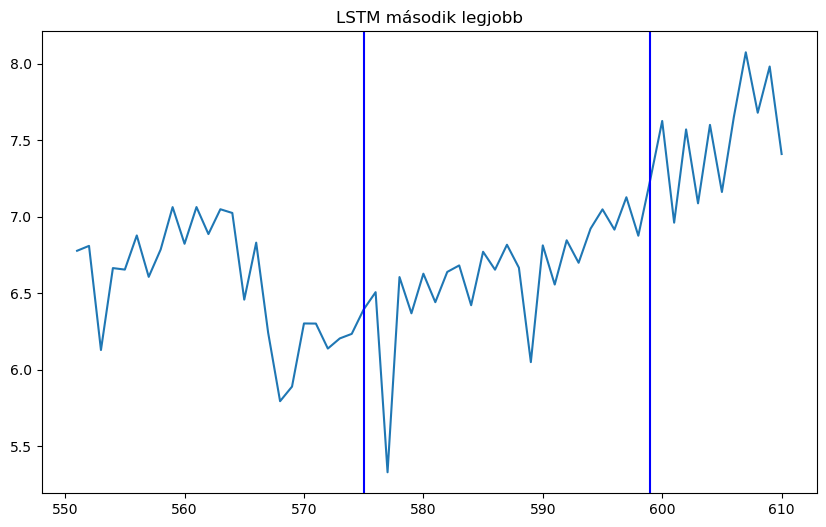

In [248]:
pre = pd.Series(dfLSTM['Predikció'][0])
pre=Vilagossz['Total Fossil Fuels Production'].append(pre, ignore_index=True)
pre= pre.iloc[-60:]
pre.plot(figsize=(10,6))

plt.axvline(x = 575, color = 'b', label = 'axvline - full height')
plt.axvline(x = 599, color = 'b', label = 'axvline - full height')
plt.title('LSTM második legjobb')

## GRU

In [222]:
from tensorflow.keras.layers import GRU

In [ ]:
data = np.array(Vilagossz['Total Primary Energy Consumption'].loc[467:586]) # 120 havi adat

# Adatok előkészítése a modell számára
time_steps = 12  # Az előző 12 havi adatot használjuk az előrejelzéshez
X, y = [], []
for i in range(len(data) - time_steps):
    X.append(data[i:i+time_steps])
    y.append(data[i+time_steps])
X = np.array(X).reshape(-1, time_steps, 1)
y = np.array(y)

# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(data))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]



# LSTM modell létrehozása
model = Sequential()
model.add(GRU(64, input_shape=(time_steps, 1)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=1000, batch_size=32, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []

for _ in range(12):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)

print("Jövőbeli értékek előrejelzése:")
print(predictions)

## Stacked GRU

In [ ]:
data = np.array(Vilagossz['Total Primary Energy Consumption'].loc[467:586]) # 120 havi adat

# Adatok előkészítése a modell számára
time_steps = 12  # Az előző 12 havi adatot használjuk az előrejelzéshez
X, y = [], []
for i in range(len(data) - time_steps):
    X.append(data[i:i+time_steps])
    y.append(data[i+time_steps])
X = np.array(X).reshape(-1, time_steps, 1)
y = np.array(y)

# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(data))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]



# LSTM modell létrehozása
model = Sequential()
#model.add(LSTM(64, input_shape=(time_steps, 1)))
model.add(GRU(64, activation='relu', return_sequences=True, input_shape=(12, 1)))
model.add(GRU(64, activation='relu', return_sequences=True))
model.add(GRU(64, activation='relu'))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=500, batch_size=32, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []

for _ in range(12):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)

print("Jövőbeli értékek előrejelzése:")
print(predictions)

## Többirányú GRU

In [ ]:
data = np.array(Vilagossz['Total Primary Energy Consumption'].loc[467:586]) # 120 havi adat

# Adatok előkészítése a modell számára
time_steps = 12  # Az előző 12 havi adatot használjuk az előrejelzéshez
X, y = [], []
for i in range(len(data) - time_steps):
    X.append(data[i:i+time_steps])
    y.append(data[i+time_steps])
X = np.array(X).reshape(-1, time_steps, 1)
y = np.array(y)

# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(data))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]



# LSTM modell létrehozása
model = Sequential()
model.add(Bidirectional(GRU(64, input_shape=(time_steps, 1))))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=500, batch_size=32, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []

for _ in range(12):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)

print("Jövőbeli értékek előrejelzése:")
print(predictions)
print()

In [ ]:
data = np.array(Vilagossz['Total Primary Energy Consumption'].loc[467:586]) # 120 havi adat

# Adatok előkészítése a modell számára
time_steps = 12  # Az előző 12 havi adatot használjuk az előrejelzéshez
X, y = [], []
for i in range(len(data) - time_steps):
    X.append(data[i:i+time_steps])
    y.append(data[i+time_steps])
X = np.array(X).reshape(-1, time_steps, 1)
y = np.array(y)

# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(data))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]



# LSTM modell létrehozása
model = Sequential()
model.add(Bidirectional(GRU(64, return_sequences=True), input_shape=(time_steps, 1)))
model.add(Bidirectional(GRU(64, return_sequences=True)))
model.add(Bidirectional(GRU(64)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=500, batch_size=32, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []

for _ in range(12):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)

print("Jövőbeli értékek előrejelzése:")
print(predictions)

## GRU  optimalizáció

In [223]:
#aktiváció relu, sigmoid, tanh, softmax
#gru_batch_meret = 4,16,32,64,128,256
#batch_meret = 32,64,128
#optimalizalo: adam, rmsprop, 
def GRU_opt(adatok=diftran_full,epochok=10,ciklus=3,batch_meret=32,
             vane_valid=False,
             gru_neuron=64, gru_neuron2=64, gru_neuron3=64,
             optimizalo='adam',aktivacio='relu',veszteseg='mae',
             reteg_1=1,reteg_2=0,reteg_3=0, 
             predikció_hossza = 12,
             kell_kulcs=1):
    # Adatok előkészítése a modell számára
    data = np.array(adatok)
    # Az előző 12 havi adatot használjuk az előrejelzéshez
    X, y = [], []
    for i in range(len(data) - time_steps):
        X.append(data[i:i+time_steps])
        y.append(data[i+time_steps])
    X = np.array(X).reshape(-1, time_steps, 1)
    y = np.array(y)
    if vane_valid==True:
        # Adatok felosztása tanító, validációs és tesztadathalmazokra
        test_size = 156
        train_size = 78
        X_train,X_valid= X[:train_size], X[train_size:test_size]
        y_train,y_valid= y[:train_size], y[train_size:test_size]
        X_test, y_test = X[test_size:],y[test_size:]
    else:
        # Adatok felosztása tanító és tesztadathalmazokra
        train_size = 156
        X_train= X[:train_size]
        y_train= y[:train_size]
        X_test, y_test = X[train_size:],y[train_size:]
    


    # GRU modell létrehozása
    model = Sequential()
    filepath1='yourmodelname.hdf5'
    #1. réteg
    if reteg_1 == 1 and reteg_2 == 0:
        model.add(GRU(gru_neuron, activation=aktivacio))
    elif reteg_1 == 2 and reteg_2 == 0:
        model.add(Bidirectional(GRU(gru_neuron, activation=aktivacio)))
    elif reteg_1 == 1 and reteg_2 != 0:
        model.add(GRU(gru_neuron, activation=aktivacio, return_sequences=True))
    elif reteg_1 == 2 and reteg_2 != 0:
        model.add(Bidirectional(GRU(gru_neuron, activation=aktivacio, return_sequences=True)))

    #2. réteg
    if reteg_2 == 1 and reteg_3 == 0:
        model.add(GRU(gru_neuron2, activation=aktivacio))
    elif reteg_2 == 2 and reteg_3 == 0:
        model.add(Bidirectional(GRU(gru_neuron2, activation=aktivacio)))
    elif reteg_2 == 1 and reteg_3 != 0:
        model.add(GRU(gru_neuron2, activation=aktivacio, return_sequences=True))
    elif reteg_2 == 2 and reteg_3 != 0:
        model.add(Bidirectional(GRU(gru_neuron2, activation=aktivacio, return_sequences=True)))
    
    #3. réteg
    if reteg_3 == 1 and reteg_2 !=0:
        model.add(GRU(gru_neuron3, activation=aktivacio))
    elif reteg_3 == 2 and reteg_2 !=0:
        model.add(Bidirectional(GRU(gru_neuron3, activation=aktivacio)))
                  
    model.add(Dense(1))
    model.add(Dropout(0.2))
    model.compile(optimizer=optimizalo, loss=veszteseg)
    # Modell tanítása
    teszthiba = []
    for x in range(ciklus):
        if vane_valid==True:
            model.fit(X_train, y_train, epochs=epochok, batch_size=batch_meret,validation_data=(X_valid, y_valid), verbose=1,callbacks=[checkpointer])
        else:
            model.fit(X_train, y_train, epochs=epochok, batch_size=batch_meret, verbose=1)
        # Modell kiértékelése a tesztadathalmazon
        loss = model.evaluate(X_test, y_test)
        print(f"Teszt hiba: {loss}")
        teszthiba.append(loss)
    
    # Jövőbeli értékek előrejelzése
    if vane_valid==True:
        try:
            model.load_weights(filepath1)
            print("volt jobb modell")
        except:
            print("nem volt jobb modell")
    #predikció megszerzése
    future_data = data[-time_steps:].reshape(1, time_steps, 1)
    predictions = []
    for _ in range(predikció_hossza):
        prediction = model.predict(future_data)
        predictions.append(prediction[0][0])
        future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)
    print("Jövőbeli értékek előrejelzése:")
    print(predictions)
    
    nyers_teszt =model.predict(X_test).reshape(24)
    teszt_prediction = model.predict(X_test).reshape(24)
    if kell_kulcs == 1:
        preddk = visszafejtolstm(predictions)
        teszt_prediction = visszafejtolstm(teszt_prediction,1)
        Mae = mean_absolute_error(vilagtestt,teszt_prediction)
    elif kell_kulcs==2:
        preddk = visszafejtolstm(predictions)
        teszt_prediction = visszafejtolstm(teszt_prediction,1)
        Mae = mean_absolute_error(vilagtestt,teszt_prediction)
    else:
        preddk = predictions
        Mae = mean_absolute_error(vilagtestt,teszt_prediction)
    #os.remove('yourmodelname.hdf5')
    #checkpointer = ModelCheckpoint(filepath=filepath1, 
                               #monitor='val_loss', 
                               #verbose=1, 
                               #save_best_only=True)
    return preddk,teszt_prediction,Mae

In [224]:
dfGRU= pd.DataFrame()
dfGRU['adatforrás'] = None
dfGRU['aktiváció'] = None
dfGRU['Batch méret'] = None
dfGRU['MAE']=None
dfGRU['Konfiguráció']=None
dfGRU['Predikció']=None

In [225]:
predi=GRU_opt(adatok=diftran_full,epochok=10,ciklus=3,batch_meret=32,
               vane_valid=True,reteg_1=1,reteg_2=2,reteg_3=1,
               gru_neuron=256, gru_neuron2=128, gru_neuron3=64,
               kell_kulcs=1)
#dfGRU = dfGRU.append({'adatforrás':'diftran_full','aktiváció':'sigmoid','Batch méret':32,'MAE': predi[2],'Konfiguráció': xzy, 'Predikció':predi[0]}, ignore_index=True)


Epoch 1/10
2/3 [===================>..........] - ETA: 0s - loss: 0.5485 
Epoch 1: val_loss did not improve from 0.21085
3/3 [==============================] - 6s 348ms/step - loss: 0.5341 - val_loss: 0.5646
Epoch 2/10
2/3 [===================>..........] - ETA: 0s - loss: 0.5215
Epoch 2: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 84ms/step - loss: 0.5283 - val_loss: 0.5624
Epoch 3/10
2/3 [===================>..........] - ETA: 0s - loss: 0.5425
Epoch 3: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 84ms/step - loss: 0.5267 - val_loss: 0.5598
Epoch 4/10
2/3 [===================>..........] - ETA: 0s - loss: 0.4998
Epoch 4: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 81ms/step - loss: 0.5126 - val_loss: 0.5558
Epoch 5/10
2/3 [===================>..........] - ETA: 0s - loss: 0.4832
Epoch 5: val_loss did not improve from 0.21085
3/3 [==============================] - 0s 82ms/step - 

NameError: name 'xzy' is not defined

In [229]:
#differenciált transzformált
batch=[32]
aktivacio=['sigmoid','relu','tanh']
for z in range(0,3):
    for y in range(0,3):
        if y == 0 and z!=0:
            continue
        for x in range(1,3):
            filepath1 = str('sajat_file_sulyok'+''+str(x)+str(y)+str(z))
            checkpointer = ModelCheckpoint(filepath=filepath1, monitor='val_loss', verbose=1,save_weights_only = True, save_best_only=True)
            for akt in aktivacio:
                for bat in batch:
                    predi=GRU_opt(adatok=diftran_full,epochok=50,ciklus=40,batch_meret=bat,
                                    vane_valid=True,reteg_1=x,reteg_2=y,reteg_3=z,
                                    gru_neuron=128, gru_neuron2=64, gru_neuron3=64, aktivacio=akt,
                                    kell_kulcs=1)
                    konfig =str(x) + str(y) + str(z)
                    dfGRU = dfGRU.append({'adatforrás':'diftran_full','aktiváció':akt,'Batch méret':bat,'MAE': predi[2],'Konfiguráció': konfig,'Predikció':predi[0]}, ignore_index=True)
            


Epoch 1/50
1/3 [=========>....................] - ETA: 2s - loss: 1.4940
Epoch 1: val_loss improved from inf to 0.76781, saving model to sajat_file_sulyok100
3/3 [==============================] - 2s 118ms/step - loss: 1.3222 - val_loss: 0.7678
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.7704
Epoch 2: val_loss improved from 0.76781 to 0.58248, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 35ms/step - loss: 0.7697 - val_loss: 0.5825
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.6318
Epoch 3: val_loss improved from 0.58248 to 0.57658, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 38ms/step - loss: 0.5501 - val_loss: 0.5766
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4267
Epoch 4: val_loss did not improve from 0.57658
3/3 [==============================] - 0s 22ms/step - loss: 0.5289 - val_loss: 0.6041
Epoch 5/50
1/3 [=========>....................] - ETA

1/3 [=========>....................] - ETA: 0s - loss: 0.4486
Epoch 34: val_loss improved from 0.47827 to 0.47414, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 38ms/step - loss: 0.4225 - val_loss: 0.4741
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4426
Epoch 35: val_loss improved from 0.47414 to 0.47082, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 38ms/step - loss: 0.4398 - val_loss: 0.4708
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3975
Epoch 36: val_loss improved from 0.47082 to 0.46746, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 38ms/step - loss: 0.4264 - val_loss: 0.4675
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4478
Epoch 37: val_loss improved from 0.46746 to 0.46412, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 39ms/step - loss: 0.4133 - val_loss: 0.4641
Epoch 38/50


Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4107
Epoch 17: val_loss improved from 0.36090 to 0.35882, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 38ms/step - loss: 0.3190 - val_loss: 0.3588
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3636
Epoch 18: val_loss improved from 0.35882 to 0.35393, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 40ms/step - loss: 0.3288 - val_loss: 0.3539
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3581
Epoch 19: val_loss improved from 0.35393 to 0.35201, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 39ms/step - loss: 0.3083 - val_loss: 0.3520
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2110
Epoch 20: val_loss improved from 0.35201 to 0.35126, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 37ms/step - loss: 0.2954 - val_loss: 0.3513


Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2346
Epoch 2: val_loss did not improve from 0.32306
3/3 [==============================] - 0s 21ms/step - loss: 0.2917 - val_loss: 0.3234
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2752
Epoch 3: val_loss improved from 0.32306 to 0.32257, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 34ms/step - loss: 0.2702 - val_loss: 0.3226
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2892
Epoch 4: val_loss improved from 0.32257 to 0.32103, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 35ms/step - loss: 0.3038 - val_loss: 0.3210
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2804
Epoch 5: val_loss did not improve from 0.32103
3/3 [==============================] - 0s 21ms/step - loss: 0.3021 - val_loss: 0.3245
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2611
Epoch 6: val_loss i

1/3 [=========>....................] - ETA: 0s - loss: 0.2618
Epoch 37: val_loss did not improve from 0.29543
3/3 [==============================] - 0s 22ms/step - loss: 0.2961 - val_loss: 0.2972
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2308
Epoch 38: val_loss did not improve from 0.29543
3/3 [==============================] - 0s 22ms/step - loss: 0.2490 - val_loss: 0.2987
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2762
Epoch 39: val_loss did not improve from 0.29543
3/3 [==============================] - 0s 22ms/step - loss: 0.2922 - val_loss: 0.2978
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2802
Epoch 40: val_loss did not improve from 0.29543
3/3 [==============================] - 0s 21ms/step - loss: 0.2569 - val_loss: 0.2981
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2771
Epoch 41: val_loss did not improve from 0.29543
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 23: val_loss did not improve from 0.27750
3/3 [==============================] - 0s 23ms/step - loss: 0.2288 - val_loss: 0.2792
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2566
Epoch 24: val_loss did not improve from 0.27750
3/3 [==============================] - 0s 21ms/step - loss: 0.2491 - val_loss: 0.2802
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 25: val_loss did not improve from 0.27750
3/3 [==============================] - 0s 21ms/step - loss: 0.2431 - val_loss: 0.2798
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2408
Epoch 26: val_loss did not improve from 0.27750
3/3 [==============================] - 0s 21ms/step - loss: 0.2563 - val_loss: 0.2817
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2213
Epoch 27: val_loss did not improve from 0.27750
3/3 [==============================] - 0s 21ms/step - loss

3/3 [==============================] - 0s 22ms/step - loss: 0.2513 - val_loss: 0.2738
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2355
Epoch 11: val_loss did not improve from 0.27343
3/3 [==============================] - 0s 31ms/step - loss: 0.2660 - val_loss: 0.2735
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 12: val_loss improved from 0.27343 to 0.27319, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 37ms/step - loss: 0.2410 - val_loss: 0.2732
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2585
Epoch 13: val_loss improved from 0.27319 to 0.27222, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 39ms/step - loss: 0.2245 - val_loss: 0.2722
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3020
Epoch 14: val_loss improved from 0.27222 to 0.27127, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 

3/3 [==============================] - 0s 25ms/step - loss: 0.2558 - val_loss: 0.2781
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2882
Epoch 49: val_loss did not improve from 0.26764
3/3 [==============================] - 0s 25ms/step - loss: 0.2419 - val_loss: 0.2763
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3404
Epoch 50: val_loss did not improve from 0.26764
1/1 [==============================] - 0s 31ms/step - loss: 0.3374
Teszt hiba: 0.33742594718933105
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 1: val_loss did not improve from 0.26764
3/3 [==============================] - 0s 41ms/step - loss: 0.2502 - val_loss: 0.2731
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1834
Epoch 2: val_loss did not improve from 0.26764
3/3 [==============================] - 0s 25ms/step - loss: 0.2436 - val_loss: 0.2720
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3037


3/3 [==============================] - 0s 22ms/step - loss: 0.1860 - val_loss: 0.2690
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 37: val_loss did not improve from 0.26406
3/3 [==============================] - 0s 22ms/step - loss: 0.2476 - val_loss: 0.2702
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 38: val_loss did not improve from 0.26406
3/3 [==============================] - 0s 21ms/step - loss: 0.2271 - val_loss: 0.2721
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2463
Epoch 39: val_loss did not improve from 0.26406
3/3 [==============================] - 0s 23ms/step - loss: 0.2330 - val_loss: 0.2739
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2302
Epoch 40: val_loss did not improve from 0.26406
3/3 [==============================] - 0s 22ms/step - loss: 0.2026 - val_loss: 0.2744
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1618
Epoch 41

1/3 [=========>....................] - ETA: 0s - loss: 0.2408
Epoch 25: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 22ms/step - loss: 0.2593 - val_loss: 0.2650
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2553
Epoch 26: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 22ms/step - loss: 0.2576 - val_loss: 0.2626
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2406
Epoch 27: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 22ms/step - loss: 0.2681 - val_loss: 0.2648
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2831
Epoch 28: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 21ms/step - loss: 0.2570 - val_loss: 0.2648
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2483
Epoch 29: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 14: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 22ms/step - loss: 0.2245 - val_loss: 0.2645
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1922
Epoch 15: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 22ms/step - loss: 0.2053 - val_loss: 0.2639
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 16: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 24ms/step - loss: 0.2290 - val_loss: 0.2634
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2417
Epoch 17: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 27ms/step - loss: 0.2294 - val_loss: 0.2630
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2213
Epoch 18: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 28ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2052
Epoch 3: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 22ms/step - loss: 0.2062 - val_loss: 0.2717
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1939
Epoch 4: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 21ms/step - loss: 0.2293 - val_loss: 0.2725
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2665
Epoch 5: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 21ms/step - loss: 0.2741 - val_loss: 0.2719
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2541
Epoch 6: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 22ms/step - loss: 0.2192 - val_loss: 0.2707
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2312
Epoch 7: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 21ms/step - lo

3/3 [==============================] - 0s 22ms/step - loss: 0.2420 - val_loss: 0.2715
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3157
Epoch 43: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 21ms/step - loss: 0.2540 - val_loss: 0.2761
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2371
Epoch 44: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 22ms/step - loss: 0.2332 - val_loss: 0.2751
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2190
Epoch 45: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 21ms/step - loss: 0.2338 - val_loss: 0.2774
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2955
Epoch 46: val_loss did not improve from 0.26219
3/3 [==============================] - 0s 22ms/step - loss: 0.2521 - val_loss: 0.2750
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2218
Epoch 47

1/3 [=========>....................] - ETA: 0s - loss: 0.2114
Epoch 31: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 21ms/step - loss: 0.2254 - val_loss: 0.2764
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 32: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 20ms/step - loss: 0.2345 - val_loss: 0.2722
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2593
Epoch 33: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 22ms/step - loss: 0.2792 - val_loss: 0.2702
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2474
Epoch 34: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 20ms/step - loss: 0.2441 - val_loss: 0.2689
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2188
Epoch 35: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 22ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2866
Epoch 20: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 21ms/step - loss: 0.2708 - val_loss: 0.2641
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2446
Epoch 21: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 21ms/step - loss: 0.2504 - val_loss: 0.2645
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2421
Epoch 22: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 22ms/step - loss: 0.2075 - val_loss: 0.2642
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 23: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 21ms/step - loss: 0.2163 - val_loss: 0.2645
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2548
Epoch 24: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2215
Epoch 9: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 21ms/step - loss: 0.2344 - val_loss: 0.2635
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2510
Epoch 10: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 21ms/step - loss: 0.2679 - val_loss: 0.2643
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1955
Epoch 11: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 21ms/step - loss: 0.2200 - val_loss: 0.2678
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2491
Epoch 12: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 20ms/step - loss: 0.2529 - val_loss: 0.2665
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2439
Epoch 13: val_loss did not improve from 0.26169
3/3 [==============================] - 0s 21ms/step - loss:

1/3 [=========>....................] - ETA: 0s - loss: 0.3002
Epoch 48: val_loss did not improve from 0.26154
3/3 [==============================] - 0s 22ms/step - loss: 0.2581 - val_loss: 0.2680
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2618
Epoch 49: val_loss did not improve from 0.26154
3/3 [==============================] - 0s 22ms/step - loss: 0.1943 - val_loss: 0.2686
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3027
Epoch 50: val_loss did not improve from 0.26154
1/1 [==============================] - 0s 20ms/step - loss: 0.3508
Teszt hiba: 0.35077857971191406
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2562
Epoch 1: val_loss did not improve from 0.26154
3/3 [==============================] - 0s 36ms/step - loss: 0.2830 - val_loss: 0.2705
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1937
Epoch 2: val_loss did not improve from 0.26154
3/3 [==============================] - 0s 21ms/st

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2445
Epoch 37: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 21ms/step - loss: 0.2686 - val_loss: 0.2706
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2406
Epoch 38: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 21ms/step - loss: 0.2329 - val_loss: 0.2706
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2567
Epoch 39: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 21ms/step - loss: 0.2950 - val_loss: 0.2713
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2250
Epoch 40: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 21ms/step - loss: 0.2179 - val_loss: 0.2719
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2282
Epoch 41: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2356
Epoch 26: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 20ms/step - loss: 0.2563 - val_loss: 0.2638
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3114
Epoch 27: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 21ms/step - loss: 0.2783 - val_loss: 0.2667
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2400
Epoch 28: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 21ms/step - loss: 0.2291 - val_loss: 0.2667
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2548
Epoch 29: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 21ms/step - loss: 0.2323 - val_loss: 0.2678
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2525
Epoch 30: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 15: val_loss did not improve from 0.26093
3/3 [==============================] - 0s 25ms/step - loss: 0.2188 - val_loss: 0.2620
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 16: val_loss improved from 0.26093 to 0.26084, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 40ms/step - loss: 0.2287 - val_loss: 0.2608
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2546
Epoch 17: val_loss improved from 0.26084 to 0.25991, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 34ms/step - loss: 0.2479 - val_loss: 0.2599
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2291
Epoch 18: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 21ms/step - loss: 0.2459 - val_loss: 0.2601
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2451
Epoch 19: val_loss did

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1956
Epoch 4: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 21ms/step - loss: 0.2281 - val_loss: 0.2650
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2923
Epoch 5: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 23ms/step - loss: 0.2473 - val_loss: 0.2647
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 6: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 22ms/step - loss: 0.2445 - val_loss: 0.2642
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1837
Epoch 7: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 22ms/step - loss: 0.2228 - val_loss: 0.2645
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2196
Epoch 8: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 22ms/step - lo

3/3 [==============================] - 0s 21ms/step - loss: 0.2345 - val_loss: 0.2733
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2994
Epoch 44: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 22ms/step - loss: 0.2981 - val_loss: 0.2723
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2479
Epoch 45: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 22ms/step - loss: 0.2555 - val_loss: 0.2725
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2701
Epoch 46: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 23ms/step - loss: 0.2252 - val_loss: 0.2732
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 47: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 22ms/step - loss: 0.2501 - val_loss: 0.2713
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2140
Epoch 33: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 21ms/step - loss: 0.2590 - val_loss: 0.2709
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2628
Epoch 34: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 22ms/step - loss: 0.2555 - val_loss: 0.2708
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2657
Epoch 35: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 23ms/step - loss: 0.2403 - val_loss: 0.2714
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2206
Epoch 36: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 23ms/step - loss: 0.2115 - val_loss: 0.2729
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 37: val_loss did not improve from 0.25991
3/3 [==============================] - 0s 23ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2257
Epoch 22: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 20ms/step - loss: 0.2353 - val_loss: 0.2602
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2097
Epoch 23: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 21ms/step - loss: 0.2510 - val_loss: 0.2609
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2175
Epoch 24: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 21ms/step - loss: 0.2495 - val_loss: 0.2619
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoch 25: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 22ms/step - loss: 0.2570 - val_loss: 0.2630
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 26: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 22ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 11: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 21ms/step - loss: 0.2128 - val_loss: 0.2710
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2912
Epoch 12: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 21ms/step - loss: 0.2815 - val_loss: 0.2748
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2356
Epoch 13: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 21ms/step - loss: 0.2491 - val_loss: 0.2700
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 14: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 21ms/step - loss: 0.2303 - val_loss: 0.2735
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2668
Epoch 15: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 20ms

1/1 [==============================] - 0s 20ms/step - loss: 0.3356
Teszt hiba: 0.3356328010559082
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 1: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 35ms/step - loss: 0.2244 - val_loss: 0.2672
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2417
Epoch 2: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 21ms/step - loss: 0.2649 - val_loss: 0.2670
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2606
Epoch 3: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 20ms/step - loss: 0.2487 - val_loss: 0.2678
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2531
Epoch 4: val_loss did not improve from 0.25961
3/3 [==============================] - 0s 20ms/step - loss: 0.2679 - val_loss: 0.2690
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2484
Epoch

3/3 [==============================] - 0s 21ms/step - loss: 0.2542 - val_loss: 0.2692
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2323
Epoch 40: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2332 - val_loss: 0.2711
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 41: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2260 - val_loss: 0.2718
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2021
Epoch 42: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 23ms/step - loss: 0.2182 - val_loss: 0.2718
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 43: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2382 - val_loss: 0.2716
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2817
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2043
Epoch 29: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 21ms/step - loss: 0.2151 - val_loss: 0.2667
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2153
Epoch 30: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 20ms/step - loss: 0.2468 - val_loss: 0.2661
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2041
Epoch 31: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 20ms/step - loss: 0.2263 - val_loss: 0.2657
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2305
Epoch 32: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 21ms/step - loss: 0.2047 - val_loss: 0.2651
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 33: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 20ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2515
Epoch 18: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2469 - val_loss: 0.2633
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2778
Epoch 19: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 21ms/step - loss: 0.2460 - val_loss: 0.2629
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2210
Epoch 20: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2261 - val_loss: 0.2628
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2572
Epoch 21: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 21ms/step - loss: 0.2394 - val_loss: 0.2634
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2649
Epoch 22: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2711
Epoch 7: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 21ms/step - loss: 0.2356 - val_loss: 0.2680
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 8: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 21ms/step - loss: 0.2345 - val_loss: 0.2666
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2377
Epoch 9: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2650 - val_loss: 0.2650
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 10: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 21ms/step - loss: 0.2150 - val_loss: 0.2639
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 11: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 21ms/step - loss: 0.2

3/3 [==============================] - 0s 22ms/step - loss: 0.2415 - val_loss: 0.2698
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 47: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 26ms/step - loss: 0.2742 - val_loss: 0.2692
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 48: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 26ms/step - loss: 0.2465 - val_loss: 0.2680
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2766
Epoch 49: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 23ms/step - loss: 0.2319 - val_loss: 0.2666
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 50: val_loss did not improve from 0.25920
1/1 [==============================] - 0s 20ms/step - loss: 0.3255
Teszt hiba: 0.32545462250709534
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2

3/3 [==============================] - 0s 22ms/step - loss: 0.2427 - val_loss: 0.2670
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2591
Epoch 36: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2444 - val_loss: 0.2696
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2262
Epoch 37: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2464 - val_loss: 0.2702
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3220
Epoch 38: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2738 - val_loss: 0.2698
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2327
Epoch 39: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 21ms/step - loss: 0.2467 - val_loss: 0.2706
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2550
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 25: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 28ms/step - loss: 0.2462 - val_loss: 0.2651
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2270
Epoch 26: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 28ms/step - loss: 0.2178 - val_loss: 0.2648
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 27: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 27ms/step - loss: 0.2058 - val_loss: 0.2644
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2593
Epoch 28: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2903 - val_loss: 0.2648
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 29: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 24ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2111
Epoch 14: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 23ms/step - loss: 0.2165 - val_loss: 0.2671
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2462
Epoch 15: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2579 - val_loss: 0.2686
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 16: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 22ms/step - loss: 0.2162 - val_loss: 0.2705
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2720
Epoch 17: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 23ms/step - loss: 0.2160 - val_loss: 0.2688
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1887
Epoch 18: val_loss did not improve from 0.25920
3/3 [==============================] - 0s 23ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2144
Epoch 3: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 22ms/step - loss: 0.2300 - val_loss: 0.2701
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1935
Epoch 4: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 22ms/step - loss: 0.2213 - val_loss: 0.2724
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 5: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 23ms/step - loss: 0.2025 - val_loss: 0.2712
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2269
Epoch 6: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2112 - val_loss: 0.2682
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 7: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - lo

3/3 [==============================] - 0s 24ms/step - loss: 0.2716 - val_loss: 0.2655
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2790
Epoch 43: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 23ms/step - loss: 0.2620 - val_loss: 0.2670
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2220
Epoch 44: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 22ms/step - loss: 0.2060 - val_loss: 0.2710
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 45: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 23ms/step - loss: 0.2098 - val_loss: 0.2753
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2758
Epoch 46: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 22ms/step - loss: 0.2288 - val_loss: 0.2742
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2670
Epoch 32: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 22ms/step - loss: 0.2901 - val_loss: 0.2670
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2190
Epoch 33: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 22ms/step - loss: 0.2208 - val_loss: 0.2648
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2270
Epoch 34: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 24ms/step - loss: 0.2271 - val_loss: 0.2624
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 35: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 23ms/step - loss: 0.2122 - val_loss: 0.2620
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2726
Epoch 36: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 25ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 21: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2123 - val_loss: 0.2615
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3231
Epoch 22: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2649 - val_loss: 0.2621
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2396
Epoch 23: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2719 - val_loss: 0.2628
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 24: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2342 - val_loss: 0.2641
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2496
Epoch 25: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1759
Epoch 10: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2335 - val_loss: 0.2619
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 11: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 22ms/step - loss: 0.2148 - val_loss: 0.2631
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 12: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 20ms/step - loss: 0.1963 - val_loss: 0.2637
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2735
Epoch 13: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2549 - val_loss: 0.2645
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2874
Epoch 14: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 20ms/step - loss

3/3 [==============================] - 0s 22ms/step - loss: 0.2231 - val_loss: 0.2691
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3126
Epoch 50: val_loss did not improve from 0.25882
1/1 [==============================] - 0s 19ms/step - loss: 0.3269
Teszt hiba: 0.32692357897758484
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2344
Epoch 1: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 35ms/step - loss: 0.2800 - val_loss: 0.2674
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2586
Epoch 2: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 20ms/step - loss: 0.2704 - val_loss: 0.2663
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2514
Epoch 3: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 20ms/step - loss: 0.2369 - val_loss: 0.2675
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2805
Ep

3/3 [==============================] - 0s 20ms/step - loss: 0.2191 - val_loss: 0.2705
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 39: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2178 - val_loss: 0.2684
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2185
Epoch 40: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 20ms/step - loss: 0.2187 - val_loss: 0.2689
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 41: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2384 - val_loss: 0.2720
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2692
Epoch 42: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2480 - val_loss: 0.2723
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2916
Epoch 43

3/3 [==============================] - 0s 21ms/step - loss: 0.2197 - val_loss: 0.2643
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2342
Epoch 28: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2225 - val_loss: 0.2651
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2740
Epoch 29: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 20ms/step - loss: 0.2579 - val_loss: 0.2649
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1862
Epoch 30: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 22ms/step - loss: 0.2254 - val_loss: 0.2653
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2594
Epoch 31: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 20ms/step - loss: 0.2330 - val_loss: 0.2676
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 32

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 17: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 26ms/step - loss: 0.2124 - val_loss: 0.2675
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2691
Epoch 18: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 24ms/step - loss: 0.2542 - val_loss: 0.2652
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2692
Epoch 19: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 24ms/step - loss: 0.2623 - val_loss: 0.2629
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 20: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 25ms/step - loss: 0.2026 - val_loss: 0.2625
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2233
Epoch 21: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 26ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2715
Epoch 6: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2483 - val_loss: 0.2704
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2116
Epoch 7: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2387 - val_loss: 0.2706
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 8: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 20ms/step - loss: 0.2315 - val_loss: 0.2681
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2342
Epoch 9: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 21ms/step - loss: 0.2504 - val_loss: 0.2664
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 10: val_loss did not improve from 0.25882
3/3 [==============================] - 0s 22ms/step - 

1/3 [=========>....................] - ETA: 0s - loss: 0.2533
Epoch 45: val_loss did not improve from 0.25673
3/3 [==============================] - 0s 22ms/step - loss: 0.2364 - val_loss: 0.2660
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2527
Epoch 46: val_loss did not improve from 0.25673
3/3 [==============================] - 0s 20ms/step - loss: 0.2506 - val_loss: 0.2637
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 47: val_loss did not improve from 0.25673
3/3 [==============================] - 0s 21ms/step - loss: 0.2137 - val_loss: 0.2620
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3060
Epoch 48: val_loss did not improve from 0.25673
3/3 [==============================] - 0s 21ms/step - loss: 0.2547 - val_loss: 0.2612
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2397
Epoch 49: val_loss did not improve from 0.25673
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1779
Epoch 34: val_loss did not improve from 0.25673
3/3 [==============================] - 0s 21ms/step - loss: 0.1979 - val_loss: 0.2616
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2211
Epoch 35: val_loss did not improve from 0.25673
3/3 [==============================] - 0s 21ms/step - loss: 0.2176 - val_loss: 0.2667
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2643
Epoch 36: val_loss did not improve from 0.25673
3/3 [==============================] - 0s 21ms/step - loss: 0.2524 - val_loss: 0.2721
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2729
Epoch 37: val_loss did not improve from 0.25673
3/3 [==============================] - 0s 21ms/step - loss: 0.2635 - val_loss: 0.2770
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2199
Epoch 38: val_loss did not improve from 0.25673
3/3 [==============================] - 0s 21ms/step - loss

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2430
Epoch 23: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2473 - val_loss: 0.2622
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2658
Epoch 24: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 20ms/step - loss: 0.2383 - val_loss: 0.2609
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2258
Epoch 25: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2385 - val_loss: 0.2621
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2834
Epoch 26: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 20ms/step - loss: 0.2366 - val_loss: 0.2652
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2485
Epoch 27: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 20ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2434
Epoch 12: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2407 - val_loss: 0.2633
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2368
Epoch 13: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 20ms/step - loss: 0.2345 - val_loss: 0.2617
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2247
Epoch 14: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2516 - val_loss: 0.2641
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2029
Epoch 15: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss: 0.2297 - val_loss: 0.2677
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1841
Epoch 16: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2305
Epoch 1: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 46ms/step - loss: 0.2663 - val_loss: 0.2657
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1789
Epoch 2: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 25ms/step - loss: 0.2236 - val_loss: 0.2663
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2342
Epoch 3: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss: 0.2229 - val_loss: 0.2680
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 4: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss: 0.2669 - val_loss: 0.2701
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2293
Epoch 5: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 29ms/step - lo

3/3 [==============================] - 0s 22ms/step - loss: 0.2133 - val_loss: 0.2665
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2636
Epoch 41: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 23ms/step - loss: 0.2306 - val_loss: 0.2671
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2375
Epoch 42: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 23ms/step - loss: 0.2573 - val_loss: 0.2655
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2301
Epoch 43: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 26ms/step - loss: 0.2117 - val_loss: 0.2644
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2768
Epoch 44: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 26ms/step - loss: 0.2334 - val_loss: 0.2653
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2932
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 30: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 23ms/step - loss: 0.2243 - val_loss: 0.2648
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1509
Epoch 31: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss: 0.2022 - val_loss: 0.2671
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1979
Epoch 32: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss: 0.1989 - val_loss: 0.2657
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2560
Epoch 33: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss: 0.2550 - val_loss: 0.2641
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2499
Epoch 34: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 25ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 19: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2177 - val_loss: 0.2579
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 20: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2070 - val_loss: 0.2566
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 21: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2035 - val_loss: 0.2584
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3053
Epoch 22: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2383 - val_loss: 0.2630
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1744
Epoch 23: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss

3/3 [==============================] - 0s 22ms/step - loss: 0.4942 - val_loss: 0.5280
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4221
Epoch 4: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 23ms/step - loss: 0.4753 - val_loss: 0.5157
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4718
Epoch 5: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 26ms/step - loss: 0.4574 - val_loss: 0.5027
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5088
Epoch 6: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 22ms/step - loss: 0.4551 - val_loss: 0.4898
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4258
Epoch 7: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 22ms/step - loss: 0.4340 - val_loss: 0.4775
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4587
Epoch 8: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.3714
Epoch 43: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss: 0.3089 - val_loss: 0.3562
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3627
Epoch 44: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss: 0.3234 - val_loss: 0.3568
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3112
Epoch 45: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss: 0.3121 - val_loss: 0.3575
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3095
Epoch 46: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 25ms/step - loss: 0.3052 - val_loss: 0.3618
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3118
Epoch 47: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 24ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2233
Epoch 32: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 22ms/step - loss: 0.2977 - val_loss: 0.3456
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2798
Epoch 33: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 22ms/step - loss: 0.3029 - val_loss: 0.3447
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3818
Epoch 34: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 23ms/step - loss: 0.3455 - val_loss: 0.3502
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3080
Epoch 35: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 23ms/step - loss: 0.2873 - val_loss: 0.3560
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3041
Epoch 36: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.3118
Epoch 21: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 26ms/step - loss: 0.3097 - val_loss: 0.3486
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2725
Epoch 22: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 23ms/step - loss: 0.3373 - val_loss: 0.3513
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2762
Epoch 23: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 22ms/step - loss: 0.3096 - val_loss: 0.3514
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3353
Epoch 24: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 23ms/step - loss: 0.3106 - val_loss: 0.3505
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2594
Epoch 25: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 22ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2553
Epoch 10: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.3053 - val_loss: 0.3543
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3062
Epoch 11: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 22ms/step - loss: 0.3052 - val_loss: 0.3528
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3540
Epoch 12: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.3411 - val_loss: 0.3490
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3602
Epoch 13: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.3198 - val_loss: 0.3427
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3079
Epoch 14: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss

3/3 [==============================] - 0s 24ms/step - loss: 0.3019 - val_loss: 0.3139
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3826
Epoch 50: val_loss did not improve from 0.25541
1/1 [==============================] - 0s 23ms/step - loss: 0.3228
Teszt hiba: 0.32283538579940796
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2474
Epoch 1: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 39ms/step - loss: 0.2739 - val_loss: 0.3223
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2866
Epoch 2: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 22ms/step - loss: 0.2889 - val_loss: 0.3212
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2585
Epoch 3: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 23ms/step - loss: 0.2762 - val_loss: 0.3175
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2590
Ep

3/3 [==============================] - 0s 23ms/step - loss: 0.2358 - val_loss: 0.2857
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2604
Epoch 39: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2583 - val_loss: 0.2754
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3317
Epoch 40: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2707 - val_loss: 0.2771
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2594
Epoch 41: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.2340 - val_loss: 0.2871
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2455
Epoch 42: val_loss did not improve from 0.25541
3/3 [==============================] - 0s 21ms/step - loss: 0.3028 - val_loss: 0.2878
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3084
Epoch 43

1/3 [=========>....................] - ETA: 0s - loss: 0.2221
Epoch 27: val_loss did not improve from 0.25227
3/3 [==============================] - 0s 23ms/step - loss: 0.2166 - val_loss: 0.2768
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2151
Epoch 28: val_loss did not improve from 0.25227
3/3 [==============================] - 0s 25ms/step - loss: 0.2433 - val_loss: 0.2753
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2299
Epoch 29: val_loss did not improve from 0.25227
3/3 [==============================] - 0s 22ms/step - loss: 0.2462 - val_loss: 0.2611
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2590
Epoch 30: val_loss improved from 0.25227 to 0.25187, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 39ms/step - loss: 0.2511 - val_loss: 0.2519
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2193
Epoch 31: val_loss did not improve from 0.25187
3/3 [===========

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 16: val_loss did not improve from 0.24892
3/3 [==============================] - 0s 28ms/step - loss: 0.2171 - val_loss: 0.2586
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1842
Epoch 17: val_loss did not improve from 0.24892
3/3 [==============================] - 0s 23ms/step - loss: 0.1731 - val_loss: 0.2665
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2282
Epoch 18: val_loss did not improve from 0.24892
3/3 [==============================] - 0s 22ms/step - loss: 0.2005 - val_loss: 0.2604
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 19: val_loss improved from 0.24892 to 0.24730, saving model to sajat_file_sulyok100
3/3 [==============================] - 0s 36ms/step - loss: 0.1850 - val_loss: 0.2473
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2214
Epoch 20: val_loss did not improve from 0.24730
3/3 

1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 4: val_loss did not improve from 0.23846
3/3 [==============================] - 0s 21ms/step - loss: 0.2060 - val_loss: 0.2569
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2542
Epoch 5: val_loss did not improve from 0.23846
3/3 [==============================] - 0s 20ms/step - loss: 0.2256 - val_loss: 0.2503
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2207
Epoch 6: val_loss did not improve from 0.23846
3/3 [==============================] - 0s 21ms/step - loss: 0.2169 - val_loss: 0.2603
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1366
Epoch 7: val_loss did not improve from 0.23846
3/3 [==============================] - 0s 21ms/step - loss: 0.1880 - val_loss: 0.2662
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 8: val_loss did not improve from 0.23846
3/3 [==============================] - 0s 20ms/step - loss: 0.1953 

1/3 [=========>....................] - ETA: 0s - loss: 0.2430
Epoch 43: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.2278 - val_loss: 0.2542
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 44: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1705 - val_loss: 0.2660
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 45: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1908 - val_loss: 0.2694
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1916
Epoch 46: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1976 - val_loss: 0.2569
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 47: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2270
Epoch 32: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1741 - val_loss: 0.2549
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1908
Epoch 33: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1711 - val_loss: 0.2594
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2714
Epoch 34: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2369 - val_loss: 0.2582
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1948 - val_loss: 0.2525
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 36: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1272
Epoch 21: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1531 - val_loss: 0.2400
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1727
Epoch 22: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.2184 - val_loss: 0.2544
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 23: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.2178 - val_loss: 0.2566
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2870
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2171 - val_loss: 0.2572
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 25: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1751
Epoch 10: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1575 - val_loss: 0.2545
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1635
Epoch 11: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 27ms/step - loss: 0.1540 - val_loss: 0.2599
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 12: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1759 - val_loss: 0.2595
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1973 - val_loss: 0.2450
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1603
Epoch 14: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss

3/3 [==============================] - 0s 20ms/step - loss: 0.1545 - val_loss: 0.2592
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2215
Epoch 50: val_loss did not improve from 0.23700
1/1 [==============================] - 0s 19ms/step - loss: 0.3889
Teszt hiba: 0.38891148567199707
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 1: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 33ms/step - loss: 0.2052 - val_loss: 0.2592
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1703 - val_loss: 0.2562
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 3: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1959 - val_loss: 0.2641
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Ep

3/3 [==============================] - 0s 20ms/step - loss: 0.1420 - val_loss: 0.2568
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 39: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.2340 - val_loss: 0.2633
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1965
Epoch 40: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1683 - val_loss: 0.2590
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 41: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1703 - val_loss: 0.2610
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1925
Epoch 42: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1517 - val_loss: 0.2574
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 28: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1602 - val_loss: 0.2562
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 29: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1538 - val_loss: 0.2548
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1437
Epoch 30: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1854 - val_loss: 0.2501
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 31: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1387 - val_loss: 0.2570
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 32: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1937
Epoch 17: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1690 - val_loss: 0.2571
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1625
Epoch 18: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1662 - val_loss: 0.2646
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1024
Epoch 19: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1389 - val_loss: 0.2634
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1245
Epoch 20: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1510 - val_loss: 0.2558
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 21: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2013
Epoch 6: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 25ms/step - loss: 0.1601 - val_loss: 0.2632
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1704
Epoch 7: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 26ms/step - loss: 0.1823 - val_loss: 0.2738
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 8: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 26ms/step - loss: 0.1947 - val_loss: 0.2660
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2230
Epoch 9: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1463 - val_loss: 0.2514
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 10: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 28ms/step - loss: 0.167

3/3 [==============================] - 0s 21ms/step - loss: 0.1782 - val_loss: 0.2659
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2048
Epoch 46: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1330 - val_loss: 0.2631
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0918
Epoch 47: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1329 - val_loss: 0.2607
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 48: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1612 - val_loss: 0.2613
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 49: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1516 - val_loss: 0.2666
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0961
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1297 - val_loss: 0.2659
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1078
Epoch 36: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1510 - val_loss: 0.2564
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1080
Epoch 37: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1069 - val_loss: 0.2632
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1998
Epoch 38: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1394 - val_loss: 0.2649
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0858
Epoch 39: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1012
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1200 - val_loss: 0.2645
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1666
Epoch 25: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1502 - val_loss: 0.2661
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1066
Epoch 26: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1065 - val_loss: 0.2552
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 27: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1367 - val_loss: 0.2573
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1572
Epoch 28: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1339
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1411 - val_loss: 0.2629
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0804
Epoch 14: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1262 - val_loss: 0.2639
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0759
Epoch 15: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.0710 - val_loss: 0.2623
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0926
Epoch 16: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1075 - val_loss: 0.2681
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2012
Epoch 17: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2008
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1357 - val_loss: 0.2620
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1514
Epoch 3: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1614 - val_loss: 0.2674
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2063
Epoch 4: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1288 - val_loss: 0.2667
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0861
Epoch 5: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1208 - val_loss: 0.2618
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 6: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - lo

3/3 [==============================] - 0s 23ms/step - loss: 0.1396 - val_loss: 0.2658
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 42: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1328 - val_loss: 0.2667
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1107
Epoch 43: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1062 - val_loss: 0.2659
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 44: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1520 - val_loss: 0.2672
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0802
Epoch 45: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1043 - val_loss: 0.2653
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1651
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0825
Epoch 31: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0824 - val_loss: 0.2651
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0650
Epoch 32: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.0844 - val_loss: 0.2650
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1379
Epoch 33: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1130 - val_loss: 0.2689
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 34: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.0941 - val_loss: 0.2635
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0628
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1362
Epoch 20: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1072 - val_loss: 0.2614
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0996
Epoch 21: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.0846 - val_loss: 0.2653
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0818
Epoch 22: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0776 - val_loss: 0.2649
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1802
Epoch 23: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1566 - val_loss: 0.2635
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1235
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2359
Epoch 9: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1517 - val_loss: 0.2717
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0894
Epoch 10: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1149 - val_loss: 0.2645
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1038
Epoch 11: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1198 - val_loss: 0.2654
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0750
Epoch 12: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1180 - val_loss: 0.2614
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss:

3/3 [==============================] - 0s 23ms/step - loss: 0.0730 - val_loss: 0.2654
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0966
Epoch 49: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1217 - val_loss: 0.2678
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 50: val_loss did not improve from 0.23700
1/1 [==============================] - 0s 20ms/step - loss: 0.3801
Teszt hiba: 0.3800877332687378
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0728
Epoch 1: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 35ms/step - loss: 0.0818 - val_loss: 0.2670
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1401 - val_loss: 0.2693
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1740
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 38: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1199 - val_loss: 0.2669
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0744
Epoch 39: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1169 - val_loss: 0.2667
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0880
Epoch 40: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1075 - val_loss: 0.2709
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 41: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1262 - val_loss: 0.2665
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1907
Epoch 42: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0990
Epoch 27: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1159 - val_loss: 0.2666
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1491
Epoch 28: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1276 - val_loss: 0.2670
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0929
Epoch 29: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1047 - val_loss: 0.2663
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 30: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0918 - val_loss: 0.2650
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 31: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 16: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1486 - val_loss: 0.2674
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 17: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1319 - val_loss: 0.2694
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 18: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1489 - val_loss: 0.2629
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0282
Epoch 19: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.0934 - val_loss: 0.2662
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1615
Epoch 20: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1291
Epoch 5: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 27ms/step - loss: 0.0965 - val_loss: 0.2697
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0653
Epoch 6: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1128 - val_loss: 0.2656
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 7: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1266 - val_loss: 0.2692
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0990
Epoch 8: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1233 - val_loss: 0.2658
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1450
Epoch 9: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1231 

3/3 [==============================] - 0s 22ms/step - loss: 0.1422 - val_loss: 0.2659
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 45: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1584 - val_loss: 0.2711
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 46: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1194 - val_loss: 0.2687
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 47: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1475 - val_loss: 0.2620
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 48: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1118 - val_loss: 0.2668
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0981
Epoch 49

3/3 [==============================] - 0s 22ms/step - loss: 0.1347 - val_loss: 0.2693
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 34: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1166 - val_loss: 0.2702
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1193
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1302 - val_loss: 0.2713
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 36: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1158 - val_loss: 0.2679
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0691
Epoch 37: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1269 - val_loss: 0.2705
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0416
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 23: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1074 - val_loss: 0.2688
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0869
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1038 - val_loss: 0.2655
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1139
Epoch 25: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0930 - val_loss: 0.2686
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1877
Epoch 26: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1720 - val_loss: 0.2666
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0917
Epoch 27: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 12: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1390 - val_loss: 0.2668
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1386 - val_loss: 0.2684
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1012
Epoch 14: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1150 - val_loss: 0.2663
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0429
Epoch 15: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1158 - val_loss: 0.2648
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 16: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1543
Epoch 1: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 38ms/step - loss: 0.1538 - val_loss: 0.2654
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1198 - val_loss: 0.2709
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0557
Epoch 3: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.0823 - val_loss: 0.2675
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0590
Epoch 4: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1106 - val_loss: 0.2642
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 5: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - lo

3/3 [==============================] - 0s 24ms/step - loss: 0.1168 - val_loss: 0.2659
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1881
Epoch 41: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1923 - val_loss: 0.2679
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0693
Epoch 42: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1046 - val_loss: 0.2649
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 43: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 26ms/step - loss: 0.1582 - val_loss: 0.2648
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0657
Epoch 44: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 26ms/step - loss: 0.0908 - val_loss: 0.2726
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoch 45

3/3 [==============================] - 0s 22ms/step - loss: 0.1151 - val_loss: 0.2672
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0612
Epoch 30: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1018 - val_loss: 0.2689
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 31: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1380 - val_loss: 0.2648
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 32: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1272 - val_loss: 0.2680
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2219
Epoch 33: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1739 - val_loss: 0.2675
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1016
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 19: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1319 - val_loss: 0.2688
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1278
Epoch 20: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0748 - val_loss: 0.2637
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 21: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1351 - val_loss: 0.2713
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 22: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1155 - val_loss: 0.2669
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0724
Epoch 23: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 8: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1115 - val_loss: 0.2668
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 9: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1166 - val_loss: 0.2657
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 10: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1160 - val_loss: 0.2656
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0623
Epoch 11: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1210 - val_loss: 0.2678
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch 12: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/ste

3/3 [==============================] - 0s 22ms/step - loss: 0.1157 - val_loss: 0.2678
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 48: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1393 - val_loss: 0.2670
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0285
Epoch 49: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0858 - val_loss: 0.2684
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2251
Epoch 50: val_loss did not improve from 0.23700
1/1 [==============================] - 0s 19ms/step - loss: 0.3809
Teszt hiba: 0.38085392117500305
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1055
Epoch 1: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 36ms/step - loss: 0.0867 - val_loss: 0.2657
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.075

3/3 [==============================] - 0s 22ms/step - loss: 0.1257 - val_loss: 0.2657
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1022
Epoch 37: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0779 - val_loss: 0.2670
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1128
Epoch 38: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1036 - val_loss: 0.2657
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 39: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1403 - val_loss: 0.2676
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1017
Epoch 40: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1190 - val_loss: 0.2692
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0887
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0794
Epoch 26: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0826 - val_loss: 0.2641
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0432
Epoch 27: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0629 - val_loss: 0.2693
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1017
Epoch 28: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1366 - val_loss: 0.2735
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1327
Epoch 29: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0888 - val_loss: 0.2673
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1186
Epoch 30: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2378
Epoch 15: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1663 - val_loss: 0.2656
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 16: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1464 - val_loss: 0.2711
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 17: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1317 - val_loss: 0.2688
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 18: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1145 - val_loss: 0.2677
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1258
Epoch 19: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 4: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1363 - val_loss: 0.2725
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0516
Epoch 5: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0833 - val_loss: 0.2683
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 6: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1433 - val_loss: 0.2648
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1187
Epoch 7: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1349 - val_loss: 0.2704
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0394
Epoch 8: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - lo

3/3 [==============================] - 0s 22ms/step - loss: 0.1047 - val_loss: 0.2683
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0947
Epoch 44: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1193 - val_loss: 0.2670
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1151
Epoch 45: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1185 - val_loss: 0.2673
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 46: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1039 - val_loss: 0.2685
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1006
Epoch 47: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0994 - val_loss: 0.2698
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1301
Epoch 48

3/3 [==============================] - 0s 21ms/step - loss: 0.1239 - val_loss: 0.2623
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0765
Epoch 33: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0735 - val_loss: 0.2702
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2008
Epoch 34: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1598 - val_loss: 0.2689
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0895
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1034 - val_loss: 0.2646
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0971
Epoch 36: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0967 - val_loss: 0.2715
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1158
Epoch 37

3/3 [==============================] - 0s 22ms/step - loss: 0.0955 - val_loss: 0.2696
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 22: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1168 - val_loss: 0.2705
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 23: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1003 - val_loss: 0.2650
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1013
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0651 - val_loss: 0.2672
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1033
Epoch 25: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0999 - val_loss: 0.2676
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0637
Epoch 26

3/3 [==============================] - 0s 25ms/step - loss: 0.0871 - val_loss: 0.2676
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1052
Epoch 11: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.0949 - val_loss: 0.2674
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1168
Epoch 12: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 26ms/step - loss: 0.1355 - val_loss: 0.2668
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1068
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 25ms/step - loss: 0.0820 - val_loss: 0.2696
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 14: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1040 - val_loss: 0.2670
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 15

Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1663
Epoch 50: val_loss did not improve from 0.23700
1/1 [==============================] - 0s 19ms/step - loss: 0.3727
Teszt hiba: 0.37274566292762756
nem volt jobb modell
1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[0.594207, 0.29253507, -0.7319193, 0.6173387, -0.4435173, 0.4396669, -0.5116902, 0.5484945, -0.1065039, -0.5563623, 0.49673715, -0.4708154]
1/1 [==============================] - 0s 17ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 3s - loss: 0.5537
Epoch 1: val_loss did not improve from 0.23700
3/3 [==============================] - 2s 193ms/step - loss: 0.5338 - val_loss: 0.5586
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5306
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.5143 - val_loss: 0.5455
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.53

3/3 [==============================] - 0s 21ms/step - loss: 0.3137 - val_loss: 0.3559
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3810
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.3390 - val_loss: 0.3567
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3203
Epoch 36: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.3309 - val_loss: 0.3571
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3454
Epoch 37: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2984 - val_loss: 0.3546
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2940
Epoch 38: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2717 - val_loss: 0.3495
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3707
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2961
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.2897 - val_loss: 0.3230
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2862
Epoch 25: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.2917 - val_loss: 0.3253
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3002
Epoch 26: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2993 - val_loss: 0.3205
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2147
Epoch 27: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2645 - val_loss: 0.3184
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2689
Epoch 28: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2765
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2586 - val_loss: 0.3155
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3373
Epoch 14: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2736 - val_loss: 0.3245
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2691
Epoch 15: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2657 - val_loss: 0.3249
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1618
Epoch 16: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2599 - val_loss: 0.3149
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4034
Epoch 17: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2218
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2566 - val_loss: 0.3440
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2925
Epoch 3: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2721 - val_loss: 0.3384
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2191
Epoch 4: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2575 - val_loss: 0.3570
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2128
Epoch 5: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2317 - val_loss: 0.3590
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2496
Epoch 6: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - lo

3/3 [==============================] - 0s 21ms/step - loss: 0.2454 - val_loss: 0.3356
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2344
Epoch 42: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2495 - val_loss: 0.3556
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3281
Epoch 43: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2706 - val_loss: 0.3775
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3172
Epoch 44: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2788 - val_loss: 0.3595
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2305
Epoch 45: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.2287 - val_loss: 0.3342
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2376
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2925
Epoch 31: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2674 - val_loss: 0.3293
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 32: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.2367 - val_loss: 0.3366
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2932
Epoch 33: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2534 - val_loss: 0.3420
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 34: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.2106 - val_loss: 0.3277
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2809
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 29ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2165
Epoch 20: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2332 - val_loss: 0.3478
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 21: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.2519 - val_loss: 0.3532
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 22: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1953 - val_loss: 0.3598
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2765
Epoch 23: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.2274 - val_loss: 0.3285
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1846
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2715
Epoch 9: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.2804 - val_loss: 0.3154
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 10: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2224 - val_loss: 0.3295
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2047
Epoch 11: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.2362 - val_loss: 0.3141
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2938
Epoch 12: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.2235 - val_loss: 0.2989
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2505
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/s

3/3 [==============================] - 0s 21ms/step - loss: 0.1834 - val_loss: 0.3150
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2256
Epoch 49: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2018 - val_loss: 0.3137
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2362
Epoch 50: val_loss did not improve from 0.23700
1/1 [==============================] - 0s 19ms/step - loss: 0.4161
Teszt hiba: 0.4160672128200531
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 1: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 35ms/step - loss: 0.1791 - val_loss: 0.3196
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2219 - val_loss: 0.3095
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2036
Epoch 38: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1927 - val_loss: 0.3109
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 39: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1892 - val_loss: 0.3132
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 40: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1676 - val_loss: 0.3360
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 41: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1842 - val_loss: 0.3079
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2123
Epoch 42: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 27: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1870 - val_loss: 0.3027
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 28: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1962 - val_loss: 0.3045
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2032
Epoch 29: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.2038 - val_loss: 0.2905
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1666
Epoch 30: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1868 - val_loss: 0.3183
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 31: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1836
Epoch 16: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1939 - val_loss: 0.3045
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 17: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2087 - val_loss: 0.3136
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 18: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.2117 - val_loss: 0.3134
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 19: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1991 - val_loss: 0.3024
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 20: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 5: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1545 - val_loss: 0.3096
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 6: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1985 - val_loss: 0.3100
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1455
Epoch 7: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1717 - val_loss: 0.3413
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 8: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.2153 - val_loss: 0.3299
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 9: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1861 

3/3 [==============================] - 0s 21ms/step - loss: 0.1724 - val_loss: 0.3204
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2016
Epoch 45: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1697 - val_loss: 0.3019
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1801
Epoch 46: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1873 - val_loss: 0.3117
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 47: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1687 - val_loss: 0.3238
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1988
Epoch 48: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1938 - val_loss: 0.3111
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1834
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 34: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1541 - val_loss: 0.3253
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1335
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1639 - val_loss: 0.3100
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 36: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1349 - val_loss: 0.3046
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epoch 37: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1728 - val_loss: 0.3145
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1557
Epoch 38: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0987
Epoch 23: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1611 - val_loss: 0.3187
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1746 - val_loss: 0.3307
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 25: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1555 - val_loss: 0.3288
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 26: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1266 - val_loss: 0.3001
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 27: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 12: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1816 - val_loss: 0.3217
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1403 - val_loss: 0.3159
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 14: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1381 - val_loss: 0.3092
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1597
Epoch 15: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1852 - val_loss: 0.3153
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 16: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0718
Epoch 1: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 35ms/step - loss: 0.1312 - val_loss: 0.3222
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1765 - val_loss: 0.3089
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 3: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1215 - val_loss: 0.3213
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1606
Epoch 4: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1391 - val_loss: 0.3237
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 5: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1306 

3/3 [==============================] - 0s 21ms/step - loss: 0.1523 - val_loss: 0.3316
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1529
Epoch 41: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1604 - val_loss: 0.3190
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Epoch 42: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1492 - val_loss: 0.3279
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 43: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0987 - val_loss: 0.3297
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 44: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1594 - val_loss: 0.3249
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1801
Epoch 45

3/3 [==============================] - 0s 21ms/step - loss: 0.1427 - val_loss: 0.3293
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0735
Epoch 30: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1064 - val_loss: 0.3185
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1582
Epoch 31: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1406 - val_loss: 0.3240
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 32: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1907 - val_loss: 0.3259
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 33: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1734 - val_loss: 0.3221
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1261
Epoch 19: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1560 - val_loss: 0.3241
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1389
Epoch 20: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1147 - val_loss: 0.3198
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1038
Epoch 21: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1037 - val_loss: 0.3217
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1353
Epoch 22: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1706 - val_loss: 0.3275
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 23: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 8: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1280 - val_loss: 0.3145
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 9: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1760 - val_loss: 0.3293
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 10: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1640 - val_loss: 0.3217
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0955
Epoch 11: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1190 - val_loss: 0.3132
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoch 12: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/ste

3/3 [==============================] - 0s 22ms/step - loss: 0.1154 - val_loss: 0.3266
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0899
Epoch 48: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0974 - val_loss: 0.3198
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 49: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1480 - val_loss: 0.3216
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1373
Epoch 50: val_loss did not improve from 0.23700
1/1 [==============================] - 0s 19ms/step - loss: 0.3936
Teszt hiba: 0.39363741874694824
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2314
Epoch 1: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 36ms/step - loss: 0.1967 - val_loss: 0.3170
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.197

3/3 [==============================] - 0s 23ms/step - loss: 0.1370 - val_loss: 0.3213
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1363
Epoch 37: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1327 - val_loss: 0.3169
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 38: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1240 - val_loss: 0.3260
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 39: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1521 - val_loss: 0.3216
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0980
Epoch 40: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1219 - val_loss: 0.3185
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 41

3/3 [==============================] - 0s 21ms/step - loss: 0.1320 - val_loss: 0.3065
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 26: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1298 - val_loss: 0.3122
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1144
Epoch 27: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1371 - val_loss: 0.3160
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 28: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1324 - val_loss: 0.3156
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 29: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0919 - val_loss: 0.3185
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1200
Epoch 30

3/3 [==============================] - 0s 21ms/step - loss: 0.1301 - val_loss: 0.3114
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0881
Epoch 15: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1385 - val_loss: 0.3157
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 16: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1322 - val_loss: 0.3241
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1628
Epoch 17: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1405 - val_loss: 0.3035
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 18: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1686 - val_loss: 0.3106
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1599
Epoch 19

3/3 [==============================] - 0s 22ms/step - loss: 0.1355 - val_loss: 0.3245
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0893
Epoch 4: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1348 - val_loss: 0.3150
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 5: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1589 - val_loss: 0.3267
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 6: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1940 - val_loss: 0.3201
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 7: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1673 - val_loss: 0.3106
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 8: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1314
Epoch 43: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1188 - val_loss: 0.3193
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1877
Epoch 44: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1346 - val_loss: 0.3127
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 45: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1064 - val_loss: 0.3154
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 46: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1241 - val_loss: 0.3121
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 47: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch 32: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1524 - val_loss: 0.3119
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 33: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1486 - val_loss: 0.3095
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1035
Epoch 34: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1558 - val_loss: 0.3133
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1320 - val_loss: 0.3119
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 36: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1644
Epoch 21: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1455 - val_loss: 0.3176
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0957
Epoch 22: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1414 - val_loss: 0.3113
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2034
Epoch 23: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 32ms/step - loss: 0.1712 - val_loss: 0.3121
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0950
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0964 - val_loss: 0.3201
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 25: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0998
Epoch 10: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0868 - val_loss: 0.3163
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0505
Epoch 11: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1051 - val_loss: 0.3122
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1314
Epoch 12: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1382 - val_loss: 0.3111
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1644
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1503 - val_loss: 0.3172
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1907
Epoch 14: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss

3/3 [==============================] - 0s 21ms/step - loss: 0.1292 - val_loss: 0.3131
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 50: val_loss did not improve from 0.23700
1/1 [==============================] - 0s 19ms/step - loss: 0.3575
Teszt hiba: 0.35754361748695374
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1158
Epoch 1: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 35ms/step - loss: 0.0986 - val_loss: 0.3091
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1322
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1311 - val_loss: 0.3093
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 3: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1058 - val_loss: 0.3136
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Ep

3/3 [==============================] - 0s 21ms/step - loss: 0.1297 - val_loss: 0.3094
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 39: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1121 - val_loss: 0.3222
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1243
Epoch 40: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1373 - val_loss: 0.3216
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 41: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1004 - val_loss: 0.3113
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 42: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1283 - val_loss: 0.3077
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 28: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1264 - val_loss: 0.3054
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 29: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1130 - val_loss: 0.3187
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 30: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1696 - val_loss: 0.3140
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1243
Epoch 31: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1646 - val_loss: 0.3115
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1291
Epoch 32: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1427
Epoch 17: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1102 - val_loss: 0.3109
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 18: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1032 - val_loss: 0.3144
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0632
Epoch 19: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0634 - val_loss: 0.3183
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 20: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0905 - val_loss: 0.3107
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0676
Epoch 21: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 6: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1427 - val_loss: 0.3203
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1172
Epoch 7: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1085 - val_loss: 0.3172
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 8: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1433 - val_loss: 0.3172
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2676
Epoch 9: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1906 - val_loss: 0.3227
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1479
Epoch 10: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.150

3/3 [==============================] - 0s 22ms/step - loss: 0.0959 - val_loss: 0.3261
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 46: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1668 - val_loss: 0.3249
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1244
Epoch 47: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1321 - val_loss: 0.3216
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1453
Epoch 48: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1259 - val_loss: 0.3181
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2203
Epoch 49: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1685 - val_loss: 0.3215
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0903
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0950
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0929 - val_loss: 0.3247
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1667
Epoch 36: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0955 - val_loss: 0.3311
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 37: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1190 - val_loss: 0.3257
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0860
Epoch 38: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1646 - val_loss: 0.3229
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0988
Epoch 39: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1445
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1152 - val_loss: 0.3277
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1018
Epoch 25: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1094 - val_loss: 0.3294
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1151
Epoch 26: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0968 - val_loss: 0.3261
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1026
Epoch 27: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0964 - val_loss: 0.3330
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1055
Epoch 28: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1033 - val_loss: 0.3241
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 14: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0770 - val_loss: 0.3263
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1291
Epoch 15: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1081 - val_loss: 0.3253
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1128
Epoch 16: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1193 - val_loss: 0.3267
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 17: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0761
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0784 - val_loss: 0.3226
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1402
Epoch 3: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1332 - val_loss: 0.3312
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 4: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1320 - val_loss: 0.3293
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1107
Epoch 5: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0961 - val_loss: 0.3296
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 6: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - lo

3/3 [==============================] - 0s 20ms/step - loss: 0.0949 - val_loss: 0.3340
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 42: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1153 - val_loss: 0.3217
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0792
Epoch 43: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1291 - val_loss: 0.3252
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 44: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0966 - val_loss: 0.3348
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 45: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1321 - val_loss: 0.3254
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0820
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1615
Epoch 31: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 20ms/step - loss: 0.1397 - val_loss: 0.3318
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1014
Epoch 32: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1140 - val_loss: 0.3283
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0942
Epoch 33: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1256 - val_loss: 0.3292
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0824
Epoch 34: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1463 - val_loss: 0.3263
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2202
Epoch 35: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1091
Epoch 20: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1025 - val_loss: 0.3314
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 21: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0917 - val_loss: 0.3288
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0333
Epoch 22: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0952 - val_loss: 0.3216
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 23: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1391 - val_loss: 0.3296
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0576
Epoch 24: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 9: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0951 - val_loss: 0.3280
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1476
Epoch 10: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1203 - val_loss: 0.3279
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 11: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1239 - val_loss: 0.3289
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0959
Epoch 12: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1094 - val_loss: 0.3283
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 13: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss:

3/3 [==============================] - 0s 21ms/step - loss: 0.1301 - val_loss: 0.3280
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 49: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1212 - val_loss: 0.3261
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 50: val_loss did not improve from 0.23700
1/1 [==============================] - 0s 19ms/step - loss: 0.3490
Teszt hiba: 0.3489922285079956
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1187
Epoch 1: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 35ms/step - loss: 0.0792 - val_loss: 0.3299
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0951
Epoch 2: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1237 - val_loss: 0.3215
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0890
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0612
Epoch 38: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0884 - val_loss: 0.3270
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 39: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1388 - val_loss: 0.3309
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 40: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.1173 - val_loss: 0.3266
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0755
Epoch 41: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms/step - loss: 0.0817 - val_loss: 0.3277
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2112
Epoch 42: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 21ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0747
Epoch 27: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1490 - val_loss: 0.3261
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0914
Epoch 28: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.0853 - val_loss: 0.3280
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0677
Epoch 29: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.0899 - val_loss: 0.3309
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 30: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1243 - val_loss: 0.3294
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1658
Epoch 31: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 33ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0731
Epoch 16: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.0849 - val_loss: 0.3323
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1383
Epoch 17: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.1224 - val_loss: 0.3302
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 18: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 25ms/step - loss: 0.1028 - val_loss: 0.3366
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 19: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1549 - val_loss: 0.3332
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2112
Epoch 20: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2181
Epoch 5: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1329 - val_loss: 0.3273
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1021
Epoch 6: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1139 - val_loss: 0.3261
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0986
Epoch 7: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1162 - val_loss: 0.3251
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 8: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1165 - val_loss: 0.3298
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1835
Epoch 9: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - lo

3/3 [==============================] - 0s 24ms/step - loss: 0.1245 - val_loss: 0.3322
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 45: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 22ms/step - loss: 0.1215 - val_loss: 0.3229
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 46: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 25ms/step - loss: 0.1306 - val_loss: 0.3236
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 47: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 23ms/step - loss: 0.1254 - val_loss: 0.3287
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0661
Epoch 48: val_loss did not improve from 0.23700
3/3 [==============================] - 0s 24ms/step - loss: 0.0913 - val_loss: 0.3259
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1041
Epoch 49

3/3 [==============================] - 0s 43ms/step - loss: 0.3378 - val_loss: 0.4059
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3244
Epoch 25: val_loss improved from 0.40592 to 0.39954, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 45ms/step - loss: 0.3690 - val_loss: 0.3995
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3430
Epoch 26: val_loss improved from 0.39954 to 0.39293, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 44ms/step - loss: 0.3313 - val_loss: 0.3929
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3298
Epoch 27: val_loss improved from 0.39293 to 0.38599, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 43ms/step - loss: 0.3197 - val_loss: 0.3860
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3006
Epoch 28: val_loss improved from 0.38599 to 0.37879, saving model to sajat_file_sulyok200


Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2292
Epoch 9: val_loss did not improve from 0.28691
3/3 [==============================] - 0s 27ms/step - loss: 0.2783 - val_loss: 0.2928
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3429
Epoch 10: val_loss did not improve from 0.28691
3/3 [==============================] - 0s 27ms/step - loss: 0.3067 - val_loss: 0.2927
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2269
Epoch 11: val_loss did not improve from 0.28691
3/3 [==============================] - 0s 27ms/step - loss: 0.2351 - val_loss: 0.2921
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2275
Epoch 12: val_loss did not improve from 0.28691
3/3 [==============================] - 0s 27ms/step - loss: 0.2355 - val_loss: 0.2889
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2883
Epoch 13: val_loss did not improve from 0.28691
3/3 [==============================] - 0s 27ms/s

3/3 [==============================] - 0s 26ms/step - loss: 0.2438 - val_loss: 0.2852
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2553
Epoch 47: val_loss did not improve from 0.27853
3/3 [==============================] - 0s 27ms/step - loss: 0.2573 - val_loss: 0.2838
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2499
Epoch 48: val_loss did not improve from 0.27853
3/3 [==============================] - 0s 27ms/step - loss: 0.2333 - val_loss: 0.2826
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3038
Epoch 49: val_loss did not improve from 0.27853
3/3 [==============================] - 0s 27ms/step - loss: 0.2562 - val_loss: 0.2816
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2783
Epoch 50: val_loss did not improve from 0.27853
1/1 [==============================] - 0s 20ms/step - loss: 0.3213
Teszt hiba: 0.32132887840270996
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

1/3 [=========>....................] - ETA: 0s - loss: 0.3385
Epoch 35: val_loss did not improve from 0.27757
3/3 [==============================] - 0s 26ms/step - loss: 0.2641 - val_loss: 0.2854
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2827
Epoch 36: val_loss did not improve from 0.27757
3/3 [==============================] - 0s 28ms/step - loss: 0.2432 - val_loss: 0.2837
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2178
Epoch 37: val_loss did not improve from 0.27757
3/3 [==============================] - 0s 27ms/step - loss: 0.2792 - val_loss: 0.2811
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2604
Epoch 38: val_loss did not improve from 0.27757
3/3 [==============================] - 0s 27ms/step - loss: 0.2495 - val_loss: 0.2805
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2313
Epoch 39: val_loss did not improve from 0.27757
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 23: val_loss did not improve from 0.27606
3/3 [==============================] - 0s 27ms/step - loss: 0.2120 - val_loss: 0.2780
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2547
Epoch 24: val_loss did not improve from 0.27606
3/3 [==============================] - 0s 27ms/step - loss: 0.2495 - val_loss: 0.2807
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2164
Epoch 25: val_loss did not improve from 0.27606
3/3 [==============================] - 0s 27ms/step - loss: 0.2459 - val_loss: 0.2788
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2254
Epoch 26: val_loss did not improve from 0.27606
3/3 [==============================] - 0s 27ms/step - loss: 0.2479 - val_loss: 0.2777
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 27: val_loss did not improve from 0.27606
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2245
Epoch 11: val_loss did not improve from 0.27313
3/3 [==============================] - 0s 28ms/step - loss: 0.2647 - val_loss: 0.2781
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2440
Epoch 12: val_loss did not improve from 0.27313
3/3 [==============================] - 0s 28ms/step - loss: 0.2532 - val_loss: 0.2746
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2449
Epoch 13: val_loss did not improve from 0.27313
3/3 [==============================] - 0s 27ms/step - loss: 0.2113 - val_loss: 0.2747
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2879
Epoch 14: val_loss did not improve from 0.27313
3/3 [==============================] - 0s 27ms/step - loss: 0.2402 - val_loss: 0.2762
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 15: val_loss did not improve from 0.27313
3/3 [==============================] - 0s 27ms/step - loss

Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3532
Epoch 50: val_loss did not improve from 0.26997
1/1 [==============================] - 0s 20ms/step - loss: 0.3218
Teszt hiba: 0.3217756152153015
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 1: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 42ms/step - loss: 0.2463 - val_loss: 0.2753
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 2: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 30ms/step - loss: 0.2424 - val_loss: 0.2761
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3062
Epoch 3: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 30ms/step - loss: 0.2645 - val_loss: 0.2785
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2130
Epoch 4: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 

1/3 [=========>....................] - ETA: 0s - loss: 0.2465
Epoch 39: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 28ms/step - loss: 0.2333 - val_loss: 0.2838
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 40: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 32ms/step - loss: 0.2123 - val_loss: 0.2867
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 41: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 30ms/step - loss: 0.2357 - val_loss: 0.2802
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2912
Epoch 42: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 27ms/step - loss: 0.2817 - val_loss: 0.2799
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2298
Epoch 43: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2655
Epoch 28: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 27ms/step - loss: 0.2509 - val_loss: 0.2719
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2300
Epoch 29: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 27ms/step - loss: 0.2531 - val_loss: 0.2753
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2731
Epoch 30: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 27ms/step - loss: 0.2551 - val_loss: 0.2727
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2474
Epoch 31: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 27ms/step - loss: 0.2271 - val_loss: 0.2728
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2909
Epoch 32: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2269
Epoch 17: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 30ms/step - loss: 0.2279 - val_loss: 0.2768
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 18: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 34ms/step - loss: 0.2185 - val_loss: 0.2796
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2562
Epoch 19: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 29ms/step - loss: 0.2820 - val_loss: 0.2793
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2686
Epoch 20: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 28ms/step - loss: 0.2380 - val_loss: 0.2755
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 21: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2634
Epoch 6: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 29ms/step - loss: 0.2182 - val_loss: 0.2795
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2378
Epoch 7: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 30ms/step - loss: 0.2370 - val_loss: 0.2770
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1987
Epoch 8: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 29ms/step - loss: 0.2135 - val_loss: 0.2733
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2645
Epoch 9: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 28ms/step - loss: 0.2421 - val_loss: 0.2712
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2552
Epoch 10: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 27ms/step - loss: 0.263

3/3 [==============================] - 0s 29ms/step - loss: 0.2361 - val_loss: 0.2855
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2812
Epoch 46: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 28ms/step - loss: 0.2469 - val_loss: 0.2803
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2269
Epoch 47: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 29ms/step - loss: 0.2705 - val_loss: 0.2781
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2281
Epoch 48: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 28ms/step - loss: 0.1991 - val_loss: 0.2786
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2496
Epoch 49: val_loss did not improve from 0.26997
3/3 [==============================] - 0s 30ms/step - loss: 0.2407 - val_loss: 0.2742
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2280
Epoch 50

3/3 [==============================] - 0s 28ms/step - loss: 0.2435 - val_loss: 0.2735
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2196
Epoch 35: val_loss did not improve from 0.26922
3/3 [==============================] - 0s 26ms/step - loss: 0.2171 - val_loss: 0.2739
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2401
Epoch 36: val_loss did not improve from 0.26922
3/3 [==============================] - 0s 25ms/step - loss: 0.2351 - val_loss: 0.2705
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 37: val_loss did not improve from 0.26922
3/3 [==============================] - 0s 26ms/step - loss: 0.2156 - val_loss: 0.2716
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2253
Epoch 38: val_loss did not improve from 0.26922
3/3 [==============================] - 0s 26ms/step - loss: 0.2223 - val_loss: 0.2723
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2056
Epoch 39

3/3 [==============================] - 0s 30ms/step - loss: 0.2156 - val_loss: 0.2731
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2556
Epoch 24: val_loss improved from 0.26922 to 0.26906, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 42ms/step - loss: 0.2552 - val_loss: 0.2691
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2353
Epoch 25: val_loss did not improve from 0.26906
3/3 [==============================] - 0s 26ms/step - loss: 0.2262 - val_loss: 0.2726
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3188
Epoch 26: val_loss did not improve from 0.26906
3/3 [==============================] - 0s 26ms/step - loss: 0.2638 - val_loss: 0.2753
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2000
Epoch 27: val_loss did not improve from 0.26906
3/3 [==============================] - 0s 26ms/step - loss: 0.2368 - val_loss: 0.2709
Epoch 28/50
1/3 [=========>.............

1/3 [=========>....................] - ETA: 0s - loss: 0.2447
Epoch 12: val_loss did not improve from 0.26698
3/3 [==============================] - 0s 27ms/step - loss: 0.2541 - val_loss: 0.2726
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2359
Epoch 13: val_loss did not improve from 0.26698
3/3 [==============================] - 0s 28ms/step - loss: 0.2060 - val_loss: 0.2707
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2335
Epoch 14: val_loss did not improve from 0.26698
3/3 [==============================] - 0s 28ms/step - loss: 0.2234 - val_loss: 0.2714
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 15: val_loss did not improve from 0.26698
3/3 [==============================] - 0s 28ms/step - loss: 0.2557 - val_loss: 0.2734
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2483
Epoch 16: val_loss did not improve from 0.26698
3/3 [==============================] - 0s 27ms/step - loss

1/1 [==============================] - 0s 22ms/step - loss: 0.3234
Teszt hiba: 0.32342565059661865
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2235
Epoch 1: val_loss did not improve from 0.26247
3/3 [==============================] - 0s 47ms/step - loss: 0.2617 - val_loss: 0.2755
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1989
Epoch 2: val_loss did not improve from 0.26247
3/3 [==============================] - 0s 36ms/step - loss: 0.2170 - val_loss: 0.2723
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2250
Epoch 3: val_loss did not improve from 0.26247
3/3 [==============================] - 0s 39ms/step - loss: 0.2149 - val_loss: 0.2713
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 4: val_loss did not improve from 0.26247
3/3 [==============================] - 0s 33ms/step - loss: 0.2302 - val_loss: 0.2730
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2497
Epoc

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 40: val_loss did not improve from 0.25944
3/3 [==============================] - 0s 30ms/step - loss: 0.2011 - val_loss: 0.2792
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2024
Epoch 41: val_loss did not improve from 0.25944
3/3 [==============================] - 0s 32ms/step - loss: 0.2681 - val_loss: 0.2737
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2400
Epoch 42: val_loss did not improve from 0.25944
3/3 [==============================] - 0s 32ms/step - loss: 0.2254 - val_loss: 0.2686
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2843
Epoch 43: val_loss did not improve from 0.25944
3/3 [==============================] - 0s 31ms/step - loss: 0.2485 - val_loss: 0.2679
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2672
Epoch 44: val_loss did not improve from 0.25944
3/3 [==============================] - 0s 34ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2355
Epoch 29: val_loss did not improve from 0.25334
3/3 [==============================] - 0s 29ms/step - loss: 0.2194 - val_loss: 0.2680
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2282
Epoch 30: val_loss did not improve from 0.25334
3/3 [==============================] - 0s 26ms/step - loss: 0.2276 - val_loss: 0.2722
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1835
Epoch 31: val_loss did not improve from 0.25334
3/3 [==============================] - 0s 26ms/step - loss: 0.2111 - val_loss: 0.2699
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 32: val_loss did not improve from 0.25334
3/3 [==============================] - 0s 26ms/step - loss: 0.2375 - val_loss: 0.2688
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1953
Epoch 33: val_loss did not improve from 0.25334
3/3 [==============================] - 0s 26ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2027
Epoch 18: val_loss did not improve from 0.25334
3/3 [==============================] - 0s 27ms/step - loss: 0.2224 - val_loss: 0.2721
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2476
Epoch 19: val_loss did not improve from 0.25334
3/3 [==============================] - 0s 27ms/step - loss: 0.2619 - val_loss: 0.2762
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2253
Epoch 20: val_loss did not improve from 0.25334
3/3 [==============================] - 0s 27ms/step - loss: 0.2212 - val_loss: 0.2735
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2429
Epoch 21: val_loss did not improve from 0.25334
3/3 [==============================] - 0s 26ms/step - loss: 0.2223 - val_loss: 0.2654
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2409
Epoch 22: val_loss did not improve from 0.25334
3/3 [==============================] - 0s 26ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 7: val_loss did not improve from 0.25062
3/3 [==============================] - 0s 28ms/step - loss: 0.2036 - val_loss: 0.2574
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2224
Epoch 8: val_loss did not improve from 0.25062
3/3 [==============================] - 0s 29ms/step - loss: 0.2202 - val_loss: 0.2589
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 9: val_loss did not improve from 0.25062
3/3 [==============================] - 0s 28ms/step - loss: 0.2261 - val_loss: 0.2624
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3206
Epoch 10: val_loss did not improve from 0.25062
3/3 [==============================] - 0s 28ms/step - loss: 0.2661 - val_loss: 0.2662
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 11: val_loss did not improve from 0.25062
3/3 [==============================] - 0s 29ms/step 

Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2380
Epoch 46: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 29ms/step - loss: 0.2187 - val_loss: 0.2719
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1850
Epoch 47: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 28ms/step - loss: 0.2343 - val_loss: 0.2664
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 48: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 31ms/step - loss: 0.1952 - val_loss: 0.2575
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2437
Epoch 49: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 29ms/step - loss: 0.2149 - val_loss: 0.2567
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2341
Epoch 50: val_loss did not improve from 0.24727
1/1 [==============================] - 0s 21ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2454
Epoch 35: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2094 - val_loss: 0.2626
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2029
Epoch 36: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.1933 - val_loss: 0.2691
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 37: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2260 - val_loss: 0.2725
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2230
Epoch 38: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 27ms/step - loss: 0.2260 - val_loss: 0.2674
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2323
Epoch 39: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 24: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2213 - val_loss: 0.2629
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2249
Epoch 25: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2418 - val_loss: 0.2668
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 26: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2414 - val_loss: 0.2658
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2332
Epoch 27: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2344 - val_loss: 0.2681
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2406
Epoch 28: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2179
Epoch 13: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 25ms/step - loss: 0.2248 - val_loss: 0.2618
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2276
Epoch 14: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2136 - val_loss: 0.2587
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 15: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2191 - val_loss: 0.2560
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 16: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2149 - val_loss: 0.2573
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2435
Epoch 17: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoch 2: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 27ms/step - loss: 0.2402 - val_loss: 0.2683
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2478
Epoch 3: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 27ms/step - loss: 0.2238 - val_loss: 0.2684
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 4: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 28ms/step - loss: 0.2438 - val_loss: 0.2666
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2302
Epoch 5: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 27ms/step - loss: 0.2136 - val_loss: 0.2591
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2784
Epoch 6: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - lo

3/3 [==============================] - 0s 27ms/step - loss: 0.2036 - val_loss: 0.2620
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1752
Epoch 42: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 28ms/step - loss: 0.1888 - val_loss: 0.2623
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2011
Epoch 43: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 27ms/step - loss: 0.2057 - val_loss: 0.2611
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2541
Epoch 44: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 27ms/step - loss: 0.2290 - val_loss: 0.2636
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2183
Epoch 45: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 27ms/step - loss: 0.1886 - val_loss: 0.2650
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3053
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 31: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2037 - val_loss: 0.2527
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 32: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.1842 - val_loss: 0.2544
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 33: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.1974 - val_loss: 0.2575
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2186
Epoch 34: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.1743 - val_loss: 0.2600
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2186
Epoch 35: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2016
Epoch 20: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 27ms/step - loss: 0.2183 - val_loss: 0.2572
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2248
Epoch 21: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2082 - val_loss: 0.2570
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2521
Epoch 22: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2108 - val_loss: 0.2545
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2290
Epoch 23: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 26ms/step - loss: 0.2253 - val_loss: 0.2536
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2089
Epoch 24: val_loss did not improve from 0.24727
3/3 [==============================] - 0s 28ms/step - loss

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 9: val_loss did not improve from 0.24446
3/3 [==============================] - 0s 27ms/step - loss: 0.2527 - val_loss: 0.2483
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2174
Epoch 10: val_loss did not improve from 0.24446
3/3 [==============================] - 0s 27ms/step - loss: 0.1854 - val_loss: 0.2507
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1189
Epoch 11: val_loss did not improve from 0.24446
3/3 [==============================] - 0s 28ms/step - loss: 0.1703 - val_loss: 0.2565
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2168
Epoch 12: val_loss did not improve from 0.24446
3/3 [==============================] - 0s 28ms/step - loss: 0.2418 - val_loss: 0.2628
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 13: val_loss did not improve from 0.24446
3/3 [==============================] - 0s 28ms/s

3/3 [==============================] - 0s 27ms/step - loss: 0.2379 - val_loss: 0.2528
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2430
Epoch 49: val_loss did not improve from 0.24446
3/3 [==============================] - 0s 26ms/step - loss: 0.1999 - val_loss: 0.2499
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2180
Epoch 50: val_loss did not improve from 0.24446
1/1 [==============================] - 0s 19ms/step - loss: 0.3440
Teszt hiba: 0.34396496415138245
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 1: val_loss did not improve from 0.24446
3/3 [==============================] - 0s 39ms/step - loss: 0.2272 - val_loss: 0.2518
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1838
Epoch 2: val_loss did not improve from 0.24446
3/3 [==============================] - 0s 26ms/step - loss: 0.2355 - val_loss: 0.2586
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378


Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1932
Epoch 37: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 26ms/step - loss: 0.2213 - val_loss: 0.2492
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2776
Epoch 38: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 26ms/step - loss: 0.2466 - val_loss: 0.2434
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1991
Epoch 39: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 26ms/step - loss: 0.2044 - val_loss: 0.2443
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2224
Epoch 40: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 26ms/step - loss: 0.2146 - val_loss: 0.2437
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 41: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2041
Epoch 26: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 27ms/step - loss: 0.1938 - val_loss: 0.2465
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 27: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 27ms/step - loss: 0.1771 - val_loss: 0.2440
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 28: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 27ms/step - loss: 0.2702 - val_loss: 0.2448
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1697
Epoch 29: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 27ms/step - loss: 0.1945 - val_loss: 0.2500
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2177
Epoch 30: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2095
Epoch 15: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 26ms/step - loss: 0.2331 - val_loss: 0.2461
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 16: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 27ms/step - loss: 0.1934 - val_loss: 0.2544
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2159
Epoch 17: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 26ms/step - loss: 0.1859 - val_loss: 0.2548
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 18: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 27ms/step - loss: 0.2172 - val_loss: 0.2594
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1863
Epoch 19: val_loss did not improve from 0.24057
3/3 [==============================] - 0s 27ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1362
Epoch 4: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1841 - val_loss: 0.2572
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1666
Epoch 5: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1843 - val_loss: 0.2481
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2063
Epoch 6: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1751 - val_loss: 0.2432
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 7: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1837 - val_loss: 0.2394
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 8: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - lo

3/3 [==============================] - 0s 27ms/step - loss: 0.2247 - val_loss: 0.2554
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 44: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1522 - val_loss: 0.2562
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1732
Epoch 45: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1778 - val_loss: 0.2565
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 46: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1973 - val_loss: 0.2531
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 47: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1969 - val_loss: 0.2461
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1735
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2011
Epoch 33: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1912 - val_loss: 0.2548
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoch 34: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.2023 - val_loss: 0.2507
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 35: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1695 - val_loss: 0.2535
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2399
Epoch 36: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1784 - val_loss: 0.2507
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1853
Epoch 37: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2915
Epoch 22: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.2297 - val_loss: 0.2649
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2286
Epoch 23: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.2383 - val_loss: 0.2646
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 24: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1814 - val_loss: 0.2654
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2170
Epoch 25: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1937 - val_loss: 0.2649
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2229
Epoch 26: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 11: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1978 - val_loss: 0.2894
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 12: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1546 - val_loss: 0.2828
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2264
Epoch 13: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.2164 - val_loss: 0.2809
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2490
Epoch 14: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1988 - val_loss: 0.2816
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 15: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss

1/1 [==============================] - 0s 20ms/step - loss: 0.3996
Teszt hiba: 0.3996410369873047
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2241
Epoch 1: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 42ms/step - loss: 0.2445 - val_loss: 0.2924
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 2: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.2122 - val_loss: 0.2875
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 3: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1941 - val_loss: 0.2905
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2325
Epoch 4: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1968 - val_loss: 0.2859
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1732
Epoch 40: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1747 - val_loss: 0.2753
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1745
Epoch 41: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1943 - val_loss: 0.2854
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2152
Epoch 42: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1882 - val_loss: 0.2856
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 43: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1875 - val_loss: 0.2927
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 44: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2305
Epoch 29: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 29ms/step - loss: 0.2063 - val_loss: 0.2843
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1508
Epoch 30: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1795 - val_loss: 0.2829
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2167
Epoch 31: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1865 - val_loss: 0.2908
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2209
Epoch 32: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1916 - val_loss: 0.2864
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2680
Epoch 33: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2332
Epoch 18: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 29ms/step - loss: 0.2075 - val_loss: 0.2895
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 19: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 29ms/step - loss: 0.2134 - val_loss: 0.2964
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1122
Epoch 20: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1455 - val_loss: 0.2898
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1915
Epoch 21: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1818 - val_loss: 0.2850
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2001
Epoch 22: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 29ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 7: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1918 - val_loss: 0.2885
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 8: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1752 - val_loss: 0.2829
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1623
Epoch 9: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1884 - val_loss: 0.2902
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 10: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1602 - val_loss: 0.2871
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1403
Epoch 11: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step 

3/3 [==============================] - 0s 27ms/step - loss: 0.2017 - val_loss: 0.2881
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1779
Epoch 47: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1595 - val_loss: 0.2935
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 48: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.2148 - val_loss: 0.3034
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1634
Epoch 49: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 29ms/step - loss: 0.1862 - val_loss: 0.3051
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Epoch 50: val_loss did not improve from 0.23907
1/1 [==============================] - 0s 21ms/step - loss: 0.4058
Teszt hiba: 0.4057731330394745
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.15

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1939
Epoch 36: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1874 - val_loss: 0.2960
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2087
Epoch 37: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1959 - val_loss: 0.2963
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1322
Epoch 38: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.1641 - val_loss: 0.2883
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 39: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1768 - val_loss: 0.2855
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 40: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1720
Epoch 25: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1839 - val_loss: 0.2992
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2462
Epoch 26: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1917 - val_loss: 0.2876
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 27: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1562 - val_loss: 0.2884
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 28: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1913 - val_loss: 0.2937
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1829
Epoch 29: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1754
Epoch 14: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1927 - val_loss: 0.2880
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoch 15: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1693 - val_loss: 0.2953
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1572
Epoch 16: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1453 - val_loss: 0.2884
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1976
Epoch 17: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.2027 - val_loss: 0.2840
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 18: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1677
Epoch 3: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1593 - val_loss: 0.2948
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1427
Epoch 4: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.2123 - val_loss: 0.2916
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1875
Epoch 5: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1798 - val_loss: 0.2893
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 6: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1459 - val_loss: 0.2891
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2295
Epoch 7: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - lo

3/3 [==============================] - 0s 28ms/step - loss: 0.2016 - val_loss: 0.2877
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 43: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 30ms/step - loss: 0.1500 - val_loss: 0.2882
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2366
Epoch 44: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1846 - val_loss: 0.2887
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2055
Epoch 45: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1726 - val_loss: 0.2935
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 46: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1560 - val_loss: 0.2932
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1729
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 32: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1280 - val_loss: 0.2876
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2119
Epoch 33: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1936 - val_loss: 0.2861
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1885
Epoch 34: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.2157 - val_loss: 0.2903
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1379
Epoch 35: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1289 - val_loss: 0.2891
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 36: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 21: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1451 - val_loss: 0.2918
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2332
Epoch 22: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1907 - val_loss: 0.2895
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 23: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1669 - val_loss: 0.2972
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2117
Epoch 24: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.1691 - val_loss: 0.2955
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2445
Epoch 25: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms

3/3 [==============================] - 0s 27ms/step - loss: 0.4275 - val_loss: 0.4677
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4471
Epoch 6: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.4166 - val_loss: 0.4460
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3852
Epoch 7: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.3913 - val_loss: 0.4229
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3940
Epoch 8: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.3680 - val_loss: 0.4000
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4225
Epoch 9: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.3662 - val_loss: 0.3785
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3183
Epoch 10: val_lo

1/3 [=========>....................] - ETA: 0s - loss: 0.2687
Epoch 45: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.2558 - val_loss: 0.2833
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2516
Epoch 46: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.2362 - val_loss: 0.2749
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2312
Epoch 47: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.2375 - val_loss: 0.2680
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 48: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.2387 - val_loss: 0.2672
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2397
Epoch 49: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2960
Epoch 34: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.2410 - val_loss: 0.2609
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2511
Epoch 35: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 29ms/step - loss: 0.2034 - val_loss: 0.2688
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2117
Epoch 36: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.2339 - val_loss: 0.2772
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1598
Epoch 37: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.2086 - val_loss: 0.2745
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2286
Epoch 38: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 23: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1964 - val_loss: 0.2519
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2482
Epoch 24: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.2001 - val_loss: 0.2586
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 25: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.2096 - val_loss: 0.2703
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 26: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.2016 - val_loss: 0.2710
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 27: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2925
Epoch 12: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 27ms/step - loss: 0.2489 - val_loss: 0.2547
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2780
Epoch 13: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.2621 - val_loss: 0.2609
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 14: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1904 - val_loss: 0.2662
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 15: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.2163 - val_loss: 0.2635
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1871
Epoch 16: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1829
Epoch 1: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 39ms/step - loss: 0.1795 - val_loss: 0.2557
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2332
Epoch 2: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.2488 - val_loss: 0.2523
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2250
Epoch 3: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.2048 - val_loss: 0.2522
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1621
Epoch 4: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.2234 - val_loss: 0.2601
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1759
Epoch 5: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.2060 

3/3 [==============================] - 0s 30ms/step - loss: 0.2113 - val_loss: 0.2424
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2103
Epoch 41: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 29ms/step - loss: 0.2111 - val_loss: 0.2512
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 42: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.2524 - val_loss: 0.2697
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2108
Epoch 43: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 28ms/step - loss: 0.1810 - val_loss: 0.2735
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2492
Epoch 44: val_loss did not improve from 0.23907
3/3 [==============================] - 0s 26ms/step - loss: 0.2028 - val_loss: 0.2637
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2111
Epoch 45

1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 29: val_loss did not improve from 0.23429
3/3 [==============================] - 0s 28ms/step - loss: 0.2309 - val_loss: 0.2394
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2478
Epoch 30: val_loss did not improve from 0.23429
3/3 [==============================] - 0s 26ms/step - loss: 0.2370 - val_loss: 0.2451
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 31: val_loss did not improve from 0.23429
3/3 [==============================] - 0s 28ms/step - loss: 0.2108 - val_loss: 0.2507
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 32: val_loss did not improve from 0.23429
3/3 [==============================] - 0s 27ms/step - loss: 0.1730 - val_loss: 0.2499
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1562
Epoch 33: val_loss did not improve from 0.23429
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 18: val_loss did not improve from 0.23429
3/3 [==============================] - 0s 27ms/step - loss: 0.1952 - val_loss: 0.2429
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 19: val_loss did not improve from 0.23429
3/3 [==============================] - 0s 27ms/step - loss: 0.1917 - val_loss: 0.2491
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2222
Epoch 20: val_loss did not improve from 0.23429
3/3 [==============================] - 0s 27ms/step - loss: 0.2047 - val_loss: 0.2588
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1981
Epoch 21: val_loss did not improve from 0.23429
3/3 [==============================] - 0s 27ms/step - loss: 0.2090 - val_loss: 0.2511
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2160
Epoch 22: val_loss improved from 0.23429 to 0.23292, saving model to sajat_file_sulyok200
3/3 [===========

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 7: val_loss did not improve from 0.23292
3/3 [==============================] - 0s 26ms/step - loss: 0.1852 - val_loss: 0.2566
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 8: val_loss did not improve from 0.23292
3/3 [==============================] - 0s 26ms/step - loss: 0.1889 - val_loss: 0.2467
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 9: val_loss improved from 0.23292 to 0.23042, saving model to sajat_file_sulyok200
3/3 [==============================] - 0s 41ms/step - loss: 0.1932 - val_loss: 0.2304
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2575
Epoch 10: val_loss did not improve from 0.23042
3/3 [==============================] - 0s 26ms/step - loss: 0.2293 - val_loss: 0.2363
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 11: val_loss did not improve from 0.23042
3/3 [=====

1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 46: val_loss did not improve from 0.23042
3/3 [==============================] - 0s 26ms/step - loss: 0.1931 - val_loss: 0.2392
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1193
Epoch 47: val_loss did not improve from 0.23042
3/3 [==============================] - 0s 32ms/step - loss: 0.1569 - val_loss: 0.2342
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 48: val_loss did not improve from 0.23042
3/3 [==============================] - 0s 29ms/step - loss: 0.1759 - val_loss: 0.2516
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2863
Epoch 49: val_loss did not improve from 0.23042
3/3 [==============================] - 0s 27ms/step - loss: 0.1951 - val_loss: 0.2534
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 50: val_loss did not improve from 0.23042
1/1 [==============================] - 0s 20ms/step - loss

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2253
Epoch 35: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1993 - val_loss: 0.2424
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 36: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1539 - val_loss: 0.2472
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1816
Epoch 37: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.2001 - val_loss: 0.2495
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 38: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.2181 - val_loss: 0.2563
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1838
Epoch 39: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2926
Epoch 24: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.2198 - val_loss: 0.2469
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1449
Epoch 25: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1840 - val_loss: 0.2544
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Epoch 26: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.2056 - val_loss: 0.2482
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 27: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1314 - val_loss: 0.2461
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1759
Epoch 28: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1500
Epoch 13: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1923 - val_loss: 0.2594
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 14: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1533 - val_loss: 0.2634
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1989
Epoch 15: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 30ms/step - loss: 0.1993 - val_loss: 0.2551
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2132
Epoch 16: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1597 - val_loss: 0.2542
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2154
Epoch 17: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1309
Epoch 2: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1584 - val_loss: 0.2713
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2163
Epoch 3: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1951 - val_loss: 0.2735
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1750
Epoch 4: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1692 - val_loss: 0.2560
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1661
Epoch 5: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1849 - val_loss: 0.2495
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1894
Epoch 6: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - lo

3/3 [==============================] - 0s 27ms/step - loss: 0.1585 - val_loss: 0.2629
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1756
Epoch 42: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1363 - val_loss: 0.2694
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1203
Epoch 43: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1446 - val_loss: 0.2667
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2036
Epoch 44: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1750 - val_loss: 0.2617
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 45: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1427 - val_loss: 0.2692
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 46

3/3 [==============================] - 0s 26ms/step - loss: 0.1721 - val_loss: 0.2804
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 31: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1296 - val_loss: 0.2767
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1492
Epoch 32: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1426 - val_loss: 0.2703
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 33: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1318 - val_loss: 0.2693
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2066
Epoch 34: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1968 - val_loss: 0.2709
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 35

3/3 [==============================] - 0s 26ms/step - loss: 0.1230 - val_loss: 0.2738
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1115
Epoch 20: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1388 - val_loss: 0.2702
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1035
Epoch 21: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1542 - val_loss: 0.2717
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 22: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1460 - val_loss: 0.2754
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 23: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1371 - val_loss: 0.2806
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1464
Epoch 24

3/3 [==============================] - 0s 30ms/step - loss: 0.1676 - val_loss: 0.2652
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 9: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1301 - val_loss: 0.2635
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 10: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 32ms/step - loss: 0.1555 - val_loss: 0.2689
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 11: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 30ms/step - loss: 0.1295 - val_loss: 0.2635
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0982
Epoch 12: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 32ms/step - loss: 0.1406 - val_loss: 0.2648
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1300
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 48: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1445 - val_loss: 0.2734
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 49: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1341 - val_loss: 0.2709
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 50: val_loss did not improve from 0.22909
1/1 [==============================] - 0s 20ms/step - loss: 0.3182
Teszt hiba: 0.3181562125682831
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 1: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 42ms/step - loss: 0.1477 - val_loss: 0.2722
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0835
Epoch 2: val_loss did not improve from 0.22909
3/3 [==============================] -

1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 37: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1034 - val_loss: 0.2638
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 38: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 30ms/step - loss: 0.1347 - val_loss: 0.2644
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0726
Epoch 39: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.0881 - val_loss: 0.2697
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 40: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1507 - val_loss: 0.2735
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 41: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1114
Epoch 26: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1071 - val_loss: 0.2659
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 27: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1262 - val_loss: 0.2680
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 28: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1153 - val_loss: 0.2637
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 29: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1423 - val_loss: 0.2628
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0904
Epoch 30: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0789
Epoch 15: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0752 - val_loss: 0.2675
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0941
Epoch 16: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1065 - val_loss: 0.2679
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2015
Epoch 17: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1426 - val_loss: 0.2708
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 18: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1165 - val_loss: 0.2700
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 19: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 4: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1379 - val_loss: 0.2713
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 5: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1236 - val_loss: 0.2701
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1235
Epoch 6: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1415 - val_loss: 0.2699
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 7: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0758 - val_loss: 0.2683
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2175
Epoch 8: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - lo

3/3 [==============================] - 0s 27ms/step - loss: 0.1126 - val_loss: 0.2701
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 44: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1584 - val_loss: 0.2703
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0888
Epoch 45: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1088 - val_loss: 0.2638
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 46: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1411 - val_loss: 0.2616
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 47: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1474 - val_loss: 0.2687
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1425
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1409
Epoch 33: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1151 - val_loss: 0.2639
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1021
Epoch 34: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.0993 - val_loss: 0.2693
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0713
Epoch 35: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0926 - val_loss: 0.2705
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 36: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1271 - val_loss: 0.2679
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1371
Epoch 37: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0921
Epoch 22: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.0798 - val_loss: 0.2667
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1863
Epoch 23: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1620 - val_loss: 0.2684
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 24: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1216 - val_loss: 0.2692
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 25: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1120 - val_loss: 0.2687
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 26: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1058
Epoch 11: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1182 - val_loss: 0.2731
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0756
Epoch 12: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1195 - val_loss: 0.2732
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1630
Epoch 13: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1381 - val_loss: 0.2701
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 14: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1007 - val_loss: 0.2715
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0688
Epoch 15: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss

1/1 [==============================] - 0s 20ms/step - loss: 0.3114
Teszt hiba: 0.31140273809432983
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0723
Epoch 1: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 41ms/step - loss: 0.0849 - val_loss: 0.2706
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1846
Epoch 2: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1417 - val_loss: 0.2699
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1757
Epoch 3: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1375 - val_loss: 0.2702
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1103
Epoch 4: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1518 - val_loss: 0.2684
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1133
Epoc

3/3 [==============================] - 0s 27ms/step - loss: 0.1158 - val_loss: 0.2705
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0891
Epoch 40: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1065 - val_loss: 0.2684
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 41: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1240 - val_loss: 0.2666
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 42: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1729 - val_loss: 0.2692
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 43: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.0974 - val_loss: 0.2718
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0966
Epoch 29: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1057 - val_loss: 0.2690
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 30: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0915 - val_loss: 0.2702
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1105
Epoch 31: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0792 - val_loss: 0.2711
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1196
Epoch 32: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1224 - val_loss: 0.2719
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 33: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1099
Epoch 18: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1539 - val_loss: 0.2693
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0321
Epoch 19: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0979 - val_loss: 0.2687
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1711
Epoch 20: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1618 - val_loss: 0.2684
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0848
Epoch 21: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1153 - val_loss: 0.2721
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1165
Epoch 22: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 7: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1321 - val_loss: 0.2706
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1023
Epoch 8: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1260 - val_loss: 0.2697
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1442
Epoch 9: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1229 - val_loss: 0.2743
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 10: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1061 - val_loss: 0.2746
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 11: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step 

3/3 [==============================] - 0s 25ms/step - loss: 0.1157 - val_loss: 0.2687
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 47: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1430 - val_loss: 0.2663
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1081
Epoch 48: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1057 - val_loss: 0.2668
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0984
Epoch 49: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1205 - val_loss: 0.2644
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 50: val_loss did not improve from 0.22909
1/1 [==============================] - 0s 20ms/step - loss: 0.3120
Teszt hiba: 0.3119877874851227
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.09

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 36: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1198 - val_loss: 0.2712
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0766
Epoch 37: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1321 - val_loss: 0.2682
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0453
Epoch 38: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0868 - val_loss: 0.2681
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 39: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1245 - val_loss: 0.2707
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1274
Epoch 40: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1156
Epoch 25: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 30ms/step - loss: 0.0958 - val_loss: 0.2678
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1887
Epoch 26: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1713 - val_loss: 0.2674
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0872
Epoch 27: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1043 - val_loss: 0.2667
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 28: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1130 - val_loss: 0.2700
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 29: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1027
Epoch 14: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1166 - val_loss: 0.2696
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0496
Epoch 15: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1191 - val_loss: 0.2674
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 16: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1150 - val_loss: 0.2674
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2083
Epoch 17: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1232 - val_loss: 0.2690
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Epoch 18: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0588
Epoch 3: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0834 - val_loss: 0.2648
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0625
Epoch 4: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1121 - val_loss: 0.2673
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 5: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1380 - val_loss: 0.2669
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1131
Epoch 6: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0888 - val_loss: 0.2639
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 7: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.1111 - val_loss: 0.2690
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 43: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1533 - val_loss: 0.2682
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0654
Epoch 44: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0906 - val_loss: 0.2655
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 45: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1157 - val_loss: 0.2662
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 46: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1008 - val_loss: 0.2673
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1386
Epoch 47

3/3 [==============================] - 0s 28ms/step - loss: 0.1392 - val_loss: 0.2688
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 32: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1256 - val_loss: 0.2652
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2214
Epoch 33: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1762 - val_loss: 0.2638
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 34: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0811 - val_loss: 0.2689
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0699
Epoch 35: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0834 - val_loss: 0.2686
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1591
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 21: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1374 - val_loss: 0.2650
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1237
Epoch 22: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1157 - val_loss: 0.2646
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0734
Epoch 23: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0651 - val_loss: 0.2677
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 24: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0969 - val_loss: 0.2699
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 25: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 10: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1145 - val_loss: 0.2629
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0658
Epoch 11: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1244 - val_loss: 0.2615
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1836
Epoch 12: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1021 - val_loss: 0.2619
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0830
Epoch 13: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.0917 - val_loss: 0.2653
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0719
Epoch 14: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms

3/3 [==============================] - 0s 27ms/step - loss: 0.0903 - val_loss: 0.2651
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2265
Epoch 50: val_loss did not improve from 0.22909
1/1 [==============================] - 0s 22ms/step - loss: 0.3189
Teszt hiba: 0.31887176632881165
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 1: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 41ms/step - loss: 0.0885 - val_loss: 0.2656
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0773
Epoch 2: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1037 - val_loss: 0.2660
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0758
Epoch 3: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0994 - val_loss: 0.2689
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1101
Ep

3/3 [==============================] - 0s 29ms/step - loss: 0.1000 - val_loss: 0.2654
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1719
Epoch 39: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1411 - val_loss: 0.2666
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1012
Epoch 40: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1176 - val_loss: 0.2675
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0890
Epoch 41: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0892 - val_loss: 0.2647
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epoch 42: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1221 - val_loss: 0.2639
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0912
Epoch 43

3/3 [==============================] - 0s 27ms/step - loss: 0.0599 - val_loss: 0.2643
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1008
Epoch 28: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1353 - val_loss: 0.2603
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 29: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.0880 - val_loss: 0.2622
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 30: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1418 - val_loss: 0.2621
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0588
Epoch 31: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.0772 - val_loss: 0.2618
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1066
Epoch 32

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 17: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1311 - val_loss: 0.2635
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1273
Epoch 18: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1159 - val_loss: 0.2647
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1261
Epoch 19: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1399 - val_loss: 0.2679
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 20: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0977 - val_loss: 0.2678
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0797
Epoch 21: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 6: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1419 - val_loss: 0.2640
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1196
Epoch 7: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1349 - val_loss: 0.2645
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0411
Epoch 8: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1134 - val_loss: 0.2679
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 9: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1049 - val_loss: 0.2658
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1199
Epoch 10: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - 

3/3 [==============================] - 0s 27ms/step - loss: 0.1217 - val_loss: 0.2632
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0928
Epoch 46: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1059 - val_loss: 0.2705
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1083
Epoch 47: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1093 - val_loss: 0.2673
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoch 48: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1014 - val_loss: 0.2629
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0897
Epoch 49: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0994 - val_loss: 0.2676
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0898
Epoch 35: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1034 - val_loss: 0.2628
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 36: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0989 - val_loss: 0.2681
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1177
Epoch 37: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1038 - val_loss: 0.2689
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1630
Epoch 38: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1062 - val_loss: 0.2630
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1393
Epoch 39: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0956
Epoch 24: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0618 - val_loss: 0.2657
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0961
Epoch 25: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0940 - val_loss: 0.2663
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0679
Epoch 26: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1249 - val_loss: 0.2692
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0603
Epoch 27: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0875 - val_loss: 0.2696
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 28: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1111
Epoch 13: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.0844 - val_loss: 0.2641
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1295
Epoch 14: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1071 - val_loss: 0.2653
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 15: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1010 - val_loss: 0.2687
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0420
Epoch 16: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1005 - val_loss: 0.2647
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 17: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 30ms

1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[0.53524387, 0.17690314, -0.78668183, 0.7464694, -0.43462348, 0.250892, -0.4293413, 0.4354946, 0.30201584, -0.2492442, 0.35233718, -0.40249172]
1/1 [==============================] - 0s 18ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 6s - loss: 0.5446
Epoch 1: val_loss did not improve from 0.22909
3/3 [==============================] - 4s 301ms/step - loss: 0.5218 - val_loss: 0.5378
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5106
Epoch 2: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.4875 - val_loss: 0.5129
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4974
Epoch 3: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.4583 - val_loss: 0.4884
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3568
Epoch 4: val_loss did not imp

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 37: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1927 - val_loss: 0.2876
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1939
Epoch 38: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.2048 - val_loss: 0.2812
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2745
Epoch 39: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.2574 - val_loss: 0.2805
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 40: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.2215 - val_loss: 0.2821
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 41: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 26: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.2208 - val_loss: 0.2770
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1543
Epoch 27: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.2026 - val_loss: 0.2789
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1959
Epoch 28: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.2249 - val_loss: 0.2800
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 29: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.2214 - val_loss: 0.2775
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 30: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2009
Epoch 15: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1915 - val_loss: 0.2669
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 16: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1706 - val_loss: 0.2636
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2900
Epoch 17: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.2218 - val_loss: 0.2575
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 18: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.2256 - val_loss: 0.2633
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2217
Epoch 19: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 4: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.2054 - val_loss: 0.2651
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 5: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1891 - val_loss: 0.2674
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2231
Epoch 6: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.2141 - val_loss: 0.2688
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2168
Epoch 7: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.2148 - val_loss: 0.2669
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2041
Epoch 8: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.2085 - val_loss: 0.2842
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2206
Epoch 44: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1975 - val_loss: 0.2783
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 45: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1675 - val_loss: 0.2794
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 46: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.2086 - val_loss: 0.2805
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 47: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.2071 - val_loss: 0.2792
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2379
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2085
Epoch 33: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1984 - val_loss: 0.2866
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 34: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1498 - val_loss: 0.2829
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2585
Epoch 35: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.2050 - val_loss: 0.2857
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1787
Epoch 36: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1869 - val_loss: 0.2842
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2003
Epoch 37: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 22: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1323 - val_loss: 0.2795
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 23: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1793 - val_loss: 0.2824
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1280
Epoch 24: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1642 - val_loss: 0.2841
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1175
Epoch 25: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1587 - val_loss: 0.2873
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 26: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 11: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1845 - val_loss: 0.2794
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2296
Epoch 12: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1665 - val_loss: 0.2908
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 13: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1358 - val_loss: 0.2953
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 14: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1583 - val_loss: 0.2870
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1266
Epoch 15: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss

1/1 [==============================] - 0s 20ms/step - loss: 0.3860
Teszt hiba: 0.38600754737854004
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1095
Epoch 1: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 40ms/step - loss: 0.1331 - val_loss: 0.2894
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 2: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1739 - val_loss: 0.2885
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 3: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1664 - val_loss: 0.2908
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1453
Epoch 4: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1672 - val_loss: 0.2910
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2386
Epoc

3/3 [==============================] - 0s 26ms/step - loss: 0.1353 - val_loss: 0.2910
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1581
Epoch 40: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1247 - val_loss: 0.2911
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1141
Epoch 41: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1230 - val_loss: 0.2840
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 42: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1354 - val_loss: 0.2888
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
Epoch 43: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1901 - val_loss: 0.2905
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 44

3/3 [==============================] - 0s 27ms/step - loss: 0.1392 - val_loss: 0.2843
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 29: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1561 - val_loss: 0.2779
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1138
Epoch 30: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1449 - val_loss: 0.2848
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 31: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1614 - val_loss: 0.2945
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2023
Epoch 32: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1532 - val_loss: 0.2838
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 33

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1271
Epoch 18: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1671 - val_loss: 0.2766
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 19: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1617 - val_loss: 0.2804
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1024
Epoch 20: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 41ms/step - loss: 0.1442 - val_loss: 0.2860
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0890
Epoch 21: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1036 - val_loss: 0.2811
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1166
Epoch 22: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1286
Epoch 7: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1219 - val_loss: 0.2781
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 8: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1598 - val_loss: 0.2773
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 9: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1439 - val_loss: 0.2783
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1066
Epoch 10: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1091 - val_loss: 0.2809
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 11: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step 

3/3 [==============================] - 0s 26ms/step - loss: 0.1509 - val_loss: 0.2763
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1251
Epoch 47: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1273 - val_loss: 0.2785
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 48: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1398 - val_loss: 0.2727
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1341
Epoch 49: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1147 - val_loss: 0.2738
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1854
Epoch 50: val_loss did not improve from 0.22909
1/1 [==============================] - 0s 20ms/step - loss: 0.3900
Teszt hiba: 0.3899747133255005
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.15

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1103
Epoch 36: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1068 - val_loss: 0.2764
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1467
Epoch 37: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1466 - val_loss: 0.2714
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1356
Epoch 38: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1180 - val_loss: 0.2666
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 39: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1988 - val_loss: 0.2721
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 40: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 25: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1228 - val_loss: 0.2747
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1248
Epoch 26: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.0980 - val_loss: 0.2795
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 27: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1419 - val_loss: 0.2699
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1130
Epoch 28: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1185 - val_loss: 0.2711
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1330
Epoch 29: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 14: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1213 - val_loss: 0.2714
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1425
Epoch 15: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1644 - val_loss: 0.2705
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1111
Epoch 16: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1427 - val_loss: 0.2719
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 17: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1454 - val_loss: 0.2740
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 18: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 3: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0929 - val_loss: 0.2708
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1321
Epoch 4: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1130 - val_loss: 0.2697
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0964
Epoch 5: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1097 - val_loss: 0.2711
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1630
Epoch 6: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1271 - val_loss: 0.2729
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 7: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.1241 - val_loss: 0.2789
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 43: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0730 - val_loss: 0.2770
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 44: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1372 - val_loss: 0.2764
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 45: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1638 - val_loss: 0.2729
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1894
Epoch 46: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1153 - val_loss: 0.2755
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0747
Epoch 47

3/3 [==============================] - 0s 26ms/step - loss: 0.1159 - val_loss: 0.2701
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 32: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1608 - val_loss: 0.2719
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1060
Epoch 33: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1483 - val_loss: 0.2696
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1100
Epoch 34: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1387 - val_loss: 0.2726
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0925
Epoch 35: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1127 - val_loss: 0.2714
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0899
Epoch 36

3/3 [==============================] - 0s 27ms/step - loss: 0.1030 - val_loss: 0.2706
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0831
Epoch 21: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0877 - val_loss: 0.2748
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1148
Epoch 22: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1535 - val_loss: 0.2752
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1563
Epoch 23: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1395 - val_loss: 0.2747
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0956
Epoch 24: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1171 - val_loss: 0.2715
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 25

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 10: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1510 - val_loss: 0.2768
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0797
Epoch 11: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0993 - val_loss: 0.2727
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0936
Epoch 12: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.0833 - val_loss: 0.2705
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1395
Epoch 13: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1389 - val_loss: 0.2749
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0967
Epoch 14: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms

3/3 [==============================] - 0s 25ms/step - loss: 0.1340 - val_loss: 0.2720
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1195
Epoch 50: val_loss did not improve from 0.22909
1/1 [==============================] - 0s 20ms/step - loss: 0.3646
Teszt hiba: 0.36463454365730286
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2194
Epoch 1: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 43ms/step - loss: 0.1802 - val_loss: 0.2667
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 2: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1250 - val_loss: 0.2731
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 3: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1588 - val_loss: 0.2723
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2017
Ep

3/3 [==============================] - 0s 27ms/step - loss: 0.1035 - val_loss: 0.2754
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 39: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1325 - val_loss: 0.2707
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0746
Epoch 40: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1027 - val_loss: 0.2731
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1382
Epoch 41: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1357 - val_loss: 0.2760
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1387
Epoch 42: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1296 - val_loss: 0.2675
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1248
Epoch 43

3/3 [==============================] - 0s 26ms/step - loss: 0.1235 - val_loss: 0.2715
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 28: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1162 - val_loss: 0.2699
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0624
Epoch 29: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0725 - val_loss: 0.2717
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 30: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1006 - val_loss: 0.2714
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0753
Epoch 31: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.0836 - val_loss: 0.2687
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0662
Epoch 32

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 17: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1248 - val_loss: 0.2724
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 18: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1431 - val_loss: 0.2676
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 19: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1182 - val_loss: 0.2644
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1453
Epoch 20: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1122 - val_loss: 0.2732
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0951
Epoch 21: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1932
Epoch 6: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1747 - val_loss: 0.2673
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 7: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1602 - val_loss: 0.2667
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 8: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1426 - val_loss: 0.2662
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2364
Epoch 9: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1507 - val_loss: 0.2687
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0827
Epoch 10: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - 

3/3 [==============================] - 0s 26ms/step - loss: 0.0882 - val_loss: 0.2711
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1373
Epoch 46: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1086 - val_loss: 0.2709
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1856
Epoch 47: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1353 - val_loss: 0.2699
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0624
Epoch 48: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0791 - val_loss: 0.2708
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1036
Epoch 49: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1248 - val_loss: 0.2686
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 35: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1210 - val_loss: 0.2670
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 36: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1569 - val_loss: 0.2698
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 37: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1184 - val_loss: 0.2699
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 38: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1247 - val_loss: 0.2708
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0799
Epoch 39: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0810
Epoch 24: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.0884 - val_loss: 0.2699
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 25: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1582 - val_loss: 0.2690
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0923
Epoch 26: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1202 - val_loss: 0.2694
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 27: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 30ms/step - loss: 0.1252 - val_loss: 0.2702
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1621
Epoch 28: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 13: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1557 - val_loss: 0.2666
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 14: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1757 - val_loss: 0.2656
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1007
Epoch 15: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1137 - val_loss: 0.2672
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
Epoch 16: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1526 - val_loss: 0.2697
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 17: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1236
Epoch 2: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1169 - val_loss: 0.2675
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1056
Epoch 3: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0890 - val_loss: 0.2722
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1278
Epoch 4: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1123 - val_loss: 0.2699
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 5: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0946 - val_loss: 0.2665
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0690
Epoch 6: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.0910 - val_loss: 0.2648
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 42: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 31ms/step - loss: 0.1203 - val_loss: 0.2645
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0954
Epoch 43: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1158 - val_loss: 0.2668
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 44: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1378 - val_loss: 0.2667
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1666
Epoch 45: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1521 - val_loss: 0.2658
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1117
Epoch 46

3/3 [==============================] - 0s 26ms/step - loss: 0.1542 - val_loss: 0.2672
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 31: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1581 - val_loss: 0.2684
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1029
Epoch 32: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.0978 - val_loss: 0.2682
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2361
Epoch 33: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1371 - val_loss: 0.2678
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1138
Epoch 34: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1138 - val_loss: 0.2649
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 35

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0824
Epoch 20: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0848 - val_loss: 0.2642
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0610
Epoch 21: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1035 - val_loss: 0.2647
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0533
Epoch 22: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 31ms/step - loss: 0.0958 - val_loss: 0.2680
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 23: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 30ms/step - loss: 0.1091 - val_loss: 0.2665
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 24: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2662
Epoch 9: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1821 - val_loss: 0.2687
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 10: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1457 - val_loss: 0.2694
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 11: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1154 - val_loss: 0.2649
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 12: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1426 - val_loss: 0.2634
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1776
Epoch 13: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/s

3/3 [==============================] - 0s 27ms/step - loss: 0.1204 - val_loss: 0.2677
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2105
Epoch 49: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1620 - val_loss: 0.2686
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0882
Epoch 50: val_loss did not improve from 0.22909
1/1 [==============================] - 0s 21ms/step - loss: 0.3355
Teszt hiba: 0.33545008301734924
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 1: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 43ms/step - loss: 0.1541 - val_loss: 0.2670
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 2: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1268 - val_loss: 0.2677
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0638


3/3 [==============================] - 0s 26ms/step - loss: 0.1161 - val_loss: 0.2687
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0798
Epoch 38: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1578 - val_loss: 0.2658
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0969
Epoch 39: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1203 - val_loss: 0.2656
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0832
Epoch 40: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1174 - val_loss: 0.2674
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1882
Epoch 41: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1933 - val_loss: 0.2662
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0707
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0991
Epoch 27: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0915 - val_loss: 0.2651
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0980
Epoch 28: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1124 - val_loss: 0.2670
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0767
Epoch 29: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 31ms/step - loss: 0.1184 - val_loss: 0.2655
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0605
Epoch 30: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 30ms/step - loss: 0.0999 - val_loss: 0.2669
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2003
Epoch 31: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1093
Epoch 16: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1178 - val_loss: 0.2697
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 17: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1208 - val_loss: 0.2641
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1655
Epoch 18: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1105 - val_loss: 0.2640
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 19: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1320 - val_loss: 0.2665
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 20: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 31ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epoch 5: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1018 - val_loss: 0.2695
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1010
Epoch 6: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1249 - val_loss: 0.2643
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0715
Epoch 7: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0966 - val_loss: 0.2598
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1440
Epoch 8: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1204 - val_loss: 0.2627
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1382
Epoch 9: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.0892 - val_loss: 0.2622
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 45: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1233 - val_loss: 0.2632
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0799
Epoch 46: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.0887 - val_loss: 0.2656
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 47: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1175 - val_loss: 0.2667
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 48: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1472 - val_loss: 0.2679
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0348
Epoch 49

3/3 [==============================] - 0s 28ms/step - loss: 0.1208 - val_loss: 0.2648
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0761
Epoch 34: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1397 - val_loss: 0.2626
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2117
Epoch 35: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1543 - val_loss: 0.2665
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0576
Epoch 36: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1254 - val_loss: 0.2663
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1000
Epoch 37: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.0740 - val_loss: 0.2665
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1112
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1663
Epoch 23: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1360 - val_loss: 0.2633
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0513
Epoch 24: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.0815 - val_loss: 0.2651
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 25: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1508 - val_loss: 0.2661
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0805
Epoch 26: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0809 - val_loss: 0.2647
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0444
Epoch 27: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1003
Epoch 12: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1135 - val_loss: 0.2661
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 13: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1246 - val_loss: 0.2612
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 14: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1326 - val_loss: 0.2658
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2399
Epoch 15: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1733 - val_loss: 0.2675
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 16: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 1: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 40ms/step - loss: 0.0743 - val_loss: 0.2673
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0939
Epoch 2: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1247 - val_loss: 0.2648
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0837
Epoch 3: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.0876 - val_loss: 0.2663
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1187
Epoch 4: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms/step - loss: 0.1376 - val_loss: 0.2646
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0468
Epoch 5: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 30ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.1176 - val_loss: 0.2661
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0759
Epoch 41: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.0807 - val_loss: 0.2630
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2090
Epoch 42: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 30ms/step - loss: 0.1307 - val_loss: 0.2646
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 43: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1028 - val_loss: 0.2637
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0905
Epoch 44: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.1166 - val_loss: 0.2650
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1150
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1528
Epoch 30: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1234 - val_loss: 0.2674
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1589
Epoch 31: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.1229 - val_loss: 0.2651
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 32: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1249 - val_loss: 0.2666
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0760
Epoch 33: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.0730 - val_loss: 0.2654
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1988
Epoch 34: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 29ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1648
Epoch 19: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1458 - val_loss: 0.2652
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2044
Epoch 20: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1640 - val_loss: 0.2663
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1564
Epoch 21: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0944 - val_loss: 0.2671
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 22: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 27ms/step - loss: 0.1155 - val_loss: 0.2657
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 23: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 8: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1097 - val_loss: 0.2661
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 9: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.1300 - val_loss: 0.2647
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0805
Epoch 10: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 25ms/step - loss: 0.0878 - val_loss: 0.2669
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 11: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/step - loss: 0.0967 - val_loss: 0.2698
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 12: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 26ms/ste

3/3 [==============================] - 0s 29ms/step - loss: 0.1261 - val_loss: 0.2694
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0677
Epoch 48: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.0915 - val_loss: 0.2663
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1057
Epoch 49: val_loss did not improve from 0.22909
3/3 [==============================] - 0s 28ms/step - loss: 0.0997 - val_loss: 0.2657
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 50: val_loss did not improve from 0.22909
1/1 [==============================] - 0s 25ms/step - loss: 0.3198
Teszt hiba: 0.3197898864746094
nem volt jobb modell
1/1 [==============================] - 0s 17ms/step
Jövőbeli értékek előrejelzése:
[0.649765, -0.057021398, -0.6345142, 0.8263239, -0.49152634, 0.3383024, -0.44009015, 0.3438499, 0.46194977, -0.27841824, 0.2611709, -0.39574048]
1/1 [========================

1/3 [=========>....................] - ETA: 0s - loss: 0.4336
Epoch 27: val_loss improved from 0.54349 to 0.54170, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 45ms/step - loss: 0.4846 - val_loss: 0.5417
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4693
Epoch 28: val_loss improved from 0.54170 to 0.53984, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 42ms/step - loss: 0.4860 - val_loss: 0.5398
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4497
Epoch 29: val_loss did not improve from 0.53984
3/3 [==============================] - 0s 26ms/step - loss: 0.4706 - val_loss: 0.5407
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5279
Epoch 30: val_loss improved from 0.53984 to 0.53818, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 41ms/step - loss: 0.5136 - val_loss: 0.5382
Epoch 31/50
1/3 [=========>....................] - ETA

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3654
Epoch 10: val_loss did not improve from 0.40061
3/3 [==============================] - 0s 27ms/step - loss: 0.4057 - val_loss: 0.4262
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3691
Epoch 11: val_loss improved from 0.40061 to 0.39278, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 43ms/step - loss: 0.3529 - val_loss: 0.3928
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3410
Epoch 12: val_loss improved from 0.39278 to 0.39001, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 45ms/step - loss: 0.3604 - val_loss: 0.3900
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4079
Epoch 13: val_loss did not improve from 0.39001
3/3 [==============================] - 0s 30ms/step - loss: 0.3585 - val_loss: 0.4240
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4025
Epoch 14: 

Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3664
Epoch 46: val_loss improved from 0.34167 to 0.33881, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 50ms/step - loss: 0.3087 - val_loss: 0.3388
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3069
Epoch 47: val_loss improved from 0.33881 to 0.33603, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 43ms/step - loss: 0.2890 - val_loss: 0.3360
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3047
Epoch 48: val_loss improved from 0.33603 to 0.33455, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 50ms/step - loss: 0.2782 - val_loss: 0.3345
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3881
Epoch 49: val_loss improved from 0.33455 to 0.33142, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 44ms/step - loss: 0.3287 - val_loss: 0.3314


3/3 [==============================] - 0s 43ms/step - loss: 0.2860 - val_loss: 0.2934
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2982
Epoch 31: val_loss improved from 0.29336 to 0.29269, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 49ms/step - loss: 0.2648 - val_loss: 0.2927
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2270
Epoch 32: val_loss did not improve from 0.29269
3/3 [==============================] - 0s 29ms/step - loss: 0.2524 - val_loss: 0.2987
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2846
Epoch 33: val_loss did not improve from 0.29269
3/3 [==============================] - 0s 27ms/step - loss: 0.3102 - val_loss: 0.2974
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2658
Epoch 34: val_loss did not improve from 0.29269
3/3 [==============================] - 0s 28ms/step - loss: 0.2778 - val_loss: 0.2967
Epoch 35/50
1/3 [=========>.............

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2490
Epoch 17: val_loss did not improve from 0.28146
3/3 [==============================] - 0s 37ms/step - loss: 0.2224 - val_loss: 0.2886
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2819
Epoch 18: val_loss did not improve from 0.28146
3/3 [==============================] - 0s 32ms/step - loss: 0.2800 - val_loss: 0.2844
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2563
Epoch 19: val_loss did not improve from 0.28146
3/3 [==============================] - 0s 27ms/step - loss: 0.2244 - val_loss: 0.2832
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2351
Epoch 20: val_loss improved from 0.28146 to 0.28099, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 43ms/step - loss: 0.2611 - val_loss: 0.2810
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 21: val_loss improved from 0.28099 to 0.27666,

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2055
Epoch 5: val_loss did not improve from 0.27211
3/3 [==============================] - 0s 30ms/step - loss: 0.2386 - val_loss: 0.2742
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2465
Epoch 6: val_loss did not improve from 0.27211
3/3 [==============================] - 0s 28ms/step - loss: 0.2672 - val_loss: 0.2726
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2220
Epoch 7: val_loss did not improve from 0.27211
3/3 [==============================] - 0s 28ms/step - loss: 0.2458 - val_loss: 0.2793
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2480
Epoch 8: val_loss improved from 0.27211 to 0.27174, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 43ms/step - loss: 0.2972 - val_loss: 0.2717
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2869
Epoch 9: val_loss improved from 0.27174 to 0.27133, saving mo

1/3 [=========>....................] - ETA: 0s - loss: 0.2771
Epoch 43: val_loss did not improve from 0.26524
3/3 [==============================] - 0s 26ms/step - loss: 0.2347 - val_loss: 0.2794
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2658
Epoch 44: val_loss did not improve from 0.26524
3/3 [==============================] - 0s 27ms/step - loss: 0.2350 - val_loss: 0.2821
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2553
Epoch 45: val_loss did not improve from 0.26524
3/3 [==============================] - 0s 26ms/step - loss: 0.2237 - val_loss: 0.2786
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2767
Epoch 46: val_loss did not improve from 0.26524
3/3 [==============================] - 0s 29ms/step - loss: 0.2687 - val_loss: 0.2777
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2413
Epoch 47: val_loss did not improve from 0.26524
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2396
Epoch 31: val_loss did not improve from 0.25967
3/3 [==============================] - 0s 31ms/step - loss: 0.2402 - val_loss: 0.2762
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2289
Epoch 32: val_loss did not improve from 0.25967
3/3 [==============================] - 0s 33ms/step - loss: 0.2228 - val_loss: 0.2712
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 33: val_loss did not improve from 0.25967
3/3 [==============================] - 0s 28ms/step - loss: 0.2444 - val_loss: 0.2699
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 34: val_loss did not improve from 0.25967
3/3 [==============================] - 0s 27ms/step - loss: 0.2300 - val_loss: 0.2733
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3137
Epoch 35: val_loss did not improve from 0.25967
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2367
Epoch 20: val_loss did not improve from 0.25967
3/3 [==============================] - 0s 37ms/step - loss: 0.2406 - val_loss: 0.2705
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2498
Epoch 21: val_loss did not improve from 0.25967
3/3 [==============================] - 0s 46ms/step - loss: 0.2409 - val_loss: 0.2693
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2410
Epoch 22: val_loss did not improve from 0.25967
3/3 [==============================] - 0s 35ms/step - loss: 0.2296 - val_loss: 0.2700
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2656
Epoch 23: val_loss did not improve from 0.25967
3/3 [==============================] - 0s 31ms/step - loss: 0.2816 - val_loss: 0.2652
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2408
Epoch 24: val_loss did not improve from 0.25967
3/3 [==============================] - 0s 28ms/step - loss

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2446
Epoch 9: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2455 - val_loss: 0.2763
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3070
Epoch 10: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2952 - val_loss: 0.2719
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1956
Epoch 11: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2114 - val_loss: 0.2717
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 12: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.1985 - val_loss: 0.2729
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2265
Epoch 13: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 28ms/s

3/3 [==============================] - 0s 28ms/step - loss: 0.2335 - val_loss: 0.2723
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3281
Epoch 49: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2393 - val_loss: 0.2723
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2457
Epoch 50: val_loss did not improve from 0.25717
1/1 [==============================] - 0s 22ms/step - loss: 0.3240
Teszt hiba: 0.3240315914154053
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2433
Epoch 1: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 45ms/step - loss: 0.2472 - val_loss: 0.2723
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 2: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 28ms/step - loss: 0.2190 - val_loss: 0.2735
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2127
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2386
Epoch 38: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2643 - val_loss: 0.2676
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2387
Epoch 39: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 29ms/step - loss: 0.2503 - val_loss: 0.2703
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2612
Epoch 40: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 28ms/step - loss: 0.2236 - val_loss: 0.2772
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2615
Epoch 41: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2643 - val_loss: 0.2769
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2578
Epoch 42: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2214
Epoch 27: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2033 - val_loss: 0.2698
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2551
Epoch 28: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2467 - val_loss: 0.2701
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2761
Epoch 29: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2616 - val_loss: 0.2697
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1735
Epoch 30: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2218 - val_loss: 0.2683
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 31: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2652
Epoch 16: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2216 - val_loss: 0.2722
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2948
Epoch 17: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2342 - val_loss: 0.2696
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1967
Epoch 18: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2444 - val_loss: 0.2697
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2600
Epoch 19: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2682 - val_loss: 0.2669
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2903
Epoch 20: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2123
Epoch 5: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2430 - val_loss: 0.2669
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2548
Epoch 6: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2407 - val_loss: 0.2633
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2033
Epoch 7: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2249 - val_loss: 0.2623
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2272
Epoch 8: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2260 - val_loss: 0.2614
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 9: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2327 

3/3 [==============================] - 0s 28ms/step - loss: 0.2654 - val_loss: 0.2685
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2324
Epoch 45: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2130 - val_loss: 0.2703
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2382
Epoch 46: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 28ms/step - loss: 0.1969 - val_loss: 0.2703
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1862
Epoch 47: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2273 - val_loss: 0.2704
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3008
Epoch 48: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 29ms/step - loss: 0.2582 - val_loss: 0.2719
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2717
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2695
Epoch 34: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2823 - val_loss: 0.2667
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2477
Epoch 35: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2197 - val_loss: 0.2689
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2135
Epoch 36: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2254 - val_loss: 0.2710
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2365
Epoch 37: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2615 - val_loss: 0.2718
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2375
Epoch 38: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1738
Epoch 23: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2280 - val_loss: 0.2635
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2417
Epoch 24: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2673 - val_loss: 0.2607
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2386
Epoch 25: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2383 - val_loss: 0.2606
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2338
Epoch 26: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2540 - val_loss: 0.2619
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3050
Epoch 27: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2015
Epoch 12: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 40ms/step - loss: 0.2280 - val_loss: 0.2646
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2217
Epoch 13: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 29ms/step - loss: 0.2310 - val_loss: 0.2631
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1854
Epoch 14: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 28ms/step - loss: 0.2419 - val_loss: 0.2618
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 15: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2177 - val_loss: 0.2620
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 16: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2372
Epoch 1: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 39ms/step - loss: 0.2444 - val_loss: 0.2681
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 2: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2238 - val_loss: 0.2667
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoch 3: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2279 - val_loss: 0.2674
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 4: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2412 - val_loss: 0.2684
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2906
Epoch 5: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2469 

3/3 [==============================] - 0s 26ms/step - loss: 0.2590 - val_loss: 0.2719
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2203
Epoch 41: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2387 - val_loss: 0.2703
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2422
Epoch 42: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2188 - val_loss: 0.2659
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2590
Epoch 43: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2368 - val_loss: 0.2651
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2794
Epoch 44: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2869 - val_loss: 0.2681
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2330
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 30: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2337 - val_loss: 0.2659
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2035
Epoch 31: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 27ms/step - loss: 0.2276 - val_loss: 0.2623
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2391
Epoch 32: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 28ms/step - loss: 0.2211 - val_loss: 0.2612
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2085
Epoch 33: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2550 - val_loss: 0.2592
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2629
Epoch 34: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2707
Epoch 19: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2124 - val_loss: 0.2683
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2276
Epoch 20: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2377 - val_loss: 0.2671
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2237
Epoch 21: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2175 - val_loss: 0.2672
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2288
Epoch 22: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2332 - val_loss: 0.2654
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2151
Epoch 23: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2760
Epoch 8: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2511 - val_loss: 0.2637
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3013
Epoch 9: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2688 - val_loss: 0.2640
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2444
Epoch 10: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 25ms/step - loss: 0.2477 - val_loss: 0.2671
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 11: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 26ms/step - loss: 0.2134 - val_loss: 0.2682
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2825
Epoch 12: val_loss did not improve from 0.25717
3/3 [==============================] - 0s 25ms/step - loss: 0

1/3 [=========>....................] - ETA: 0s - loss: 0.2194
Epoch 47: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 26ms/step - loss: 0.2518 - val_loss: 0.2786
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2760
Epoch 48: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 26ms/step - loss: 0.2192 - val_loss: 0.2799
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2503
Epoch 49: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 28ms/step - loss: 0.2231 - val_loss: 0.2753
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2173
Epoch 50: val_loss did not improve from 0.25585
1/1 [==============================] - 0s 24ms/step - loss: 0.3311
Teszt hiba: 0.33106622099876404
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 1: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 42ms/

1/3 [=========>....................] - ETA: 0s - loss: 0.1988
Epoch 36: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 26ms/step - loss: 0.2132 - val_loss: 0.2722
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 37: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 27ms/step - loss: 0.2204 - val_loss: 0.2786
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1727
Epoch 38: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 26ms/step - loss: 0.1999 - val_loss: 0.2754
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2448
Epoch 39: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 26ms/step - loss: 0.2498 - val_loss: 0.2738
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 40: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2423
Epoch 25: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 26ms/step - loss: 0.2303 - val_loss: 0.2687
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2442
Epoch 26: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 30ms/step - loss: 0.2213 - val_loss: 0.2732
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2233
Epoch 27: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 29ms/step - loss: 0.2081 - val_loss: 0.2704
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 28: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 27ms/step - loss: 0.2111 - val_loss: 0.2700
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1832
Epoch 29: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1877
Epoch 14: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 28ms/step - loss: 0.2146 - val_loss: 0.2656
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1644
Epoch 15: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 27ms/step - loss: 0.1678 - val_loss: 0.2658
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 16: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 28ms/step - loss: 0.1943 - val_loss: 0.2642
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2789
Epoch 17: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 27ms/step - loss: 0.2507 - val_loss: 0.2643
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2208
Epoch 18: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 28ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2656
Epoch 3: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 28ms/step - loss: 0.2398 - val_loss: 0.2873
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1843
Epoch 4: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 27ms/step - loss: 0.2327 - val_loss: 0.2810
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 5: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 29ms/step - loss: 0.2273 - val_loss: 0.2762
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2257
Epoch 6: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 29ms/step - loss: 0.2180 - val_loss: 0.2732
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2752
Epoch 7: val_loss did not improve from 0.25585
3/3 [==============================] - 0s 27ms/step - lo

1/3 [=========>....................] - ETA: 0s - loss: 0.2668
Epoch 42: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss: 0.2503 - val_loss: 0.2726
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2504
Epoch 43: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss: 0.2053 - val_loss: 0.2694
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2499
Epoch 44: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss: 0.1896 - val_loss: 0.2692
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2293
Epoch 45: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 27ms/step - loss: 0.2248 - val_loss: 0.2698
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 46: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2034
Epoch 31: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss: 0.1949 - val_loss: 0.2681
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2532
Epoch 32: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 27ms/step - loss: 0.2222 - val_loss: 0.2616
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2311
Epoch 33: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss: 0.2211 - val_loss: 0.2585
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2258
Epoch 34: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss: 0.2534 - val_loss: 0.2619
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2336
Epoch 35: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2461
Epoch 20: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss: 0.2497 - val_loss: 0.2644
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 21: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss: 0.2084 - val_loss: 0.2754
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2138
Epoch 22: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss: 0.2134 - val_loss: 0.2749
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 23: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss: 0.2364 - val_loss: 0.2754
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 24: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 9: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 29ms/step - loss: 0.2229 - val_loss: 0.2608
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2242
Epoch 10: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 48ms/step - loss: 0.2059 - val_loss: 0.2616
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 11: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 37ms/step - loss: 0.1994 - val_loss: 0.2675
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 12: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 28ms/step - loss: 0.2215 - val_loss: 0.2760
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 13: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 28ms/step - loss:

3/3 [==============================] - 0s 26ms/step - loss: 0.1917 - val_loss: 0.2737
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2441
Epoch 49: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 27ms/step - loss: 0.2186 - val_loss: 0.2687
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2136
Epoch 50: val_loss did not improve from 0.25299
1/1 [==============================] - 0s 24ms/step - loss: 0.3344
Teszt hiba: 0.33440423011779785
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 1: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 41ms/step - loss: 0.2241 - val_loss: 0.2674
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 2: val_loss did not improve from 0.25299
3/3 [==============================] - 0s 27ms/step - loss: 0.2004 - val_loss: 0.2670
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2046


3/3 [==============================] - 0s 26ms/step - loss: 0.2195 - val_loss: 0.2721
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 38: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 26ms/step - loss: 0.2012 - val_loss: 0.2665
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1938
Epoch 39: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 27ms/step - loss: 0.2131 - val_loss: 0.2639
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2438
Epoch 40: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 29ms/step - loss: 0.1899 - val_loss: 0.2650
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2320
Epoch 41: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 30ms/step - loss: 0.2454 - val_loss: 0.2627
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2931
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 27: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 31ms/step - loss: 0.2045 - val_loss: 0.2692
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
Epoch 28: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 28ms/step - loss: 0.1982 - val_loss: 0.2686
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1980
Epoch 29: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 26ms/step - loss: 0.2424 - val_loss: 0.2642
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 30: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 27ms/step - loss: 0.2027 - val_loss: 0.2617
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 31: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 28ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2602
Epoch 16: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 27ms/step - loss: 0.2058 - val_loss: 0.2600
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2965
Epoch 17: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 27ms/step - loss: 0.2194 - val_loss: 0.2565
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 18: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 27ms/step - loss: 0.2310 - val_loss: 0.2558
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 19: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 26ms/step - loss: 0.1767 - val_loss: 0.2545
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 20: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2366
Epoch 5: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 29ms/step - loss: 0.2145 - val_loss: 0.2597
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2180
Epoch 6: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 26ms/step - loss: 0.1828 - val_loss: 0.2579
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2509
Epoch 7: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 26ms/step - loss: 0.2200 - val_loss: 0.2548
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 8: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 26ms/step - loss: 0.1987 - val_loss: 0.2558
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 9: val_loss did not improve from 0.25292
3/3 [==============================] - 0s 28ms/step - loss: 0.2183 

1/3 [=========>....................] - ETA: 0s - loss: 0.1875
Epoch 44: val_loss did not improve from 0.24908
3/3 [==============================] - 0s 28ms/step - loss: 0.1791 - val_loss: 0.2713
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1938
Epoch 45: val_loss did not improve from 0.24908
3/3 [==============================] - 0s 30ms/step - loss: 0.2035 - val_loss: 0.2690
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2145
Epoch 46: val_loss did not improve from 0.24908
3/3 [==============================] - 0s 30ms/step - loss: 0.1910 - val_loss: 0.2696
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 47: val_loss did not improve from 0.24908
3/3 [==============================] - 0s 30ms/step - loss: 0.2358 - val_loss: 0.2628
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2096
Epoch 48: val_loss did not improve from 0.24908
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2821
Epoch 33: val_loss did not improve from 0.24908
3/3 [==============================] - 0s 26ms/step - loss: 0.2600 - val_loss: 0.2661
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1759
Epoch 34: val_loss did not improve from 0.24908
3/3 [==============================] - 0s 26ms/step - loss: 0.1687 - val_loss: 0.2630
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2187
Epoch 35: val_loss did not improve from 0.24908
3/3 [==============================] - 0s 26ms/step - loss: 0.1841 - val_loss: 0.2619
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2531
Epoch 36: val_loss did not improve from 0.24908
3/3 [==============================] - 0s 26ms/step - loss: 0.2096 - val_loss: 0.2608
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 37: val_loss did not improve from 0.24908
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2165
Epoch 22: val_loss improved from 0.24908 to 0.24870, saving model to sajat_file_sulyok110
3/3 [==============================] - 0s 52ms/step - loss: 0.1967 - val_loss: 0.2487
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 23: val_loss did not improve from 0.24870
3/3 [==============================] - 0s 26ms/step - loss: 0.1633 - val_loss: 0.2490
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2543
Epoch 24: val_loss did not improve from 0.24870
3/3 [==============================] - 0s 26ms/step - loss: 0.1977 - val_loss: 0.2508
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 25: val_loss did not improve from 0.24870
3/3 [==============================] - 0s 26ms/step - loss: 0.2041 - val_loss: 0.2584
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 26: val_loss did not improve from 0.24870
3/3 [===========

3/3 [==============================] - 0s 26ms/step - loss: 0.2026 - val_loss: 0.2593
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1339
Epoch 11: val_loss did not improve from 0.24706
3/3 [==============================] - 0s 27ms/step - loss: 0.2058 - val_loss: 0.2690
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3206
Epoch 12: val_loss did not improve from 0.24706
3/3 [==============================] - 0s 27ms/step - loss: 0.2261 - val_loss: 0.2623
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoch 13: val_loss did not improve from 0.24706
3/3 [==============================] - 0s 26ms/step - loss: 0.1699 - val_loss: 0.2632
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1853
Epoch 14: val_loss did not improve from 0.24706
3/3 [==============================] - 0s 26ms/step - loss: 0.2356 - val_loss: 0.2621
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2340
Epoch 15

Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3430
Epoch 50: val_loss did not improve from 0.24706
1/1 [==============================] - 0s 20ms/step - loss: 0.3341
Teszt hiba: 0.33408284187316895
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1894
Epoch 1: val_loss did not improve from 0.24706
3/3 [==============================] - 0s 39ms/step - loss: 0.1709 - val_loss: 0.2609
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 2: val_loss did not improve from 0.24706
3/3 [==============================] - 0s 26ms/step - loss: 0.2048 - val_loss: 0.2621
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 3: val_loss did not improve from 0.24706
3/3 [==============================] - 0s 25ms/step - loss: 0.2036 - val_loss: 0.2671
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1947
Epoch 4: val_loss did not improve from 0.24706
3/3 [==============================] - 0s

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2498
Epoch 39: val_loss did not improve from 0.24378
3/3 [==============================] - 0s 30ms/step - loss: 0.2240 - val_loss: 0.2459
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1787
Epoch 40: val_loss did not improve from 0.24378
3/3 [==============================] - 0s 28ms/step - loss: 0.1866 - val_loss: 0.2519
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 41: val_loss did not improve from 0.24378
3/3 [==============================] - 0s 26ms/step - loss: 0.1821 - val_loss: 0.2625
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 42: val_loss did not improve from 0.24378
3/3 [==============================] - 0s 28ms/step - loss: 0.2069 - val_loss: 0.2646
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 43: val_loss did not improve from 0.24378
3/3 [==============================] - 0s 26ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 28: val_loss did not improve from 0.24324
3/3 [==============================] - 0s 29ms/step - loss: 0.2325 - val_loss: 0.2601
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 29: val_loss did not improve from 0.24324
3/3 [==============================] - 0s 29ms/step - loss: 0.1821 - val_loss: 0.2549
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1673
Epoch 30: val_loss did not improve from 0.24324
3/3 [==============================] - 0s 29ms/step - loss: 0.2035 - val_loss: 0.2562
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 31: val_loss did not improve from 0.24324
3/3 [==============================] - 0s 28ms/step - loss: 0.1540 - val_loss: 0.2501
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2264
Epoch 32: val_loss did not improve from 0.24324
3/3 [==============================] - 0s 28ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2203
Epoch 17: val_loss did not improve from 0.24324
3/3 [==============================] - 0s 28ms/step - loss: 0.2071 - val_loss: 0.2616
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 18: val_loss did not improve from 0.24324
3/3 [==============================] - 0s 34ms/step - loss: 0.2004 - val_loss: 0.2591
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1910
Epoch 19: val_loss did not improve from 0.24324
3/3 [==============================] - 0s 30ms/step - loss: 0.2240 - val_loss: 0.2575
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2089
Epoch 20: val_loss did not improve from 0.24324
3/3 [==============================] - 0s 31ms/step - loss: 0.1853 - val_loss: 0.2576
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 21: val_loss did not improve from 0.24324
3/3 [==============================] - 0s 37ms/step - loss

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2299
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2108 - val_loss: 0.2526
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1744
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2123 - val_loss: 0.2535
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1231
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1992 - val_loss: 0.2514
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1837
Epoch 9: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1873 - val_loss: 0.2470
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1892
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - 

3/3 [==============================] - 0s 29ms/step - loss: 0.1983 - val_loss: 0.2668
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 46: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1890 - val_loss: 0.2675
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 47: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1991 - val_loss: 0.2536
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2170
Epoch 48: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1920 - val_loss: 0.2509
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2087
Epoch 49: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1817 - val_loss: 0.2530
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2134
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2303
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1977 - val_loss: 0.2758
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2144 - val_loss: 0.2769
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 37: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1996 - val_loss: 0.2651
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2586
Epoch 38: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.2077 - val_loss: 0.2523
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2219
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1853
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1590 - val_loss: 0.2457
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1846 - val_loss: 0.2499
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 26: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1956 - val_loss: 0.2558
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1395
Epoch 27: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1695 - val_loss: 0.2648
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2179
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1716 - val_loss: 0.2494
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1817
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1698 - val_loss: 0.2553
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2097
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1789 - val_loss: 0.2571
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 16: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1852 - val_loss: 0.2567
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2210
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss

1/1 [==============================] - 0s 17ms/step
Jövőbeli értékek előrejelzése:
[0.44195235, 0.24540368, -0.56621605, 0.55443496, -0.43594947, 0.44708374, -0.43438724, 0.47791693, 0.349104, -0.42812452, 0.46082097, -0.44523415]
1/1 [==============================] - 0s 19ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 4s - loss: 0.5521
Epoch 1: val_loss did not improve from 0.24174
3/3 [==============================] - 2s 156ms/step - loss: 0.5349 - val_loss: 0.5654
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5406
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.5256 - val_loss: 0.5622
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5625
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.5258 - val_loss: 0.5595
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4538
Epoch 4: val_loss did not

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3423
Epoch 37: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.3008 - val_loss: 0.3500
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2898
Epoch 38: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2650 - val_loss: 0.3382
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3829
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.3359 - val_loss: 0.3451
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3302
Epoch 40: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2950 - val_loss: 0.3521
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3178
Epoch 41: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.3019
Epoch 26: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.3049 - val_loss: 0.3547
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2206
Epoch 27: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2755 - val_loss: 0.3538
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2676
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2879 - val_loss: 0.3436
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3103
Epoch 29: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2790 - val_loss: 0.3379
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2750
Epoch 30: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2422
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.2570 - val_loss: 0.3246
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 16: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2495 - val_loss: 0.3222
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4054
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2895 - val_loss: 0.3156
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3642
Epoch 18: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.2991 - val_loss: 0.3213
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3251
Epoch 19: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 4: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2373 - val_loss: 0.2604
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1949
Epoch 5: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2199 - val_loss: 0.2690
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2409 - val_loss: 0.2864
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2610
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2621 - val_loss: 0.2876
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2230
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - lo

3/3 [==============================] - 0s 26ms/step - loss: 0.2275 - val_loss: 0.2681
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 44: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2248 - val_loss: 0.2570
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2426
Epoch 45: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1966 - val_loss: 0.2558
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 46: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 25ms/step - loss: 0.2355 - val_loss: 0.2597
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1806
Epoch 47: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.2263 - val_loss: 0.2551
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2779
Epoch 48

3/3 [==============================] - 0s 26ms/step - loss: 0.2103 - val_loss: 0.2607
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2239
Epoch 33: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2300 - val_loss: 0.2620
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2076
Epoch 34: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1757 - val_loss: 0.2597
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2701
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2293 - val_loss: 0.2679
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2036
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.2188 - val_loss: 0.2734
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2304
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 22: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1516 - val_loss: 0.2469
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 23: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2110 - val_loss: 0.2452
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1995 - val_loss: 0.2535
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1887 - val_loss: 0.2679
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2272
Epoch 26: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2003
Epoch 11: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2018 - val_loss: 0.2556
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2751
Epoch 12: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1992 - val_loss: 0.2569
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1659 - val_loss: 0.2677
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1914 - val_loss: 0.2661
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms

1/1 [==============================] - 0s 20ms/step - loss: 0.3581
Teszt hiba: 0.35805320739746094
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 1: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 40ms/step - loss: 0.1635 - val_loss: 0.2556
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2014 - val_loss: 0.2618
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1790 - val_loss: 0.2693
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 4: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1978 - val_loss: 0.2774
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2660
Epoc

3/3 [==============================] - 0s 27ms/step - loss: 0.1911 - val_loss: 0.2693
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 40: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1499 - val_loss: 0.2733
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 41: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1566 - val_loss: 0.2658
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2020
Epoch 42: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1647 - val_loss: 0.2657
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2390
Epoch 43: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2235 - val_loss: 0.2688
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1560
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 29: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1729 - val_loss: 0.2662
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 30: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1543 - val_loss: 0.2595
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 31: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1681 - val_loss: 0.2607
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1574 - val_loss: 0.2617
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 33: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 18: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1817 - val_loss: 0.2648
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 19: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1803 - val_loss: 0.2718
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 20: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1607 - val_loss: 0.2547
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1239 - val_loss: 0.2540
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 22: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1832 - val_loss: 0.2918
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2122
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.2043 - val_loss: 0.2713
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Epoch 9: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1712 - val_loss: 0.2418
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1453 - val_loss: 0.2515
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 11: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step 

3/3 [==============================] - 0s 38ms/step - loss: 0.1640 - val_loss: 0.2579
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 47: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 34ms/step - loss: 0.1408 - val_loss: 0.2661
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1651
Epoch 48: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.1620 - val_loss: 0.2639
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 49: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 35ms/step - loss: 0.1326 - val_loss: 0.2588
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 50: val_loss did not improve from 0.24174
1/1 [==============================] - 0s 44ms/step - loss: 0.3386
Teszt hiba: 0.338570237159729
Epoch 1/50
2/3 [===================>..........] - ETA: 0s - loss: 0.169

3/3 [==============================] - 0s 28ms/step - loss: 0.1361 - val_loss: 0.2616
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 34ms/step - loss: 0.1194 - val_loss: 0.2587
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1498
Epoch 37: val_loss did not improve from 0.24174
3/3 [==============================] - 1s 302ms/step - loss: 0.1498 - val_loss: 0.2670
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 38: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.1298 - val_loss: 0.2652
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.2129 - val_loss: 0.2742
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1686
Epoch 4

3/3 [==============================] - 0s 28ms/step - loss: 0.1685 - val_loss: 0.2709
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1921
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.1398 - val_loss: 0.2785
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 26: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 35ms/step - loss: 0.1278 - val_loss: 0.2772
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 27: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.1531 - val_loss: 0.2719
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1238
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1304 - val_loss: 0.2748
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 29

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1172
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1232 - val_loss: 0.2707
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1322
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1556 - val_loss: 0.2731
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1102
Epoch 16: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1410 - val_loss: 0.2718
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1462 - val_loss: 0.2629
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 18: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0973
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0891 - val_loss: 0.2730
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 4: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 32ms/step - loss: 0.1209 - val_loss: 0.2670
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1091
Epoch 5: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1116 - val_loss: 0.2774
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1366 - val_loss: 0.2806
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.1339 - val_loss: 0.2845
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 43: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0798 - val_loss: 0.2866
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1379
Epoch 44: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1446 - val_loss: 0.2829
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1634
Epoch 45: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.1775 - val_loss: 0.2776
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1938
Epoch 46: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 32ms/step - loss: 0.1348 - val_loss: 0.2775
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0865
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1593
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1582 - val_loss: 0.2720
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 33: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1505 - val_loss: 0.2880
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1203
Epoch 34: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1469 - val_loss: 0.2851
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0829
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1084 - val_loss: 0.2810
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0945
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0833
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0834 - val_loss: 0.2807
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1007
Epoch 22: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1513 - val_loss: 0.2742
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 23: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1315 - val_loss: 0.2841
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1017
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1140 - val_loss: 0.2873
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1491
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1431 - val_loss: 0.2828
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0837
Epoch 11: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.0957 - val_loss: 0.2904
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0899
Epoch 12: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.0837 - val_loss: 0.2887
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1422 - val_loss: 0.2819
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0919
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

3/3 [==============================] - 0s 28ms/step - loss: 0.1299 - val_loss: 0.2816
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1165
Epoch 50: val_loss did not improve from 0.24174
1/1 [==============================] - 0s 22ms/step - loss: 0.3270
Teszt hiba: 0.3270188271999359
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2139
Epoch 1: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 40ms/step - loss: 0.1778 - val_loss: 0.2819
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1892
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1199 - val_loss: 0.2857
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1529 - val_loss: 0.2821
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1164
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1330 - val_loss: 0.2805
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0574
Epoch 40: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.0955 - val_loss: 0.2845
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 41: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1330 - val_loss: 0.2838
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1352
Epoch 42: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1303 - val_loss: 0.2813
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 43: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 25ms/step - loss: 0.1243 - val_loss: 0.2861
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0706
Epoch 29: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 25ms/step - loss: 0.0769 - val_loss: 0.2804
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 30: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 25ms/step - loss: 0.1091 - val_loss: 0.2781
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0808
Epoch 31: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 25ms/step - loss: 0.0852 - val_loss: 0.2766
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0565
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 25ms/step - loss: 0.1203 - val_loss: 0.2744
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 18: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 25ms/step - loss: 0.1389 - val_loss: 0.2761
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1299
Epoch 19: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 25ms/step - loss: 0.1115 - val_loss: 0.2835
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 20: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1126 - val_loss: 0.2843
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1010
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1935
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 25ms/step - loss: 0.1719 - val_loss: 0.2807
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1834
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1628 - val_loss: 0.2808
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 25ms/step - loss: 0.1430 - val_loss: 0.2771
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2371
Epoch 9: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1526 - val_loss: 0.2765
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0822
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.110

3/3 [==============================] - 0s 27ms/step - loss: 0.0850 - val_loss: 0.2804
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1363
Epoch 46: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1071 - val_loss: 0.2810
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1921
Epoch 47: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1343 - val_loss: 0.2860
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0606
Epoch 48: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0783 - val_loss: 0.2766
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 49: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1304 - val_loss: 0.2745
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1470
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1226 - val_loss: 0.2802
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1557 - val_loss: 0.2744
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 37: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1161 - val_loss: 0.2849
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1640
Epoch 38: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1227 - val_loss: 0.2804
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 32ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0736
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 33ms/step - loss: 0.0834 - val_loss: 0.2877
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1591
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 33ms/step - loss: 0.1581 - val_loss: 0.2777
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0911
Epoch 26: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 34ms/step - loss: 0.1217 - val_loss: 0.2761
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0960
Epoch 27: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 32ms/step - loss: 0.1156 - val_loss: 0.2789
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1677
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1428 - val_loss: 0.2771
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1617
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1608 - val_loss: 0.2808
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0996
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1070 - val_loss: 0.2786
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1930
Epoch 16: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1448 - val_loss: 0.2749
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1209 - val_loss: 0.2815
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1076
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.0914 - val_loss: 0.2779
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 4: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.1074 - val_loss: 0.2743
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1238
Epoch 5: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 34ms/step - loss: 0.0900 - val_loss: 0.2768
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0611
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 35ms/step - lo

3/3 [==============================] - 0s 27ms/step - loss: 0.0906 - val_loss: 0.2824
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 42: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1196 - val_loss: 0.2803
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0947
Epoch 43: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1152 - val_loss: 0.2775
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1408
Epoch 44: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1355 - val_loss: 0.2805
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 45: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1492 - val_loss: 0.2809
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1070
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1276
Epoch 31: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 32ms/step - loss: 0.1661 - val_loss: 0.2774
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1007 - val_loss: 0.2724
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2401
Epoch 33: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1386 - val_loss: 0.2807
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1155
Epoch 34: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1162 - val_loss: 0.2812
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0783
Epoch 20: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0806 - val_loss: 0.2756
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0599
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1028 - val_loss: 0.2769
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0475
Epoch 22: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.0941 - val_loss: 0.2777
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoch 23: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 32ms/step - loss: 0.1057 - val_loss: 0.2773
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0889
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2685
Epoch 9: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1836 - val_loss: 0.2740
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1459 - val_loss: 0.2774
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0822
Epoch 11: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1138 - val_loss: 0.2792
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1218
Epoch 12: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1413 - val_loss: 0.2787
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss:

3/3 [==============================] - 0s 26ms/step - loss: 0.1189 - val_loss: 0.2770
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2107
Epoch 49: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1626 - val_loss: 0.2753
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0868
Epoch 50: val_loss did not improve from 0.24174
1/1 [==============================] - 0s 24ms/step - loss: 0.3567
Teszt hiba: 0.35671499371528625
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 1: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 43ms/step - loss: 0.1584 - val_loss: 0.2800
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1245 - val_loss: 0.2756
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0535


3/3 [==============================] - 0s 26ms/step - loss: 0.1191 - val_loss: 0.2787
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 38: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1591 - val_loss: 0.2760
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0971
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1200 - val_loss: 0.2811
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0858
Epoch 40: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.1211 - val_loss: 0.2796
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 41: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.1934 - val_loss: 0.2725
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0711
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0995
Epoch 27: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0927 - val_loss: 0.2790
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0892
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1069 - val_loss: 0.2767
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0760
Epoch 29: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1163 - val_loss: 0.2780
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0601
Epoch 30: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1011 - val_loss: 0.2767
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 31: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1058
Epoch 16: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1130 - val_loss: 0.2799
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1174 - val_loss: 0.2810
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 18: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1041 - val_loss: 0.2769
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1095
Epoch 19: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.1345 - val_loss: 0.2775
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1309
Epoch 20: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1134
Epoch 5: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0999 - val_loss: 0.2813
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1018
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1238 - val_loss: 0.2799
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0709
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0962 - val_loss: 0.2690
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1243 - val_loss: 0.2772
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 9: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - lo

3/3 [==============================] - 0s 28ms/step - loss: 0.0921 - val_loss: 0.2721
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 45: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1229 - val_loss: 0.2792
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0810
Epoch 46: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.0920 - val_loss: 0.2714
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 47: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1216 - val_loss: 0.2677
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 48: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 35ms/step - loss: 0.1501 - val_loss: 0.2736
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0326
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0769
Epoch 34: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1395 - val_loss: 0.2743
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2122
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1507 - val_loss: 0.2795
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0534
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1239 - val_loss: 0.2787
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0960
Epoch 37: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.0678 - val_loss: 0.2791
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1102
Epoch 38: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 23: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1334 - val_loss: 0.2725
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0526
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0783 - val_loss: 0.2748
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1506 - val_loss: 0.2765
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0816
Epoch 26: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0821 - val_loss: 0.2801
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0396
Epoch 27: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0970
Epoch 12: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1121 - val_loss: 0.2789
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1299
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1206 - val_loss: 0.2755
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1621
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1285 - val_loss: 0.2766
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2439
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1739 - val_loss: 0.2792
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1477
Epoch 16: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 1: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 44ms/step - loss: 0.0714 - val_loss: 0.2783
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0960
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1242 - val_loss: 0.2748
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0898
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.0917 - val_loss: 0.2768
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1271
Epoch 4: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1442 - val_loss: 0.2733
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0457
Epoch 5: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - lo

3/3 [==============================] - 0s 28ms/step - loss: 0.1200 - val_loss: 0.2750
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0758
Epoch 41: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.0817 - val_loss: 0.2746
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 42: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1343 - val_loss: 0.2759
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 43: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1032 - val_loss: 0.2768
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0961
Epoch 44: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1234 - val_loss: 0.2799
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 45

3/3 [==============================] - 0s 27ms/step - loss: 0.0920 - val_loss: 0.2751
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 30: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1234 - val_loss: 0.2730
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1605
Epoch 31: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1225 - val_loss: 0.2772
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1239 - val_loss: 0.2772
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0735
Epoch 33: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0728 - val_loss: 0.2773
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 19: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1480 - val_loss: 0.2759
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2039
Epoch 20: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1626 - val_loss: 0.2707
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0948 - val_loss: 0.2746
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 22: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1166 - val_loss: 0.2748
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1127
Epoch 23: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1810
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1132 - val_loss: 0.2758
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1779
Epoch 9: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1290 - val_loss: 0.2733
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0802
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0866 - val_loss: 0.2734
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1069
Epoch 11: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.0959 - val_loss: 0.2768
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 12: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/ste

3/3 [==============================] - 0s 26ms/step - loss: 0.1232 - val_loss: 0.2795
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0673
Epoch 48: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.0902 - val_loss: 0.2816
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0988
Epoch 49: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.0959 - val_loss: 0.2753
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1708
Epoch 50: val_loss did not improve from 0.24174
1/1 [==============================] - 0s 21ms/step - loss: 0.3508
Teszt hiba: 0.3508075177669525
nem volt jobb modell
1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[0.527243, 0.26293376, -0.6904135, 0.6665876, -0.50029004, 0.27866548, -0.4926008, 0.41928786, 0.4068624, -0.40229574, 0.44239286, -0.3772868]
1/1 [==========================

1/3 [=========>....................] - ETA: 0s - loss: 0.2539
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2675 - val_loss: 0.3410
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3056
Epoch 33: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2883 - val_loss: 0.3463
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2573
Epoch 34: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.3044 - val_loss: 0.3512
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3768
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.3387 - val_loss: 0.3561
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3174
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.3168
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.3422 - val_loss: 0.3426
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 22: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2934 - val_loss: 0.3100
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2281
Epoch 23: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2606 - val_loss: 0.3169
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3179
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2948 - val_loss: 0.3248
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2741
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1888
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.2667 - val_loss: 0.3327
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1854
Epoch 11: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 32ms/step - loss: 0.2308 - val_loss: 0.3256
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2492
Epoch 12: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2506 - val_loss: 0.3345
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2405
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2207 - val_loss: 0.3323
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2961
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

3/3 [==============================] - 0s 26ms/step - loss: 0.2444 - val_loss: 0.3266
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2745
Epoch 50: val_loss did not improve from 0.24174
1/1 [==============================] - 0s 20ms/step - loss: 0.4170
Teszt hiba: 0.4170304238796234
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2840
Epoch 1: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 42ms/step - loss: 0.2634 - val_loss: 0.3391
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2283 - val_loss: 0.3294
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2676
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.2581 - val_loss: 0.3330
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1865 - val_loss: 0.3152
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2079
Epoch 40: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1837 - val_loss: 0.3221
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2211
Epoch 41: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.2319 - val_loss: 0.3433
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2417
Epoch 42: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.2394 - val_loss: 0.3350
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2572
Epoch 43: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2573
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2275 - val_loss: 0.2881
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2003
Epoch 29: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2104 - val_loss: 0.3081
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 30: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2132 - val_loss: 0.3243
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2850
Epoch 31: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2567 - val_loss: 0.3202
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2322
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.2148 - val_loss: 0.3212
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2465
Epoch 18: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2232 - val_loss: 0.3312
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2047
Epoch 19: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2335 - val_loss: 0.3367
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 20: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.2137 - val_loss: 0.3144
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1987
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1594
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1625 - val_loss: 0.3063
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1720
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1964 - val_loss: 0.3150
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1850 - val_loss: 0.3078
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2240
Epoch 9: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.2583 - val_loss: 0.3010
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.201

3/3 [==============================] - 0s 27ms/step - loss: 0.2117 - val_loss: 0.3067
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 46: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1796 - val_loss: 0.2964
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1662
Epoch 47: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1732 - val_loss: 0.3041
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2033
Epoch 48: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1725 - val_loss: 0.3107
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2129
Epoch 49: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1844 - val_loss: 0.3031
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2144
Epoch 50

3/3 [==============================] - 0s 27ms/step - loss: 0.2132 - val_loss: 0.3101
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1608 - val_loss: 0.3045
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1811 - val_loss: 0.3160
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 37: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1698 - val_loss: 0.3253
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2000
Epoch 38: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1752 - val_loss: 0.3278
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 39

3/3 [==============================] - 0s 28ms/step - loss: 0.1623 - val_loss: 0.3284
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2242
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1759 - val_loss: 0.3078
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1525
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1738 - val_loss: 0.3262
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 26: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1584 - val_loss: 0.3254
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 27: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1666 - val_loss: 0.3251
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 28

3/3 [==============================] - 0s 30ms/step - loss: 0.1513 - val_loss: 0.3291
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1158
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1391 - val_loss: 0.3254
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1659 - val_loss: 0.3231
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1461 - val_loss: 0.3262
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 16: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1764 - val_loss: 0.3430
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1835
Epoch 17

3/3 [==============================] - 0s 41ms/step - loss: 0.1899 - val_loss: 0.3210
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1613 - val_loss: 0.3372
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1992 - val_loss: 0.3385
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 4: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1683 - val_loss: 0.3302
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1122
Epoch 5: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1280 - val_loss: 0.3321
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1654
Epoch 6: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0841
Epoch 41: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1371 - val_loss: 0.3327
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2226
Epoch 42: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1508 - val_loss: 0.3276
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 43: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1865 - val_loss: 0.3364
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 44: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1663 - val_loss: 0.3289
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1794
Epoch 45: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 30: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1268 - val_loss: 0.3284
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 31: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1358 - val_loss: 0.3337
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2521
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1641 - val_loss: 0.3275
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0776
Epoch 33: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0997 - val_loss: 0.3237
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 34: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0988
Epoch 19: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1375 - val_loss: 0.3377
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 20: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1368 - val_loss: 0.3328
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0985
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1359 - val_loss: 0.3236
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 22: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1302 - val_loss: 0.3271
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0852
Epoch 23: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1271
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1162 - val_loss: 0.3250
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 9: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1596 - val_loss: 0.3243
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1173 - val_loss: 0.3207
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1297
Epoch 11: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1562 - val_loss: 0.3176
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0964
Epoch 12: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0

3/3 [==============================] - 0s 27ms/step - loss: 0.1391 - val_loss: 0.3202
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0944
Epoch 48: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1076 - val_loss: 0.3151
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0829
Epoch 49: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1231 - val_loss: 0.3182
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 50: val_loss did not improve from 0.24174
1/1 [==============================] - 0s 20ms/step - loss: 0.3917
Teszt hiba: 0.3917190730571747
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0567
Epoch 1: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 40ms/step - loss: 0.1087 - val_loss: 0.3172
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 37: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1672 - val_loss: 0.2999
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1333
Epoch 38: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1467 - val_loss: 0.3120
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1810 - val_loss: 0.3230
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1450
Epoch 40: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1370 - val_loss: 0.3151
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 41: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 26: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1644 - val_loss: 0.3084
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1218
Epoch 27: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1239 - val_loss: 0.3074
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1925
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1756 - val_loss: 0.3129
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0877
Epoch 29: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1229 - val_loss: 0.3055
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0594
Epoch 30: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1600 - val_loss: 0.3056
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0372
Epoch 16: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1039 - val_loss: 0.3101
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1512 - val_loss: 0.3158
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0594
Epoch 18: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1327 - val_loss: 0.3046
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1184
Epoch 19: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1165
Epoch 4: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1122 - val_loss: 0.3077
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 5: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1412 - val_loss: 0.3109
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1184
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0989 - val_loss: 0.3066
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1187 - val_loss: 0.3041
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.0986 

3/3 [==============================] - 0s 28ms/step - loss: 0.1094 - val_loss: 0.2975
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 44: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1089 - val_loss: 0.3098
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0795
Epoch 45: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1005 - val_loss: 0.3047
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epoch 46: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0982 - val_loss: 0.3023
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0780
Epoch 47: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.0910 - val_loss: 0.3007
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0562
Epoch 48

3/3 [==============================] - 0s 28ms/step - loss: 0.1173 - val_loss: 0.3020
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1702
Epoch 33: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1677 - val_loss: 0.3035
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1686
Epoch 34: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1647 - val_loss: 0.3060
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0819
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1026 - val_loss: 0.2996
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1082 - val_loss: 0.3020
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 37

3/3 [==============================] - 0s 28ms/step - loss: 0.0891 - val_loss: 0.3018
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 22: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1576 - val_loss: 0.2977
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0916
Epoch 23: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 35ms/step - loss: 0.1142 - val_loss: 0.3049
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0946
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1293 - val_loss: 0.3016
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1144
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1052 - val_loss: 0.3039
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1330
Epoch 26

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0546
Epoch 11: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0954 - val_loss: 0.2982
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0692
Epoch 12: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1143 - val_loss: 0.3046
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1335 - val_loss: 0.3012
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1135 - val_loss: 0.3027
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0776
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

1/1 [==============================] - 0s 20ms/step - loss: 0.4101
Teszt hiba: 0.4101499319076538
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0775
Epoch 1: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 40ms/step - loss: 0.0976 - val_loss: 0.3068
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0852
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 26ms/step - loss: 0.1276 - val_loss: 0.3036
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1630
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1242 - val_loss: 0.3080
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0668
Epoch 4: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1237 - val_loss: 0.3033
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1617
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0751
Epoch 40: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1124 - val_loss: 0.3059
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 41: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1371 - val_loss: 0.3063
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1491
Epoch 42: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1225 - val_loss: 0.3097
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1111
Epoch 43: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1021 - val_loss: 0.2979
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 44: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0304
Epoch 29: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0668 - val_loss: 0.2926
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0858
Epoch 30: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1134 - val_loss: 0.3023
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 31: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1286 - val_loss: 0.3013
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1291 - val_loss: 0.3069
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 33: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 18: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1077 - val_loss: 0.3016
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 19: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1728 - val_loss: 0.2991
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 20: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0788 - val_loss: 0.3041
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1308 - val_loss: 0.3006
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0742
Epoch 22: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1411 - val_loss: 0.3016
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1261
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1026 - val_loss: 0.3053
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0876
Epoch 9: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0977 - val_loss: 0.3076
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0922
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0797 - val_loss: 0.3018
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0409
Epoch 11: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0

3/3 [==============================] - 0s 27ms/step - loss: 0.1246 - val_loss: 0.3046
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1655
Epoch 47: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1412 - val_loss: 0.3089
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0881
Epoch 48: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1006 - val_loss: 0.3020
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1506
Epoch 49: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1205 - val_loss: 0.2930
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1291
Epoch 50: val_loss did not improve from 0.24174
1/1 [==============================] - 0s 21ms/step - loss: 0.4019
Teszt hiba: 0.4019339382648468
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.11

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1357 - val_loss: 0.3094
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 37: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1196 - val_loss: 0.3054
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0876
Epoch 38: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1162 - val_loss: 0.2991
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1092 - val_loss: 0.3066
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 40: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1005
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1107 - val_loss: 0.3013
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0929
Epoch 26: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0986 - val_loss: 0.3004
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1332
Epoch 27: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1405 - val_loss: 0.3007
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0812
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1144 - val_loss: 0.3052
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 29: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1009 - val_loss: 0.2978
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0866
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1071 - val_loss: 0.3017
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0857
Epoch 16: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1175 - val_loss: 0.3043
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1029 - val_loss: 0.3035
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1269
Epoch 18: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1015 - val_loss: 0.2975
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0817
Epoch 4: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1201 - val_loss: 0.2978
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2034
Epoch 5: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms/step - loss: 0.1403 - val_loss: 0.3013
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1598
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1405 - val_loss: 0.3019
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1127
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - lo

3/3 [==============================] - 0s 27ms/step - loss: 0.1461 - val_loss: 0.2948
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 43: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1369 - val_loss: 0.3081
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 44: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1316 - val_loss: 0.2994
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0393
Epoch 45: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0936 - val_loss: 0.2940
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2186
Epoch 46: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1697 - val_loss: 0.2977
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 47

3/3 [==============================] - 0s 27ms/step - loss: 0.1437 - val_loss: 0.3042
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0809
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1165 - val_loss: 0.3006
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1686
Epoch 33: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1220 - val_loss: 0.3036
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1413
Epoch 34: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1134 - val_loss: 0.3014
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0845
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0835 - val_loss: 0.3049
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1617
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1569 - val_loss: 0.3023
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1231
Epoch 22: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1267 - val_loss: 0.2977
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0636
Epoch 23: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1254 - val_loss: 0.3033
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1481
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1198 - val_loss: 0.3066
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1059
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1140 - val_loss: 0.3046
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 11: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1271 - val_loss: 0.2971
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1299
Epoch 12: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0913 - val_loss: 0.2977
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1470
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1049 - val_loss: 0.2981
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1341
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms

3/3 [==============================] - 0s 27ms/step - loss: 0.0887 - val_loss: 0.3076
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 50: val_loss did not improve from 0.24174
1/1 [==============================] - 0s 21ms/step - loss: 0.4040
Teszt hiba: 0.40398669242858887
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1280
Epoch 1: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 41ms/step - loss: 0.1636 - val_loss: 0.3009
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0705
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0741 - val_loss: 0.3060
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1490
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1339 - val_loss: 0.3044
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1210
Ep

3/3 [==============================] - 0s 27ms/step - loss: 0.1090 - val_loss: 0.3031
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1539 - val_loss: 0.3030
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1779
Epoch 40: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1225 - val_loss: 0.2919
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0823
Epoch 41: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0883 - val_loss: 0.3019
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1347
Epoch 42: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1196 - val_loss: 0.2995
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0706
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0534
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0925 - val_loss: 0.2988
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 29: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1265 - val_loss: 0.3022
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0512
Epoch 30: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1113 - val_loss: 0.2998
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1598
Epoch 31: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1389 - val_loss: 0.2957
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1001
Epoch 32: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1172 - val_loss: 0.3041
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 18: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1606 - val_loss: 0.2958
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1165
Epoch 19: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0939 - val_loss: 0.2992
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1032
Epoch 20: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1000 - val_loss: 0.3054
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1335
Epoch 21: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0838
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1182 - val_loss: 0.3087
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 7: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1171 - val_loss: 0.3043
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1506
Epoch 8: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 31ms/step - loss: 0.1157 - val_loss: 0.3036
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0918
Epoch 9: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0957 - val_loss: 0.3008
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 10: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.121

3/3 [==============================] - 0s 27ms/step - loss: 0.1281 - val_loss: 0.3004
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0704
Epoch 46: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0793 - val_loss: 0.3000
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epoch 47: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1453 - val_loss: 0.3070
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 48: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1300 - val_loss: 0.3071
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 49: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1187 - val_loss: 0.3067
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1416
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 35: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1051 - val_loss: 0.2914
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0447
Epoch 36: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0752 - val_loss: 0.2979
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 37: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.0795 - val_loss: 0.3045
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0597
Epoch 38: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0883 - val_loss: 0.2978
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 39: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 24: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1501 - val_loss: 0.2974
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 25: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1366 - val_loss: 0.3005
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0904
Epoch 26: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1100 - val_loss: 0.3055
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0735
Epoch 27: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1480 - val_loss: 0.3089
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0926
Epoch 28: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0968
Epoch 13: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1011 - val_loss: 0.3024
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 14: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1547 - val_loss: 0.3097
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0923
Epoch 15: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1235 - val_loss: 0.3067
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0648
Epoch 16: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.0788 - val_loss: 0.3036
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 17: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 2: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.0913 - val_loss: 0.3030
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1871
Epoch 3: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - loss: 0.1284 - val_loss: 0.2999
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0939
Epoch 4: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1156 - val_loss: 0.2992
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2204
Epoch 5: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 28ms/step - loss: 0.1358 - val_loss: 0.3144
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1039
Epoch 6: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 27ms/step - lo

3/3 [==============================] - 0s 29ms/step - loss: 0.0868 - val_loss: 0.2993
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 42: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1470 - val_loss: 0.3011
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1031
Epoch 43: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.0969 - val_loss: 0.2984
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1316
Epoch 44: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1213 - val_loss: 0.3038
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1100
Epoch 45: val_loss did not improve from 0.24174
3/3 [==============================] - 0s 29ms/step - loss: 0.1167 - val_loss: 0.3000
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0991
Epoch 46

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4552
Epoch 23: val_loss improved from 0.54627 to 0.54393, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 52ms/step - loss: 0.4934 - val_loss: 0.5439
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4592
Epoch 24: val_loss improved from 0.54393 to 0.54087, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 54ms/step - loss: 0.4722 - val_loss: 0.5409
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4405
Epoch 25: val_loss improved from 0.54087 to 0.53860, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 50ms/step - loss: 0.4844 - val_loss: 0.5386
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4874
Epoch 26: val_loss improved from 0.53860 to 0.53631, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 50ms/step - loss: 0.4872 - val_loss: 0.5363


Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3194
Epoch 6: val_loss improved from 0.39625 to 0.38276, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 51ms/step - loss: 0.3336 - val_loss: 0.3828
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3249
Epoch 7: val_loss improved from 0.38276 to 0.37753, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 51ms/step - loss: 0.3099 - val_loss: 0.3775
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2766
Epoch 8: val_loss improved from 0.37753 to 0.37235, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 51ms/step - loss: 0.2921 - val_loss: 0.3723
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3244
Epoch 9: val_loss improved from 0.37235 to 0.36902, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 51ms/step - loss: 0.3487 - val_loss: 0.3690
Epoch 10

Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2986
Epoch 44: val_loss did not improve from 0.35679
3/3 [==============================] - 0s 35ms/step - loss: 0.2911 - val_loss: 0.3607
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3945
Epoch 45: val_loss did not improve from 0.35679
3/3 [==============================] - 0s 38ms/step - loss: 0.3545 - val_loss: 0.3572
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3802
Epoch 46: val_loss did not improve from 0.35679
3/3 [==============================] - 0s 36ms/step - loss: 0.3253 - val_loss: 0.3624
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3226
Epoch 47: val_loss improved from 0.35679 to 0.35612, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 55ms/step - loss: 0.3047 - val_loss: 0.3561
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3204
Epoch 48: val_loss improved from 0.35612 to 0.35606,

1/3 [=========>....................] - ETA: 0s - loss: 0.2869
Epoch 29: val_loss did not improve from 0.33269
3/3 [==============================] - 0s 32ms/step - loss: 0.2481 - val_loss: 0.3337
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3108
Epoch 30: val_loss improved from 0.33269 to 0.33125, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 53ms/step - loss: 0.3123 - val_loss: 0.3312
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3529
Epoch 31: val_loss did not improve from 0.33125
3/3 [==============================] - 0s 32ms/step - loss: 0.3082 - val_loss: 0.3327
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 32: val_loss improved from 0.33125 to 0.33091, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 51ms/step - loss: 0.2680 - val_loss: 0.3309
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2935
Epoch 33: val_loss imp

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2455
Epoch 15: val_loss did not improve from 0.30162
3/3 [==============================] - 0s 34ms/step - loss: 0.2743 - val_loss: 0.3088
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 16: val_loss did not improve from 0.30162
3/3 [==============================] - 0s 32ms/step - loss: 0.3143 - val_loss: 0.3067
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2712
Epoch 17: val_loss did not improve from 0.30162
3/3 [==============================] - 0s 33ms/step - loss: 0.2296 - val_loss: 0.3116
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3265
Epoch 18: val_loss did not improve from 0.30162
3/3 [==============================] - 0s 33ms/step - loss: 0.3053 - val_loss: 0.3028
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2860
Epoch 19: val_loss did not improve from 0.30162
3/3 [==============================] - 0s 33ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2671
Epoch 2: val_loss did not improve from 0.28473
3/3 [==============================] - 0s 33ms/step - loss: 0.2788 - val_loss: 0.2870
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2454
Epoch 3: val_loss did not improve from 0.28473
3/3 [==============================] - 0s 33ms/step - loss: 0.2456 - val_loss: 0.2864
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2144
Epoch 4: val_loss did not improve from 0.28473
3/3 [==============================] - 0s 32ms/step - loss: 0.2631 - val_loss: 0.2873
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2127
Epoch 5: val_loss improved from 0.28473 to 0.28459, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 51ms/step - loss: 0.2448 - val_loss: 0.2846
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2373
Epoch 6: val_loss did not improve from 0.28459
3/3 [====================

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3768
Epoch 40: val_loss did not improve from 0.27279
3/3 [==============================] - 0s 33ms/step - loss: 0.2775 - val_loss: 0.3054
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2994
Epoch 41: val_loss did not improve from 0.27279
3/3 [==============================] - 0s 34ms/step - loss: 0.2878 - val_loss: 0.2773
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2406
Epoch 42: val_loss did not improve from 0.27279
3/3 [==============================] - 0s 33ms/step - loss: 0.3074 - val_loss: 0.3142
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3436
Epoch 43: val_loss did not improve from 0.27279
3/3 [==============================] - 0s 33ms/step - loss: 0.2859 - val_loss: 0.2789
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2725
Epoch 44: val_loss did not improve from 0.27279
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2440
Epoch 28: val_loss did not improve from 0.26711
3/3 [==============================] - 0s 33ms/step - loss: 0.2580 - val_loss: 0.2731
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2581
Epoch 29: val_loss did not improve from 0.26711
3/3 [==============================] - 0s 34ms/step - loss: 0.2727 - val_loss: 0.2744
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2634
Epoch 30: val_loss did not improve from 0.26711
3/3 [==============================] - 0s 32ms/step - loss: 0.2634 - val_loss: 0.2791
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2523
Epoch 31: val_loss did not improve from 0.26711
3/3 [==============================] - 0s 32ms/step - loss: 0.2504 - val_loss: 0.2791
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2371
Epoch 32: val_loss did not improve from 0.26711
3/3 [==============================] - 0s 33ms/step - loss

3/3 [==============================] - 0s 33ms/step - loss: 0.2587 - val_loss: 0.2750
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 17: val_loss did not improve from 0.26529
3/3 [==============================] - 0s 34ms/step - loss: 0.2419 - val_loss: 0.2742
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2504
Epoch 18: val_loss did not improve from 0.26529
3/3 [==============================] - 0s 34ms/step - loss: 0.2422 - val_loss: 0.2813
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2596
Epoch 19: val_loss did not improve from 0.26529
3/3 [==============================] - 0s 33ms/step - loss: 0.2433 - val_loss: 0.2755
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2380
Epoch 20: val_loss did not improve from 0.26529
3/3 [==============================] - 0s 32ms/step - loss: 0.2614 - val_loss: 0.2767
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2535
Epoch 21

1/3 [=========>....................] - ETA: 0s - loss: 0.3026
Epoch 5: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 33ms/step - loss: 0.2760 - val_loss: 0.2730
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2597
Epoch 6: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 33ms/step - loss: 0.2629 - val_loss: 0.2727
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 7: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 33ms/step - loss: 0.2298 - val_loss: 0.2728
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1888
Epoch 8: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 32ms/step - loss: 0.2519 - val_loss: 0.2697
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2310
Epoch 9: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 32ms/step - loss: 0.2392 

3/3 [==============================] - 0s 32ms/step - loss: 0.2339 - val_loss: 0.2722
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2553
Epoch 45: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 32ms/step - loss: 0.2275 - val_loss: 0.2735
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2624
Epoch 46: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 32ms/step - loss: 0.2441 - val_loss: 0.2739
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 47: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 32ms/step - loss: 0.2134 - val_loss: 0.2725
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2739
Epoch 48: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 32ms/step - loss: 0.2323 - val_loss: 0.2713
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3267
Epoch 49

3/3 [==============================] - 0s 34ms/step - loss: 0.2267 - val_loss: 0.2693
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2942
Epoch 34: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 34ms/step - loss: 0.2880 - val_loss: 0.2685
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2863
Epoch 35: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 34ms/step - loss: 0.2494 - val_loss: 0.2693
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1930
Epoch 36: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 34ms/step - loss: 0.2071 - val_loss: 0.2708
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2222
Epoch 37: val_loss did not improve from 0.26399
3/3 [==============================] - 0s 33ms/step - loss: 0.2471 - val_loss: 0.2695
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2420
Epoch 38

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2269
Epoch 22: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2754 - val_loss: 0.2636
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2344
Epoch 23: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2823 - val_loss: 0.2646
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3230
Epoch 24: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 32ms/step - loss: 0.2597 - val_loss: 0.2660
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1874
Epoch 25: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2464 - val_loss: 0.2681
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2173
Epoch 26: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2495
Epoch 11: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 32ms/step - loss: 0.2285 - val_loss: 0.2679
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2767
Epoch 12: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 32ms/step - loss: 0.2308 - val_loss: 0.2686
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 13: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2545 - val_loss: 0.2692
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 14: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2228 - val_loss: 0.2740
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2876
Epoch 15: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 32ms/step - loss

1/1 [==============================] - 0s 23ms/step - loss: 0.3283
Teszt hiba: 0.3282669484615326
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2376
Epoch 1: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 47ms/step - loss: 0.2672 - val_loss: 0.2702
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 2: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2293 - val_loss: 0.2692
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2752
Epoch 3: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2360 - val_loss: 0.2690
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 4: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2253 - val_loss: 0.2695
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2920
Epoch 40: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2388 - val_loss: 0.2765
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2330
Epoch 41: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2549 - val_loss: 0.2764
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2303
Epoch 42: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 32ms/step - loss: 0.2149 - val_loss: 0.2745
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2350
Epoch 43: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 32ms/step - loss: 0.2354 - val_loss: 0.2718
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2936
Epoch 44: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2313
Epoch 29: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2206 - val_loss: 0.2683
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1976
Epoch 30: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2403 - val_loss: 0.2676
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 31: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2113 - val_loss: 0.2678
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2287
Epoch 32: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 33ms/step - loss: 0.2482 - val_loss: 0.2662
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2198
Epoch 33: val_loss did not improve from 0.26192
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2774
Epoch 17: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss: 0.2430 - val_loss: 0.2683
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2476
Epoch 18: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss: 0.2589 - val_loss: 0.2729
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 19: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2188 - val_loss: 0.2740
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 20: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2386 - val_loss: 0.2726
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1991
Epoch 21: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2610
Epoch 6: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2240 - val_loss: 0.2686
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2494
Epoch 7: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2661 - val_loss: 0.2696
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1953
Epoch 8: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2680 - val_loss: 0.2689
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3309
Epoch 9: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2465 - val_loss: 0.2691
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2167
Epoch 10: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss: 0.242

3/3 [==============================] - 0s 33ms/step - loss: 0.2666 - val_loss: 0.2725
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2930
Epoch 46: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 35ms/step - loss: 0.2299 - val_loss: 0.2717
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1832
Epoch 47: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 34ms/step - loss: 0.2282 - val_loss: 0.2708
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2818
Epoch 48: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 36ms/step - loss: 0.2567 - val_loss: 0.2695
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2682
Epoch 49: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2447 - val_loss: 0.2694
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2712
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2756
Epoch 35: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 34ms/step - loss: 0.2499 - val_loss: 0.2692
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2027
Epoch 36: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 34ms/step - loss: 0.2475 - val_loss: 0.2747
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2227
Epoch 37: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 35ms/step - loss: 0.2218 - val_loss: 0.2769
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2729
Epoch 38: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 34ms/step - loss: 0.2571 - val_loss: 0.2774
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 39: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 24: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss: 0.2292 - val_loss: 0.2650
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2389
Epoch 25: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2463 - val_loss: 0.2662
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2276
Epoch 26: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2200 - val_loss: 0.2670
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 27: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2292 - val_loss: 0.2677
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2706
Epoch 28: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2399
Epoch 13: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2428 - val_loss: 0.2663
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 14: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2312 - val_loss: 0.2647
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 15: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2067 - val_loss: 0.2614
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 16: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss: 0.2211 - val_loss: 0.2602
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3245
Epoch 17: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2609
Epoch 2: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 34ms/step - loss: 0.2468 - val_loss: 0.2676
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2512
Epoch 3: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss: 0.2606 - val_loss: 0.2695
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2871
Epoch 4: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 34ms/step - loss: 0.2451 - val_loss: 0.2684
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 5: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss: 0.2305 - val_loss: 0.2707
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2404
Epoch 6: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 33ms/step - loss: 0.2492 - val_loss: 0.2675
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2475
Epoch 42: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss: 0.2294 - val_loss: 0.2673
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2621
Epoch 43: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2486 - val_loss: 0.2667
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2862
Epoch 44: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 32ms/step - loss: 0.2552 - val_loss: 0.2722
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 45: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 33ms/step - loss: 0.2348 - val_loss: 0.2735
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2341
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 31: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 34ms/step - loss: 0.2062 - val_loss: 0.2619
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 32: val_loss did not improve from 0.25915
3/3 [==============================] - 0s 35ms/step - loss: 0.1994 - val_loss: 0.2595
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2088
Epoch 33: val_loss improved from 0.25915 to 0.25890, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 52ms/step - loss: 0.2219 - val_loss: 0.2589
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1926
Epoch 34: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 34ms/step - loss: 0.2125 - val_loss: 0.2627
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2447
Epoch 35: val_loss did not improve from 0.25890
3/3 

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2477
Epoch 20: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 33ms/step - loss: 0.2264 - val_loss: 0.2748
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2485
Epoch 21: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 33ms/step - loss: 0.2297 - val_loss: 0.2695
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2393
Epoch 22: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 32ms/step - loss: 0.2096 - val_loss: 0.2663
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2579
Epoch 23: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 32ms/step - loss: 0.2689 - val_loss: 0.2620
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2052
Epoch 24: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 32ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3232
Epoch 9: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 32ms/step - loss: 0.2697 - val_loss: 0.2643
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2062
Epoch 10: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 33ms/step - loss: 0.2244 - val_loss: 0.2675
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 11: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 33ms/step - loss: 0.2225 - val_loss: 0.2688
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 12: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 34ms/step - loss: 0.2213 - val_loss: 0.2659
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2536
Epoch 13: val_loss did not improve from 0.25890
3/3 [==============================] - 0s 33ms/s

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1923
Epoch 48: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 34ms/step - loss: 0.1897 - val_loss: 0.2563
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2430
Epoch 49: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2344 - val_loss: 0.2585
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3050
Epoch 50: val_loss did not improve from 0.25499
1/1 [==============================] - 0s 22ms/step - loss: 0.3352
Teszt hiba: 0.33522191643714905
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 1: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 46ms/step - loss: 0.2003 - val_loss: 0.2773
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2617
Epoch 2: val_loss did not improve from 0.25499
3/3 [==============================] 

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2148
Epoch 37: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 32ms/step - loss: 0.2301 - val_loss: 0.2715
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2719
Epoch 38: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 34ms/step - loss: 0.2256 - val_loss: 0.2620
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1606
Epoch 39: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 32ms/step - loss: 0.2169 - val_loss: 0.2570
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1974
Epoch 40: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2118 - val_loss: 0.2602
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2401
Epoch 41: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2044
Epoch 26: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2241 - val_loss: 0.2661
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1962
Epoch 27: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2114 - val_loss: 0.2750
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2560
Epoch 28: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2357 - val_loss: 0.2751
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1668
Epoch 29: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2028 - val_loss: 0.2697
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 30: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 15: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2206 - val_loss: 0.2725
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2883
Epoch 16: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2625 - val_loss: 0.2804
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2927
Epoch 17: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2299 - val_loss: 0.2875
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2244
Epoch 18: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2683 - val_loss: 0.2930
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 19: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2034
Epoch 4: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 33ms/step - loss: 0.2163 - val_loss: 0.2781
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 5: val_loss did not improve from 0.25499
3/3 [==============================] - 0s 32ms/step - loss: 0.1987 - val_loss: 0.2624
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 6: val_loss improved from 0.25499 to 0.25080, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 53ms/step - loss: 0.2006 - val_loss: 0.2508
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2016
Epoch 7: val_loss did not improve from 0.25080
3/3 [==============================] - 0s 32ms/step - loss: 0.2206 - val_loss: 0.2509
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 8: val_loss did not improve from 0.25080
3/3 [=========

1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 43: val_loss did not improve from 0.25080
3/3 [==============================] - 0s 33ms/step - loss: 0.2112 - val_loss: 0.2665
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2404
Epoch 44: val_loss did not improve from 0.25080
3/3 [==============================] - 0s 32ms/step - loss: 0.2278 - val_loss: 0.2721
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2580
Epoch 45: val_loss did not improve from 0.25080
3/3 [==============================] - 0s 32ms/step - loss: 0.2363 - val_loss: 0.2826
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 46: val_loss did not improve from 0.25080
3/3 [==============================] - 0s 33ms/step - loss: 0.1943 - val_loss: 0.2829
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2122
Epoch 47: val_loss did not improve from 0.25080
3/3 [==============================] - 0s 33ms/step - loss

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2462
Epoch 32: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 35ms/step - loss: 0.2052 - val_loss: 0.2743
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2991
Epoch 33: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 36ms/step - loss: 0.2289 - val_loss: 0.2693
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 34: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 36ms/step - loss: 0.2177 - val_loss: 0.2607
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2492
Epoch 35: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 36ms/step - loss: 0.2396 - val_loss: 0.2605
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 36: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 21: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms/step - loss: 0.2082 - val_loss: 0.2566
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1687
Epoch 22: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 32ms/step - loss: 0.1881 - val_loss: 0.2623
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2385
Epoch 23: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 32ms/step - loss: 0.2192 - val_loss: 0.2621
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1834
Epoch 24: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 32ms/step - loss: 0.1786 - val_loss: 0.2628
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 25: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2551
Epoch 10: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 32ms/step - loss: 0.2239 - val_loss: 0.2669
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 11: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms/step - loss: 0.2017 - val_loss: 0.2708
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2337
Epoch 12: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms/step - loss: 0.2322 - val_loss: 0.2708
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2611
Epoch 13: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms/step - loss: 0.2391 - val_loss: 0.2687
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1803
Epoch 14: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms/step - loss

3/3 [==============================] - 0s 33ms/step - loss: 0.2423 - val_loss: 0.2743
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2193
Epoch 50: val_loss did not improve from 0.24911
1/1 [==============================] - 0s 23ms/step - loss: 0.3557
Teszt hiba: 0.35570716857910156
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 1: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 45ms/step - loss: 0.2273 - val_loss: 0.2662
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2755
Epoch 2: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 32ms/step - loss: 0.2180 - val_loss: 0.2641
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1598
Epoch 3: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms/step - loss: 0.1844 - val_loss: 0.2616
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1506
Ep

3/3 [==============================] - 0s 32ms/step - loss: 0.2304 - val_loss: 0.2552
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 39: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms/step - loss: 0.2122 - val_loss: 0.2592
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2046
Epoch 40: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms/step - loss: 0.2149 - val_loss: 0.2617
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2441
Epoch 41: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 32ms/step - loss: 0.2499 - val_loss: 0.2673
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 42: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 32ms/step - loss: 0.1976 - val_loss: 0.2726
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2440
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 28: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 35ms/step - loss: 0.2064 - val_loss: 0.2597
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 29: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 34ms/step - loss: 0.2192 - val_loss: 0.2554
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 30: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 34ms/step - loss: 0.1883 - val_loss: 0.2528
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2621
Epoch 31: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 34ms/step - loss: 0.2328 - val_loss: 0.2589
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2559
Epoch 32: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 34ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2448
Epoch 17: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 32ms/step - loss: 0.2093 - val_loss: 0.2724
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2738
Epoch 18: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 32ms/step - loss: 0.2320 - val_loss: 0.2809
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 19: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms/step - loss: 0.2207 - val_loss: 0.2822
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2356
Epoch 20: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 32ms/step - loss: 0.1799 - val_loss: 0.2601
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2145
Epoch 21: val_loss did not improve from 0.24911
3/3 [==============================] - 0s 33ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 6: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 33ms/step - loss: 0.2153 - val_loss: 0.2483
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 7: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 32ms/step - loss: 0.1765 - val_loss: 0.2601
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 8: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 32ms/step - loss: 0.1964 - val_loss: 0.2680
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1851
Epoch 9: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 32ms/step - loss: 0.2059 - val_loss: 0.2642
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 10: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 33ms/step - 

3/3 [==============================] - 0s 32ms/step - loss: 0.2144 - val_loss: 0.2684
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1775
Epoch 46: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 34ms/step - loss: 0.1731 - val_loss: 0.2680
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 47: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 32ms/step - loss: 0.2120 - val_loss: 0.2588
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1975
Epoch 48: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 33ms/step - loss: 0.2299 - val_loss: 0.2531
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 49: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 32ms/step - loss: 0.1760 - val_loss: 0.2558
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3398
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2933
Epoch 35: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 40ms/step - loss: 0.2312 - val_loss: 0.2822
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1630
Epoch 36: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 33ms/step - loss: 0.2103 - val_loss: 0.2775
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1825
Epoch 37: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 33ms/step - loss: 0.1621 - val_loss: 0.2687
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 38: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 34ms/step - loss: 0.1896 - val_loss: 0.2514
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2363
Epoch 39: val_loss did not improve from 0.24818
3/3 [==============================] - 0s 34ms

3/3 [==============================] - 0s 52ms/step - loss: 0.2278 - val_loss: 0.2451
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1567
Epoch 24: val_loss did not improve from 0.24507
3/3 [==============================] - 0s 32ms/step - loss: 0.1723 - val_loss: 0.2478
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 25: val_loss did not improve from 0.24507
3/3 [==============================] - 0s 33ms/step - loss: 0.2244 - val_loss: 0.2554
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 26: val_loss did not improve from 0.24507
3/3 [==============================] - 0s 33ms/step - loss: 0.1750 - val_loss: 0.2651
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1327
Epoch 27: val_loss did not improve from 0.24507
3/3 [==============================] - 0s 33ms/step - loss: 0.1539 - val_loss: 0.2622
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 28

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2177
Epoch 13: val_loss did not improve from 0.24507
3/3 [==============================] - 0s 32ms/step - loss: 0.2135 - val_loss: 0.2663
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2362
Epoch 14: val_loss did not improve from 0.24507
3/3 [==============================] - 0s 32ms/step - loss: 0.2265 - val_loss: 0.2710
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3073
Epoch 15: val_loss did not improve from 0.24507
3/3 [==============================] - 0s 33ms/step - loss: 0.2505 - val_loss: 0.2640
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 16: val_loss did not improve from 0.24507
3/3 [==============================] - 0s 33ms/step - loss: 0.2299 - val_loss: 0.2691
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2303
Epoch 17: val_loss did not improve from 0.24507
3/3 [==============================] - 0s 33ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 2: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 33ms/step - loss: 0.2065 - val_loss: 0.2777
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 3: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 33ms/step - loss: 0.1882 - val_loss: 0.2775
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 4: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 32ms/step - loss: 0.2136 - val_loss: 0.2715
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1115
Epoch 5: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 33ms/step - loss: 0.1636 - val_loss: 0.2554
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2312
Epoch 6: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 33ms/step - loss: 0.1821 - val_loss: 0.2560
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2813
Epoch 42: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 33ms/step - loss: 0.2215 - val_loss: 0.2669
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 43: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 33ms/step - loss: 0.1889 - val_loss: 0.2751
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1988
Epoch 44: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 33ms/step - loss: 0.1962 - val_loss: 0.2682
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2062
Epoch 45: val_loss did not improve from 0.24496
3/3 [==============================] - 0s 33ms/step - loss: 0.1985 - val_loss: 0.2622
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 46

3/3 [==============================] - 0s 34ms/step - loss: 0.2046 - val_loss: 0.2474
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2349
Epoch 31: val_loss improved from 0.24496 to 0.24457, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 53ms/step - loss: 0.2151 - val_loss: 0.2446
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2608
Epoch 32: val_loss improved from 0.24457 to 0.24331, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 55ms/step - loss: 0.2040 - val_loss: 0.2433
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 33: val_loss did not improve from 0.24331
3/3 [==============================] - 0s 34ms/step - loss: 0.1545 - val_loss: 0.2524
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2740
Epoch 34: val_loss did not improve from 0.24331
3/3 [==============================] - 0s 34ms/step - loss: 0.2345 - val_loss: 0.268

1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 19: val_loss did not improve from 0.24331
3/3 [==============================] - 0s 33ms/step - loss: 0.2272 - val_loss: 0.2593
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2663
Epoch 20: val_loss did not improve from 0.24331
3/3 [==============================] - 0s 32ms/step - loss: 0.2400 - val_loss: 0.2504
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 21: val_loss did not improve from 0.24331
3/3 [==============================] - 0s 33ms/step - loss: 0.1762 - val_loss: 0.2503
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 22: val_loss did not improve from 0.24331
3/3 [==============================] - 0s 33ms/step - loss: 0.1999 - val_loss: 0.2512
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 23: val_loss did not improve from 0.24331
3/3 [==============================] - 0s 33ms/step - loss

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2622
Epoch 8: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 33ms/step - loss: 0.1985 - val_loss: 0.2529
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2227
Epoch 9: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 34ms/step - loss: 0.2043 - val_loss: 0.2527
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 10: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 34ms/step - loss: 0.1687 - val_loss: 0.2580
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1591
Epoch 11: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 33ms/step - loss: 0.1722 - val_loss: 0.2540
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2013
Epoch 12: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 33ms/ste

3/3 [==============================] - 0s 33ms/step - loss: 0.2018 - val_loss: 0.2543
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 48: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 32ms/step - loss: 0.1528 - val_loss: 0.2643
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1871
Epoch 49: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 33ms/step - loss: 0.1771 - val_loss: 0.2650
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2551
Epoch 50: val_loss did not improve from 0.24258
1/1 [==============================] - 0s 22ms/step - loss: 0.3585
Teszt hiba: 0.35847005248069763
nem volt jobb modell
1/1 [==============================] - 0s 17ms/step
Jövőbeli értékek előrejelzése:
[0.33959612, 0.25104016, -0.5636752, 0.56424683, -0.4687256, 0.47514018, -0.44514602, 0.5165181, 0.2871717, -0.47012833, 0.4751359, -0.464392]
1/1 [=========================

1/3 [=========>....................] - ETA: 0s - loss: 0.2335
Epoch 32: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 34ms/step - loss: 0.2621 - val_loss: 0.3454
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3016
Epoch 33: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 32ms/step - loss: 0.2848 - val_loss: 0.3493
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2572
Epoch 34: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 33ms/step - loss: 0.3046 - val_loss: 0.3496
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3838
Epoch 35: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 33ms/step - loss: 0.3319 - val_loss: 0.3580
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3242
Epoch 36: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.3046
Epoch 21: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 33ms/step - loss: 0.3608 - val_loss: 0.3436
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2308
Epoch 22: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 33ms/step - loss: 0.2944 - val_loss: 0.3459
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2558
Epoch 23: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 32ms/step - loss: 0.2712 - val_loss: 0.3426
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2908
Epoch 24: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 32ms/step - loss: 0.2863 - val_loss: 0.3354
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2594
Epoch 25: val_loss did not improve from 0.24258
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 10: val_loss improved from 0.24258 to 0.23658, saving model to sajat_file_sulyok210
3/3 [==============================] - 0s 51ms/step - loss: 0.2485 - val_loss: 0.2366
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2227
Epoch 11: val_loss did not improve from 0.23658
3/3 [==============================] - 0s 32ms/step - loss: 0.2218 - val_loss: 0.2707
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2169
Epoch 12: val_loss did not improve from 0.23658
3/3 [==============================] - 0s 33ms/step - loss: 0.2213 - val_loss: 0.2662
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 13: val_loss did not improve from 0.23658
3/3 [==============================] - 0s 33ms/step - loss: 0.1729 - val_loss: 0.2472
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1692
Epoch 14: val_loss did not improve from 0.23658
3/3 [===========

1/3 [=========>....................] - ETA: 0s - loss: 0.2163
Epoch 49: val_loss did not improve from 0.23525
3/3 [==============================] - 0s 33ms/step - loss: 0.2038 - val_loss: 0.2458
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2329
Epoch 50: val_loss did not improve from 0.23525
1/1 [==============================] - 0s 22ms/step - loss: 0.3512
Teszt hiba: 0.3512209355831146
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2573
Epoch 1: val_loss did not improve from 0.23525
3/3 [==============================] - 0s 46ms/step - loss: 0.2461 - val_loss: 0.2746
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 2: val_loss did not improve from 0.23525
3/3 [==============================] - 0s 32ms/step - loss: 0.1841 - val_loss: 0.2486
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2373
Epoch 3: val_loss improved from 0.23525 to 0.22655, saving model to sajat_file_sulyok210
3/3 [=====

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 38: val_loss did not improve from 0.22655
3/3 [==============================] - 0s 33ms/step - loss: 0.1877 - val_loss: 0.2309
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1411
Epoch 39: val_loss did not improve from 0.22655
3/3 [==============================] - 0s 33ms/step - loss: 0.1545 - val_loss: 0.2451
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 40: val_loss did not improve from 0.22655
3/3 [==============================] - 0s 34ms/step - loss: 0.1540 - val_loss: 0.2581
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1711
Epoch 41: val_loss did not improve from 0.22655
3/3 [==============================] - 0s 33ms/step - loss: 0.2000 - val_loss: 0.2492
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2366
Epoch 42: val_loss did not improve from 0.22655
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1570
Epoch 27: val_loss did not improve from 0.22655
3/3 [==============================] - 0s 33ms/step - loss: 0.1668 - val_loss: 0.2398
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2543
Epoch 28: val_loss did not improve from 0.22655
3/3 [==============================] - 0s 32ms/step - loss: 0.2201 - val_loss: 0.2543
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 29: val_loss did not improve from 0.22655
3/3 [==============================] - 0s 32ms/step - loss: 0.1818 - val_loss: 0.2460
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1382
Epoch 30: val_loss did not improve from 0.22655
3/3 [==============================] - 0s 33ms/step - loss: 0.1863 - val_loss: 0.2377
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2525
Epoch 31: val_loss did not improve from 0.22655
3/3 [==============================] - 0s 33ms/step - loss

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2406
Epoch 16: val_loss did not improve from 0.22339
3/3 [==============================] - 0s 34ms/step - loss: 0.2105 - val_loss: 0.2378
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 17: val_loss did not improve from 0.22339
3/3 [==============================] - 0s 32ms/step - loss: 0.1757 - val_loss: 0.2445
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2085
Epoch 18: val_loss did not improve from 0.22339
3/3 [==============================] - 0s 33ms/step - loss: 0.1873 - val_loss: 0.2480
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1869
Epoch 19: val_loss did not improve from 0.22339
3/3 [==============================] - 0s 33ms/step - loss: 0.1962 - val_loss: 0.2367
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1525
Epoch 20: val_loss did not improve from 0.22339
3/3 [==============================] - 0s 34ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1768 - val_loss: 0.2406
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 6: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1341 - val_loss: 0.2459
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 7: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1771 - val_loss: 0.2360
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1206
Epoch 8: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1606 - val_loss: 0.2362
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2033
Epoch 9: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 32ms/step - loss: 0.1853 - val_loss: 0.2492
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1924
Epoch 45: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1834 - val_loss: 0.2294
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 46: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1543 - val_loss: 0.2378
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1288
Epoch 47: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1463 - val_loss: 0.2531
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1837
Epoch 48: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1492 - val_loss: 0.2375
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 49

3/3 [==============================] - 0s 34ms/step - loss: 0.1472 - val_loss: 0.2482
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 34: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 34ms/step - loss: 0.1943 - val_loss: 0.2456
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1570
Epoch 35: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1356 - val_loss: 0.2392
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1049
Epoch 36: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1474 - val_loss: 0.2464
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 37: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1404 - val_loss: 0.2417
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 38

3/3 [==============================] - 0s 32ms/step - loss: 0.1704 - val_loss: 0.2417
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0970
Epoch 23: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1363 - val_loss: 0.2594
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 24: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1490 - val_loss: 0.2362
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1163
Epoch 25: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1408 - val_loss: 0.2427
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 26: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1288 - val_loss: 0.2535
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 27

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1396
Epoch 12: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1228 - val_loss: 0.2368
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0770
Epoch 13: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1040 - val_loss: 0.2556
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1021
Epoch 14: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1394 - val_loss: 0.2586
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1316
Epoch 15: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1097 - val_loss: 0.2442
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1453
Epoch 16: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1145
Epoch 1: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 46ms/step - loss: 0.1561 - val_loss: 0.2558
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 2: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1236 - val_loss: 0.2565
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1772
Epoch 3: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1725 - val_loss: 0.2506
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0838
Epoch 4: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1358 - val_loss: 0.2584
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0857 

3/3 [==============================] - 0s 32ms/step - loss: 0.1332 - val_loss: 0.2596
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0550
Epoch 41: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1048 - val_loss: 0.2564
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 42: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1240 - val_loss: 0.2485
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1314
Epoch 43: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1512 - val_loss: 0.2628
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1567
Epoch 44: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1372 - val_loss: 0.2552
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 45

3/3 [==============================] - 0s 33ms/step - loss: 0.1158 - val_loss: 0.2556
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 30: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0981 - val_loss: 0.2609
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1321
Epoch 31: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1104 - val_loss: 0.2483
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2068
Epoch 32: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1372 - val_loss: 0.2534
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0448
Epoch 33: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0627 - val_loss: 0.2564
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1005
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0681
Epoch 19: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1121 - val_loss: 0.2555
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1346
Epoch 20: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1068 - val_loss: 0.2597
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0573
Epoch 21: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1022 - val_loss: 0.2534
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 22: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1005 - val_loss: 0.2566
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0555
Epoch 23: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 34ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 8: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1127 - val_loss: 0.2627
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 9: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1431 - val_loss: 0.2434
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 10: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1007 - val_loss: 0.2553
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0890
Epoch 11: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1255 - val_loss: 0.2553
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0588
Epoch 12: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/ste

3/3 [==============================] - 0s 33ms/step - loss: 0.1219 - val_loss: 0.2532
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0740
Epoch 48: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0946 - val_loss: 0.2629
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0622
Epoch 49: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1078 - val_loss: 0.2547
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 50: val_loss did not improve from 0.22256
1/1 [==============================] - 0s 21ms/step - loss: 0.3105
Teszt hiba: 0.31053057312965393
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0512
Epoch 1: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 44ms/step - loss: 0.0998 - val_loss: 0.2598
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.127

3/3 [==============================] - 0s 34ms/step - loss: 0.1241 - val_loss: 0.2537
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 37: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1343 - val_loss: 0.2530
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1032
Epoch 38: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1106 - val_loss: 0.2548
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epoch 39: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1660 - val_loss: 0.2541
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 40: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1149 - val_loss: 0.2510
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1750
Epoch 26: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1471 - val_loss: 0.2586
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 27: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1118 - val_loss: 0.2537
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 28: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1605 - val_loss: 0.2566
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0672
Epoch 29: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1078 - val_loss: 0.2528
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0508
Epoch 30: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 15: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1575 - val_loss: 0.2539
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0276
Epoch 16: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0913 - val_loss: 0.2521
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1959
Epoch 17: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1442 - val_loss: 0.2506
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0500
Epoch 18: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1264 - val_loss: 0.2578
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1029
Epoch 19: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1085
Epoch 4: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1090 - val_loss: 0.2583
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1307
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1420 - val_loss: 0.2565
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1105
Epoch 6: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0924 - val_loss: 0.2554
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1505
Epoch 7: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1142 - val_loss: 0.2542
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1498
Epoch 8: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 33ms/step - loss: 0.1024 - val_loss: 0.2536
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 44: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1039 - val_loss: 0.2539
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0769
Epoch 45: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0975 - val_loss: 0.2546
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1083
Epoch 46: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0961 - val_loss: 0.2528
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0761
Epoch 47: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0933 - val_loss: 0.2601
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0501
Epoch 48

3/3 [==============================] - 0s 35ms/step - loss: 0.1120 - val_loss: 0.2516
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1641
Epoch 33: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 34ms/step - loss: 0.1581 - val_loss: 0.2570
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1630
Epoch 34: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 34ms/step - loss: 0.1583 - val_loss: 0.2542
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0750
Epoch 35: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 34ms/step - loss: 0.0957 - val_loss: 0.2582
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1184
Epoch 36: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 34ms/step - loss: 0.1019 - val_loss: 0.2551
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1240
Epoch 37

3/3 [==============================] - 0s 32ms/step - loss: 0.0851 - val_loss: 0.2528
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 22: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1536 - val_loss: 0.2555
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0834
Epoch 23: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1069 - val_loss: 0.2547
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0866
Epoch 24: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1208 - val_loss: 0.2588
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 25: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1002 - val_loss: 0.2548
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1286
Epoch 26

3/3 [==============================] - 0s 32ms/step - loss: 0.0889 - val_loss: 0.2491
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0605
Epoch 11: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0979 - val_loss: 0.2497
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0699
Epoch 12: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1127 - val_loss: 0.2570
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 13: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1337 - val_loss: 0.2542
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 14: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 34ms/step - loss: 0.1086 - val_loss: 0.2530
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0725
Epoch 15

Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0926
Epoch 50: val_loss did not improve from 0.22256
1/1 [==============================] - 0s 23ms/step - loss: 0.3239
Teszt hiba: 0.32390210032463074
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0608
Epoch 1: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 45ms/step - loss: 0.0838 - val_loss: 0.2549
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0745
Epoch 2: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1177 - val_loss: 0.2509
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 3: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1137 - val_loss: 0.2553
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0636
Epoch 4: val_loss did not improve from 0.22256
3/3 [==============================] - 0s

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1658
Epoch 39: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1391 - val_loss: 0.2561
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0653
Epoch 40: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1080 - val_loss: 0.2531
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1142
Epoch 41: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1350 - val_loss: 0.2591
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 42: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1151 - val_loss: 0.2538
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 43: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 28: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 34ms/step - loss: 0.1316 - val_loss: 0.2545
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0251
Epoch 29: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0651 - val_loss: 0.2584
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0818
Epoch 30: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1108 - val_loss: 0.2505
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1299
Epoch 31: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1266 - val_loss: 0.2607
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 32: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 17: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1535 - val_loss: 0.2554
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1177
Epoch 18: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1058 - val_loss: 0.2645
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 19: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1782 - val_loss: 0.2594
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 20: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0821 - val_loss: 0.2536
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 21: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 6: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1071 - val_loss: 0.2595
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1498
Epoch 7: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1409 - val_loss: 0.2572
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1273
Epoch 8: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1010 - val_loss: 0.2474
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0951
Epoch 9: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1017 - val_loss: 0.2520
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0871
Epoch 10: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - 

3/3 [==============================] - 0s 32ms/step - loss: 0.1060 - val_loss: 0.2564
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 46: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1167 - val_loss: 0.2545
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 47: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1370 - val_loss: 0.2545
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0825
Epoch 48: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0933 - val_loss: 0.2552
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 49: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1192 - val_loss: 0.2541
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1231
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 35: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1062 - val_loss: 0.2563
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1466
Epoch 36: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1295 - val_loss: 0.2555
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1101
Epoch 37: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1100 - val_loss: 0.2514
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0841
Epoch 38: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1118 - val_loss: 0.2568
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 39: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2344
Epoch 24: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1893 - val_loss: 0.2556
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0935
Epoch 25: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1061 - val_loss: 0.2519
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0849
Epoch 26: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0941 - val_loss: 0.2543
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1291
Epoch 27: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1376 - val_loss: 0.2616
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0853
Epoch 28: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 13: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1205 - val_loss: 0.2574
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1151
Epoch 14: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0955 - val_loss: 0.2512
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0838
Epoch 15: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1036 - val_loss: 0.2526
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0828
Epoch 16: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1143 - val_loss: 0.2569
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1356
Epoch 17: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 2: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1230 - val_loss: 0.2588
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 3: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1033 - val_loss: 0.2545
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0786
Epoch 4: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1191 - val_loss: 0.2550
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2009
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1365 - val_loss: 0.2536
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 6: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - lo

3/3 [==============================] - 0s 32ms/step - loss: 0.1080 - val_loss: 0.2539
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1163
Epoch 42: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1315 - val_loss: 0.2543
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoch 43: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1307 - val_loss: 0.2541
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1127
Epoch 44: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1162 - val_loss: 0.2562
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0300
Epoch 45: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 34ms/step - loss: 0.0862 - val_loss: 0.2518
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1280
Epoch 31: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1414 - val_loss: 0.2544
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0879
Epoch 32: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1214 - val_loss: 0.2499
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 33: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1362 - val_loss: 0.2562
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 34: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1172 - val_loss: 0.2554
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0892
Epoch 35: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0442
Epoch 20: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0913 - val_loss: 0.2543
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 21: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1473 - val_loss: 0.2554
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1063
Epoch 22: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1032 - val_loss: 0.2505
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0568
Epoch 23: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1169 - val_loss: 0.2506
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 24: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1225
Epoch 9: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1241 - val_loss: 0.2515
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 10: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1111 - val_loss: 0.2515
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1397
Epoch 11: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1200 - val_loss: 0.2559
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 12: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0856 - val_loss: 0.2532
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 13: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/s

3/3 [==============================] - 0s 32ms/step - loss: 0.1199 - val_loss: 0.2495
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0903
Epoch 49: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0819 - val_loss: 0.2585
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1249
Epoch 50: val_loss did not improve from 0.22256
1/1 [==============================] - 0s 22ms/step - loss: 0.3229
Teszt hiba: 0.3229266107082367
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1240
Epoch 1: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 45ms/step - loss: 0.1578 - val_loss: 0.2492
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0707
Epoch 2: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0731 - val_loss: 0.2568
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0819
Epoch 38: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0982 - val_loss: 0.2542
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2027
Epoch 39: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1463 - val_loss: 0.2543
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 40: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1180 - val_loss: 0.2536
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0769
Epoch 41: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0865 - val_loss: 0.2578
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 42: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 27: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0981 - val_loss: 0.2497
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0544
Epoch 28: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0927 - val_loss: 0.2560
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435
Epoch 29: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1224 - val_loss: 0.2572
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0517
Epoch 30: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1109 - val_loss: 0.2578
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 31: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 16: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 39ms/step - loss: 0.1290 - val_loss: 0.2565
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 17: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 34ms/step - loss: 0.1106 - val_loss: 0.2569
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 18: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1529 - val_loss: 0.2560
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1057
Epoch 19: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0838 - val_loss: 0.2565
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1021
Epoch 20: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0974
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0821 - val_loss: 0.2526
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0797
Epoch 6: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1140 - val_loss: 0.2555
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 7: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1133 - val_loss: 0.2518
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1477
Epoch 8: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1128 - val_loss: 0.2520
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0887
Epoch 9: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0924 

3/3 [==============================] - 0s 32ms/step - loss: 0.0969 - val_loss: 0.2540
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1784
Epoch 45: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1223 - val_loss: 0.2557
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0670
Epoch 46: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0737 - val_loss: 0.2542
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1241
Epoch 47: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1394 - val_loss: 0.2559
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 48: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1251 - val_loss: 0.2529
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 34: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1500 - val_loss: 0.2525
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1191
Epoch 35: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1031 - val_loss: 0.2534
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0312
Epoch 36: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0640 - val_loss: 0.2562
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 37: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0757 - val_loss: 0.2515
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0566
Epoch 38: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1078
Epoch 23: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1064 - val_loss: 0.2525
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1478
Epoch 24: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1512 - val_loss: 0.2542
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1358
Epoch 25: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1334 - val_loss: 0.2539
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0836
Epoch 26: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1064 - val_loss: 0.2561
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0741
Epoch 27: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0509
Epoch 12: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0803 - val_loss: 0.2583
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0967
Epoch 13: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0981 - val_loss: 0.2496
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 14: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1545 - val_loss: 0.2582
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0940
Epoch 15: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1230 - val_loss: 0.2565
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0627
Epoch 16: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 1: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 46ms/step - loss: 0.0950 - val_loss: 0.2544
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 2: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.0867 - val_loss: 0.2542
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1829
Epoch 3: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 33ms/step - loss: 0.1220 - val_loss: 0.2533
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0826
Epoch 4: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1080 - val_loss: 0.2550
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2151
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1299 

3/3 [==============================] - 0s 32ms/step - loss: 0.1202 - val_loss: 0.2497
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 41: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0838 - val_loss: 0.2532
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 42: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1434 - val_loss: 0.2533
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1022
Epoch 43: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.0966 - val_loss: 0.2565
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 44: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 32ms/step - loss: 0.1179 - val_loss: 0.2547
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1096
Epoch 45

1/3 [=========>....................] - ETA: 0s - loss: 0.2665
Epoch 25: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.3395 - val_loss: 0.3465
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2977
Epoch 26: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 38ms/step - loss: 0.2807 - val_loss: 0.3450
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2935
Epoch 27: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.2906 - val_loss: 0.3453
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3339
Epoch 28: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.3131 - val_loss: 0.3459
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3527
Epoch 29: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.3199
Epoch 14: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.3123 - val_loss: 0.3415
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2750
Epoch 15: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.3224 - val_loss: 0.3595
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2102
Epoch 16: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2933 - val_loss: 0.3481
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3875
Epoch 17: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.3063 - val_loss: 0.3350
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3626
Epoch 18: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2551
Epoch 3: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2582 - val_loss: 0.3089
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2999
Epoch 4: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2921 - val_loss: 0.3090
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2777
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.3033 - val_loss: 0.3281
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2331
Epoch 6: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2712 - val_loss: 0.3310
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2558
Epoch 7: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - lo

3/3 [==============================] - 0s 37ms/step - loss: 0.2307 - val_loss: 0.3228
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3366
Epoch 43: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.2754 - val_loss: 0.3205
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2450
Epoch 44: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2285 - val_loss: 0.3135
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2539
Epoch 45: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2623 - val_loss: 0.3199
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2391
Epoch 46: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2600 - val_loss: 0.3026
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2015
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1743
Epoch 32: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.2260 - val_loss: 0.3487
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2712
Epoch 33: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2388 - val_loss: 0.3499
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2856
Epoch 34: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2467 - val_loss: 0.3280
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3199
Epoch 35: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2796 - val_loss: 0.3484
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1568
Epoch 36: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2663
Epoch 21: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.2170 - val_loss: 0.3553
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1809
Epoch 22: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2289 - val_loss: 0.3344
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2064
Epoch 23: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2062 - val_loss: 0.3202
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2746
Epoch 24: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.2470 - val_loss: 0.3375
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 25: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2458
Epoch 10: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.2419 - val_loss: 0.3466
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2223
Epoch 11: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2115 - val_loss: 0.3226
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2960
Epoch 12: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.2520 - val_loss: 0.3151
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2568
Epoch 13: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1696 - val_loss: 0.3421
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2263
Epoch 14: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms

3/3 [==============================] - 0s 36ms/step - loss: 0.2256 - val_loss: 0.2994
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2094
Epoch 50: val_loss did not improve from 0.22256
1/1 [==============================] - 0s 23ms/step - loss: 0.3799
Teszt hiba: 0.37991008162498474
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 1: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 49ms/step - loss: 0.1720 - val_loss: 0.3055
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1950
Epoch 2: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1601 - val_loss: 0.3349
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 3: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1812 - val_loss: 0.3309
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Ep

3/3 [==============================] - 0s 36ms/step - loss: 0.1819 - val_loss: 0.3059
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1877
Epoch 39: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1789 - val_loss: 0.3069
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 40: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1584 - val_loss: 0.3054
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 41: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1710 - val_loss: 0.3038
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1058
Epoch 42: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1496 - val_loss: 0.2951
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2088
Epoch 43

3/3 [==============================] - 0s 38ms/step - loss: 0.1796 - val_loss: 0.2970
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 28: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 38ms/step - loss: 0.1214 - val_loss: 0.3111
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 29: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 38ms/step - loss: 0.1570 - val_loss: 0.3061
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 30: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1568 - val_loss: 0.2901
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0891
Epoch 31: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1310 - val_loss: 0.3105
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 32

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1036
Epoch 17: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1002 - val_loss: 0.3180
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1793
Epoch 18: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1509 - val_loss: 0.2911
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1045
Epoch 19: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1408 - val_loss: 0.3060
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1153
Epoch 20: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1653 - val_loss: 0.2966
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 21: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoch 6: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.0970 - val_loss: 0.2959
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1635
Epoch 7: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1418 - val_loss: 0.2904
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1036
Epoch 8: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1102 - val_loss: 0.2967
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1717
Epoch 9: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1237 - val_loss: 0.2885
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1816
Epoch 10: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - 

3/3 [==============================] - 0s 36ms/step - loss: 0.1078 - val_loss: 0.2986
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 46: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1498 - val_loss: 0.2902
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 47: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1384 - val_loss: 0.2941
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 48: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1709 - val_loss: 0.2846
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 49: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1038 - val_loss: 0.2940
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0945
Epoch 50

3/3 [==============================] - 0s 36ms/step - loss: 0.0874 - val_loss: 0.2972
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 35: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1279 - val_loss: 0.2928
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1159
Epoch 36: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1401 - val_loss: 0.2932
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1870
Epoch 37: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1470 - val_loss: 0.2909
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 38: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1527 - val_loss: 0.2895
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 24: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1515 - val_loss: 0.2934
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1010
Epoch 25: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1129 - val_loss: 0.2884
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1150
Epoch 26: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1420 - val_loss: 0.2934
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 27: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0972 - val_loss: 0.2982
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 28: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1949
Epoch 13: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1701 - val_loss: 0.2897
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 14: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1383 - val_loss: 0.2900
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0907
Epoch 15: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1034 - val_loss: 0.2889
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2081
Epoch 16: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1403 - val_loss: 0.2967
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 17: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1151
Epoch 2: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1300 - val_loss: 0.2878
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0990
Epoch 3: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1061 - val_loss: 0.2894
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0791
Epoch 4: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1360 - val_loss: 0.2942
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0863
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1240 - val_loss: 0.2909
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2619
Epoch 6: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - lo

3/3 [==============================] - 0s 36ms/step - loss: 0.1674 - val_loss: 0.2914
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1318
Epoch 42: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1160 - val_loss: 0.2863
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 43: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1457 - val_loss: 0.2883
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 44: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1291 - val_loss: 0.2975
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 45: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1076 - val_loss: 0.2898
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1248
Epoch 46

3/3 [==============================] - 0s 35ms/step - loss: 0.1550 - val_loss: 0.2974
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1802
Epoch 31: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1238 - val_loss: 0.2897
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1301
Epoch 32: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1389 - val_loss: 0.2897
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 33: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1388 - val_loss: 0.2876
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0898
Epoch 34: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0918 - val_loss: 0.2927
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0997
Epoch 35

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1033
Epoch 20: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1074 - val_loss: 0.2872
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 21: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1379 - val_loss: 0.2890
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1273
Epoch 22: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0976 - val_loss: 0.2880
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1402
Epoch 23: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1128 - val_loss: 0.2908
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1316
Epoch 24: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0895
Epoch 9: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1183 - val_loss: 0.2865
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 10: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1375 - val_loss: 0.2857
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 11: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1519 - val_loss: 0.2833
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 12: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1990 - val_loss: 0.2990
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0514
Epoch 13: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/s

3/3 [==============================] - 0s 35ms/step - loss: 0.1094 - val_loss: 0.2893
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 49: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1499 - val_loss: 0.2892
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0466
Epoch 50: val_loss did not improve from 0.22256
1/1 [==============================] - 0s 21ms/step - loss: 0.3819
Teszt hiba: 0.38192248344421387
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 1: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 48ms/step - loss: 0.1157 - val_loss: 0.2923
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0799
Epoch 2: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0930 - val_loss: 0.2958
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336


3/3 [==============================] - 0s 35ms/step - loss: 0.1484 - val_loss: 0.2947
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1114
Epoch 38: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1029 - val_loss: 0.3072
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 39: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1122 - val_loss: 0.2954
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1156
Epoch 40: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1343 - val_loss: 0.2845
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0794
Epoch 41: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0973 - val_loss: 0.2943
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 42

3/3 [==============================] - 0s 35ms/step - loss: 0.1332 - val_loss: 0.2905
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 27: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1513 - val_loss: 0.2887
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 28: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1620 - val_loss: 0.2962
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 29: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1167 - val_loss: 0.2912
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1117
Epoch 30: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0850 - val_loss: 0.2916
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0996
Epoch 31

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0352
Epoch 16: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1035 - val_loss: 0.2893
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0853
Epoch 17: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0932 - val_loss: 0.2898
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0863
Epoch 18: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1056 - val_loss: 0.2841
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1749
Epoch 19: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1646 - val_loss: 0.2911
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 20: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0664
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0901 - val_loss: 0.2910
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 6: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1643 - val_loss: 0.2833
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0591
Epoch 7: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0731 - val_loss: 0.2922
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1431
Epoch 8: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1345 - val_loss: 0.2956
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0811
Epoch 9: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - lo

3/3 [==============================] - 0s 35ms/step - loss: 0.1621 - val_loss: 0.2920
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 45: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1336 - val_loss: 0.2893
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 46: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1220 - val_loss: 0.2930
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 47: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.0949 - val_loss: 0.2882
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 48: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1072 - val_loss: 0.2974
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 49

3/3 [==============================] - 0s 35ms/step - loss: 0.1286 - val_loss: 0.3002
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1191
Epoch 34: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1454 - val_loss: 0.2926
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1464
Epoch 35: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1256 - val_loss: 0.2817
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 36: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1580 - val_loss: 0.2909
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1530
Epoch 37: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1376 - val_loss: 0.2964
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1112
Epoch 23: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1358 - val_loss: 0.2952
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0906
Epoch 24: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0683 - val_loss: 0.2921
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epoch 25: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1467 - val_loss: 0.2875
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1025
Epoch 26: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0891 - val_loss: 0.2908
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0349
Epoch 27: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0815
Epoch 12: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1021 - val_loss: 0.2934
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 13: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1320 - val_loss: 0.2893
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0994
Epoch 14: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1001 - val_loss: 0.2934
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 15: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1251 - val_loss: 0.2985
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0319
Epoch 16: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0934
Epoch 1: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 50ms/step - loss: 0.1123 - val_loss: 0.2929
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1032
Epoch 2: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.0842 - val_loss: 0.2881
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 3: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1489 - val_loss: 0.2901
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0847
Epoch 4: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1208 - val_loss: 0.2969
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1536
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1439 

3/3 [==============================] - 0s 35ms/step - loss: 0.1264 - val_loss: 0.2924
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 41: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1347 - val_loss: 0.2860
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1333
Epoch 42: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1063 - val_loss: 0.2901
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 43: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1347 - val_loss: 0.2888
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 44: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1167 - val_loss: 0.2899
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0682
Epoch 45

3/3 [==============================] - 0s 35ms/step - loss: 0.1477 - val_loss: 0.2927
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0830
Epoch 30: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0910 - val_loss: 0.2891
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1082
Epoch 31: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1410 - val_loss: 0.2937
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0424
Epoch 32: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0408 - val_loss: 0.2923
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 33: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1177 - val_loss: 0.2932
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1116
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0314
Epoch 19: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0947 - val_loss: 0.2865
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 20: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1294 - val_loss: 0.2921
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 21: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1323 - val_loss: 0.2884
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0980
Epoch 22: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1133 - val_loss: 0.2928
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 23: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0752
Epoch 8: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1215 - val_loss: 0.2906
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1166
Epoch 9: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1141 - val_loss: 0.2900
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 10: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0784 - val_loss: 0.2927
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 11: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1396 - val_loss: 0.2884
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0696
Epoch 12: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/ste

3/3 [==============================] - 0s 35ms/step - loss: 0.1699 - val_loss: 0.2877
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1019
Epoch 48: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1250 - val_loss: 0.2907
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0691
Epoch 49: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0748 - val_loss: 0.2989
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 50: val_loss did not improve from 0.22256
1/1 [==============================] - 0s 21ms/step - loss: 0.3769
Teszt hiba: 0.3769320249557495
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 1: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 49ms/step - loss: 0.1253 - val_loss: 0.2873
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0925
Epoch 37: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1155 - val_loss: 0.2942
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1488
Epoch 38: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1258 - val_loss: 0.2876
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0792
Epoch 39: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0882 - val_loss: 0.2936
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0832
Epoch 40: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1209 - val_loss: 0.2924
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0921
Epoch 41: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0989
Epoch 26: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1123 - val_loss: 0.2934
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0547
Epoch 27: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0902 - val_loss: 0.2919
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1258
Epoch 28: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1342 - val_loss: 0.2951
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1085
Epoch 29: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1130 - val_loss: 0.2894
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1567
Epoch 30: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0771
Epoch 15: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1276 - val_loss: 0.2911
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0447
Epoch 16: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1087 - val_loss: 0.2867
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0883
Epoch 17: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1113 - val_loss: 0.2883
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1061
Epoch 18: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1168 - val_loss: 0.2888
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1425
Epoch 19: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 4: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1026 - val_loss: 0.2879
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 5: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1151 - val_loss: 0.2919
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0416
Epoch 6: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1135 - val_loss: 0.2860
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1386
Epoch 7: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1023 - val_loss: 0.2916
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1074
Epoch 8: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1177 

3/3 [==============================] - 0s 35ms/step - loss: 0.1114 - val_loss: 0.2903
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 44: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1117 - val_loss: 0.2936
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 45: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1340 - val_loss: 0.2904
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0180
Epoch 46: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.0849 - val_loss: 0.2923
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0779
Epoch 47: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0747 - val_loss: 0.2953
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1068
Epoch 48

3/3 [==============================] - 0s 35ms/step - loss: 0.1333 - val_loss: 0.2919
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 33: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0955 - val_loss: 0.3003
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 34: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1390 - val_loss: 0.2956
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0473
Epoch 35: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0955 - val_loss: 0.2904
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1153
Epoch 36: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1824 - val_loss: 0.2989
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0915
Epoch 37

3/3 [==============================] - 0s 37ms/step - loss: 0.1019 - val_loss: 0.2916
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0978
Epoch 22: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms/step - loss: 0.1034 - val_loss: 0.2941
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 23: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1495 - val_loss: 0.2933
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0894
Epoch 24: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1253 - val_loss: 0.2914
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0768
Epoch 25: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1179 - val_loss: 0.2954
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0922
Epoch 26

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0755
Epoch 11: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1025 - val_loss: 0.2924
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1247
Epoch 12: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1167 - val_loss: 0.2931
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 13: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1141 - val_loss: 0.2884
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1862
Epoch 14: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1220 - val_loss: 0.2945
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0585
Epoch 15: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 37ms

1/1 [==============================] - 0s 21ms/step - loss: 0.3792
Teszt hiba: 0.3791522681713104
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1044
Epoch 1: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 48ms/step - loss: 0.0824 - val_loss: 0.2947
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 2: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1114 - val_loss: 0.2931
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 3: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1166 - val_loss: 0.2910
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 4: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1344 - val_loss: 0.2873
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1013
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 40: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0879 - val_loss: 0.2915
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 41: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1412 - val_loss: 0.2970
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1382
Epoch 42: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1117 - val_loss: 0.2944
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1241
Epoch 43: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1226 - val_loss: 0.2917
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0827
Epoch 44: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 29: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1245 - val_loss: 0.2884
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1236
Epoch 30: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1187 - val_loss: 0.2878
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0991
Epoch 31: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.0756 - val_loss: 0.2943
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1371
Epoch 32: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1232 - val_loss: 0.2934
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 33: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0606
Epoch 18: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1041 - val_loss: 0.2906
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0914
Epoch 19: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1311 - val_loss: 0.2898
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 20: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1260 - val_loss: 0.2904
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 21: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1285 - val_loss: 0.2886
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0724
Epoch 22: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1203
Epoch 7: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1238 - val_loss: 0.2910
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1108
Epoch 8: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1217 - val_loss: 0.2962
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 9: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1220 - val_loss: 0.2928
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epoch 10: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1048 - val_loss: 0.2913
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1142
Epoch 11: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 36ms/step - loss: 0.1

3/3 [==============================] - 0s 35ms/step - loss: 0.1853 - val_loss: 0.2900
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1116
Epoch 47: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1587 - val_loss: 0.2926
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1702
Epoch 48: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1155 - val_loss: 0.2924
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0640
Epoch 49: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1129 - val_loss: 0.2953
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0780
Epoch 50: val_loss did not improve from 0.22256
1/1 [==============================] - 0s 22ms/step - loss: 0.3786
Teszt hiba: 0.3786078691482544
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.10

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1300
Epoch 36: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1207 - val_loss: 0.2914
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1961
Epoch 37: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1786 - val_loss: 0.2944
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 38: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1035 - val_loss: 0.2967
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1567
Epoch 39: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms/step - loss: 0.1478 - val_loss: 0.2974
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 40: val_loss did not improve from 0.22256
3/3 [==============================] - 0s 35ms

3/3 [==============================] - 0s 47ms/step - loss: 0.4982 - val_loss: 0.5568
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4401
Epoch 18: val_loss improved from 0.55683 to 0.55592, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.5030 - val_loss: 0.5559
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5028
Epoch 19: val_loss improved from 0.55592 to 0.55428, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.5190 - val_loss: 0.5543
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4687
Epoch 20: val_loss improved from 0.55428 to 0.55279, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 49ms/step - loss: 0.5054 - val_loss: 0.5528
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4912
Epoch 21: val_loss improved from 0.55279 to 0.55199, saving model to sajat_file_sulyok120


1/1 [==============================] - 0s 21ms/step - loss: 0.4684
Teszt hiba: 0.4684256613254547
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3965
Epoch 1: val_loss improved from 0.41789 to 0.40697, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 61ms/step - loss: 0.3695 - val_loss: 0.4070
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3643
Epoch 2: val_loss improved from 0.40697 to 0.39605, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 49ms/step - loss: 0.3568 - val_loss: 0.3960
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3844
Epoch 3: val_loss improved from 0.39605 to 0.38459, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 47ms/step - loss: 0.3395 - val_loss: 0.3846
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2830
Epoch 4: val_loss improved from 0.38459 to 0.37296, saving model to sajat_file_sulyok

3/3 [==============================] - 0s 49ms/step - loss: 0.2763 - val_loss: 0.2679
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2611
Epoch 35: val_loss did not improve from 0.26787
3/3 [==============================] - 0s 31ms/step - loss: 0.2214 - val_loss: 0.2685
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2295
Epoch 36: val_loss did not improve from 0.26787
3/3 [==============================] - 0s 31ms/step - loss: 0.2542 - val_loss: 0.2717
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 37: val_loss did not improve from 0.26787
3/3 [==============================] - 0s 31ms/step - loss: 0.2313 - val_loss: 0.2720
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2587
Epoch 38: val_loss did not improve from 0.26787
3/3 [==============================] - 0s 31ms/step - loss: 0.2699 - val_loss: 0.2714
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2747
Epoch 39

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2056
Epoch 23: val_loss did not improve from 0.26427
3/3 [==============================] - 0s 31ms/step - loss: 0.2319 - val_loss: 0.2771
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2591
Epoch 24: val_loss did not improve from 0.26427
3/3 [==============================] - 0s 30ms/step - loss: 0.2268 - val_loss: 0.2741
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 25: val_loss did not improve from 0.26427
3/3 [==============================] - 0s 32ms/step - loss: 0.2419 - val_loss: 0.2731
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2301
Epoch 26: val_loss did not improve from 0.26427
3/3 [==============================] - 0s 32ms/step - loss: 0.2317 - val_loss: 0.2714
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2367
Epoch 27: val_loss did not improve from 0.26427
3/3 [==============================] - 0s 31ms

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3166
Epoch 12: val_loss did not improve from 0.26365
3/3 [==============================] - 0s 32ms/step - loss: 0.2800 - val_loss: 0.2714
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2726
Epoch 13: val_loss did not improve from 0.26365
3/3 [==============================] - 0s 31ms/step - loss: 0.2739 - val_loss: 0.2778
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2193
Epoch 14: val_loss did not improve from 0.26365
3/3 [==============================] - 0s 32ms/step - loss: 0.2372 - val_loss: 0.2810
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2366
Epoch 15: val_loss did not improve from 0.26365
3/3 [==============================] - 0s 32ms/step - loss: 0.2799 - val_loss: 0.2795
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2268
Epoch 16: val_loss did not improve from 0.26365
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2177
Epoch 1: val_loss did not improve from 0.26365
3/3 [==============================] - 0s 43ms/step - loss: 0.2157 - val_loss: 0.2849
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2654
Epoch 2: val_loss did not improve from 0.26365
3/3 [==============================] - 0s 30ms/step - loss: 0.2841 - val_loss: 0.2775
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2426
Epoch 3: val_loss did not improve from 0.26365
3/3 [==============================] - 0s 30ms/step - loss: 0.2282 - val_loss: 0.2750
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1976
Epoch 4: val_loss did not improve from 0.26365
3/3 [==============================] - 0s 30ms/step - loss: 0.2541 - val_loss: 0.2719
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 5: val_loss did not improve from 0.26365
3/3 [==============================] - 0s 31ms/step - loss: 0.2317 

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3006
Epoch 40: val_loss did not improve from 0.25743
3/3 [==============================] - 0s 30ms/step - loss: 0.2408 - val_loss: 0.2761
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2432
Epoch 41: val_loss did not improve from 0.25743
3/3 [==============================] - 0s 31ms/step - loss: 0.2347 - val_loss: 0.2744
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2367
Epoch 42: val_loss did not improve from 0.25743
3/3 [==============================] - 0s 31ms/step - loss: 0.2769 - val_loss: 0.2749
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2446
Epoch 43: val_loss did not improve from 0.25743
3/3 [==============================] - 0s 30ms/step - loss: 0.2251 - val_loss: 0.2748
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2499
Epoch 44: val_loss did not improve from 0.25743
3/3 [==============================] - 0s 31ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2301
Epoch 29: val_loss did not improve from 0.25637
3/3 [==============================] - 0s 31ms/step - loss: 0.2576 - val_loss: 0.2676
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2515
Epoch 30: val_loss did not improve from 0.25637
3/3 [==============================] - 0s 31ms/step - loss: 0.2535 - val_loss: 0.2690
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2226
Epoch 31: val_loss did not improve from 0.25637
3/3 [==============================] - 0s 31ms/step - loss: 0.2304 - val_loss: 0.2671
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2388
Epoch 32: val_loss did not improve from 0.25637
3/3 [==============================] - 0s 31ms/step - loss: 0.1985 - val_loss: 0.2615
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1779
Epoch 33: val_loss did not improve from 0.25637
3/3 [==============================] - 0s 33ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2300
Epoch 18: val_loss did not improve from 0.25528
3/3 [==============================] - 0s 31ms/step - loss: 0.2226 - val_loss: 0.2744
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2296
Epoch 19: val_loss did not improve from 0.25528
3/3 [==============================] - 0s 34ms/step - loss: 0.2231 - val_loss: 0.2637
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2382
Epoch 20: val_loss did not improve from 0.25528
3/3 [==============================] - 0s 33ms/step - loss: 0.2530 - val_loss: 0.2678
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2522
Epoch 21: val_loss did not improve from 0.25528
3/3 [==============================] - 0s 32ms/step - loss: 0.2367 - val_loss: 0.2645
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2522
Epoch 22: val_loss did not improve from 0.25528
3/3 [==============================] - 0s 31ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 7: val_loss did not improve from 0.25483
3/3 [==============================] - 0s 32ms/step - loss: 0.2081 - val_loss: 0.2549
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 8: val_loss improved from 0.25483 to 0.25444, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 49ms/step - loss: 0.2139 - val_loss: 0.2544
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1958
Epoch 9: val_loss did not improve from 0.25444
3/3 [==============================] - 0s 31ms/step - loss: 0.2282 - val_loss: 0.2561
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2876
Epoch 10: val_loss did not improve from 0.25444
3/3 [==============================] - 0s 31ms/step - loss: 0.2513 - val_loss: 0.2559
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 11: val_loss did not improve from 0.25444
3/3 [=====

1/3 [=========>....................] - ETA: 0s - loss: 0.2259
Epoch 46: val_loss did not improve from 0.25355
3/3 [==============================] - 0s 31ms/step - loss: 0.2211 - val_loss: 0.2626
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 47: val_loss did not improve from 0.25355
3/3 [==============================] - 0s 34ms/step - loss: 0.1863 - val_loss: 0.2634
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2444
Epoch 48: val_loss did not improve from 0.25355
3/3 [==============================] - 0s 32ms/step - loss: 0.2101 - val_loss: 0.2595
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3100
Epoch 49: val_loss did not improve from 0.25355
3/3 [==============================] - 0s 32ms/step - loss: 0.2227 - val_loss: 0.2588
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 50: val_loss did not improve from 0.25355
1/1 [==============================] - 0s 21ms/step - loss

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2825
Epoch 35: val_loss did not improve from 0.25137
3/3 [==============================] - 0s 31ms/step - loss: 0.2292 - val_loss: 0.2615
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1668
Epoch 36: val_loss did not improve from 0.25137
3/3 [==============================] - 0s 31ms/step - loss: 0.1916 - val_loss: 0.2664
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2013
Epoch 37: val_loss did not improve from 0.25137
3/3 [==============================] - 0s 31ms/step - loss: 0.2291 - val_loss: 0.2704
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2241
Epoch 38: val_loss did not improve from 0.25137
3/3 [==============================] - 0s 31ms/step - loss: 0.2562 - val_loss: 0.2679
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 39: val_loss did not improve from 0.25137
3/3 [==============================] - 0s 31ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3213
Epoch 24: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2528 - val_loss: 0.2593
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1850
Epoch 25: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2250 - val_loss: 0.2612
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 26: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.2355 - val_loss: 0.2606
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1498
Epoch 27: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1708 - val_loss: 0.2595
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 28: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 32ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2027
Epoch 13: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.2275 - val_loss: 0.2548
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1962
Epoch 14: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2032 - val_loss: 0.2563
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2326
Epoch 15: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2434 - val_loss: 0.2604
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2553
Epoch 16: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.1996 - val_loss: 0.2625
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2679
Epoch 17: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 2: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 35ms/step - loss: 0.2050 - val_loss: 0.2553
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2402
Epoch 3: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 33ms/step - loss: 0.2225 - val_loss: 0.2577
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1937
Epoch 4: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1995 - val_loss: 0.2589
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 5: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2180 - val_loss: 0.2563
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2424
Epoch 6: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 31ms/step - loss: 0.2144 - val_loss: 0.2572
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2239
Epoch 42: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1962 - val_loss: 0.2552
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1922
Epoch 43: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.2038 - val_loss: 0.2530
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2725
Epoch 44: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2360 - val_loss: 0.2547
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2257
Epoch 45: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1999 - val_loss: 0.2531
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1730
Epoch 46

3/3 [==============================] - 0s 31ms/step - loss: 0.2190 - val_loss: 0.2513
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 31: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1860 - val_loss: 0.2538
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2322
Epoch 32: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.2292 - val_loss: 0.2501
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2017
Epoch 33: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.2051 - val_loss: 0.2495
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2734
Epoch 34: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 32ms/step - loss: 0.2603 - val_loss: 0.2521
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 35

3/3 [==============================] - 0s 30ms/step - loss: 0.2042 - val_loss: 0.2527
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1888
Epoch 20: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2241 - val_loss: 0.2564
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 21: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2362 - val_loss: 0.2621
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2547
Epoch 22: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2375 - val_loss: 0.2603
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1651
Epoch 23: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.2186 - val_loss: 0.2681
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2501
Epoch 24

3/3 [==============================] - 0s 31ms/step - loss: 0.2424 - val_loss: 0.2507
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2493
Epoch 9: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1992 - val_loss: 0.2524
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2145
Epoch 10: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2138 - val_loss: 0.2550
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 11: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.2097 - val_loss: 0.2566
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 12: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2016 - val_loss: 0.2559
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2399
Epoch 48: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 32ms/step - loss: 0.2244 - val_loss: 0.2561
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2425
Epoch 49: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 32ms/step - loss: 0.2139 - val_loss: 0.2544
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2475
Epoch 50: val_loss did not improve from 0.24535
1/1 [==============================] - 0s 21ms/step - loss: 0.3270
Teszt hiba: 0.327044814825058
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 1: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 45ms/step - loss: 0.2133 - val_loss: 0.2511
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 2: val_loss did not improve from 0.24535
3/3 [==============================] - 

1/3 [=========>....................] - ETA: 0s - loss: 0.2001
Epoch 37: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2019 - val_loss: 0.2605
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2613
Epoch 38: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2161 - val_loss: 0.2584
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 39: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1837 - val_loss: 0.2592
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2295
Epoch 40: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2340 - val_loss: 0.2608
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 41: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 26: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1921 - val_loss: 0.2509
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1869
Epoch 27: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2067 - val_loss: 0.2511
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2398
Epoch 28: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.1990 - val_loss: 0.2507
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1855
Epoch 29: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2209 - val_loss: 0.2501
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 30: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 15: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1799 - val_loss: 0.2540
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1775
Epoch 16: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1928 - val_loss: 0.2559
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2966
Epoch 17: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2345 - val_loss: 0.2587
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2538
Epoch 18: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.2032 - val_loss: 0.2578
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2446
Epoch 19: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2658
Epoch 4: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.2242 - val_loss: 0.2542
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1692
Epoch 5: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 31ms/step - loss: 0.1981 - val_loss: 0.2543
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2039
Epoch 6: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.2144 - val_loss: 0.2527
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1859
Epoch 7: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.1639 - val_loss: 0.2510
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2866
Epoch 8: val_loss did not improve from 0.24535
3/3 [==============================] - 0s 30ms/step - loss: 0.2280 

1/3 [=========>....................] - ETA: 0s - loss: 0.2165
Epoch 43: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 32ms/step - loss: 0.1997 - val_loss: 0.2513
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2591
Epoch 44: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 34ms/step - loss: 0.2240 - val_loss: 0.2510
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1719
Epoch 45: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 37ms/step - loss: 0.1881 - val_loss: 0.2518
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 46: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 34ms/step - loss: 0.1993 - val_loss: 0.2533
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1935
Epoch 47: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 32: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1777 - val_loss: 0.2533
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1937
Epoch 33: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1986 - val_loss: 0.2503
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 34: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1840 - val_loss: 0.2477
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2181
Epoch 35: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1863 - val_loss: 0.2499
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 36: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 21: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1764 - val_loss: 0.2503
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2088
Epoch 22: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1743 - val_loss: 0.2457
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2442
Epoch 23: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2432 - val_loss: 0.2430
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 24: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1980 - val_loss: 0.2440
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 25: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 10: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2050 - val_loss: 0.2522
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 11: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 30ms/step - loss: 0.1964 - val_loss: 0.2521
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 12: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2000 - val_loss: 0.2506
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2271
Epoch 13: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2142 - val_loss: 0.2484
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 14: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss

3/3 [==============================] - 0s 31ms/step - loss: 0.2092 - val_loss: 0.2485
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2631
Epoch 50: val_loss did not improve from 0.24242
1/1 [==============================] - 0s 22ms/step - loss: 0.3467
Teszt hiba: 0.34674331545829773
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 1: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 45ms/step - loss: 0.1858 - val_loss: 0.2526
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2349
Epoch 2: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2280 - val_loss: 0.2524
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2574
Epoch 3: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2246 - val_loss: 0.2532
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Ep

3/3 [==============================] - 0s 32ms/step - loss: 0.2176 - val_loss: 0.2533
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 39: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 33ms/step - loss: 0.1976 - val_loss: 0.2508
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1833
Epoch 40: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 33ms/step - loss: 0.1918 - val_loss: 0.2488
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2328
Epoch 41: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 32ms/step - loss: 0.2125 - val_loss: 0.2508
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2499
Epoch 42: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 32ms/step - loss: 0.2343 - val_loss: 0.2539
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2490
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2428
Epoch 28: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2337 - val_loss: 0.2479
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 29: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1878 - val_loss: 0.2467
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 30: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1566 - val_loss: 0.2573
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2213
Epoch 31: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 30ms/step - loss: 0.1985 - val_loss: 0.2511
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2301
Epoch 32: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2847
Epoch 17: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2154 - val_loss: 0.2729
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 18: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2917 - val_loss: 0.2640
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1194
Epoch 19: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1916 - val_loss: 0.2598
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2598
Epoch 20: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 30ms/step - loss: 0.2597 - val_loss: 0.2583
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 21: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 6: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1846 - val_loss: 0.2498
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2183
Epoch 7: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2231 - val_loss: 0.2457
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1643
Epoch 8: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2029 - val_loss: 0.2450
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 9: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2138 - val_loss: 0.2467
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2185
Epoch 10: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - 

3/3 [==============================] - 0s 31ms/step - loss: 0.2224 - val_loss: 0.2529
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1700
Epoch 46: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1754 - val_loss: 0.2560
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2013
Epoch 47: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2275 - val_loss: 0.2554
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 48: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1713 - val_loss: 0.2550
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2319
Epoch 49: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.2015 - val_loss: 0.2511
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1975
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2560
Epoch 35: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 32ms/step - loss: 0.2394 - val_loss: 0.2467
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2214
Epoch 36: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 32ms/step - loss: 0.2029 - val_loss: 0.2578
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1696
Epoch 37: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 32ms/step - loss: 0.2217 - val_loss: 0.2505
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 38: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms/step - loss: 0.1882 - val_loss: 0.2537
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1835
Epoch 39: val_loss did not improve from 0.24242
3/3 [==============================] - 0s 31ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
Epoch 24: val_loss improved from 0.24242 to 0.24157, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 49ms/step - loss: 0.1778 - val_loss: 0.2416
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 25: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1891 - val_loss: 0.2460
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2719
Epoch 26: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2567 - val_loss: 0.2467
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 27: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1934 - val_loss: 0.2535
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1801
Epoch 28: val_loss did not improve from 0.24157
3/3 

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2508
Epoch 13: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2216 - val_loss: 0.2522
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 14: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1886 - val_loss: 0.2530
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1099
Epoch 15: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1844 - val_loss: 0.2509
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2515
Epoch 16: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1921 - val_loss: 0.2495
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2982
Epoch 17: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2489
Epoch 2: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2068 - val_loss: 0.2537
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 3: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1699 - val_loss: 0.2536
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1269
Epoch 4: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1940 - val_loss: 0.2514
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 5: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2015 - val_loss: 0.2520
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2094
Epoch 6: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - lo

3/3 [==============================] - 0s 31ms/step - loss: 0.2362 - val_loss: 0.2500
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 42: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1788 - val_loss: 0.2530
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2425
Epoch 43: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2370 - val_loss: 0.2539
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 44: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1773 - val_loss: 0.2612
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 45: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2025 - val_loss: 0.2591
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2513
Epoch 31: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms/step - loss: 0.2116 - val_loss: 0.2554
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2524
Epoch 32: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms/step - loss: 0.2076 - val_loss: 0.2571
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2616
Epoch 33: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2504 - val_loss: 0.2557
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 34: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1537 - val_loss: 0.2540
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1946
Epoch 35: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2018
Epoch 20: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1489 - val_loss: 0.2610
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1943
Epoch 21: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2165 - val_loss: 0.2562
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2139
Epoch 22: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1976 - val_loss: 0.2568
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1271
Epoch 23: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1498 - val_loss: 0.2587
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2539
Epoch 24: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1735
Epoch 9: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1888 - val_loss: 0.2524
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2251
Epoch 10: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1863 - val_loss: 0.2553
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 11: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1921 - val_loss: 0.2560
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2781
Epoch 12: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1831 - val_loss: 0.2552
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 13: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/s

3/3 [==============================] - 0s 30ms/step - loss: 0.2054 - val_loss: 0.2541
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 49: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1619 - val_loss: 0.2558
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3255
Epoch 50: val_loss did not improve from 0.24157
1/1 [==============================] - 0s 21ms/step - loss: 0.3661
Teszt hiba: 0.36608460545539856
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1711
Epoch 1: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 43ms/step - loss: 0.1578 - val_loss: 0.2552
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1312
Epoch 2: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1762 - val_loss: 0.2553
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374


3/3 [==============================] - 0s 31ms/step - loss: 0.1324 - val_loss: 0.2590
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1621
Epoch 38: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1720 - val_loss: 0.2570
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2253
Epoch 39: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2094 - val_loss: 0.2560
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1543
Epoch 40: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1712 - val_loss: 0.2542
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1410
Epoch 41: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1675 - val_loss: 0.2549
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1924
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1203
Epoch 27: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms/step - loss: 0.1402 - val_loss: 0.2596
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1687
Epoch 28: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 33ms/step - loss: 0.2148 - val_loss: 0.2557
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1764
Epoch 29: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms/step - loss: 0.1632 - val_loss: 0.2530
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 30: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms/step - loss: 0.1945 - val_loss: 0.2526
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 31: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2137
Epoch 16: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2133 - val_loss: 0.2519
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 17: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1900 - val_loss: 0.2533
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 18: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1830 - val_loss: 0.2535
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 19: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2081 - val_loss: 0.2548
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895
Epoch 20: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0944
Epoch 5: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1451 - val_loss: 0.2518
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2136
Epoch 6: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1984 - val_loss: 0.2527
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 7: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1991 - val_loss: 0.2517
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 8: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1891 - val_loss: 0.2535
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
Epoch 9: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - lo

3/3 [==============================] - 0s 31ms/step - loss: 0.1797 - val_loss: 0.2523
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
Epoch 45: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1862 - val_loss: 0.2537
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1924
Epoch 46: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1798 - val_loss: 0.2527
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 47: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1728 - val_loss: 0.2556
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 48: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1968 - val_loss: 0.2564
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2807
Epoch 34: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.2256 - val_loss: 0.2607
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 35: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1785 - val_loss: 0.2614
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 36: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1724 - val_loss: 0.2615
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1854
Epoch 37: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1736 - val_loss: 0.2581
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2154
Epoch 38: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 23: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms/step - loss: 0.1627 - val_loss: 0.2527
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Epoch 24: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1408 - val_loss: 0.2492
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 25: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms/step - loss: 0.1736 - val_loss: 0.2509
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 26: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms/step - loss: 0.1848 - val_loss: 0.2563
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1299
Epoch 27: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1953
Epoch 12: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1984 - val_loss: 0.2515
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1821
Epoch 13: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1583 - val_loss: 0.2591
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 14: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1654 - val_loss: 0.2583
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 15: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1737 - val_loss: 0.2590
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 16: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss

1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[0.3166174, 0.2381038, -0.58095604, 0.64085644, -0.45937198, 0.4519506, -0.50228804, 0.52596664, 0.2680886, -0.4803438, 0.40742874, -0.45232973]
1/1 [==============================] - 0s 18ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 5s - loss: 0.5529
Epoch 1: val_loss did not improve from 0.24157
3/3 [==============================] - 3s 193ms/step - loss: 0.5335 - val_loss: 0.5571
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5299
Epoch 2: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.5179 - val_loss: 0.5484
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5491
Epoch 3: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.5080 - val_loss: 0.5391
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4352
Epoch 4: val_loss did not im

1/3 [=========>....................] - ETA: 0s - loss: 0.2399
Epoch 36: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.2477 - val_loss: 0.2797
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 37: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.2019 - val_loss: 0.2748
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2122
Epoch 38: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.2098 - val_loss: 0.2631
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2857
Epoch 39: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.2541 - val_loss: 0.2565
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2745
Epoch 40: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 25: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 32ms/step - loss: 0.2024 - val_loss: 0.2496
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 26: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2090 - val_loss: 0.2494
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1543
Epoch 27: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.1904 - val_loss: 0.2580
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 28: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss: 0.2123 - val_loss: 0.2619
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1854
Epoch 29: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1704
Epoch 14: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1755 - val_loss: 0.2478
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 15: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1814 - val_loss: 0.2449
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 16: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.1673 - val_loss: 0.2519
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2802
Epoch 17: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss: 0.2130 - val_loss: 0.2558
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2196
Epoch 18: val_loss did not improve from 0.24157
3/3 [==============================] - 0s 30ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2514
Epoch 3: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 30ms/step - loss: 0.2134 - val_loss: 0.2530
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 4: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 30ms/step - loss: 0.1989 - val_loss: 0.2467
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 5: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 30ms/step - loss: 0.1856 - val_loss: 0.2469
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2214
Epoch 6: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 30ms/step - loss: 0.2140 - val_loss: 0.2533
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 7: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 30ms/step - lo

3/3 [==============================] - 0s 30ms/step - loss: 0.2109 - val_loss: 0.2620
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2041
Epoch 43: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 30ms/step - loss: 0.2044 - val_loss: 0.2789
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2295
Epoch 44: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 30ms/step - loss: 0.2087 - val_loss: 0.2755
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1992
Epoch 45: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 30ms/step - loss: 0.1752 - val_loss: 0.2579
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 46: val_loss improved from 0.24107 to 0.24095, saving model to sajat_file_sulyok120
3/3 [==============================] - 0s 48ms/step - loss: 0.2104 - val_loss: 0.2410
Epoch 47/50
1/3 [=========>.............

3/3 [==============================] - 0s 30ms/step - loss: 0.2319 - val_loss: 0.2665
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2214
Epoch 32: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1811 - val_loss: 0.2587
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2149
Epoch 33: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2026 - val_loss: 0.2543
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1924
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1477 - val_loss: 0.2727
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2600
Epoch 35: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2088 - val_loss: 0.2773
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 36

3/3 [==============================] - 0s 31ms/step - loss: 0.1797 - val_loss: 0.2555
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 21: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1905 - val_loss: 0.2558
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 22: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1411 - val_loss: 0.2526
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1996
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1896 - val_loss: 0.2513
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1362
Epoch 24: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1750 - val_loss: 0.2616
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1115
Epoch 25

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 10: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1842 - val_loss: 0.2686
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 11: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1821 - val_loss: 0.2730
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2424
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1706 - val_loss: 0.2686
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 13: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1418 - val_loss: 0.2681
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 14: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

3/3 [==============================] - 0s 30ms/step - loss: 0.1613 - val_loss: 0.2755
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 50: val_loss did not improve from 0.24095
1/1 [==============================] - 0s 21ms/step - loss: 0.3536
Teszt hiba: 0.35361361503601074
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 44ms/step - loss: 0.1371 - val_loss: 0.2745
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1327
Epoch 2: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1751 - val_loss: 0.2756
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1757
Epoch 3: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1621 - val_loss: 0.2732
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Ep

3/3 [==============================] - 0s 30ms/step - loss: 0.1507 - val_loss: 0.2715
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 39: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1382 - val_loss: 0.2833
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1628
Epoch 40: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1334 - val_loss: 0.2756
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1241 - val_loss: 0.2637
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Epoch 42: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1406 - val_loss: 0.2771
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2144
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 28: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1592 - val_loss: 0.2681
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 29: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1611 - val_loss: 0.2738
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 30: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1483 - val_loss: 0.2728
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 31: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1513 - val_loss: 0.2723
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2082
Epoch 32: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 17: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1761 - val_loss: 0.2757
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 18: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1684 - val_loss: 0.2761
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 19: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1667 - val_loss: 0.2729
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0984
Epoch 20: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1438 - val_loss: 0.2703
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0732
Epoch 21: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1856
Epoch 6: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1627 - val_loss: 0.2720
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 7: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1373 - val_loss: 0.2817
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 8: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1731 - val_loss: 0.2773
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1141
Epoch 9: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1478 - val_loss: 0.2701
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1379
Epoch 10: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.124

3/3 [==============================] - 0s 30ms/step - loss: 0.1346 - val_loss: 0.2707
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 46: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1518 - val_loss: 0.2742
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1246
Epoch 47: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1422 - val_loss: 0.2735
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1505
Epoch 48: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1531 - val_loss: 0.2735
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1654
Epoch 49: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1227 - val_loss: 0.2747
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1882
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1199
Epoch 35: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1353 - val_loss: 0.2779
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0972
Epoch 36: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1106 - val_loss: 0.2685
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1567
Epoch 37: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1486 - val_loss: 0.2738
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 38: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1193 - val_loss: 0.2787
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1142
Epoch 39: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 24: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1590 - val_loss: 0.2737
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 25: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1304 - val_loss: 0.2731
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 26: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1092 - val_loss: 0.2716
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 27: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1505 - val_loss: 0.2723
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 28: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 13: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1241 - val_loss: 0.2654
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1095
Epoch 14: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1262 - val_loss: 0.2696
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 15: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1534 - val_loss: 0.2695
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1189
Epoch 16: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1427 - val_loss: 0.2705
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 17: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1280
Epoch 2: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1655 - val_loss: 0.2688
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1075
Epoch 3: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1002 - val_loss: 0.2718
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1322
Epoch 4: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1297 - val_loss: 0.2683
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1158
Epoch 5: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1213 - val_loss: 0.2657
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1869
Epoch 6: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - lo

3/3 [==============================] - 0s 30ms/step - loss: 0.1472 - val_loss: 0.2743
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 42: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1329 - val_loss: 0.2692
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 43: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0884 - val_loss: 0.2736
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 44: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1523 - val_loss: 0.2757
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 45: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1791 - val_loss: 0.2647
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 46

3/3 [==============================] - 0s 30ms/step - loss: 0.0921 - val_loss: 0.2667
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1470
Epoch 31: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1218 - val_loss: 0.2732
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1810
Epoch 32: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1656 - val_loss: 0.2738
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1021
Epoch 33: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1498 - val_loss: 0.2677
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1534 - val_loss: 0.2754
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1211
Epoch 35

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1188
Epoch 20: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1041 - val_loss: 0.2739
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0787
Epoch 21: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0873 - val_loss: 0.2730
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 22: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1632 - val_loss: 0.2728
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1445 - val_loss: 0.2700
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 24: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 9: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1586 - val_loss: 0.2731
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 10: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1502 - val_loss: 0.2710
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0840
Epoch 11: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1098 - val_loss: 0.2760
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1052
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0925 - val_loss: 0.2730
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1366
Epoch 13: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/s

3/3 [==============================] - 0s 30ms/step - loss: 0.0750 - val_loss: 0.2692
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 49: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1276 - val_loss: 0.2704
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epoch 50: val_loss did not improve from 0.24095
1/1 [==============================] - 0s 21ms/step - loss: 0.2913
Teszt hiba: 0.2912880480289459
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2268
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 43ms/step - loss: 0.1841 - val_loss: 0.2699
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 2: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1239 - val_loss: 0.2714
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1195
Epoch 38: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1133 - val_loss: 0.2749
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1115
Epoch 39: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1386 - val_loss: 0.2674
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0793
Epoch 40: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1131 - val_loss: 0.2669
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1483 - val_loss: 0.2734
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 42: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 27: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1286 - val_loss: 0.2666
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 28: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1173 - val_loss: 0.2728
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0625
Epoch 29: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0757 - val_loss: 0.2684
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1106
Epoch 30: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0989 - val_loss: 0.2678
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0808
Epoch 31: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 16: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1136 - val_loss: 0.2707
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 17: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1231 - val_loss: 0.2763
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 18: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1439 - val_loss: 0.2785
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1278
Epoch 19: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1127 - val_loss: 0.2682
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1454
Epoch 20: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 5: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1470 - val_loss: 0.2776
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 6: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1726 - val_loss: 0.2687
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 7: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1616 - val_loss: 0.2755
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 8: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1425 - val_loss: 0.2799
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 9: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1489 

3/3 [==============================] - 0s 30ms/step - loss: 0.1197 - val_loss: 0.2663
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 45: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0865 - val_loss: 0.2713
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1339
Epoch 46: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1069 - val_loss: 0.2704
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1875
Epoch 47: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1333 - val_loss: 0.2696
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0577
Epoch 48: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0741 - val_loss: 0.2733
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1016
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0938
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1391 - val_loss: 0.2747
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 35: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1185 - val_loss: 0.2712
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 36: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1545 - val_loss: 0.2715
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 37: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1168 - val_loss: 0.2666
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1655
Epoch 38: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1900
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1632 - val_loss: 0.2688
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0791
Epoch 24: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0847 - val_loss: 0.2773
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 25: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1582 - val_loss: 0.2735
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0946
Epoch 26: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1226 - val_loss: 0.2707
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0998
Epoch 27: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1161
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1265 - val_loss: 0.2710
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 13: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1372 - val_loss: 0.2715
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1634
Epoch 14: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1624 - val_loss: 0.2734
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0975
Epoch 15: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1064 - val_loss: 0.2712
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 16: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1121
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 41ms/step - loss: 0.0864 - val_loss: 0.2714
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 2: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1215 - val_loss: 0.2677
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoch 3: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0932 - val_loss: 0.2740
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 4: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1108 - val_loss: 0.2740
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1282
Epoch 5: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0923 

3/3 [==============================] - 0s 32ms/step - loss: 0.1233 - val_loss: 0.2748
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1055
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.0925 - val_loss: 0.2672
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 42: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1229 - val_loss: 0.2665
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1040
Epoch 43: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1200 - val_loss: 0.2731
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 44: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1409 - val_loss: 0.2768
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1667
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 30: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1537 - val_loss: 0.2666
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1237
Epoch 31: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1619 - val_loss: 0.2719
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 32: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0984 - val_loss: 0.2729
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2327
Epoch 33: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1354 - val_loss: 0.2705
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0564
Epoch 19: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0511 - val_loss: 0.2680
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0788
Epoch 20: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0806 - val_loss: 0.2699
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0580
Epoch 21: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1005 - val_loss: 0.2700
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0460
Epoch 22: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0928 - val_loss: 0.2706
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1449
Epoch 8: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1319 - val_loss: 0.2713
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2665
Epoch 9: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1825 - val_loss: 0.2704
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 10: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1496 - val_loss: 0.2671
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0854
Epoch 11: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1188 - val_loss: 0.2732
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 29ms/step - loss: 0

3/3 [==============================] - 0s 30ms/step - loss: 0.1255 - val_loss: 0.2726
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 48: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1183 - val_loss: 0.2681
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 49: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1637 - val_loss: 0.2715
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0855
Epoch 50: val_loss did not improve from 0.24095
1/1 [==============================] - 0s 19ms/step - loss: 0.3053
Teszt hiba: 0.3052503764629364
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 43ms/step - loss: 0.1515 - val_loss: 0.2668
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 37: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1161 - val_loss: 0.2706
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0776
Epoch 38: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1569 - val_loss: 0.2722
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0925
Epoch 39: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1179 - val_loss: 0.2711
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0795
Epoch 40: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1151 - val_loss: 0.2684
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1862
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1098
Epoch 26: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0920 - val_loss: 0.2704
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1024
Epoch 27: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0948 - val_loss: 0.2683
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0920
Epoch 28: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1108 - val_loss: 0.2727
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0783
Epoch 29: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1191 - val_loss: 0.2702
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0585
Epoch 30: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1307
Epoch 15: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1072 - val_loss: 0.2714
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 16: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1151 - val_loss: 0.2721
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 17: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1238 - val_loss: 0.2693
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 18: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1070 - val_loss: 0.2682
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1081
Epoch 19: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1151
Epoch 4: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1294 - val_loss: 0.2692
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 5: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1123 - val_loss: 0.2706
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1016
Epoch 6: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1288 - val_loss: 0.2673
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0836
Epoch 7: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1019 - val_loss: 0.2668
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 8: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - lo

3/3 [==============================] - 0s 30ms/step - loss: 0.1170 - val_loss: 0.2714
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1341
Epoch 44: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0853 - val_loss: 0.2686
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 45: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1198 - val_loss: 0.2688
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0738
Epoch 46: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0838 - val_loss: 0.2707
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 47: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1162 - val_loss: 0.2692
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0848
Epoch 33: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1181 - val_loss: 0.2673
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0751
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1386 - val_loss: 0.2712
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 35: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1474 - val_loss: 0.2687
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0523
Epoch 36: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1215 - val_loss: 0.2712
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0954
Epoch 37: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0276
Epoch 22: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0907 - val_loss: 0.2683
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1323 - val_loss: 0.2659
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0481
Epoch 24: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0757 - val_loss: 0.2725
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 25: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1483 - val_loss: 0.2702
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 26: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1307
Epoch 11: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1182 - val_loss: 0.2693
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0910
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1090 - val_loss: 0.2705
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1274
Epoch 13: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1188 - val_loss: 0.2667
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1581
Epoch 14: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1256 - val_loss: 0.2693
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2360
Epoch 15: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/1 [==============================] - 0s 20ms/step - loss: 0.2998
Teszt hiba: 0.2997535169124603
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 42ms/step - loss: 0.0717 - val_loss: 0.2683
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0961
Epoch 2: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1259 - val_loss: 0.2688
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0859
Epoch 3: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0908 - val_loss: 0.2688
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 4: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1373 - val_loss: 0.2702
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0480
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 40: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1188 - val_loss: 0.2678
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0760
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0807 - val_loss: 0.2747
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2147
Epoch 42: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1396 - val_loss: 0.2697
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 43: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1060 - val_loss: 0.2628
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0986
Epoch 44: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0608
Epoch 29: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0888 - val_loss: 0.2708
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1525
Epoch 30: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1221 - val_loss: 0.2665
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 31: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1220 - val_loss: 0.2679
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1688
Epoch 32: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1257 - val_loss: 0.2698
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0731
Epoch 33: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1166
Epoch 18: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0977 - val_loss: 0.2680
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1643
Epoch 19: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1451 - val_loss: 0.2653
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 20: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1633 - val_loss: 0.2657
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1573
Epoch 21: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0948 - val_loss: 0.2652
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 22: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0930
Epoch 7: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1085 - val_loss: 0.2671
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 8: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1105 - val_loss: 0.2665
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 9: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1308 - val_loss: 0.2675
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0787
Epoch 10: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0862 - val_loss: 0.2669
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1073
Epoch 11: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0

3/3 [==============================] - 0s 30ms/step - loss: 0.1259 - val_loss: 0.2636
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1137
Epoch 47: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1223 - val_loss: 0.2678
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0647
Epoch 48: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0870 - val_loss: 0.2648
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0979
Epoch 49: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0939 - val_loss: 0.2672
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 50: val_loss did not improve from 0.24095
1/1 [==============================] - 0s 20ms/step - loss: 0.2999
Teszt hiba: 0.2998823821544647
nem volt jobb modell
1/1 [==============================] - 0s 15ms/st

1/3 [=========>....................] - ETA: 0s - loss: 0.1719
Epoch 31: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2119 - val_loss: 0.2608
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2233
Epoch 32: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1801 - val_loss: 0.2577
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2182
Epoch 33: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2091 - val_loss: 0.2624
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2349
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2349 - val_loss: 0.2677
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3156
Epoch 35: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 20: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1929 - val_loss: 0.2581
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2423
Epoch 21: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2614 - val_loss: 0.2572
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2219
Epoch 22: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2089 - val_loss: 0.2578
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2092 - val_loss: 0.2556
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2044
Epoch 24: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 9: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2097 - val_loss: 0.2577
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1560
Epoch 10: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2121 - val_loss: 0.2525
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1640
Epoch 11: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2008 - val_loss: 0.2543
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2071
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2084 - val_loss: 0.2599
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 13: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss:

3/3 [==============================] - 0s 30ms/step - loss: 0.2065 - val_loss: 0.2676
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2335
Epoch 49: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1991 - val_loss: 0.2668
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2397
Epoch 50: val_loss did not improve from 0.24095
1/1 [==============================] - 0s 20ms/step - loss: 0.3802
Teszt hiba: 0.3801942765712738
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2465
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 44ms/step - loss: 0.2268 - val_loss: 0.2748
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1456
Epoch 2: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1800 - val_loss: 0.2709
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2569
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Epoch 38: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1797 - val_loss: 0.2735
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 39: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1476 - val_loss: 0.2720
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 40: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1473 - val_loss: 0.2693
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1954 - val_loss: 0.2729
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2213
Epoch 42: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1536
Epoch 27: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1729 - val_loss: 0.2898
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2483
Epoch 28: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.2174 - val_loss: 0.2812
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 29: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1859 - val_loss: 0.2783
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1603
Epoch 30: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1902 - val_loss: 0.2847
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2493
Epoch 31: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2416
Epoch 16: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2014 - val_loss: 0.2948
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 17: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1752 - val_loss: 0.2943
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 18: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1860 - val_loss: 0.3045
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1965
Epoch 19: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1992 - val_loss: 0.3043
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 20: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 5: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1879 - val_loss: 0.2970
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 6: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1424 - val_loss: 0.3006
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 7: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1780 - val_loss: 0.2991
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 8: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1640 - val_loss: 0.2934
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 9: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.2288 

3/3 [==============================] - 0s 30ms/step - loss: 0.1922 - val_loss: 0.2992
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2000
Epoch 45: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1913 - val_loss: 0.3074
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 46: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1710 - val_loss: 0.3070
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 47: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1559 - val_loss: 0.2950
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
Epoch 48: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1603 - val_loss: 0.2899
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2079
Epoch 49

3/3 [==============================] - 0s 30ms/step - loss: 0.1526 - val_loss: 0.3006
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1941 - val_loss: 0.3022
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1888
Epoch 35: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1436 - val_loss: 0.3027
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1238
Epoch 36: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1598 - val_loss: 0.2971
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1378
Epoch 37: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1440 - val_loss: 0.2975
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 38

3/3 [==============================] - 0s 32ms/step - loss: 0.1774 - val_loss: 0.2972
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0969
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1521 - val_loss: 0.3068
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2272
Epoch 24: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1637 - val_loss: 0.3018
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 25: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1521 - val_loss: 0.3016
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 26: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1418 - val_loss: 0.3031
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 27

3/3 [==============================] - 0s 30ms/step - loss: 0.1728 - val_loss: 0.2870
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1764
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1511 - val_loss: 0.2850
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0990
Epoch 13: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1234 - val_loss: 0.2929
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1327
Epoch 14: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1646 - val_loss: 0.2969
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1478
Epoch 15: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1383 - val_loss: 0.2885
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 16

1/1 [==============================] - 0s 20ms/step - loss: 0.3306
Teszt hiba: 0.3305669128894806
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 45ms/step - loss: 0.1705 - val_loss: 0.2927
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1594
Epoch 2: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 35ms/step - loss: 0.1482 - val_loss: 0.2901
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 3: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 33ms/step - loss: 0.1931 - val_loss: 0.2846
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1049
Epoch 4: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1597 - val_loss: 0.2906
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1016
Epoch

1/3 [=========>....................] - ETA: 0s - loss: 0.1913
Epoch 40: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1455 - val_loss: 0.2943
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0594
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1203 - val_loss: 0.2912
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2221
Epoch 42: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1277 - val_loss: 0.2839
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435
Epoch 43: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1675 - val_loss: 0.2875
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1605
Epoch 44: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1014
Epoch 29: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1259 - val_loss: 0.2932
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1144
Epoch 30: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1048 - val_loss: 0.3013
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1548
Epoch 31: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1327 - val_loss: 0.3002
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2325
Epoch 32: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1520 - val_loss: 0.2945
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0537
Epoch 33: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0906
Epoch 18: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1084 - val_loss: 0.3002
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0774
Epoch 19: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1161 - val_loss: 0.2943
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 20: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1122 - val_loss: 0.2931
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0676
Epoch 21: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1090 - val_loss: 0.2925
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 22: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0769
Epoch 7: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1081 - val_loss: 0.2919
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 8: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1125 - val_loss: 0.3006
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 9: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1509 - val_loss: 0.3089
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1223
Epoch 10: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1055 - val_loss: 0.3037
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0960
Epoch 11: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1

3/3 [==============================] - 0s 31ms/step - loss: 0.1312 - val_loss: 0.2962
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1020
Epoch 47: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1222 - val_loss: 0.2993
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 48: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0990 - val_loss: 0.2946
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0656
Epoch 49: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1114 - val_loss: 0.2957
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1363
Epoch 50: val_loss did not improve from 0.24095
1/1 [==============================] - 0s 20ms/step - loss: 0.3422
Teszt hiba: 0.34220007061958313
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0

3/3 [==============================] - 0s 30ms/step - loss: 0.0905 - val_loss: 0.2909
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1605
Epoch 36: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1313 - val_loss: 0.2898
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 37: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1377 - val_loss: 0.2891
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1076
Epoch 38: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1162 - val_loss: 0.2921
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 39: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1643 - val_loss: 0.2911
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 40

3/3 [==============================] - 0s 30ms/step - loss: 0.1131 - val_loss: 0.2958
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0979
Epoch 25: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1079 - val_loss: 0.2896
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1798
Epoch 26: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1538 - val_loss: 0.2926
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1189
Epoch 27: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1187 - val_loss: 0.2945
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 28: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1683 - val_loss: 0.2928
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0683
Epoch 29

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epoch 14: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1191 - val_loss: 0.2877
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2090
Epoch 15: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1582 - val_loss: 0.2921
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0347
Epoch 16: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0971 - val_loss: 0.3002
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1992
Epoch 17: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1492 - val_loss: 0.3045
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0597
Epoch 18: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1297
Epoch 3: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1485 - val_loss: 0.2946
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1061
Epoch 4: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1041 - val_loss: 0.2936
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 5: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1365 - val_loss: 0.2914
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1150
Epoch 6: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0939 - val_loss: 0.2889
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 7: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - lo

3/3 [==============================] - 0s 30ms/step - loss: 0.1371 - val_loss: 0.2942
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0770
Epoch 43: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1011 - val_loss: 0.2926
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1243
Epoch 44: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1057 - val_loss: 0.2927
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0749
Epoch 45: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0945 - val_loss: 0.2899
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1083
Epoch 46: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0952 - val_loss: 0.2911
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0734
Epoch 47

3/3 [==============================] - 0s 30ms/step - loss: 0.1499 - val_loss: 0.2887
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 32: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1165 - val_loss: 0.2910
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 33: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1623 - val_loss: 0.2887
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1641
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1620 - val_loss: 0.2900
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0805
Epoch 35: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1013 - val_loss: 0.2884
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 36

3/3 [==============================] - 0s 31ms/step - loss: 0.1377 - val_loss: 0.2933
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 21: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0890 - val_loss: 0.2869
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 22: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1564 - val_loss: 0.2853
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0870
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1100 - val_loss: 0.2942
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0902
Epoch 24: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1269 - val_loss: 0.2918
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1127
Epoch 25

3/3 [==============================] - 0s 32ms/step - loss: 0.0950 - val_loss: 0.2930
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0585
Epoch 10: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.0975 - val_loss: 0.2861
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0584
Epoch 11: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0979 - val_loss: 0.2819
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0702
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1145 - val_loss: 0.2872
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1416
Epoch 13: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1365 - val_loss: 0.2927
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1188
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1117
Epoch 49: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1255 - val_loss: 0.2914
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0988
Epoch 50: val_loss did not improve from 0.24095
1/1 [==============================] - 0s 20ms/step - loss: 0.3430
Teszt hiba: 0.3429504334926605
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0640
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 43ms/step - loss: 0.0893 - val_loss: 0.2883
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0883
Epoch 2: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1234 - val_loss: 0.2882
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1598
Epoch 3: val_loss did not improve from 0.24095
3/3 [==============================] - 0

1/3 [=========>....................] - ETA: 0s - loss: 0.1269
Epoch 38: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1299 - val_loss: 0.2893
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1621
Epoch 39: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1366 - val_loss: 0.2887
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0676
Epoch 40: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1096 - val_loss: 0.2872
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1348 - val_loss: 0.2865
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1477
Epoch 42: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0260
Epoch 27: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0929 - val_loss: 0.2905
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1400
Epoch 28: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1304 - val_loss: 0.2911
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0310
Epoch 29: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0683 - val_loss: 0.2937
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0859
Epoch 30: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1139 - val_loss: 0.2866
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 31: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0235
Epoch 16: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0658 - val_loss: 0.2845
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 17: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1497 - val_loss: 0.2877
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1193
Epoch 18: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1069 - val_loss: 0.2912
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2018
Epoch 19: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1766 - val_loss: 0.2867
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1382
Epoch 20: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 5: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1397 - val_loss: 0.2821
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 6: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1064 - val_loss: 0.2861
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1502
Epoch 7: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1395 - val_loss: 0.2884
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 8: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0966 - val_loss: 0.2899
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0888
Epoch 9: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.0981 

3/3 [==============================] - 0s 30ms/step - loss: 0.1204 - val_loss: 0.2877
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0698
Epoch 45: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1076 - val_loss: 0.2849
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 46: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1226 - val_loss: 0.2852
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 47: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1397 - val_loss: 0.2839
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0874
Epoch 48: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0941 - val_loss: 0.2820
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1491
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1117
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1197 - val_loss: 0.2832
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 35: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1091 - val_loss: 0.2846
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1519
Epoch 36: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1337 - val_loss: 0.2843
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1127
Epoch 37: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1122 - val_loss: 0.2846
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0854
Epoch 38: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1273 - val_loss: 0.2861
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2377
Epoch 24: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1928 - val_loss: 0.2846
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0970
Epoch 25: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1103 - val_loss: 0.2853
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0851
Epoch 26: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0930 - val_loss: 0.2852
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1300
Epoch 27: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0765
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.0787 - val_loss: 0.2900
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 13: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1190 - val_loss: 0.2863
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 14: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0987 - val_loss: 0.2842
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0846
Epoch 15: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1059 - val_loss: 0.2866
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0873
Epoch 16: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1350
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 44ms/step - loss: 0.1205 - val_loss: 0.2832
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1837
Epoch 2: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1233 - val_loss: 0.2826
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 3: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0986 - val_loss: 0.2829
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0791
Epoch 4: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1187 - val_loss: 0.2869
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 5: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1389 

3/3 [==============================] - 0s 30ms/step - loss: 0.1197 - val_loss: 0.2865
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0896
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1088 - val_loss: 0.2811
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 42: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1321 - val_loss: 0.2839
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1165
Epoch 43: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1336 - val_loss: 0.2864
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1125
Epoch 44: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1171 - val_loss: 0.2843
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0303
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 30: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1272 - val_loss: 0.2800
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 31: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1405 - val_loss: 0.2785
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0832
Epoch 32: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1195 - val_loss: 0.2833
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 33: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1231 - val_loss: 0.2848
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 19: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1193 - val_loss: 0.2873
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0499
Epoch 20: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0938 - val_loss: 0.2812
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 21: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1497 - val_loss: 0.2834
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 22: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1060 - val_loss: 0.2863
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0594
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 8: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1159 - val_loss: 0.2824
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 9: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1219 - val_loss: 0.2793
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 10: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1126 - val_loss: 0.2787
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 11: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1229 - val_loss: 0.2809
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1260
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/ste

3/3 [==============================] - 0s 31ms/step - loss: 0.0758 - val_loss: 0.2812
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1064
Epoch 48: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.1219 - val_loss: 0.2854
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0902
Epoch 49: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 32ms/step - loss: 0.0847 - val_loss: 0.2843
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1274
Epoch 50: val_loss did not improve from 0.24095
1/1 [==============================] - 0s 21ms/step - loss: 0.3381
Teszt hiba: 0.3380602300167084
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 45ms/step - loss: 0.1603 - val_loss: 0.2836
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0711

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0888
Epoch 37: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0754 - val_loss: 0.2796
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0831
Epoch 38: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1024 - val_loss: 0.2813
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2044
Epoch 39: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1489 - val_loss: 0.2821
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 40: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 34ms/step - loss: 0.1174 - val_loss: 0.2816
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0812
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0918
Epoch 26: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1239 - val_loss: 0.2832
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 27: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0985 - val_loss: 0.2804
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0541
Epoch 28: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0917 - val_loss: 0.2804
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 29: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1239 - val_loss: 0.2833
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0564
Epoch 30: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0538
Epoch 15: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0987 - val_loss: 0.2800
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 16: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1277 - val_loss: 0.2839
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1206
Epoch 17: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1088 - val_loss: 0.2815
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1720
Epoch 18: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1555 - val_loss: 0.2808
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 19: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1630
Epoch 4: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1306 - val_loss: 0.2793
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0988
Epoch 5: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.0841 - val_loss: 0.2810
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0835
Epoch 6: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1157 - val_loss: 0.2811
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1116
Epoch 7: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1133 - val_loss: 0.2821
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 8: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - lo

3/3 [==============================] - 0s 31ms/step - loss: 0.1199 - val_loss: 0.2794
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0824
Epoch 44: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1005 - val_loss: 0.2791
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 45: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1237 - val_loss: 0.2762
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0704
Epoch 46: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0763 - val_loss: 0.2774
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 47: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1420 - val_loss: 0.2810
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1400
Epoch 48

3/3 [==============================] - 0s 30ms/step - loss: 0.1228 - val_loss: 0.2785
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1064
Epoch 33: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1021 - val_loss: 0.2785
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 34: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1524 - val_loss: 0.2774
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1203
Epoch 35: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1028 - val_loss: 0.2803
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0336
Epoch 36: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0660 - val_loss: 0.2801
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1247
Epoch 37

3/3 [==============================] - 0s 30ms/step - loss: 0.1286 - val_loss: 0.2806
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0683
Epoch 22: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0691 - val_loss: 0.2805
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1070
Epoch 23: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1056 - val_loss: 0.2784
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 24: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1476 - val_loss: 0.2803
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1339
Epoch 25: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1304 - val_loss: 0.2796
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0859
Epoch 26

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1140
Epoch 11: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1121 - val_loss: 0.2795
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0563
Epoch 12: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0815 - val_loss: 0.2783
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0923
Epoch 13: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0969 - val_loss: 0.2790
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 14: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1547 - val_loss: 0.2780
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0913
Epoch 15: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms

1/1 [==============================] - 0s 21ms/step - loss: 0.3418
Teszt hiba: 0.3417957127094269
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1056
Epoch 1: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 44ms/step - loss: 0.0924 - val_loss: 0.2808
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1059
Epoch 2: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0858 - val_loss: 0.2796
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 3: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1220 - val_loss: 0.2796
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0823
Epoch 4: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms/step - loss: 0.1071 - val_loss: 0.2784
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2168
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 40: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1188 - val_loss: 0.2773
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0864
Epoch 41: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0856 - val_loss: 0.2759
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1663
Epoch 42: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.1460 - val_loss: 0.2817
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1016
Epoch 43: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 30ms/step - loss: 0.0953 - val_loss: 0.2809
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1246
Epoch 44: val_loss did not improve from 0.24095
3/3 [==============================] - 0s 31ms

1/3 [=========>....................] - ETA: 0s - loss: 0.4847
Epoch 21: val_loss improved from 0.54658 to 0.54370, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 59ms/step - loss: 0.4894 - val_loss: 0.5437
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3918
Epoch 22: val_loss improved from 0.54370 to 0.54072, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 58ms/step - loss: 0.4900 - val_loss: 0.5407
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4507
Epoch 23: val_loss improved from 0.54072 to 0.53810, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 59ms/step - loss: 0.4866 - val_loss: 0.5381
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4616
Epoch 24: val_loss improved from 0.53810 to 0.53642, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 59ms/step - loss: 0.4740 - val_loss: 0.5364
Epoch 25/50


3/3 [==============================] - 0s 59ms/step - loss: 0.2738 - val_loss: 0.3181
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2655
Epoch 4: val_loss improved from 0.31815 to 0.31708, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 58ms/step - loss: 0.2639 - val_loss: 0.3171
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2877
Epoch 5: val_loss improved from 0.31708 to 0.30140, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 58ms/step - loss: 0.2792 - val_loss: 0.3014
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3048
Epoch 6: val_loss improved from 0.30140 to 0.29220, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 57ms/step - loss: 0.2839 - val_loss: 0.2922
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2285
Epoch 7: val_loss improved from 0.29220 to 0.28724, saving model to sajat_file_sulyok220
3/3 [===

Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2400
Epoch 41: val_loss improved from 0.27619 to 0.27508, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 59ms/step - loss: 0.2389 - val_loss: 0.2751
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2500
Epoch 42: val_loss did not improve from 0.27508
3/3 [==============================] - 0s 38ms/step - loss: 0.2354 - val_loss: 0.2760
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3285
Epoch 43: val_loss did not improve from 0.27508
3/3 [==============================] - 0s 39ms/step - loss: 0.2708 - val_loss: 0.2793
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1803
Epoch 44: val_loss did not improve from 0.27508
3/3 [==============================] - 0s 41ms/step - loss: 0.2137 - val_loss: 0.2783
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3166
Epoch 45: val_loss did not improve from 0.27508
3/3 

1/3 [=========>....................] - ETA: 0s - loss: 0.1975
Epoch 29: val_loss did not improve from 0.26912
3/3 [==============================] - 0s 38ms/step - loss: 0.2141 - val_loss: 0.2907
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2808
Epoch 30: val_loss did not improve from 0.26912
3/3 [==============================] - 0s 38ms/step - loss: 0.2597 - val_loss: 0.2865
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2531
Epoch 31: val_loss did not improve from 0.26912
3/3 [==============================] - 0s 38ms/step - loss: 0.2399 - val_loss: 0.2899
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2386
Epoch 32: val_loss did not improve from 0.26912
3/3 [==============================] - 0s 38ms/step - loss: 0.2493 - val_loss: 0.2812
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2089
Epoch 33: val_loss did not improve from 0.26912
3/3 [==============================] - 0s 38ms/step - loss

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2754
Epoch 18: val_loss did not improve from 0.26826
3/3 [==============================] - 0s 38ms/step - loss: 0.2715 - val_loss: 0.2754
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2368
Epoch 19: val_loss did not improve from 0.26826
3/3 [==============================] - 0s 38ms/step - loss: 0.2220 - val_loss: 0.2776
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 20: val_loss did not improve from 0.26826
3/3 [==============================] - 0s 38ms/step - loss: 0.2479 - val_loss: 0.2812
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 21: val_loss did not improve from 0.26826
3/3 [==============================] - 0s 37ms/step - loss: 0.2436 - val_loss: 0.2787
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 22: val_loss did not improve from 0.26826
3/3 [==============================] - 0s 38ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2169
Epoch 7: val_loss did not improve from 0.26826
3/3 [==============================] - 0s 39ms/step - loss: 0.2510 - val_loss: 0.2732
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2551
Epoch 8: val_loss did not improve from 0.26826
3/3 [==============================] - 0s 38ms/step - loss: 0.2884 - val_loss: 0.2738
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3004
Epoch 9: val_loss did not improve from 0.26826
3/3 [==============================] - 0s 38ms/step - loss: 0.2737 - val_loss: 0.2717
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2459
Epoch 10: val_loss did not improve from 0.26826
3/3 [==============================] - 0s 38ms/step - loss: 0.2507 - val_loss: 0.2748
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 11: val_loss did not improve from 0.26826
3/3 [==============================] - 0s 38ms/step 

1/3 [=========>....................] - ETA: 0s - loss: 0.2552
Epoch 46: val_loss did not improve from 0.26440
3/3 [==============================] - 0s 40ms/step - loss: 0.2500 - val_loss: 0.2752
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2153
Epoch 47: val_loss did not improve from 0.26440
3/3 [==============================] - 0s 39ms/step - loss: 0.2227 - val_loss: 0.2678
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2830
Epoch 48: val_loss did not improve from 0.26440
3/3 [==============================] - 0s 39ms/step - loss: 0.2506 - val_loss: 0.2666
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2804
Epoch 49: val_loss did not improve from 0.26440
3/3 [==============================] - 0s 38ms/step - loss: 0.2488 - val_loss: 0.2705
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3456
Epoch 50: val_loss did not improve from 0.26440
1/1 [==============================] - 0s 23ms/step - loss

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2851
Epoch 35: val_loss did not improve from 0.26220
3/3 [==============================] - 0s 38ms/step - loss: 0.2515 - val_loss: 0.2664
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1591
Epoch 36: val_loss did not improve from 0.26220
3/3 [==============================] - 0s 38ms/step - loss: 0.1846 - val_loss: 0.2733
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 37: val_loss did not improve from 0.26220
3/3 [==============================] - 0s 38ms/step - loss: 0.2357 - val_loss: 0.2832
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 38: val_loss did not improve from 0.26220
3/3 [==============================] - 0s 38ms/step - loss: 0.2451 - val_loss: 0.2840
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2462
Epoch 39: val_loss did not improve from 0.26220
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2465
Epoch 24: val_loss did not improve from 0.26220
3/3 [==============================] - 0s 38ms/step - loss: 0.2413 - val_loss: 0.2638
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2290
Epoch 25: val_loss did not improve from 0.26220
3/3 [==============================] - 0s 38ms/step - loss: 0.2428 - val_loss: 0.2624
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2033
Epoch 26: val_loss improved from 0.26220 to 0.26059, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 59ms/step - loss: 0.2338 - val_loss: 0.2606
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 27: val_loss improved from 0.26059 to 0.25883, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 59ms/step - loss: 0.2565 - val_loss: 0.2588
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2606
Epoch 28: val_loss did

3/3 [==============================] - 0s 60ms/step - loss: 0.1888 - val_loss: 0.2573
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 13: val_loss improved from 0.25731 to 0.25598, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 58ms/step - loss: 0.1955 - val_loss: 0.2560
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 14: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 38ms/step - loss: 0.2148 - val_loss: 0.2589
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 15: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 40ms/step - loss: 0.1998 - val_loss: 0.2645
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 16: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 41ms/step - loss: 0.2212 - val_loss: 0.2691
Epoch 17/50
1/3 [=========>.............

1/3 [=========>....................] - ETA: 0s - loss: 0.2323
Epoch 1: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 55ms/step - loss: 0.2287 - val_loss: 0.2781
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 2: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 39ms/step - loss: 0.2161 - val_loss: 0.2825
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2210
Epoch 3: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 39ms/step - loss: 0.2063 - val_loss: 0.2840
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 4: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 38ms/step - loss: 0.2184 - val_loss: 0.2780
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2654
Epoch 5: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 39ms/step - loss: 0.2622 

3/3 [==============================] - 0s 38ms/step - loss: 0.1972 - val_loss: 0.2640
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 41: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 38ms/step - loss: 0.2244 - val_loss: 0.2635
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2414
Epoch 42: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 38ms/step - loss: 0.2175 - val_loss: 0.2648
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2600
Epoch 43: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 38ms/step - loss: 0.2224 - val_loss: 0.2677
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1635
Epoch 44: val_loss did not improve from 0.25598
3/3 [==============================] - 0s 38ms/step - loss: 0.1879 - val_loss: 0.2732
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2015
Epoch 45

1/3 [=========>....................] - ETA: 0s - loss: 0.2474
Epoch 29: val_loss did not improve from 0.25441
3/3 [==============================] - 0s 38ms/step - loss: 0.2412 - val_loss: 0.2597
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 30: val_loss did not improve from 0.25441
3/3 [==============================] - 0s 38ms/step - loss: 0.2001 - val_loss: 0.2573
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 31: val_loss did not improve from 0.25441
3/3 [==============================] - 0s 38ms/step - loss: 0.1925 - val_loss: 0.2555
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 32: val_loss improved from 0.25441 to 0.25125, saving model to sajat_file_sulyok220
3/3 [==============================] - 0s 59ms/step - loss: 0.1952 - val_loss: 0.2512
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2409
Epoch 33: val_loss improved from 0.25125 to 0.25064, saving mode

3/3 [==============================] - 0s 38ms/step - loss: 0.2164 - val_loss: 0.2640
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 18: val_loss did not improve from 0.25009
3/3 [==============================] - 0s 38ms/step - loss: 0.2329 - val_loss: 0.2685
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2545
Epoch 19: val_loss did not improve from 0.25009
3/3 [==============================] - 0s 38ms/step - loss: 0.2385 - val_loss: 0.2686
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2760
Epoch 20: val_loss did not improve from 0.25009
3/3 [==============================] - 0s 38ms/step - loss: 0.2671 - val_loss: 0.2628
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2041
Epoch 21: val_loss did not improve from 0.25009
3/3 [==============================] - 0s 38ms/step - loss: 0.2254 - val_loss: 0.2667
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2338
Epoch 22

1/3 [=========>....................] - ETA: 0s - loss: 0.2437
Epoch 6: val_loss did not improve from 0.24986
3/3 [==============================] - 0s 39ms/step - loss: 0.2285 - val_loss: 0.2606
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1817
Epoch 7: val_loss did not improve from 0.24986
3/3 [==============================] - 0s 39ms/step - loss: 0.2035 - val_loss: 0.2594
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2404
Epoch 8: val_loss did not improve from 0.24986
3/3 [==============================] - 0s 38ms/step - loss: 0.2025 - val_loss: 0.2589
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 9: val_loss did not improve from 0.24986
3/3 [==============================] - 0s 39ms/step - loss: 0.2187 - val_loss: 0.2559
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2621
Epoch 10: val_loss did not improve from 0.24986
3/3 [==============================] - 0s 38ms/step - loss: 0.250

1/3 [=========>....................] - ETA: 0s - loss: 0.2153
Epoch 45: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 40ms/step - loss: 0.1952 - val_loss: 0.2579
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1883
Epoch 46: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.1723 - val_loss: 0.2590
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 47: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 40ms/step - loss: 0.1997 - val_loss: 0.2587
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2522
Epoch 48: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 39ms/step - loss: 0.2254 - val_loss: 0.2593
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2326
Epoch 49: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2637
Epoch 34: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2496 - val_loss: 0.2549
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2336
Epoch 35: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.1992 - val_loss: 0.2574
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2187
Epoch 36: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2261 - val_loss: 0.2606
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2302
Epoch 37: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2408 - val_loss: 0.2625
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 38: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 23: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2220 - val_loss: 0.2666
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2587
Epoch 24: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 39ms/step - loss: 0.2539 - val_loss: 0.2670
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2389
Epoch 25: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 40ms/step - loss: 0.2486 - val_loss: 0.2630
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2013
Epoch 26: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2336 - val_loss: 0.2633
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2728
Epoch 27: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 12: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 39ms/step - loss: 0.2069 - val_loss: 0.2610
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 13: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 39ms/step - loss: 0.2130 - val_loss: 0.2554
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 14: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 39ms/step - loss: 0.2134 - val_loss: 0.2502
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1498
Epoch 15: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.1908 - val_loss: 0.2489
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1998
Epoch 16: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2275
Epoch 1: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 51ms/step - loss: 0.2237 - val_loss: 0.2562
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 2: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2025 - val_loss: 0.2546
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 3: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.1999 - val_loss: 0.2563
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 4: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2019 - val_loss: 0.2562
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2670
Epoch 5: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2145 

3/3 [==============================] - 0s 38ms/step - loss: 0.2337 - val_loss: 0.2619
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1967
Epoch 41: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2157 - val_loss: 0.2569
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2193
Epoch 42: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.1933 - val_loss: 0.2597
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2335
Epoch 43: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 37ms/step - loss: 0.2178 - val_loss: 0.2596
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2697
Epoch 44: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2609 - val_loss: 0.2606
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 30: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2064 - val_loss: 0.2621
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2032
Epoch 31: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2180 - val_loss: 0.2603
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 32: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.1905 - val_loss: 0.2577
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1917
Epoch 33: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2210 - val_loss: 0.2536
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2625
Epoch 34: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2543
Epoch 19: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 39ms/step - loss: 0.1937 - val_loss: 0.2608
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2251
Epoch 20: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 39ms/step - loss: 0.2437 - val_loss: 0.2578
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 21: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 39ms/step - loss: 0.1986 - val_loss: 0.2564
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2020
Epoch 22: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 40ms/step - loss: 0.2016 - val_loss: 0.2522
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 23: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2872
Epoch 8: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2307 - val_loss: 0.2495
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2466
Epoch 9: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2365 - val_loss: 0.2523
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 10: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.2288 - val_loss: 0.2535
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 11: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0.1840 - val_loss: 0.2539
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2566
Epoch 12: val_loss did not improve from 0.24673
3/3 [==============================] - 0s 38ms/step - loss: 0

1/3 [=========>....................] - ETA: 0s - loss: 0.1958
Epoch 47: val_loss did not improve from 0.24621
3/3 [==============================] - 0s 38ms/step - loss: 0.2243 - val_loss: 0.2549
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2323
Epoch 48: val_loss did not improve from 0.24621
3/3 [==============================] - 0s 38ms/step - loss: 0.1890 - val_loss: 0.2522
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2319
Epoch 49: val_loss did not improve from 0.24621
3/3 [==============================] - 0s 38ms/step - loss: 0.2035 - val_loss: 0.2509
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2148
Epoch 50: val_loss did not improve from 0.24621
1/1 [==============================] - 0s 23ms/step - loss: 0.3367
Teszt hiba: 0.3366885483264923
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 1: val_loss did not improve from 0.24621
3/3 [==============================] - 0s 51ms/s

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1962
Epoch 36: val_loss did not improve from 0.24610
3/3 [==============================] - 0s 38ms/step - loss: 0.2037 - val_loss: 0.2544
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1939
Epoch 37: val_loss did not improve from 0.24610
3/3 [==============================] - 0s 38ms/step - loss: 0.2004 - val_loss: 0.2542
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1548
Epoch 38: val_loss did not improve from 0.24610
3/3 [==============================] - 0s 38ms/step - loss: 0.1735 - val_loss: 0.2521
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2393
Epoch 39: val_loss did not improve from 0.24610
3/3 [==============================] - 0s 38ms/step - loss: 0.2194 - val_loss: 0.2498
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1688
Epoch 40: val_loss did not improve from 0.24610
3/3 [==============================] - 0s 38ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2249
Epoch 25: val_loss did not improve from 0.24406
3/3 [==============================] - 0s 39ms/step - loss: 0.2069 - val_loss: 0.2518
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2198
Epoch 26: val_loss did not improve from 0.24406
3/3 [==============================] - 0s 40ms/step - loss: 0.1966 - val_loss: 0.2564
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1862
Epoch 27: val_loss did not improve from 0.24406
3/3 [==============================] - 0s 40ms/step - loss: 0.1886 - val_loss: 0.2576
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 28: val_loss did not improve from 0.24406
3/3 [==============================] - 0s 40ms/step - loss: 0.1928 - val_loss: 0.2550
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 29: val_loss did not improve from 0.24406
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 14: val_loss did not improve from 0.24406
3/3 [==============================] - 0s 38ms/step - loss: 0.1995 - val_loss: 0.2504
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 15: val_loss did not improve from 0.24406
3/3 [==============================] - 0s 38ms/step - loss: 0.1455 - val_loss: 0.2518
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1655
Epoch 16: val_loss did not improve from 0.24406
3/3 [==============================] - 0s 38ms/step - loss: 0.1876 - val_loss: 0.2529
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2691
Epoch 17: val_loss did not improve from 0.24406
3/3 [==============================] - 0s 38ms/step - loss: 0.2304 - val_loss: 0.2520
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 18: val_loss did not improve from 0.24406
3/3 [==============================] - 0s 38ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2663
Epoch 3: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 38ms/step - loss: 0.2249 - val_loss: 0.2584
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 4: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 38ms/step - loss: 0.2196 - val_loss: 0.2591
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1948
Epoch 5: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 39ms/step - loss: 0.2197 - val_loss: 0.2550
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
Epoch 6: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 38ms/step - loss: 0.2064 - val_loss: 0.2507
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2508
Epoch 7: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.2414 - val_loss: 0.2524
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2484
Epoch 43: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 38ms/step - loss: 0.1945 - val_loss: 0.2551
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2644
Epoch 44: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 38ms/step - loss: 0.1832 - val_loss: 0.2571
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2143
Epoch 45: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 38ms/step - loss: 0.2172 - val_loss: 0.2593
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 46: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 38ms/step - loss: 0.2025 - val_loss: 0.2617
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2344
Epoch 47

3/3 [==============================] - 0s 40ms/step - loss: 0.1938 - val_loss: 0.2520
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2350
Epoch 32: val_loss did not improve from 0.24279
3/3 [==============================] - 0s 39ms/step - loss: 0.2130 - val_loss: 0.2505
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2256
Epoch 33: val_loss did not improve from 0.24279
3/3 [==============================] - 0s 39ms/step - loss: 0.2132 - val_loss: 0.2502
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 34: val_loss did not improve from 0.24279
3/3 [==============================] - 0s 39ms/step - loss: 0.2380 - val_loss: 0.2516
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2217
Epoch 35: val_loss did not improve from 0.24279
3/3 [==============================] - 0s 41ms/step - loss: 0.2026 - val_loss: 0.2559
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2189
Epoch 36

3/3 [==============================] - 0s 38ms/step - loss: 0.2446 - val_loss: 0.2587
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1875
Epoch 21: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.2095 - val_loss: 0.2557
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2275
Epoch 22: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.2115 - val_loss: 0.2527
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2252
Epoch 23: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.2345 - val_loss: 0.2531
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 24: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.1878 - val_loss: 0.2501
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 25

3/3 [==============================] - 0s 38ms/step - loss: 0.2143 - val_loss: 0.2465
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2092
Epoch 10: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.1945 - val_loss: 0.2512
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 11: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.1914 - val_loss: 0.2525
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2083
Epoch 12: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.2091 - val_loss: 0.2544
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 13: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.1631 - val_loss: 0.2514
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1842
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2322
Epoch 49: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.2101 - val_loss: 0.2564
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2056
Epoch 50: val_loss did not improve from 0.24184
1/1 [==============================] - 0s 23ms/step - loss: 0.3692
Teszt hiba: 0.3691626787185669
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1900
Epoch 1: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 50ms/step - loss: 0.2265 - val_loss: 0.2594
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1803
Epoch 2: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.1938 - val_loss: 0.2551
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 3: val_loss did not improve from 0.24184
3/3 [==============================] - 0

1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 38: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.1875 - val_loss: 0.2498
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 39: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.1968 - val_loss: 0.2472
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2172
Epoch 40: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 39ms/step - loss: 0.1739 - val_loss: 0.2466
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2025
Epoch 41: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.2154 - val_loss: 0.2503
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2821
Epoch 42: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 27: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.2054 - val_loss: 0.2625
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 28: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 37ms/step - loss: 0.2030 - val_loss: 0.2577
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 29: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.2376 - val_loss: 0.2534
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 30: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss: 0.1969 - val_loss: 0.2547
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 31: val_loss did not improve from 0.24184
3/3 [==============================] - 0s 38ms/step - loss

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2472
Epoch 16: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1977 - val_loss: 0.2548
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2968
Epoch 17: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2096 - val_loss: 0.2500
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2256
Epoch 18: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2221 - val_loss: 0.2474
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 19: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 37ms/step - loss: 0.1662 - val_loss: 0.2476
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1882
Epoch 20: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2257
Epoch 5: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2071 - val_loss: 0.2472
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2105
Epoch 6: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1777 - val_loss: 0.2516
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2232
Epoch 7: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2005 - val_loss: 0.2557
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1862
Epoch 8: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1889 - val_loss: 0.2554
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 9: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.1827 - val_loss: 0.2707
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 45: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1966 - val_loss: 0.2684
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 46: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 40ms/step - loss: 0.1818 - val_loss: 0.2621
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1846
Epoch 47: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.2254 - val_loss: 0.2507
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1909
Epoch 48: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 40ms/step - loss: 0.1876 - val_loss: 0.2434
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2079
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 34: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1673 - val_loss: 0.2556
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 35: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1726 - val_loss: 0.2634
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2434
Epoch 36: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2036 - val_loss: 0.2640
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 37: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1851 - val_loss: 0.2595
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1640
Epoch 38: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 23: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1448 - val_loss: 0.2538
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2343
Epoch 24: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1753 - val_loss: 0.2616
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1631
Epoch 25: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1911 - val_loss: 0.2676
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 26: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1953 - val_loss: 0.2614
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 27: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2980
Epoch 12: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1966 - val_loss: 0.2600
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 13: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1585 - val_loss: 0.2579
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1403
Epoch 14: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2242 - val_loss: 0.2519
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2201
Epoch 15: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1941 - val_loss: 0.2542
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 16: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 1: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 54ms/step - loss: 0.1695 - val_loss: 0.2580
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 2: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1703 - val_loss: 0.2540
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1585
Epoch 3: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 40ms/step - loss: 0.1745 - val_loss: 0.2525
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 4: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1736 - val_loss: 0.2530
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 5: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1712 - val_loss: 0.2572
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 41: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1647 - val_loss: 0.2590
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 42: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1875 - val_loss: 0.2603
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 43: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1741 - val_loss: 0.2587
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 44: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1668 - val_loss: 0.2571
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 30: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1912 - val_loss: 0.2642
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 31: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1325 - val_loss: 0.2607
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2139
Epoch 32: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.2086 - val_loss: 0.2580
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 33: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2087 - val_loss: 0.2531
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 34: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 19: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2184 - val_loss: 0.2658
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 20: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1754 - val_loss: 0.2605
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 21: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1579 - val_loss: 0.2569
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1732
Epoch 22: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1599 - val_loss: 0.2556
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2170
Epoch 23: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 8: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 40ms/step - loss: 0.1831 - val_loss: 0.2565
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1981
Epoch 9: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1845 - val_loss: 0.2577
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 10: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1889 - val_loss: 0.2597
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1640
Epoch 11: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 41ms/step - loss: 0.1821 - val_loss: 0.2580
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 12: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 41ms/step - loss: 0

3/3 [==============================] - 0s 39ms/step - loss: 0.1694 - val_loss: 0.2575
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2098
Epoch 48: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1776 - val_loss: 0.2615
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 49: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1614 - val_loss: 0.2660
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 50: val_loss did not improve from 0.24100
1/1 [==============================] - 0s 23ms/step - loss: 0.3827
Teszt hiba: 0.3827342092990875
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1696
Epoch 1: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 52ms/step - loss: 0.2011 - val_loss: 0.2615
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1191

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1832
Epoch 37: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1782 - val_loss: 0.2566
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 38: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1665 - val_loss: 0.2520
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1965
Epoch 39: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1898 - val_loss: 0.2504
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2182
Epoch 40: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1609 - val_loss: 0.2559
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 41: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 26: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1862 - val_loss: 0.2661
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1068
Epoch 27: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1526 - val_loss: 0.2669
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2014
Epoch 28: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1858 - val_loss: 0.2611
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 29: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.1788 - val_loss: 0.2486
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1562
Epoch 30: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1835
Epoch 15: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1549 - val_loss: 0.2560
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoch 16: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1506 - val_loss: 0.2606
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 17: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 40ms/step - loss: 0.1993 - val_loss: 0.2592
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 18: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 40ms/step - loss: 0.1684 - val_loss: 0.2572
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1073
Epoch 19: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms

1/1 [==============================] - 0s 15ms/step
Jövőbeli értékek előrejelzése:
[0.2995483, 0.28172228, -0.6382459, 0.6580281, -0.420762, 0.38268998, -0.44313267, 0.4797589, 0.32503557, -0.41091895, 0.3104709, -0.4300878]
1/1 [==============================] - 0s 21ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 7s - loss: 0.5455
Epoch 1: val_loss did not improve from 0.24100
3/3 [==============================] - 4s 245ms/step - loss: 0.5260 - val_loss: 0.5469
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5216
Epoch 2: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.5044 - val_loss: 0.5328
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5262
Epoch 3: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.4872 - val_loss: 0.5169
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4110
Epoch 4: val_loss did not impro

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2864
Epoch 39: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2535 - val_loss: 0.2601
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2495
Epoch 40: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2127 - val_loss: 0.2717
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1803
Epoch 41: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2066 - val_loss: 0.2827
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1661
Epoch 42: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms/step - loss: 0.2148 - val_loss: 0.2829
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2627
Epoch 43: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 28: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 40ms/step - loss: 0.2105 - val_loss: 0.2592
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 29: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.2038 - val_loss: 0.2482
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1479
Epoch 30: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1922 - val_loss: 0.2509
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 31: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 39ms/step - loss: 0.1729 - val_loss: 0.2598
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 32: val_loss did not improve from 0.24100
3/3 [==============================] - 0s 40ms/step - loss

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2867
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.2153 - val_loss: 0.2503
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2284
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.2253 - val_loss: 0.2607
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2027
Epoch 19: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.2181 - val_loss: 0.2582
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2169
Epoch 20: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.2187 - val_loss: 0.2496
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2289
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2154
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.2075 - val_loss: 0.2648
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.2114 - val_loss: 0.2610
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 8: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.2065 - val_loss: 0.2499
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1929
Epoch 9: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1896 - val_loss: 0.2436
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1970
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - 

3/3 [==============================] - 0s 38ms/step - loss: 0.1668 - val_loss: 0.2536
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1616
Epoch 46: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.2063 - val_loss: 0.2515
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 47: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.2031 - val_loss: 0.2597
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2423
Epoch 48: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.2096 - val_loss: 0.2638
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2891
Epoch 49: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.2245 - val_loss: 0.2593
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 50

3/3 [==============================] - 0s 40ms/step - loss: 0.1451 - val_loss: 0.2658
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2567
Epoch 35: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.2041 - val_loss: 0.2650
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1876
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1858 - val_loss: 0.2584
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1949
Epoch 37: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.2000 - val_loss: 0.2560
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1282
Epoch 38: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1548 - val_loss: 0.2537
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1231
Epoch 24: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1669 - val_loss: 0.2693
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1144
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1582 - val_loss: 0.2612
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1939
Epoch 26: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1764 - val_loss: 0.2521
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 27: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1602 - val_loss: 0.2668
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1530
Epoch 28: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1682
Epoch 13: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1416 - val_loss: 0.2725
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1635 - val_loss: 0.2661
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 15: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1650 - val_loss: 0.2699
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 16: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1789 - val_loss: 0.2797
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 2: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1706 - val_loss: 0.2646
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1629 - val_loss: 0.2671
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 4: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1604 - val_loss: 0.2682
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2437
Epoch 5: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1984 - val_loss: 0.2647
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.1232 - val_loss: 0.2679
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1686
Epoch 42: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1340 - val_loss: 0.2691
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2015
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1931 - val_loss: 0.2757
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 44: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1354 - val_loss: 0.2697
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1662
Epoch 45: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1413 - val_loss: 0.2687
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 31: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1554 - val_loss: 0.2845
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 32: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1524 - val_loss: 0.2728
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 33: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1358 - val_loss: 0.2656
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2561
Epoch 34: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.2149 - val_loss: 0.2751
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 35: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0992
Epoch 20: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1429 - val_loss: 0.2744
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0652
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0975 - val_loss: 0.2709
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 22: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1778 - val_loss: 0.2782
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 23: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1864 - val_loss: 0.2742
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2608
Epoch 24: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1168
Epoch 9: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1498 - val_loss: 0.2730
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1217 - val_loss: 0.2718
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 11: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1213 - val_loss: 0.2729
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 12: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1460 - val_loss: 0.2748
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1168
Epoch 13: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss:

3/3 [==============================] - 0s 40ms/step - loss: 0.1473 - val_loss: 0.2703
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 49: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1225 - val_loss: 0.2696
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1877
Epoch 50: val_loss did not improve from 0.23992
1/1 [==============================] - 0s 23ms/step - loss: 0.3774
Teszt hiba: 0.3774406909942627
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1697
Epoch 1: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 53ms/step - loss: 0.1732 - val_loss: 0.2718
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0983
Epoch 2: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1323 - val_loss: 0.2756
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1387
Epoch 38: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1185 - val_loss: 0.2785
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1190
Epoch 39: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.2108 - val_loss: 0.2748
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 40: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1362 - val_loss: 0.2700
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1070
Epoch 41: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1397 - val_loss: 0.2736
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 42: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 27: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1517 - val_loss: 0.2744
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1112
Epoch 28: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1187 - val_loss: 0.2707
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 29: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1280 - val_loss: 0.2706
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1095
Epoch 30: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1583 - val_loss: 0.2801
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1045
Epoch 31: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 16: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1478 - val_loss: 0.2780
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1512 - val_loss: 0.2692
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1501
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1528 - val_loss: 0.2684
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0835
Epoch 19: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1145 - val_loss: 0.2735
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0967
Epoch 20: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 5: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1199 - val_loss: 0.2758
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1425 - val_loss: 0.2743
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1576 - val_loss: 0.2705
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 8: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1713 - val_loss: 0.2749
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1959
Epoch 9: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1228 

3/3 [==============================] - 0s 39ms/step - loss: 0.1436 - val_loss: 0.2710
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 45: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1734 - val_loss: 0.2669
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2018
Epoch 46: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1228 - val_loss: 0.2693
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0661
Epoch 47: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1262 - val_loss: 0.2709
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Epoch 48: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1453 - val_loss: 0.2678
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1530
Epoch 49

3/3 [==============================] - 0s 39ms/step - loss: 0.1496 - val_loss: 0.2694
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 34: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1456 - val_loss: 0.2721
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1063
Epoch 35: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1158 - val_loss: 0.2660
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0906
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1396 - val_loss: 0.2689
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1064
Epoch 37: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0979 - val_loss: 0.2699
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 38

3/3 [==============================] - 0s 39ms/step - loss: 0.1547 - val_loss: 0.2725
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 23: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1393 - val_loss: 0.2676
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0989
Epoch 24: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1146 - val_loss: 0.2753
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1458 - val_loss: 0.2743
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 26: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1052 - val_loss: 0.2747
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 27

3/3 [==============================] - 0s 39ms/step - loss: 0.0914 - val_loss: 0.2681
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0913
Epoch 12: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.0844 - val_loss: 0.2712
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1297
Epoch 13: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1338 - val_loss: 0.2643
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0789
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1252 - val_loss: 0.2596
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0777
Epoch 15: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0716 - val_loss: 0.2663
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0975
Epoch 16

1/1 [==============================] - 0s 23ms/step - loss: 0.3308
Teszt hiba: 0.33076953887939453
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2149
Epoch 1: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 52ms/step - loss: 0.1776 - val_loss: 0.2716
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 2: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1192 - val_loss: 0.2645
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1387
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1548 - val_loss: 0.2623
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2064
Epoch 4: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1275 - val_loss: 0.2653
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0896
Epoc

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0680
Epoch 40: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.0998 - val_loss: 0.2627
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 41: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1351 - val_loss: 0.2666
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epoch 42: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1329 - val_loss: 0.2687
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1067 - val_loss: 0.2627
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 44: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0608
Epoch 29: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0703 - val_loss: 0.2638
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 30: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0998 - val_loss: 0.2667
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0769
Epoch 31: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.0819 - val_loss: 0.2602
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0521
Epoch 32: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0750 - val_loss: 0.2672
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 33: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1333 - val_loss: 0.2614
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1229
Epoch 19: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1088 - val_loss: 0.2593
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1333
Epoch 20: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1062 - val_loss: 0.2656
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0963
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0844 - val_loss: 0.2639
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 22: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1810
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1599 - val_loss: 0.2613
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 8: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1417 - val_loss: 0.2671
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2372
Epoch 9: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1498 - val_loss: 0.2622
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1107 - val_loss: 0.2584
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1029
Epoch 11: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step 

3/3 [==============================] - 0s 39ms/step - loss: 0.1050 - val_loss: 0.2612
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 47: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1346 - val_loss: 0.2637
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0580
Epoch 48: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0726 - val_loss: 0.2621
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0975
Epoch 49: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1208 - val_loss: 0.2641
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 50: val_loss did not improve from 0.23992
1/1 [==============================] - 0s 23ms/step - loss: 0.3270
Teszt hiba: 0.3269725441932678
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.07

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1540 - val_loss: 0.2655
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 37: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1143 - val_loss: 0.2682
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 38: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1239 - val_loss: 0.2636
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0776
Epoch 39: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1176 - val_loss: 0.2614
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0911
Epoch 40: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1508
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1555 - val_loss: 0.2659
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 26: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1214 - val_loss: 0.2616
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0976
Epoch 27: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1160 - val_loss: 0.2626
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 28: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1263 - val_loss: 0.2661
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0940
Epoch 29: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1644
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1656 - val_loss: 0.2583
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0969
Epoch 15: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1071 - val_loss: 0.2661
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1989
Epoch 16: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1485 - val_loss: 0.2620
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1285 - val_loss: 0.2611
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1094
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1069
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0882 - val_loss: 0.2654
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 4: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1083 - val_loss: 0.2639
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 5: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.0896 - val_loss: 0.2633
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0635
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1097 - val_loss: 0.2629
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1268
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1201 - val_loss: 0.2628
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0926
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1185 - val_loss: 0.2574
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 44: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1366 - val_loss: 0.2632
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 45: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1529 - val_loss: 0.2607
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 46: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1148 - val_loss: 0.2612
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1018
Epoch 32: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0957 - val_loss: 0.2617
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2351
Epoch 33: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1360 - val_loss: 0.2631
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 34: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1160 - val_loss: 0.2635
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 35: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1279 - val_loss: 0.2596
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0661
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1069 - val_loss: 0.2651
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0537
Epoch 22: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.0989 - val_loss: 0.2592
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 23: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1077 - val_loss: 0.2599
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0872
Epoch 24: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1043 - val_loss: 0.2632
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1412
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1446 - val_loss: 0.2658
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0795
Epoch 11: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1129 - val_loss: 0.2645
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 12: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1428 - val_loss: 0.2642
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 13: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1424 - val_loss: 0.2637
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1010
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss

3/3 [==============================] - 0s 39ms/step - loss: 0.1642 - val_loss: 0.2600
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0876
Epoch 50: val_loss did not improve from 0.23992
1/1 [==============================] - 0s 24ms/step - loss: 0.3249
Teszt hiba: 0.3249222934246063
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 1: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 51ms/step - loss: 0.1530 - val_loss: 0.2670
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1999
Epoch 2: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1203 - val_loss: 0.2640
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0511
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0798 - val_loss: 0.2625
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0563
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0967
Epoch 39: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1213 - val_loss: 0.2575
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0924
Epoch 40: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1226 - val_loss: 0.2622
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1890
Epoch 41: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1928 - val_loss: 0.2636
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0750
Epoch 42: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1078 - val_loss: 0.2595
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 28: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1085 - val_loss: 0.2647
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0726
Epoch 29: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1147 - val_loss: 0.2626
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0608
Epoch 30: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1004 - val_loss: 0.2618
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2027
Epoch 31: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1385 - val_loss: 0.2636
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 32: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1176 - val_loss: 0.2619
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1031 - val_loss: 0.2647
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1039
Epoch 19: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1323 - val_loss: 0.2634
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1282
Epoch 20: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.0744 - val_loss: 0.2584
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1196
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0960
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1183 - val_loss: 0.2666
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0674
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0918 - val_loss: 0.2607
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1373
Epoch 8: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1117 - val_loss: 0.2639
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 9: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1166 - val_loss: 0.2646
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - 

3/3 [==============================] - 0s 39ms/step - loss: 0.1210 - val_loss: 0.2612
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 46: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.0864 - val_loss: 0.2615
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 47: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.1177 - val_loss: 0.2635
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1225
Epoch 48: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1408 - val_loss: 0.2607
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0286
Epoch 49: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.0882 - val_loss: 0.2605
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2286
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2113
Epoch 35: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.1502 - val_loss: 0.2631
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0523
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1214 - val_loss: 0.2639
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0956
Epoch 37: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.0690 - val_loss: 0.2627
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1121
Epoch 38: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1003 - val_loss: 0.2616
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1710
Epoch 39: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0506
Epoch 24: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 38ms/step - loss: 0.0776 - val_loss: 0.2638
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1235
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1490 - val_loss: 0.2619
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0804
Epoch 26: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0806 - val_loss: 0.2639
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0388
Epoch 27: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0583 - val_loss: 0.2617
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1034
Epoch 28: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epoch 13: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1204 - val_loss: 0.2633
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1272 - val_loss: 0.2611
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2403
Epoch 15: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1702 - val_loss: 0.2602
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 16: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1466 - val_loss: 0.2603
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1478
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0941
Epoch 2: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1223 - val_loss: 0.2595
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0837
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.0864 - val_loss: 0.2611
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 4: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1364 - val_loss: 0.2610
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0443
Epoch 5: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0811 - val_loss: 0.2625
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.0860 - val_loss: 0.2592
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 42: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1314 - val_loss: 0.2666
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1408
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1039 - val_loss: 0.2595
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0928
Epoch 44: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1202 - val_loss: 0.2647
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 45: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1176 - val_loss: 0.2649
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0924
Epoch 46

3/3 [==============================] - 0s 39ms/step - loss: 0.1216 - val_loss: 0.2656
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1623
Epoch 31: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1222 - val_loss: 0.2597
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 32: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1245 - val_loss: 0.2626
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0737
Epoch 33: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0730 - val_loss: 0.2657
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 34: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1577 - val_loss: 0.2636
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0893
Epoch 35

3/3 [==============================] - 0s 39ms/step - loss: 0.1479 - val_loss: 0.2592
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2068
Epoch 20: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1649 - val_loss: 0.2621
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1582
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0964 - val_loss: 0.2611
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 22: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1168 - val_loss: 0.2624
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epoch 23: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1018 - val_loss: 0.2646
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0978
Epoch 24

3/3 [==============================] - 0s 41ms/step - loss: 0.1105 - val_loss: 0.2617
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 9: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1304 - val_loss: 0.2616
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0793
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0866 - val_loss: 0.2644
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 11: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0943 - val_loss: 0.2616
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 12: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.1344 - val_loss: 0.2665
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1082
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0621
Epoch 48: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0870 - val_loss: 0.2682
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0993
Epoch 49: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 39ms/step - loss: 0.0957 - val_loss: 0.2606
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 50: val_loss did not improve from 0.23992
1/1 [==============================] - 0s 23ms/step - loss: 0.3287
Teszt hiba: 0.32871076464653015
nem volt jobb modell
1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[0.4413029, 0.41271874, -0.70871556, 0.68228215, -0.42969945, 0.4805656, -0.48453996, 0.4814339, 0.24129966, -0.39687848, 0.3636847, -0.431752]
1/1 [==============================] - 0s 20ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 10s - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.1762 - val_loss: 0.2550
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2258
Epoch 33: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.2108 - val_loss: 0.2609
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2259
Epoch 34: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.2367 - val_loss: 0.2641
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3195
Epoch 35: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.2396 - val_loss: 0.2694
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2379
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.2350 - val_loss: 0.2685
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2174
Epoch 22: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.2048 - val_loss: 0.2578
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
Epoch 23: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.2032 - val_loss: 0.2565
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2021
Epoch 24: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 45ms/step - loss: 0.1982 - val_loss: 0.2507
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2122
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.2036 - val_loss: 0.2487
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 26: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 11: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1877 - val_loss: 0.2664
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 12: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1987 - val_loss: 0.2595
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1201
Epoch 13: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1429 - val_loss: 0.2559
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1695 - val_loss: 0.2670
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1833
Epoch 15: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms

1/1 [==============================] - 0s 24ms/step - loss: 0.3989
Teszt hiba: 0.39892578125
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2343
Epoch 1: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 54ms/step - loss: 0.2166 - val_loss: 0.2737
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1333
Epoch 2: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1654 - val_loss: 0.2676
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2529
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1948 - val_loss: 0.2744
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1449
Epoch 4: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1919 - val_loss: 0.2801
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1409
Epoch 5: v

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1946
Epoch 40: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1485 - val_loss: 0.2778
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1794
Epoch 41: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1851 - val_loss: 0.2812
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2073
Epoch 42: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1975 - val_loss: 0.2857
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2156
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.2014 - val_loss: 0.2837
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 44: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 29: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1788 - val_loss: 0.2750
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 30: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1836 - val_loss: 0.2849
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2550
Epoch 31: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.2203 - val_loss: 0.2880
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2225
Epoch 32: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1703 - val_loss: 0.2814
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2119
Epoch 33: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1859 - val_loss: 0.2919
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1939
Epoch 19: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.2010 - val_loss: 0.2964
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 20: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1710 - val_loss: 0.2985
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1923 - val_loss: 0.2932
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 22: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1666
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1818 - val_loss: 0.2941
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1081
Epoch 8: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1531 - val_loss: 0.2873
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2076
Epoch 9: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.2312 - val_loss: 0.2878
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1814 - val_loss: 0.2960
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 11: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1

3/3 [==============================] - 0s 41ms/step - loss: 0.1449 - val_loss: 0.2961
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1211
Epoch 47: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1454 - val_loss: 0.2944
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 48: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1425 - val_loss: 0.3047
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1992
Epoch 49: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1652 - val_loss: 0.3075
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 50: val_loss did not improve from 0.23992
1/1 [==============================] - 0s 24ms/step - loss: 0.4626
Teszt hiba: 0.4626379907131195
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.11

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1541 - val_loss: 0.2975
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 37: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1352 - val_loss: 0.3014
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1926
Epoch 38: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1496 - val_loss: 0.3032
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 39: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1295 - val_loss: 0.2969
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoch 40: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1452 - val_loss: 0.2972
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1754
Epoch 26: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1340 - val_loss: 0.2961
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 27: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1478 - val_loss: 0.3022
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 28: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1360 - val_loss: 0.2998
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 29: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1500 - val_loss: 0.2920
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1246
Epoch 15: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1222 - val_loss: 0.2933
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 16: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1492 - val_loss: 0.2999
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1697 - val_loss: 0.2958
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1181
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1755
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1713 - val_loss: 0.2898
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0866
Epoch 4: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1466 - val_loss: 0.2993
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1015
Epoch 5: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1083 - val_loss: 0.2907
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1489
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1473 - val_loss: 0.2961
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.1373 - val_loss: 0.2944
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1692
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1708 - val_loss: 0.2857
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 44: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1459 - val_loss: 0.2937
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 45: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1416 - val_loss: 0.2930
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 46: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1557 - val_loss: 0.2876
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2165
Epoch 32: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1421 - val_loss: 0.2954
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0589
Epoch 33: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0832 - val_loss: 0.2858
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1161
Epoch 34: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1289 - val_loss: 0.2898
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0801
Epoch 35: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1211 - val_loss: 0.2943
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1044
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0513
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1061 - val_loss: 0.2841
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 22: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1097 - val_loss: 0.2901
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0544
Epoch 23: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1290 - val_loss: 0.2912
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 24: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1484 - val_loss: 0.2847
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1161
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1047 - val_loss: 0.2839
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 11: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1378 - val_loss: 0.2835
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0786
Epoch 12: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1545 - val_loss: 0.2827
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 13: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1158 - val_loss: 0.2848
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1023
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss

3/3 [==============================] - 0s 41ms/step - loss: 0.1077 - val_loss: 0.2806
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 50: val_loss did not improve from 0.23992
1/1 [==============================] - 0s 23ms/step - loss: 0.3727
Teszt hiba: 0.372701495885849
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0588
Epoch 1: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 54ms/step - loss: 0.1024 - val_loss: 0.2831
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 2: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1425 - val_loss: 0.2831
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0957
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0889 - val_loss: 0.2778
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoc

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 39: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1675 - val_loss: 0.2881
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 40: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1180 - val_loss: 0.2833
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 41: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1265 - val_loss: 0.2847
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epoch 42: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1215 - val_loss: 0.2817
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0900
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1903
Epoch 28: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1675 - val_loss: 0.2797
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0685
Epoch 29: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1090 - val_loss: 0.2833
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0506
Epoch 30: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0752 - val_loss: 0.2787
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 31: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1147 - val_loss: 0.2779
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 32: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1972
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1449 - val_loss: 0.2798
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0538
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1291 - val_loss: 0.2787
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1013
Epoch 19: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1386 - val_loss: 0.2879
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1175
Epoch 20: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0908 - val_loss: 0.2761
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0929 - val_loss: 0.2810
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1149 - val_loss: 0.2830
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 8: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0962 - val_loss: 0.2812
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1779
Epoch 9: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1477 - val_loss: 0.2872
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.139

3/3 [==============================] - 0s 41ms/step - loss: 0.0967 - val_loss: 0.2804
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1092
Epoch 46: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 40ms/step - loss: 0.0938 - val_loss: 0.2832
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0729
Epoch 47: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0895 - val_loss: 0.2806
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0511
Epoch 48: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0658 - val_loss: 0.2856
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 49: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1345 - val_loss: 0.2845
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1218
Epoch 50

3/3 [==============================] - 0s 41ms/step - loss: 0.1652 - val_loss: 0.2770
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0850
Epoch 35: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1034 - val_loss: 0.2811
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1223
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1071 - val_loss: 0.2813
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 37: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1033 - val_loss: 0.2814
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0992
Epoch 38: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0914 - val_loss: 0.2835
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 39

3/3 [==============================] - 0s 41ms/step - loss: 0.1187 - val_loss: 0.2810
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1024
Epoch 24: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1337 - val_loss: 0.2776
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1064 - val_loss: 0.2837
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1347
Epoch 26: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1126 - val_loss: 0.2811
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 27: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1214 - val_loss: 0.2785
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 28

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 13: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1367 - val_loss: 0.2846
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1227
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1133 - val_loss: 0.2844
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0753
Epoch 15: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1202 - val_loss: 0.2787
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 16: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1131 - val_loss: 0.2807
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0770
Epoch 2: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1189 - val_loss: 0.2804
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1562
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1157 - val_loss: 0.2804
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0664
Epoch 4: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1146 - val_loss: 0.2851
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1514
Epoch 5: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1474 - val_loss: 0.2856
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1922
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.1371 - val_loss: 0.2796
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1488
Epoch 42: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1218 - val_loss: 0.2768
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1064
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.0980 - val_loss: 0.2800
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 44: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1199 - val_loss: 0.2822
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0853
Epoch 45: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 44ms/step - loss: 0.0851 - val_loss: 0.2841
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 46

3/3 [==============================] - 0s 42ms/step - loss: 0.1176 - val_loss: 0.2886
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 31: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1329 - val_loss: 0.2820
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1168
Epoch 32: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1361 - val_loss: 0.2865
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1295
Epoch 33: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1342 - val_loss: 0.2828
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 34: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1401 - val_loss: 0.2789
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 35

3/3 [==============================] - 0s 41ms/step - loss: 0.1776 - val_loss: 0.2828
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1327
Epoch 20: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0771 - val_loss: 0.2824
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1334 - val_loss: 0.2819
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0779
Epoch 22: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1291 - val_loss: 0.2797
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 23: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1610 - val_loss: 0.2846
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0815
Epoch 24

3/3 [==============================] - 0s 42ms/step - loss: 0.0994 - val_loss: 0.2803
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0923
Epoch 9: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0971 - val_loss: 0.2774
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0919
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0803 - val_loss: 0.2800
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0384
Epoch 11: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.0924 - val_loss: 0.2845
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1295
Epoch 12: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1367 - val_loss: 0.2817
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0876
Epoch 48: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0979 - val_loss: 0.2820
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 49: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1268 - val_loss: 0.2797
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 50: val_loss did not improve from 0.23992
1/1 [==============================] - 0s 23ms/step - loss: 0.3605
Teszt hiba: 0.3605482578277588
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epoch 1: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 54ms/step - loss: 0.0885 - val_loss: 0.2802
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1269
Epoch 2: val_loss did not improve from 0.23992
3/3 [==============================] -

1/3 [=========>....................] - ETA: 0s - loss: 0.1122
Epoch 37: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1145 - val_loss: 0.2828
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 38: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1178 - val_loss: 0.2771
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 39: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1099 - val_loss: 0.2795
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 40: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1271 - val_loss: 0.2837
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 41: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0886
Epoch 26: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0960 - val_loss: 0.2804
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 27: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1357 - val_loss: 0.2840
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0804
Epoch 28: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1146 - val_loss: 0.2789
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 29: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0983 - val_loss: 0.2824
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 30: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0847
Epoch 15: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1052 - val_loss: 0.2796
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0855
Epoch 16: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1167 - val_loss: 0.2783
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0996 - val_loss: 0.2794
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1199
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0856 - val_loss: 0.2790
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0588
Epoch 19: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0825
Epoch 4: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1247 - val_loss: 0.2762
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2063
Epoch 5: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1449 - val_loss: 0.2788
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1382 - val_loss: 0.2832
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1161
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1055 - val_loss: 0.2801
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Epoch 8: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1368 

3/3 [==============================] - 0s 41ms/step - loss: 0.1357 - val_loss: 0.2798
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 44: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1178 - val_loss: 0.2774
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0343
Epoch 45: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0894 - val_loss: 0.2814
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2165
Epoch 46: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1636 - val_loss: 0.2774
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 47: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1274 - val_loss: 0.2797
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1402
Epoch 48

3/3 [==============================] - 0s 41ms/step - loss: 0.1196 - val_loss: 0.2790
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1697
Epoch 33: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1239 - val_loss: 0.2782
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1440
Epoch 34: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1132 - val_loss: 0.2788
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 35: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0827 - val_loss: 0.2770
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0859 - val_loss: 0.2793
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1086
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1101
Epoch 22: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1055 - val_loss: 0.2799
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0550
Epoch 23: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1178 - val_loss: 0.2795
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 24: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1123 - val_loss: 0.2763
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0960
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1029 - val_loss: 0.2774
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 26: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1402
Epoch 11: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1223 - val_loss: 0.2789
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 12: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0881 - val_loss: 0.2791
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 13: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0992 - val_loss: 0.2755
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0737 - val_loss: 0.2791
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1319
Epoch 15: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms

1/1 [==============================] - 0s 23ms/step - loss: 0.3652
Teszt hiba: 0.36519917845726013
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1268
Epoch 1: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 54ms/step - loss: 0.1591 - val_loss: 0.2785
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0689
Epoch 2: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0711 - val_loss: 0.2749
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1268 - val_loss: 0.2794
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 4: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1250 - val_loss: 0.2756
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1108
Epoc

3/3 [==============================] - 0s 42ms/step - loss: 0.1530 - val_loss: 0.2785
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 40: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1198 - val_loss: 0.2776
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0799
Epoch 41: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0876 - val_loss: 0.2743
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1297
Epoch 42: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1126 - val_loss: 0.2806
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1241 - val_loss: 0.2757
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 29: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1294 - val_loss: 0.2791
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0583
Epoch 30: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1199 - val_loss: 0.2770
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 31: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1377 - val_loss: 0.2728
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0990
Epoch 32: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1127 - val_loss: 0.2765
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0913
Epoch 33: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1573 - val_loss: 0.2780
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 19: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0891 - val_loss: 0.2772
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1043
Epoch 20: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0975 - val_loss: 0.2748
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1350
Epoch 21: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0916 - val_loss: 0.2759
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0302
Epoch 22: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1164
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1177 - val_loss: 0.2750
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1471
Epoch 8: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1172 - val_loss: 0.2702
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0976
Epoch 9: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0995 - val_loss: 0.2806
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 10: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1282 - val_loss: 0.2742
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1431
Epoch 11: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1

3/3 [==============================] - 0s 43ms/step - loss: 0.0749 - val_loss: 0.2756
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 47: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1418 - val_loss: 0.2755
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 48: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1282 - val_loss: 0.2724
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1557
Epoch 49: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1171 - val_loss: 0.2770
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 50: val_loss did not improve from 0.23992
1/1 [==============================] - 0s 25ms/step - loss: 0.3610
Teszt hiba: 0.36104902625083923
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 42ms/step - loss: 0.1014 - val_loss: 0.2742
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0335
Epoch 36: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0656 - val_loss: 0.2748
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1223
Epoch 37: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0751 - val_loss: 0.2718
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0551
Epoch 38: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0844 - val_loss: 0.2737
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 39: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1415 - val_loss: 0.2739
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1093
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoch 25: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1334 - val_loss: 0.2759
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0861
Epoch 26: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1064 - val_loss: 0.2755
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0715
Epoch 27: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1456 - val_loss: 0.2769
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0897
Epoch 28: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.0820 - val_loss: 0.2739
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0625
Epoch 29: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 14: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1562 - val_loss: 0.2753
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0915
Epoch 15: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 41ms/step - loss: 0.1211 - val_loss: 0.2733
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0616
Epoch 16: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.0734 - val_loss: 0.2765
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 17: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss: 0.1178 - val_loss: 0.2753
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 18: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 42ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 3: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1293 - val_loss: 0.2752
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 4: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1115 - val_loss: 0.2730
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2207
Epoch 5: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1347 - val_loss: 0.2764
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1034
Epoch 6: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1111 - val_loss: 0.2744
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0956
Epoch 7: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - lo

3/3 [==============================] - 0s 43ms/step - loss: 0.1470 - val_loss: 0.2732
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1049
Epoch 43: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.0986 - val_loss: 0.2741
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 44: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1213 - val_loss: 0.2721
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1100
Epoch 45: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1171 - val_loss: 0.2718
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1018
Epoch 46: val_loss did not improve from 0.23992
3/3 [==============================] - 0s 43ms/step - loss: 0.1255 - val_loss: 0.2740
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 47

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4863
Epoch 24: val_loss improved from 0.56840 to 0.56828, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 53ms/step - loss: 0.5019 - val_loss: 0.5683
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4695
Epoch 25: val_loss improved from 0.56828 to 0.56814, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 53ms/step - loss: 0.5083 - val_loss: 0.5681
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5172
Epoch 26: val_loss improved from 0.56814 to 0.56800, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 53ms/step - loss: 0.5200 - val_loss: 0.5680
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4619
Epoch 27: val_loss improved from 0.56800 to 0.56783, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 53ms/step - loss: 0.5142 - val_loss: 0.5678


Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4687
Epoch 7: val_loss improved from 0.53454 to 0.53041, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 50ms/step - loss: 0.4753 - val_loss: 0.5304
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5144
Epoch 8: val_loss improved from 0.53041 to 0.52688, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 60ms/step - loss: 0.4639 - val_loss: 0.5269
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4341
Epoch 9: val_loss improved from 0.52688 to 0.52348, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 51ms/step - loss: 0.4820 - val_loss: 0.5235
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5291
Epoch 10: val_loss improved from 0.52348 to 0.51569, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 50ms/step - loss: 0.4985 - val_loss: 0.5157
Epoch 

3/3 [==============================] - 0s 51ms/step - loss: 0.2214 - val_loss: 0.3071
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3216
Epoch 41: val_loss improved from 0.30715 to 0.30311, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 50ms/step - loss: 0.3037 - val_loss: 0.3031
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2727
Epoch 42: val_loss improved from 0.30311 to 0.30086, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 50ms/step - loss: 0.2816 - val_loss: 0.3009
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3823
Epoch 43: val_loss did not improve from 0.30086
3/3 [==============================] - 0s 33ms/step - loss: 0.3000 - val_loss: 0.3032
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2351
Epoch 44: val_loss did not improve from 0.30086
3/3 [==============================] - 0s 33ms/step - loss: 0.2431 - val_loss: 0.309

3/3 [==============================] - 0s 53ms/step - loss: 0.2389 - val_loss: 0.2798
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2254
Epoch 28: val_loss did not improve from 0.27983
3/3 [==============================] - 0s 33ms/step - loss: 0.2281 - val_loss: 0.2805
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2258
Epoch 29: val_loss did not improve from 0.27983
3/3 [==============================] - 0s 33ms/step - loss: 0.2041 - val_loss: 0.2825
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2676
Epoch 30: val_loss did not improve from 0.27983
3/3 [==============================] - 0s 32ms/step - loss: 0.2529 - val_loss: 0.2824
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2733
Epoch 31: val_loss improved from 0.27983 to 0.27855, saving model to sajat_file_sulyok111
3/3 [==============================] - 0s 51ms/step - loss: 0.2525 - val_loss: 0.2786
Epoch 32/50
1/3 [=========>.............

1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 15: val_loss did not improve from 0.26797
3/3 [==============================] - 0s 32ms/step - loss: 0.2578 - val_loss: 0.2685
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 16: val_loss did not improve from 0.26797
3/3 [==============================] - 0s 33ms/step - loss: 0.2671 - val_loss: 0.2691
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2186
Epoch 17: val_loss did not improve from 0.26797
3/3 [==============================] - 0s 34ms/step - loss: 0.2060 - val_loss: 0.2703
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2547
Epoch 18: val_loss did not improve from 0.26797
3/3 [==============================] - 0s 34ms/step - loss: 0.2582 - val_loss: 0.2698
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2493
Epoch 19: val_loss did not improve from 0.26797
3/3 [==============================] - 0s 33ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2387
Epoch 3: val_loss did not improve from 0.26370
3/3 [==============================] - 0s 33ms/step - loss: 0.2274 - val_loss: 0.2718
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1937
Epoch 4: val_loss did not improve from 0.26370
3/3 [==============================] - 0s 32ms/step - loss: 0.2479 - val_loss: 0.2732
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2060
Epoch 5: val_loss did not improve from 0.26370
3/3 [==============================] - 0s 32ms/step - loss: 0.2339 - val_loss: 0.2717
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2275
Epoch 6: val_loss did not improve from 0.26370
3/3 [==============================] - 0s 32ms/step - loss: 0.2621 - val_loss: 0.2692
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2098
Epoch 7: val_loss did not improve from 0.26370
3/3 [==============================] - 0s 32ms/step - lo

Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2381
Epoch 42: val_loss did not improve from 0.26047
3/3 [==============================] - 0s 32ms/step - loss: 0.2857 - val_loss: 0.2724
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2646
Epoch 43: val_loss did not improve from 0.26047
3/3 [==============================] - 0s 32ms/step - loss: 0.2200 - val_loss: 0.2717
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2584
Epoch 44: val_loss did not improve from 0.26047
3/3 [==============================] - 0s 33ms/step - loss: 0.2275 - val_loss: 0.2720
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2531
Epoch 45: val_loss did not improve from 0.26047
3/3 [==============================] - 0s 32ms/step - loss: 0.2169 - val_loss: 0.2709
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2703
Epoch 46: val_loss did not improve from 0.26047
3/3 [==============================] - 0s 32ms

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2273
Epoch 31: val_loss did not improve from 0.25730
3/3 [==============================] - 0s 32ms/step - loss: 0.2343 - val_loss: 0.2681
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2208
Epoch 32: val_loss did not improve from 0.25730
3/3 [==============================] - 0s 35ms/step - loss: 0.2018 - val_loss: 0.2673
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2015
Epoch 33: val_loss did not improve from 0.25730
3/3 [==============================] - 0s 34ms/step - loss: 0.2455 - val_loss: 0.2648
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 34: val_loss did not improve from 0.25730
3/3 [==============================] - 0s 34ms/step - loss: 0.2211 - val_loss: 0.2635
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2974
Epoch 35: val_loss did not improve from 0.25730
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2278
Epoch 20: val_loss did not improve from 0.25730
3/3 [==============================] - 0s 32ms/step - loss: 0.2415 - val_loss: 0.2679
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2446
Epoch 21: val_loss did not improve from 0.25730
3/3 [==============================] - 0s 32ms/step - loss: 0.2336 - val_loss: 0.2665
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2354
Epoch 22: val_loss did not improve from 0.25730
3/3 [==============================] - 0s 32ms/step - loss: 0.2204 - val_loss: 0.2647
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2526
Epoch 23: val_loss did not improve from 0.25730
3/3 [==============================] - 0s 32ms/step - loss: 0.2732 - val_loss: 0.2615
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2319
Epoch 24: val_loss did not improve from 0.25730
3/3 [==============================] - 0s 32ms/step - loss

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2168
Epoch 9: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 33ms/step - loss: 0.2364 - val_loss: 0.2588
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2627
Epoch 10: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 33ms/step - loss: 0.2658 - val_loss: 0.2603
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1920
Epoch 11: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 34ms/step - loss: 0.1979 - val_loss: 0.2615
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 12: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 34ms/step - loss: 0.1926 - val_loss: 0.2621
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2135
Epoch 13: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 34ms/s

3/3 [==============================] - 0s 32ms/step - loss: 0.2437 - val_loss: 0.2795
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3345
Epoch 49: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 32ms/step - loss: 0.2338 - val_loss: 0.2767
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2490
Epoch 50: val_loss did not improve from 0.25466
1/1 [==============================] - 0s 20ms/step - loss: 0.3519
Teszt hiba: 0.35191604495048523
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2473
Epoch 1: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 44ms/step - loss: 0.2416 - val_loss: 0.2719
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 2: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 32ms/step - loss: 0.2236 - val_loss: 0.2707
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873


3/3 [==============================] - 0s 32ms/step - loss: 0.2409 - val_loss: 0.2699
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 38: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 32ms/step - loss: 0.2609 - val_loss: 0.2697
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2246
Epoch 39: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 32ms/step - loss: 0.2331 - val_loss: 0.2711
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2599
Epoch 40: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 32ms/step - loss: 0.2140 - val_loss: 0.2702
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2360
Epoch 41: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 33ms/step - loss: 0.2488 - val_loss: 0.2689
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2525
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 27: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 32ms/step - loss: 0.1921 - val_loss: 0.2679
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2601
Epoch 28: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 32ms/step - loss: 0.2422 - val_loss: 0.2684
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2594
Epoch 29: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 32ms/step - loss: 0.2560 - val_loss: 0.2672
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1568
Epoch 30: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 32ms/step - loss: 0.2087 - val_loss: 0.2653
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 31: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 32ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2649
Epoch 16: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 33ms/step - loss: 0.2097 - val_loss: 0.2613
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2754
Epoch 17: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 33ms/step - loss: 0.2252 - val_loss: 0.2623
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1806
Epoch 18: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 33ms/step - loss: 0.2346 - val_loss: 0.2647
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2480
Epoch 19: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 33ms/step - loss: 0.2514 - val_loss: 0.2644
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2790
Epoch 20: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 33ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2039
Epoch 5: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 34ms/step - loss: 0.2369 - val_loss: 0.2715
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2564
Epoch 6: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 34ms/step - loss: 0.2388 - val_loss: 0.2645
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 7: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 34ms/step - loss: 0.2198 - val_loss: 0.2628
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2361
Epoch 8: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 33ms/step - loss: 0.2168 - val_loss: 0.2643
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 9: val_loss did not improve from 0.25466
3/3 [==============================] - 0s 34ms/step - lo

Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2826
Epoch 44: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2470 - val_loss: 0.2627
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2218
Epoch 45: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2089 - val_loss: 0.2622
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2143
Epoch 46: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.1843 - val_loss: 0.2629
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1690
Epoch 47: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2111 - val_loss: 0.2639
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2851
Epoch 48: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 33: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2156 - val_loss: 0.2616
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2688
Epoch 34: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2732 - val_loss: 0.2662
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2288
Epoch 35: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2020 - val_loss: 0.2728
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 36: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2216 - val_loss: 0.2758
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2246
Epoch 37: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2474
Epoch 22: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2219 - val_loss: 0.2582
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 23: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2188 - val_loss: 0.2599
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 24: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2469 - val_loss: 0.2578
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 25: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms/step - loss: 0.2209 - val_loss: 0.2573
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 26: val_loss did not improve from 0.25042
3/3 [==============================] - 0s 32ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2225
Epoch 11: val_loss did not improve from 0.24678
3/3 [==============================] - 0s 32ms/step - loss: 0.2156 - val_loss: 0.2582
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 12: val_loss did not improve from 0.24678
3/3 [==============================] - 0s 32ms/step - loss: 0.2077 - val_loss: 0.2556
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1945
Epoch 13: val_loss did not improve from 0.24678
3/3 [==============================] - 0s 32ms/step - loss: 0.2089 - val_loss: 0.2493
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1546
Epoch 14: val_loss did not improve from 0.24678
3/3 [==============================] - 0s 32ms/step - loss: 0.2255 - val_loss: 0.2492
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 15: val_loss did not improve from 0.24678
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2358
Epoch 50: val_loss did not improve from 0.24392
1/1 [==============================] - 0s 22ms/step - loss: 0.3525
Teszt hiba: 0.3524632751941681
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2421
Epoch 1: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 49ms/step - loss: 0.2325 - val_loss: 0.2636
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 2: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 34ms/step - loss: 0.1928 - val_loss: 0.2644
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 3: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 33ms/step - loss: 0.1985 - val_loss: 0.2497
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1578
Epoch 4: val_loss did not improve from 0.24392
3/3 [==============================] - 0s 33ms/step - 

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 39: val_loss did not improve from 0.24391
3/3 [==============================] - 0s 33ms/step - loss: 0.1675 - val_loss: 0.2484
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 40: val_loss did not improve from 0.24391
3/3 [==============================] - 0s 34ms/step - loss: 0.2257 - val_loss: 0.2498
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1635
Epoch 41: val_loss did not improve from 0.24391
3/3 [==============================] - 0s 33ms/step - loss: 0.1918 - val_loss: 0.2553
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2173
Epoch 42: val_loss did not improve from 0.24391
3/3 [==============================] - 0s 33ms/step - loss: 0.1843 - val_loss: 0.2522
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2146
Epoch 43: val_loss did not improve from 0.24391
3/3 [==============================] - 0s 33ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2205
Epoch 28: val_loss did not improve from 0.24327
3/3 [==============================] - 0s 32ms/step - loss: 0.1915 - val_loss: 0.2525
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1781
Epoch 29: val_loss did not improve from 0.24327
3/3 [==============================] - 0s 32ms/step - loss: 0.2146 - val_loss: 0.2512
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 30: val_loss did not improve from 0.24327
3/3 [==============================] - 0s 32ms/step - loss: 0.2018 - val_loss: 0.2570
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1704
Epoch 31: val_loss did not improve from 0.24327
3/3 [==============================] - 0s 32ms/step - loss: 0.2027 - val_loss: 0.2566
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2301
Epoch 32: val_loss did not improve from 0.24327
3/3 [==============================] - 0s 35ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2735
Epoch 17: val_loss did not improve from 0.24147
3/3 [==============================] - 0s 35ms/step - loss: 0.2189 - val_loss: 0.2515
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2336
Epoch 18: val_loss did not improve from 0.24147
3/3 [==============================] - 0s 34ms/step - loss: 0.1828 - val_loss: 0.2519
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2306
Epoch 19: val_loss did not improve from 0.24147
3/3 [==============================] - 0s 32ms/step - loss: 0.1801 - val_loss: 0.2495
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 20: val_loss did not improve from 0.24147
3/3 [==============================] - 0s 32ms/step - loss: 0.2056 - val_loss: 0.2486
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 21: val_loss did not improve from 0.24147
3/3 [==============================] - 0s 32ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 6: val_loss did not improve from 0.24147
3/3 [==============================] - 0s 33ms/step - loss: 0.2031 - val_loss: 0.2473
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1855
Epoch 7: val_loss did not improve from 0.24147
3/3 [==============================] - 0s 33ms/step - loss: 0.1581 - val_loss: 0.2499
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2823
Epoch 8: val_loss did not improve from 0.24147
3/3 [==============================] - 0s 34ms/step - loss: 0.2141 - val_loss: 0.2561
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2252
Epoch 9: val_loss did not improve from 0.24147
3/3 [==============================] - 0s 33ms/step - loss: 0.2173 - val_loss: 0.2548
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2205
Epoch 10: val_loss did not improve from 0.24147
3/3 [==============================] - 0s 34ms/step - 

Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 45: val_loss did not improve from 0.23310
3/3 [==============================] - 0s 32ms/step - loss: 0.1713 - val_loss: 0.2540
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 46: val_loss did not improve from 0.23310
3/3 [==============================] - 0s 32ms/step - loss: 0.1863 - val_loss: 0.2518
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1756
Epoch 47: val_loss did not improve from 0.23310
3/3 [==============================] - 0s 32ms/step - loss: 0.2060 - val_loss: 0.2469
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2088
Epoch 48: val_loss did not improve from 0.23310
3/3 [==============================] - 0s 32ms/step - loss: 0.1652 - val_loss: 0.2505
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1943
Epoch 49: val_loss did not improve from 0.23310
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 34: val_loss did not improve from 0.23310
3/3 [==============================] - 0s 32ms/step - loss: 0.1737 - val_loss: 0.2596
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1989
Epoch 35: val_loss did not improve from 0.23310
3/3 [==============================] - 0s 32ms/step - loss: 0.1666 - val_loss: 0.2597
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 36: val_loss did not improve from 0.23310
3/3 [==============================] - 0s 32ms/step - loss: 0.1892 - val_loss: 0.2490
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 37: val_loss did not improve from 0.23310
3/3 [==============================] - 0s 32ms/step - loss: 0.1800 - val_loss: 0.2444
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1199
Epoch 38: val_loss did not improve from 0.23310
3/3 [==============================] - 0s 32ms/step - loss

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2267 - val_loss: 0.2518
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1883 - val_loss: 0.2521
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1981
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1903 - val_loss: 0.2529
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2113
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1824 - val_loss: 0.2452
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1827 - val_loss: 0.2485
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2265
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2067 - val_loss: 0.2515
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1582
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1783 - val_loss: 0.2553
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1347 - val_loss: 0.2521
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 47ms/step - loss: 0.1637 - val_loss: 0.2500
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2230
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2088 - val_loss: 0.2476
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2382
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2054 - val_loss: 0.2515
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.2025 - val_loss: 0.2547
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1988 

3/3 [==============================] - 0s 33ms/step - loss: 0.1853 - val_loss: 0.2575
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 41: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1981 - val_loss: 0.2549
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2540
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.2232 - val_loss: 0.2485
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2148
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1695 - val_loss: 0.2508
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2297
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1620 - val_loss: 0.2532
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1980
Epoch 45

3/3 [==============================] - 0s 31ms/step - loss: 0.1733 - val_loss: 0.2493
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1409 - val_loss: 0.2432
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1576 - val_loss: 0.2448
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2319
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1979 - val_loss: 0.2536
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2188
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1962 - val_loss: 0.2584
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0861
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1651 - val_loss: 0.2472
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2345
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2217 - val_loss: 0.2590
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1794 - val_loss: 0.2588
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1702 - val_loss: 0.2469
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1509
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1815 - val_loss: 0.2520
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1922
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1896 - val_loss: 0.2510
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1798 - val_loss: 0.2512
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1525
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1673 - val_loss: 0.2475
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2042
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/ste

3/3 [==============================] - 0s 33ms/step - loss: 0.2110 - val_loss: 0.2437
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1871
Epoch 48: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1606 - val_loss: 0.2404
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 49: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1836 - val_loss: 0.2441
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 50: val_loss did not improve from 0.23053
1/1 [==============================] - 0s 23ms/step - loss: 0.3579
Teszt hiba: 0.35786890983581543
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 48ms/step - loss: 0.1880 - val_loss: 0.2639
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.163

3/3 [==============================] - 0s 32ms/step - loss: 0.1714 - val_loss: 0.2504
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1843 - val_loss: 0.2547
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1082
Epoch 38: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1444 - val_loss: 0.2568
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1668
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1717 - val_loss: 0.2499
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1437 - val_loss: 0.2467
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1788
Epoch 41

3/3 [==============================] - 0s 32ms/step - loss: 0.1527 - val_loss: 0.2639
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2313
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2171 - val_loss: 0.2617
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1650 - val_loss: 0.2575
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1522 - val_loss: 0.2619
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1841
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2113 - val_loss: 0.2561
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1241
Epoch 30

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0860
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1616 - val_loss: 0.2589
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2011
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1650 - val_loss: 0.2502
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2578
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1887 - val_loss: 0.2522
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1953
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1888 - val_loss: 0.2685
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0975
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1587 - val_loss: 0.2690
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2013
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1862 - val_loss: 0.2521
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1634
Epoch 6: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1412 - val_loss: 0.2458
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2069
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1807 - val_loss: 0.2551
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 33ms/step - loss: 0.2009 - val_loss: 0.2624
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1085
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1351 - val_loss: 0.2728
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1705
Epoch 45: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1674 - val_loss: 0.2638
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1820
Epoch 46: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1442 - val_loss: 0.2574
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 47: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1827 - val_loss: 0.2636
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1696
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2544
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2218 - val_loss: 0.2567
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1382
Epoch 34: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1278 - val_loss: 0.2615
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1270 - val_loss: 0.2571
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2167
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1749 - val_loss: 0.2605
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1100
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1513 - val_loss: 0.2618
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1042
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1117 - val_loss: 0.2609
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1391 - val_loss: 0.2652
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1564 - val_loss: 0.2668
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1601 - val_loss: 0.2606
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2428
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1474 - val_loss: 0.2724
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1304 - val_loss: 0.2701
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1716 - val_loss: 0.2626
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2016
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms

1/1 [==============================] - 0s 21ms/step - loss: 0.3225
Teszt hiba: 0.3225301206111908
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 44ms/step - loss: 0.1178 - val_loss: 0.2637
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1005
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1278 - val_loss: 0.2681
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1175
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1326 - val_loss: 0.2735
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1337 - val_loss: 0.2743
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1562
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1347
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1459 - val_loss: 0.2677
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 41: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1234 - val_loss: 0.2657
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1562
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1536 - val_loss: 0.2705
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1135
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1467 - val_loss: 0.2782
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1121 - val_loss: 0.2735
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1617 - val_loss: 0.2754
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0867
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1015 - val_loss: 0.2722
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1271
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1584 - val_loss: 0.2708
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1477
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1372 - val_loss: 0.2716
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1682 - val_loss: 0.2775
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1253 - val_loss: 0.2813
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1129 - val_loss: 0.2786
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1206
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1490 - val_loss: 0.2774
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0779
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1349 - val_loss: 0.2735
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1631
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1284 - val_loss: 0.2802
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1367
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1527 - val_loss: 0.2817
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1

3/3 [==============================] - 0s 33ms/step - loss: 0.1275 - val_loss: 0.2670
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1195
Epoch 47: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1284 - val_loss: 0.2758
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 48: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1197 - val_loss: 0.2904
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0999
Epoch 49: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1136 - val_loss: 0.2879
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0975
Epoch 50: val_loss did not improve from 0.23053
1/1 [==============================] - 0s 21ms/step - loss: 0.3245
Teszt hiba: 0.3244627118110657
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.13

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1120
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1113 - val_loss: 0.2901
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1179 - val_loss: 0.2837
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1729
Epoch 38: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1212 - val_loss: 0.2696
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1392 - val_loss: 0.2712
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1077 - val_loss: 0.2798
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1301 - val_loss: 0.2807
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0658
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0976 - val_loss: 0.2839
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1466
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1369 - val_loss: 0.2802
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1204 - val_loss: 0.2814
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1794
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1302 - val_loss: 0.2799
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0631
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1282 - val_loss: 0.2831
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1726 - val_loss: 0.2844
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/1 [==============================] - 0s 15ms/step
Jövőbeli értékek előrejelzése:
[0.46249506, 0.22559972, -0.64043033, 0.6168002, -0.49365634, 0.24501939, -0.47817194, 0.45484748, 0.43247524, -0.39624447, 0.39245763, -0.42827457]
1/1 [==============================] - 0s 18ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 5s - loss: 0.5503
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 3s 198ms/step - loss: 0.5346 - val_loss: 0.5686
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5438
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.5302 - val_loss: 0.5683
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5714
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.5332 - val_loss: 0.5680
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4618
Epoch 4: val_loss did no

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2952
Epoch 38: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2758 - val_loss: 0.3431
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3801
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.3439 - val_loss: 0.3581
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3353
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.3050 - val_loss: 0.3650
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3205
Epoch 41: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.3091 - val_loss: 0.3522
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2543
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2325
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2771 - val_loss: 0.3414
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2665
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2787 - val_loss: 0.3140
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3192
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2735 - val_loss: 0.3183
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2542
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.2602 - val_loss: 0.3277
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3113
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1634
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2093 - val_loss: 0.2760
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3420
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2378 - val_loss: 0.2651
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2641
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2546 - val_loss: 0.2638
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2287
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.2293 - val_loss: 0.2625
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2290
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.2061 - val_loss: 0.2530
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2164
Epoch 6: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2272 - val_loss: 0.2580
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2138
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2312 - val_loss: 0.2556
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2106
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2253 - val_loss: 0.2500
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2055
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2078 

3/3 [==============================] - 0s 33ms/step - loss: 0.2171 - val_loss: 0.2603
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 45: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1913 - val_loss: 0.2573
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2065
Epoch 46: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2307 - val_loss: 0.2534
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 47: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2247 - val_loss: 0.2645
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2734
Epoch 48: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2275 - val_loss: 0.2702
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3086
Epoch 49

3/3 [==============================] - 0s 32ms/step - loss: 0.2074 - val_loss: 0.2592
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1996
Epoch 34: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1543 - val_loss: 0.2828
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2593
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2130 - val_loss: 0.2805
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1834
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1941 - val_loss: 0.2621
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2067
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2073 - val_loss: 0.2490
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1869 - val_loss: 0.2618
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1746 - val_loss: 0.2594
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1091
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1629 - val_loss: 0.2630
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2018
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1801 - val_loss: 0.2658
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1563
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2555
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1843 - val_loss: 0.2547
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1561 - val_loss: 0.2515
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1738 - val_loss: 0.2532
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1400
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1729 - val_loss: 0.2557
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 47ms/step - loss: 0.1471 - val_loss: 0.2617
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1383
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1809 - val_loss: 0.2619
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1962
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1721 - val_loss: 0.2511
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1747 - val_loss: 0.2566
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2398
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2045 

3/3 [==============================] - 0s 32ms/step - loss: 0.1414 - val_loss: 0.2643
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 41: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1473 - val_loss: 0.2701
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1565 - val_loss: 0.2568
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2295
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2120 - val_loss: 0.2509
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1566 - val_loss: 0.2623
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1564 - val_loss: 0.2593
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1643 - val_loss: 0.2532
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2133
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1530 - val_loss: 0.2623
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1478 - val_loss: 0.2528
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2526
Epoch 34: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1788
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1910 - val_loss: 0.2562
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1288
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1642 - val_loss: 0.2543
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0930
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1297 - val_loss: 0.2580
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1479
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1986 - val_loss: 0.2571
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1888 - val_loss: 0.2674
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1300
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1731 - val_loss: 0.2618
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1513 - val_loss: 0.2604
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1517
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1412 - val_loss: 0.2674
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2111
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0

3/3 [==============================] - 0s 32ms/step - loss: 0.1506 - val_loss: 0.2652
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 48: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1736 - val_loss: 0.2665
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1821
Epoch 49: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1435 - val_loss: 0.2663
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2037
Epoch 50: val_loss did not improve from 0.23053
1/1 [==============================] - 0s 20ms/step - loss: 0.3426
Teszt hiba: 0.34258267283439636
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 46ms/step - loss: 0.1924 - val_loss: 0.2604
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.127

3/3 [==============================] - 0s 32ms/step - loss: 0.1206 - val_loss: 0.2604
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1600 - val_loss: 0.2692
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 38: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1302 - val_loss: 0.2686
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.2189 - val_loss: 0.2519
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1554 - val_loss: 0.2617
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1239 - val_loss: 0.2619
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1385
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1685 - val_loss: 0.2631
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1367 - val_loss: 0.2704
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1327 - val_loss: 0.2625
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1303
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1666 - val_loss: 0.2658
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1340
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1522 - val_loss: 0.2752
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2052
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1633 - val_loss: 0.2665
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1605 - val_loss: 0.2664
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1454
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1305 - val_loss: 0.2763
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1221 - val_loss: 0.2725
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1834
Epoch 6: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1399 - val_loss: 0.2790
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1536
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1624 - val_loss: 0.2797
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1266
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1747 

3/3 [==============================] - 0s 33ms/step - loss: 0.0914 - val_loss: 0.2722
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1495 - val_loss: 0.2759
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 45: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1777 - val_loss: 0.2723
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 46: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1290 - val_loss: 0.2761
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0732
Epoch 47: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1325 - val_loss: 0.2705
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 48

3/3 [==============================] - 0s 32ms/step - loss: 0.1666 - val_loss: 0.2741
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1141
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1554 - val_loss: 0.2679
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1371
Epoch 34: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1585 - val_loss: 0.2766
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1268 - val_loss: 0.2745
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1019
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1515 - val_loss: 0.2638
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1237
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1592 - val_loss: 0.2741
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1556 - val_loss: 0.2742
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1118
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1286 - val_loss: 0.2700
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1541 - val_loss: 0.2675
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0871
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0972 - val_loss: 0.2778
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0928
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0878 - val_loss: 0.2799
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1482 - val_loss: 0.2862
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0961
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1368 - val_loss: 0.2729
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0824
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/1 [==============================] - 0s 21ms/step - loss: 0.3316
Teszt hiba: 0.3316168487071991
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2197
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 45ms/step - loss: 0.1841 - val_loss: 0.2771
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1886
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1231 - val_loss: 0.2796
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1586 - val_loss: 0.2731
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2047
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1268 - val_loss: 0.2747
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0957
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0957
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1248 - val_loss: 0.2741
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 41: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1595 - val_loss: 0.2651
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1421 - val_loss: 0.2653
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1347 - val_loss: 0.2775
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0667
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0728 - val_loss: 0.2761
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1053 - val_loss: 0.2654
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0799
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0822 - val_loss: 0.2686
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0619
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0817 - val_loss: 0.2676
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1668
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1359 - val_loss: 0.2734
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1108 - val_loss: 0.2704
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1317
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1056 - val_loss: 0.2660
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0957
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0825 - val_loss: 0.2711
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0823
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1598 - val_loss: 0.2680
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1447 - val_loss: 0.2720
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1513 - val_loss: 0.2762
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1131 - val_loss: 0.2692
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1041
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1

3/3 [==============================] - 0s 31ms/step - loss: 0.1034 - val_loss: 0.2762
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 47: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1350 - val_loss: 0.2660
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0663
Epoch 48: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0775 - val_loss: 0.2716
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1021
Epoch 49: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1268 - val_loss: 0.2709
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1400
Epoch 50: val_loss did not improve from 0.23053
1/1 [==============================] - 0s 21ms/step - loss: 0.3460
Teszt hiba: 0.3460423946380615
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.07

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1565 - val_loss: 0.2775
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1193
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1132 - val_loss: 0.2731
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 38: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1247 - val_loss: 0.2767
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0781
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1234 - val_loss: 0.2761
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1003
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1614 - val_loss: 0.2714
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0973
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1233 - val_loss: 0.2708
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0999
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1201 - val_loss: 0.2722
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1521
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1296 - val_loss: 0.2700
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0975
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1675 - val_loss: 0.2712
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0966
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1084 - val_loss: 0.2697
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1954
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1483 - val_loss: 0.2734
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1328 - val_loss: 0.2793
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0903 - val_loss: 0.2727
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1237
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1070 - val_loss: 0.2741
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1274
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0951 - val_loss: 0.2781
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0694
Epoch 6: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1165 - val_loss: 0.2770
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1285
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 32ms/step - loss: 0.1205 - val_loss: 0.2700
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1010
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1245 - val_loss: 0.2696
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1465
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1426 - val_loss: 0.2725
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1705
Epoch 45: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1568 - val_loss: 0.2705
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1121
Epoch 46: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1207 - val_loss: 0.2617
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1385
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.0998 - val_loss: 0.2663
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2403
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1385 - val_loss: 0.2704
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 34: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1175 - val_loss: 0.2686
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1158
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1299 - val_loss: 0.2723
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0591
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1031 - val_loss: 0.2730
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0485
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.0945 - val_loss: 0.2714
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1373
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1087 - val_loss: 0.2672
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0881
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1064 - val_loss: 0.2723
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1137
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1432 - val_loss: 0.2754
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0827
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1167 - val_loss: 0.2749
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1418 - val_loss: 0.2702
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1794
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1426 - val_loss: 0.2751
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss

3/3 [==============================] - 0s 32ms/step - loss: 0.1629 - val_loss: 0.2692
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0877
Epoch 50: val_loss did not improve from 0.23053
1/1 [==============================] - 0s 21ms/step - loss: 0.3514
Teszt hiba: 0.35142073035240173
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 45ms/step - loss: 0.1553 - val_loss: 0.2708
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2032
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1272 - val_loss: 0.2690
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0515
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.0831 - val_loss: 0.2703
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0593
Ep

3/3 [==============================] - 0s 32ms/step - loss: 0.1605 - val_loss: 0.2698
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0953
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1192 - val_loss: 0.2732
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0811
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1166 - val_loss: 0.2699
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1890
Epoch 41: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1922 - val_loss: 0.2712
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0702
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1050 - val_loss: 0.2713
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0930
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1094 - val_loss: 0.2742
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0748
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1158 - val_loss: 0.2688
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0598
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1009 - val_loss: 0.2724
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1387 - val_loss: 0.2727
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1188 - val_loss: 0.2720
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1047 - val_loss: 0.2746
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1336 - val_loss: 0.2735
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1296
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0755 - val_loss: 0.2728
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0973
Epoch 6: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1240 - val_loss: 0.2722
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0690
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0944 - val_loss: 0.2657
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1174 - val_loss: 0.2675
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1213 - val_loss: 0.2725
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1299
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.119

3/3 [==============================] - 0s 32ms/step - loss: 0.1257 - val_loss: 0.2682
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0825
Epoch 46: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0907 - val_loss: 0.2693
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1272
Epoch 47: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1229 - val_loss: 0.2718
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1238
Epoch 48: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1408 - val_loss: 0.2735
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0305
Epoch 49: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0893 - val_loss: 0.2797
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2367
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1511 - val_loss: 0.2683
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0546
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 37ms/step - loss: 0.1244 - val_loss: 0.2744
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0982
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.0710 - val_loss: 0.2717
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 38: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.0981 - val_loss: 0.2695
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1702
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0513
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0786 - val_loss: 0.2671
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1484 - val_loss: 0.2695
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0821
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.0822 - val_loss: 0.2726
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0426
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.0626 - val_loss: 0.2723
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1010
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1202 - val_loss: 0.2756
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1282 - val_loss: 0.2700
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2391
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1693 - val_loss: 0.2704
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1489 - val_loss: 0.2719
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0968
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1253 - val_loss: 0.2754
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0883
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0896 - val_loss: 0.2769
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1240
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1398 - val_loss: 0.2692
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0497
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0845 - val_loss: 0.2657
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1566
Epoch 6: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - lo

3/3 [==============================] - 0s 32ms/step - loss: 0.0817 - val_loss: 0.2690
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2113
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1317 - val_loss: 0.2737
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1371
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1018 - val_loss: 0.2702
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0919
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1191 - val_loss: 0.2727
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 45: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1153 - val_loss: 0.2714
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0864
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1641
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1247 - val_loss: 0.2709
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1705
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss: 0.1249 - val_loss: 0.2658
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0778
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0771 - val_loss: 0.2738
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2009
Epoch 34: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1619 - val_loss: 0.2718
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0928
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2029
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1643 - val_loss: 0.2701
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1562
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0935 - val_loss: 0.2720
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1236
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1158 - val_loss: 0.2749
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1125
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms/step - loss: 0.1030 - val_loss: 0.2746
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0968
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 31ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1323 - val_loss: 0.2712
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0825
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0891 - val_loss: 0.2727
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1074
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0984 - val_loss: 0.2714
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.1393 - val_loss: 0.2699
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/s

3/3 [==============================] - 0s 32ms/step - loss: 0.0914 - val_loss: 0.2705
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1018
Epoch 49: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 32ms/step - loss: 0.0969 - val_loss: 0.2737
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1716
Epoch 50: val_loss did not improve from 0.23053
1/1 [==============================] - 0s 20ms/step - loss: 0.3560
Teszt hiba: 0.3559853136539459
nem volt jobb modell
1/1 [==============================] - 0s 15ms/step
Jövőbeli értékek előrejelzése:
[0.4834941, 0.2255305, -0.74680763, 0.6693338, -0.4460139, 0.44572744, -0.45674956, 0.46967667, 0.28719908, -0.37381017, 0.36515647, -0.4120858]
1/1 [==============================] - 0s 19ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 8s - loss: 0.5485
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 5s 417ms/step - loss: 0.53

1/3 [=========>....................] - ETA: 0s - loss: 0.3100
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2873 - val_loss: 0.3240
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2345
Epoch 34: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2966 - val_loss: 0.3254
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3619
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.3257 - val_loss: 0.3484
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3028
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.3260 - val_loss: 0.3549
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3320
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 33ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2323
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 53ms/step - loss: 0.2716 - val_loss: 0.3207
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2420
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 49ms/step - loss: 0.2566 - val_loss: 0.3465
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2834
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 40ms/step - loss: 0.2766 - val_loss: 0.3320
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2632
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 38ms/step - loss: 0.2739 - val_loss: 0.3166
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2989
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2350
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.2501 - val_loss: 0.3397
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2584
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2665 - val_loss: 0.3467
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2530
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2423 - val_loss: 0.3341
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2874
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.2424 - val_loss: 0.3293
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2395
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss

1/1 [==============================] - 0s 22ms/step - loss: 0.4779
Teszt hiba: 0.47791531682014465
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3069
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 47ms/step - loss: 0.3045 - val_loss: 0.3571
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2166
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.2395 - val_loss: 0.3215
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2988
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2830 - val_loss: 0.3308
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2771
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.2767 - val_loss: 0.3385
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2587
Epoc

3/3 [==============================] - 0s 36ms/step - loss: 0.1908 - val_loss: 0.3408
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2222
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1915 - val_loss: 0.3068
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2278
Epoch 41: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.2342 - val_loss: 0.3178
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2485
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2479 - val_loss: 0.3491
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2805
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.2462 - val_loss: 0.3583
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2812
Epoch 44

3/3 [==============================] - 0s 35ms/step - loss: 0.2386 - val_loss: 0.3104
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2046
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.2140 - val_loss: 0.3239
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2007
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.2269 - val_loss: 0.3251
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2843
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 40ms/step - loss: 0.2571 - val_loss: 0.3291
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2331
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.2173 - val_loss: 0.3376
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2382
Epoch 33

3/3 [==============================] - 0s 35ms/step - loss: 0.2095 - val_loss: 0.3181
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2358
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2203 - val_loss: 0.3114
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2264 - val_loss: 0.3214
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2147 - val_loss: 0.3289
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1942
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2138 - val_loss: 0.3234
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 22

3/3 [==============================] - 0s 35ms/step - loss: 0.1769 - val_loss: 0.3269
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.2142 - val_loss: 0.3448
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1717
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.2003 - val_loss: 0.3186
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2231
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.2779 - val_loss: 0.3274
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.2208 - val_loss: 0.3611
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1885
Epoch 11: val_

1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 46: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1779 - val_loss: 0.3228
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 47: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1715 - val_loss: 0.3333
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 48: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1728 - val_loss: 0.3395
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2188
Epoch 49: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1884 - val_loss: 0.3389
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2197
Epoch 50: val_loss did not improve from 0.23053
1/1 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2058
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1627 - val_loss: 0.3300
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1881 - val_loss: 0.3516
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1679
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1750 - val_loss: 0.3475
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1979
Epoch 38: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1832 - val_loss: 0.3317
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1720
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1788 - val_loss: 0.3273
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1599 - val_loss: 0.3442
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1956
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1555 - val_loss: 0.3397
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1413
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1540 - val_loss: 0.3495
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1033
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1336 - val_loss: 0.3334
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1397
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1636 - val_loss: 0.3435
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1328 - val_loss: 0.3470
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1598 - val_loss: 0.3456
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1691
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1550
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1561 - val_loss: 0.3369
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1980 - val_loss: 0.3390
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0941
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1524 - val_loss: 0.3526
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1157
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1290 - val_loss: 0.3382
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 6: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - lo

3/3 [==============================] - 0s 35ms/step - loss: 0.1206 - val_loss: 0.3468
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2152
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1338 - val_loss: 0.3425
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1709 - val_loss: 0.3422
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1469 - val_loss: 0.3392
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1560
Epoch 45: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1417 - val_loss: 0.3410
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1229 - val_loss: 0.3502
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2199
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1562 - val_loss: 0.3454
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0655
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.0843 - val_loss: 0.3383
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 34: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1275 - val_loss: 0.3454
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0931
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1475
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1181 - val_loss: 0.3432
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0725
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1153 - val_loss: 0.3429
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1096 - val_loss: 0.3565
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0734
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1373 - val_loss: 0.3449
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1450
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1494 - val_loss: 0.3397
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1218
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1095 - val_loss: 0.3509
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1430 - val_loss: 0.3477
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0856
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1583 - val_loss: 0.3392
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss:

3/3 [==============================] - 0s 36ms/step - loss: 0.1048 - val_loss: 0.3456
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0713
Epoch 49: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1141 - val_loss: 0.3449
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 50: val_loss did not improve from 0.23053
1/1 [==============================] - 0s 24ms/step - loss: 0.4429
Teszt hiba: 0.4428836405277252
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0589
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 49ms/step - loss: 0.1035 - val_loss: 0.3481
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1513 - val_loss: 0.3454
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0972
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 38: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1232 - val_loss: 0.3503
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1306
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1692 - val_loss: 0.3471
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1209 - val_loss: 0.3414
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1350
Epoch 41: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1321 - val_loss: 0.3455
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1243
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1187 - val_loss: 0.3366
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1855
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1686 - val_loss: 0.3408
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0823
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1206 - val_loss: 0.3413
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0549
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.0829 - val_loss: 0.3432
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1519
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0447
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1071 - val_loss: 0.3459
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1535 - val_loss: 0.3407
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0568
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1305 - val_loss: 0.3453
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1068
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1428 - val_loss: 0.3404
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1506 - val_loss: 0.3462
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1203
Epoch 6: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1022 - val_loss: 0.3431
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1146 - val_loss: 0.3370
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1040 - val_loss: 0.3484
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1817
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1528 

3/3 [==============================] - 0s 35ms/step - loss: 0.1060 - val_loss: 0.3479
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0760
Epoch 45: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.0980 - val_loss: 0.3456
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1117
Epoch 46: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.0984 - val_loss: 0.3512
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0829
Epoch 47: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0949 - val_loss: 0.3450
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0529
Epoch 48: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.0729 - val_loss: 0.3470
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1102
Epoch 49

3/3 [==============================] - 0s 34ms/step - loss: 0.1665 - val_loss: 0.3446
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 34: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1652 - val_loss: 0.3507
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0882
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1098 - val_loss: 0.3470
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1138 - val_loss: 0.3494
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1128 - val_loss: 0.3551
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0916
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1159 - val_loss: 0.3396
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0935
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1305 - val_loss: 0.3425
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1069 - val_loss: 0.3454
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1119 - val_loss: 0.3456
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1083
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0711
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1150 - val_loss: 0.3560
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1374 - val_loss: 0.3508
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1205
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1116 - val_loss: 0.3539
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0757
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1227 - val_loss: 0.3532
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0710
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 49ms/step - loss: 0.0898 - val_loss: 0.3508
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0820
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1241 - val_loss: 0.3482
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1668
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 37ms/step - loss: 0.1266 - val_loss: 0.3485
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0745
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1227 - val_loss: 0.3464
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1521
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1509 

3/3 [==============================] - 0s 35ms/step - loss: 0.1118 - val_loss: 0.3446
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 41: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1419 - val_loss: 0.3459
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1206 - val_loss: 0.3393
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1103
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1069 - val_loss: 0.3431
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1735
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1218 - val_loss: 0.3416
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 45

3/3 [==============================] - 0s 34ms/step - loss: 0.0726 - val_loss: 0.3506
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0920
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1207 - val_loss: 0.3440
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1362
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1314 - val_loss: 0.3519
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1392 - val_loss: 0.3497
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1321
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1335 - val_loss: 0.3451
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0941
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1776 - val_loss: 0.3435
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.0810 - val_loss: 0.3447
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1570
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1392 - val_loss: 0.3500
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1306 - val_loss: 0.3489
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1909
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1347
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1094 - val_loss: 0.3514
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1008
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1041 - val_loss: 0.3412
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.0881 - val_loss: 0.3501
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0426
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.0940 - val_loss: 0.3550
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1237
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/ste

3/3 [==============================] - 0s 35ms/step - loss: 0.1420 - val_loss: 0.3489
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0875
Epoch 48: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0999 - val_loss: 0.3487
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 49: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1227 - val_loss: 0.3536
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 50: val_loss did not improve from 0.23053
1/1 [==============================] - 0s 21ms/step - loss: 0.4566
Teszt hiba: 0.45657262206077576
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1091
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 47ms/step - loss: 0.0858 - val_loss: 0.3512
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.130

3/3 [==============================] - 0s 34ms/step - loss: 0.1333 - val_loss: 0.3599
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1206
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1186 - val_loss: 0.3524
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0891
Epoch 38: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1207 - val_loss: 0.3539
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1059 - val_loss: 0.3549
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1272 - val_loss: 0.3510
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1099
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0913
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0999 - val_loss: 0.3548
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1326
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1378 - val_loss: 0.3538
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0842
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1153 - val_loss: 0.3550
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1326
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1023 - val_loss: 0.3470
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0855
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1057 - val_loss: 0.3513
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0852
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1171 - val_loss: 0.3550
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1341
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0978 - val_loss: 0.3542
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1240
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0903 - val_loss: 0.3564
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0602
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0860
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1228 - val_loss: 0.3448
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2094
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1502 - val_loss: 0.3511
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 6: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1380 - val_loss: 0.3613
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1237
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1120 - val_loss: 0.3520
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1556
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - lo

3/3 [==============================] - 0s 35ms/step - loss: 0.1410 - val_loss: 0.3442
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1151
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1208 - val_loss: 0.3448
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0422
Epoch 45: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0940 - val_loss: 0.3397
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2164
Epoch 46: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1634 - val_loss: 0.3475
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1291
Epoch 47: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1341 - val_loss: 0.3479
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 48

3/3 [==============================] - 0s 34ms/step - loss: 0.1194 - val_loss: 0.3485
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1717
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1281 - val_loss: 0.3515
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1466
Epoch 34: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1178 - val_loss: 0.3512
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0852
Epoch 35: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.0871 - val_loss: 0.3493
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1605
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0915 - val_loss: 0.3566
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 37

3/3 [==============================] - 0s 35ms/step - loss: 0.1490 - val_loss: 0.3568
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1074
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 37ms/step - loss: 0.1076 - val_loss: 0.3514
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0591
Epoch 23: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1228 - val_loss: 0.3548
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 24: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1139 - val_loss: 0.3565
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1015
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1055 - val_loss: 0.3441
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1195
Epoch 26

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 42ms/step - loss: 0.1287 - val_loss: 0.3497
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 12: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 38ms/step - loss: 0.0939 - val_loss: 0.3566
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 13: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 38ms/step - loss: 0.1026 - val_loss: 0.3537
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 37ms/step - loss: 0.0772 - val_loss: 0.3591
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 37ms

1/1 [==============================] - 0s 22ms/step - loss: 0.4622
Teszt hiba: 0.46215304732322693
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1246
Epoch 1: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 47ms/step - loss: 0.1604 - val_loss: 0.3541
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0702
Epoch 2: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.0728 - val_loss: 0.3509
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1393
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1274 - val_loss: 0.3505
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1272 - val_loss: 0.3569
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1108
Epoc

3/3 [==============================] - 0s 35ms/step - loss: 0.1529 - val_loss: 0.3455
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1757
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1222 - val_loss: 0.3586
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0866
Epoch 41: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0938 - val_loss: 0.3573
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1297
Epoch 42: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1126 - val_loss: 0.3611
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0788
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1235 - val_loss: 0.3617
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1270 - val_loss: 0.3593
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0560
Epoch 30: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1154 - val_loss: 0.3444
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 31: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1401 - val_loss: 0.3485
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 32: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1137 - val_loss: 0.3458
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0938
Epoch 33: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1726
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1543 - val_loss: 0.3504
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1105
Epoch 19: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.0883 - val_loss: 0.3535
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1034
Epoch 20: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.0986 - val_loss: 0.3423
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1319
Epoch 21: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.0894 - val_loss: 0.3475
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0370
Epoch 22: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1098
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1123 - val_loss: 0.3534
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1453
Epoch 8: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1102 - val_loss: 0.3567
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0911
Epoch 9: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.0952 - val_loss: 0.3582
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1464
Epoch 10: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 37ms/step - loss: 0.1189 - val_loss: 0.3574
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 11: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 37ms/step 

3/3 [==============================] - 0s 35ms/step - loss: 0.0867 - val_loss: 0.3616
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1318
Epoch 47: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1471 - val_loss: 0.3596
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1427
Epoch 48: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1317 - val_loss: 0.3653
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1617
Epoch 49: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1244 - val_loss: 0.3554
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 50: val_loss did not improve from 0.23053
1/1 [==============================] - 0s 25ms/step - loss: 0.4592
Teszt hiba: 0.4591940939426422
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.11

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0388
Epoch 36: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.0702 - val_loss: 0.3551
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1249
Epoch 37: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0797 - val_loss: 0.3522
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0592
Epoch 38: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0871 - val_loss: 0.3512
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1787
Epoch 39: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1414 - val_loss: 0.3539
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 40: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1403
Epoch 25: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1367 - val_loss: 0.3649
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0947
Epoch 26: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1120 - val_loss: 0.3648
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0750
Epoch 27: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1486 - val_loss: 0.3630
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0921
Epoch 28: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.0847 - val_loss: 0.3609
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0675
Epoch 29: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1456
Epoch 14: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 38ms/step - loss: 0.1589 - val_loss: 0.3576
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0923
Epoch 15: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1236 - val_loss: 0.3508
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0730
Epoch 16: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 37ms/step - loss: 0.0797 - val_loss: 0.3581
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1410
Epoch 17: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.1200 - val_loss: 0.3647
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1192
Epoch 18: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
Epoch 3: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1268 - val_loss: 0.3633
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0882
Epoch 4: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1127 - val_loss: 0.3632
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2211
Epoch 5: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1368 - val_loss: 0.3710
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1023
Epoch 6: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1121 - val_loss: 0.3600
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0963
Epoch 7: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - lo

3/3 [==============================] - 0s 35ms/step - loss: 0.1486 - val_loss: 0.3599
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1032
Epoch 43: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 36ms/step - loss: 0.0976 - val_loss: 0.3558
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1340
Epoch 44: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 34ms/step - loss: 0.1284 - val_loss: 0.3600
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1118
Epoch 45: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1186 - val_loss: 0.3671
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1091
Epoch 46: val_loss did not improve from 0.23053
3/3 [==============================] - 0s 35ms/step - loss: 0.1302 - val_loss: 0.3567
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1189
Epoch 47

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4881
Epoch 24: val_loss improved from 0.56791 to 0.56775, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 63ms/step - loss: 0.5023 - val_loss: 0.5678
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4688
Epoch 25: val_loss improved from 0.56775 to 0.56758, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 62ms/step - loss: 0.5075 - val_loss: 0.5676
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5165
Epoch 26: val_loss improved from 0.56758 to 0.56741, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 62ms/step - loss: 0.5191 - val_loss: 0.5674
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4598
Epoch 27: val_loss improved from 0.56741 to 0.56721, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 66ms/step - loss: 0.5132 - val_loss: 0.5672


1/3 [=========>....................] - ETA: 0s - loss: 0.4842
Epoch 7: val_loss improved from 0.54286 to 0.54026, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 65ms/step - loss: 0.4877 - val_loss: 0.5403
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5305
Epoch 8: val_loss improved from 0.54026 to 0.53719, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 63ms/step - loss: 0.4847 - val_loss: 0.5372
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4687
Epoch 9: val_loss improved from 0.53719 to 0.53597, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 62ms/step - loss: 0.4938 - val_loss: 0.5360
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5424
Epoch 10: val_loss improved from 0.53597 to 0.53088, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 63ms/step - loss: 0.5044 - val_loss: 0.5309
Epoch 11/50
1/3 [

1/3 [=========>....................] - ETA: 0s - loss: 0.3182
Epoch 41: val_loss did not improve from 0.33565
3/3 [==============================] - 0s 42ms/step - loss: 0.2972 - val_loss: 0.3402
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2963
Epoch 42: val_loss did not improve from 0.33565
3/3 [==============================] - 0s 42ms/step - loss: 0.2956 - val_loss: 0.3453
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4309
Epoch 43: val_loss did not improve from 0.33565
3/3 [==============================] - 0s 42ms/step - loss: 0.3359 - val_loss: 0.3399
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2711
Epoch 44: val_loss did not improve from 0.33565
3/3 [==============================] - 0s 42ms/step - loss: 0.2863 - val_loss: 0.3402
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3669
Epoch 45: val_loss did not improve from 0.33565
3/3 [==============================] - 0s 42ms/step - loss

3/3 [==============================] - 0s 42ms/step - loss: 0.2500 - val_loss: 0.3077
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2460
Epoch 28: val_loss improved from 0.30597 to 0.30379, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 64ms/step - loss: 0.2473 - val_loss: 0.3038
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2500
Epoch 29: val_loss improved from 0.30379 to 0.30265, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 63ms/step - loss: 0.2172 - val_loss: 0.3027
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2864
Epoch 30: val_loss improved from 0.30265 to 0.30088, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 62ms/step - loss: 0.2697 - val_loss: 0.3009
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3116
Epoch 31: val_loss improved from 0.30088 to 0.29487, saving model to sajat_file_sulyok211


Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2239
Epoch 14: val_loss improved from 0.28201 to 0.28103, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 62ms/step - loss: 0.2334 - val_loss: 0.2810
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2272
Epoch 15: val_loss did not improve from 0.28103
3/3 [==============================] - 0s 41ms/step - loss: 0.2521 - val_loss: 0.2816
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 16: val_loss improved from 0.28103 to 0.27932, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 66ms/step - loss: 0.2791 - val_loss: 0.2793
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2389
Epoch 17: val_loss did not improve from 0.27932
3/3 [==============================] - 0s 43ms/step - loss: 0.2131 - val_loss: 0.2798
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2693
Epoch 18: 

1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 1: val_loss did not improve from 0.26738
3/3 [==============================] - 0s 53ms/step - loss: 0.2152 - val_loss: 0.2802
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2653
Epoch 2: val_loss did not improve from 0.26738
3/3 [==============================] - 0s 42ms/step - loss: 0.2680 - val_loss: 0.2796
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2497
Epoch 3: val_loss did not improve from 0.26738
3/3 [==============================] - 0s 41ms/step - loss: 0.2339 - val_loss: 0.2787
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1887
Epoch 4: val_loss did not improve from 0.26738
3/3 [==============================] - 0s 42ms/step - loss: 0.2483 - val_loss: 0.2798
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 5: val_loss did not improve from 0.26738
3/3 [==============================] - 0s 42ms/step - loss: 0.2394 

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3184
Epoch 40: val_loss did not improve from 0.26134
3/3 [==============================] - 0s 42ms/step - loss: 0.2532 - val_loss: 0.2721
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 41: val_loss did not improve from 0.26134
3/3 [==============================] - 0s 44ms/step - loss: 0.2295 - val_loss: 0.2646
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2341
Epoch 42: val_loss improved from 0.26134 to 0.26107, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 63ms/step - loss: 0.2888 - val_loss: 0.2611
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2601
Epoch 43: val_loss improved from 0.26107 to 0.26105, saving model to sajat_file_sulyok211
3/3 [==============================] - 0s 62ms/step - loss: 0.2078 - val_loss: 0.2610
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2623
Epoch 44: 

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2368
Epoch 28: val_loss did not improve from 0.25517
3/3 [==============================] - 0s 42ms/step - loss: 0.2540 - val_loss: 0.2688
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2433
Epoch 29: val_loss did not improve from 0.25517
3/3 [==============================] - 0s 42ms/step - loss: 0.2673 - val_loss: 0.2685
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2661
Epoch 30: val_loss did not improve from 0.25517
3/3 [==============================] - 0s 42ms/step - loss: 0.2640 - val_loss: 0.2682
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2267
Epoch 31: val_loss did not improve from 0.25517
3/3 [==============================] - 0s 41ms/step - loss: 0.2313 - val_loss: 0.2647
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 32: val_loss did not improve from 0.25517
3/3 [==============================] - 0s 42ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2271
Epoch 17: val_loss did not improve from 0.25517
3/3 [==============================] - 0s 41ms/step - loss: 0.2253 - val_loss: 0.2743
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2476
Epoch 18: val_loss did not improve from 0.25517
3/3 [==============================] - 0s 42ms/step - loss: 0.2384 - val_loss: 0.2780
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2453
Epoch 19: val_loss did not improve from 0.25517
3/3 [==============================] - 0s 42ms/step - loss: 0.2407 - val_loss: 0.2703
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2346
Epoch 20: val_loss did not improve from 0.25517
3/3 [==============================] - 0s 41ms/step - loss: 0.2441 - val_loss: 0.2727
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2563
Epoch 21: val_loss did not improve from 0.25517
3/3 [==============================] - 0s 41ms

3/3 [==============================] - 0s 42ms/step - loss: 0.2656 - val_loss: 0.2655
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2480
Epoch 6: val_loss did not improve from 0.25465
3/3 [==============================] - 0s 41ms/step - loss: 0.2498 - val_loss: 0.2603
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1882
Epoch 7: val_loss did not improve from 0.25465
3/3 [==============================] - 0s 42ms/step - loss: 0.2186 - val_loss: 0.2588
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1775
Epoch 8: val_loss did not improve from 0.25465
3/3 [==============================] - 0s 41ms/step - loss: 0.2336 - val_loss: 0.2572
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2212
Epoch 9: val_loss did not improve from 0.25465
3/3 [==============================] - 0s 41ms/step - loss: 0.2364 - val_loss: 0.2580
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2729
Epoch 10: val_lo

Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2516
Epoch 45: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 44ms/step - loss: 0.2349 - val_loss: 0.2700
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2513
Epoch 46: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 43ms/step - loss: 0.2440 - val_loss: 0.2751
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1727
Epoch 47: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 43ms/step - loss: 0.2072 - val_loss: 0.2823
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2912
Epoch 48: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 45ms/step - loss: 0.2535 - val_loss: 0.2769
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3216
Epoch 49: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2766
Epoch 34: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 41ms/step - loss: 0.2754 - val_loss: 0.2611
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2752
Epoch 35: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 41ms/step - loss: 0.2439 - val_loss: 0.2714
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1855
Epoch 36: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 42ms/step - loss: 0.2071 - val_loss: 0.2817
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 37: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 41ms/step - loss: 0.2392 - val_loss: 0.2847
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2432
Epoch 38: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2300
Epoch 23: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 41ms/step - loss: 0.2684 - val_loss: 0.2672
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3216
Epoch 24: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 41ms/step - loss: 0.2540 - val_loss: 0.2730
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 25: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 41ms/step - loss: 0.2342 - val_loss: 0.2777
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2241
Epoch 26: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 41ms/step - loss: 0.2494 - val_loss: 0.2791
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 27: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2599
Epoch 12: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 42ms/step - loss: 0.2238 - val_loss: 0.2652
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1857
Epoch 13: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 42ms/step - loss: 0.2369 - val_loss: 0.2646
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1868
Epoch 14: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 43ms/step - loss: 0.2000 - val_loss: 0.2662
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2378
Epoch 15: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 42ms/step - loss: 0.2416 - val_loss: 0.2662
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2477
Epoch 16: val_loss did not improve from 0.25349
3/3 [==============================] - 0s 42ms/step - loss

1/1 [==============================] - 0s 26ms/step - loss: 0.3491
Teszt hiba: 0.3490624725818634
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2341
Epoch 1: val_loss did not improve from 0.25271
3/3 [==============================] - 0s 57ms/step - loss: 0.2564 - val_loss: 0.2676
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 2: val_loss did not improve from 0.25271
3/3 [==============================] - 0s 42ms/step - loss: 0.2044 - val_loss: 0.2639
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2556
Epoch 3: val_loss did not improve from 0.25271
3/3 [==============================] - 0s 41ms/step - loss: 0.2272 - val_loss: 0.2654
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2180
Epoch 4: val_loss did not improve from 0.25271
3/3 [==============================] - 0s 42ms/step - loss: 0.2052 - val_loss: 0.2704
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch

1/3 [=========>....................] - ETA: 0s - loss: 0.2471
Epoch 40: val_loss did not improve from 0.25271
3/3 [==============================] - 0s 42ms/step - loss: 0.2124 - val_loss: 0.2629
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 41: val_loss did not improve from 0.25271
3/3 [==============================] - 0s 42ms/step - loss: 0.2136 - val_loss: 0.2661
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2185
Epoch 42: val_loss did not improve from 0.25271
3/3 [==============================] - 0s 42ms/step - loss: 0.1967 - val_loss: 0.2605
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1840
Epoch 43: val_loss did not improve from 0.25271
3/3 [==============================] - 0s 41ms/step - loss: 0.2049 - val_loss: 0.2545
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2718
Epoch 44: val_loss did not improve from 0.25271
3/3 [==============================] - 0s 42ms/step - loss

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2068
Epoch 29: val_loss did not improve from 0.24920
3/3 [==============================] - 0s 41ms/step - loss: 0.2010 - val_loss: 0.2697
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1830
Epoch 30: val_loss did not improve from 0.24920
3/3 [==============================] - 0s 42ms/step - loss: 0.2181 - val_loss: 0.2715
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 31: val_loss did not improve from 0.24920
3/3 [==============================] - 0s 41ms/step - loss: 0.1812 - val_loss: 0.2665
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2155
Epoch 32: val_loss did not improve from 0.24920
3/3 [==============================] - 0s 42ms/step - loss: 0.2103 - val_loss: 0.2576
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 33: val_loss did not improve from 0.24920
3/3 [==============================] - 0s 41ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 18: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 42ms/step - loss: 0.2212 - val_loss: 0.2664
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 19: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 42ms/step - loss: 0.1925 - val_loss: 0.2608
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 20: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 43ms/step - loss: 0.2104 - val_loss: 0.2542
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1809
Epoch 21: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 44ms/step - loss: 0.2256 - val_loss: 0.2529
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2305
Epoch 22: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 43ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2023
Epoch 7: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 41ms/step - loss: 0.2222 - val_loss: 0.2609
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 8: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 41ms/step - loss: 0.2323 - val_loss: 0.2702
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2511
Epoch 9: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 41ms/step - loss: 0.1948 - val_loss: 0.2660
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2076
Epoch 10: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 41ms/step - loss: 0.2099 - val_loss: 0.2576
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1973
Epoch 11: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 41ms/step 

3/3 [==============================] - 0s 41ms/step - loss: 0.1963 - val_loss: 0.2656
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 47: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 41ms/step - loss: 0.2077 - val_loss: 0.2599
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2283
Epoch 48: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 41ms/step - loss: 0.2216 - val_loss: 0.2557
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2270
Epoch 49: val_loss did not improve from 0.24575
3/3 [==============================] - 0s 42ms/step - loss: 0.2062 - val_loss: 0.2575
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2445
Epoch 50: val_loss did not improve from 0.24575
1/1 [==============================] - 0s 30ms/step - loss: 0.3311
Teszt hiba: 0.331127792596817
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.216

1/3 [=========>....................] - ETA: 0s - loss: 0.2295
Epoch 35: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 47ms/step - loss: 0.1963 - val_loss: 0.2606
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 36: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 44ms/step - loss: 0.2046 - val_loss: 0.2697
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 37: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 41ms/step - loss: 0.1872 - val_loss: 0.2646
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2582
Epoch 38: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 41ms/step - loss: 0.2049 - val_loss: 0.2560
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1624
Epoch 39: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1863
Epoch 24: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 42ms/step - loss: 0.1941 - val_loss: 0.2535
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2047
Epoch 25: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 43ms/step - loss: 0.2128 - val_loss: 0.2582
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 26: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 42ms/step - loss: 0.1857 - val_loss: 0.2564
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1930
Epoch 27: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 43ms/step - loss: 0.2016 - val_loss: 0.2635
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2429
Epoch 28: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 13: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 41ms/step - loss: 0.2074 - val_loss: 0.2464
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1535
Epoch 14: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 42ms/step - loss: 0.1911 - val_loss: 0.2461
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 15: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 41ms/step - loss: 0.1624 - val_loss: 0.2532
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1738
Epoch 16: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 41ms/step - loss: 0.1870 - val_loss: 0.2585
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2876
Epoch 17: val_loss did not improve from 0.24251
3/3 [==============================] - 0s 41ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2422
Epoch 2: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 42ms/step - loss: 0.2104 - val_loss: 0.2665
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2038
Epoch 3: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 41ms/step - loss: 0.2209 - val_loss: 0.2608
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2624
Epoch 4: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 41ms/step - loss: 0.2125 - val_loss: 0.2576
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 5: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 42ms/step - loss: 0.1886 - val_loss: 0.2492
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1924
Epoch 6: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.2135 - val_loss: 0.2496
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2071
Epoch 42: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 41ms/step - loss: 0.1969 - val_loss: 0.2558
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2027
Epoch 43: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 41ms/step - loss: 0.1886 - val_loss: 0.2592
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2514
Epoch 44: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 41ms/step - loss: 0.2165 - val_loss: 0.2577
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 45: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 42ms/step - loss: 0.1756 - val_loss: 0.2561
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2059
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 31: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 41ms/step - loss: 0.1811 - val_loss: 0.2494
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 32: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 43ms/step - loss: 0.1713 - val_loss: 0.2481
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1979
Epoch 33: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 41ms/step - loss: 0.1980 - val_loss: 0.2484
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 34: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 41ms/step - loss: 0.1748 - val_loss: 0.2490
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2082
Epoch 35: val_loss did not improve from 0.23763
3/3 [==============================] - 0s 42ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2015
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 45ms/step - loss: 0.1890 - val_loss: 0.2495
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1829
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1697 - val_loss: 0.2470
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1986
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1675 - val_loss: 0.2435
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2305
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2321 - val_loss: 0.2459
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1848
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2838
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2319 - val_loss: 0.2674
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1943 - val_loss: 0.2623
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1406
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1854 - val_loss: 0.2494
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1876 - val_loss: 0.2389
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/s

3/3 [==============================] - 0s 41ms/step - loss: 0.1531 - val_loss: 0.2480
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1979 - val_loss: 0.2591
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2510
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 26ms/step - loss: 0.3572
Teszt hiba: 0.35720112919807434
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1618
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 58ms/step - loss: 0.1771 - val_loss: 0.2636
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2335
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2187 - val_loss: 0.2538
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2469


3/3 [==============================] - 0s 41ms/step - loss: 0.1953 - val_loss: 0.2527
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2001 - val_loss: 0.2422
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1371
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1932 - val_loss: 0.2393
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1784
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1819 - val_loss: 0.2458
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2306
Epoch 41: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2039 - val_loss: 0.2583
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2438
Epoch 42

3/3 [==============================] - 0s 41ms/step - loss: 0.2046 - val_loss: 0.2433
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1741
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1863 - val_loss: 0.2545
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2326
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2154 - val_loss: 0.2581
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1804 - val_loss: 0.2562
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1618
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1566 - val_loss: 0.2480
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1789
Epoch 31

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2659
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2150 - val_loss: 0.2597
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2505
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1974 - val_loss: 0.2544
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2380 - val_loss: 0.2467
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0887
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1758 - val_loss: 0.2420
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2364
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1702 - val_loss: 0.2498
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1724 - val_loss: 0.2446
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1986
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2036 - val_loss: 0.2434
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1947 - val_loss: 0.2424
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.2121 - val_loss: 0.2423
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2315
Epoch 45: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2150 - val_loss: 0.2435
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1676
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1695 - val_loss: 0.2508
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2103
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.2289 - val_loss: 0.2487
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1822
Epoch 48: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1658 - val_loss: 0.2443
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 49

3/3 [==============================] - 0s 41ms/step - loss: 0.2089 - val_loss: 0.2574
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1755
Epoch 34: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1922 - val_loss: 0.2431
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2396
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2109 - val_loss: 0.2435
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1862 - val_loss: 0.2481
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1999 - val_loss: 0.2456
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1133
Epoch 38

3/3 [==============================] - 0s 42ms/step - loss: 0.1575 - val_loss: 0.2398
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1891 - val_loss: 0.2463
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1640
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1606 - val_loss: 0.2478
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1748 - val_loss: 0.2482
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2585
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2413 - val_loss: 0.2488
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1690
Epoch 27

3/3 [==============================] - 0s 41ms/step - loss: 0.1891 - val_loss: 0.2490
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2112
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2161 - val_loss: 0.2370
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2453
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2234 - val_loss: 0.2360
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1819 - val_loss: 0.2473
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1092
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1774 - val_loss: 0.2528
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2485
Epoch 16

1/1 [==============================] - 0s 24ms/step - loss: 0.3319
Teszt hiba: 0.3319205641746521
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1946
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 54ms/step - loss: 0.2196 - val_loss: 0.2427
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2374
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1991 - val_loss: 0.2457
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1403
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1656 - val_loss: 0.2504
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1326
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1875 - val_loss: 0.2458
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch

1/3 [=========>....................] - ETA: 0s - loss: 0.1823
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1927 - val_loss: 0.2445
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2379
Epoch 41: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2328 - val_loss: 0.2477
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1253
Epoch 42: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1679 - val_loss: 0.2527
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2264 - val_loss: 0.2622
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1942 - val_loss: 0.2445
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1670 - val_loss: 0.2537
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2544
Epoch 31: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2216 - val_loss: 0.2553
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2489
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 44ms/step - loss: 0.2067 - val_loss: 0.2462
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2631
Epoch 33: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2433
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1897 - val_loss: 0.2512
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1990 - val_loss: 0.2431
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1505 - val_loss: 0.2395
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2199 - val_loss: 0.2440
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1247
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1551 - val_loss: 0.2478
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1779 - val_loss: 0.2442
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1575
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1860 - val_loss: 0.2381
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2068
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1867 - val_loss: 0.2454
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1091
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1

3/3 [==============================] - 0s 41ms/step - loss: 0.1548 - val_loss: 0.2483
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1615
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1905 - val_loss: 0.2442
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1675
Epoch 48: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1999 - val_loss: 0.2482
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1584 - val_loss: 0.2527
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3141
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 27ms/step - loss: 0.3424
Teszt hiba: 0.3424309492111206
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.17

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1321
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1848 - val_loss: 0.2479
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1549
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 44ms/step - loss: 0.1276 - val_loss: 0.2444
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1686 - val_loss: 0.2509
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2264
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 45ms/step - loss: 0.2063 - val_loss: 0.2572
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1809
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2114 - val_loss: 0.2570
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1591 - val_loss: 0.2547
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1247
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1365 - val_loss: 0.2488
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2138 - val_loss: 0.2437
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2274
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2060 - val_loss: 0.2684
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2873
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2348 - val_loss: 0.2592
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2145
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2121 - val_loss: 0.2484
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2001
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1897 - val_loss: 0.2386
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1705
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1479
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1636 - val_loss: 0.2504
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1911 - val_loss: 0.2513
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0900
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1459 - val_loss: 0.2501
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2196
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2101 - val_loss: 0.2458
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 43ms/step - loss: 0.1988 - val_loss: 0.2543
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1976
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1645 - val_loss: 0.2597
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1655
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1784 - val_loss: 0.2567
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 45: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1774 - val_loss: 0.2533
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1709 - val_loss: 0.2470
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 47

3/3 [==============================] - 0s 41ms/step - loss: 0.1904 - val_loss: 0.2566
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2618
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1865 - val_loss: 0.2545
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1269
Epoch 33: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1283 - val_loss: 0.2473
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2593
Epoch 34: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2175 - val_loss: 0.2539
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1984
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1704 - val_loss: 0.2620
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 36

3/3 [==============================] - 0s 41ms/step - loss: 0.2249 - val_loss: 0.2612
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2122
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1533 - val_loss: 0.2525
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2034
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1777 - val_loss: 0.2406
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1639
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1614 - val_loss: 0.2405
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1689
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1347 - val_loss: 0.2446
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
Epoch 25

3/3 [==============================] - 0s 41ms/step - loss: 0.1848 - val_loss: 0.2463
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1526
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1513 - val_loss: 0.2469
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1313
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1533 - val_loss: 0.2438
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1972 - val_loss: 0.2420
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1686
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1486 - val_loss: 0.2581
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1798
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1808
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1546 - val_loss: 0.2641
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2286
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 25ms/step - loss: 0.3591
Teszt hiba: 0.3591187000274658
nem volt jobb modell
1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[0.35626936, 0.18792681, -0.55243856, 0.5488569, -0.47684848, 0.37455243, -0.40094465, 0.4663053, 0.43773702, -0.4283695, 0.388659, -0.3947346]
1/1 [==============================] - 0s 21ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 7s - loss: 0.5508
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 4s 251ms/step - loss: 0.5344 - val_loss: 0.5663
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss:

3/3 [==============================] - 0s 41ms/step - loss: 0.2923 - val_loss: 0.3575
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2545
Epoch 34: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2998 - val_loss: 0.3517
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3879
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.3330 - val_loss: 0.3639
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3232
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.3380 - val_loss: 0.3731
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3371
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2969 - val_loss: 0.3646
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2896
Epoch 38

3/3 [==============================] - 0s 42ms/step - loss: 0.2542 - val_loss: 0.2992
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2329 - val_loss: 0.2758
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2147
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.2491 - val_loss: 0.2563
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2500 - val_loss: 0.2958
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2412
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2496 - val_loss: 0.3146
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 27

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2062
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2206 - val_loss: 0.2584
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1656 - val_loss: 0.2698
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1905 - val_loss: 0.2686
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2059
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2060 - val_loss: 0.2539
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1610
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2419
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 53ms/step - loss: 0.2370 - val_loss: 0.2631
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1802 - val_loss: 0.2539
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2421
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2034 - val_loss: 0.2480
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2052 - val_loss: 0.2519
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.1511 - val_loss: 0.2624
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1732
Epoch 41: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1862 - val_loss: 0.2566
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2143
Epoch 42: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2067 - val_loss: 0.2492
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1854
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1947 - val_loss: 0.2532
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1899
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1914 - val_loss: 0.2605
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 45

3/3 [==============================] - 0s 41ms/step - loss: 0.1802 - val_loss: 0.2650
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1827 - val_loss: 0.2663
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2405
Epoch 31: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2275 - val_loss: 0.2453
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2069
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1772 - val_loss: 0.2580
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2116
Epoch 33: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1933 - val_loss: 0.2718
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 34

3/3 [==============================] - 0s 41ms/step - loss: 0.1880 - val_loss: 0.2621
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1947 - val_loss: 0.2753
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1745 - val_loss: 0.2641
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1668
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1896 - val_loss: 0.2582
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1322 - val_loss: 0.2500
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 23

3/3 [==============================] - 0s 40ms/step - loss: 0.1743 - val_loss: 0.2600
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1615 - val_loss: 0.2514
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2035
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2282 - val_loss: 0.2483
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1150
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1739 - val_loss: 0.2659
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1732
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1885 - val_loss: 0.2645
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2225
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1515
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1414 - val_loss: 0.2637
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1837
Epoch 48: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1461 - val_loss: 0.2668
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1625
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1524 - val_loss: 0.2522
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 25ms/step - loss: 0.3597
Teszt hiba: 0.3596649169921875
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0964
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================]

1/3 [=========>....................] - ETA: 0s - loss: 0.1192
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1519 - val_loss: 0.2811
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1477 - val_loss: 0.2744
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1498
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1465 - val_loss: 0.2545
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1426 - val_loss: 0.2722
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1450
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1052
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1303 - val_loss: 0.2770
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1171 - val_loss: 0.2751
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1355 - val_loss: 0.2701
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1157
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1247 - val_loss: 0.2782
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1505
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1452 - val_loss: 0.2674
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1072 - val_loss: 0.2813
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1339
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1303 - val_loss: 0.2885
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1522
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1528 - val_loss: 0.2650
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1892
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1793 - val_loss: 0.2713
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0984
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1425 - val_loss: 0.2765
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0985
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1035 - val_loss: 0.2678
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1429 - val_loss: 0.2712
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.1212 - val_loss: 0.2728
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1362
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1579 - val_loss: 0.2775
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1331 - val_loss: 0.2698
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1356
Epoch 45: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1225 - val_loss: 0.2789
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1225
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1468 - val_loss: 0.2731
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1394 - val_loss: 0.2787
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0533
Epoch 33: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0639 - val_loss: 0.2645
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1039
Epoch 34: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1202 - val_loss: 0.2758
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0753
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1176 - val_loss: 0.2706
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0730
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0718
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1106 - val_loss: 0.2671
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1134 - val_loss: 0.2694
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0655
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1262 - val_loss: 0.2880
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1464 - val_loss: 0.2743
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1114
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.0928 - val_loss: 0.2768
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0894
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1267 - val_loss: 0.2774
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0594
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1430 - val_loss: 0.2752
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1065 - val_loss: 0.2832
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0914
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss

3/3 [==============================] - 0s 41ms/step - loss: 0.1092 - val_loss: 0.2716
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 25ms/step - loss: 0.3668
Teszt hiba: 0.36675509810447693
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0502
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 55ms/step - loss: 0.0959 - val_loss: 0.2798
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1445 - val_loss: 0.2686
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0906
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0844 - val_loss: 0.2785
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Ep

3/3 [==============================] - 0s 41ms/step - loss: 0.1141 - val_loss: 0.2781
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1275
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1670 - val_loss: 0.2888
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1160 - val_loss: 0.2831
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 41: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1244 - val_loss: 0.2808
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1645
Epoch 42: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1189 - val_loss: 0.2737
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0902
Epoch 43

3/3 [==============================] - 0s 41ms/step - loss: 0.1135 - val_loss: 0.2793
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1800
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1635 - val_loss: 0.2787
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0693
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1122 - val_loss: 0.2781
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0454
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0701 - val_loss: 0.2791
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 31: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1120 - val_loss: 0.2844
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 32

3/3 [==============================] - 0s 41ms/step - loss: 0.1000 - val_loss: 0.2738
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1990
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1506 - val_loss: 0.2693
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0569
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1311 - val_loss: 0.2796
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1399 - val_loss: 0.2731
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0915 - val_loss: 0.2761
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0778
Epoch 21

3/3 [==============================] - 0s 41ms/step - loss: 0.1342 - val_loss: 0.2796
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1072
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0878 - val_loss: 0.2829
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1497
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1123 - val_loss: 0.2876
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1006 - val_loss: 0.2747
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1773
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1511 - val_loss: 0.2757
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1565
Epoch 10: val_lo

1/3 [=========>....................] - ETA: 0s - loss: 0.0744
Epoch 45: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 44ms/step - loss: 0.0947 - val_loss: 0.2726
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0958 - val_loss: 0.2820
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0766
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0905 - val_loss: 0.2801
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0472
Epoch 48: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0671 - val_loss: 0.2775
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 34: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1620 - val_loss: 0.2817
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0777
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.0972 - val_loss: 0.2787
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1019 - val_loss: 0.2774
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1003 - val_loss: 0.2798
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1002
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0879
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1104 - val_loss: 0.2775
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0852
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1200 - val_loss: 0.2825
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1143
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1030 - val_loss: 0.2706
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1341
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1096 - val_loss: 0.2764
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1040
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0649
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1094 - val_loss: 0.2802
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1302 - val_loss: 0.2759
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1079 - val_loss: 0.2835
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0754
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1187 - val_loss: 0.2767
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1083
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0648
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 53ms/step - loss: 0.0867 - val_loss: 0.2801
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0830
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1217 - val_loss: 0.2752
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1159 - val_loss: 0.2702
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0657
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1181 - val_loss: 0.2690
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 43ms/step - loss: 0.1186 - val_loss: 0.2828
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1218
Epoch 41: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1372 - val_loss: 0.2677
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 42: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1221 - val_loss: 0.2781
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1018 - val_loss: 0.2829
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1688
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1161 - val_loss: 0.2784
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0915
Epoch 45

3/3 [==============================] - 0s 40ms/step - loss: 0.0700 - val_loss: 0.2768
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0916
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1171 - val_loss: 0.2771
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 31: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1306 - val_loss: 0.2735
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1120
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1292 - val_loss: 0.2789
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 33: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1299 - val_loss: 0.2797
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0930
Epoch 34

3/3 [==============================] - 0s 40ms/step - loss: 0.1035 - val_loss: 0.2774
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1711 - val_loss: 0.2781
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0758 - val_loss: 0.2806
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1505
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1360 - val_loss: 0.2718
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0758
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1285 - val_loss: 0.2761
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 23

3/3 [==============================] - 0s 41ms/step - loss: 0.1369 - val_loss: 0.2784
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0992 - val_loss: 0.2745
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0942 - val_loss: 0.2757
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0872
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0753 - val_loss: 0.2756
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0361
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0877 - val_loss: 0.2767
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1427 - val_loss: 0.2811
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 48: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0994 - val_loss: 0.2910
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1295 - val_loss: 0.2880
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1273
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 25ms/step - loss: 0.3596
Teszt hiba: 0.3596388101577759
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1142
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================]

1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1274 - val_loss: 0.2779
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1093
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1091 - val_loss: 0.2759
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1104 - val_loss: 0.2752
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0959 - val_loss: 0.2770
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1072
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0959
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1085 - val_loss: 0.2785
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0899
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.0964 - val_loss: 0.2779
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1346 - val_loss: 0.2813
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0780
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1109 - val_loss: 0.2778
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1188
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0982 - val_loss: 0.2850
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0877
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1070 - val_loss: 0.2748
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0843
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1184 - val_loss: 0.2745
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1358
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1000 - val_loss: 0.2798
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1481
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0980 - val_loss: 0.2756
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0778
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1171 - val_loss: 0.2766
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1987
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1356 - val_loss: 0.2745
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1320 - val_loss: 0.2751
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.1306 - val_loss: 0.2790
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1172
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1318 - val_loss: 0.2754
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1118
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1170 - val_loss: 0.2716
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0316
Epoch 45: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0874 - val_loss: 0.2773
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2145
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1615 - val_loss: 0.2762
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0794
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1164 - val_loss: 0.2758
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 33: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1205 - val_loss: 0.2757
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1409
Epoch 34: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1119 - val_loss: 0.2802
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0851
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0835 - val_loss: 0.2741
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1521
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1461 - val_loss: 0.2747
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1043
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1031 - val_loss: 0.2803
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0555
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1163 - val_loss: 0.2769
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1116 - val_loss: 0.2727
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0961
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1186 - val_loss: 0.2747
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1236 - val_loss: 0.2713
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1278
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0891 - val_loss: 0.2809
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1018 - val_loss: 0.2742
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1339
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

3/3 [==============================] - 0s 41ms/step - loss: 0.0784 - val_loss: 0.2767
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 24ms/step - loss: 0.3679
Teszt hiba: 0.3678915798664093
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 53ms/step - loss: 0.1564 - val_loss: 0.2762
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0665
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0698 - val_loss: 0.2773
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1267 - val_loss: 0.2766
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1096
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1526 - val_loss: 0.2711
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1172 - val_loss: 0.2740
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0807
Epoch 41: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0875 - val_loss: 0.2746
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 42: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1120 - val_loss: 0.2740
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0681
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0530
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0934 - val_loss: 0.2739
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1261 - val_loss: 0.2839
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0585
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1152 - val_loss: 0.2779
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 31: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1372 - val_loss: 0.2774
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1005
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1245
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1125 - val_loss: 0.2778
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1743
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1611 - val_loss: 0.2777
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1095
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0891 - val_loss: 0.2813
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1062 - val_loss: 0.2759
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1341
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0810
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1162 - val_loss: 0.2794
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1125 - val_loss: 0.2817
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1447
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1088 - val_loss: 0.2772
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0884
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.0931 - val_loss: 0.2757
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1450
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.118

3/3 [==============================] - 0s 41ms/step - loss: 0.1214 - val_loss: 0.2778
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0656
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.0734 - val_loss: 0.2785
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1392 - val_loss: 0.2807
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1356
Epoch 48: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1255 - val_loss: 0.2770
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1521
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1159 - val_loss: 0.2784
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1405
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1198
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1018 - val_loss: 0.2739
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0369
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0687 - val_loss: 0.2846
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.0787 - val_loss: 0.2767
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0598
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.0860 - val_loss: 0.2786
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1823
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1486 - val_loss: 0.2802
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1334 - val_loss: 0.2743
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0861
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1101 - val_loss: 0.2786
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0762
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1494 - val_loss: 0.2809
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0900
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0947
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.0973 - val_loss: 0.2826
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.1559 - val_loss: 0.2823
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0897
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.1204 - val_loss: 0.2720
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0642
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.0731 - val_loss: 0.2787
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1056
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.0870 - val_loss: 0.2767
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.1240 - val_loss: 0.2828
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0846
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1119 - val_loss: 0.2817
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2179
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.1324 - val_loss: 0.2725
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1017
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.0847 - val_loss: 0.2735
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1628
Epoch 42: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.1446 - val_loss: 0.2782
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1002
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0979 - val_loss: 0.2741
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 39ms/step - loss: 0.1186 - val_loss: 0.2707
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1130
Epoch 45: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1159 - val_loss: 0.2836
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1032
Epoch 46

1/3 [=========>....................] - ETA: 0s - loss: 0.3137
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2805 - val_loss: 0.3356
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2985
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2896 - val_loss: 0.3389
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3460
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.3088 - val_loss: 0.3326
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3587
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.3136 - val_loss: 0.3216
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3859
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2675
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.3030 - val_loss: 0.3372
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1900
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2734 - val_loss: 0.3166
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3590
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2816 - val_loss: 0.3125
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3399
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2992 - val_loss: 0.3276
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3524
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2837
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2792 - val_loss: 0.3157
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2862
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.3071 - val_loss: 0.3046
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2618
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2793 - val_loss: 0.3265
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2619
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2720 - val_loss: 0.3547
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2928
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.3264 

3/3 [==============================] - 0s 40ms/step - loss: 0.3016 - val_loss: 0.3274
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2574
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2700 - val_loss: 0.3224
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3192
Epoch 45: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.3082 - val_loss: 0.3373
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2557
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2856 - val_loss: 0.3567
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2418
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2704 - val_loss: 0.3258
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2697
Epoch 48

3/3 [==============================] - 0s 41ms/step - loss: 0.1880 - val_loss: 0.2927
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 33: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2238 - val_loss: 0.2977
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2548
Epoch 34: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2437 - val_loss: 0.3303
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3214
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2855 - val_loss: 0.3342
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1836
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.2075 - val_loss: 0.3060
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2595
Epoch 37

3/3 [==============================] - 0s 41ms/step - loss: 0.1967 - val_loss: 0.3046
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1649
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1894 - val_loss: 0.2877
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1921
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2095 - val_loss: 0.2983
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2549
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.2205 - val_loss: 0.3073
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1533
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1783 - val_loss: 0.3108
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 26

3/3 [==============================] - 0s 40ms/step - loss: 0.2148 - val_loss: 0.3088
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1891 - val_loss: 0.3079
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.2152 - val_loss: 0.2930
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2107
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1584 - val_loss: 0.2825
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1821
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1796 - val_loss: 0.3099
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 15

Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 22ms/step - loss: 0.4236
Teszt hiba: 0.4235804080963135
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 53ms/step - loss: 0.1687 - val_loss: 0.3254
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1591 - val_loss: 0.2981
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2000
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1665 - val_loss: 0.2880
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1723
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 

1/3 [=========>....................] - ETA: 0s - loss: 0.2169
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1920 - val_loss: 0.3126
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1643 - val_loss: 0.3024
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 41: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1791 - val_loss: 0.3067
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 42: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1508 - val_loss: 0.3020
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1548
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1465 - val_loss: 0.3034
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1400
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1751 - val_loss: 0.3186
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1693 - val_loss: 0.3397
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0970
Epoch 31: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1392 - val_loss: 0.3094
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1265
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1077 - val_loss: 0.3192
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1673
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1334 - val_loss: 0.3177
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0920
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1393 - val_loss: 0.3185
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1108
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1561 - val_loss: 0.3146
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1464
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1166 - val_loss: 0.2968
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1651
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1409 - val_loss: 0.3079
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0983
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 44ms/step - loss: 0.1104 - val_loss: 0.3125
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1702
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1249 - val_loss: 0.3088
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1705
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.147

3/3 [==============================] - 0s 41ms/step - loss: 0.1071 - val_loss: 0.3124
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1392 - val_loss: 0.2969
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1343 - val_loss: 0.3125
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 48: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1715 - val_loss: 0.3094
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1244
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1039 - val_loss: 0.3130
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0909
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1216 - val_loss: 0.3173
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1125
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1377 - val_loss: 0.3145
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1490 - val_loss: 0.3022
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1567
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1632 - val_loss: 0.3052
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1386
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1851
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1698 - val_loss: 0.3217
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 44ms/step - loss: 0.1167 - val_loss: 0.2961
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1599 - val_loss: 0.3018
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0985 - val_loss: 0.3330
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1623
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2095
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1797 - val_loss: 0.3114
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1689
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1463 - val_loss: 0.3140
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0946
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1095 - val_loss: 0.3012
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2118
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1399 - val_loss: 0.3037
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1492
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1280
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1408 - val_loss: 0.3049
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1226 - val_loss: 0.3087
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0864
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1402 - val_loss: 0.3173
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0923
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1302 - val_loss: 0.3077
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2611
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.1681 - val_loss: 0.3087
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1249
Epoch 42: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1149 - val_loss: 0.3123
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1474 - val_loss: 0.3049
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1309 - val_loss: 0.3162
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 45: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1116 - val_loss: 0.3117
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1763
Epoch 31: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1160 - val_loss: 0.3134
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1357 - val_loss: 0.3147
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 33: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1388 - val_loss: 0.3091
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0856
Epoch 34: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0888 - val_loss: 0.3068
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1030
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1135 - val_loss: 0.3139
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1320
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1431 - val_loss: 0.3027
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1002 - val_loss: 0.3165
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1403
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1136 - val_loss: 0.3069
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0842
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1143 - val_loss: 0.3147
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1353 - val_loss: 0.3181
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1487 - val_loss: 0.3149
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1959 - val_loss: 0.3148
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0437
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss:

3/3 [==============================] - 0s 40ms/step - loss: 0.1097 - val_loss: 0.3103
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1525
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1508 - val_loss: 0.3189
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0566
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 22ms/step - loss: 0.3517
Teszt hiba: 0.35173332691192627
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 53ms/step - loss: 0.1157 - val_loss: 0.3186
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0805
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0932 - val_loss: 0.3142
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1309


3/3 [==============================] - 0s 40ms/step - loss: 0.1476 - val_loss: 0.3102
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0986 - val_loss: 0.3203
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1052 - val_loss: 0.3107
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1193
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1344 - val_loss: 0.3138
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0732
Epoch 41: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0948 - val_loss: 0.3191
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1199
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1511 - val_loss: 0.3091
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1804
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1628 - val_loss: 0.3073
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1183 - val_loss: 0.3171
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1156
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0881 - val_loss: 0.3088
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1031
Epoch 31: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0425
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1090 - val_loss: 0.3180
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0947
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1030 - val_loss: 0.3113
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0932
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1142 - val_loss: 0.3122
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1631 - val_loss: 0.3192
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1435
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0665
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0869 - val_loss: 0.3136
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1652
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1616 - val_loss: 0.3002
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0589
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0809 - val_loss: 0.3096
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1466 - val_loss: 0.3105
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0905
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.1615 - val_loss: 0.3103
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1742
Epoch 45: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1359 - val_loss: 0.3095
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1253 - val_loss: 0.2942
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1072 - val_loss: 0.3065
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1494
Epoch 48: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1138 - val_loss: 0.3100
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1100
Epoch 34: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1337 - val_loss: 0.3116
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1185 - val_loss: 0.3111
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1591
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1466 - val_loss: 0.3141
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1276 - val_loss: 0.3062
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1315
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1340 - val_loss: 0.3049
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0891
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0704 - val_loss: 0.3142
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1434 - val_loss: 0.3111
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0988
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0901 - val_loss: 0.3141
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0298
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0775
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1026 - val_loss: 0.3154
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0964
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1296 - val_loss: 0.3131
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0950
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0958 - val_loss: 0.3123
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1689
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1250 - val_loss: 0.3104
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0276
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0827
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 54ms/step - loss: 0.1080 - val_loss: 0.3154
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0857 - val_loss: 0.3139
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1734
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1424 - val_loss: 0.3122
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0756
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1137 - val_loss: 0.3127
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1425
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.1223 - val_loss: 0.3205
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1726
Epoch 41: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1356 - val_loss: 0.3119
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 42: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1055 - val_loss: 0.3166
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1339 - val_loss: 0.3162
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1184 - val_loss: 0.3092
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0734
Epoch 45

3/3 [==============================] - 0s 40ms/step - loss: 0.1474 - val_loss: 0.3173
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0781
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0877 - val_loss: 0.3179
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1075
Epoch 31: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1401 - val_loss: 0.3190
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0376
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0385 - val_loss: 0.3161
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1402
Epoch 33: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1172 - val_loss: 0.3146
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1081
Epoch 34

3/3 [==============================] - 0s 41ms/step - loss: 0.1221 - val_loss: 0.3169
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0292
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0914 - val_loss: 0.3159
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1070
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1276 - val_loss: 0.3182
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1525
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1316 - val_loss: 0.3116
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0981
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1119 - val_loss: 0.3167
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1708
Epoch 23

3/3 [==============================] - 0s 42ms/step - loss: 0.1638 - val_loss: 0.3170
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0734
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1206 - val_loss: 0.3189
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1172
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1125 - val_loss: 0.3150
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.0768 - val_loss: 0.3247
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1403 - val_loss: 0.3190
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0701
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1684 - val_loss: 0.3098
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0974
Epoch 48: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1191 - val_loss: 0.3194
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0701
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0757 - val_loss: 0.3185
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 22ms/step - loss: 0.3514
Teszt hiba: 0.3513587415218353
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================]

1/3 [=========>....................] - ETA: 0s - loss: 0.0730
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.0898 - val_loss: 0.3193
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0900
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1158 - val_loss: 0.3175
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1258 - val_loss: 0.3106
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0716
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0863 - val_loss: 0.3177
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0869
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1151
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1079 - val_loss: 0.3168
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0956
Epoch 26: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1125 - val_loss: 0.3177
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0599
Epoch 27: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0959 - val_loss: 0.3154
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1258
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1349 - val_loss: 0.3190
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1036
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0953
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1064 - val_loss: 0.3116
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0774
Epoch 15: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1270 - val_loss: 0.3159
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0413
Epoch 16: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1070 - val_loss: 0.3169
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0892
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1142 - val_loss: 0.3191
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1081
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1135
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0772 - val_loss: 0.3159
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 4: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1015 - val_loss: 0.3223
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 5: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1144 - val_loss: 0.3139
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0386
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1132 - val_loss: 0.3219
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.1133 - val_loss: 0.3149
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1335
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1114 - val_loss: 0.3166
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1196
Epoch 44: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1130 - val_loss: 0.3141
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1184
Epoch 45: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1350 - val_loss: 0.3176
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0242
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0878 - val_loss: 0.3152
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0740
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1357 - val_loss: 0.3143
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 33: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0939 - val_loss: 0.3176
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 34: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1333 - val_loss: 0.3192
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0475
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0935 - val_loss: 0.3194
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1056
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1203
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1275 - val_loss: 0.2689
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1187
Epoch 22: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1256 - val_loss: 0.2733
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 23: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1623 - val_loss: 0.2748
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1008
Epoch 24: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1424 - val_loss: 0.2716
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0841
Epoch 25: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0759
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0938 - val_loss: 0.2685
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0801
Epoch 11: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1017 - val_loss: 0.2687
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 12: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1075 - val_loss: 0.2738
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1246
Epoch 13: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1078 - val_loss: 0.2709
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 14: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

3/3 [==============================] - 0s 41ms/step - loss: 0.1267 - val_loss: 0.2774
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1457
Epoch 50: val_loss did not improve from 0.22700
1/1 [==============================] - 0s 22ms/step - loss: 0.3147
Teszt hiba: 0.3146989643573761
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1054
Epoch 1: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 54ms/step - loss: 0.0837 - val_loss: 0.2719
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 2: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1129 - val_loss: 0.2669
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 3: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1178 - val_loss: 0.2693
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1203
Epoch 39: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1341 - val_loss: 0.2711
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1007
Epoch 40: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0847 - val_loss: 0.2702
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1312
Epoch 41: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1428 - val_loss: 0.2623
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 42: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1117 - val_loss: 0.2641
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 43: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 28: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1556 - val_loss: 0.2700
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1288
Epoch 29: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1249 - val_loss: 0.2763
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1266
Epoch 30: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.1199 - val_loss: 0.2709
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0974
Epoch 31: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0766 - val_loss: 0.2733
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1364
Epoch 32: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 17: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1276 - val_loss: 0.2702
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0619
Epoch 18: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1047 - val_loss: 0.2697
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0885
Epoch 19: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1279 - val_loss: 0.2668
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1167
Epoch 20: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1274 - val_loss: 0.2701
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1223
Epoch 21: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0976
Epoch 6: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.0817 - val_loss: 0.2705
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 7: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1244 - val_loss: 0.2697
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1088
Epoch 8: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1201 - val_loss: 0.2771
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1374
Epoch 9: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1187 - val_loss: 0.2749
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 10: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 42ms/step - loss: 0.105

3/3 [==============================] - 0s 43ms/step - loss: 0.1095 - val_loss: 0.2741
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1779
Epoch 46: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 44ms/step - loss: 0.1884 - val_loss: 0.2757
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1091
Epoch 47: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1575 - val_loss: 0.2771
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1696
Epoch 48: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 43ms/step - loss: 0.1169 - val_loss: 0.2731
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0700
Epoch 49: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1169 - val_loss: 0.2740
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0828
Epoch 50

3/3 [==============================] - 0s 41ms/step - loss: 0.1529 - val_loss: 0.2767
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1326
Epoch 35: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1147 - val_loss: 0.2659
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1332
Epoch 36: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 40ms/step - loss: 0.1234 - val_loss: 0.2695
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 37: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1708 - val_loss: 0.2789
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 38: val_loss did not improve from 0.22700
3/3 [==============================] - 0s 41ms/step - loss: 0.1058 - val_loss: 0.2728
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1552
Epoch 39

3/3 [==============================] - 0s 56ms/step - loss: 0.5186 - val_loss: 0.5683
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5554
Epoch 17: val_loss improved from 0.56833 to 0.56823, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 56ms/step - loss: 0.5097 - val_loss: 0.5682
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4634
Epoch 18: val_loss improved from 0.56823 to 0.56812, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 58ms/step - loss: 0.5175 - val_loss: 0.5681
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5154
Epoch 19: val_loss improved from 0.56812 to 0.56799, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 55ms/step - loss: 0.5331 - val_loss: 0.5680
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4800
Epoch 20: val_loss improved from 0.56799 to 0.56784, saving model to sajat_file_sulyok121


1/3 [=========>....................] - ETA: 0s - loss: 0.4718
Epoch 50: val_loss improved from 0.54364 to 0.54119, saving model to sajat_file_sulyok121
1/1 [==============================] - 0s 23ms/step - loss: 0.5827
Teszt hiba: 0.5827109217643738
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4970
Epoch 1: val_loss improved from 0.54119 to 0.53947, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 68ms/step - loss: 0.4767 - val_loss: 0.5395
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5380
Epoch 2: val_loss improved from 0.53947 to 0.53273, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 58ms/step - loss: 0.4822 - val_loss: 0.5327
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4887
Epoch 3: val_loss improved from 0.53273 to 0.52817, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 55ms/step - loss: 0.4800 - val_loss: 0.5282
Epoch 

3/3 [==============================] - 0s 55ms/step - loss: 0.2945 - val_loss: 0.3306
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3686
Epoch 34: val_loss did not improve from 0.33056
3/3 [==============================] - 0s 37ms/step - loss: 0.3189 - val_loss: 0.3330
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3077
Epoch 35: val_loss did not improve from 0.33056
3/3 [==============================] - 0s 38ms/step - loss: 0.2724 - val_loss: 0.3339
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2788
Epoch 36: val_loss did not improve from 0.33056
3/3 [==============================] - 0s 37ms/step - loss: 0.3071 - val_loss: 0.3378
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2954
Epoch 37: val_loss did not improve from 0.33056
3/3 [==============================] - 0s 37ms/step - loss: 0.2965 - val_loss: 0.3350
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3812
Epoch 38

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2642
Epoch 20: val_loss improved from 0.29277 to 0.28860, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 56ms/step - loss: 0.2873 - val_loss: 0.2886
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2697
Epoch 21: val_loss improved from 0.28860 to 0.28842, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 55ms/step - loss: 0.2716 - val_loss: 0.2884
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2665
Epoch 22: val_loss did not improve from 0.28842
3/3 [==============================] - 0s 36ms/step - loss: 0.2951 - val_loss: 0.2896
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 23: val_loss did not improve from 0.28842
3/3 [==============================] - 0s 37ms/step - loss: 0.2501 - val_loss: 0.2912
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2794
Epoch 24: 

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2349
Epoch 8: val_loss improved from 0.28218 to 0.28205, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 64ms/step - loss: 0.2608 - val_loss: 0.2821
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2764
Epoch 9: val_loss did not improve from 0.28205
3/3 [==============================] - 0s 40ms/step - loss: 0.2451 - val_loss: 0.2827
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2436
Epoch 10: val_loss improved from 0.28205 to 0.28134, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 58ms/step - loss: 0.2572 - val_loss: 0.2813
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2528
Epoch 11: val_loss improved from 0.28134 to 0.27859, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 56ms/step - loss: 0.2540 - val_loss: 0.2786
Epoch 12/50
1/3 [=========>...................

Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2556
Epoch 46: val_loss did not improve from 0.27049
3/3 [==============================] - 0s 36ms/step - loss: 0.2652 - val_loss: 0.2761
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2181
Epoch 47: val_loss did not improve from 0.27049
3/3 [==============================] - 0s 37ms/step - loss: 0.2558 - val_loss: 0.2723
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3065
Epoch 48: val_loss did not improve from 0.27049
3/3 [==============================] - 0s 36ms/step - loss: 0.2472 - val_loss: 0.2721
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3280
Epoch 49: val_loss did not improve from 0.27049
3/3 [==============================] - 0s 36ms/step - loss: 0.2737 - val_loss: 0.2728
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2871
Epoch 50: val_loss did not improve from 0.27049
1/1 [==============================] - 0s 22ms

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 34: val_loss improved from 0.26534 to 0.26374, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 56ms/step - loss: 0.2115 - val_loss: 0.2637
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3086
Epoch 35: val_loss did not improve from 0.26374
3/3 [==============================] - 0s 37ms/step - loss: 0.2633 - val_loss: 0.2690
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2644
Epoch 36: val_loss did not improve from 0.26374
3/3 [==============================] - 0s 37ms/step - loss: 0.2589 - val_loss: 0.2745
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2482
Epoch 37: val_loss did not improve from 0.26374
3/3 [==============================] - 0s 36ms/step - loss: 0.2673 - val_loss: 0.2775
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2193
Epoch 38: val_loss did not improve from 0.26374
3/3 

3/3 [==============================] - 0s 37ms/step - loss: 0.1977 - val_loss: 0.2624
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 23: val_loss did not improve from 0.25864
3/3 [==============================] - 0s 37ms/step - loss: 0.2412 - val_loss: 0.2623
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 24: val_loss did not improve from 0.25864
3/3 [==============================] - 0s 37ms/step - loss: 0.2325 - val_loss: 0.2640
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1832
Epoch 25: val_loss did not improve from 0.25864
3/3 [==============================] - 0s 37ms/step - loss: 0.2341 - val_loss: 0.2657
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2325
Epoch 26: val_loss did not improve from 0.25864
3/3 [==============================] - 0s 37ms/step - loss: 0.2336 - val_loss: 0.2683
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2521
Epoch 27

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3069
Epoch 12: val_loss did not improve from 0.25864
3/3 [==============================] - 0s 36ms/step - loss: 0.2342 - val_loss: 0.2653
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2308
Epoch 13: val_loss did not improve from 0.25864
3/3 [==============================] - 0s 36ms/step - loss: 0.2244 - val_loss: 0.2619
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2400
Epoch 14: val_loss did not improve from 0.25864
3/3 [==============================] - 0s 36ms/step - loss: 0.2389 - val_loss: 0.2611
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2016
Epoch 15: val_loss did not improve from 0.25864
3/3 [==============================] - 0s 37ms/step - loss: 0.2415 - val_loss: 0.2626
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2062
Epoch 16: val_loss did not improve from 0.25864
3/3 [==============================] - 0s 39ms

1/1 [==============================] - 0s 22ms/step - loss: 0.3351
Teszt hiba: 0.33508071303367615
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1829
Epoch 1: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 50ms/step - loss: 0.2179 - val_loss: 0.2662
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2134
Epoch 2: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 37ms/step - loss: 0.2527 - val_loss: 0.2652
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2451
Epoch 3: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 37ms/step - loss: 0.2363 - val_loss: 0.2636
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2461
Epoch 4: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 38ms/step - loss: 0.2411 - val_loss: 0.2634
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2974
Epoc

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2723
Epoch 40: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2220 - val_loss: 0.2763
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2035
Epoch 41: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2156 - val_loss: 0.2723
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2390
Epoch 42: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2206 - val_loss: 0.2698
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3116
Epoch 43: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2719 - val_loss: 0.2673
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2180
Epoch 44: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2159
Epoch 29: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2388 - val_loss: 0.2632
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2120
Epoch 30: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2401 - val_loss: 0.2623
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2021
Epoch 31: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2361 - val_loss: 0.2616
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2613
Epoch 32: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2336 - val_loss: 0.2602
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2235
Epoch 33: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 18: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 37ms/step - loss: 0.2506 - val_loss: 0.2657
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2408
Epoch 19: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2459 - val_loss: 0.2587
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2067
Epoch 20: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2258 - val_loss: 0.2572
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1857
Epoch 21: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 36ms/step - loss: 0.2137 - val_loss: 0.2611
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2355
Epoch 22: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2024
Epoch 7: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 37ms/step - loss: 0.2245 - val_loss: 0.2629
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2410
Epoch 8: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 37ms/step - loss: 0.2663 - val_loss: 0.2670
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 9: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 37ms/step - loss: 0.2252 - val_loss: 0.2712
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2132
Epoch 10: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 37ms/step - loss: 0.2220 - val_loss: 0.2733
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2506
Epoch 11: val_loss did not improve from 0.25437
3/3 [==============================] - 0s 37ms/step - loss: 0.2

1/3 [=========>....................] - ETA: 0s - loss: 0.2791
Epoch 46: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 40ms/step - loss: 0.2528 - val_loss: 0.2668
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 47: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 38ms/step - loss: 0.2369 - val_loss: 0.2649
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2686
Epoch 48: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 37ms/step - loss: 0.2487 - val_loss: 0.2655
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2857
Epoch 49: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 36ms/step - loss: 0.2258 - val_loss: 0.2642
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3038
Epoch 50: val_loss did not improve from 0.25379
1/1 [==============================] - 0s 23ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2388
Epoch 35: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 36ms/step - loss: 0.2340 - val_loss: 0.2641
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2074
Epoch 36: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 37ms/step - loss: 0.2042 - val_loss: 0.2674
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2326
Epoch 37: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 36ms/step - loss: 0.2400 - val_loss: 0.2721
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2217
Epoch 38: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 36ms/step - loss: 0.2265 - val_loss: 0.2725
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoch 39: val_loss did not improve from 0.25379
3/3 [==============================] - 0s 36ms/step - loss

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2443
Epoch 24: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 37ms/step - loss: 0.2466 - val_loss: 0.2589
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2725
Epoch 25: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 36ms/step - loss: 0.2246 - val_loss: 0.2614
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2159
Epoch 26: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 37ms/step - loss: 0.2051 - val_loss: 0.2621
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2243
Epoch 27: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 37ms/step - loss: 0.2448 - val_loss: 0.2628
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2272
Epoch 28: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 37ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2172
Epoch 13: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 37ms/step - loss: 0.2121 - val_loss: 0.2617
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 14: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 38ms/step - loss: 0.2336 - val_loss: 0.2623
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2184
Epoch 15: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 38ms/step - loss: 0.2425 - val_loss: 0.2664
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 16: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 37ms/step - loss: 0.2262 - val_loss: 0.2663
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2646
Epoch 17: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 37ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 2: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 37ms/step - loss: 0.2499 - val_loss: 0.2604
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2143
Epoch 3: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 38ms/step - loss: 0.1945 - val_loss: 0.2636
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2044
Epoch 4: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 37ms/step - loss: 0.2076 - val_loss: 0.2670
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1889
Epoch 5: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 38ms/step - loss: 0.2074 - val_loss: 0.2638
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2570
Epoch 6: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 38ms/step - lo

1/3 [=========>....................] - ETA: 0s - loss: 0.2209
Epoch 41: val_loss did not improve from 0.24807
3/3 [==============================] - 0s 36ms/step - loss: 0.2312 - val_loss: 0.2539
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2431
Epoch 42: val_loss did not improve from 0.24807
3/3 [==============================] - 0s 36ms/step - loss: 0.2180 - val_loss: 0.2540
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2224
Epoch 43: val_loss did not improve from 0.24807
3/3 [==============================] - 0s 37ms/step - loss: 0.1921 - val_loss: 0.2597
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2539
Epoch 44: val_loss did not improve from 0.24807
3/3 [==============================] - 0s 37ms/step - loss: 0.2408 - val_loss: 0.2697
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2742
Epoch 45: val_loss did not improve from 0.24807
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 30: val_loss did not improve from 0.24807
3/3 [==============================] - 0s 36ms/step - loss: 0.1847 - val_loss: 0.2564
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 31: val_loss did not improve from 0.24807
3/3 [==============================] - 0s 37ms/step - loss: 0.2019 - val_loss: 0.2558
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2638
Epoch 32: val_loss did not improve from 0.24807
3/3 [==============================] - 0s 37ms/step - loss: 0.2534 - val_loss: 0.2539
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1638
Epoch 33: val_loss did not improve from 0.24807
3/3 [==============================] - 0s 37ms/step - loss: 0.2290 - val_loss: 0.2540
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 34: val_loss did not improve from 0.24807
3/3 [==============================] - 0s 37ms/step - loss

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1759
Epoch 19: val_loss did not improve from 0.24683
3/3 [==============================] - 0s 39ms/step - loss: 0.2107 - val_loss: 0.2575
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 20: val_loss did not improve from 0.24683
3/3 [==============================] - 0s 38ms/step - loss: 0.1866 - val_loss: 0.2561
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoch 21: val_loss did not improve from 0.24683
3/3 [==============================] - 0s 40ms/step - loss: 0.1590 - val_loss: 0.2490
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2232
Epoch 22: val_loss improved from 0.24683 to 0.24538, saving model to sajat_file_sulyok121
3/3 [==============================] - 0s 61ms/step - loss: 0.2369 - val_loss: 0.2454
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2301
Epoch 23: val_loss did not improve from 0.24538
3/3 

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2119
Epoch 8: val_loss did not improve from 0.24538
3/3 [==============================] - 0s 36ms/step - loss: 0.1935 - val_loss: 0.2515
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2235
Epoch 9: val_loss did not improve from 0.24538
3/3 [==============================] - 0s 37ms/step - loss: 0.2301 - val_loss: 0.2533
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2213
Epoch 10: val_loss did not improve from 0.24538
3/3 [==============================] - 0s 36ms/step - loss: 0.2094 - val_loss: 0.2579
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1437
Epoch 11: val_loss did not improve from 0.24538
3/3 [==============================] - 0s 36ms/step - loss: 0.1893 - val_loss: 0.2595
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1929
Epoch 12: val_loss did not improve from 0.24538
3/3 [==============================] - 0s 36ms/ste

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1365
Epoch 47: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 38ms/step - loss: 0.1766 - val_loss: 0.2470
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1594
Epoch 48: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 37ms/step - loss: 0.1720 - val_loss: 0.2477
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1635
Epoch 49: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 37ms/step - loss: 0.1920 - val_loss: 0.2553
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2362
Epoch 50: val_loss did not improve from 0.24107
1/1 [==============================] - 0s 23ms/step - loss: 0.3408
Teszt hiba: 0.34076711535453796
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2841
Epoch 1: val_loss did not improve from 0.24107
3/3 [==============================

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2206
Epoch 36: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 36ms/step - loss: 0.2041 - val_loss: 0.2666
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 37: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 37ms/step - loss: 0.2051 - val_loss: 0.2557
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1681
Epoch 38: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 36ms/step - loss: 0.1844 - val_loss: 0.2475
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2106
Epoch 39: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 36ms/step - loss: 0.2138 - val_loss: 0.2474
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1713
Epoch 40: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 36ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2076
Epoch 25: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 38ms/step - loss: 0.2030 - val_loss: 0.2514
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2201
Epoch 26: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 39ms/step - loss: 0.1960 - val_loss: 0.2584
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1807
Epoch 27: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 38ms/step - loss: 0.2004 - val_loss: 0.2564
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2307
Epoch 28: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 38ms/step - loss: 0.2103 - val_loss: 0.2530
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoch 29: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 14: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 37ms/step - loss: 0.2071 - val_loss: 0.2569
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 15: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 36ms/step - loss: 0.2080 - val_loss: 0.2635
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 16: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 36ms/step - loss: 0.2109 - val_loss: 0.2592
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2371
Epoch 17: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 36ms/step - loss: 0.2144 - val_loss: 0.2531
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2422
Epoch 18: val_loss did not improve from 0.24107
3/3 [==============================] - 0s 38ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2418
Epoch 3: val_loss did not improve from 0.24024
3/3 [==============================] - 0s 37ms/step - loss: 0.2013 - val_loss: 0.2494
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1410
Epoch 4: val_loss did not improve from 0.24024
3/3 [==============================] - 0s 37ms/step - loss: 0.2045 - val_loss: 0.2506
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2127
Epoch 5: val_loss did not improve from 0.24024
3/3 [==============================] - 0s 37ms/step - loss: 0.2191 - val_loss: 0.2458
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2228
Epoch 6: val_loss did not improve from 0.24024
3/3 [==============================] - 0s 36ms/step - loss: 0.2359 - val_loss: 0.2448
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2250
Epoch 7: val_loss did not improve from 0.24024
3/3 [==============================] - 0s 36ms/step - lo

Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2050
Epoch 42: val_loss did not improve from 0.23752
3/3 [==============================] - 0s 36ms/step - loss: 0.1927 - val_loss: 0.2527
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1988
Epoch 43: val_loss did not improve from 0.23752
3/3 [==============================] - 0s 36ms/step - loss: 0.1759 - val_loss: 0.2582
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2732
Epoch 44: val_loss did not improve from 0.23752
3/3 [==============================] - 0s 36ms/step - loss: 0.2043 - val_loss: 0.2543
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1622
Epoch 45: val_loss did not improve from 0.23752
3/3 [==============================] - 0s 36ms/step - loss: 0.1694 - val_loss: 0.2523
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2273
Epoch 46: val_loss did not improve from 0.23752
3/3 [==============================] - 0s 36ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2192
Epoch 31: val_loss did not improve from 0.23752
3/3 [==============================] - 0s 38ms/step - loss: 0.2058 - val_loss: 0.2381
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2343
Epoch 32: val_loss did not improve from 0.23752
3/3 [==============================] - 0s 37ms/step - loss: 0.2166 - val_loss: 0.2385
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 33: val_loss did not improve from 0.23752
3/3 [==============================] - 0s 38ms/step - loss: 0.2093 - val_loss: 0.2467
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 34: val_loss did not improve from 0.23752
3/3 [==============================] - 0s 37ms/step - loss: 0.2224 - val_loss: 0.2555
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2379
Epoch 35: val_loss did not improve from 0.23752
3/3 [==============================] - 0s 37ms/step - loss

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1865
Epoch 20: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1572 - val_loss: 0.2404
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 21: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.2155 - val_loss: 0.2382
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1955
Epoch 22: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 39ms/step - loss: 0.2155 - val_loss: 0.2461
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2404
Epoch 23: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.2286 - val_loss: 0.2545
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 24: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 9: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1972 - val_loss: 0.2456
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1969
Epoch 10: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1620 - val_loss: 0.2418
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1161
Epoch 11: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1756 - val_loss: 0.2425
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 12: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.2184 - val_loss: 0.2473
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2463
Epoch 13: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/s

3/3 [==============================] - 0s 37ms/step - loss: 0.1830 - val_loss: 0.2540
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2496
Epoch 49: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.2016 - val_loss: 0.2609
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2346
Epoch 50: val_loss did not improve from 0.23558
1/1 [==============================] - 0s 22ms/step - loss: 0.3498
Teszt hiba: 0.34977662563323975
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 1: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 50ms/step - loss: 0.1754 - val_loss: 0.2496
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1823
Epoch 2: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.2049 - val_loss: 0.2484
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911


3/3 [==============================] - 0s 36ms/step - loss: 0.1842 - val_loss: 0.2413
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 38: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1923 - val_loss: 0.2373
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2047
Epoch 39: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1782 - val_loss: 0.2439
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1943
Epoch 40: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1963 - val_loss: 0.2526
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 41: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1707 - val_loss: 0.2558
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2484
Epoch 42

3/3 [==============================] - 0s 36ms/step - loss: 0.1718 - val_loss: 0.2481
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1983
Epoch 27: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.2058 - val_loss: 0.2511
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1661
Epoch 28: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.2019 - val_loss: 0.2527
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 29: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1838 - val_loss: 0.2492
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 30: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.2338 - val_loss: 0.2435
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 31

3/3 [==============================] - 0s 36ms/step - loss: 0.1842 - val_loss: 0.2605
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 16: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1910 - val_loss: 0.2489
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2251
Epoch 17: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1883 - val_loss: 0.2401
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2108
Epoch 18: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1747 - val_loss: 0.2443
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 19: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1536 - val_loss: 0.2484
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1687
Epoch 20

3/3 [==============================] - 0s 37ms/step - loss: 0.2071 - val_loss: 0.2496
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2514
Epoch 5: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.2160 - val_loss: 0.2482
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2215
Epoch 6: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.2117 - val_loss: 0.2442
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1556
Epoch 7: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1667 - val_loss: 0.2517
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2229
Epoch 8: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.2146 - val_loss: 0.2514
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2909
Epoch 9: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2090
Epoch 44: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1964 - val_loss: 0.2540
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1177
Epoch 45: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1667 - val_loss: 0.2477
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2886
Epoch 46: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.2322 - val_loss: 0.2519
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1957
Epoch 47: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.2219 - val_loss: 0.2532
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2273
Epoch 48: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2123
Epoch 33: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 38ms/step - loss: 0.1986 - val_loss: 0.2501
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2155
Epoch 34: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 39ms/step - loss: 0.1865 - val_loss: 0.2480
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2241
Epoch 35: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 38ms/step - loss: 0.1661 - val_loss: 0.2483
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2449
Epoch 36: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1723 - val_loss: 0.2462
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1523
Epoch 37: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2098
Epoch 22: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1878 - val_loss: 0.2515
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1238
Epoch 23: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.2035 - val_loss: 0.2530
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1993
Epoch 24: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1883 - val_loss: 0.2540
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1672
Epoch 25: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1843 - val_loss: 0.2551
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 26: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1864
Epoch 11: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1988 - val_loss: 0.2467
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2298
Epoch 12: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1680 - val_loss: 0.2507
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2281
Epoch 13: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 38ms/step - loss: 0.1736 - val_loss: 0.2457
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1823
Epoch 14: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1377 - val_loss: 0.2437
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1937
Epoch 15: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss

1/1 [==============================] - 0s 22ms/step - loss: 0.3574
Teszt hiba: 0.35739555954933167
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1915
Epoch 1: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 49ms/step - loss: 0.2268 - val_loss: 0.2627
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 2: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1447 - val_loss: 0.2550
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2280
Epoch 3: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.2164 - val_loss: 0.2507
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 4: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1895 - val_loss: 0.2512
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1496
Epoc

3/3 [==============================] - 0s 39ms/step - loss: 0.2149 - val_loss: 0.2485
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2588
Epoch 40: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 38ms/step - loss: 0.2026 - val_loss: 0.2572
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1389
Epoch 41: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 38ms/step - loss: 0.1562 - val_loss: 0.2511
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2212
Epoch 42: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1921 - val_loss: 0.2459
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 43: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 38ms/step - loss: 0.2015 - val_loss: 0.2466
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2153
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 29: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1928 - val_loss: 0.2525
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 30: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1865 - val_loss: 0.2508
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2212
Epoch 31: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 37ms/step - loss: 0.1978 - val_loss: 0.2466
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1958
Epoch 32: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms/step - loss: 0.1772 - val_loss: 0.2454
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 33: val_loss did not improve from 0.23558
3/3 [==============================] - 0s 36ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2420
Epoch 18: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.2231 - val_loss: 0.2550
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 19: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1510 - val_loss: 0.2480
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 20: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1628 - val_loss: 0.2456
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1960
Epoch 21: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1598 - val_loss: 0.2547
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1310
Epoch 22: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 7: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1821 - val_loss: 0.2604
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1926
Epoch 8: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1807 - val_loss: 0.2572
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1383
Epoch 9: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1709 - val_loss: 0.2440
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2073
Epoch 10: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1893 - val_loss: 0.2465
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 11: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step 

3/3 [==============================] - 0s 36ms/step - loss: 0.1601 - val_loss: 0.2581
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 47: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 38ms/step - loss: 0.2242 - val_loss: 0.2559
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 48: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 38ms/step - loss: 0.1911 - val_loss: 0.2583
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2171
Epoch 49: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 38ms/step - loss: 0.1780 - val_loss: 0.2617
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2486
Epoch 50: val_loss did not improve from 0.23225
1/1 [==============================] - 0s 24ms/step - loss: 0.3594
Teszt hiba: 0.3593948781490326
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.17

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1156
Epoch 36: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1453 - val_loss: 0.2537
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1846
Epoch 37: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 38ms/step - loss: 0.1516 - val_loss: 0.2469
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1360
Epoch 38: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1503 - val_loss: 0.2486
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 39: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.2090 - val_loss: 0.2550
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1729
Epoch 40: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 38ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2022
Epoch 25: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1975 - val_loss: 0.2551
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 26: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1701 - val_loss: 0.2592
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 27: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.2041 - val_loss: 0.2542
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 28: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1443 - val_loss: 0.2557
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1105
Epoch 29: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2070
Epoch 14: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.2189 - val_loss: 0.2617
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1413
Epoch 15: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1866 - val_loss: 0.2523
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 16: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1454 - val_loss: 0.2482
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1961
Epoch 17: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1786 - val_loss: 0.2598
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2059
Epoch 18: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2370
Epoch 3: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1923 - val_loss: 0.2585
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1358
Epoch 4: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 38ms/step - loss: 0.1615 - val_loss: 0.2619
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2503
Epoch 5: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1913 - val_loss: 0.2571
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 6: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1727 - val_loss: 0.2434
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1552
Epoch 7: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - lo

3/3 [==============================] - 0s 36ms/step - loss: 0.2057 - val_loss: 0.2465
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 43: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1465 - val_loss: 0.2546
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 44: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1730 - val_loss: 0.2586
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1757
Epoch 45: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1740 - val_loss: 0.2595
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1750
Epoch 46: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1793 - val_loss: 0.2590
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1564
Epoch 47

1/3 [=========>....................] - ETA: 0s - loss: 0.2900
Epoch 27: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.2932 - val_loss: 0.3476
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3381
Epoch 28: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.3167 - val_loss: 0.3464
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3580
Epoch 29: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.3234 - val_loss: 0.3498
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4112
Epoch 30: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.3456 - val_loss: 0.3483
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3651
Epoch 31: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 16: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 39ms/step - loss: 0.2839 - val_loss: 0.3495
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3939
Epoch 17: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 39ms/step - loss: 0.3016 - val_loss: 0.3431
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3620
Epoch 18: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 38ms/step - loss: 0.3102 - val_loss: 0.3336
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3450
Epoch 19: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 38ms/step - loss: 0.2810 - val_loss: 0.3284
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1946
Epoch 20: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2291
Epoch 5: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.2353 - val_loss: 0.2741
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2068
Epoch 6: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 36ms/step - loss: 0.1989 - val_loss: 0.2883
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2028
Epoch 7: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.2057 - val_loss: 0.2756
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2089
Epoch 8: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 38ms/step - loss: 0.2203 - val_loss: 0.2590
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2000
Epoch 9: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.2162 

3/3 [==============================] - 0s 36ms/step - loss: 0.1798 - val_loss: 0.2640
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2306
Epoch 45: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.2127 - val_loss: 0.2518
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 46: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1943 - val_loss: 0.2485
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1683
Epoch 47: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1862 - val_loss: 0.2573
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1924
Epoch 48: val_loss did not improve from 0.23225
3/3 [==============================] - 0s 37ms/step - loss: 0.1961 - val_loss: 0.2584
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 49

3/3 [==============================] - 0s 56ms/step - loss: 0.1889 - val_loss: 0.2281
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2397
Epoch 34: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.2098 - val_loss: 0.2402
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3039
Epoch 35: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.2393 - val_loss: 0.2558
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 36: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1470 - val_loss: 0.2623
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2289
Epoch 37: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.2382 - val_loss: 0.2596
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 38

3/3 [==============================] - 0s 36ms/step - loss: 0.1893 - val_loss: 0.2509
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1749
Epoch 23: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1719 - val_loss: 0.2377
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2440
Epoch 24: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.2120 - val_loss: 0.2491
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 25: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1629 - val_loss: 0.2426
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1628
Epoch 26: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1796 - val_loss: 0.2454
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1513
Epoch 27

3/3 [==============================] - 0s 37ms/step - loss: 0.1816 - val_loss: 0.2544
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2214
Epoch 12: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.2098 - val_loss: 0.2473
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 13: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1479 - val_loss: 0.2394
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1776
Epoch 14: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1813 - val_loss: 0.2494
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 15: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1597 - val_loss: 0.2445
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2442
Epoch 16

1/1 [==============================] - 0s 22ms/step - loss: 0.3545
Teszt hiba: 0.354531854391098
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 1: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 50ms/step - loss: 0.1644 - val_loss: 0.2452
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1719
Epoch 2: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1483 - val_loss: 0.2564
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1849
Epoch 3: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1685 - val_loss: 0.2463
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1613
Epoch 4: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1479 - val_loss: 0.2557
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2244
Epoch 

1/3 [=========>....................] - ETA: 0s - loss: 0.1922
Epoch 40: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1802 - val_loss: 0.2469
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 41: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1925 - val_loss: 0.2583
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1587
Epoch 42: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1799 - val_loss: 0.2524
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2388
Epoch 43: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1676 - val_loss: 0.2613
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2112
Epoch 44: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 29: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1762 - val_loss: 0.2486
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1996
Epoch 30: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1755 - val_loss: 0.2564
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 31: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1556 - val_loss: 0.2472
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 32: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1656 - val_loss: 0.2383
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 33: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1661
Epoch 18: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1547 - val_loss: 0.2588
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0891
Epoch 19: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1473 - val_loss: 0.2472
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 20: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1758 - val_loss: 0.2336
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1600
Epoch 21: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1717 - val_loss: 0.2397
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2125
Epoch 22: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 7: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1617 - val_loss: 0.2421
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1280
Epoch 8: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1351 - val_loss: 0.2464
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 9: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1525 - val_loss: 0.2397
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1946
Epoch 10: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1634 - val_loss: 0.2421
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 11: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1

3/3 [==============================] - 0s 37ms/step - loss: 0.1606 - val_loss: 0.2409
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 47: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1457 - val_loss: 0.2397
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2095
Epoch 48: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1858 - val_loss: 0.2446
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 49: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1176 - val_loss: 0.2388
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1146
Epoch 50: val_loss did not improve from 0.22814
1/1 [==============================] - 0s 21ms/step - loss: 0.3781
Teszt hiba: 0.37809428572654724
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 37ms/step - loss: 0.1331 - val_loss: 0.2400
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1318
Epoch 36: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1481 - val_loss: 0.2406
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1910
Epoch 37: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1632 - val_loss: 0.2340
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1722
Epoch 38: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1804 - val_loss: 0.2317
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 39: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 36ms/step - loss: 0.1732 - val_loss: 0.2418
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 25: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 38ms/step - loss: 0.1296 - val_loss: 0.2417
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 26: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1541 - val_loss: 0.2348
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1380
Epoch 27: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1043 - val_loss: 0.2412
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 28: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 37ms/step - loss: 0.1098 - val_loss: 0.2353
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1114
Epoch 29: val_loss did not improve from 0.22814
3/3 [==============================] - 0s 39ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1949
Epoch 14: val_loss did not improve from 0.22435
3/3 [==============================] - 0s 37ms/step - loss: 0.1644 - val_loss: 0.2413
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0998
Epoch 15: val_loss did not improve from 0.22435
3/3 [==============================] - 0s 37ms/step - loss: 0.1264 - val_loss: 0.2400
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2409
Epoch 16: val_loss did not improve from 0.22435
3/3 [==============================] - 0s 39ms/step - loss: 0.1619 - val_loss: 0.2343
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1559
Epoch 17: val_loss did not improve from 0.22435
3/3 [==============================] - 0s 40ms/step - loss: 0.1518 - val_loss: 0.2320
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0965
Epoch 18: val_loss did not improve from 0.22435
3/3 [==============================] - 0s 38ms

3/3 [==============================] - 0s 36ms/step - loss: 0.1366 - val_loss: 0.2406
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1089
Epoch 3: val_loss did not improve from 0.22009
3/3 [==============================] - 0s 36ms/step - loss: 0.1138 - val_loss: 0.2342
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0756
Epoch 4: val_loss did not improve from 0.22009
3/3 [==============================] - 0s 37ms/step - loss: 0.1439 - val_loss: 0.2314
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0942
Epoch 5: val_loss did not improve from 0.22009
3/3 [==============================] - 0s 37ms/step - loss: 0.1334 - val_loss: 0.2322
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2661
Epoch 6: val_loss did not improve from 0.22009
3/3 [==============================] - 0s 36ms/step - loss: 0.1709 - val_loss: 0.2308
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 7: val_loss

Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1315
Epoch 42: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 37ms/step - loss: 0.1197 - val_loss: 0.2358
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 43: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 36ms/step - loss: 0.1510 - val_loss: 0.2373
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 44: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 37ms/step - loss: 0.1374 - val_loss: 0.2312
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1089
Epoch 45: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 36ms/step - loss: 0.1096 - val_loss: 0.2263
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1318
Epoch 46: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 37ms

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1750
Epoch 31: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 38ms/step - loss: 0.1204 - val_loss: 0.2300
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1267
Epoch 32: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 38ms/step - loss: 0.1380 - val_loss: 0.2254
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 33: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 37ms/step - loss: 0.1431 - val_loss: 0.2373
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0946
Epoch 34: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 37ms/step - loss: 0.0945 - val_loss: 0.2240
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1030
Epoch 35: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 37ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1089
Epoch 20: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 36ms/step - loss: 0.1091 - val_loss: 0.2286
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 21: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 37ms/step - loss: 0.1399 - val_loss: 0.2309
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 22: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 36ms/step - loss: 0.0994 - val_loss: 0.2271
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 23: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 37ms/step - loss: 0.1188 - val_loss: 0.2264
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 24: val_loss did not improve from 0.22007
3/3 [==============================] - 0s 37ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0956
Epoch 9: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1234 - val_loss: 0.2288
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1236
Epoch 10: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1383 - val_loss: 0.2293
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1281
Epoch 11: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1483 - val_loss: 0.2289
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1530
Epoch 12: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1985 - val_loss: 0.2255
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0531
Epoch 13: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/s

3/3 [==============================] - 0s 36ms/step - loss: 0.1114 - val_loss: 0.2239
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 49: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1507 - val_loss: 0.2290
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0538
Epoch 50: val_loss did not improve from 0.21760
1/1 [==============================] - 0s 21ms/step - loss: 0.3082
Teszt hiba: 0.3081623613834381
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1431
Epoch 1: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 50ms/step - loss: 0.1203 - val_loss: 0.2272
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0808
Epoch 2: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0900 - val_loss: 0.2264
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 38: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1029 - val_loss: 0.2284
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1309
Epoch 39: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1127 - val_loss: 0.2258
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 40: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1355 - val_loss: 0.2320
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0744
Epoch 41: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0974 - val_loss: 0.2303
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 42: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1498
Epoch 27: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1574 - val_loss: 0.2324
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 28: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1677 - val_loss: 0.2305
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1409
Epoch 29: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1177 - val_loss: 0.2222
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1139
Epoch 30: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0865 - val_loss: 0.2329
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1025
Epoch 31: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0342
Epoch 16: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1012 - val_loss: 0.2239
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0895
Epoch 17: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.0954 - val_loss: 0.2244
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0827
Epoch 18: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1011 - val_loss: 0.2293
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1657
Epoch 19: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1575 - val_loss: 0.2297
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1427
Epoch 20: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0645
Epoch 5: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0829 - val_loss: 0.2251
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1677
Epoch 6: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1682 - val_loss: 0.2318
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0572
Epoch 7: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0746 - val_loss: 0.2255
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1393
Epoch 8: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1336 - val_loss: 0.2214
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0871
Epoch 9: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - lo

3/3 [==============================] - 0s 36ms/step - loss: 0.1541 - val_loss: 0.2300
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1701
Epoch 45: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1330 - val_loss: 0.2247
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 46: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1269 - val_loss: 0.2321
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 47: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0986 - val_loss: 0.2310
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 48: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1039 - val_loss: 0.2225
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1196
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1107
Epoch 34: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1350 - val_loss: 0.2285
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 35: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1184 - val_loss: 0.2274
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 36: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1490 - val_loss: 0.2258
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1455
Epoch 37: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1289 - val_loss: 0.2274
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 38: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1139
Epoch 23: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1314 - val_loss: 0.2225
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0830
Epoch 24: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0681 - val_loss: 0.2232
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1603
Epoch 25: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1490 - val_loss: 0.2326
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 26: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0971 - val_loss: 0.2275
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0365
Epoch 27: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0753
Epoch 12: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0989 - val_loss: 0.2282
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0944
Epoch 13: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1270 - val_loss: 0.2304
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0982
Epoch 14: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0968 - val_loss: 0.2234
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1772
Epoch 15: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1300 - val_loss: 0.2259
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0230
Epoch 16: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0860
Epoch 1: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 48ms/step - loss: 0.1058 - val_loss: 0.2276
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0986
Epoch 2: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0813 - val_loss: 0.2265
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 3: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1419 - val_loss: 0.2279
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0781
Epoch 4: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1162 - val_loss: 0.2300
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 5: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1363 

3/3 [==============================] - 0s 37ms/step - loss: 0.1193 - val_loss: 0.2294
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1724
Epoch 41: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1358 - val_loss: 0.2287
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1346
Epoch 42: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1043 - val_loss: 0.2269
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1462
Epoch 43: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1377 - val_loss: 0.2245
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
Epoch 44: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1274 - val_loss: 0.2281
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0713
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0815
Epoch 30: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0912 - val_loss: 0.2301
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1102
Epoch 31: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1448 - val_loss: 0.2293
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0502
Epoch 32: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0460 - val_loss: 0.2236
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 33: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1280 - val_loss: 0.2258
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 34: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0269
Epoch 19: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0914 - val_loss: 0.2293
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 20: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1285 - val_loss: 0.2281
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1546
Epoch 21: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1328 - val_loss: 0.2285
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 22: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1096 - val_loss: 0.2253
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1719
Epoch 23: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0776
Epoch 8: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1233 - val_loss: 0.2286
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 9: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1135 - val_loss: 0.2281
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1111
Epoch 10: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0796 - val_loss: 0.2278
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1386
Epoch 11: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1381 - val_loss: 0.2239
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0713
Epoch 12: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/ste

3/3 [==============================] - 0s 36ms/step - loss: 0.1640 - val_loss: 0.2256
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0902
Epoch 48: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1141 - val_loss: 0.2289
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0706
Epoch 49: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.0725 - val_loss: 0.2262
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1217
Epoch 50: val_loss did not improve from 0.21760
1/1 [==============================] - 0s 22ms/step - loss: 0.3146
Teszt hiba: 0.31461361050605774
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 1: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 53ms/step - loss: 0.1204 - val_loss: 0.2295
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.179

3/3 [==============================] - 0s 38ms/step - loss: 0.0915 - val_loss: 0.2287
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0929
Epoch 37: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1163 - val_loss: 0.2254
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1449
Epoch 38: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1243 - val_loss: 0.2305
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0693
Epoch 39: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.0848 - val_loss: 0.2292
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 40: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1184 - val_loss: 0.2276
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0898
Epoch 41

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 26: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1164 - val_loss: 0.2324
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0606
Epoch 27: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0946 - val_loss: 0.2318
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epoch 28: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1344 - val_loss: 0.2255
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1043
Epoch 29: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1115 - val_loss: 0.2300
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1561
Epoch 30: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0803
Epoch 15: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1288 - val_loss: 0.2275
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0465
Epoch 16: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1089 - val_loss: 0.2273
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0938
Epoch 17: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1136 - val_loss: 0.2286
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1101
Epoch 18: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1168 - val_loss: 0.2260
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 19: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 4: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1021 - val_loss: 0.2281
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1207
Epoch 5: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1122 - val_loss: 0.2244
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0355
Epoch 6: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1099 - val_loss: 0.2300
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 7: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.0985 - val_loss: 0.2271
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1059
Epoch 8: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 36ms/step - loss: 0.1122 - val_loss: 0.2366
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1238
Epoch 44: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1164 - val_loss: 0.2312
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1192
Epoch 45: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1348 - val_loss: 0.2263
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0239
Epoch 46: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0847 - val_loss: 0.2302
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0783
Epoch 47: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0752 - val_loss: 0.2263
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 48

3/3 [==============================] - 0s 36ms/step - loss: 0.1333 - val_loss: 0.2339
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1427
Epoch 33: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0933 - val_loss: 0.2257
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 34: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1334 - val_loss: 0.2309
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0488
Epoch 35: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0987 - val_loss: 0.2299
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 36: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1824 - val_loss: 0.2215
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0989
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0985
Epoch 22: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1039 - val_loss: 0.2300
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 23: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 35ms/step - loss: 0.1547 - val_loss: 0.2326
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0898
Epoch 24: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1259 - val_loss: 0.2289
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0734
Epoch 25: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1149 - val_loss: 0.2298
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0927
Epoch 26: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0754
Epoch 11: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0979 - val_loss: 0.2306
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 12: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1082 - val_loss: 0.2271
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 13: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1065 - val_loss: 0.2312
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 14: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1162 - val_loss: 0.2304
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0528
Epoch 15: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss

1/1 [==============================] - 0s 22ms/step - loss: 0.3165
Teszt hiba: 0.3164999783039093
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1046
Epoch 1: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 50ms/step - loss: 0.0822 - val_loss: 0.2268
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1328
Epoch 2: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1098 - val_loss: 0.2292
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 3: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1118 - val_loss: 0.2251
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 4: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1303 - val_loss: 0.2317
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0962
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1004
Epoch 40: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.0856 - val_loss: 0.2282
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 41: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1381 - val_loss: 0.2319
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 42: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1095 - val_loss: 0.2294
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 43: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1198 - val_loss: 0.2321
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0826
Epoch 44: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 35ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 29: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1263 - val_loss: 0.2330
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 30: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1221 - val_loss: 0.2274
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1001
Epoch 31: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0770 - val_loss: 0.2319
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1379
Epoch 32: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1232 - val_loss: 0.2298
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 33: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0640
Epoch 18: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1072 - val_loss: 0.2248
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0931
Epoch 19: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1332 - val_loss: 0.2332
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 20: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1307 - val_loss: 0.2302
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1210
Epoch 21: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1282 - val_loss: 0.2279
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0742
Epoch 22: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1244
Epoch 7: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1272 - val_loss: 0.2267
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1150
Epoch 8: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1240 - val_loss: 0.2311
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 9: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1239 - val_loss: 0.2305
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1210
Epoch 10: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1086 - val_loss: 0.2305
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 11: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1

3/3 [==============================] - 0s 36ms/step - loss: 0.1875 - val_loss: 0.2283
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 47: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1594 - val_loss: 0.2266
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1711
Epoch 48: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1160 - val_loss: 0.2332
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0677
Epoch 49: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1148 - val_loss: 0.2267
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0815
Epoch 50: val_loss did not improve from 0.21760
1/1 [==============================] - 0s 22ms/step - loss: 0.3283
Teszt hiba: 0.3282961845397949
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.11

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 36: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1178 - val_loss: 0.2327
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1909
Epoch 37: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1716 - val_loss: 0.2290
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 38: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.0997 - val_loss: 0.2286
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 39: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms/step - loss: 0.1417 - val_loss: 0.2272
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1859
Epoch 40: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 36ms

3/3 [==============================] - 0s 39ms/step - loss: 0.2990 - val_loss: 0.3471
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3140
Epoch 21: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.3353 - val_loss: 0.3447
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2565
Epoch 22: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.3199 - val_loss: 0.3519
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3096
Epoch 23: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2852 - val_loss: 0.3559
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3026
Epoch 24: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2947 - val_loss: 0.3562
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2682
Epoch 25

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3195
Epoch 10: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.3420 - val_loss: 0.3275
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2552
Epoch 11: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2660 - val_loss: 0.3216
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2603
Epoch 12: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.2539 - val_loss: 0.3187
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3509
Epoch 13: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2989 - val_loss: 0.3177
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2902
Epoch 14: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms

3/3 [==============================] - 0s 38ms/step - loss: 0.2979 - val_loss: 0.3252
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2958
Epoch 50: val_loss did not improve from 0.21760
1/1 [==============================] - 0s 22ms/step - loss: 0.3790
Teszt hiba: 0.3789721429347992
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 1: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 52ms/step - loss: 0.2671 - val_loss: 0.3384
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2608
Epoch 2: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2724 - val_loss: 0.3221
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2638
Epoch 3: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2652 - val_loss: 0.3269
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2905
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2866
Epoch 39: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.3016 - val_loss: 0.3674
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2720
Epoch 40: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.2635 - val_loss: 0.3540
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2820
Epoch 41: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.2738 - val_loss: 0.3521
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2360
Epoch 42: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.2329 - val_loss: 0.3503
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3266
Epoch 43: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2453
Epoch 28: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.2367 - val_loss: 0.3350
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2358
Epoch 29: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.2504 - val_loss: 0.3340
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2156
Epoch 30: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.2149 - val_loss: 0.3617
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3481
Epoch 31: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2851 - val_loss: 0.3446
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 32: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2407
Epoch 17: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2419 - val_loss: 0.3288
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 18: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1975 - val_loss: 0.3407
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1918
Epoch 19: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2388 - val_loss: 0.3599
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2515
Epoch 20: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2357 - val_loss: 0.3390
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2679
Epoch 21: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1605
Epoch 6: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1956 - val_loss: 0.3518
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2989
Epoch 7: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2410 - val_loss: 0.3609
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1572
Epoch 8: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2218 - val_loss: 0.3274
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2202
Epoch 9: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2281 - val_loss: 0.3256
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 10: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.223

3/3 [==============================] - 0s 39ms/step - loss: 0.2460 - val_loss: 0.3276
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2315
Epoch 46: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.2039 - val_loss: 0.3236
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 47: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1936 - val_loss: 0.3471
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1554
Epoch 48: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.1693 - val_loss: 0.3475
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2370
Epoch 49: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.2294 - val_loss: 0.3335
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1832
Epoch 50

3/3 [==============================] - 0s 38ms/step - loss: 0.1456 - val_loss: 0.3235
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 35: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1375 - val_loss: 0.2968
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1584
Epoch 36: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1539 - val_loss: 0.3107
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2075
Epoch 37: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1759 - val_loss: 0.3305
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2012
Epoch 38: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1858 - val_loss: 0.3178
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 39

3/3 [==============================] - 0s 38ms/step - loss: 0.1755 - val_loss: 0.3132
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 24: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1928 - val_loss: 0.3261
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2606
Epoch 25: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.2395 - val_loss: 0.3180
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1744
Epoch 26: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1701 - val_loss: 0.3115
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 27: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2065 - val_loss: 0.3095
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1805
Epoch 28

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1451
Epoch 13: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.2030 - val_loss: 0.2968
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1659
Epoch 14: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1446 - val_loss: 0.2896
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 15: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1501 - val_loss: 0.3097
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1408
Epoch 16: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1375 - val_loss: 0.3093
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1478
Epoch 17: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0826
Epoch 2: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1277 - val_loss: 0.3050
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1472
Epoch 3: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1587 - val_loss: 0.3034
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1177
Epoch 4: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 43ms/step - loss: 0.1177 - val_loss: 0.3129
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 5: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1690 - val_loss: 0.3155
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 6: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1464 - val_loss: 0.3091
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1598
Epoch 42: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1803 - val_loss: 0.2997
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1163
Epoch 43: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1336 - val_loss: 0.2984
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 44: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1604 - val_loss: 0.3085
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1776
Epoch 45: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1413 - val_loss: 0.3186
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1826
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1337
Epoch 31: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1514 - val_loss: 0.3108
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1572
Epoch 32: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1423 - val_loss: 0.3071
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1158
Epoch 33: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1396 - val_loss: 0.2986
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0772
Epoch 34: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.0983 - val_loss: 0.2964
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1450
Epoch 35: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1105
Epoch 20: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.1083 - val_loss: 0.3018
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 21: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1489 - val_loss: 0.3009
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1536
Epoch 22: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1651 - val_loss: 0.3026
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 23: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1453 - val_loss: 0.2948
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1850
Epoch 24: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1770
Epoch 9: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1072 - val_loss: 0.2995
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0546
Epoch 10: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1094 - val_loss: 0.3077
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1014
Epoch 11: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1175 - val_loss: 0.2973
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0697
Epoch 12: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1381 - val_loss: 0.3070
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1976
Epoch 13: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss:

3/3 [==============================] - 0s 38ms/step - loss: 0.1329 - val_loss: 0.2850
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 49: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1411 - val_loss: 0.2984
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1779
Epoch 50: val_loss did not improve from 0.21760
1/1 [==============================] - 0s 22ms/step - loss: 0.4066
Teszt hiba: 0.40664756298065186
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 1: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 51ms/step - loss: 0.1355 - val_loss: 0.3077
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 2: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1327 - val_loss: 0.2997
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1006


3/3 [==============================] - 0s 38ms/step - loss: 0.1706 - val_loss: 0.3050
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1158
Epoch 38: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0836 - val_loss: 0.2929
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1881
Epoch 39: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1354 - val_loss: 0.2957
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2117
Epoch 40: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1692 - val_loss: 0.3026
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 41: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1649 - val_loss: 0.3088
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1427
Epoch 42

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 27: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1368 - val_loss: 0.2941
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 28: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0902 - val_loss: 0.2853
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 29: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1290 - val_loss: 0.2928
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1177
Epoch 30: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1563 - val_loss: 0.3055
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 31: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms

Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0745
Epoch 16: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1569 - val_loss: 0.3003
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1143
Epoch 17: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1217 - val_loss: 0.2973
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1402
Epoch 18: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1545 - val_loss: 0.2989
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1159
Epoch 19: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0923 - val_loss: 0.2923
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 20: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 5: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1025 - val_loss: 0.3008
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0706
Epoch 6: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0839 - val_loss: 0.2951
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0285
Epoch 7: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0793 - val_loss: 0.2979
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0426
Epoch 8: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.0900 - val_loss: 0.2929
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0902
Epoch 9: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1439 - val_loss: 0.2979
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1241
Epoch 45: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1504 - val_loss: 0.2961
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0763
Epoch 46: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1132 - val_loss: 0.3012
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1272
Epoch 47: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1398 - val_loss: 0.3088
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0834
Epoch 48: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1165 - val_loss: 0.3042
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1644
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0828
Epoch 34: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1039 - val_loss: 0.3015
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 35: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.0940 - val_loss: 0.2968
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1124
Epoch 36: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.0823 - val_loss: 0.3010
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1972
Epoch 37: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1527 - val_loss: 0.3111
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1117
Epoch 38: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0637
Epoch 23: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 41ms/step - loss: 0.1074 - val_loss: 0.3002
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0518
Epoch 24: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.0580 - val_loss: 0.3009
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0835
Epoch 25: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 41ms/step - loss: 0.0926 - val_loss: 0.3010
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1026
Epoch 26: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1330 - val_loss: 0.3000
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 27: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1053
Epoch 12: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1122 - val_loss: 0.3111
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 13: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 37ms/step - loss: 0.1388 - val_loss: 0.3039
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 14: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0832 - val_loss: 0.2910
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 15: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1475 - val_loss: 0.3033
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0427
Epoch 16: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2060
Epoch 1: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 52ms/step - loss: 0.1559 - val_loss: 0.3016
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0879
Epoch 2: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1362 - val_loss: 0.3071
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0773
Epoch 3: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1082 - val_loss: 0.2996
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 4: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1403 - val_loss: 0.3027
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0719
Epoch 5: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0922 

3/3 [==============================] - 0s 37ms/step - loss: 0.0975 - val_loss: 0.3049
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1182
Epoch 41: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1675 - val_loss: 0.3023
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1396
Epoch 42: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0831 - val_loss: 0.3020
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 43: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1672 - val_loss: 0.2965
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 44: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1552 - val_loss: 0.2967
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1730
Epoch 45

3/3 [==============================] - 0s 39ms/step - loss: 0.1360 - val_loss: 0.2918
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0837
Epoch 30: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.1106 - val_loss: 0.2955
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1011
Epoch 31: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.0981 - val_loss: 0.2924
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1539
Epoch 32: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 41ms/step - loss: 0.1234 - val_loss: 0.3047
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1920
Epoch 33: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.1302 - val_loss: 0.3040
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1110
Epoch 34

3/3 [==============================] - 0s 38ms/step - loss: 0.1116 - val_loss: 0.2995
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0631
Epoch 19: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0786 - val_loss: 0.3007
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0945
Epoch 20: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0949 - val_loss: 0.3052
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0996
Epoch 21: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1397 - val_loss: 0.2978
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0708
Epoch 22: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1149 - val_loss: 0.2965
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1143
Epoch 23

3/3 [==============================] - 0s 39ms/step - loss: 0.1307 - val_loss: 0.3010
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 8: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0828 - val_loss: 0.3048
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 9: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1132 - val_loss: 0.3043
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 10: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1303 - val_loss: 0.2918
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 11: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1443 - val_loss: 0.2993
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0847
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0830
Epoch 47: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1200 - val_loss: 0.2956
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0751
Epoch 48: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0936 - val_loss: 0.2958
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 49: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1389 - val_loss: 0.2989
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 50: val_loss did not improve from 0.21760
1/1 [==============================] - 0s 22ms/step - loss: 0.4046
Teszt hiba: 0.40459778904914856
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0869
Epoch 1: val_loss did not improve from 0.21760
3/3 [==============================

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0994
Epoch 36: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1004 - val_loss: 0.3029
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1251
Epoch 37: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.0995 - val_loss: 0.2997
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1362
Epoch 38: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1283 - val_loss: 0.3049
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0831
Epoch 39: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.1491 - val_loss: 0.3021
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 40: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0899
Epoch 25: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1131 - val_loss: 0.3029
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 26: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1095 - val_loss: 0.3009
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 27: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1126 - val_loss: 0.2986
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1441
Epoch 28: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1077 - val_loss: 0.3016
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1506
Epoch 29: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0999
Epoch 14: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1329 - val_loss: 0.3019
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1951
Epoch 15: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1752 - val_loss: 0.3070
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1293
Epoch 16: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1368 - val_loss: 0.2970
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 17: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1682 - val_loss: 0.2950
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 18: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1051
Epoch 3: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0941 - val_loss: 0.2987
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1357
Epoch 4: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1349 - val_loss: 0.3048
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0864
Epoch 5: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0923 - val_loss: 0.2960
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1292
Epoch 6: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1281 - val_loss: 0.2955
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1997
Epoch 7: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1710 - val_loss: 0.3007
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 43: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1388 - val_loss: 0.3000
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 44: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.0957 - val_loss: 0.2903
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1143
Epoch 45: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1496 - val_loss: 0.2952
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0718
Epoch 46: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1101 - val_loss: 0.2956
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 47

3/3 [==============================] - 0s 39ms/step - loss: 0.0674 - val_loss: 0.2952
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1863
Epoch 32: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1592 - val_loss: 0.2933
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0704
Epoch 33: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.0886 - val_loss: 0.2973
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0684
Epoch 34: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.0992 - val_loss: 0.2918
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1164
Epoch 35: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1255 - val_loss: 0.2990
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0753
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 21: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1351 - val_loss: 0.3015
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1295
Epoch 22: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1016 - val_loss: 0.3063
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0946
Epoch 23: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1297 - val_loss: 0.3029
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0996
Epoch 24: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1012 - val_loss: 0.3066
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1190
Epoch 25: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 10: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1499 - val_loss: 0.3145
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1035
Epoch 11: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1059 - val_loss: 0.3012
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1646
Epoch 12: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1326 - val_loss: 0.2934
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1015
Epoch 13: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.0963 - val_loss: 0.2999
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1027
Epoch 14: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss

3/3 [==============================] - 0s 40ms/step - loss: 0.0918 - val_loss: 0.2950
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0566
Epoch 50: val_loss did not improve from 0.21760
1/1 [==============================] - 0s 24ms/step - loss: 0.4206
Teszt hiba: 0.42057785391807556
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0777
Epoch 1: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 53ms/step - loss: 0.0764 - val_loss: 0.2968
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1379
Epoch 2: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.1136 - val_loss: 0.3044
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 3: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.0844 - val_loss: 0.2976
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1621
Ep

3/3 [==============================] - 0s 38ms/step - loss: 0.1043 - val_loss: 0.3003
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1260
Epoch 39: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1084 - val_loss: 0.2981
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1222
Epoch 40: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1198 - val_loss: 0.2992
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1755
Epoch 41: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1435 - val_loss: 0.2982
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1258
Epoch 42: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1068 - val_loss: 0.2944
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0787
Epoch 28: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0906 - val_loss: 0.2955
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0866
Epoch 29: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0853 - val_loss: 0.2995
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0833
Epoch 30: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0891 - val_loss: 0.2970
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0871
Epoch 31: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1166 - val_loss: 0.3005
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 32: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 17: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1406 - val_loss: 0.2954
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 18: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1260 - val_loss: 0.3071
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1375
Epoch 19: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1491 - val_loss: 0.2989
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0704
Epoch 20: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0629 - val_loss: 0.2922
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1070
Epoch 21: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 6: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.1332 - val_loss: 0.3015
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0696
Epoch 7: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.0920 - val_loss: 0.2989
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1248
Epoch 8: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.1073 - val_loss: 0.3024
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 9: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1314 - val_loss: 0.3008
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0779
Epoch 10: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.093

3/3 [==============================] - 0s 38ms/step - loss: 0.1471 - val_loss: 0.3092
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 46: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1376 - val_loss: 0.3074
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1552
Epoch 47: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1268 - val_loss: 0.2975
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0455
Epoch 48: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.0639 - val_loss: 0.3029
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1376
Epoch 49: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 41ms/step - loss: 0.1274 - val_loss: 0.3061
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1479
Epoch 50

3/3 [==============================] - 0s 38ms/step - loss: 0.1267 - val_loss: 0.2980
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0678
Epoch 35: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0887 - val_loss: 0.2990
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1350
Epoch 36: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1358 - val_loss: 0.3011
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Epoch 37: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1205 - val_loss: 0.2988
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1548
Epoch 38: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1236 - val_loss: 0.3021
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1251
Epoch 39

3/3 [==============================] - 0s 38ms/step - loss: 0.1222 - val_loss: 0.3023
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 24: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1539 - val_loss: 0.3002
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0636
Epoch 25: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1307 - val_loss: 0.2928
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 26: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1354 - val_loss: 0.3002
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0652
Epoch 27: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1174 - val_loss: 0.2998
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1577
Epoch 28

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0779
Epoch 13: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.0669 - val_loss: 0.2986
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0790
Epoch 14: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.1423 - val_loss: 0.3001
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 15: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1358 - val_loss: 0.3045
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1762
Epoch 16: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 40ms/step - loss: 0.1074 - val_loss: 0.3039
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1315
Epoch 17: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 41ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0807
Epoch 2: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1061 - val_loss: 0.3051
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1450
Epoch 3: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1238 - val_loss: 0.3009
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0568
Epoch 4: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.0733 - val_loss: 0.2963
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1440
Epoch 5: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1436 - val_loss: 0.2956
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1001
Epoch 6: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.1106 - val_loss: 0.2999
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0798
Epoch 42: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1071 - val_loss: 0.3118
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 43: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1142 - val_loss: 0.3060
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 44: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1004 - val_loss: 0.3011
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0889
Epoch 45: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1114 - val_loss: 0.3058
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1784
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0917
Epoch 31: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.0838 - val_loss: 0.2991
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1617
Epoch 32: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 38ms/step - loss: 0.1439 - val_loss: 0.2993
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0870
Epoch 33: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.0835 - val_loss: 0.2972
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 34: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms/step - loss: 0.1514 - val_loss: 0.3046
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 35: val_loss did not improve from 0.21760
3/3 [==============================] - 0s 39ms

Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.5294
Epoch 14: val_loss improved from 0.56834 to 0.56821, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 81ms/step - loss: 0.5294 - val_loss: 0.5682
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.5324
Epoch 15: val_loss improved from 0.56821 to 0.56805, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 76ms/step - loss: 0.5324 - val_loss: 0.5680
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.5196
Epoch 16: val_loss improved from 0.56805 to 0.56789, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 77ms/step - loss: 0.5196 - val_loss: 0.5679
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.5056
Epoch 17: val_loss improved from 0.56789 to 0.56776, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 77ms/step - loss: 0.5056 - val_loss: 0.5678


3/3 [==============================] - 0s 80ms/step - loss: 0.5061 - val_loss: 0.5555
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.5221
Epoch 48: val_loss improved from 0.55552 to 0.55443, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 79ms/step - loss: 0.5221 - val_loss: 0.5544
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.4984
Epoch 49: val_loss improved from 0.55443 to 0.55334, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 76ms/step - loss: 0.4984 - val_loss: 0.5533
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.4979
Epoch 50: val_loss improved from 0.55334 to 0.55194, saving model to sajat_file_sulyok221
1/1 [==============================] - 0s 27ms/step - loss: 0.5996
Teszt hiba: 0.5996001362800598
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.4859
Epoch 1: val_loss improved from 0.55194 to 0.55165, saving model to sajat_file_

3/3 [==============================] - ETA: 0s - loss: 0.3024
Epoch 30: val_loss improved from 0.36549 to 0.35066, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 76ms/step - loss: 0.3024 - val_loss: 0.3507
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.3173
Epoch 31: val_loss improved from 0.35066 to 0.34809, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 76ms/step - loss: 0.3173 - val_loss: 0.3481
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.3096
Epoch 32: val_loss improved from 0.34809 to 0.34225, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 77ms/step - loss: 0.3096 - val_loss: 0.3422
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.3067
Epoch 33: val_loss improved from 0.34225 to 0.34172, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 76ms/step - loss: 0.3067 - val_loss: 0.3417
Epoch 34/50


3/3 [==============================] - 0s 76ms/step - loss: 0.2434 - val_loss: 0.3105
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.2414
Epoch 16: val_loss improved from 0.31052 to 0.30283, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 79ms/step - loss: 0.2414 - val_loss: 0.3028
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.2769
Epoch 17: val_loss improved from 0.30283 to 0.29846, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 80ms/step - loss: 0.2769 - val_loss: 0.2985
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.2878
Epoch 18: val_loss improved from 0.29846 to 0.29662, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 77ms/step - loss: 0.2878 - val_loss: 0.2966
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2649
Epoch 19: val_loss improved from 0.29662 to 0.29446, saving model to sajat_file_sulyok221


Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.2670
Epoch 3: val_loss did not improve from 0.28381
3/3 [==============================] - 0s 54ms/step - loss: 0.2670 - val_loss: 0.2876
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2485
Epoch 4: val_loss did not improve from 0.28381
3/3 [==============================] - 0s 54ms/step - loss: 0.2485 - val_loss: 0.2882
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2358
Epoch 5: val_loss did not improve from 0.28381
3/3 [==============================] - 0s 53ms/step - loss: 0.2358 - val_loss: 0.2879
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.2558
Epoch 6: val_loss did not improve from 0.28381
3/3 [==============================] - 0s 54ms/step - loss: 0.2558 - val_loss: 0.2881
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.2682
Epoch 7: val_loss did not improve from 0.28381
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - ETA: 0s - loss: 0.2271
Epoch 40: val_loss did not improve from 0.26904
3/3 [==============================] - 0s 54ms/step - loss: 0.2271 - val_loss: 0.2840
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.2483
Epoch 41: val_loss did not improve from 0.26904
3/3 [==============================] - 0s 54ms/step - loss: 0.2483 - val_loss: 0.2806
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2559
Epoch 42: val_loss did not improve from 0.26904
3/3 [==============================] - 0s 54ms/step - loss: 0.2559 - val_loss: 0.2781
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.2575
Epoch 43: val_loss did not improve from 0.26904
3/3 [==============================] - 0s 54ms/step - loss: 0.2575 - val_loss: 0.2769
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.2544
Epoch 44: val_loss did not improve from 0.26904
3/3 [==============================] - 0s 54ms/step - loss

Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.2478
Epoch 29: val_loss did not improve from 0.26565
3/3 [==============================] - 0s 55ms/step - loss: 0.2478 - val_loss: 0.2728
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.2224
Epoch 30: val_loss did not improve from 0.26565
3/3 [==============================] - 0s 55ms/step - loss: 0.2224 - val_loss: 0.2771
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.2937
Epoch 31: val_loss did not improve from 0.26565
3/3 [==============================] - 0s 54ms/step - loss: 0.2937 - val_loss: 0.2692
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.2389
Epoch 32: val_loss did not improve from 0.26565
3/3 [==============================] - 0s 55ms/step - loss: 0.2389 - val_loss: 0.2665
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2541
Epoch 33: val_loss did not improve from 0.26565
3/3 [==============================] - 0s 56ms

Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.2421
Epoch 18: val_loss did not improve from 0.25928
3/3 [==============================] - 0s 54ms/step - loss: 0.2421 - val_loss: 0.2673
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2830
Epoch 19: val_loss improved from 0.25928 to 0.25696, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 76ms/step - loss: 0.2830 - val_loss: 0.2570
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.2521
Epoch 20: val_loss did not improve from 0.25696
3/3 [==============================] - 0s 54ms/step - loss: 0.2521 - val_loss: 0.2697
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2479
Epoch 21: val_loss did not improve from 0.25696
3/3 [==============================] - 0s 54ms/step - loss: 0.2479 - val_loss: 0.2661
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.2086
Epoch 22: val_loss did not improve from 0.25696
3/3 

Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.2582
Epoch 7: val_loss did not improve from 0.25696
3/3 [==============================] - 0s 54ms/step - loss: 0.2582 - val_loss: 0.2780
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.2422
Epoch 8: val_loss did not improve from 0.25696
3/3 [==============================] - 0s 54ms/step - loss: 0.2422 - val_loss: 0.2819
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.3064
Epoch 9: val_loss did not improve from 0.25696
3/3 [==============================] - 0s 54ms/step - loss: 0.3064 - val_loss: 0.2840
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.2568
Epoch 10: val_loss did not improve from 0.25696
3/3 [==============================] - 0s 54ms/step - loss: 0.2568 - val_loss: 0.2783
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.2498
Epoch 11: val_loss did not improve from 0.25696
3/3 [==============================] - 0s 54ms/step 

3/3 [==============================] - ETA: 0s - loss: 0.2184
Epoch 46: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 56ms/step - loss: 0.2184 - val_loss: 0.2758
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.2239
Epoch 47: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 56ms/step - loss: 0.2239 - val_loss: 0.2733
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.2232
Epoch 48: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 55ms/step - loss: 0.2232 - val_loss: 0.2705
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.2368
Epoch 49: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 56ms/step - loss: 0.2368 - val_loss: 0.2683
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.2276
Epoch 50: val_loss did not improve from 0.25264
1/1 [==============================] - 0s 30ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2216
Epoch 35: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 54ms/step - loss: 0.2216 - val_loss: 0.2646
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.2370
Epoch 36: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 54ms/step - loss: 0.2370 - val_loss: 0.2703
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.2291
Epoch 37: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 54ms/step - loss: 0.2291 - val_loss: 0.2722
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.2439
Epoch 38: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 54ms/step - loss: 0.2439 - val_loss: 0.2731
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2291
Epoch 39: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 54ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2524
Epoch 24: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 55ms/step - loss: 0.2524 - val_loss: 0.2622
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.2232
Epoch 25: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 54ms/step - loss: 0.2232 - val_loss: 0.2652
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.2221
Epoch 26: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 54ms/step - loss: 0.2221 - val_loss: 0.2669
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.2214
Epoch 27: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 54ms/step - loss: 0.2214 - val_loss: 0.2677
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.2357
Epoch 28: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 54ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2190
Epoch 13: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 56ms/step - loss: 0.2190 - val_loss: 0.2620
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.2429
Epoch 14: val_loss did not improve from 0.25264
3/3 [==============================] - 0s 55ms/step - loss: 0.2429 - val_loss: 0.2534
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.2156
Epoch 15: val_loss improved from 0.25264 to 0.25097, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 76ms/step - loss: 0.2156 - val_loss: 0.2510
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.2447
Epoch 16: val_loss did not improve from 0.25097
3/3 [==============================] - 0s 55ms/step - loss: 0.2447 - val_loss: 0.2556
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.2568
Epoch 17: val_loss did not improve from 0.25097
3/3 [===========

Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.2491
Epoch 2: val_loss did not improve from 0.25097
3/3 [==============================] - 0s 54ms/step - loss: 0.2491 - val_loss: 0.2628
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.2643
Epoch 3: val_loss did not improve from 0.25097
3/3 [==============================] - 0s 54ms/step - loss: 0.2643 - val_loss: 0.2631
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2359
Epoch 4: val_loss did not improve from 0.25097
3/3 [==============================] - 0s 54ms/step - loss: 0.2359 - val_loss: 0.2668
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2101
Epoch 5: val_loss did not improve from 0.25097
3/3 [==============================] - 0s 54ms/step - loss: 0.2101 - val_loss: 0.2638
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.2535
Epoch 6: val_loss did not improve from 0.25097
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - ETA: 0s - loss: 0.2117
Epoch 41: val_loss did not improve from 0.24733
3/3 [==============================] - 0s 54ms/step - loss: 0.2117 - val_loss: 0.2592
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2214
Epoch 42: val_loss did not improve from 0.24733
3/3 [==============================] - 0s 55ms/step - loss: 0.2214 - val_loss: 0.2645
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.2556
Epoch 43: val_loss did not improve from 0.24733
3/3 [==============================] - 0s 54ms/step - loss: 0.2556 - val_loss: 0.2698
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.2154
Epoch 44: val_loss did not improve from 0.24733
3/3 [==============================] - 0s 54ms/step - loss: 0.2154 - val_loss: 0.2730
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2246
Epoch 45: val_loss did not improve from 0.24733
3/3 [==============================] - 0s 54ms/step - loss

Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.2123
Epoch 30: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 58ms/step - loss: 0.2123 - val_loss: 0.2675
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.2220
Epoch 31: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 55ms/step - loss: 0.2220 - val_loss: 0.2610
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.2394
Epoch 32: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2394 - val_loss: 0.2534
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1937
Epoch 33: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 56ms/step - loss: 0.1937 - val_loss: 0.2546
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.2217
Epoch 34: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 56ms

Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2031
Epoch 19: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2031 - val_loss: 0.2626
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.2001
Epoch 20: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2001 - val_loss: 0.2603
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2072
Epoch 21: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2072 - val_loss: 0.2610
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1983
Epoch 22: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.1983 - val_loss: 0.2619
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.2278
Epoch 23: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms

Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.2029
Epoch 8: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2029 - val_loss: 0.2627
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.2448
Epoch 9: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 55ms/step - loss: 0.2448 - val_loss: 0.2602
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1996
Epoch 10: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.1996 - val_loss: 0.2580
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.2309
Epoch 11: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2309 - val_loss: 0.2621
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.2409
Epoch 12: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/ste

3/3 [==============================] - 0s 54ms/step - loss: 0.2280 - val_loss: 0.2602
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.2092
Epoch 48: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2092 - val_loss: 0.2560
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.2114
Epoch 49: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2114 - val_loss: 0.2645
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.2351
Epoch 50: val_loss did not improve from 0.24663
1/1 [==============================] - 0s 26ms/step - loss: 0.3561
Teszt hiba: 0.35609519481658936
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.2056
Epoch 1: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 68ms/step - loss: 0.2056 - val_loss: 0.2856
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.247

3/3 [==============================] - 0s 54ms/step - loss: 0.2213 - val_loss: 0.2822
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.2282
Epoch 37: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2282 - val_loss: 0.2701
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.2152
Epoch 38: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2152 - val_loss: 0.2593
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2397
Epoch 39: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2397 - val_loss: 0.2547
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.2103
Epoch 40: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 54ms/step - loss: 0.2103 - val_loss: 0.2566
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.2242
Epoch 41

Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.2430
Epoch 26: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 58ms/step - loss: 0.2430 - val_loss: 0.2556
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.2057
Epoch 27: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 59ms/step - loss: 0.2057 - val_loss: 0.2577
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.2502
Epoch 28: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 56ms/step - loss: 0.2502 - val_loss: 0.2554
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.2115
Epoch 29: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 56ms/step - loss: 0.2115 - val_loss: 0.2608
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1799
Epoch 30: val_loss did not improve from 0.24663
3/3 [==============================] - 0s 55ms

Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.2464
Epoch 15: val_loss did not improve from 0.23822
3/3 [==============================] - 0s 54ms/step - loss: 0.2464 - val_loss: 0.2671
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1960
Epoch 16: val_loss did not improve from 0.23822
3/3 [==============================] - 0s 54ms/step - loss: 0.1960 - val_loss: 0.2570
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.2312
Epoch 17: val_loss did not improve from 0.23822
3/3 [==============================] - 0s 55ms/step - loss: 0.2312 - val_loss: 0.2487
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.2170
Epoch 18: val_loss did not improve from 0.23822
3/3 [==============================] - 0s 58ms/step - loss: 0.2170 - val_loss: 0.2644
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2087
Epoch 19: val_loss did not improve from 0.23822
3/3 [==============================] - 0s 56ms

Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1754
Epoch 4: val_loss did not improve from 0.23822
3/3 [==============================] - 0s 54ms/step - loss: 0.1754 - val_loss: 0.2611
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2392
Epoch 5: val_loss did not improve from 0.23822
3/3 [==============================] - 0s 54ms/step - loss: 0.2392 - val_loss: 0.2442
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1904
Epoch 6: val_loss did not improve from 0.23822
3/3 [==============================] - 0s 54ms/step - loss: 0.1904 - val_loss: 0.2411
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.2089
Epoch 7: val_loss did not improve from 0.23822
3/3 [==============================] - 0s 54ms/step - loss: 0.2089 - val_loss: 0.2480
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1857
Epoch 8: val_loss did not improve from 0.23822
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - ETA: 0s - loss: 0.1891
Epoch 43: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 55ms/step - loss: 0.1891 - val_loss: 0.2604
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1985
Epoch 44: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 55ms/step - loss: 0.1985 - val_loss: 0.2658
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1878
Epoch 45: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 56ms/step - loss: 0.1878 - val_loss: 0.2632
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1858
Epoch 46: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 55ms/step - loss: 0.1858 - val_loss: 0.2563
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1722
Epoch 47: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1866
Epoch 32: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 54ms/step - loss: 0.1866 - val_loss: 0.2441
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2294
Epoch 33: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 54ms/step - loss: 0.2294 - val_loss: 0.2537
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.2493
Epoch 34: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 54ms/step - loss: 0.2493 - val_loss: 0.2661
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1822
Epoch 35: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 54ms/step - loss: 0.1822 - val_loss: 0.2678
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1972
Epoch 36: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 54ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1712
Epoch 21: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 54ms/step - loss: 0.1712 - val_loss: 0.2552
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.2264
Epoch 22: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 54ms/step - loss: 0.2264 - val_loss: 0.2603
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1948
Epoch 23: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 54ms/step - loss: 0.1948 - val_loss: 0.2546
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.2115
Epoch 24: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 54ms/step - loss: 0.2115 - val_loss: 0.2442
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.2006
Epoch 25: val_loss did not improve from 0.23814
3/3 [==============================] - 0s 54ms/step - loss

Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1762
Epoch 10: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 57ms/step - loss: 0.1762 - val_loss: 0.2514
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1750
Epoch 11: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 57ms/step - loss: 0.1750 - val_loss: 0.2492
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.2037
Epoch 12: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.2037 - val_loss: 0.2488
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.2275
Epoch 13: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.2275 - val_loss: 0.2596
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.2057
Epoch 14: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms

3/3 [==============================] - 0s 54ms/step - loss: 0.1981 - val_loss: 0.2452
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1870
Epoch 50: val_loss did not improve from 0.23694
1/1 [==============================] - 0s 25ms/step - loss: 0.3277
Teszt hiba: 0.32772666215896606
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1480
Epoch 1: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 67ms/step - loss: 0.1480 - val_loss: 0.2522
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1989
Epoch 2: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.1989 - val_loss: 0.2589
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1987
Epoch 3: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.1987 - val_loss: 0.2498
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2000
Ep

3/3 [==============================] - 0s 54ms/step - loss: 0.2071 - val_loss: 0.2389
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2223
Epoch 39: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.2223 - val_loss: 0.2451
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1937
Epoch 40: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.1937 - val_loss: 0.2553
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.2014
Epoch 41: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.2014 - val_loss: 0.2564
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1925
Epoch 42: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.1925 - val_loss: 0.2572
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1767
Epoch 43

Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.2026
Epoch 28: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 55ms/step - loss: 0.2026 - val_loss: 0.2529
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1453
Epoch 29: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 55ms/step - loss: 0.1453 - val_loss: 0.2461
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1830
Epoch 30: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.1830 - val_loss: 0.2425
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.2027
Epoch 31: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.2027 - val_loss: 0.2452
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.2141
Epoch 32: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms

3/3 [==============================] - ETA: 0s - loss: 0.2139
Epoch 17: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.2139 - val_loss: 0.2530
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1912
Epoch 18: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.1912 - val_loss: 0.2452
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2467
Epoch 19: val_loss did not improve from 0.23694
3/3 [==============================] - 0s 54ms/step - loss: 0.2467 - val_loss: 0.2405
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1559
Epoch 20: val_loss improved from 0.23694 to 0.23680, saving model to sajat_file_sulyok221
3/3 [==============================] - 0s 76ms/step - loss: 0.1559 - val_loss: 0.2368
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2121
Epoch 21: val_loss did not improve from 0.23680
3/3 [===========

Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1952
Epoch 6: val_loss did not improve from 0.23122
3/3 [==============================] - 0s 55ms/step - loss: 0.1952 - val_loss: 0.2373
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.2201
Epoch 7: val_loss did not improve from 0.23122
3/3 [==============================] - 0s 54ms/step - loss: 0.2201 - val_loss: 0.2408
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1642
Epoch 8: val_loss did not improve from 0.23122
3/3 [==============================] - 0s 54ms/step - loss: 0.1642 - val_loss: 0.2499
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.2002
Epoch 9: val_loss did not improve from 0.23122
3/3 [==============================] - 0s 54ms/step - loss: 0.2002 - val_loss: 0.2533
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1627
Epoch 10: val_loss did not improve from 0.23122
3/3 [==============================] - 0s 54ms/step - 

3/3 [==============================] - ETA: 0s - loss: 0.1823
Epoch 45: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1823 - val_loss: 0.2497
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1924
Epoch 46: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.1924 - val_loss: 0.2450
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.2246
Epoch 47: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.2246 - val_loss: 0.2409
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1771
Epoch 48: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.1771 - val_loss: 0.2483
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1958
Epoch 49: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2014
Epoch 34: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2014 - val_loss: 0.2614
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1858
Epoch 35: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1858 - val_loss: 0.2543
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.2006
Epoch 36: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2006 - val_loss: 0.2450
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1806
Epoch 37: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1806 - val_loss: 0.2338
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1899
Epoch 38: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1957
Epoch 23: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1957 - val_loss: 0.2443
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.2579
Epoch 24: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.2579 - val_loss: 0.2406
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1888
Epoch 25: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1888 - val_loss: 0.2444
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1665
Epoch 26: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1665 - val_loss: 0.2526
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.2074
Epoch 27: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1621
Epoch 12: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.1621 - val_loss: 0.2375
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.2011
Epoch 13: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.2011 - val_loss: 0.2674
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1950
Epoch 14: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1950 - val_loss: 0.2836
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1909
Epoch 15: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1909 - val_loss: 0.2625
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1900
Epoch 16: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss

Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1931
Epoch 1: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 67ms/step - loss: 0.1931 - val_loss: 0.2414
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1855
Epoch 2: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1855 - val_loss: 0.2417
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1691
Epoch 3: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1691 - val_loss: 0.2504
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2089
Epoch 4: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2089 - val_loss: 0.2601
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2199
Epoch 5: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - 0s 57ms/step - loss: 0.1795 - val_loss: 0.2458
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1870
Epoch 41: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.1870 - val_loss: 0.2410
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2115
Epoch 42: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.2115 - val_loss: 0.2473
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1997
Epoch 43: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1997 - val_loss: 0.2550
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1970
Epoch 44: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1970 - val_loss: 0.2526
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1557
Epoch 45

3/3 [==============================] - 0s 54ms/step - loss: 0.1827 - val_loss: 0.2441
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1819
Epoch 30: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1819 - val_loss: 0.2588
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.2067
Epoch 31: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.2067 - val_loss: 0.2585
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1971
Epoch 32: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1971 - val_loss: 0.2480
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1967
Epoch 33: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1967 - val_loss: 0.2378
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1862
Epoch 34

Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1893
Epoch 19: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1893 - val_loss: 0.2412
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1685
Epoch 20: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1685 - val_loss: 0.2513
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2220
Epoch 21: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2220 - val_loss: 0.2536
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1800
Epoch 22: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1800 - val_loss: 0.2450
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1965
Epoch 23: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms

Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1790
Epoch 8: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1790 - val_loss: 0.2459
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1986
Epoch 9: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.1986 - val_loss: 0.2392
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1935
Epoch 10: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1935 - val_loss: 0.2388
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.2058
Epoch 11: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2058 - val_loss: 0.2368
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1671
Epoch 12: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/ste

3/3 [==============================] - 0s 54ms/step - loss: 0.1463 - val_loss: 0.2474
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1838
Epoch 48: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1838 - val_loss: 0.2455
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1497
Epoch 49: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1497 - val_loss: 0.2427
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.2185
Epoch 50: val_loss did not improve from 0.22586
1/1 [==============================] - 0s 27ms/step - loss: 0.3388
Teszt hiba: 0.3388417661190033
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.2268
Epoch 1: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 67ms/step - loss: 0.2268 - val_loss: 0.2495
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1401

Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1630
Epoch 37: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1630 - val_loss: 0.2428
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1766
Epoch 38: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1766 - val_loss: 0.2466
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2129
Epoch 39: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2129 - val_loss: 0.2631
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.2065
Epoch 40: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2065 - val_loss: 0.2676
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1658
Epoch 41: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms

Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1778
Epoch 26: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1778 - val_loss: 0.2483
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1727
Epoch 27: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1727 - val_loss: 0.2456
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1740
Epoch 28: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1740 - val_loss: 0.2438
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1909
Epoch 29: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1909 - val_loss: 0.2466
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1872
Epoch 30: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms

3/3 [==============================] - ETA: 0s - loss: 0.1783
Epoch 15: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1783 - val_loss: 0.2473
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1884
Epoch 16: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1884 - val_loss: 0.2487
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1812
Epoch 17: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1812 - val_loss: 0.2426
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.2277
Epoch 18: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2277 - val_loss: 0.2460
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1559
Epoch 19: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss

Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2028
Epoch 4: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2028 - val_loss: 0.2492
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1586
Epoch 5: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1586 - val_loss: 0.2530
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1991
Epoch 6: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1991 - val_loss: 0.2527
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1855
Epoch 7: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1855 - val_loss: 0.2471
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1874
Epoch 8: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - 0s 54ms/step - loss: 0.2158 - val_loss: 0.2514
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1887
Epoch 44: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1887 - val_loss: 0.2489
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2092
Epoch 45: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2092 - val_loss: 0.2470
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1737
Epoch 46: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1737 - val_loss: 0.2532
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.2253
Epoch 47: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2253 - val_loss: 0.2551
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1985
Epoch 48

Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1816
Epoch 33: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1816 - val_loss: 0.2457
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.2241
Epoch 34: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2241 - val_loss: 0.2498
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1860
Epoch 35: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1860 - val_loss: 0.2520
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1494
Epoch 36: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1494 - val_loss: 0.2489
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1652
Epoch 37: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms

3/3 [==============================] - ETA: 0s - loss: 0.1434
Epoch 22: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 59ms/step - loss: 0.1434 - val_loss: 0.2402
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1796
Epoch 23: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.1796 - val_loss: 0.2368
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.2201
Epoch 24: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.2201 - val_loss: 0.2406
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.2045
Epoch 25: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.2045 - val_loss: 0.2480
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1784
Epoch 26: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1812
Epoch 11: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1812 - val_loss: 0.2565
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1664
Epoch 12: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1664 - val_loss: 0.2477
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1822
Epoch 13: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1822 - val_loss: 0.2362
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.2273
Epoch 14: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2273 - val_loss: 0.2428
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1920
Epoch 15: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss

1/1 [==============================] - 0s 27ms/step - loss: 0.3353
Teszt hiba: 0.33526191115379333
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1698
Epoch 1: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 66ms/step - loss: 0.1698 - val_loss: 0.2357
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1587
Epoch 2: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1587 - val_loss: 0.2363
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.2038
Epoch 3: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2038 - val_loss: 0.2537
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1734
Epoch 4: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1734 - val_loss: 0.2659
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2040
Epoc

3/3 [==============================] - 0s 56ms/step - loss: 0.2037 - val_loss: 0.2431
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1880
Epoch 40: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1880 - val_loss: 0.2445
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1712
Epoch 41: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.1712 - val_loss: 0.2470
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2110
Epoch 42: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 56ms/step - loss: 0.2110 - val_loss: 0.2489
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1722
Epoch 43: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1722 - val_loss: 0.2520
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1969
Epoch 44

3/3 [==============================] - ETA: 0s - loss: 0.2905
Epoch 24: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.2905 - val_loss: 0.3661
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.3356
Epoch 25: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.3356 - val_loss: 0.3563
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.2811
Epoch 26: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.2811 - val_loss: 0.3557
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.2898
Epoch 27: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.2898 - val_loss: 0.3556
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.3155
Epoch 28: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.3083
Epoch 13: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.3083 - val_loss: 0.3492
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.3063
Epoch 14: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.3063 - val_loss: 0.3460
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.3082
Epoch 15: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.3082 - val_loss: 0.3415
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.2800
Epoch 16: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.2800 - val_loss: 0.3423
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.2925
Epoch 17: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss

Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.2394
Epoch 2: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 52ms/step - loss: 0.2394 - val_loss: 0.2533
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.2059
Epoch 3: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 52ms/step - loss: 0.2059 - val_loss: 0.2671
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2536
Epoch 4: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 52ms/step - loss: 0.2536 - val_loss: 0.2897
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2398
Epoch 5: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.2398 - val_loss: 0.2745
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.2073
Epoch 6: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - lo

3/3 [==============================] - 0s 52ms/step - loss: 0.2166 - val_loss: 0.2420
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2052
Epoch 42: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.2052 - val_loss: 0.2554
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.2093
Epoch 43: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2093 - val_loss: 0.2768
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1843
Epoch 44: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.1843 - val_loss: 0.2671
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2216
Epoch 45: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.2216 - val_loss: 0.2498
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.2009
Epoch 46

Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.2409
Epoch 31: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 55ms/step - loss: 0.2409 - val_loss: 0.2717
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1955
Epoch 32: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 54ms/step - loss: 0.1955 - val_loss: 0.2543
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1865
Epoch 33: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.1865 - val_loss: 0.2487
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.2192
Epoch 34: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.2192 - val_loss: 0.2689
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.2504
Epoch 35: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.2002
Epoch 20: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.2002 - val_loss: 0.2412
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1842
Epoch 21: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.1842 - val_loss: 0.2474
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1880
Epoch 22: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.1880 - val_loss: 0.2495
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1719
Epoch 23: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.1719 - val_loss: 0.2372
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.2155
Epoch 24: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 52ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2070
Epoch 9: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 52ms/step - loss: 0.2070 - val_loss: 0.2364
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.2115
Epoch 10: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.2115 - val_loss: 0.2507
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1831
Epoch 11: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 52ms/step - loss: 0.1831 - val_loss: 0.2514
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.2132
Epoch 12: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 53ms/step - loss: 0.2132 - val_loss: 0.2493
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1542
Epoch 13: val_loss did not improve from 0.22586
3/3 [==============================] - 0s 52ms/step - loss:

3/3 [==============================] - ETA: 0s - loss: 0.1462
Epoch 48: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1462 - val_loss: 0.2540
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.2153
Epoch 49: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.2153 - val_loss: 0.2690
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1576
Epoch 50: val_loss did not improve from 0.22420
1/1 [==============================] - 0s 25ms/step - loss: 0.3469
Teszt hiba: 0.34691837430000305
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1711
Epoch 1: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 67ms/step - loss: 0.1711 - val_loss: 0.2432
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1536
Epoch 2: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/st

3/3 [==============================] - ETA: 0s - loss: 0.1744
Epoch 37: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1744 - val_loss: 0.2680
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1919
Epoch 38: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1919 - val_loss: 0.2448
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1983
Epoch 39: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1983 - val_loss: 0.2465
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1711
Epoch 40: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1711 - val_loss: 0.2597
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1892
Epoch 41: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1629
Epoch 26: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1629 - val_loss: 0.2661
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.2098
Epoch 27: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.2098 - val_loss: 0.2571
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1446
Epoch 28: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1446 - val_loss: 0.2610
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1635
Epoch 29: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1635 - val_loss: 0.2491
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1691
Epoch 30: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1461
Epoch 15: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1461 - val_loss: 0.2549
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1332
Epoch 16: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1332 - val_loss: 0.2584
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1179
Epoch 17: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1179 - val_loss: 0.2508
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1510
Epoch 18: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1510 - val_loss: 0.2647
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1437
Epoch 19: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1285
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1285 - val_loss: 0.2601
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1654
Epoch 5: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1654 - val_loss: 0.2582
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1235
Epoch 6: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1235 - val_loss: 0.2556
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1545
Epoch 7: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1545 - val_loss: 0.2585
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1295
Epoch 8: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - lo

3/3 [==============================] - 0s 53ms/step - loss: 0.1287 - val_loss: 0.2601
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1495
Epoch 44: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1495 - val_loss: 0.2693
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1377
Epoch 45: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1377 - val_loss: 0.2825
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1659
Epoch 46: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1659 - val_loss: 0.2516
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1475
Epoch 47: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1475 - val_loss: 0.2559
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1930
Epoch 48

3/3 [==============================] - 0s 53ms/step - loss: 0.1339 - val_loss: 0.2679
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1360
Epoch 33: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1360 - val_loss: 0.2697
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.0907
Epoch 34: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0907 - val_loss: 0.2627
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1240
Epoch 35: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1240 - val_loss: 0.2662
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1397
Epoch 36: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1397 - val_loss: 0.2643
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1619
Epoch 37

3/3 [==============================] - 0s 53ms/step - loss: 0.1339 - val_loss: 0.2671
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1557
Epoch 22: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1557 - val_loss: 0.2648
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1319
Epoch 23: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1319 - val_loss: 0.2536
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1582
Epoch 24: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1582 - val_loss: 0.2769
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1203
Epoch 25: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1203 - val_loss: 0.2680
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1410
Epoch 26

3/3 [==============================] - 0s 52ms/step - loss: 0.1080 - val_loss: 0.2725
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1255
Epoch 11: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1255 - val_loss: 0.2696
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1292
Epoch 12: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1292 - val_loss: 0.2667
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1710
Epoch 13: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1710 - val_loss: 0.2696
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1465
Epoch 14: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1465 - val_loss: 0.2565
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1129
Epoch 15

Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1658
Epoch 50: val_loss did not improve from 0.22420
1/1 [==============================] - 0s 26ms/step - loss: 0.3493
Teszt hiba: 0.3492617905139923
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1235
Epoch 1: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 66ms/step - loss: 0.1235 - val_loss: 0.2681
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1253
Epoch 2: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1253 - val_loss: 0.2678
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1015
Epoch 3: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1015 - val_loss: 0.2662
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1348
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 

3/3 [==============================] - ETA: 0s - loss: 0.1318
Epoch 39: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1318 - val_loss: 0.2628
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1604
Epoch 40: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1604 - val_loss: 0.2633
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1583
Epoch 41: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1583 - val_loss: 0.2697
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1114
Epoch 42: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1114 - val_loss: 0.2609
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1426
Epoch 43: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0976
Epoch 28: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0976 - val_loss: 0.2649
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1287
Epoch 29: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1287 - val_loss: 0.2718
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1563
Epoch 30: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1563 - val_loss: 0.2676
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1212
Epoch 31: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1212 - val_loss: 0.2686
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1356
Epoch 32: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1228
Epoch 17: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1228 - val_loss: 0.2692
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1494
Epoch 18: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1494 - val_loss: 0.2584
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.0914
Epoch 19: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0914 - val_loss: 0.2645
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1121
Epoch 20: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1121 - val_loss: 0.2700
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1427
Epoch 21: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0835
Epoch 6: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0835 - val_loss: 0.2616
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.0806
Epoch 7: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0806 - val_loss: 0.2699
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.0869
Epoch 8: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0869 - val_loss: 0.2655
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1197
Epoch 9: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1197 - val_loss: 0.2642
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1341
Epoch 10: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.134

3/3 [==============================] - 0s 53ms/step - loss: 0.1442 - val_loss: 0.2702
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1050
Epoch 46: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1050 - val_loss: 0.2700
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1388
Epoch 47: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1388 - val_loss: 0.2682
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1035
Epoch 48: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1035 - val_loss: 0.2702
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1465
Epoch 49: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms/step - loss: 0.1465 - val_loss: 0.2696
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0826
Epoch 50

Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0919
Epoch 35: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0919 - val_loss: 0.2663
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0754
Epoch 36: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0754 - val_loss: 0.2682
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1440
Epoch 37: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1440 - val_loss: 0.2659
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.0948
Epoch 38: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0948 - val_loss: 0.2672
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1023
Epoch 39: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms

Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0565
Epoch 24: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0565 - val_loss: 0.2728
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.0937
Epoch 25: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0937 - val_loss: 0.2654
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1346
Epoch 26: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1346 - val_loss: 0.2607
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1475
Epoch 27: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1475 - val_loss: 0.2673
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1613
Epoch 28: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1221
Epoch 13: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms/step - loss: 0.1221 - val_loss: 0.2726
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.0764
Epoch 14: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.0764 - val_loss: 0.2614
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1463
Epoch 15: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1463 - val_loss: 0.2671
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1000
Epoch 16: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1000 - val_loss: 0.2686
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.0900
Epoch 17: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1305
Epoch 2: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1305 - val_loss: 0.2615
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1020
Epoch 3: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1020 - val_loss: 0.2660
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1324
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1324 - val_loss: 0.2684
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0819
Epoch 5: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0819 - val_loss: 0.2658
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1600
Epoch 6: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - lo

3/3 [==============================] - 0s 53ms/step - loss: 0.1613 - val_loss: 0.2717
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.0796
Epoch 42: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0796 - val_loss: 0.2624
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1650
Epoch 43: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1650 - val_loss: 0.2674
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1561
Epoch 44: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1561 - val_loss: 0.2682
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1323
Epoch 45: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1323 - val_loss: 0.2629
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1291
Epoch 46

3/3 [==============================] - 0s 53ms/step - loss: 0.1010 - val_loss: 0.2642
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0861
Epoch 31: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0861 - val_loss: 0.2628
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1153
Epoch 32: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1153 - val_loss: 0.2658
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1242
Epoch 33: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms/step - loss: 0.1242 - val_loss: 0.2659
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1295
Epoch 34: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1295 - val_loss: 0.2656
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1154
Epoch 35

3/3 [==============================] - 0s 53ms/step - loss: 0.0805 - val_loss: 0.2590
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0928
Epoch 20: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0928 - val_loss: 0.2673
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1379
Epoch 21: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1379 - val_loss: 0.2647
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1128
Epoch 22: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1128 - val_loss: 0.2680
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1284
Epoch 23: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1284 - val_loss: 0.2730
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0611
Epoch 24

3/3 [==============================] - 0s 53ms/step - loss: 0.0789 - val_loss: 0.2689
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1108
Epoch 9: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1108 - val_loss: 0.2676
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1267
Epoch 10: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1267 - val_loss: 0.2643
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1354
Epoch 11: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1354 - val_loss: 0.2650
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1001
Epoch 12: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1001 - val_loss: 0.2665
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1272
Epoch 13: 

Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0927
Epoch 48: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.0927 - val_loss: 0.2614
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1372
Epoch 49: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1372 - val_loss: 0.2646
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1205
Epoch 50: val_loss did not improve from 0.22420
1/1 [==============================] - 0s 26ms/step - loss: 0.3465
Teszt hiba: 0.34650376439094543
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1059
Epoch 1: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 66ms/step - loss: 0.1059 - val_loss: 0.2724
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.0826
Epoch 2: val_loss did not improve from 0.22420
3/3 [==============================] 

Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.0908
Epoch 37: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0908 - val_loss: 0.2684
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1147
Epoch 38: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1147 - val_loss: 0.2685
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1359
Epoch 39: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1359 - val_loss: 0.2638
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1216
Epoch 40: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1216 - val_loss: 0.2640
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1351
Epoch 41: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.1031
Epoch 26: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1031 - val_loss: 0.2631
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1134
Epoch 27: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1134 - val_loss: 0.2685
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1075
Epoch 28: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1075 - val_loss: 0.2643
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1511
Epoch 29: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1511 - val_loss: 0.2678
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.0878
Epoch 30: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1710
Epoch 15: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1710 - val_loss: 0.2601
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1364
Epoch 16: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1364 - val_loss: 0.2675
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1680
Epoch 17: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1680 - val_loss: 0.2699
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1219
Epoch 18: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1219 - val_loss: 0.2587
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.0946
Epoch 19: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1269
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1269 - val_loss: 0.2639
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0872
Epoch 5: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0872 - val_loss: 0.2685
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1155
Epoch 6: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1155 - val_loss: 0.2652
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1606
Epoch 7: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1606 - val_loss: 0.2685
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1189
Epoch 8: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1189 

3/3 [==============================] - 0s 53ms/step - loss: 0.1334 - val_loss: 0.2640
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.0917
Epoch 44: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0917 - val_loss: 0.2638
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1458
Epoch 45: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1458 - val_loss: 0.2636
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1030
Epoch 46: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1030 - val_loss: 0.2659
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1650
Epoch 47: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1650 - val_loss: 0.2682
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1135
Epoch 48

Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0822
Epoch 33: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0822 - val_loss: 0.2645
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.0923
Epoch 34: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0923 - val_loss: 0.2655
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1151
Epoch 35: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1151 - val_loss: 0.2655
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0873
Epoch 36: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0873 - val_loss: 0.2665
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1109
Epoch 37: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.0944
Epoch 22: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0944 - val_loss: 0.2640
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1208
Epoch 23: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1208 - val_loss: 0.2687
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0989
Epoch 24: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0989 - val_loss: 0.2657
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1028
Epoch 25: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1028 - val_loss: 0.2676
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1088
Epoch 26: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0975
Epoch 11: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0975 - val_loss: 0.2672
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1241
Epoch 12: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1241 - val_loss: 0.2658
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.0866
Epoch 13: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0866 - val_loss: 0.2664
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1048
Epoch 14: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1048 - val_loss: 0.2661
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1260
Epoch 15: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

1/1 [==============================] - 0s 26ms/step - loss: 0.3416
Teszt hiba: 0.3416454493999481
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0706
Epoch 1: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 66ms/step - loss: 0.0706 - val_loss: 0.2653
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1055
Epoch 2: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1055 - val_loss: 0.2630
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0744
Epoch 3: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0744 - val_loss: 0.2652
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1011
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1011 - val_loss: 0.2655
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1136
Epoch

Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1207
Epoch 40: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1207 - val_loss: 0.2636
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1434
Epoch 41: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1434 - val_loss: 0.2667
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1070
Epoch 42: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1070 - val_loss: 0.2615
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1082
Epoch 43: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1082 - val_loss: 0.2704
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1090
Epoch 44: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms

Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.0824
Epoch 29: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0824 - val_loss: 0.2613
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.0823
Epoch 30: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0823 - val_loss: 0.2633
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1104
Epoch 31: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1104 - val_loss: 0.2717
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1354
Epoch 32: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1354 - val_loss: 0.2694
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0912
Epoch 33: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1162
Epoch 18: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1162 - val_loss: 0.2652
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1457
Epoch 19: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1457 - val_loss: 0.2702
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0585
Epoch 20: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0585 - val_loss: 0.2644
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.0981
Epoch 21: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0981 - val_loss: 0.2691
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1001
Epoch 22: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms

Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.0816
Epoch 7: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0816 - val_loss: 0.2658
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1028
Epoch 8: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1028 - val_loss: 0.2657
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1292
Epoch 9: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1292 - val_loss: 0.2650
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.0885
Epoch 10: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0885 - val_loss: 0.2673
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.0988
Epoch 11: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step 

3/3 [==============================] - 0s 53ms/step - loss: 0.1330 - val_loss: 0.2666
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1224
Epoch 47: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1224 - val_loss: 0.2660
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0574
Epoch 48: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.0574 - val_loss: 0.2655
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1226
Epoch 49: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1226 - val_loss: 0.2634
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1314
Epoch 50: val_loss did not improve from 0.22420
1/1 [==============================] - 0s 25ms/step - loss: 0.3426
Teszt hiba: 0.34262344241142273
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0

3/3 [==============================] - 0s 52ms/step - loss: 0.0845 - val_loss: 0.2723
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1276
Epoch 36: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1276 - val_loss: 0.2637
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1161
Epoch 37: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1161 - val_loss: 0.2665
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1158
Epoch 38: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1158 - val_loss: 0.2663
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1301
Epoch 39: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1301 - val_loss: 0.2631
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.0827
Epoch 40

3/3 [==============================] - 0s 53ms/step - loss: 0.1456 - val_loss: 0.2646
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1236
Epoch 25: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1236 - val_loss: 0.2632
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1281
Epoch 26: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1281 - val_loss: 0.2662
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1091
Epoch 27: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1091 - val_loss: 0.2641
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1526
Epoch 28: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1526 - val_loss: 0.2660
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1216
Epoch 29

3/3 [==============================] - 0s 53ms/step - loss: 0.0634 - val_loss: 0.2639
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1392
Epoch 14: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1392 - val_loss: 0.2690
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1322
Epoch 15: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1322 - val_loss: 0.2664
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1016
Epoch 16: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1016 - val_loss: 0.2643
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1233
Epoch 17: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1233 - val_loss: 0.2662
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1041
Epoch 18

3/3 [==============================] - 0s 53ms/step - loss: 0.1081 - val_loss: 0.2676
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1237
Epoch 3: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1237 - val_loss: 0.2635
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.0793
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0793 - val_loss: 0.2641
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1465
Epoch 5: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 57ms/step - loss: 0.1465 - val_loss: 0.2664
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.0813
Epoch 6: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0813 - val_loss: 0.2650
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1255
Epoch 7: val_loss

3/3 [==============================] - ETA: 0s - loss: 0.1008
Epoch 42: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1008 - val_loss: 0.2644
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1069
Epoch 43: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1069 - val_loss: 0.2640
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.0955
Epoch 44: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0955 - val_loss: 0.2666
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1059
Epoch 45: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1059 - val_loss: 0.2672
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1858
Epoch 46: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0780
Epoch 31: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.0780 - val_loss: 0.2625
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1407
Epoch 32: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms/step - loss: 0.1407 - val_loss: 0.2664
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0805
Epoch 33: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.0805 - val_loss: 0.2644
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1481
Epoch 34: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1481 - val_loss: 0.2655
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1104
Epoch 35: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.3343
Epoch 16: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.3343 - val_loss: 0.3635
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.3467
Epoch 17: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.3467 - val_loss: 0.3546
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.3321
Epoch 18: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.3321 - val_loss: 0.3549
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2797
Epoch 19: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.2797 - val_loss: 0.3548
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.3021
Epoch 20: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2789
Epoch 5: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.2789 - val_loss: 0.3293
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.2902
Epoch 6: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.2902 - val_loss: 0.3331
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.2564
Epoch 7: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.2564 - val_loss: 0.3412
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.2609
Epoch 8: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.2609 - val_loss: 0.3403
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.2936
Epoch 9: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - lo

3/3 [==============================] - 0s 53ms/step - loss: 0.2449 - val_loss: 0.3369
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.3156
Epoch 45: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.3156 - val_loss: 0.3302
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.2820
Epoch 46: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.2820 - val_loss: 0.3389
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.2662
Epoch 47: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.2662 - val_loss: 0.3398
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.2569
Epoch 48: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.2569 - val_loss: 0.3254
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.2888
Epoch 49

Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.2413
Epoch 34: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.2413 - val_loss: 0.3281
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.2786
Epoch 35: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.2786 - val_loss: 0.3021
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.2648
Epoch 36: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.2648 - val_loss: 0.2861
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.3000
Epoch 37: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.3000 - val_loss: 0.3086
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.2354
Epoch 38: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms

3/3 [==============================] - ETA: 0s - loss: 0.1622
Epoch 23: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1622 - val_loss: 0.3179
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1867
Epoch 24: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1867 - val_loss: 0.3313
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1728
Epoch 25: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1728 - val_loss: 0.3274
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1941
Epoch 26: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1941 - val_loss: 0.3199
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1594
Epoch 27: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1687
Epoch 12: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1687 - val_loss: 0.3195
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1528
Epoch 13: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1528 - val_loss: 0.3265
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1779
Epoch 14: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1779 - val_loss: 0.3268
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1291
Epoch 15: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1291 - val_loss: 0.3066
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1646
Epoch 16: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1803
Epoch 1: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 68ms/step - loss: 0.1803 - val_loss: 0.3171
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1668
Epoch 2: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1668 - val_loss: 0.3059
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.2074
Epoch 3: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.2074 - val_loss: 0.3091
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1589
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms/step - loss: 0.1589 - val_loss: 0.3261
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1699
Epoch 5: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms/step - lo

3/3 [==============================] - 0s 53ms/step - loss: 0.1109 - val_loss: 0.3101
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1429
Epoch 41: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1429 - val_loss: 0.3081
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2105
Epoch 42: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.2105 - val_loss: 0.3241
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1424
Epoch 43: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1424 - val_loss: 0.3149
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1823
Epoch 44: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1823 - val_loss: 0.3063
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2155
Epoch 45

3/3 [==============================] - 0s 53ms/step - loss: 0.1552 - val_loss: 0.3035
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1614
Epoch 30: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1614 - val_loss: 0.3087
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1202
Epoch 31: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1202 - val_loss: 0.3055
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1474
Epoch 32: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1474 - val_loss: 0.3054
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0966
Epoch 33: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0966 - val_loss: 0.3078
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1081
Epoch 34

Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1958
Epoch 19: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1958 - val_loss: 0.3102
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1491
Epoch 20: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1491 - val_loss: 0.3095
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1414
Epoch 21: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1414 - val_loss: 0.3086
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1275
Epoch 22: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1275 - val_loss: 0.3074
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1554
Epoch 23: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms

Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1050
Epoch 8: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1050 - val_loss: 0.2871
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1428
Epoch 9: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1428 - val_loss: 0.3050
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1664
Epoch 10: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1664 - val_loss: 0.3013
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1484
Epoch 11: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1484 - val_loss: 0.3036
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1767
Epoch 12: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/ste

3/3 [==============================] - 0s 53ms/step - loss: 0.1705 - val_loss: 0.2952
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0984
Epoch 48: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0984 - val_loss: 0.2988
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1331
Epoch 49: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1331 - val_loss: 0.3191
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0889
Epoch 50: val_loss did not improve from 0.22420
1/1 [==============================] - 0s 26ms/step - loss: 0.4051
Teszt hiba: 0.4050506055355072
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1096
Epoch 1: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 66ms/step - loss: 0.1096 - val_loss: 0.2950
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1172

Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1190
Epoch 37: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1190 - val_loss: 0.2995
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1093
Epoch 38: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1093 - val_loss: 0.3048
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1185
Epoch 39: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1185 - val_loss: 0.3006
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1592
Epoch 40: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1592 - val_loss: 0.2945
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1157
Epoch 41: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1863
Epoch 26: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1863 - val_loss: 0.2865
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1529
Epoch 27: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1529 - val_loss: 0.2903
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1632
Epoch 28: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1632 - val_loss: 0.2945
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.0864
Epoch 29: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0864 - val_loss: 0.2922
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1324
Epoch 30: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1391
Epoch 15: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1391 - val_loss: 0.3018
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1233
Epoch 16: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1233 - val_loss: 0.2875
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1691
Epoch 17: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1691 - val_loss: 0.2877
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1203
Epoch 18: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1203 - val_loss: 0.3029
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1128
Epoch 19: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1382
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1382 - val_loss: 0.2772
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1329
Epoch 5: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1329 - val_loss: 0.2852
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1025
Epoch 6: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1025 - val_loss: 0.2994
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1312
Epoch 7: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1312 - val_loss: 0.2871
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1160
Epoch 8: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - lo

3/3 [==============================] - 0s 53ms/step - loss: 0.1448 - val_loss: 0.2930
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1514
Epoch 44: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1514 - val_loss: 0.2930
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1271
Epoch 45: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1271 - val_loss: 0.2795
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1090
Epoch 46: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1090 - val_loss: 0.2965
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.0975
Epoch 47: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0975 - val_loss: 0.3034
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1263
Epoch 48

Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1151
Epoch 33: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1151 - val_loss: 0.2878
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1723
Epoch 34: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1723 - val_loss: 0.2826
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1281
Epoch 35: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1281 - val_loss: 0.2918
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1372
Epoch 36: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1372 - val_loss: 0.2886
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1693
Epoch 37: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.1265
Epoch 22: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1265 - val_loss: 0.2808
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.0650
Epoch 23: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0650 - val_loss: 0.2867
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1342
Epoch 24: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1342 - val_loss: 0.2850
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1131
Epoch 25: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1131 - val_loss: 0.2858
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1198
Epoch 26: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1245
Epoch 11: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1245 - val_loss: 0.2824
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1141
Epoch 12: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1141 - val_loss: 0.2874
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1496
Epoch 13: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1496 - val_loss: 0.2898
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1478
Epoch 14: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1478 - val_loss: 0.2891
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1220
Epoch 15: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

1/1 [==============================] - 0s 26ms/step - loss: 0.4147
Teszt hiba: 0.4147118031978607
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1078
Epoch 1: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 65ms/step - loss: 0.1078 - val_loss: 0.2939
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1218
Epoch 2: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1218 - val_loss: 0.2801
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0978
Epoch 3: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0978 - val_loss: 0.2896
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1787
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1787 - val_loss: 0.2835
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1032
Epoch

Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1309
Epoch 40: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1309 - val_loss: 0.2877
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1210
Epoch 41: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1210 - val_loss: 0.2876
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1436
Epoch 42: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1436 - val_loss: 0.2846
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1101
Epoch 43: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1101 - val_loss: 0.2864
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1420
Epoch 44: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.1315
Epoch 29: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1315 - val_loss: 0.2958
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1497
Epoch 30: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1497 - val_loss: 0.2904
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1283
Epoch 31: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1283 - val_loss: 0.2894
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.0909
Epoch 32: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0909 - val_loss: 0.2873
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0943
Epoch 33: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1290
Epoch 18: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1290 - val_loss: 0.2916
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1248
Epoch 19: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1248 - val_loss: 0.2860
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1260
Epoch 20: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1260 - val_loss: 0.2906
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1393
Epoch 21: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms/step - loss: 0.1393 - val_loss: 0.2904
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1360
Epoch 22: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0795
Epoch 7: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0795 - val_loss: 0.2874
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.0621
Epoch 8: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0621 - val_loss: 0.2963
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.0706
Epoch 9: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0706 - val_loss: 0.2880
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1063
Epoch 10: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1063 - val_loss: 0.2844
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1771
Epoch 11: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1

3/3 [==============================] - 0s 53ms/step - loss: 0.1558 - val_loss: 0.2837
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1035
Epoch 47: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1035 - val_loss: 0.2890
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1133
Epoch 48: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1133 - val_loss: 0.2918
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1327
Epoch 49: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1327 - val_loss: 0.2827
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0957
Epoch 50: val_loss did not improve from 0.22420
1/1 [==============================] - 0s 25ms/step - loss: 0.4133
Teszt hiba: 0.41329169273376465
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 55ms/step - loss: 0.1145 - val_loss: 0.2893
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1832
Epoch 36: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1832 - val_loss: 0.2867
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1303
Epoch 37: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1303 - val_loss: 0.2865
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1324
Epoch 38: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1324 - val_loss: 0.2859
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.0913
Epoch 39: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.0913 - val_loss: 0.2874
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.0923
Epoch 40

3/3 [==============================] - 0s 54ms/step - loss: 0.1337 - val_loss: 0.2886
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1573
Epoch 25: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1573 - val_loss: 0.2872
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1306
Epoch 26: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1306 - val_loss: 0.2864
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1330
Epoch 27: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1330 - val_loss: 0.2808
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1043
Epoch 28: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1043 - val_loss: 0.2965
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1423
Epoch 29

Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1253
Epoch 14: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1253 - val_loss: 0.2862
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1427
Epoch 15: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1427 - val_loss: 0.2914
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1194
Epoch 16: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1194 - val_loss: 0.2846
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1257
Epoch 17: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1257 - val_loss: 0.2837
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1106
Epoch 18: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0821
Epoch 3: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.0821 - val_loss: 0.2791
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1227
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1227 - val_loss: 0.2841
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0931
Epoch 5: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.0931 - val_loss: 0.2900
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1581
Epoch 6: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1581 - val_loss: 0.2807
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1328
Epoch 7: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - 0s 54ms/step - loss: 0.0996 - val_loss: 0.2818
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1169
Epoch 43: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 57ms/step - loss: 0.1169 - val_loss: 0.2860
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1400
Epoch 44: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1400 - val_loss: 0.2840
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1520
Epoch 45: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1520 - val_loss: 0.2847
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1325
Epoch 46: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1325 - val_loss: 0.2886
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1210
Epoch 47

3/3 [==============================] - 0s 53ms/step - loss: 0.0980 - val_loss: 0.2831
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1135
Epoch 32: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1135 - val_loss: 0.2888
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1244
Epoch 33: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1244 - val_loss: 0.2891
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1250
Epoch 34: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1250 - val_loss: 0.2822
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0968
Epoch 35: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0968 - val_loss: 0.2864
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0974
Epoch 36

3/3 [==============================] - 0s 54ms/step - loss: 0.0923 - val_loss: 0.2795
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1077
Epoch 21: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1077 - val_loss: 0.2866
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1025
Epoch 22: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1025 - val_loss: 0.2755
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1283
Epoch 23: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1283 - val_loss: 0.2781
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1315
Epoch 24: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1315 - val_loss: 0.2858
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1148
Epoch 25

Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1284
Epoch 10: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 52ms/step - loss: 0.1284 - val_loss: 0.2864
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1256
Epoch 11: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1256 - val_loss: 0.2789
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1045
Epoch 12: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1045 - val_loss: 0.2857
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1665
Epoch 13: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1665 - val_loss: 0.2916
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1397
Epoch 14: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms

3/3 [==============================] - 0s 53ms/step - loss: 0.1106 - val_loss: 0.2822
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1017
Epoch 50: val_loss did not improve from 0.22420
1/1 [==============================] - 0s 26ms/step - loss: 0.4124
Teszt hiba: 0.4124213755130768
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1075
Epoch 1: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 66ms/step - loss: 0.1075 - val_loss: 0.2907
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1252
Epoch 2: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1252 - val_loss: 0.2861
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0916
Epoch 3: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0916 - val_loss: 0.2845
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1336
Epo

Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1049
Epoch 39: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1049 - val_loss: 0.2867
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1302
Epoch 40: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1302 - val_loss: 0.2850
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.0920
Epoch 41: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0920 - val_loss: 0.2828
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1669
Epoch 42: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1669 - val_loss: 0.2817
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1340
Epoch 43: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.0964
Epoch 28: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0964 - val_loss: 0.2823
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1117
Epoch 29: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1117 - val_loss: 0.2871
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1045
Epoch 30: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1045 - val_loss: 0.2929
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0653
Epoch 31: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0653 - val_loss: 0.2812
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1631
Epoch 32: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1678
Epoch 17: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1678 - val_loss: 0.2796
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1029
Epoch 18: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1029 - val_loss: 0.2860
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1228
Epoch 19: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1228 - val_loss: 0.2831
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1457
Epoch 20: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1457 - val_loss: 0.2878
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1276
Epoch 21: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1648
Epoch 6: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1648 - val_loss: 0.2820
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1214
Epoch 7: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1214 - val_loss: 0.2853
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1113
Epoch 8: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1113 - val_loss: 0.2842
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1603
Epoch 9: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1603 - val_loss: 0.2822
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1453
Epoch 10: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - 

3/3 [==============================] - 0s 53ms/step - loss: 0.0805 - val_loss: 0.2862
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.0848
Epoch 46: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0848 - val_loss: 0.2899
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.0815
Epoch 47: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0815 - val_loss: 0.2849
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1065
Epoch 48: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1065 - val_loss: 0.2840
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.0941
Epoch 49: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0941 - val_loss: 0.2833
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0848
Epoch 50

3/3 [==============================] - 0s 53ms/step - loss: 0.1774 - val_loss: 0.2857
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1519
Epoch 35: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1519 - val_loss: 0.2805
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1129
Epoch 36: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1129 - val_loss: 0.2828
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.0791
Epoch 37: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.0791 - val_loss: 0.2876
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1039
Epoch 38: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1039 - val_loss: 0.2811
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1101
Epoch 39

Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1623
Epoch 24: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1623 - val_loss: 0.2843
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1119
Epoch 25: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1119 - val_loss: 0.2885
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1289
Epoch 26: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1289 - val_loss: 0.2802
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1261
Epoch 27: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1261 - val_loss: 0.2785
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.0922
Epoch 28: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.1276
Epoch 13: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1276 - val_loss: 0.2808
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.0968
Epoch 14: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0968 - val_loss: 0.2821
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1327
Epoch 15: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1327 - val_loss: 0.2852
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1113
Epoch 16: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1113 - val_loss: 0.2815
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1356
Epoch 17: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss

Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1359
Epoch 2: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1359 - val_loss: 0.2858
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1122
Epoch 3: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1122 - val_loss: 0.2842
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1076
Epoch 4: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1076 - val_loss: 0.2850
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0390
Epoch 5: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.0390 - val_loss: 0.2869
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1314
Epoch 6: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms/step - lo

3/3 [==============================] - 0s 53ms/step - loss: 0.1076 - val_loss: 0.2892
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1407
Epoch 42: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1407 - val_loss: 0.2861
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.0885
Epoch 43: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0885 - val_loss: 0.2830
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.0889
Epoch 44: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.0889 - val_loss: 0.2892
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1520
Epoch 45: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1520 - val_loss: 0.2888
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1390
Epoch 46

3/3 [==============================] - 0s 53ms/step - loss: 0.0945 - val_loss: 0.2832
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1199
Epoch 31: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1199 - val_loss: 0.2852
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1341
Epoch 32: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1341 - val_loss: 0.2909
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0656
Epoch 33: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0656 - val_loss: 0.2820
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1242
Epoch 34: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1242 - val_loss: 0.2821
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0867
Epoch 35

Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1189
Epoch 20: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1189 - val_loss: 0.2806
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1159
Epoch 21: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1159 - val_loss: 0.2845
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1855
Epoch 22: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1855 - val_loss: 0.2834
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1196
Epoch 23: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1196 - val_loss: 0.2746
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1543
Epoch 24: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms

Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1038
Epoch 9: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1038 - val_loss: 0.2844
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1602
Epoch 10: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1602 - val_loss: 0.2863
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1261
Epoch 11: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1261 - val_loss: 0.2848
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.0736
Epoch 12: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0736 - val_loss: 0.2870
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.0662
Epoch 13: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/s

3/3 [==============================] - 0s 53ms/step - loss: 0.1048 - val_loss: 0.2816
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1437
Epoch 49: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1437 - val_loss: 0.2830
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1112
Epoch 50: val_loss did not improve from 0.22420
1/1 [==============================] - 0s 26ms/step - loss: 0.4188
Teszt hiba: 0.4187586307525635
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0845
Epoch 1: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 66ms/step - loss: 0.0845 - val_loss: 0.2860
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1057
Epoch 2: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1057 - val_loss: 0.2811
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1245
E

Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1607
Epoch 38: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 56ms/step - loss: 0.1607 - val_loss: 0.2860
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1295
Epoch 39: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 55ms/step - loss: 0.1295 - val_loss: 0.2869
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.0625
Epoch 40: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.0625 - val_loss: 0.2895
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1097
Epoch 41: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1097 - val_loss: 0.2860
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1040
Epoch 42: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms

Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.0997
Epoch 27: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.0997 - val_loss: 0.2837
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1512
Epoch 28: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.1512 - val_loss: 0.2897
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.0744
Epoch 29: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms/step - loss: 0.0744 - val_loss: 0.2862
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1293
Epoch 30: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 53ms/step - loss: 0.1293 - val_loss: 0.2868
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0809
Epoch 31: val_loss did not improve from 0.22420
3/3 [==============================] - 0s 54ms

3/3 [==============================] - 0s 65ms/step - loss: 0.5345 - val_loss: 0.5685
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5080
Epoch 11: val_loss improved from 0.56846 to 0.56834, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 61ms/step - loss: 0.5324 - val_loss: 0.5683
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5165
Epoch 12: val_loss improved from 0.56834 to 0.56822, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 59ms/step - loss: 0.5210 - val_loss: 0.5682
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4986
Epoch 13: val_loss did not improve from 0.56822
3/3 [==============================] - 0s 40ms/step - loss: 0.5477 - val_loss: 0.5687
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4974
Epoch 14: val_loss improved from 0.56822 to 0.56796, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 

Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5100
Epoch 44: val_loss improved from 0.54231 to 0.53908, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 61ms/step - loss: 0.4874 - val_loss: 0.5391
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4775
Epoch 45: val_loss improved from 0.53908 to 0.53679, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 59ms/step - loss: 0.5069 - val_loss: 0.5368
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5304
Epoch 46: val_loss improved from 0.53679 to 0.53072, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 58ms/step - loss: 0.4859 - val_loss: 0.5307
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4436
Epoch 47: val_loss improved from 0.53072 to 0.52550, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 62ms/step - loss: 0.4790 - val_loss: 0.5255


3/3 [==============================] - 0s 40ms/step - loss: 0.2535 - val_loss: 0.2639
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2189
Epoch 29: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2562 - val_loss: 0.2690
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 30: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2395 - val_loss: 0.2670
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2271
Epoch 31: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2282 - val_loss: 0.2769
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2248
Epoch 32: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2405 - val_loss: 0.2649
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1917
Epoch 33

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2612
Epoch 18: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2731 - val_loss: 0.2719
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2654
Epoch 19: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2709 - val_loss: 0.2636
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2604
Epoch 20: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2740 - val_loss: 0.2694
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3029
Epoch 21: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 41ms/step - loss: 0.2847 - val_loss: 0.2674
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3119
Epoch 22: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 41ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2539
Epoch 7: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2548 - val_loss: 0.2628
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2658
Epoch 8: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2669 - val_loss: 0.2626
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2560
Epoch 9: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2470 - val_loss: 0.2642
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2321
Epoch 10: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2406 - val_loss: 0.2614
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2493
Epoch 11: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step 

3/3 [==============================] - 0s 39ms/step - loss: 0.2697 - val_loss: 0.2737
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2251
Epoch 47: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2626 - val_loss: 0.2721
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3156
Epoch 48: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2716 - val_loss: 0.2736
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3487
Epoch 49: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2816 - val_loss: 0.2743
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2858
Epoch 50: val_loss did not improve from 0.24974
1/1 [==============================] - 0s 22ms/step - loss: 0.3634
Teszt hiba: 0.3634147644042969
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.24

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2647
Epoch 36: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2538 - val_loss: 0.2694
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2580
Epoch 37: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2733 - val_loss: 0.2721
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2087
Epoch 38: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2246 - val_loss: 0.2730
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2147
Epoch 39: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2527 - val_loss: 0.2746
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3329
Epoch 40: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1896
Epoch 25: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 42ms/step - loss: 0.2385 - val_loss: 0.2653
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2481
Epoch 26: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 41ms/step - loss: 0.2422 - val_loss: 0.2669
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2552
Epoch 27: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 41ms/step - loss: 0.2347 - val_loss: 0.2690
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2404
Epoch 28: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2668 - val_loss: 0.2700
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 29: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2431
Epoch 14: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2491 - val_loss: 0.2624
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1865
Epoch 15: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2349 - val_loss: 0.2630
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2252
Epoch 16: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2576 - val_loss: 0.2658
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2278
Epoch 17: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 41ms/step - loss: 0.2235 - val_loss: 0.2664
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2511
Epoch 18: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 41ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2512
Epoch 3: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2398 - val_loss: 0.2675
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2486
Epoch 4: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2510 - val_loss: 0.2685
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3104
Epoch 5: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2710 - val_loss: 0.2664
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2658
Epoch 6: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 38ms/step - loss: 0.2624 - val_loss: 0.2624
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2023
Epoch 7: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.2289 - val_loss: 0.2680
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3059
Epoch 43: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2872 - val_loss: 0.2721
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2439
Epoch 44: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2450 - val_loss: 0.2731
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2727
Epoch 45: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 38ms/step - loss: 0.2446 - val_loss: 0.2780
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2623
Epoch 46: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2537 - val_loss: 0.2870
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 47

3/3 [==============================] - 0s 40ms/step - loss: 0.2372 - val_loss: 0.2614
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2686
Epoch 32: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2378 - val_loss: 0.2599
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2211
Epoch 33: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2278 - val_loss: 0.2588
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2966
Epoch 34: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 41ms/step - loss: 0.2890 - val_loss: 0.2589
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2828
Epoch 35: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2516 - val_loss: 0.2623
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2108
Epoch 36

3/3 [==============================] - 0s 39ms/step - loss: 0.2284 - val_loss: 0.2634
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 21: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2149 - val_loss: 0.2617
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2520
Epoch 22: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2806 - val_loss: 0.2625
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2417
Epoch 23: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2890 - val_loss: 0.2636
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3115
Epoch 24: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 38ms/step - loss: 0.2654 - val_loss: 0.2659
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1977
Epoch 25

3/3 [==============================] - 0s 39ms/step - loss: 0.2326 - val_loss: 0.2729
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2281
Epoch 10: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2225 - val_loss: 0.2735
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2717
Epoch 11: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2272 - val_loss: 0.2717
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2751
Epoch 12: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2366 - val_loss: 0.2674
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2132
Epoch 13: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2583 - val_loss: 0.2649
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2042
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2791
Epoch 49: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2328 - val_loss: 0.2693
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2930
Epoch 50: val_loss did not improve from 0.24974
1/1 [==============================] - 0s 22ms/step - loss: 0.3424
Teszt hiba: 0.3423853814601898
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2392
Epoch 1: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 52ms/step - loss: 0.2666 - val_loss: 0.2649
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 2: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2282 - val_loss: 0.2648
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2701
Epoch 3: val_loss did not improve from 0.24974
3/3 [==============================] - 0

1/3 [=========>....................] - ETA: 0s - loss: 0.2484
Epoch 38: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2234 - val_loss: 0.2698
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 39: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.3021 - val_loss: 0.2725
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2924
Epoch 40: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 41ms/step - loss: 0.2395 - val_loss: 0.2725
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2098
Epoch 41: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2436 - val_loss: 0.2717
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2365
Epoch 42: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2386
Epoch 27: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2526 - val_loss: 0.2666
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2338
Epoch 28: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2302 - val_loss: 0.2677
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2172
Epoch 29: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2245 - val_loss: 0.2667
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1979
Epoch 30: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2480 - val_loss: 0.2676
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 31: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2375
Epoch 16: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2371 - val_loss: 0.2689
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2770
Epoch 17: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2642 - val_loss: 0.2689
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2286
Epoch 18: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2561 - val_loss: 0.2696
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2204
Epoch 19: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2317 - val_loss: 0.2669
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2085
Epoch 20: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 5: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2200 - val_loss: 0.2664
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2590
Epoch 6: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2256 - val_loss: 0.2622
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2403
Epoch 7: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2587 - val_loss: 0.2603
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 8: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2630 - val_loss: 0.2608
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2903
Epoch 9: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2308 

3/3 [==============================] - 0s 40ms/step - loss: 0.2523 - val_loss: 0.2709
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3049
Epoch 45: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 42ms/step - loss: 0.2854 - val_loss: 0.2704
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2904
Epoch 46: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 41ms/step - loss: 0.2279 - val_loss: 0.2700
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 47: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 41ms/step - loss: 0.2440 - val_loss: 0.2690
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2821
Epoch 48: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2593 - val_loss: 0.2697
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2618
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2102
Epoch 34: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2544 - val_loss: 0.2621
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2602
Epoch 35: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2260 - val_loss: 0.2704
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 36: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2377 - val_loss: 0.2807
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2119
Epoch 37: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2254 - val_loss: 0.2848
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2859
Epoch 38: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2339
Epoch 23: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2487 - val_loss: 0.2683
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 24: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2330 - val_loss: 0.2670
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2373
Epoch 25: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2475 - val_loss: 0.2661
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2347
Epoch 26: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2223 - val_loss: 0.2668
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2490
Epoch 27: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2198
Epoch 12: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2021 - val_loss: 0.2709
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2329
Epoch 13: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2430 - val_loss: 0.2710
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1819
Epoch 14: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 38ms/step - loss: 0.2355 - val_loss: 0.2659
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 15: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2074 - val_loss: 0.2626
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1982
Epoch 16: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2909
Epoch 1: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 54ms/step - loss: 0.2702 - val_loss: 0.2754
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2534
Epoch 2: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2365 - val_loss: 0.2816
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2362
Epoch 3: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2550 - val_loss: 0.2798
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2786
Epoch 4: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 40ms/step - loss: 0.2344 - val_loss: 0.2774
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1883
Epoch 5: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.2030 - val_loss: 0.2558
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2405
Epoch 41: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2553 - val_loss: 0.2589
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 42: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2210 - val_loss: 0.2718
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2631
Epoch 43: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2331 - val_loss: 0.2775
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2886
Epoch 44: val_loss did not improve from 0.24974
3/3 [==============================] - 0s 39ms/step - loss: 0.2619 - val_loss: 0.2868
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2001
Epoch 45

3/3 [==============================] - 0s 39ms/step - loss: 0.1944 - val_loss: 0.2678
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 30: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2046 - val_loss: 0.2666
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1878
Epoch 31: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 38ms/step - loss: 0.2131 - val_loss: 0.2676
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1963
Epoch 32: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.1955 - val_loss: 0.2705
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2018
Epoch 33: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2169 - val_loss: 0.2668
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1806
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2356
Epoch 19: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 38ms/step - loss: 0.2325 - val_loss: 0.2821
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2248
Epoch 20: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2229 - val_loss: 0.2787
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 21: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 38ms/step - loss: 0.2073 - val_loss: 0.2677
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2678
Epoch 22: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 38ms/step - loss: 0.2288 - val_loss: 0.2609
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2436
Epoch 23: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2521
Epoch 8: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 41ms/step - loss: 0.2498 - val_loss: 0.2859
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3622
Epoch 9: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 40ms/step - loss: 0.2815 - val_loss: 0.2827
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1933
Epoch 10: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2243 - val_loss: 0.2817
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2264
Epoch 11: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2336 - val_loss: 0.2741
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1877
Epoch 12: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/ste

3/3 [==============================] - 0s 39ms/step - loss: 0.2481 - val_loss: 0.2677
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1813
Epoch 48: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.1830 - val_loss: 0.2760
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2342
Epoch 49: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2332 - val_loss: 0.2831
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2991
Epoch 50: val_loss did not improve from 0.24802
1/1 [==============================] - 0s 22ms/step - loss: 0.3446
Teszt hiba: 0.3445707857608795
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1589
Epoch 1: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 51ms/step - loss: 0.2041 - val_loss: 0.2784
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2553

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2093
Epoch 37: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2270 - val_loss: 0.2754
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2651
Epoch 38: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 40ms/step - loss: 0.2278 - val_loss: 0.2664
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1620
Epoch 39: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2184 - val_loss: 0.2612
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2131
Epoch 40: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2085 - val_loss: 0.2651
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2287
Epoch 41: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2277
Epoch 26: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2301 - val_loss: 0.2649
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2321
Epoch 27: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2233 - val_loss: 0.2691
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2755
Epoch 28: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2427 - val_loss: 0.2690
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1782
Epoch 29: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2100 - val_loss: 0.2646
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 30: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1621
Epoch 15: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 40ms/step - loss: 0.2168 - val_loss: 0.2756
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2687
Epoch 16: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 40ms/step - loss: 0.2551 - val_loss: 0.2846
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3016
Epoch 17: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2336 - val_loss: 0.2884
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2202
Epoch 18: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 40ms/step - loss: 0.2708 - val_loss: 0.2900
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 19: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2216
Epoch 4: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 40ms/step - loss: 0.2176 - val_loss: 0.2763
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1944
Epoch 5: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.2015 - val_loss: 0.2671
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1536
Epoch 6: val_loss did not improve from 0.24802
3/3 [==============================] - 0s 39ms/step - loss: 0.1836 - val_loss: 0.2503
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2166
Epoch 7: val_loss improved from 0.24802 to 0.24729, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 59ms/step - loss: 0.2279 - val_loss: 0.2473
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1817
Epoch 8: val_loss did not improve from 0.24729
3/3 [====================

1/3 [=========>....................] - ETA: 0s - loss: 0.2259
Epoch 43: val_loss did not improve from 0.24593
3/3 [==============================] - 0s 39ms/step - loss: 0.2194 - val_loss: 0.2722
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2392
Epoch 44: val_loss did not improve from 0.24593
3/3 [==============================] - 0s 39ms/step - loss: 0.2325 - val_loss: 0.2705
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2540
Epoch 45: val_loss did not improve from 0.24593
3/3 [==============================] - 0s 39ms/step - loss: 0.2396 - val_loss: 0.2716
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epoch 46: val_loss did not improve from 0.24593
3/3 [==============================] - 0s 39ms/step - loss: 0.1988 - val_loss: 0.2681
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2180
Epoch 47: val_loss did not improve from 0.24593
3/3 [==============================] - 0s 43ms/step - loss

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2364
Epoch 32: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2097 - val_loss: 0.2743
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2952
Epoch 33: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2323 - val_loss: 0.2782
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1985
Epoch 34: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2200 - val_loss: 0.2701
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2598
Epoch 35: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.2374 - val_loss: 0.2700
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2413
Epoch 36: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1358
Epoch 21: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.1954 - val_loss: 0.2516
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 22: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1810 - val_loss: 0.2594
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2250
Epoch 23: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2172 - val_loss: 0.2671
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 24: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1829 - val_loss: 0.2668
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1914
Epoch 25: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2470
Epoch 10: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 42ms/step - loss: 0.2203 - val_loss: 0.2674
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1338
Epoch 11: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2032 - val_loss: 0.2605
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2258
Epoch 12: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2377 - val_loss: 0.2587
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2597
Epoch 13: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2398 - val_loss: 0.2634
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1748
Epoch 14: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss

3/3 [==============================] - 0s 39ms/step - loss: 0.2414 - val_loss: 0.2738
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2126
Epoch 50: val_loss did not improve from 0.24450
1/1 [==============================] - 0s 23ms/step - loss: 0.3191
Teszt hiba: 0.31906309723854065
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2040
Epoch 1: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 52ms/step - loss: 0.2248 - val_loss: 0.2654
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2680
Epoch 2: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2157 - val_loss: 0.2616
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1579
Epoch 3: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1815 - val_loss: 0.2584
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Ep

3/3 [==============================] - 0s 39ms/step - loss: 0.2251 - val_loss: 0.2626
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1966
Epoch 39: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2024 - val_loss: 0.2579
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 40: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2085 - val_loss: 0.2600
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2494
Epoch 41: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2525 - val_loss: 0.2619
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1318
Epoch 42: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1849 - val_loss: 0.2669
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2446
Epoch 43

3/3 [==============================] - 0s 39ms/step - loss: 0.1660 - val_loss: 0.2639
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1941
Epoch 28: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2025 - val_loss: 0.2694
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 29: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2163 - val_loss: 0.2650
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1462
Epoch 30: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1829 - val_loss: 0.2664
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2663
Epoch 31: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2346 - val_loss: 0.2636
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2521
Epoch 32

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2442
Epoch 17: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.2063 - val_loss: 0.2680
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2409
Epoch 18: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.2060 - val_loss: 0.2709
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1508
Epoch 19: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2092 - val_loss: 0.2693
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 20: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1669 - val_loss: 0.2620
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2179
Epoch 21: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2004
Epoch 6: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2089 - val_loss: 0.2588
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 7: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1735 - val_loss: 0.2588
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1988
Epoch 8: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1996 - val_loss: 0.2614
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 9: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1898 - val_loss: 0.2709
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2116
Epoch 10: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - 

3/3 [==============================] - 0s 39ms/step - loss: 0.2061 - val_loss: 0.2736
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 46: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1704 - val_loss: 0.2716
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1927
Epoch 47: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2116 - val_loss: 0.2669
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1865
Epoch 48: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.2171 - val_loss: 0.2612
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 49: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 41ms/step - loss: 0.1719 - val_loss: 0.2632
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3294
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2884
Epoch 35: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2348 - val_loss: 0.2797
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1673
Epoch 36: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 41ms/step - loss: 0.2111 - val_loss: 0.2862
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 37: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 43ms/step - loss: 0.1553 - val_loss: 0.2717
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1768
Epoch 38: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1843 - val_loss: 0.2544
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2379
Epoch 39: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1544
Epoch 24: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 44ms/step - loss: 0.1738 - val_loss: 0.2610
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1934
Epoch 25: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 44ms/step - loss: 0.2268 - val_loss: 0.2739
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1861
Epoch 26: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 43ms/step - loss: 0.1778 - val_loss: 0.2748
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 27: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 43ms/step - loss: 0.1554 - val_loss: 0.2668
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 28: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 43ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2058
Epoch 13: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2064 - val_loss: 0.2694
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2263
Epoch 14: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2171 - val_loss: 0.2731
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2890
Epoch 15: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2491 - val_loss: 0.2766
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2260
Epoch 16: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2284 - val_loss: 0.2641
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2228
Epoch 17: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 2: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.1934 - val_loss: 0.2720
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1649
Epoch 3: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.1785 - val_loss: 0.2680
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1745
Epoch 4: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.2009 - val_loss: 0.2630
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1009
Epoch 5: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.1626 - val_loss: 0.2600
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2317
Epoch 6: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 39ms/step - loss: 0.1735 - val_loss: 0.2679
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2753
Epoch 42: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2149 - val_loss: 0.2686
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2176
Epoch 43: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1832 - val_loss: 0.2726
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1893
Epoch 44: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1936 - val_loss: 0.2696
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1971
Epoch 45: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1921 - val_loss: 0.2656
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 46

3/3 [==============================] - 0s 39ms/step - loss: 0.2033 - val_loss: 0.2600
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 31: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2046 - val_loss: 0.2571
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2602
Epoch 32: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2028 - val_loss: 0.2643
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1395
Epoch 33: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1518 - val_loss: 0.2717
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2848
Epoch 34: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 41ms/step - loss: 0.2336 - val_loss: 0.2708
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2225
Epoch 35

3/3 [==============================] - 0s 39ms/step - loss: 0.2272 - val_loss: 0.2486
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2668
Epoch 20: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2439 - val_loss: 0.2534
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2348
Epoch 21: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1716 - val_loss: 0.2627
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2147
Epoch 22: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1938 - val_loss: 0.2684
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1761
Epoch 23: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1763 - val_loss: 0.2662
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1928
Epoch 24

3/3 [==============================] - 0s 40ms/step - loss: 0.2051 - val_loss: 0.2637
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2178
Epoch 9: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.2000 - val_loss: 0.2671
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 10: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.1684 - val_loss: 0.2727
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1518
Epoch 11: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.1738 - val_loss: 0.2621
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 12: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 41ms/step - loss: 0.2112 - val_loss: 0.2507
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 13: 

Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 48: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.1540 - val_loss: 0.2637
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2122
Epoch 49: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 38ms/step - loss: 0.1809 - val_loss: 0.2777
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2494
Epoch 50: val_loss did not improve from 0.24450
1/1 [==============================] - 0s 22ms/step - loss: 0.3509
Teszt hiba: 0.3508986532688141
nem volt jobb modell
1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[0.41458702, 0.2029298, -0.56280977, 0.48213184, -0.46458519, 0.37364498, -0.4601553, 0.39685503, 0.2440117, -0.4538803, 0.40056062, -0.46605277]
1/1 [==============================] - 0s 20ms/step
Epoch 1/50
1/3 [=========>....................] - ETA: 7s - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1827 - val_loss: 0.2567
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2280
Epoch 33: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2363 - val_loss: 0.2543
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2348
Epoch 34: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 38ms/step - loss: 0.2610 - val_loss: 0.2675
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3118
Epoch 35: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2547 - val_loss: 0.2901
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2352
Epoch 36: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 38ms/step - loss: 0.2495 - val_loss: 0.2925
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1983
Epoch 37

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2385
Epoch 22: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.2105 - val_loss: 0.2692
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1877
Epoch 23: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.2233 - val_loss: 0.2597
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1805
Epoch 24: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.2078 - val_loss: 0.2880
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 25: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.2123 - val_loss: 0.3002
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2157
Epoch 26: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 11: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 38ms/step - loss: 0.1961 - val_loss: 0.2509
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2110
Epoch 12: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 38ms/step - loss: 0.2091 - val_loss: 0.2615
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1470
Epoch 13: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 41ms/step - loss: 0.1577 - val_loss: 0.2738
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1721
Epoch 14: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 40ms/step - loss: 0.1831 - val_loss: 0.2709
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1769
Epoch 15: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss

1/1 [==============================] - 0s 22ms/step - loss: 0.3771
Teszt hiba: 0.37712952494621277
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2557
Epoch 1: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 51ms/step - loss: 0.2365 - val_loss: 0.2894
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 2: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 38ms/step - loss: 0.1901 - val_loss: 0.2777
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2549
Epoch 3: val_loss did not improve from 0.24450
3/3 [==============================] - 0s 39ms/step - loss: 0.2134 - val_loss: 0.2506
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1736
Epoch 4: val_loss improved from 0.24450 to 0.23766, saving model to sajat_file_sulyok112
3/3 [==============================] - 0s 57ms/step - loss: 0.2035 - val_loss: 0.2377
Epoch 5/50
1/3 [=========>.........

3/3 [==============================] - 0s 38ms/step - loss: 0.1527 - val_loss: 0.2595
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1867
Epoch 40: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1519 - val_loss: 0.2615
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 41: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1985 - val_loss: 0.2516
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 42: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.2095 - val_loss: 0.2493
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1888
Epoch 43: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1994 - val_loss: 0.2619
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2014
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1339
Epoch 29: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1785 - val_loss: 0.2726
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 30: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1867 - val_loss: 0.2636
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2714
Epoch 31: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.2391 - val_loss: 0.2457
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2204
Epoch 32: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1874 - val_loss: 0.2486
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1999
Epoch 33: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2201
Epoch 18: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1957 - val_loss: 0.2542
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1866
Epoch 19: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.2076 - val_loss: 0.2575
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1545
Epoch 20: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1763 - val_loss: 0.2489
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1853
Epoch 21: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1884 - val_loss: 0.2542
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1503
Epoch 22: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1571
Epoch 7: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1856 - val_loss: 0.2706
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1344
Epoch 8: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1654 - val_loss: 0.2508
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2014
Epoch 9: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.2465 - val_loss: 0.2449
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 10: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1948 - val_loss: 0.2706
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1720
Epoch 11: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.2

3/3 [==============================] - 0s 38ms/step - loss: 0.1806 - val_loss: 0.2614
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1399
Epoch 47: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1597 - val_loss: 0.2529
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 48: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1657 - val_loss: 0.2484
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1865
Epoch 49: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1650 - val_loss: 0.2655
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2066
Epoch 50: val_loss did not improve from 0.23766
1/1 [==============================] - 0s 22ms/step - loss: 0.3341
Teszt hiba: 0.33408084511756897
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 40ms/step - loss: 0.1552 - val_loss: 0.2590
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 36: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1725 - val_loss: 0.2690
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 37: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1797 - val_loss: 0.2572
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1910
Epoch 38: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1776 - val_loss: 0.2579
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1294
Epoch 39: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1494 - val_loss: 0.2597
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 40

3/3 [==============================] - 0s 38ms/step - loss: 0.1715 - val_loss: 0.2594
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1200
Epoch 25: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1560 - val_loss: 0.2591
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 26: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1531 - val_loss: 0.2506
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 27: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1592 - val_loss: 0.2605
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 28: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1634 - val_loss: 0.2699
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 29

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1163
Epoch 14: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1669 - val_loss: 0.2694
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 15: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1296 - val_loss: 0.2612
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 16: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1519 - val_loss: 0.2528
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 17: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1721 - val_loss: 0.2671
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 18: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 3: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1937 - val_loss: 0.2709
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1065
Epoch 4: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1520 - val_loss: 0.2596
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1212
Epoch 5: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1140 - val_loss: 0.2515
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1694
Epoch 6: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1698 - val_loss: 0.2634
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 7: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.1353 - val_loss: 0.2625
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1500
Epoch 43: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1639 - val_loss: 0.2631
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1626
Epoch 44: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1421 - val_loss: 0.2611
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1471
Epoch 45: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1307 - val_loss: 0.2680
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1370
Epoch 46: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1552 - val_loss: 0.2684
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1241
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2146
Epoch 32: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1499 - val_loss: 0.2591
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0715
Epoch 33: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.0793 - val_loss: 0.2647
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1335
Epoch 34: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 45ms/step - loss: 0.1407 - val_loss: 0.2568
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0813
Epoch 35: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 43ms/step - loss: 0.1287 - val_loss: 0.2639
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0936
Epoch 36: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0650
Epoch 21: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1074 - val_loss: 0.2544
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1393
Epoch 22: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1080 - val_loss: 0.2644
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0624
Epoch 23: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1268 - val_loss: 0.2542
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1588
Epoch 24: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1537 - val_loss: 0.2582
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 25: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1266
Epoch 10: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1098 - val_loss: 0.2627
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0982
Epoch 11: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1323 - val_loss: 0.2632
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0794
Epoch 12: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1554 - val_loss: 0.2655
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1183
Epoch 13: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1133 - val_loss: 0.2559
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0999
Epoch 14: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss

3/3 [==============================] - 0s 42ms/step - loss: 0.1149 - val_loss: 0.2556
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1286
Epoch 50: val_loss did not improve from 0.23766
1/1 [==============================] - 0s 23ms/step - loss: 0.3761
Teszt hiba: 0.37607595324516296
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0645
Epoch 1: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 55ms/step - loss: 0.1071 - val_loss: 0.2620
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 2: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1530 - val_loss: 0.2429
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1130
Epoch 3: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1027 - val_loss: 0.2563
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1391
Ep

3/3 [==============================] - 0s 39ms/step - loss: 0.1203 - val_loss: 0.2607
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1361
Epoch 39: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1705 - val_loss: 0.2551
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 40: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1162 - val_loss: 0.2607
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1366
Epoch 41: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1313 - val_loss: 0.2563
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1670
Epoch 42: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1215 - val_loss: 0.2549
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0844
Epoch 43

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 28: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1798 - val_loss: 0.2743
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0926
Epoch 29: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1232 - val_loss: 0.2576
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0676
Epoch 30: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0848 - val_loss: 0.2571
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 31: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1153 - val_loss: 0.2652
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1603
Epoch 32: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2020
Epoch 17: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1484 - val_loss: 0.2662
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0581
Epoch 18: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1335 - val_loss: 0.2529
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1034
Epoch 19: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1387 - val_loss: 0.2584
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1138
Epoch 20: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0939 - val_loss: 0.2613
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0828
Epoch 21: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 6: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.0933 - val_loss: 0.2583
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 7: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 41ms/step - loss: 0.1133 - val_loss: 0.2626
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1480
Epoch 8: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.0990 - val_loss: 0.2517
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1755
Epoch 9: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1484 - val_loss: 0.2571
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1542
Epoch 10: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.138

3/3 [==============================] - 0s 39ms/step - loss: 0.0983 - val_loss: 0.2558
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1133
Epoch 46: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1039 - val_loss: 0.2575
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0789
Epoch 47: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.0944 - val_loss: 0.2606
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0555
Epoch 48: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0718 - val_loss: 0.2533
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1079
Epoch 49: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1346 - val_loss: 0.2560
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1178
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0820
Epoch 35: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1035 - val_loss: 0.2549
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1193
Epoch 36: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1045 - val_loss: 0.2584
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 37: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1078 - val_loss: 0.2606
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1044
Epoch 38: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0957 - val_loss: 0.2453
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1175
Epoch 39: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0865
Epoch 24: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1264 - val_loss: 0.2514
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1163
Epoch 25: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1039 - val_loss: 0.2582
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 26: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1029 - val_loss: 0.2551
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1059
Epoch 27: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1181 - val_loss: 0.2615
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 28: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1429
Epoch 13: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1335 - val_loss: 0.2510
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1181
Epoch 14: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1112 - val_loss: 0.2582
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0765
Epoch 15: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1215 - val_loss: 0.2570
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1096
Epoch 16: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1087 - val_loss: 0.2523
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 17: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0796
Epoch 2: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1181 - val_loss: 0.2556
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1604
Epoch 3: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1150 - val_loss: 0.2501
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0676
Epoch 4: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1166 - val_loss: 0.2591
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1529
Epoch 5: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1495 - val_loss: 0.2562
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1935
Epoch 6: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - lo

3/3 [==============================] - 0s 38ms/step - loss: 0.1388 - val_loss: 0.2606
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1482
Epoch 42: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1180 - val_loss: 0.2505
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1068
Epoch 43: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1014 - val_loss: 0.2582
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 44: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1186 - val_loss: 0.2563
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0834
Epoch 45: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0826 - val_loss: 0.2573
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1326
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 31: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1292 - val_loss: 0.2547
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 32: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1303 - val_loss: 0.2540
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1231
Epoch 33: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1326 - val_loss: 0.2566
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0948
Epoch 34: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1419 - val_loss: 0.2583
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 35: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1388
Epoch 20: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.0781 - val_loss: 0.2611
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 21: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1331 - val_loss: 0.2564
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0764
Epoch 22: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1276 - val_loss: 0.2523
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 23: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1614 - val_loss: 0.2563
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0740
Epoch 24: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0907
Epoch 9: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0968 - val_loss: 0.2515
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0940
Epoch 10: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0780 - val_loss: 0.2510
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0407
Epoch 11: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 37ms/step - loss: 0.0915 - val_loss: 0.2572
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 12: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1325 - val_loss: 0.2507
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1638
Epoch 13: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss:

3/3 [==============================] - 0s 38ms/step - loss: 0.0972 - val_loss: 0.2556
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 49: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1246 - val_loss: 0.2597
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1258
Epoch 50: val_loss did not improve from 0.23766
1/1 [==============================] - 0s 21ms/step - loss: 0.3586
Teszt hiba: 0.3586273193359375
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1076
Epoch 1: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 50ms/step - loss: 0.0839 - val_loss: 0.2543
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 2: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1145 - val_loss: 0.2547
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1085
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0874
Epoch 38: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1147 - val_loss: 0.2558
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 39: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 37ms/step - loss: 0.1020 - val_loss: 0.2560
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 40: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1240 - val_loss: 0.2463
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1077
Epoch 41: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0931 - val_loss: 0.2535
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1608
Epoch 42: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 27: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1359 - val_loss: 0.2559
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 28: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1121 - val_loss: 0.2492
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1322
Epoch 29: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 41ms/step - loss: 0.0991 - val_loss: 0.2554
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1191
Epoch 30: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1555 - val_loss: 0.2541
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1188
Epoch 31: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0838
Epoch 16: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1154 - val_loss: 0.2525
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1329
Epoch 17: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0989 - val_loss: 0.2546
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1209
Epoch 18: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0870 - val_loss: 0.2552
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0583
Epoch 19: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0540 - val_loss: 0.2522
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0764
Epoch 20: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2100
Epoch 5: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1490 - val_loss: 0.2541
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 6: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1480 - val_loss: 0.2562
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1279
Epoch 7: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1223 - val_loss: 0.2483
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1520
Epoch 8: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1406 - val_loss: 0.2664
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2754
Epoch 9: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1925 

3/3 [==============================] - 0s 38ms/step - loss: 0.1131 - val_loss: 0.2571
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0315
Epoch 45: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0891 - val_loss: 0.2535
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2145
Epoch 46: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1638 - val_loss: 0.2527
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1218
Epoch 47: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1264 - val_loss: 0.2548
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1359
Epoch 48: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1195 - val_loss: 0.2501
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2143
Epoch 49

3/3 [==============================] - 0s 39ms/step - loss: 0.1238 - val_loss: 0.2555
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 34: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1140 - val_loss: 0.2513
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0845
Epoch 35: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.0828 - val_loss: 0.2562
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 36: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.0855 - val_loss: 0.2593
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 37: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1163 - val_loss: 0.2526
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0819
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0538
Epoch 23: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1137 - val_loss: 0.2521
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1369
Epoch 24: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1094 - val_loss: 0.2532
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0951
Epoch 25: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1010 - val_loss: 0.2526
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 26: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0913 - val_loss: 0.2565
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0986
Epoch 27: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1220
Epoch 12: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0861 - val_loss: 0.2542
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 13: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0986 - val_loss: 0.2557
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1288
Epoch 14: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0677 - val_loss: 0.2556
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1264
Epoch 15: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1003 - val_loss: 0.2519
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1060
Epoch 16: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 1: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 51ms/step - loss: 0.1576 - val_loss: 0.2578
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0679
Epoch 2: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0692 - val_loss: 0.2522
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 3: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1299 - val_loss: 0.2539
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 4: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1236 - val_loss: 0.2556
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1058
Epoch 5: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0913 

3/3 [==============================] - 0s 39ms/step - loss: 0.1200 - val_loss: 0.2558
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0809
Epoch 41: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.0895 - val_loss: 0.2582
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 42: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1131 - val_loss: 0.2504
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0762
Epoch 43: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1251 - val_loss: 0.2510
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1332
Epoch 44: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.0874 - val_loss: 0.2548
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1386
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0594
Epoch 30: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1160 - val_loss: 0.2530
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1596
Epoch 31: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1371 - val_loss: 0.2549
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0946
Epoch 32: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1082 - val_loss: 0.2484
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0908
Epoch 33: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1211 - val_loss: 0.2546
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0782
Epoch 34: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1063
Epoch 19: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0864 - val_loss: 0.2527
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0998
Epoch 20: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0965 - val_loss: 0.2570
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1287
Epoch 21: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0853 - val_loss: 0.2544
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0287
Epoch 22: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0915 - val_loss: 0.2559
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1587
Epoch 23: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1474
Epoch 8: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1120 - val_loss: 0.2522
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0903
Epoch 9: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0936 - val_loss: 0.2555
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1500
Epoch 10: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1191 - val_loss: 0.2558
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1341
Epoch 11: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1195 - val_loss: 0.2566
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0940
Epoch 12: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/ste

3/3 [==============================] - 0s 39ms/step - loss: 0.1433 - val_loss: 0.2530
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 48: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1294 - val_loss: 0.2517
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 49: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1183 - val_loss: 0.2509
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1413
Epoch 50: val_loss did not improve from 0.23766
1/1 [==============================] - 0s 23ms/step - loss: 0.3442
Teszt hiba: 0.34419238567352295
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1111
Epoch 1: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 53ms/step - loss: 0.0721 - val_loss: 0.2557
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.094

3/3 [==============================] - 0s 38ms/step - loss: 0.0688 - val_loss: 0.2509
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1259
Epoch 37: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0785 - val_loss: 0.2492
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0590
Epoch 38: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0869 - val_loss: 0.2523
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1751
Epoch 39: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 44ms/step - loss: 0.1402 - val_loss: 0.2570
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1159
Epoch 40: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1209 - val_loss: 0.2519
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0755
Epoch 41

3/3 [==============================] - 0s 38ms/step - loss: 0.1335 - val_loss: 0.2532
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0906
Epoch 26: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1097 - val_loss: 0.2504
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0740
Epoch 27: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1482 - val_loss: 0.2545
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0907
Epoch 28: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0821 - val_loss: 0.2497
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0612
Epoch 29: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0877 - val_loss: 0.2544
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1511
Epoch 30

3/3 [==============================] - 0s 38ms/step - loss: 0.1551 - val_loss: 0.2481
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0916
Epoch 15: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1203 - val_loss: 0.2503
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0614
Epoch 16: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0725 - val_loss: 0.2557
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1323
Epoch 17: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1159 - val_loss: 0.2547
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1137
Epoch 18: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0962 - val_loss: 0.2507
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1614
Epoch 19

3/3 [==============================] - 0s 39ms/step - loss: 0.1274 - val_loss: 0.2533
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0849
Epoch 4: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 39ms/step - loss: 0.1122 - val_loss: 0.2503
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2172
Epoch 5: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 41ms/step - loss: 0.1311 - val_loss: 0.2564
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1040
Epoch 6: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1109 - val_loss: 0.2520
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0929
Epoch 7: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 40ms/step - loss: 0.1106 - val_loss: 0.2497
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1799
Epoch 8: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1030
Epoch 43: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.0975 - val_loss: 0.2487
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 44: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1195 - val_loss: 0.2558
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1076
Epoch 45: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1163 - val_loss: 0.2555
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1017
Epoch 46: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss: 0.1257 - val_loss: 0.2473
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1176
Epoch 47: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 38ms/step - loss

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2463
Epoch 28: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 42ms/step - loss: 0.2457 - val_loss: 0.2561
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2614
Epoch 29: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 42ms/step - loss: 0.2501 - val_loss: 0.2640
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3259
Epoch 30: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 42ms/step - loss: 0.2743 - val_loss: 0.2778
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2063
Epoch 31: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 42ms/step - loss: 0.2380 - val_loss: 0.2768
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2190
Epoch 32: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 41ms

Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 17: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.2013 - val_loss: 0.2641
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1906
Epoch 18: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.2120 - val_loss: 0.2577
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2212
Epoch 19: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1979 - val_loss: 0.2434
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1786
Epoch 20: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1901 - val_loss: 0.2455
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2450
Epoch 21: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms

Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 6: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1921 - val_loss: 0.2535
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1586
Epoch 7: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1812 - val_loss: 0.2606
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1995
Epoch 8: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.2237 - val_loss: 0.2604
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1807
Epoch 9: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.2088 - val_loss: 0.2563
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1546
Epoch 10: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - 

3/3 [==============================] - 0s 40ms/step - loss: 0.2179 - val_loss: 0.2493
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1688
Epoch 46: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1980 - val_loss: 0.2630
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1576
Epoch 47: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1933 - val_loss: 0.2655
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2023
Epoch 48: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.2014 - val_loss: 0.2642
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2347
Epoch 49: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1988 - val_loss: 0.2518
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2381
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2988
Epoch 35: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.2390 - val_loss: 0.2695
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1248
Epoch 36: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1593 - val_loss: 0.2680
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2386
Epoch 37: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms/step - loss: 0.2347 - val_loss: 0.2660
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 38: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms/step - loss: 0.1888 - val_loss: 0.2698
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1381
Epoch 39: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2340
Epoch 24: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.2137 - val_loss: 0.2580
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1469
Epoch 25: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1690 - val_loss: 0.2722
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1858
Epoch 26: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1912 - val_loss: 0.2805
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 27: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1685 - val_loss: 0.2671
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2605
Epoch 28: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2258
Epoch 13: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1802 - val_loss: 0.2588
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1790
Epoch 14: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1870 - val_loss: 0.2747
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1523
Epoch 15: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1715 - val_loss: 0.2779
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2515
Epoch 16: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.2231 - val_loss: 0.2696
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1718
Epoch 17: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1783
Epoch 2: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1534 - val_loss: 0.2755
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 3: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1699 - val_loss: 0.2710
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1634
Epoch 4: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1581 - val_loss: 0.2821
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2275
Epoch 5: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1896 - val_loss: 0.2857
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1595
Epoch 6: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.1829 - val_loss: 0.2736
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 42: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms/step - loss: 0.1798 - val_loss: 0.2828
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2144
Epoch 43: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1585 - val_loss: 0.2896
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1873
Epoch 44: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1829 - val_loss: 0.2787
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1924
Epoch 45: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1905 - val_loss: 0.2759
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 46

3/3 [==============================] - 0s 41ms/step - loss: 0.1635 - val_loss: 0.2812
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 31: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1518 - val_loss: 0.2781
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 32: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1567 - val_loss: 0.2793
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1179
Epoch 33: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1498 - val_loss: 0.2722
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2024
Epoch 34: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1987 - val_loss: 0.2730
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1705
Epoch 35

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1289
Epoch 20: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1814 - val_loss: 0.2807
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1650
Epoch 21: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1767 - val_loss: 0.2834
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2121
Epoch 22: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1833 - val_loss: 0.2778
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0864
Epoch 23: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1521 - val_loss: 0.2669
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 24: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1636
Epoch 9: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1435 - val_loss: 0.2837
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2045
Epoch 10: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1641 - val_loss: 0.2732
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1256
Epoch 11: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1649 - val_loss: 0.2757
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1618
Epoch 12: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1411 - val_loss: 0.2826
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0974
Epoch 13: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/s

3/3 [==============================] - 0s 39ms/step - loss: 0.1928 - val_loss: 0.2733
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1640
Epoch 49: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1343 - val_loss: 0.2747
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 50: val_loss did not improve from 0.23735
1/1 [==============================] - 0s 21ms/step - loss: 0.3444
Teszt hiba: 0.3444247245788574
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 1: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 53ms/step - loss: 0.1764 - val_loss: 0.2757
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1546
Epoch 2: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1501 - val_loss: 0.2689
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1921
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1603
Epoch 38: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1764 - val_loss: 0.2641
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 39: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1632 - val_loss: 0.2870
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2019
Epoch 40: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1601 - val_loss: 0.2877
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0694
Epoch 41: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1192 - val_loss: 0.2774
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2162
Epoch 42: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 27: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0910 - val_loss: 0.2718
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1356
Epoch 28: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.0968 - val_loss: 0.2707
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0952
Epoch 29: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1219 - val_loss: 0.2679
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1150
Epoch 30: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1035 - val_loss: 0.2772
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1392
Epoch 31: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2209
Epoch 16: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1517 - val_loss: 0.2756
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1464
Epoch 17: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1347 - val_loss: 0.2747
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0940
Epoch 18: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1124 - val_loss: 0.2724
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 19: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1201 - val_loss: 0.2704
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1398
Epoch 20: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0905
Epoch 5: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1283 - val_loss: 0.2742
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2631
Epoch 6: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1643 - val_loss: 0.2725
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0677
Epoch 7: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0999 - val_loss: 0.2727
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 8: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1072 - val_loss: 0.2757
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1330
Epoch 9: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1414 

3/3 [==============================] - 0s 39ms/step - loss: 0.1327 - val_loss: 0.2737
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1018
Epoch 45: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1072 - val_loss: 0.2843
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1311
Epoch 46: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1361 - val_loss: 0.2828
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 47: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1299 - val_loss: 0.2753
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0865
Epoch 48: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1059 - val_loss: 0.2695
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0736
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 34: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0916 - val_loss: 0.2796
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0981
Epoch 35: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0895 - val_loss: 0.2702
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1547
Epoch 36: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1315 - val_loss: 0.2718
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1631
Epoch 37: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms/step - loss: 0.1406 - val_loss: 0.2766
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1089
Epoch 38: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1419
Epoch 23: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms/step - loss: 0.1179 - val_loss: 0.2720
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1404
Epoch 24: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1180 - val_loss: 0.2754
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1037
Epoch 25: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1125 - val_loss: 0.2752
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1816
Epoch 26: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1541 - val_loss: 0.2797
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1230
Epoch 27: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1484
Epoch 12: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1949 - val_loss: 0.2789
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0407
Epoch 13: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0978 - val_loss: 0.2753
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1093
Epoch 14: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1174 - val_loss: 0.2750
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2049
Epoch 15: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1573 - val_loss: 0.2752
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0304
Epoch 16: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 1: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 53ms/step - loss: 0.1159 - val_loss: 0.2727
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0809
Epoch 2: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0908 - val_loss: 0.2768
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 3: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1486 - val_loss: 0.2742
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1028
Epoch 4: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1041 - val_loss: 0.2710
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1319
Epoch 5: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1400 

3/3 [==============================] - 0s 40ms/step - loss: 0.1338 - val_loss: 0.2710
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0795
Epoch 41: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1021 - val_loss: 0.2720
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1213
Epoch 42: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1374 - val_loss: 0.2784
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0818
Epoch 43: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1051 - val_loss: 0.2768
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 44: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1075 - val_loss: 0.2749
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0754
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1194
Epoch 30: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.0893 - val_loss: 0.2770
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0998
Epoch 31: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1571 - val_loss: 0.2753
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1216
Epoch 32: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms/step - loss: 0.1203 - val_loss: 0.2787
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1714
Epoch 33: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms/step - loss: 0.1697 - val_loss: 0.2736
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 34: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1706
Epoch 19: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1596 - val_loss: 0.2746
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 20: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1359 - val_loss: 0.2767
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1604
Epoch 21: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0914 - val_loss: 0.2716
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1249
Epoch 22: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1546 - val_loss: 0.2672
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0852
Epoch 23: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1436
Epoch 8: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1332 - val_loss: 0.2679
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0823
Epoch 9: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.0978 - val_loss: 0.2699
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0593
Epoch 10: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0959 - val_loss: 0.2729
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0643
Epoch 11: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.0996 - val_loss: 0.2716
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0669
Epoch 12: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0

3/3 [==============================] - 0s 39ms/step - loss: 0.0964 - val_loss: 0.2725
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1408
Epoch 48: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1042 - val_loss: 0.2712
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1122
Epoch 49: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1241 - val_loss: 0.2694
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0988
Epoch 50: val_loss did not improve from 0.23735
1/1 [==============================] - 0s 23ms/step - loss: 0.3648
Teszt hiba: 0.3648048937320709
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0596
Epoch 1: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 52ms/step - loss: 0.0821 - val_loss: 0.2728
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0800

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 37: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1292 - val_loss: 0.2690
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1353
Epoch 38: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1356 - val_loss: 0.2726
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1677
Epoch 39: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1405 - val_loss: 0.2699
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0665
Epoch 40: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1098 - val_loss: 0.2708
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1171
Epoch 41: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1003
Epoch 26: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.0921 - val_loss: 0.2722
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0374
Epoch 27: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1025 - val_loss: 0.2743
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1444
Epoch 28: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1336 - val_loss: 0.2682
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0272
Epoch 29: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0708 - val_loss: 0.2654
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0907
Epoch 30: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1709
Epoch 15: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1252 - val_loss: 0.2658
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0303
Epoch 16: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0729 - val_loss: 0.2677
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1352
Epoch 17: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1483 - val_loss: 0.2712
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 18: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1053 - val_loss: 0.2718
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1965
Epoch 19: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0798
Epoch 4: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1184 - val_loss: 0.2732
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1481
Epoch 5: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1418 - val_loss: 0.2707
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1440
Epoch 6: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1069 - val_loss: 0.2703
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 7: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1377 - val_loss: 0.2743
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 8: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - lo

3/3 [==============================] - 0s 41ms/step - loss: 0.1352 - val_loss: 0.2687
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1812
Epoch 44: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1183 - val_loss: 0.2678
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0698
Epoch 45: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1093 - val_loss: 0.2683
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1089
Epoch 46: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1195 - val_loss: 0.2716
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 47: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1420 - val_loss: 0.2713
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0861
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1468
Epoch 33: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1225 - val_loss: 0.2720
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1136
Epoch 34: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1203 - val_loss: 0.2680
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1602
Epoch 35: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1123 - val_loss: 0.2673
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1476
Epoch 36: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1345 - val_loss: 0.2724
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1147
Epoch 37: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0962
Epoch 22: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1137 - val_loss: 0.2640
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1665
Epoch 23: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1238 - val_loss: 0.2692
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2326
Epoch 24: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1917 - val_loss: 0.2737
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0992
Epoch 25: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1107 - val_loss: 0.2692
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0874
Epoch 26: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 11: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1390 - val_loss: 0.2756
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0740
Epoch 12: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.0806 - val_loss: 0.2706
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1327
Epoch 13: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1221 - val_loss: 0.2637
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1192
Epoch 14: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1015 - val_loss: 0.2670
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0856
Epoch 15: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss

1/1 [==============================] - 0s 22ms/step - loss: 0.3620
Teszt hiba: 0.3620080053806305
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 1: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 52ms/step - loss: 0.1217 - val_loss: 0.2732
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1833
Epoch 2: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1262 - val_loss: 0.2677
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 3: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1032 - val_loss: 0.2656
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0825
Epoch 4: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1216 - val_loss: 0.2706
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2034
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0847
Epoch 40: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1201 - val_loss: 0.2705
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0944
Epoch 41: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1163 - val_loss: 0.2671
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 42: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1368 - val_loss: 0.2637
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1226
Epoch 43: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1379 - val_loss: 0.2644
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1174
Epoch 44: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1032
Epoch 29: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1098 - val_loss: 0.2703
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1569
Epoch 30: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1275 - val_loss: 0.2650
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1348
Epoch 31: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1428 - val_loss: 0.2651
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0822
Epoch 32: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1199 - val_loss: 0.2647
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 33: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1060
Epoch 18: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1145 - val_loss: 0.2680
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 19: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1146 - val_loss: 0.2643
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0445
Epoch 20: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0902 - val_loss: 0.2655
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1510
Epoch 21: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1442 - val_loss: 0.2685
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1055
Epoch 22: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1343
Epoch 7: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0968 - val_loss: 0.2690
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1093
Epoch 8: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1143 - val_loss: 0.2683
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1191
Epoch 9: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1211 - val_loss: 0.2718
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1524
Epoch 10: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1115 - val_loss: 0.2730
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1415
Epoch 11: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1

3/3 [==============================] - 0s 39ms/step - loss: 0.0878 - val_loss: 0.2724
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0773
Epoch 47: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.0773 - val_loss: 0.2727
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1062
Epoch 48: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1232 - val_loss: 0.2673
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0912
Epoch 49: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.0848 - val_loss: 0.2645
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1272
Epoch 50: val_loss did not improve from 0.23735
1/1 [==============================] - 0s 22ms/step - loss: 0.3591
Teszt hiba: 0.3591289222240448
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.13

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 36: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1793 - val_loss: 0.2726
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0862
Epoch 37: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.0761 - val_loss: 0.2710
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0816
Epoch 38: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 39ms/step - loss: 0.1015 - val_loss: 0.2728
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2032
Epoch 39: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1488 - val_loss: 0.2745
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1717
Epoch 40: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0721
Epoch 25: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1146 - val_loss: 0.2693
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0919
Epoch 26: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1228 - val_loss: 0.2672
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1155
Epoch 27: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.0968 - val_loss: 0.2675
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0521
Epoch 28: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.0930 - val_loss: 0.2640
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1462
Epoch 29: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1752
Epoch 14: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1138 - val_loss: 0.2688
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0522
Epoch 15: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.0980 - val_loss: 0.2715
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1495
Epoch 16: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1284 - val_loss: 0.2686
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1204
Epoch 17: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1116 - val_loss: 0.2643
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1756
Epoch 18: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 3: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1152 - val_loss: 0.2665
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 4: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1315 - val_loss: 0.2683
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1002
Epoch 5: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0860 - val_loss: 0.2691
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0825
Epoch 6: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1155 - val_loss: 0.2671
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 7: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - lo

3/3 [==============================] - 0s 40ms/step - loss: 0.1171 - val_loss: 0.2638
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 43: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1318 - val_loss: 0.2691
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 44: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1085 - val_loss: 0.2680
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1885
Epoch 45: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1317 - val_loss: 0.2765
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0710
Epoch 46: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0808 - val_loss: 0.2743
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1351
Epoch 47

3/3 [==============================] - 0s 43ms/step - loss: 0.0812 - val_loss: 0.2650
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1390
Epoch 32: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 43ms/step - loss: 0.1232 - val_loss: 0.2681
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1066
Epoch 33: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 43ms/step - loss: 0.1021 - val_loss: 0.2694
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1301
Epoch 34: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms/step - loss: 0.1520 - val_loss: 0.2653
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 35: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1036 - val_loss: 0.2671
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0344
Epoch 36

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1236
Epoch 21: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1291 - val_loss: 0.2649
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0696
Epoch 22: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0722 - val_loss: 0.2695
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1081
Epoch 23: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1073 - val_loss: 0.2721
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1442
Epoch 24: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1506 - val_loss: 0.2689
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1420
Epoch 25: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1139
Epoch 10: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1030 - val_loss: 0.2660
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1138
Epoch 11: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1121 - val_loss: 0.2647
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0553
Epoch 12: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.0811 - val_loss: 0.2695
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0942
Epoch 13: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1006 - val_loss: 0.2705
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1421
Epoch 14: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms

3/3 [==============================] - 0s 41ms/step - loss: 0.1153 - val_loss: 0.2658
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0811
Epoch 50: val_loss did not improve from 0.23735
1/1 [==============================] - 0s 23ms/step - loss: 0.3622
Teszt hiba: 0.3621632754802704
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1130
Epoch 1: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 55ms/step - loss: 0.0983 - val_loss: 0.2682
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1038
Epoch 2: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.0862 - val_loss: 0.2684
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 3: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms/step - loss: 0.1237 - val_loss: 0.2677
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0858
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1523
Epoch 39: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 43ms/step - loss: 0.1440 - val_loss: 0.2702
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 40: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.1183 - val_loss: 0.2687
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0905
Epoch 41: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 41ms/step - loss: 0.0859 - val_loss: 0.2630
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1642
Epoch 42: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 42ms/step - loss: 0.1455 - val_loss: 0.2683
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1011
Epoch 43: val_loss did not improve from 0.23735
3/3 [==============================] - 0s 40ms

3/3 [==============================] - ETA: 0s - loss: 0.5165
Epoch 21: val_loss improved from 0.56787 to 0.56775, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 70ms/step - loss: 0.5165 - val_loss: 0.5677
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.5154
Epoch 22: val_loss did not improve from 0.56775
3/3 [==============================] - 0s 50ms/step - loss: 0.5154 - val_loss: 0.5680
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4740
Epoch 23: val_loss did not improve from 0.56775
3/3 [==============================] - 0s 47ms/step - loss: 0.5213 - val_loss: 0.5678
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.4998
Epoch 24: val_loss improved from 0.56775 to 0.56733, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 70ms/step - loss: 0.4998 - val_loss: 0.5673
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.5065
Epoch 25: val_loss imp

3/3 [==============================] - 0s 74ms/step - loss: 0.5159 - val_loss: 0.5429
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.4768
Epoch 5: val_loss improved from 0.54290 to 0.53847, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 71ms/step - loss: 0.4768 - val_loss: 0.5385
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.4916
Epoch 6: val_loss improved from 0.53847 to 0.53484, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 74ms/step - loss: 0.4916 - val_loss: 0.5348
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.4777
Epoch 7: val_loss improved from 0.53484 to 0.53047, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 76ms/step - loss: 0.4777 - val_loss: 0.5305
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.4694
Epoch 8: val_loss improved from 0.53047 to 0.52664, saving model to sajat_file_sulyok212
3/3 [===

3/3 [==============================] - 0s 47ms/step - loss: 0.2743 - val_loss: 0.2716
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1936
Epoch 40: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 48ms/step - loss: 0.1936 - val_loss: 0.2812
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2714
Epoch 41: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 47ms/step - loss: 0.2809 - val_loss: 0.2638
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2409
Epoch 42: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 48ms/step - loss: 0.2409 - val_loss: 0.2650
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3298
Epoch 43: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 47ms/step - loss: 0.2756 - val_loss: 0.2721
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1919
Epoch 44

3/3 [==============================] - 0s 49ms/step - loss: 0.2122 - val_loss: 0.2666
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.2078
Epoch 29: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 48ms/step - loss: 0.2078 - val_loss: 0.2699
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.2481
Epoch 30: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 48ms/step - loss: 0.2481 - val_loss: 0.2770
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2613
Epoch 31: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 48ms/step - loss: 0.2477 - val_loss: 0.2748
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.2524
Epoch 32: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 48ms/step - loss: 0.2524 - val_loss: 0.2771
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2688
Epoch 33

Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.2461
Epoch 18: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 50ms/step - loss: 0.2461 - val_loss: 0.2798
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2366
Epoch 19: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 49ms/step - loss: 0.2366 - val_loss: 0.2738
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.2472
Epoch 20: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 48ms/step - loss: 0.2472 - val_loss: 0.2728
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2452
Epoch 21: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 49ms/step - loss: 0.2452 - val_loss: 0.2713
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.2346
Epoch 22: val_loss did not improve from 0.26061
3/3 [==============================] - 0s 50ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2057
Epoch 7: val_loss improved from 0.26061 to 0.26026, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 69ms/step - loss: 0.2343 - val_loss: 0.2603
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.2752
Epoch 8: val_loss improved from 0.26026 to 0.25637, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 70ms/step - loss: 0.2752 - val_loss: 0.2564
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2626
Epoch 9: val_loss improved from 0.25637 to 0.25377, saving model to sajat_file_sulyok212
3/3 [==============================] - 0s 69ms/step - loss: 0.2538 - val_loss: 0.2538
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.2456
Epoch 10: val_loss did not improve from 0.25377
3/3 [==============================] - 0s 48ms/step - loss: 0.2456 - val_loss: 0.2560
Epoch 11/50
3/3 [==============================]

Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.2535
Epoch 46: val_loss did not improve from 0.25377
3/3 [==============================] - 0s 48ms/step - loss: 0.2535 - val_loss: 0.2753
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.2231
Epoch 47: val_loss did not improve from 0.25377
3/3 [==============================] - 0s 48ms/step - loss: 0.2231 - val_loss: 0.2727
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.2621
Epoch 48: val_loss did not improve from 0.25377
3/3 [==============================] - 0s 48ms/step - loss: 0.2621 - val_loss: 0.2726
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2751
Epoch 49: val_loss did not improve from 0.25377
3/3 [==============================] - 0s 47ms/step - loss: 0.2315 - val_loss: 0.2704
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.2729
Epoch 50: val_loss did not improve from 0.25377
1/1 [==============================] - 0s 25ms

Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.2293
Epoch 35: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 49ms/step - loss: 0.2293 - val_loss: 0.2657
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1740
Epoch 36: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 49ms/step - loss: 0.1740 - val_loss: 0.2696
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.2316
Epoch 37: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 50ms/step - loss: 0.2316 - val_loss: 0.2709
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.2202
Epoch 38: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 50ms/step - loss: 0.2202 - val_loss: 0.2693
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2181
Epoch 39: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 51ms

Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.2355
Epoch 24: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 48ms/step - loss: 0.2355 - val_loss: 0.2575
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.2340
Epoch 25: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 48ms/step - loss: 0.2340 - val_loss: 0.2572
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.2307
Epoch 26: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 48ms/step - loss: 0.2307 - val_loss: 0.2589
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.2521
Epoch 27: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 48ms/step - loss: 0.2521 - val_loss: 0.2619
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.2379
Epoch 28: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 48ms

3/3 [==============================] - ETA: 0s - loss: 0.1872
Epoch 13: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 48ms/step - loss: 0.1872 - val_loss: 0.2620
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 14: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 47ms/step - loss: 0.1990 - val_loss: 0.2578
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1874
Epoch 15: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 48ms/step - loss: 0.1874 - val_loss: 0.2563
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2256
Epoch 16: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 48ms/step - loss: 0.2219 - val_loss: 0.2579
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1933
Epoch 17: val_loss did not improve from 0.25274
3/3 [==============================] - 0s 47ms/step - loss

Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.2082
Epoch 2: val_loss did not improve from 0.24841
3/3 [==============================] - 0s 49ms/step - loss: 0.2082 - val_loss: 0.2738
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1953
Epoch 3: val_loss did not improve from 0.24841
3/3 [==============================] - 0s 50ms/step - loss: 0.1953 - val_loss: 0.2737
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2121
Epoch 4: val_loss did not improve from 0.24841
3/3 [==============================] - 0s 49ms/step - loss: 0.2121 - val_loss: 0.2710
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2583
Epoch 5: val_loss did not improve from 0.24841
3/3 [==============================] - 0s 50ms/step - loss: 0.2583 - val_loss: 0.2636
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1969
Epoch 6: val_loss did not improve from 0.24841
3/3 [==============================] - 0s 50ms/step - lo

3/3 [==============================] - 0s 48ms/step - loss: 0.2198 - val_loss: 0.2668
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2098
Epoch 42: val_loss did not improve from 0.24841
3/3 [==============================] - 0s 48ms/step - loss: 0.2098 - val_loss: 0.2633
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.2055
Epoch 43: val_loss did not improve from 0.24841
3/3 [==============================] - 0s 48ms/step - loss: 0.2055 - val_loss: 0.2595
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1733
Epoch 44: val_loss did not improve from 0.24841
3/3 [==============================] - 0s 48ms/step - loss: 0.1733 - val_loss: 0.2581
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1953
Epoch 45: val_loss did not improve from 0.24841
3/3 [==============================] - 0s 48ms/step - loss: 0.1953 - val_loss: 0.2604
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2257
Epoch 46

3/3 [==============================] - ETA: 0s - loss: 0.1897
Epoch 30: val_loss did not improve from 0.24618
3/3 [==============================] - 0s 49ms/step - loss: 0.1897 - val_loss: 0.2618
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.2005
Epoch 31: val_loss did not improve from 0.24618
3/3 [==============================] - 0s 48ms/step - loss: 0.2005 - val_loss: 0.2602
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epoch 32: val_loss did not improve from 0.24618
3/3 [==============================] - 0s 49ms/step - loss: 0.1836 - val_loss: 0.2576
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2473
Epoch 33: val_loss did not improve from 0.24618
3/3 [==============================] - 0s 49ms/step - loss: 0.2473 - val_loss: 0.2562
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2283
Epoch 34: val_loss did not improve from 0.24618
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2530
Epoch 19: val_loss did not improve from 0.24618
3/3 [==============================] - 0s 49ms/step - loss: 0.2530 - val_loss: 0.2476
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.2516
Epoch 20: val_loss did not improve from 0.24618
3/3 [==============================] - 0s 50ms/step - loss: 0.2516 - val_loss: 0.2553
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2339
Epoch 21: val_loss did not improve from 0.24618
3/3 [==============================] - 0s 49ms/step - loss: 0.2339 - val_loss: 0.2491
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1793
Epoch 22: val_loss did not improve from 0.24618
3/3 [==============================] - 0s 50ms/step - loss: 0.1793 - val_loss: 0.2574
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1847
Epoch 23: val_loss did not improve from 0.24618
3/3 [==============================] - 0s 50ms/step - loss

Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1974
Epoch 8: val_loss did not improve from 0.24508
3/3 [==============================] - 0s 48ms/step - loss: 0.1974 - val_loss: 0.2514
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.2066
Epoch 9: val_loss did not improve from 0.24508
3/3 [==============================] - 0s 48ms/step - loss: 0.2066 - val_loss: 0.2519
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.2362
Epoch 10: val_loss did not improve from 0.24508
3/3 [==============================] - 0s 48ms/step - loss: 0.2362 - val_loss: 0.2513
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1799
Epoch 11: val_loss did not improve from 0.24508
3/3 [==============================] - 0s 48ms/step - loss: 0.1799 - val_loss: 0.2513
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.2345
Epoch 12: val_loss did not improve from 0.24508
3/3 [==============================] - 0s 48ms/ste

3/3 [==============================] - ETA: 0s - loss: 0.1852
Epoch 47: val_loss did not improve from 0.24336
3/3 [==============================] - 0s 48ms/step - loss: 0.1852 - val_loss: 0.2517
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.2159
Epoch 48: val_loss did not improve from 0.24336
3/3 [==============================] - 0s 48ms/step - loss: 0.2159 - val_loss: 0.2494
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1581
Epoch 49: val_loss did not improve from 0.24336
3/3 [==============================] - 0s 48ms/step - loss: 0.1581 - val_loss: 0.2514
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.2267
Epoch 50: val_loss did not improve from 0.24336
1/1 [==============================] - 0s 25ms/step - loss: 0.3419
Teszt hiba: 0.34192517399787903
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2080
Epoch 1: val_loss did not improve from 0.24336
3/3 [==============================] - 0s 59ms/

Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.2052
Epoch 36: val_loss did not improve from 0.24211
3/3 [==============================] - 0s 49ms/step - loss: 0.2052 - val_loss: 0.2596
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.2279
Epoch 37: val_loss did not improve from 0.24211
3/3 [==============================] - 0s 49ms/step - loss: 0.2279 - val_loss: 0.2539
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.2027
Epoch 38: val_loss did not improve from 0.24211
3/3 [==============================] - 0s 49ms/step - loss: 0.2027 - val_loss: 0.2489
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2226
Epoch 39: val_loss did not improve from 0.24211
3/3 [==============================] - 0s 47ms/step - loss: 0.2675 - val_loss: 0.2484
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1744
Epoch 40: val_loss did not improve from 0.24211
3/3 [==============================] - 0s 49ms

Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.2086
Epoch 25: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 49ms/step - loss: 0.2086 - val_loss: 0.2422
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1747
Epoch 26: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 47ms/step - loss: 0.2137 - val_loss: 0.2424
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.2456
Epoch 27: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 48ms/step - loss: 0.2456 - val_loss: 0.2454
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1807
Epoch 28: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 48ms/step - loss: 0.1807 - val_loss: 0.2519
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1975
Epoch 29: val_loss did not improve from 0.23766
3/3 [==============================] - 0s 48ms

Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.2078
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2078 - val_loss: 0.2436
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1774
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1774 - val_loss: 0.2507
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.2030
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2030 - val_loss: 0.2610
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.2190
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.2190 - val_loss: 0.2671
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2071
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms

Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1875
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1875 - val_loss: 0.2472
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1438
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1911 - val_loss: 0.2416
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2002
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2002 - val_loss: 0.2426
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1991
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.2143 - val_loss: 0.2404
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - lo

3/3 [==============================] - 0s 49ms/step - loss: 0.1770 - val_loss: 0.2453
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2195
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2059 - val_loss: 0.2470
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.2401
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2401 - val_loss: 0.2495
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2086
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2086 - val_loss: 0.2490
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2061
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1824 - val_loss: 0.2513
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.2125
Epoch 47

Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1688
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1688 - val_loss: 0.2382
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2046
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2046 - val_loss: 0.2393
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2495
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.2115 - val_loss: 0.2424
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2139
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1888 - val_loss: 0.2485
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1592
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms

3/3 [==============================] - ETA: 0s - loss: 0.1824
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1824 - val_loss: 0.2459
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1881
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1859 - val_loss: 0.2471
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.2216
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2216 - val_loss: 0.2479
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1846
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1934 - val_loss: 0.2546
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.2203
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2115
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2115 - val_loss: 0.2485
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0980
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1644 - val_loss: 0.2458
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.2108
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.2108 - val_loss: 0.2480
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1997
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1997 - val_loss: 0.2488
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1768
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - 0s 49ms/step - loss: 0.1782 - val_loss: 0.2494
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1423
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 25ms/step - loss: 0.3389
Teszt hiba: 0.33886560797691345
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1650
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 61ms/step - loss: 0.1650 - val_loss: 0.2479
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.2220
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.2220 - val_loss: 0.2484
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1919 - val_loss: 0.2538
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2141
Ep

3/3 [==============================] - 0s 48ms/step - loss: 0.1577 - val_loss: 0.2531
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2119
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2119 - val_loss: 0.2480
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1814
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1814 - val_loss: 0.2505
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1691
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1691 - val_loss: 0.2560
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1606
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1606 - val_loss: 0.2528
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1664
Epoch 43

3/3 [==============================] - 0s 50ms/step - loss: 0.1694 - val_loss: 0.2506
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1678
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1678 - val_loss: 0.2514
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1548
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1548 - val_loss: 0.2509
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1943
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1943 - val_loss: 0.2570
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1651
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1651 - val_loss: 0.2495
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1461
Epoch 32

3/3 [==============================] - 0s 48ms/step - loss: 0.1597 - val_loss: 0.2630
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1994
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1994 - val_loss: 0.2589
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1832
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1832 - val_loss: 0.2535
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1831
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1831 - val_loss: 0.2506
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1580
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1751 - val_loss: 0.2552
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1730
Epoch 21

3/3 [==============================] - 0s 49ms/step - loss: 0.1862 - val_loss: 0.2571
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1801
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1801 - val_loss: 0.2528
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1822
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1822 - val_loss: 0.2557
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1698
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1736 - val_loss: 0.2601
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1947
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.2272 - val_loss: 0.2560
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1459
Epoch 10: val_lo

3/3 [==============================] - ETA: 0s - loss: 0.1816
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1816 - val_loss: 0.2604
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1705
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1705 - val_loss: 0.2620
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.2233
Epoch 47: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.2233 - val_loss: 0.2594
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.2051
Epoch 48: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.2051 - val_loss: 0.2569
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1635
Epoch 49: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2066
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.2066 - val_loss: 0.2611
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1750
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1750 - val_loss: 0.2632
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1721
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1721 - val_loss: 0.2590
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1961 - val_loss: 0.2533
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2450
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2033
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2033 - val_loss: 0.2537
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1615
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1615 - val_loss: 0.2513
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1789
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1789 - val_loss: 0.2581
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1668
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1668 - val_loss: 0.2655
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1818
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1810
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1810 - val_loss: 0.2626
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1243
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1243 - val_loss: 0.2556
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1463
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1463 - val_loss: 0.2520
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1935
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1935 - val_loss: 0.2562
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1520
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss

Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1917
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 61ms/step - loss: 0.1917 - val_loss: 0.2623
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1659
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1659 - val_loss: 0.2574
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1701
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1701 - val_loss: 0.2570
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1594
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1594 - val_loss: 0.2648
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1559
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - lo

3/3 [==============================] - 0s 48ms/step - loss: 0.1383 - val_loss: 0.2609
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1778
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1798 - val_loss: 0.2559
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2096
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2096 - val_loss: 0.2595
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1881
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1934 - val_loss: 0.2671
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1252
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1162 - val_loss: 0.2601
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1416
Epoch 45

3/3 [==============================] - 0s 48ms/step - loss: 0.2215 - val_loss: 0.2515
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1702
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1702 - val_loss: 0.2578
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1433
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1432 - val_loss: 0.2659
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.2262
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2262 - val_loss: 0.2652
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1559
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1559 - val_loss: 0.2546
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1721
Epoch 34

3/3 [==============================] - 0s 47ms/step - loss: 0.1854 - val_loss: 0.2590
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1366
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1366 - val_loss: 0.2606
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1636
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1636 - val_loss: 0.2648
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1421
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1421 - val_loss: 0.2659
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2436
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1897 - val_loss: 0.2631
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.2104
Epoch 23

3/3 [==============================] - 0s 48ms/step - loss: 0.1718 - val_loss: 0.2664
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1588
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1588 - val_loss: 0.2660
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1838
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1838 - val_loss: 0.2610
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1521
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1521 - val_loss: 0.2618
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1545
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1545 - val_loss: 0.2632
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0999
Epoch 12: va

Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1898
Epoch 47: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1898 - val_loss: 0.2576
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1468
Epoch 48: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1468 - val_loss: 0.2591
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1496
Epoch 49: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1496 - val_loss: 0.2667
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2152
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 25ms/step - loss: 0.3553
Teszt hiba: 0.35534921288490295
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.2118
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1636 - val_loss: 0.2655
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1418
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1418 - val_loss: 0.2675
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1121
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1358 - val_loss: 0.2643
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1386
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1386 - val_loss: 0.2624
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1462
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms

3/3 [==============================] - ETA: 0s - loss: 0.1648
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1648 - val_loss: 0.2571
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1135
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1626 - val_loss: 0.2567
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1721
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1721 - val_loss: 0.2610
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1615
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1615 - val_loss: 0.2637
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1889
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1262
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1869 - val_loss: 0.2559
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1623
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1623 - val_loss: 0.2640
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1239
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1432 - val_loss: 0.2714
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1418
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1418 - val_loss: 0.2711
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1810
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1421
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1421 - val_loss: 0.2658
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1393
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1393 - val_loss: 0.2628
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1566
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1566 - val_loss: 0.2642
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1800
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1800 - val_loss: 0.2667
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1592
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - lo

3/3 [==============================] - 0s 48ms/step - loss: 0.1591 - val_loss: 0.2740
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1574
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1574 - val_loss: 0.2733
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1360
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1360 - val_loss: 0.2718
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1679
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1679 - val_loss: 0.2729
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1699
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1699 - val_loss: 0.2714
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1488
Epoch 47

3/3 [==============================] - 0s 48ms/step - loss: 0.1045 - val_loss: 0.2700
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1721
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1721 - val_loss: 0.2676
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1656
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1656 - val_loss: 0.2724
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.0989
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 55ms/step - loss: 0.0989 - val_loss: 0.2707
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1268
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 52ms/step - loss: 0.1268 - val_loss: 0.2688
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1575
Epoch 36

Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1135
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1135 - val_loss: 0.2736
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1187
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1187 - val_loss: 0.2757
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1677
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1677 - val_loss: 0.2774
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1446
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1446 - val_loss: 0.2744
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1281
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1532
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1751 - val_loss: 0.2767
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1570
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1570 - val_loss: 0.2736
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1592
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1592 - val_loss: 0.2689
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1617
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1617 - val_loss: 0.2725
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1668
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

3/3 [==============================] - 0s 50ms/step - loss: 0.1227 - val_loss: 0.2727
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1482
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 25ms/step - loss: 0.3534
Teszt hiba: 0.353447824716568
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1742
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 62ms/step - loss: 0.1742 - val_loss: 0.2833
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1304
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1304 - val_loss: 0.2771
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1531
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1531 - val_loss: 0.2698
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1818
Epoc

Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1359
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1359 - val_loss: 0.2815
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1141
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1141 - val_loss: 0.2793
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1354
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1354 - val_loss: 0.2737
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1554
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1554 - val_loss: 0.2821
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1140
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms

3/3 [==============================] - ETA: 0s - loss: 0.1636
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1636 - val_loss: 0.2771
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1343
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1343 - val_loss: 0.2816
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1215
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1238 - val_loss: 0.2841
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1191
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1191 - val_loss: 0.2776
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.0933
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1639
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1639 - val_loss: 0.2820
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1285
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1285 - val_loss: 0.2808
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1319
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1319 - val_loss: 0.2733
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1122
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1122 - val_loss: 0.2778
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1086
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - 5s 296ms/step - loss: 0.5350 - val_loss: 0.5656
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.5267
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.5267 - val_loss: 0.5618
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.5242
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.5242 - val_loss: 0.5569
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.5101
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.5101 - val_loss: 0.5509
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.4973
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.4973 - val_loss: 0.5415
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.4924
Epoch 6: val_los

1/3 [=========>....................] - ETA: 0s - loss: 0.2103
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.2339 - val_loss: 0.2893
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.2306 - val_loss: 0.2965
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2776
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.2535 - val_loss: 0.2967
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.2604
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2604 - val_loss: 0.2818
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2455
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1843
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1843 - val_loss: 0.2839
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1806
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1806 - val_loss: 0.2764
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1667
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1667 - val_loss: 0.2626
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2035
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.2035 - val_loss: 0.2696
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.2241
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2318
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2318 - val_loss: 0.2920
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.2389
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2389 - val_loss: 0.2733
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2337
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2337 - val_loss: 0.2594
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.2393
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2393 - val_loss: 0.2674
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1892
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2078
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2078 - val_loss: 0.2788
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1910
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1910 - val_loss: 0.2778
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1944
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1944 - val_loss: 0.2792
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1928
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1928 - val_loss: 0.2755
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.2308
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0

3/3 [==============================] - 0s 48ms/step - loss: 0.2013 - val_loss: 0.2790
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2366
Epoch 48: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.2059 - val_loss: 0.2734
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.2201
Epoch 49: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2201 - val_loss: 0.2715
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.2125
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 25ms/step - loss: 0.3790
Teszt hiba: 0.3789863586425781
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1538
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 61ms/step - loss: 0.1538 - val_loss: 0.2656
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.2305

Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1961
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1961 - val_loss: 0.2608
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1470
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1470 - val_loss: 0.2701
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1653
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1653 - val_loss: 0.2755
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1825
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1825 - val_loss: 0.2671
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1783
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms

3/3 [==============================] - ETA: 0s - loss: 0.1676
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1676 - val_loss: 0.2933
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1439
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1599 - val_loss: 0.2799
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1880
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1880 - val_loss: 0.2739
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1941
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1941 - val_loss: 0.2851
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1953
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1487
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1487 - val_loss: 0.2806
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1712
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1712 - val_loss: 0.2858
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1259
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1259 - val_loss: 0.2766
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1523
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1523 - val_loss: 0.2801
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1494
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1550
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1550 - val_loss: 0.2773
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1864
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1864 - val_loss: 0.2890
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1817
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1817 - val_loss: 0.2645
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1395
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1395 - val_loss: 0.2880
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1344
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - lo

3/3 [==============================] - 0s 49ms/step - loss: 0.1819 - val_loss: 0.2601
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1293
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1293 - val_loss: 0.2795
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1405
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1405 - val_loss: 0.2819
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1507
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1507 - val_loss: 0.2640
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1271
Epoch 47: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1271 - val_loss: 0.2781
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1456
Epoch 48

Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1389
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1389 - val_loss: 0.2626
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1847
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1847 - val_loss: 0.2700
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1395
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1395 - val_loss: 0.2669
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0960
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0960 - val_loss: 0.2735
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1370
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms

3/3 [==============================] - ETA: 0s - loss: 0.1601
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1601 - val_loss: 0.2665
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1617
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1617 - val_loss: 0.2678
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1791
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1791 - val_loss: 0.2709
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1454
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1454 - val_loss: 0.2661
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1602
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1318
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1318 - val_loss: 0.2786
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1383
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1383 - val_loss: 0.2704
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1429
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1429 - val_loss: 0.2709
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1079
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1079 - val_loss: 0.2704
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1581
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

1/1 [==============================] - 0s 25ms/step - loss: 0.3502
Teszt hiba: 0.3501867353916168
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1576
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 62ms/step - loss: 0.1576 - val_loss: 0.2711
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1245
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1245 - val_loss: 0.2664
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1393
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1393 - val_loss: 0.2666
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1131
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1131 - val_loss: 0.2654
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1346
Epoch

Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1293
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1293 - val_loss: 0.2664
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1380
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1380 - val_loss: 0.2702
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1030
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1030 - val_loss: 0.2711
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1244
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1244 - val_loss: 0.2680
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1530
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

3/3 [==============================] - ETA: 0s - loss: 0.1146
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1146 - val_loss: 0.2659
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1488
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1488 - val_loss: 0.2704
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1049
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1049 - val_loss: 0.2655
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1206
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1206 - val_loss: 0.2688
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1012
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1455
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1455 - val_loss: 0.2721
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1147
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1147 - val_loss: 0.2643
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1244
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1244 - val_loss: 0.2684
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1428
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1428 - val_loss: 0.2695
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1295
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1480
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1480 - val_loss: 0.2714
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1596
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1596 - val_loss: 0.2745
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1075
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1075 - val_loss: 0.2709
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1282
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1282 - val_loss: 0.2678
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1049
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1

3/3 [==============================] - 0s 48ms/step - loss: 0.1112 - val_loss: 0.2725
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0691
Epoch 47: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1114 - val_loss: 0.2721
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1294
Epoch 48: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1294 - val_loss: 0.2721
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1217
Epoch 49: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1217 - val_loss: 0.2715
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1360
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 25ms/step - loss: 0.3374
Teszt hiba: 0.3373900353908539
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.13

Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1370
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1370 - val_loss: 0.2663
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.0820
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0820 - val_loss: 0.2732
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1212
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1212 - val_loss: 0.2658
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.0793
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0793 - val_loss: 0.2672
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1361
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms

3/3 [==============================] - ETA: 0s - loss: 0.1344
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1344 - val_loss: 0.2712
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.0987
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.0987 - val_loss: 0.2721
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1133
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1133 - val_loss: 0.2774
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1018
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1018 - val_loss: 0.2733
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1335
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1292
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1292 - val_loss: 0.2736
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.0666
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0666 - val_loss: 0.2619
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1057
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1057 - val_loss: 0.2744
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1429
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1429 - val_loss: 0.2685
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1188
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1516
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1516 - val_loss: 0.2666
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1214
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1214 - val_loss: 0.2715
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1171
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1171 - val_loss: 0.2662
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1311
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1311 - val_loss: 0.2678
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.0701
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - lo

3/3 [==============================] - 0s 50ms/step - loss: 0.1301 - val_loss: 0.2720
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1045
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1045 - val_loss: 0.2621
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1495
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1495 - val_loss: 0.2669
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1001
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1001 - val_loss: 0.2701
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1375
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1375 - val_loss: 0.2670
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1431
Epoch 47

Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.0782
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0782 - val_loss: 0.2669
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1305
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1020 - val_loss: 0.2726
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.0865
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0865 - val_loss: 0.2638
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0856
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0856 - val_loss: 0.2725
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1212
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

3/3 [==============================] - ETA: 0s - loss: 0.0796
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.0796 - val_loss: 0.2705
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.0766
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0766 - val_loss: 0.2731
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1582
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1582 - val_loss: 0.2629
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1244
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1244 - val_loss: 0.2685
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1126
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0797
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1069 - val_loss: 0.2742
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1138
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1138 - val_loss: 0.2711
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1125
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1125 - val_loss: 0.2750
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1292
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1292 - val_loss: 0.2691
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.0972
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss

3/3 [==============================] - 0s 48ms/step - loss: 0.1231 - val_loss: 0.2688
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1530
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 25ms/step - loss: 0.3666
Teszt hiba: 0.3666214942932129
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0802
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 64ms/step - loss: 0.0802 - val_loss: 0.2650
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1334
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1334 - val_loss: 0.2710
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 47ms/step - loss: 0.1308 - val_loss: 0.2702
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1476
Epo

Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1158
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1158 - val_loss: 0.2616
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1111
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1111 - val_loss: 0.2666
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1197
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1197 - val_loss: 0.2707
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1705
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1705 - val_loss: 0.2678
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.0932
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms

3/3 [==============================] - ETA: 0s - loss: 0.1350
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1350 - val_loss: 0.2664
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1063
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1063 - val_loss: 0.2727
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.0962
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0962 - val_loss: 0.2679
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0832
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0832 - val_loss: 0.2661
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1277
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1297
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1297 - val_loss: 0.2631
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1508
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1508 - val_loss: 0.2698
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.0962
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0962 - val_loss: 0.2672
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1501
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1501 - val_loss: 0.2633
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1111
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1089
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1089 - val_loss: 0.2658
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1253
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1253 - val_loss: 0.2662
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1229
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1229 - val_loss: 0.2669
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1226
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1226 - val_loss: 0.2680
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1002
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.100

3/3 [==============================] - 0s 48ms/step - loss: 0.1512 - val_loss: 0.2670
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1146
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1146 - val_loss: 0.2729
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1465
Epoch 47: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1465 - val_loss: 0.2752
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1083
Epoch 48: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1083 - val_loss: 0.2719
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1191
Epoch 49: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1191 - val_loss: 0.2712
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0917
Epoch 50

3/3 [==============================] - 0s 48ms/step - loss: 0.1164 - val_loss: 0.2737
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1318
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1318 - val_loss: 0.2717
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1186
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1186 - val_loss: 0.2705
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1284
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1284 - val_loss: 0.2705
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.0834
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0834 - val_loss: 0.2676
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1211
Epoch 39

Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1102
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1102 - val_loss: 0.2617
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1026
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1026 - val_loss: 0.2632
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1788
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1788 - val_loss: 0.2690
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1078
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1078 - val_loss: 0.2716
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1177
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms

3/3 [==============================] - ETA: 0s - loss: 0.1398
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1398 - val_loss: 0.2628
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1167
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1167 - val_loss: 0.2671
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1164
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1164 - val_loss: 0.2694
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1115
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1115 - val_loss: 0.2698
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1197
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1233
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1233 - val_loss: 0.2674
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0834
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0834 - val_loss: 0.2703
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1109
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1109 - val_loss: 0.2676
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1330
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1330 - val_loss: 0.2719
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.0844
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - lo

3/3 [==============================] - 0s 48ms/step - loss: 0.1941 - val_loss: 0.2719
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1061
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1061 - val_loss: 0.2654
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1560
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1560 - val_loss: 0.2685
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.0922
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0922 - val_loss: 0.2706
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1168
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1168 - val_loss: 0.2672
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1000
Epoch 46

Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1391
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1391 - val_loss: 0.2725
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1263
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 57ms/step - loss: 0.1263 - val_loss: 0.2649
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1749
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1749 - val_loss: 0.2695
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.0803
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0803 - val_loss: 0.2695
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0807
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0754
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.0754 - val_loss: 0.2698
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1376
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1376 - val_loss: 0.2667
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1151
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1151 - val_loss: 0.2655
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.0676
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0676 - val_loss: 0.2673
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0961
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms

Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1208
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1208 - val_loss: 0.2648
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1149
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1149 - val_loss: 0.2662
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1223
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1223 - val_loss: 0.2663
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1009
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1009 - val_loss: 0.2677
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.0958
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/s

3/3 [==============================] - 0s 48ms/step - loss: 0.1407 - val_loss: 0.2688
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.0883
Epoch 49: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0883 - val_loss: 0.2685
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1620
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 26ms/step - loss: 0.3646
Teszt hiba: 0.3646022081375122
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0896
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 62ms/step - loss: 0.0896 - val_loss: 0.2702
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1025
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1025 - val_loss: 0.2690
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0991
E

Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.0991
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.0991 - val_loss: 0.2680
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1408
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1408 - val_loss: 0.2698
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1188
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1188 - val_loss: 0.2715
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.0886
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.0886 - val_loss: 0.2619
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1249
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms

Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.0592
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0592 - val_loss: 0.2682
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1397
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1397 - val_loss: 0.2658
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.0884
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0884 - val_loss: 0.2663
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1403
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1403 - val_loss: 0.2728
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0785
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1482
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1482 - val_loss: 0.2660
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1300
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1300 - val_loss: 0.2636
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1128
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1128 - val_loss: 0.2679
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1385
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1385 - val_loss: 0.2663
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0957
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms

Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0779
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.0779 - val_loss: 0.2650
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1399
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1399 - val_loss: 0.2674
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1328
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1328 - val_loss: 0.2649
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1113
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1113 - val_loss: 0.2728
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1043
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - lo

3/3 [==============================] - 0s 48ms/step - loss: 0.1180 - val_loss: 0.2644
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1155
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1155 - val_loss: 0.2702
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1012
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1012 - val_loss: 0.2681
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1006
Epoch 47: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1006 - val_loss: 0.2639
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1004
Epoch 48: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1004 - val_loss: 0.2635
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.0836
Epoch 49

Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1614
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1614 - val_loss: 0.2695
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1047
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1047 - val_loss: 0.2698
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0968
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0968 - val_loss: 0.2670
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.0992
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0992 - val_loss: 0.2716
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1068
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1028
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1028 - val_loss: 0.2681
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0667
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.0667 - val_loss: 0.2695
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.0976
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.0976 - val_loss: 0.2660
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1236
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 52ms/step - loss: 0.1236 - val_loss: 0.2622
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.0848
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms

Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1361
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1361 - val_loss: 0.2691
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.0851
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0851 - val_loss: 0.2607
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1050
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1050 - val_loss: 0.2636
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1039
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1039 - val_loss: 0.2657
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1011
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms

1/1 [==============================] - 0s 16ms/step
Jövőbeli értékek előrejelzése:
[0.49346286, 0.36562923, -0.67411387, 0.69618976, -0.3930215, 0.4132365, -0.4369512, 0.5405507, 0.057646215, -0.42823553, 0.48767766, -0.4491269]
1/1 [==============================] - 0s 23ms/step
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.5243 
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 8s 604ms/step - loss: 0.5243 - val_loss: 0.5335
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.4841
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.4841 - val_loss: 0.4963
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.4413
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.4413 - val_loss: 0.4403
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.3803
Epoch 4: val_loss did not 

3/3 [==============================] - ETA: 0s - loss: 0.2414
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.2414 - val_loss: 0.2877
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1853
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1853 - val_loss: 0.2569
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1981
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1981 - val_loss: 0.2391
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2522
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2522 - val_loss: 0.2538
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.2052
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2045
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2045 - val_loss: 0.2548
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.2085
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2085 - val_loss: 0.2579
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1889
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1889 - val_loss: 0.2739
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.2111
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.2111 - val_loss: 0.2727
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.2007
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1717
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1717 - val_loss: 0.2634
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1770
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1770 - val_loss: 0.2557
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1608
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1608 - val_loss: 0.2526
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.2086
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.2086 - val_loss: 0.2676
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.2175
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1962
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1962 - val_loss: 0.2533
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1946
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1946 - val_loss: 0.2569
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1780
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1780 - val_loss: 0.2607
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.2048
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.2048 - val_loss: 0.2582
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.2036
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - lo

3/3 [==============================] - 0s 49ms/step - loss: 0.1997 - val_loss: 0.2782
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.2062
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.2062 - val_loss: 0.2708
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1876
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1876 - val_loss: 0.2650
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1620
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1620 - val_loss: 0.2728
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1951
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1951 - val_loss: 0.2828
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1981
Epoch 47

3/3 [==============================] - 0s 49ms/step - loss: 0.2219 - val_loss: 0.2782
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1722
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1722 - val_loss: 0.2769
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1926
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1926 - val_loss: 0.2815
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1365
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 54ms/step - loss: 0.1365 - val_loss: 0.2823
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.2013
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 52ms/step - loss: 0.2013 - val_loss: 0.2935
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1792
Epoch 36

3/3 [==============================] - 0s 49ms/step - loss: 0.1609 - val_loss: 0.2966
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1951
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1951 - val_loss: 0.2698
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1467
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1467 - val_loss: 0.2522
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1867
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1867 - val_loss: 0.2647
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1664
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1664 - val_loss: 0.2795
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1575
Epoch 25

Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1722
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1722 - val_loss: 0.2630
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1735
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1735 - val_loss: 0.2634
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1592
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1592 - val_loss: 0.2705
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1301
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1301 - val_loss: 0.2684
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1527
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

3/3 [==============================] - 0s 51ms/step - loss: 0.1514 - val_loss: 0.2674
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1488
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 25ms/step - loss: 0.3734
Teszt hiba: 0.3733619153499603
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1212
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 64ms/step - loss: 0.1212 - val_loss: 0.2714
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1695
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1695 - val_loss: 0.2708
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1503
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1503 - val_loss: 0.2716
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1555
Epo

Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1336
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1336 - val_loss: 0.2652
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1126
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 52ms/step - loss: 0.1126 - val_loss: 0.2723
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1228
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1228 - val_loss: 0.2682
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1191
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1191 - val_loss: 0.2687
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1775
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

3/3 [==============================] - ETA: 0s - loss: 0.1363
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1363 - val_loss: 0.2622
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1420
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1420 - val_loss: 0.2598
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1320
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1320 - val_loss: 0.2661
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1414
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1414 - val_loss: 0.2628
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1377
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1648
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1648 - val_loss: 0.2696
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1626
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1626 - val_loss: 0.2597
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1571
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1571 - val_loss: 0.2608
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1361
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1361 - val_loss: 0.2652
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.0905
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1407
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1407 - val_loss: 0.2603
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1126
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1126 - val_loss: 0.2542
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1595
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1595 - val_loss: 0.2580
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1377
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1377 - val_loss: 0.2611
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1024
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.102

3/3 [==============================] - 0s 48ms/step - loss: 0.1298 - val_loss: 0.2561
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1525
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1525 - val_loss: 0.2507
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1227
Epoch 47: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1227 - val_loss: 0.2575
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1392
Epoch 48: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1392 - val_loss: 0.2553
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1043
Epoch 49: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1043 - val_loss: 0.2505
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1383
Epoch 50

Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1238
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1238 - val_loss: 0.2510
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0945
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0945 - val_loss: 0.2487
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1303
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1303 - val_loss: 0.2588
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1160
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1160 - val_loss: 0.2600
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1984
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms

Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1390
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1390 - val_loss: 0.2572
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1074
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1074 - val_loss: 0.2465
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1011
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1011 - val_loss: 0.2484
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1390
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1390 - val_loss: 0.2580
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1119
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms

3/3 [==============================] - ETA: 0s - loss: 0.1226
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1226 - val_loss: 0.2530
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1174
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1174 - val_loss: 0.2579
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1584
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1584 - val_loss: 0.2508
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1421
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1421 - val_loss: 0.2456
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1411
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss

Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1450
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1450 - val_loss: 0.2487
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0845
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0845 - val_loss: 0.2536
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1072
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1072 - val_loss: 0.2503
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1005
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1005 - val_loss: 0.2522
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1179
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - lo

3/3 [==============================] - 0s 48ms/step - loss: 0.1290 - val_loss: 0.2503
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1219
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1219 - val_loss: 0.2574
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.0687
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0687 - val_loss: 0.2538
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1274
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1274 - val_loss: 0.2537
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1556
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1556 - val_loss: 0.2523
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1144
Epoch 46

3/3 [==============================] - 0s 49ms/step - loss: 0.0749 - val_loss: 0.2545
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1078
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1078 - val_loss: 0.2493
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1535
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1535 - val_loss: 0.2545
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1398
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1398 - val_loss: 0.2555
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1343
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1343 - val_loss: 0.2529
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1056
Epoch 35

3/3 [==============================] - 0s 48ms/step - loss: 0.1360 - val_loss: 0.2521
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0912
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0912 - val_loss: 0.2528
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.0749
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0749 - val_loss: 0.2462
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1467
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1467 - val_loss: 0.2486
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1303
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1303 - val_loss: 0.2581
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1131
Epoch 24

3/3 [==============================] - 0s 54ms/step - loss: 0.0966 - val_loss: 0.2513
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1476
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1476 - val_loss: 0.2523
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1380
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1380 - val_loss: 0.2537
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.0859
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0859 - val_loss: 0.2501
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.0791
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0791 - val_loss: 0.2549
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1321
Epoch 13: 

Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0737
Epoch 48: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0737 - val_loss: 0.2474
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1325
Epoch 49: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1325 - val_loss: 0.2451
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1268
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 25ms/step - loss: 0.3428
Teszt hiba: 0.3428434431552887
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1781
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 62ms/step - loss: 0.1781 - val_loss: 0.2507
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1231
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] -

3/3 [==============================] - ETA: 0s - loss: 0.1070
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1070 - val_loss: 0.2589
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.0998
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0998 - val_loss: 0.2492
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1304
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1304 - val_loss: 0.2529
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.0946
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0946 - val_loss: 0.2594
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1319
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1065
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1065 - val_loss: 0.2491
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1186
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1186 - val_loss: 0.2490
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1106
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1106 - val_loss: 0.2570
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.0701
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0701 - val_loss: 0.2503
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.0914
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1237
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1237 - val_loss: 0.2517
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1093
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1093 - val_loss: 0.2502
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1223
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1223 - val_loss: 0.2502
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1380
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1380 - val_loss: 0.2505
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1106
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1156
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1156 - val_loss: 0.2470
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1476
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1476 - val_loss: 0.2474
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1719
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1719 - val_loss: 0.2584
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1643
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1643 - val_loss: 0.2556
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1446
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - lo

3/3 [==============================] - 0s 51ms/step - loss: 0.0986 - val_loss: 0.2524
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1203
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1203 - val_loss: 0.2506
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.0832
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.0832 - val_loss: 0.2533
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1074
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1074 - val_loss: 0.2544
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1361
Epoch 47: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1361 - val_loss: 0.2563
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0754
Epoch 48

3/3 [==============================] - 0s 49ms/step - loss: 0.1310 - val_loss: 0.2528
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1304
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1304 - val_loss: 0.2501
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1402
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1402 - val_loss: 0.2578
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1195
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1195 - val_loss: 0.2494
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1558
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1558 - val_loss: 0.2512
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1182
Epoch 37

Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1311
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1311 - val_loss: 0.2550
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1614
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1614 - val_loss: 0.2499
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0879
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0879 - val_loss: 0.2501
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1582
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1582 - val_loss: 0.2566
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1260
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.0934
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.0934 - val_loss: 0.2505
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1335
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1335 - val_loss: 0.2522
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1425
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1425 - val_loss: 0.2512
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1674
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 54ms/step - loss: 0.1674 - val_loss: 0.2456
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1116
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms

1/1 [==============================] - 0s 24ms/step - loss: 0.3451
Teszt hiba: 0.3451095521450043
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0848
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 62ms/step - loss: 0.0848 - val_loss: 0.2512
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1164
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1164 - val_loss: 0.2501
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0908
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.0908 - val_loss: 0.2485
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1077
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1077 - val_loss: 0.2530
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0942
Epoch

Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1275
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1275 - val_loss: 0.2484
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.0916
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0916 - val_loss: 0.2509
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1200
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1200 - val_loss: 0.2446
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1206
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1206 - val_loss: 0.2469
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1366
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

3/3 [==============================] - ETA: 0s - loss: 0.0999
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.0999 - val_loss: 0.2537
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1554
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1554 - val_loss: 0.2466
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1642
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1642 - val_loss: 0.2538
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1006
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1006 - val_loss: 0.2486
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1398
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0858
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0858 - val_loss: 0.2513
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.0542
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0542 - val_loss: 0.2546
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0836
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0836 - val_loss: 0.2541
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1056
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1056 - val_loss: 0.2481
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1012
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1050
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1050 - val_loss: 0.2504
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1382
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1382 - val_loss: 0.2558
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1828
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1828 - val_loss: 0.2532
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1459
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 48ms/step - loss: 0.1459 - val_loss: 0.2520
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1152
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1

3/3 [==============================] - 0s 51ms/step - loss: 0.1617 - val_loss: 0.2533
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1292
Epoch 47: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1292 - val_loss: 0.2500
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1218
Epoch 48: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1218 - val_loss: 0.2501
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1642
Epoch 49: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1642 - val_loss: 0.2516
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0847
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 26ms/step - loss: 0.3461
Teszt hiba: 0.3461094796657562
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.15

Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0894
Epoch 36: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.0894 - val_loss: 0.2528
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1191
Epoch 37: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1191 - val_loss: 0.2547
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1605
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1605 - val_loss: 0.2489
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1227
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1227 - val_loss: 0.2581
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1222
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1072
Epoch 25: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1072 - val_loss: 0.2536
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.0881
Epoch 26: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0881 - val_loss: 0.2546
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.0928
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0928 - val_loss: 0.2531
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1142
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1142 - val_loss: 0.2503
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1225
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms

3/3 [==============================] - ETA: 0s - loss: 0.0705
Epoch 14: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0705 - val_loss: 0.2552
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1017
Epoch 15: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1017 - val_loss: 0.2517
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1167
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 51ms/step - loss: 0.1167 - val_loss: 0.2546
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1219
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1219 - val_loss: 0.2556
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1068
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss

Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1282
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1282 - val_loss: 0.2494
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1261
Epoch 4: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1261 - val_loss: 0.2504
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0964
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0964 - val_loss: 0.2536
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1208
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1208 - val_loss: 0.2554
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.0929
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - lo

3/3 [==============================] - 0s 49ms/step - loss: 0.1129 - val_loss: 0.2571
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1238
Epoch 43: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1238 - val_loss: 0.2528
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.0924
Epoch 44: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0924 - val_loss: 0.2473
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1254
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1254 - val_loss: 0.2592
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.0935
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0935 - val_loss: 0.2549
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1235
Epoch 47

3/3 [==============================] - 0s 49ms/step - loss: 0.1359 - val_loss: 0.2536
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1086
Epoch 32: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1086 - val_loss: 0.2536
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1228
Epoch 33: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1228 - val_loss: 0.2538
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1405
Epoch 34: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1405 - val_loss: 0.2497
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1542
Epoch 35: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1542 - val_loss: 0.2533
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1240
Epoch 36

3/3 [==============================] - 0s 48ms/step - loss: 0.1003 - val_loss: 0.2540
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.0913
Epoch 21: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0913 - val_loss: 0.2497
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.0949
Epoch 22: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0949 - val_loss: 0.2497
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1348
Epoch 23: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1348 - val_loss: 0.2544
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0799
Epoch 24: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0799 - val_loss: 0.2535
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1516
Epoch 25

3/3 [==============================] - 0s 49ms/step - loss: 0.0958 - val_loss: 0.2545
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1181
Epoch 10: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1181 - val_loss: 0.2561
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1239
Epoch 11: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1239 - val_loss: 0.2526
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1067
Epoch 12: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1067 - val_loss: 0.2552
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1220
Epoch 13: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1220 - val_loss: 0.2509
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1303
Epoch 14

Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1148
Epoch 49: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1148 - val_loss: 0.2530
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1153
Epoch 50: val_loss did not improve from 0.23214
1/1 [==============================] - 0s 25ms/step - loss: 0.3442
Teszt hiba: 0.3442337214946747
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0762
Epoch 1: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 66ms/step - loss: 0.0762 - val_loss: 0.2536
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1223
Epoch 2: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1223 - val_loss: 0.2552
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0913
Epoch 3: val_loss did not improve from 0.23214
3/3 [==============================] - 0

3/3 [==============================] - ETA: 0s - loss: 0.0877
Epoch 38: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0877 - val_loss: 0.2511
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1403
Epoch 39: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1403 - val_loss: 0.2518
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1197
Epoch 40: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1197 - val_loss: 0.2540
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.0818
Epoch 41: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0818 - val_loss: 0.2493
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1332
Epoch 42: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1473
Epoch 27: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1473 - val_loss: 0.2573
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.0825
Epoch 28: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0825 - val_loss: 0.2531
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.0872
Epoch 29: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0872 - val_loss: 0.2544
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1216
Epoch 30: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1216 - val_loss: 0.2524
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1235
Epoch 31: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0736
Epoch 16: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0736 - val_loss: 0.2540
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1166
Epoch 17: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1166 - val_loss: 0.2570
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1016
Epoch 18: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1016 - val_loss: 0.2539
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1451
Epoch 19: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1451 - val_loss: 0.2526
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1642
Epoch 20: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1338
Epoch 5: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1338 - val_loss: 0.2533
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1103
Epoch 6: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 50ms/step - loss: 0.1103 - val_loss: 0.2540
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1104
Epoch 7: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1104 - val_loss: 0.2506
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1109
Epoch 8: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1109 - val_loss: 0.2507
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1304
Epoch 9: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1304 

3/3 [==============================] - 0s 49ms/step - loss: 0.1204 - val_loss: 0.2521
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1157
Epoch 45: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1157 - val_loss: 0.2532
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1262
Epoch 46: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1262 - val_loss: 0.2497
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1236
Epoch 47: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.1236 - val_loss: 0.2559
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0930
Epoch 48: val_loss did not improve from 0.23214
3/3 [==============================] - 0s 49ms/step - loss: 0.0930 - val_loss: 0.2569
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.0973
Epoch 49

Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.5186
Epoch 26: val_loss improved from 0.56723 to 0.56706, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 70ms/step - loss: 0.5186 - val_loss: 0.5671
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4602
Epoch 27: val_loss improved from 0.56706 to 0.56688, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 67ms/step - loss: 0.5129 - val_loss: 0.5669
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4883
Epoch 28: val_loss improved from 0.56688 to 0.56669, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 66ms/step - loss: 0.5051 - val_loss: 0.5667
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4607
Epoch 29: val_loss did not improve from 0.56669
3/3 [==============================] - 0s 46ms/step - loss: 0.4932 - val_loss: 0.5678
Epoch 30/50
1/3 [=========>...............

1/3 [=========>....................] - ETA: 0s - loss: 0.4386
Epoch 9: val_loss improved from 0.53969 to 0.53764, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 68ms/step - loss: 0.5058 - val_loss: 0.5376
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5542
Epoch 10: val_loss improved from 0.53764 to 0.53169, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 66ms/step - loss: 0.5073 - val_loss: 0.5317
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4367
Epoch 11: val_loss improved from 0.53169 to 0.52802, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 70ms/step - loss: 0.4777 - val_loss: 0.5280
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4493
Epoch 12: val_loss improved from 0.52802 to 0.52449, saving model to sajat_file_sulyok122
3/3 [==============================] - 0s 66ms/step - loss: 0.4600 - val_loss: 0.5245
Epoch 13/50
1

1/3 [=========>....................] - ETA: 0s - loss: 0.1959
Epoch 44: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2219 - val_loss: 0.2731
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3209
Epoch 45: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2747 - val_loss: 0.2738
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2898
Epoch 46: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2769 - val_loss: 0.2736
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2539
Epoch 47: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2695 - val_loss: 0.2727
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2553
Epoch 48: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2189
Epoch 33: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 47ms/step - loss: 0.2832 - val_loss: 0.2656
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2480
Epoch 34: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 46ms/step - loss: 0.2490 - val_loss: 0.2705
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3455
Epoch 35: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 46ms/step - loss: 0.2744 - val_loss: 0.2716
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2959
Epoch 36: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 45ms/step - loss: 0.2459 - val_loss: 0.2725
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2191
Epoch 37: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 45ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2870
Epoch 22: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2377 - val_loss: 0.2684
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1695
Epoch 23: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2208 - val_loss: 0.2677
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2386
Epoch 24: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2444 - val_loss: 0.2684
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2171
Epoch 25: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 45ms/step - loss: 0.2444 - val_loss: 0.2647
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2402
Epoch 26: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 45ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2590
Epoch 11: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2757 - val_loss: 0.2662
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2483
Epoch 12: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2495 - val_loss: 0.2685
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2696
Epoch 13: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2306 - val_loss: 0.2707
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2826
Epoch 14: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2498 - val_loss: 0.2727
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1746
Epoch 15: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss

1/1 [==============================] - 0s 24ms/step - loss: 0.3577
Teszt hiba: 0.35771456360816956
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1874
Epoch 1: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 59ms/step - loss: 0.2554 - val_loss: 0.2847
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2024
Epoch 2: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 45ms/step - loss: 0.2550 - val_loss: 0.2815
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3097
Epoch 3: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 45ms/step - loss: 0.2730 - val_loss: 0.2796
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2243
Epoch 4: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 45ms/step - loss: 0.2467 - val_loss: 0.2763
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2488
Epoc

3/3 [==============================] - 0s 44ms/step - loss: 0.2388 - val_loss: 0.2671
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2346
Epoch 40: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2091 - val_loss: 0.2704
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 41: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2393 - val_loss: 0.2686
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2862
Epoch 42: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2895 - val_loss: 0.2696
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2395
Epoch 43: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2527 - val_loss: 0.2700
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2676
Epoch 44

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2422
Epoch 29: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2606 - val_loss: 0.2663
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2856
Epoch 30: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2655 - val_loss: 0.2665
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2395
Epoch 31: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2335 - val_loss: 0.2648
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2800
Epoch 32: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2456 - val_loss: 0.2638
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1582
Epoch 33: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2150
Epoch 18: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2321 - val_loss: 0.2700
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2470
Epoch 19: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2818 - val_loss: 0.2721
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2675
Epoch 20: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2422 - val_loss: 0.2724
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1952
Epoch 21: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2451 - val_loss: 0.2741
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2648
Epoch 22: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2395
Epoch 7: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2474 - val_loss: 0.2655
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 8: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2211 - val_loss: 0.2651
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2775
Epoch 9: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2553 - val_loss: 0.2636
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2475
Epoch 10: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2603 - val_loss: 0.2654
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2428
Epoch 11: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step 

3/3 [==============================] - 0s 44ms/step - loss: 0.2594 - val_loss: 0.2840
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2716
Epoch 47: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.3008 - val_loss: 0.2708
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2291
Epoch 48: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2094 - val_loss: 0.2726
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2677
Epoch 49: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2555 - val_loss: 0.2667
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2390
Epoch 50: val_loss did not improve from 0.24302
1/1 [==============================] - 0s 24ms/step - loss: 0.3390
Teszt hiba: 0.33895108103752136
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 44ms/step - loss: 0.2165 - val_loss: 0.2629
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2525
Epoch 36: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2362 - val_loss: 0.2632
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1953
Epoch 37: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2184 - val_loss: 0.2638
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2304
Epoch 38: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2375 - val_loss: 0.2634
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2124
Epoch 39: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2344 - val_loss: 0.2661
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3024
Epoch 40

3/3 [==============================] - 0s 46ms/step - loss: 0.2565 - val_loss: 0.2663
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2345
Epoch 25: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 46ms/step - loss: 0.2353 - val_loss: 0.2670
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.2707
Epoch 26: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 47ms/step - loss: 0.2707 - val_loss: 0.2691
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2034
Epoch 27: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 46ms/step - loss: 0.2349 - val_loss: 0.2689
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2494
Epoch 28: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 47ms/step - loss: 0.2675 - val_loss: 0.2700
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 29

3/3 [==============================] - 0s 45ms/step - loss: 0.2093 - val_loss: 0.2649
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2194
Epoch 14: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2261 - val_loss: 0.2650
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2123
Epoch 15: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2604 - val_loss: 0.2666
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2378
Epoch 16: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2189 - val_loss: 0.2678
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3129
Epoch 17: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2536 - val_loss: 0.2710
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2326
Epoch 18

3/3 [==============================] - 0s 44ms/step - loss: 0.2467 - val_loss: 0.2790
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2202
Epoch 3: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2205 - val_loss: 0.2774
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1791
Epoch 4: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2456 - val_loss: 0.2695
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2487
Epoch 5: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2342 - val_loss: 0.2633
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2148
Epoch 6: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2189 - val_loss: 0.2549
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2015
Epoch 7: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2394
Epoch 42: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2285 - val_loss: 0.2577
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2958
Epoch 43: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2505 - val_loss: 0.2571
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2674
Epoch 44: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2411 - val_loss: 0.2615
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2557
Epoch 45: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2339 - val_loss: 0.2672
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2205
Epoch 46: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1728
Epoch 31: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.1990 - val_loss: 0.2639
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2146
Epoch 32: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2400 - val_loss: 0.2646
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1801
Epoch 33: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 43ms/step - loss: 0.2131 - val_loss: 0.2690
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3329
Epoch 34: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 43ms/step - loss: 0.2530 - val_loss: 0.2668
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2635
Epoch 35: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2210
Epoch 20: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2115 - val_loss: 0.2629
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2405
Epoch 21: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2087 - val_loss: 0.2561
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2338
Epoch 22: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.1941 - val_loss: 0.2506
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 23: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.1800 - val_loss: 0.2481
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1853
Epoch 24: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 9: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 43ms/step - loss: 0.2182 - val_loss: 0.2557
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3199
Epoch 10: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2591 - val_loss: 0.2551
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1309
Epoch 11: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2082 - val_loss: 0.2570
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1958
Epoch 12: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2173 - val_loss: 0.2593
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2021
Epoch 13: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss:

3/3 [==============================] - 0s 45ms/step - loss: 0.1961 - val_loss: 0.2729
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2552
Epoch 49: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 46ms/step - loss: 0.2055 - val_loss: 0.2650
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2183
Epoch 50: val_loss did not improve from 0.24302
1/1 [==============================] - 0s 23ms/step - loss: 0.3352
Teszt hiba: 0.3351916968822479
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1707
Epoch 1: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 59ms/step - loss: 0.2128 - val_loss: 0.2608
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2072
Epoch 2: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 47ms/step - loss: 0.2304 - val_loss: 0.2564
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1726
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2051
Epoch 38: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2145 - val_loss: 0.2632
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2271
Epoch 39: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2420 - val_loss: 0.2594
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2010
Epoch 40: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2137 - val_loss: 0.2596
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1652
Epoch 41: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2180 - val_loss: 0.2614
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2646
Epoch 42: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2253
Epoch 27: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2243 - val_loss: 0.2607
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2357
Epoch 28: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2235 - val_loss: 0.2594
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2245
Epoch 29: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2165 - val_loss: 0.2561
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2152
Epoch 30: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2373 - val_loss: 0.2532
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2234
Epoch 31: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2166
Epoch 16: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2024 - val_loss: 0.2482
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2316
Epoch 17: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2262 - val_loss: 0.2447
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2058
Epoch 18: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2149 - val_loss: 0.2453
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2238
Epoch 19: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 44ms/step - loss: 0.2102 - val_loss: 0.2462
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.2116
Epoch 20: val_loss did not improve from 0.24302
3/3 [==============================] - 0s 48ms/step - loss

Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2183
Epoch 5: val_loss did not improve from 0.24153
3/3 [==============================] - 0s 45ms/step - loss: 0.2065 - val_loss: 0.2532
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2666
Epoch 6: val_loss did not improve from 0.24153
3/3 [==============================] - 0s 45ms/step - loss: 0.2511 - val_loss: 0.2493
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epoch 7: val_loss did not improve from 0.24153
3/3 [==============================] - 0s 45ms/step - loss: 0.1616 - val_loss: 0.2501
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 8: val_loss did not improve from 0.24153
3/3 [==============================] - 0s 44ms/step - loss: 0.1632 - val_loss: 0.2527
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1553
Epoch 9: val_loss did not improve from 0.24153
3/3 [==============================] - 0s 46ms/step - lo

3/3 [==============================] - 0s 45ms/step - loss: 0.2230 - val_loss: 0.2557
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2058
Epoch 45: val_loss did not improve from 0.24153
3/3 [==============================] - 0s 45ms/step - loss: 0.1829 - val_loss: 0.2539
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2986
Epoch 46: val_loss did not improve from 0.24153
3/3 [==============================] - 0s 45ms/step - loss: 0.2387 - val_loss: 0.2520
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1551
Epoch 47: val_loss did not improve from 0.24153
3/3 [==============================] - 0s 44ms/step - loss: 0.1898 - val_loss: 0.2496
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2741
Epoch 48: val_loss did not improve from 0.24153
3/3 [==============================] - 0s 45ms/step - loss: 0.2035 - val_loss: 0.2514
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2920
Epoch 49

3/3 [==============================] - 0s 44ms/step - loss: 0.1825 - val_loss: 0.2543
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2052
Epoch 34: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 45ms/step - loss: 0.1620 - val_loss: 0.2574
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2097
Epoch 35: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.2030 - val_loss: 0.2609
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2398
Epoch 36: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.2538 - val_loss: 0.2654
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2158
Epoch 37: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.2290 - val_loss: 0.2635
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1879
Epoch 38

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2278
Epoch 23: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 46ms/step - loss: 0.2142 - val_loss: 0.2459
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 24: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 46ms/step - loss: 0.2048 - val_loss: 0.2450
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2099
Epoch 25: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.2364 - val_loss: 0.2477
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2435
Epoch 26: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.2162 - val_loss: 0.2544
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 27: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms

Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2186
Epoch 12: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.2365 - val_loss: 0.2555
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1710
Epoch 13: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.1802 - val_loss: 0.2602
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1880
Epoch 14: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 43ms/step - loss: 0.2076 - val_loss: 0.2573
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2108
Epoch 15: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.2302 - val_loss: 0.2533
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 16: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms

Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2108
Epoch 1: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 59ms/step - loss: 0.2256 - val_loss: 0.2478
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
Epoch 2: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.2332 - val_loss: 0.2546
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1416
Epoch 3: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.1784 - val_loss: 0.2577
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 4: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - loss: 0.2116 - val_loss: 0.2566
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1582
Epoch 5: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 44ms/step - lo

3/3 [==============================] - 0s 45ms/step - loss: 0.2076 - val_loss: 0.2462
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 41: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 45ms/step - loss: 0.2366 - val_loss: 0.2495
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1516
Epoch 42: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 46ms/step - loss: 0.1803 - val_loss: 0.2509
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2079
Epoch 43: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 46ms/step - loss: 0.2215 - val_loss: 0.2567
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2636
Epoch 44: val_loss did not improve from 0.24029
3/3 [==============================] - 0s 45ms/step - loss: 0.2168 - val_loss: 0.2621
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2518
Epoch 45

3/3 [==============================] - 0s 44ms/step - loss: 0.1765 - val_loss: 0.2484
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2077
Epoch 30: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.1955 - val_loss: 0.2472
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1898
Epoch 31: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.1919 - val_loss: 0.2480
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2142
Epoch 32: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.2023 - val_loss: 0.2463
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1994
Epoch 33: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.2080 - val_loss: 0.2506
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2266
Epoch 34

3/3 [==============================] - 0s 44ms/step - loss: 0.2114 - val_loss: 0.2527
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1661
Epoch 19: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.1812 - val_loss: 0.2462
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1394
Epoch 20: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.1845 - val_loss: 0.2392
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1961
Epoch 21: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.1912 - val_loss: 0.2396
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1978
Epoch 22: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 43ms/step - loss: 0.1794 - val_loss: 0.2458
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1619
Epoch 23

3/3 [==============================] - 0s 43ms/step - loss: 0.1810 - val_loss: 0.2531
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1792
Epoch 8: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 43ms/step - loss: 0.2096 - val_loss: 0.2489
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2002
Epoch 9: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.2284 - val_loss: 0.2425
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1806
Epoch 10: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.2090 - val_loss: 0.2425
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 11: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.1818 - val_loss: 0.2482
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1933
Epoch 12: va

Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1666
Epoch 47: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 45ms/step - loss: 0.2059 - val_loss: 0.2585
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1955
Epoch 48: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.2023 - val_loss: 0.2518
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2109
Epoch 49: val_loss did not improve from 0.23867
3/3 [==============================] - 0s 44ms/step - loss: 0.2055 - val_loss: 0.2481
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1933
Epoch 50: val_loss did not improve from 0.23867
1/1 [==============================] - 0s 24ms/step - loss: 0.3391
Teszt hiba: 0.3390894830226898
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2000
Epoch 1: val_loss did not improve from 0.23867
3/3 [==============================]

3/3 [==============================] - 0s 45ms/step - loss: 0.1694 - val_loss: 0.2461
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2374
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1818 - val_loss: 0.2494
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1872
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.2483 - val_loss: 0.2522
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1719
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1774 - val_loss: 0.2474
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2206
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1911 - val_loss: 0.2459
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2570
Epoch 40

3/3 [==============================] - 0s 44ms/step - loss: 0.1908 - val_loss: 0.2422
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2299
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2086 - val_loss: 0.2429
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2419
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2063 - val_loss: 0.2430
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1521
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1773 - val_loss: 0.2515
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1947
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1912 - val_loss: 0.2559
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 29

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2591
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.2112 - val_loss: 0.2483
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2161
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.2256 - val_loss: 0.2450
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2775
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.2208 - val_loss: 0.2410
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2648
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.2377 - val_loss: 0.2391
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1916
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2141
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2049 - val_loss: 0.2541
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2461
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2100 - val_loss: 0.2439
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1611
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1682 - val_loss: 0.2404
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2594
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2385 - val_loss: 0.2457
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2369
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - lo

3/3 [==============================] - 0s 44ms/step - loss: 0.2010 - val_loss: 0.2523
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2293
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2019 - val_loss: 0.2500
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1669
Epoch 44: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1999 - val_loss: 0.2451
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1904
Epoch 45: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1617 - val_loss: 0.2468
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1844
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1646 - val_loss: 0.2548
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 47

3/3 [==============================] - 0s 44ms/step - loss: 0.1971 - val_loss: 0.2518
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2408
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2031 - val_loss: 0.2451
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2861
Epoch 33: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2316 - val_loss: 0.2450
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2835
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2375 - val_loss: 0.2473
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2522
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2257 - val_loss: 0.2480
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2053
Epoch 36

3/3 [==============================] - 0s 43ms/step - loss: 0.1713 - val_loss: 0.2537
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2023
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2006 - val_loss: 0.2539
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2209
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2280 - val_loss: 0.2468
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2008
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2017 - val_loss: 0.2426
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2366
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2263 - val_loss: 0.2486
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1347
Epoch 25

3/3 [==============================] - 0s 44ms/step - loss: 0.2006 - val_loss: 0.2545
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1853
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1747 - val_loss: 0.2552
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2001 - val_loss: 0.2523
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1815
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1843 - val_loss: 0.2464
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1308
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2029 - val_loss: 0.2469
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1739
Epoch 14

Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 49: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1967 - val_loss: 0.2673
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1807
Epoch 50: val_loss did not improve from 0.23717
1/1 [==============================] - 0s 24ms/step - loss: 0.3892
Teszt hiba: 0.38921236991882324
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 57ms/step - loss: 0.1468 - val_loss: 0.2579
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1814
Epoch 2: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2062 - val_loss: 0.2525
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1749
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1888
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1930 - val_loss: 0.2444
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1982
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.2028 - val_loss: 0.2495
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2090
Epoch 40: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1737 - val_loss: 0.2559
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1809
Epoch 41: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 47ms/step - loss: 0.1813 - val_loss: 0.2619
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2236
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2078
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1552 - val_loss: 0.2632
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1937 - val_loss: 0.2511
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1991 - val_loss: 0.2495
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 30: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1703 - val_loss: 0.2530
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1931
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1512
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1316 - val_loss: 0.2718
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2335
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.2201 - val_loss: 0.2610
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1729
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2032 - val_loss: 0.2675
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2005
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1923 - val_loss: 0.2717
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1764
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1765 - val_loss: 0.2615
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1525 - val_loss: 0.2643
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2518
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2207 - val_loss: 0.2653
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1432
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1714 - val_loss: 0.2647
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1241
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1581 

3/3 [==============================] - 0s 43ms/step - loss: 0.1782 - val_loss: 0.2635
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2119
Epoch 45: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1732 - val_loss: 0.2747
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1618 - val_loss: 0.2729
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1560
Epoch 47: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1521 - val_loss: 0.2578
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1732
Epoch 48: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1601 - val_loss: 0.2501
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1874
Epoch 49

3/3 [==============================] - 0s 43ms/step - loss: 0.1950 - val_loss: 0.2656
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1874
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2240 - val_loss: 0.2670
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1253 - val_loss: 0.2646
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1788
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1582 - val_loss: 0.2673
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1407
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1937 - val_loss: 0.2656
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2177
Epoch 38

3/3 [==============================] - 0s 44ms/step - loss: 0.1931 - val_loss: 0.2591
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1302
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1788 - val_loss: 0.2697
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2086
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1746 - val_loss: 0.2762
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2453
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1971 - val_loss: 0.2754
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1715
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1402 - val_loss: 0.2636
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1685
Epoch 27

1/3 [=========>....................] - ETA: 0s - loss: 0.4941
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.4969 - val_loss: 0.5289
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.5347
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.4757 - val_loss: 0.5156
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4200
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.4572 - val_loss: 0.4995
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4603
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.4699 - val_loss: 0.4811
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4106
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.4

3/3 [==============================] - 0s 42ms/step - loss: 0.2286 - val_loss: 0.2856
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2213
Epoch 47: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.2200 - val_loss: 0.2824
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2609
Epoch 48: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2310 - val_loss: 0.2768
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2115
Epoch 49: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.2074 - val_loss: 0.2707
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2393
Epoch 50: val_loss did not improve from 0.23717
1/1 [==============================] - 0s 23ms/step - loss: 0.3698
Teszt hiba: 0.36980000138282776
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2

3/3 [==============================] - 0s 42ms/step - loss: 0.1808 - val_loss: 0.2893
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1926
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.2149 - val_loss: 0.2818
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1499
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1886 - val_loss: 0.2684
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2012
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.2232 - val_loss: 0.2711
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2571
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.2202 - val_loss: 0.2768
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1859
Epoch 40

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1537
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2073 - val_loss: 0.2569
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1860
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1817 - val_loss: 0.2751
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1846
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1880 - val_loss: 0.2816
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1555
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1664 - val_loss: 0.2602
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1477
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1331
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1727 - val_loss: 0.2623
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1652
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1919 - val_loss: 0.2703
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1777
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2046 - val_loss: 0.2772
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1727
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1699 - val_loss: 0.2640
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1831
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1839 - val_loss: 0.2827
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1527
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2109 - val_loss: 0.2834
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1633
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1866 - val_loss: 0.2610
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1983 - val_loss: 0.2557
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - lo

3/3 [==============================] - 0s 45ms/step - loss: 0.2454 - val_loss: 0.2590
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1758
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.1567 - val_loss: 0.2763
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2177
Epoch 44: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1810 - val_loss: 0.2827
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 45: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1610 - val_loss: 0.2745
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1964
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2014 - val_loss: 0.2582
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1731
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1946
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1465 - val_loss: 0.2870
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1531
Epoch 33: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1840 - val_loss: 0.2779
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1428
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1667 - val_loss: 0.2656
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2182
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1821 - val_loss: 0.2613
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0951
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1767
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1782 - val_loss: 0.2762
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1712
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1597 - val_loss: 0.2645
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1936
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2082 - val_loss: 0.2634
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1852
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1845 - val_loss: 0.2656
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1796
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms

Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2431
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.2075 - val_loss: 0.2881
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1175
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1356 - val_loss: 0.2823
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1445 - val_loss: 0.2654
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1414
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1447 - val_loss: 0.2594
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0996
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

3/3 [==============================] - 0s 43ms/step - loss: 0.1679 - val_loss: 0.2674
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1487
Epoch 50: val_loss did not improve from 0.23717
1/1 [==============================] - 0s 23ms/step - loss: 0.3431
Teszt hiba: 0.3430594205856323
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1780
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 57ms/step - loss: 0.1631 - val_loss: 0.2695
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0871
Epoch 2: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1531 - val_loss: 0.2670
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1465 - val_loss: 0.2647
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1231
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1509
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1532 - val_loss: 0.2774
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 40: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1329 - val_loss: 0.2633
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1673
Epoch 41: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1682 - val_loss: 0.2674
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1891
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1550 - val_loss: 0.2730
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2167
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1572
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1613 - val_loss: 0.2675
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1884
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1858 - val_loss: 0.2708
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1084
Epoch 30: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1324 - val_loss: 0.2598
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1245
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1367 - val_loss: 0.2720
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1507
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

1/3 [=========>....................] - ETA: 0s - loss: 0.2206
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1566 - val_loss: 0.2686
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1443
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1730 - val_loss: 0.2841
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1843
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1806 - val_loss: 0.2613
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1833
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1913 - val_loss: 0.2509
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1534
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1615 - val_loss: 0.2688
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1087
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1317 - val_loss: 0.2566
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1840
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1398 - val_loss: 0.2658
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1134
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1386 - val_loss: 0.2771
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1802
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.172

3/3 [==============================] - 0s 43ms/step - loss: 0.1296 - val_loss: 0.2608
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0613
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0800 - val_loss: 0.2609
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1012
Epoch 47: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1281 - val_loss: 0.2597
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1726
Epoch 48: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1735 - val_loss: 0.2629
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1538
Epoch 49: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0928 - val_loss: 0.2596
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1939
Epoch 50

3/3 [==============================] - 0s 43ms/step - loss: 0.1778 - val_loss: 0.2688
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0796
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0980 - val_loss: 0.2780
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1159
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1299 - val_loss: 0.2716
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1576 - val_loss: 0.2650
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1232 - val_loss: 0.2648
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1705
Epoch 39

Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1233
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1569 - val_loss: 0.2652
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1354
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1321 - val_loss: 0.2680
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0912
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1434 - val_loss: 0.2710
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1923
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1822 - val_loss: 0.2761
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1050
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1080
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1468 - val_loss: 0.2663
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1164
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1451 - val_loss: 0.2724
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0781
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0921 - val_loss: 0.2652
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1206
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1240 - val_loss: 0.2785
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1156
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0951
Epoch 2: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1125 - val_loss: 0.2592
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1130
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1132 - val_loss: 0.2553
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0909
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1211 - val_loss: 0.2630
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1907
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1215 - val_loss: 0.2678
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1214
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - lo

3/3 [==============================] - 0s 43ms/step - loss: 0.1214 - val_loss: 0.2614
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1453
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1079 - val_loss: 0.2598
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1418
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1289 - val_loss: 0.2731
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1671
Epoch 44: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1730 - val_loss: 0.2706
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1201
Epoch 45: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1393 - val_loss: 0.2643
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 46

Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0933
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1135 - val_loss: 0.2631
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1010
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0891 - val_loss: 0.2694
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1162
Epoch 33: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1426 - val_loss: 0.2778
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1678
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1294 - val_loss: 0.2672
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1019
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms

Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1139
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1348 - val_loss: 0.2584
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1413
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1156 - val_loss: 0.2662
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0708
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1077 - val_loss: 0.2656
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1113
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1375 - val_loss: 0.2697
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0948
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1827
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1351 - val_loss: 0.2661
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1514 - val_loss: 0.2655
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0470
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.0960 - val_loss: 0.2638
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1609
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1495 - val_loss: 0.2622
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1327
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/s

3/3 [==============================] - 0s 46ms/step - loss: 0.0930 - val_loss: 0.2621
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0922
Epoch 49: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1149 - val_loss: 0.2640
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1043
Epoch 50: val_loss did not improve from 0.23717
1/1 [==============================] - 0s 23ms/step - loss: 0.3118
Teszt hiba: 0.3117735981941223
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 57ms/step - loss: 0.1133 - val_loss: 0.2658
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1540
Epoch 2: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1578 - val_loss: 0.2616
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
E

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0570
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0888 - val_loss: 0.2665
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1729
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1437 - val_loss: 0.2670
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0819
Epoch 40: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1125 - val_loss: 0.2732
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 41: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1103 - val_loss: 0.2635
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0895
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1104
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0991 - val_loss: 0.2670
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0878
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0981 - val_loss: 0.2759
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1041
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1033 - val_loss: 0.2612
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1133
Epoch 30: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1371 - val_loss: 0.2592
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0885
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0869
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1069 - val_loss: 0.2703
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1968
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1494 - val_loss: 0.2660
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1349
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1167 - val_loss: 0.2675
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1283
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1121 - val_loss: 0.2701
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1003
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1265 - val_loss: 0.2635
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1197
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1290 - val_loss: 0.2669
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1977
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1322 - val_loss: 0.2728
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1156
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1139 - val_loss: 0.2639
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1766
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1712 

3/3 [==============================] - 0s 43ms/step - loss: 0.0938 - val_loss: 0.2716
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1257
Epoch 45: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1289 - val_loss: 0.2687
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0896
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1141 - val_loss: 0.2631
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1498
Epoch 47: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1655 - val_loss: 0.2682
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0941
Epoch 48: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1443 - val_loss: 0.2703
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1034
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1097
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1480 - val_loss: 0.2583
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0769
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1149 - val_loss: 0.2656
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1228
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1097 - val_loss: 0.2685
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1295
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1367 - val_loss: 0.2621
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2079
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1387 - val_loss: 0.2653
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0683
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0895 - val_loss: 0.2660
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0853
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1202 - val_loss: 0.2701
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1123
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1012 - val_loss: 0.2657
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1377
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1071
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1258 - val_loss: 0.2637
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0329
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.0637 - val_loss: 0.2689
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0993
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1122 - val_loss: 0.2707
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1387
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1417 - val_loss: 0.2592
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0919
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.0963
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 55ms/step - loss: 0.1283 - val_loss: 0.2685
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1168
Epoch 2: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1072 - val_loss: 0.2638
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1170
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1346 - val_loss: 0.2639
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0788
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1004 - val_loss: 0.2741
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0862
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.0957 

3/3 [==============================] - 0s 43ms/step - loss: 0.0859 - val_loss: 0.2678
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1325
Epoch 41: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1272 - val_loss: 0.2706
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2006
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1563 - val_loss: 0.2648
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1187
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1357 - val_loss: 0.2713
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0664
Epoch 44: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0677 - val_loss: 0.2683
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0647
Epoch 45

3/3 [==============================] - 0s 43ms/step - loss: 0.1623 - val_loss: 0.2641
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0643
Epoch 30: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1192 - val_loss: 0.2721
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0881
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0856 - val_loss: 0.2668
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1760
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1844 - val_loss: 0.2663
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1236
Epoch 33: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1131 - val_loss: 0.2704
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1458
Epoch 34

Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0870
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0853 - val_loss: 0.2711
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1015
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1116 - val_loss: 0.2702
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0607
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0843 - val_loss: 0.2674
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1998
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1451 - val_loss: 0.2659
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1601
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1115 - val_loss: 0.2531
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1347 - val_loss: 0.2672
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0705
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1092 - val_loss: 0.2674
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0935
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1181 - val_loss: 0.2640
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0781
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/ste

3/3 [==============================] - 0s 44ms/step - loss: 0.1359 - val_loss: 0.2666
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1106
Epoch 48: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1106 - val_loss: 0.2656
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0780
Epoch 49: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0936 - val_loss: 0.2655
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1674
Epoch 50: val_loss did not improve from 0.23717
1/1 [==============================] - 0s 24ms/step - loss: 0.2980
Teszt hiba: 0.29799702763557434
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1417
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 60ms/step - loss: 0.1643 - val_loss: 0.2631
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.177

3/3 [==============================] - 0s 43ms/step - loss: 0.1200 - val_loss: 0.2662
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0869
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0967 - val_loss: 0.2616
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0788
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0998 - val_loss: 0.2662
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0638
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0946 - val_loss: 0.2667
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0912
Epoch 40: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1099 - val_loss: 0.2681
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 41

3/3 [==============================] - 0s 43ms/step - loss: 0.1201 - val_loss: 0.2674
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0693
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1258 - val_loss: 0.2588
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1149
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1254 - val_loss: 0.2705
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0922
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1124 - val_loss: 0.2660
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1824
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1365 - val_loss: 0.2597
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0845
Epoch 30

Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1771
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1136 - val_loss: 0.2630
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0843
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1000 - val_loss: 0.2668
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0637
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0945 - val_loss: 0.2650
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1449 - val_loss: 0.2664
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1806
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms

Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1041
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0970 - val_loss: 0.2655
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1340
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1085 - val_loss: 0.2643
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1558
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1387 - val_loss: 0.2646
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1189
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1251 - val_loss: 0.2637
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1137
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - lo

3/3 [==============================] - 0s 42ms/step - loss: 0.1258 - val_loss: 0.2576
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0923
Epoch 44: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0941 - val_loss: 0.2620
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1422
Epoch 45: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1279 - val_loss: 0.2653
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1340 - val_loss: 0.2607
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1175
Epoch 47: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.0961 - val_loss: 0.2695
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1686
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 33: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1383 - val_loss: 0.2695
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0600
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.0656 - val_loss: 0.2696
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0751
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1038 - val_loss: 0.2682
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1384
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1330 - val_loss: 0.2635
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1693
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0935
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.0859 - val_loss: 0.2633
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1703
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1416 - val_loss: 0.2652
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1612
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1213 - val_loss: 0.2715
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1145
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1242 - val_loss: 0.2659
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1897
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1197
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1262 - val_loss: 0.2667
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1314
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1222 - val_loss: 0.2663
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1500
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1223 - val_loss: 0.2650
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1158
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1324 - val_loss: 0.2703
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0760
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss

1/1 [==============================] - 0s 23ms/step - loss: 0.2878
Teszt hiba: 0.2878277897834778
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1211
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 56ms/step - loss: 0.1427 - val_loss: 0.2665
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0831
Epoch 2: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1056 - val_loss: 0.2580
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1154
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1106 - val_loss: 0.2625
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0924
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1579 - val_loss: 0.2722
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch

Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1281
Epoch 40: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.0971 - val_loss: 0.2660
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1680
Epoch 41: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1235 - val_loss: 0.2709
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1432 - val_loss: 0.2629
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0930
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1001 - val_loss: 0.2634
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1753
Epoch 44: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1402
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1152 - val_loss: 0.2752
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1138
Epoch 30: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1052 - val_loss: 0.2602
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0619
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1054 - val_loss: 0.2591
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0880
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0748 - val_loss: 0.2724
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1847
Epoch 33: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0959
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1109 - val_loss: 0.2632
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0751
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 42ms/step - loss: 0.1222 - val_loss: 0.2637
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0488
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0884 - val_loss: 0.2619
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0895
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0873 - val_loss: 0.2621
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1839
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss

3/3 [==============================] - 0s 45ms/step - loss: 0.4901 - val_loss: 0.5079
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.4918
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.4572 - val_loss: 0.4608
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3681
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.4026 - val_loss: 0.4071
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3549
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.3469 - val_loss: 0.3666
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.3468
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.3177 - val_loss: 0.3495
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2760
Epoch 7: val_loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1504
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2006 - val_loss: 0.2476
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2309
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2410 - val_loss: 0.2509
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2883
Epoch 44: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2314 - val_loss: 0.2682
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2436
Epoch 45: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2324 - val_loss: 0.2752
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2483
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1684
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1739 - val_loss: 0.2592
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1771 - val_loss: 0.2561
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 33: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2054 - val_loss: 0.2710
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2787
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.2172 - val_loss: 0.2799
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2365
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2294
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2307 - val_loss: 0.2603
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2255
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2207 - val_loss: 0.2609
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2210
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.2246 - val_loss: 0.2643
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1805
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1887 - val_loss: 0.2595
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2236
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 47ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2112
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1888 - val_loss: 0.2688
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1987
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 50ms/step - loss: 0.1987 - val_loss: 0.2563
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1954
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 49ms/step - loss: 0.1954 - val_loss: 0.2652
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2757
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.2288 - val_loss: 0.2801
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2434
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss:

3/3 [==============================] - 0s 44ms/step - loss: 0.2071 - val_loss: 0.2667
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2768
Epoch 49: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2168 - val_loss: 0.2707
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2039
Epoch 50: val_loss did not improve from 0.23717
1/1 [==============================] - 0s 24ms/step - loss: 0.3529
Teszt hiba: 0.352860689163208
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 57ms/step - loss: 0.1549 - val_loss: 0.2762
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2026
Epoch 2: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.2259 - val_loss: 0.2771
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895
Ep

Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1493
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1607 - val_loss: 0.2898
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1632
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1775 - val_loss: 0.2861
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2406
Epoch 40: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1911 - val_loss: 0.2739
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2031
Epoch 41: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1967 - val_loss: 0.2826
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1885
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1603 - val_loss: 0.2882
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1647
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1979 - val_loss: 0.2811
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1795
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1951 - val_loss: 0.2813
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2030
Epoch 30: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.2001 - val_loss: 0.2799
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1911
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1728 - val_loss: 0.2772
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1327
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1330 - val_loss: 0.2820
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1797
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1590 - val_loss: 0.2784
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1514
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1580 - val_loss: 0.2805
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1895
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.2438
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1927 - val_loss: 0.2601
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1845
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1827 - val_loss: 0.2608
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1044
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1443 - val_loss: 0.2596
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1187
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1382 - val_loss: 0.2618
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1307
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1445 

3/3 [==============================] - 0s 45ms/step - loss: 0.1363 - val_loss: 0.2584
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1583
Epoch 45: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.1403 - val_loss: 0.2515
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1465
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1533 - val_loss: 0.2613
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0849
Epoch 47: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1160 - val_loss: 0.2579
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1570
Epoch 48: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 47ms/step - loss: 0.1408 - val_loss: 0.2535
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2355
Epoch 49

Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2275
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1896 - val_loss: 0.2646
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1426
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1433 - val_loss: 0.2548
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0807
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1065 - val_loss: 0.2542
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1410
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1365 - val_loss: 0.2607
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1430
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms

Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1485
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1620 - val_loss: 0.2563
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2610
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1812 - val_loss: 0.2650
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1086
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1483 - val_loss: 0.2630
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0981
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1644 - val_loss: 0.2663
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0903
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1660
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1240 - val_loss: 0.2623
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1075
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1478 - val_loss: 0.2622
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1173
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1127 - val_loss: 0.2573
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1737
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1532 - val_loss: 0.2688
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1607
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1541
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 56ms/step - loss: 0.1477 - val_loss: 0.2533
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1185
Epoch 2: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1246 - val_loss: 0.2590
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1463
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1405 - val_loss: 0.2674
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1434
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1146 - val_loss: 0.2555
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1368
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1417 

3/3 [==============================] - 0s 45ms/step - loss: 0.1258 - val_loss: 0.2541
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1143
Epoch 41: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1298 - val_loss: 0.2596
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1307
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.0947 - val_loss: 0.2552
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0776
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1114 - val_loss: 0.2539
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1587
Epoch 44: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1441 - val_loss: 0.2577
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1241
Epoch 45

Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0885
Epoch 30: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1494 - val_loss: 0.2582
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0778
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1058 - val_loss: 0.2598
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1098
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1185 - val_loss: 0.2589
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1235
Epoch 33: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0962 - val_loss: 0.2605
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1744
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0867
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1142 - val_loss: 0.2564
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0990
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1184 - val_loss: 0.2587
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0839
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1379 - val_loss: 0.2573
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1324
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1269 - val_loss: 0.2567
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1003
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1221
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1588 - val_loss: 0.2569
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2024
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1092 - val_loss: 0.2555
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1355
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1297 - val_loss: 0.2584
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1067 - val_loss: 0.2530
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0610
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0

3/3 [==============================] - 0s 45ms/step - loss: 0.1120 - val_loss: 0.2535
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1334
Epoch 48: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1254 - val_loss: 0.2548
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1247
Epoch 49: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1237 - val_loss: 0.2549
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1236
Epoch 50: val_loss did not improve from 0.23717
1/1 [==============================] - 0s 23ms/step - loss: 0.3422
Teszt hiba: 0.3421710431575775
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1461
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 56ms/step - loss: 0.1366 - val_loss: 0.2567
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0775

Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0986
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.0828 - val_loss: 0.2614
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1907
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1225 - val_loss: 0.2639
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0631
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0769 - val_loss: 0.2610
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1148
Epoch 40: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1398 - val_loss: 0.2591
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1160
Epoch 41: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms

Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0971
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0951 - val_loss: 0.2589
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1080
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1126 - val_loss: 0.2521
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1506
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0989 - val_loss: 0.2575
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1186
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1331 - val_loss: 0.2542
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0808
Epoch 30: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0758
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.0665 - val_loss: 0.2555
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0937
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1019 - val_loss: 0.2577
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1932
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1380 - val_loss: 0.2562
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1525
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1065 - val_loss: 0.2550
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1794
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1996
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1232 - val_loss: 0.2593
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0859
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1168 - val_loss: 0.2541
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1309 - val_loss: 0.2609
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1180
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0682 - val_loss: 0.2542
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2094
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1291 

3/3 [==============================] - 0s 45ms/step - loss: 0.1039 - val_loss: 0.2524
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1699
Epoch 44: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1479 - val_loss: 0.2537
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0806
Epoch 45: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.1037 - val_loss: 0.2614
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1629
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1409 - val_loss: 0.2549
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1291
Epoch 47: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1431 - val_loss: 0.2568
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 48

Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1345
Epoch 33: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1114 - val_loss: 0.2513
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1047
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0968 - val_loss: 0.2566
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0628
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.0820 - val_loss: 0.2554
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1143
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1195 - val_loss: 0.2554
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1276
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms

Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0835
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0747 - val_loss: 0.2555
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1828
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1572 - val_loss: 0.2554
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1237
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1159 - val_loss: 0.2577
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1232
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1055 - val_loss: 0.2558
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1249
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms

Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1033
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1171 - val_loss: 0.2566
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0787
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1197 - val_loss: 0.2543
Epoch 13/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1460
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1296 - val_loss: 0.2544
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0866
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1034 - val_loss: 0.2647
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0754
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms

1/1 [==============================] - 0s 25ms/step - loss: 0.3320
Teszt hiba: 0.33197951316833496
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0737
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 57ms/step - loss: 0.0825 - val_loss: 0.2594
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1785
Epoch 2: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1358 - val_loss: 0.2559
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1686
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1312 - val_loss: 0.2583
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1090
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1472 - val_loss: 0.2555
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1152
Epoc

3/3 [==============================] - 0s 44ms/step - loss: 0.1198 - val_loss: 0.2537
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0934
Epoch 40: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1095 - val_loss: 0.2561
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1725
Epoch 41: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1232 - val_loss: 0.2577
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1902
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1720 - val_loss: 0.2592
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1336
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0963 - val_loss: 0.2581
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1393
Epoch 44

3/3 [==============================] - 0s 51ms/step - loss: 0.1355 - val_loss: 0.2604
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1019
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1087 - val_loss: 0.2490
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1261
Epoch 30: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1021 - val_loss: 0.2555
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0808
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 49ms/step - loss: 0.0808 - val_loss: 0.2619
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1248
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 49ms/step - loss: 0.1248 - val_loss: 0.2507
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1269
Epoch 33

Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1126
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1516 - val_loss: 0.2545
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0294
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.0932 - val_loss: 0.2545
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1560
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1491 - val_loss: 0.2547
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0839
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1127 - val_loss: 0.2571
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1114
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms

Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1346
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1332 - val_loss: 0.2543
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0986
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1285 - val_loss: 0.2528
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1452
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1245 - val_loss: 0.2519
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1254
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1096 - val_loss: 0.2547
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1120
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step 

3/3 [==============================] - 0s 44ms/step - loss: 0.1202 - val_loss: 0.2602
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1427
Epoch 47: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1496 - val_loss: 0.2602
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1119
Epoch 48: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1085 - val_loss: 0.2553
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1085
Epoch 49: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1260 - val_loss: 0.2639
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1109
Epoch 50: val_loss did not improve from 0.23717
1/1 [==============================] - 0s 24ms/step - loss: 0.3342
Teszt hiba: 0.3342045247554779
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.09

Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1615
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.1238 - val_loss: 0.2556
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0735
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.1312 - val_loss: 0.2637
Epoch 38/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0540
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1002 - val_loss: 0.2596
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1263
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1290 - val_loss: 0.2573
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1251
Epoch 40: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms

Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1125
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0956 - val_loss: 0.2605
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1901
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1716 - val_loss: 0.2570
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0897
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1074 - val_loss: 0.2588
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1277
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1127 - val_loss: 0.2565
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1372
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1020
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1182 - val_loss: 0.2602
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0509
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1217 - val_loss: 0.2595
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1774
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1155 - val_loss: 0.2571
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2058
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1231 - val_loss: 0.2577
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1486
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss

Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0546
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0823 - val_loss: 0.2572
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0610
Epoch 4: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1108 - val_loss: 0.2538
Epoch 5/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1811
Epoch 5: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1396 - val_loss: 0.2506
Epoch 6/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1132
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.0893 - val_loss: 0.2586
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1637
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - lo

3/3 [==============================] - 0s 45ms/step - loss: 0.1163 - val_loss: 0.2625
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1483
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1597 - val_loss: 0.2584
Epoch 44/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0695
Epoch 44: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.0947 - val_loss: 0.2520
Epoch 45/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1189
Epoch 45: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.1231 - val_loss: 0.2627
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1224
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1021 - val_loss: 0.2602
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1424
Epoch 47

Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1298
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1292 - val_loss: 0.2555
Epoch 33/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2236
Epoch 33: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1772 - val_loss: 0.2578
Epoch 34/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1007
Epoch 34: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0850 - val_loss: 0.2652
Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0727
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0836 - val_loss: 0.2572
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1643
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms

Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1202
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1378 - val_loss: 0.2599
Epoch 22/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1255
Epoch 22: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1189 - val_loss: 0.2605
Epoch 23/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0734
Epoch 23: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0653 - val_loss: 0.2560
Epoch 24/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1459
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0981 - val_loss: 0.2597
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0907
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1219
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1161 - val_loss: 0.2562
Epoch 11/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0613
Epoch 11: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1221 - val_loss: 0.2599
Epoch 12/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1829
Epoch 12: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.1027 - val_loss: 0.2613
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.0917
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 47ms/step - loss: 0.0917 - val_loss: 0.2576
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0712
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 47ms/step - loss

3/3 [==============================] - 0s 44ms/step - loss: 0.0924 - val_loss: 0.2582
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.2276
Epoch 50: val_loss did not improve from 0.23717
1/1 [==============================] - 0s 24ms/step - loss: 0.3255
Teszt hiba: 0.3254619538784027
Epoch 1/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1102
Epoch 1: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 58ms/step - loss: 0.0908 - val_loss: 0.2633
Epoch 2/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0820
Epoch 2: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1081 - val_loss: 0.2566
Epoch 3/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0751
Epoch 3: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1003 - val_loss: 0.2529
Epoch 4/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1129
Epo

Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1733
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1404 - val_loss: 0.2572
Epoch 40/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1002
Epoch 40: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1169 - val_loss: 0.2596
Epoch 41/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0930
Epoch 41: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0916 - val_loss: 0.2569
Epoch 42/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1284
Epoch 42: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1236 - val_loss: 0.2533
Epoch 43/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0922
Epoch 43: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms

Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1039
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1382 - val_loss: 0.2562
Epoch 29/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1315
Epoch 29: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0917 - val_loss: 0.2588
Epoch 30/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1210
Epoch 30: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.1397 - val_loss: 0.2565
Epoch 31/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0630
Epoch 31: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms/step - loss: 0.0783 - val_loss: 0.2652
Epoch 32/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1065
Epoch 32: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms

1/3 [=========>....................] - ETA: 0s - loss: 0.1473
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1312 - val_loss: 0.2622
Epoch 18/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1342
Epoch 18: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1201 - val_loss: 0.2531
Epoch 19/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1290
Epoch 19: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1439 - val_loss: 0.2550
Epoch 20/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1250
Epoch 20: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0994 - val_loss: 0.2649
Epoch 21/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0840
Epoch 21: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1590
Epoch 6: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1465 - val_loss: 0.2520
Epoch 7/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1242
Epoch 7: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1359 - val_loss: 0.2621
Epoch 8/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0522
Epoch 8: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1191 - val_loss: 0.2564
Epoch 9/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1409
Epoch 9: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1086 - val_loss: 0.2568
Epoch 10/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1234
Epoch 10: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.132

3/3 [==============================] - 0s 44ms/step - loss: 0.1147 - val_loss: 0.2553
Epoch 46/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0881
Epoch 46: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 43ms/step - loss: 0.1021 - val_loss: 0.2529
Epoch 47/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1004
Epoch 47: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1002 - val_loss: 0.2578
Epoch 48/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1313
Epoch 48: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0969 - val_loss: 0.2579
Epoch 49/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0743
Epoch 49: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0853 - val_loss: 0.2587
Epoch 50/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0784
Epoch 50

Epoch 35/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0915
Epoch 35: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.1043 - val_loss: 0.2558
Epoch 36/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0953
Epoch 36: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 46ms/step - loss: 0.0967 - val_loss: 0.2593
Epoch 37/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1135
Epoch 37: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 47ms/step - loss: 0.0998 - val_loss: 0.2554
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1066
Epoch 38: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 47ms/step - loss: 0.1066 - val_loss: 0.2562
Epoch 39/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1423
Epoch 39: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 45ms

1/3 [=========>....................] - ETA: 0s - loss: 0.0974
Epoch 24: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0664 - val_loss: 0.2568
Epoch 25/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1006
Epoch 25: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0975 - val_loss: 0.2577
Epoch 26/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0654
Epoch 26: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1226 - val_loss: 0.2576
Epoch 27/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0549
Epoch 27: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0841 - val_loss: 0.2576
Epoch 28/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1401
Epoch 28: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss

1/3 [=========>....................] - ETA: 0s - loss: 0.1112
Epoch 13: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.0872 - val_loss: 0.2597
Epoch 14/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1321
Epoch 14: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1107 - val_loss: 0.2538
Epoch 15/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1656
Epoch 15: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1029 - val_loss: 0.2644
Epoch 16/50
1/3 [=========>....................] - ETA: 0s - loss: 0.0503
Epoch 16: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss: 0.1079 - val_loss: 0.2623
Epoch 17/50
1/3 [=========>....................] - ETA: 0s - loss: 0.1445
Epoch 17: val_loss did not improve from 0.23717
3/3 [==============================] - 0s 44ms/step - loss

1/1 [==============================] - 0s 17ms/step
Jövőbeli értékek előrejelzése:
[0.44542474, 0.21740375, -0.69898385, 0.72999114, -0.5171392, 0.44053575, -0.50146955, 0.36796892, 0.3870885, -0.3039309, 0.33075076, -0.45734006]
1/1 [==============================] - 0s 22ms/step
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 1.0450 
Epoch 1: val_loss improved from inf to 0.56934, saving model to sajat_file_sulyok222
3/3 [==============================] - 7s 371ms/step - loss: 1.0450 - val_loss: 0.5693
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.5000
Epoch 2: val_loss did not improve from 0.56934
3/3 [==============================] - 0s 56ms/step - loss: 0.5000 - val_loss: 0.6599
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.7515
Epoch 3: val_loss did not improve from 0.56934
3/3 [==============================] - 0s 56ms/step - loss: 0.7515 - val_loss: 0.5948
Epoch 4/50
3/3 [==============================] - ETA: 0s - 

3/3 [==============================] - ETA: 0s - loss: 0.5197
Epoch 33: val_loss improved from 0.56522 to 0.56489, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 80ms/step - loss: 0.5197 - val_loss: 0.5649
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.5102
Epoch 34: val_loss improved from 0.56489 to 0.56452, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 80ms/step - loss: 0.5102 - val_loss: 0.5645
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.5232
Epoch 35: val_loss improved from 0.56452 to 0.56414, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 78ms/step - loss: 0.5232 - val_loss: 0.5641
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.5158
Epoch 36: val_loss improved from 0.56414 to 0.56373, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 79ms/step - loss: 0.5158 - val_loss: 0.5637
Epoch 37/50


Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.4020
Epoch 16: val_loss improved from 0.45657 to 0.44291, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 78ms/step - loss: 0.4020 - val_loss: 0.4429
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.3936
Epoch 17: val_loss improved from 0.44291 to 0.42489, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 80ms/step - loss: 0.3936 - val_loss: 0.4249
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.3859
Epoch 18: val_loss improved from 0.42489 to 0.40760, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 80ms/step - loss: 0.3859 - val_loss: 0.4076
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.3471
Epoch 19: val_loss improved from 0.40760 to 0.38351, saving model to sajat_file_sulyok222
3/3 [==============================] - 0s 79ms/step - loss: 0.3471 - val_loss: 0.3835


Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.2366
Epoch 3: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2366 - val_loss: 0.2678
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2625
Epoch 4: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 55ms/step - loss: 0.2625 - val_loss: 0.2639
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2585
Epoch 5: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2585 - val_loss: 0.2656
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.2350
Epoch 6: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 55ms/step - loss: 0.2350 - val_loss: 0.2709
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.2207
Epoch 7: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - 0s 54ms/step - loss: 0.2330 - val_loss: 0.2712
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.2677
Epoch 43: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2677 - val_loss: 0.2729
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.2219
Epoch 44: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2219 - val_loss: 0.2783
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2554
Epoch 45: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2554 - val_loss: 0.2736
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.2287
Epoch 46: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2287 - val_loss: 0.2753
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.2264
Epoch 47

Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.2269
Epoch 32: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2269 - val_loss: 0.2728
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2306
Epoch 33: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2306 - val_loss: 0.2703
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.2485
Epoch 34: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2485 - val_loss: 0.2761
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.2862
Epoch 35: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2862 - val_loss: 0.2729
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.2037
Epoch 36: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms

Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2347
Epoch 21: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2347 - val_loss: 0.2574
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.2373
Epoch 22: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2373 - val_loss: 0.2661
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.2298
Epoch 23: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2298 - val_loss: 0.2704
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.2628
Epoch 24: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2628 - val_loss: 0.2691
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.2079
Epoch 25: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms

Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.2506
Epoch 10: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2506 - val_loss: 0.2655
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.2235
Epoch 11: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2235 - val_loss: 0.2722
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.2597
Epoch 12: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2597 - val_loss: 0.2768
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.2203
Epoch 13: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 55ms/step - loss: 0.2203 - val_loss: 0.2711
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.2374
Epoch 14: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 56ms

3/3 [==============================] - 0s 54ms/step - loss: 0.2571 - val_loss: 0.2666
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.2041
Epoch 50: val_loss did not improve from 0.24383
1/1 [==============================] - 0s 26ms/step - loss: 0.3225
Teszt hiba: 0.3224726915359497
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.2266
Epoch 1: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 69ms/step - loss: 0.2266 - val_loss: 0.2732
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.2111
Epoch 2: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2111 - val_loss: 0.2733
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.2223
Epoch 3: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2223 - val_loss: 0.2748
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2076
Epo

Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2507
Epoch 39: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2507 - val_loss: 0.2623
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.2186
Epoch 40: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2186 - val_loss: 0.2642
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.2307
Epoch 41: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 55ms/step - loss: 0.2307 - val_loss: 0.2639
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2230
Epoch 42: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2230 - val_loss: 0.2631
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.2054
Epoch 43: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms

Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.2017
Epoch 28: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 56ms/step - loss: 0.2017 - val_loss: 0.2746
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.2193
Epoch 29: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 56ms/step - loss: 0.2193 - val_loss: 0.2690
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.2297
Epoch 30: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 56ms/step - loss: 0.2297 - val_loss: 0.2651
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.2122
Epoch 31: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 55ms/step - loss: 0.2122 - val_loss: 0.2604
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.2314
Epoch 32: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 56ms

3/3 [==============================] - ETA: 0s - loss: 0.1769
Epoch 17: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.1769 - val_loss: 0.2482
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.2095
Epoch 18: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2095 - val_loss: 0.2515
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2049
Epoch 19: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2049 - val_loss: 0.2572
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.2371
Epoch 20: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2371 - val_loss: 0.2596
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2233
Epoch 21: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1877
Epoch 6: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.1877 - val_loss: 0.2639
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.2190
Epoch 7: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2190 - val_loss: 0.2616
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1928
Epoch 8: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.1928 - val_loss: 0.2587
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.2111
Epoch 9: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2111 - val_loss: 0.2587
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.2253
Epoch 10: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.225

3/3 [==============================] - 0s 55ms/step - loss: 0.2096 - val_loss: 0.2728
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.2242
Epoch 46: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 55ms/step - loss: 0.2242 - val_loss: 0.2689
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.2073
Epoch 47: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 55ms/step - loss: 0.2073 - val_loss: 0.2600
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.2551
Epoch 48: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 55ms/step - loss: 0.2551 - val_loss: 0.2575
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1914
Epoch 49: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 55ms/step - loss: 0.1914 - val_loss: 0.2579
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1714
Epoch 50

3/3 [==============================] - 0s 53ms/step - loss: 0.2402 - val_loss: 0.2628
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.2283
Epoch 35: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 53ms/step - loss: 0.2283 - val_loss: 0.2795
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.2318
Epoch 36: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2318 - val_loss: 0.2801
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.2333
Epoch 37: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2333 - val_loss: 0.2810
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.2579
Epoch 38: val_loss did not improve from 0.24383
3/3 [==============================] - 0s 54ms/step - loss: 0.2579 - val_loss: 0.2705
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2241
Epoch 39

3/3 [==============================] - 0s 53ms/step - loss: 0.2083 - val_loss: 0.2409
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.2329
Epoch 24: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 53ms/step - loss: 0.2329 - val_loss: 0.2455
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1984
Epoch 25: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.1984 - val_loss: 0.2575
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.2208
Epoch 26: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.2208 - val_loss: 0.2654
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1761
Epoch 27: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.1761 - val_loss: 0.2722
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.2018
Epoch 28

Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.2577
Epoch 13: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 55ms/step - loss: 0.2577 - val_loss: 0.2454
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.2293
Epoch 14: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.2293 - val_loss: 0.2472
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.2071
Epoch 15: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.2071 - val_loss: 0.2516
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.2258
Epoch 16: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.2258 - val_loss: 0.2589
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.2159
Epoch 17: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms

Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.2127
Epoch 2: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.2127 - val_loss: 0.2475
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1967
Epoch 3: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.1967 - val_loss: 0.2512
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2142
Epoch 4: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.2142 - val_loss: 0.2559
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2035
Epoch 5: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.2035 - val_loss: 0.2549
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.2324
Epoch 6: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - 0s 55ms/step - loss: 0.2441 - val_loss: 0.2449
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1961
Epoch 42: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.1961 - val_loss: 0.2473
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.2235
Epoch 43: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.2235 - val_loss: 0.2514
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.2167
Epoch 44: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.2167 - val_loss: 0.2576
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1995
Epoch 45: val_loss did not improve from 0.23905
3/3 [==============================] - 0s 54ms/step - loss: 0.1995 - val_loss: 0.2630
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1980
Epoch 46

Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.2282
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2282 - val_loss: 0.2432
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.2026
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2026 - val_loss: 0.2444
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.2111
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2111 - val_loss: 0.2468
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2318
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2318 - val_loss: 0.2485
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1800
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms

Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1809
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1809 - val_loss: 0.2439
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1921
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1921 - val_loss: 0.2466
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2021
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2021 - val_loss: 0.2484
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1764
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1764 - val_loss: 0.2464
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1981
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms

Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1738
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1738 - val_loss: 0.2529
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.2008
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2008 - val_loss: 0.2577
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.2097
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2097 - val_loss: 0.2579
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.2201
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2201 - val_loss: 0.2544
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.2682
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/ste

3/3 [==============================] - 0s 54ms/step - loss: 0.2105 - val_loss: 0.2556
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1941
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1941 - val_loss: 0.2505
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.2488
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2488 - val_loss: 0.2525
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1631
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 28ms/step - loss: 0.3424
Teszt hiba: 0.34244465827941895
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1984
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 69ms/step - loss: 0.1984 - val_loss: 0.2571
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.182

3/3 [==============================] - 0s 53ms/step - loss: 0.1643 - val_loss: 0.2522
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.2123
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2123 - val_loss: 0.2435
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1696
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1696 - val_loss: 0.2429
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1700
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1700 - val_loss: 0.2474
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.2071
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2071 - val_loss: 0.2492
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1769
Epoch 41

Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.2076
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2076 - val_loss: 0.2475
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.2241
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.2241 - val_loss: 0.2496
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.2329
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2329 - val_loss: 0.2482
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1868
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1868 - val_loss: 0.2451
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1634
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

3/3 [==============================] - ETA: 0s - loss: 0.2098
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2098 - val_loss: 0.2492
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1739
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1739 - val_loss: 0.2531
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1798
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1798 - val_loss: 0.2528
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1837
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1837 - val_loss: 0.2549
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2244
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2035
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2035 - val_loss: 0.2553
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1496
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1496 - val_loss: 0.2576
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.2260
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2260 - val_loss: 0.2508
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1422
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1422 - val_loss: 0.2483
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.2055
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2055 

3/3 [==============================] - 0s 56ms/step - loss: 0.2178 - val_loss: 0.2532
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.2175
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.2175 - val_loss: 0.2522
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2021
Epoch 45: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2021 - val_loss: 0.2552
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1951
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1951 - val_loss: 0.2572
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1728
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1728 - val_loss: 0.2544
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1771
Epoch 48

Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1932
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1932 - val_loss: 0.2487
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1959
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1959 - val_loss: 0.2479
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1879
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1879 - val_loss: 0.2525
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.2100
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2100 - val_loss: 0.2560
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1913
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms

Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1674
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1674 - val_loss: 0.2564
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1940
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1940 - val_loss: 0.2508
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1352
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1352 - val_loss: 0.2470
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1944
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1944 - val_loss: 0.2497
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1461
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.1893
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1893 - val_loss: 0.2557
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1901
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1901 - val_loss: 0.2584
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1882
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1882 - val_loss: 0.2659
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1489
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1489 - val_loss: 0.2591
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.2048
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss

1/1 [==============================] - 0s 27ms/step - loss: 0.3791
Teszt hiba: 0.37911224365234375
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1611
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 68ms/step - loss: 0.1611 - val_loss: 0.2575
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1400
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1400 - val_loss: 0.2554
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1786
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1786 - val_loss: 0.2520
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1669
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1669 - val_loss: 0.2516
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1876
Epoc

3/3 [==============================] - 0s 54ms/step - loss: 0.1766 - val_loss: 0.2592
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1722
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1722 - val_loss: 0.2573
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1859
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1859 - val_loss: 0.2569
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1451
Epoch 42: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1451 - val_loss: 0.2571
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1869
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1869 - val_loss: 0.2569
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1567
Epoch 44

Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.2016
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2016 - val_loss: 0.2609
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1448
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1448 - val_loss: 0.2572
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1809
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1809 - val_loss: 0.2505
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.0882
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0882 - val_loss: 0.2515
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1768
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms

3/3 [==============================] - ETA: 0s - loss: 0.1521
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1521 - val_loss: 0.2550
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1238
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1238 - val_loss: 0.2540
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1610
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1610 - val_loss: 0.2530
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1583
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1583 - val_loss: 0.2555
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1397
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.2140
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2140 - val_loss: 0.2591
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1826
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1826 - val_loss: 0.2609
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1595
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1595 - val_loss: 0.2679
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1289
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1289 - val_loss: 0.2635
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1994
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1

3/3 [==============================] - 0s 54ms/step - loss: 0.1544 - val_loss: 0.2483
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1958
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1958 - val_loss: 0.2549
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1523
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1523 - val_loss: 0.2626
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1050
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1050 - val_loss: 0.2584
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1190
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 27ms/step - loss: 0.3708
Teszt hiba: 0.37075352668762207
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 54ms/step - loss: 0.1500 - val_loss: 0.2615
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1199
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1199 - val_loss: 0.2676
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1489
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1489 - val_loss: 0.2621
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1523
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1523 - val_loss: 0.2582
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1181
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1181 - val_loss: 0.2577
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1373
Epoch 40

3/3 [==============================] - 0s 54ms/step - loss: 0.1337 - val_loss: 0.2624
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1538
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1538 - val_loss: 0.2602
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1457
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1457 - val_loss: 0.2592
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1198
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1198 - val_loss: 0.2557
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1629
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1629 - val_loss: 0.2542
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1345
Epoch 29

Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1256
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1256 - val_loss: 0.2641
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1486
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1486 - val_loss: 0.2640
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1278
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1278 - val_loss: 0.2627
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1339
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1339 - val_loss: 0.2633
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1327
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1199
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1199 - val_loss: 0.2681
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1329
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1329 - val_loss: 0.2695
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1351
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1351 - val_loss: 0.2645
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1393
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1393 - val_loss: 0.2584
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1307
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - 0s 53ms/step - loss: 0.1231 - val_loss: 0.2632
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1234
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1234 - val_loss: 0.2594
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1232
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1232 - val_loss: 0.2593
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1415
Epoch 45: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1415 - val_loss: 0.2639
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.0986
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0986 - val_loss: 0.2632
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.0855
Epoch 47

Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1458
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1458 - val_loss: 0.2615
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1042
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1042 - val_loss: 0.2630
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1456
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1456 - val_loss: 0.2606
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1039
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1039 - val_loss: 0.2605
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1874
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms

3/3 [==============================] - ETA: 0s - loss: 0.1143
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1143 - val_loss: 0.2631
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1120
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1120 - val_loss: 0.2635
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1598
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1598 - val_loss: 0.2601
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1299
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1299 - val_loss: 0.2615
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1334
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1045
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1045 - val_loss: 0.2606
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1104
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1104 - val_loss: 0.2607
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1256
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1256 - val_loss: 0.2587
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1216
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1216 - val_loss: 0.2577
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1273
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss

3/3 [==============================] - 0s 55ms/step - loss: 0.1280 - val_loss: 0.2572
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1428
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 29ms/step - loss: 0.3640
Teszt hiba: 0.36396709084510803
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0910
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 72ms/step - loss: 0.0910 - val_loss: 0.2597
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1188
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1188 - val_loss: 0.2593
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1237
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1237 - val_loss: 0.2571
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1363
Ep

3/3 [==============================] - 0s 54ms/step - loss: 0.1304 - val_loss: 0.2620
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1352
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1352 - val_loss: 0.2576
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.0914
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0914 - val_loss: 0.2639
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1464
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1464 - val_loss: 0.2649
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1181
Epoch 42: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1181 - val_loss: 0.2590
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1372
Epoch 43

Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1584
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1584 - val_loss: 0.2593
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1296
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1296 - val_loss: 0.2604
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1244
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1244 - val_loss: 0.2617
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0856
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0856 - val_loss: 0.2564
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1323
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1337
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1337 - val_loss: 0.2546
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1171
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1171 - val_loss: 0.2542
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1353
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1353 - val_loss: 0.2651
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1354
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1354 - val_loss: 0.2679
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1344
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms

Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.0922
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0922 - val_loss: 0.2613
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1324
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1324 - val_loss: 0.2625
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1268
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1268 - val_loss: 0.2631
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1254
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1254 - val_loss: 0.2592
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1080
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - 

3/3 [==============================] - 0s 55ms/step - loss: 0.1151 - val_loss: 0.2601
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1986
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1986 - val_loss: 0.2571
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1687
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1687 - val_loss: 0.2554
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1214
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1214 - val_loss: 0.2610
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1197
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1197 - val_loss: 0.2622
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1123
Epoch 50

Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1198
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1198 - val_loss: 0.2585
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1244
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1244 - val_loss: 0.2625
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1768
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1768 - val_loss: 0.2612
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1065
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1065 - val_loss: 0.2565
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1487
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

3/3 [==============================] - 0s 54ms/step - loss: 0.2220 - val_loss: 0.2841
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.2366
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.2366 - val_loss: 0.2905
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.2811
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.2811 - val_loss: 0.2812
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.2726
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.2726 - val_loss: 0.2798
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.2213
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.2213 - val_loss: 0.2810
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.2326
Epoch 24

3/3 [==============================] - 0s 54ms/step - loss: 0.1681 - val_loss: 0.2550
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.2019
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2019 - val_loss: 0.2568
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.2410
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.2410 - val_loss: 0.2700
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1875
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1875 - val_loss: 0.2634
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1649
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1649 - val_loss: 0.2561
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1914
Epoch 13: 

Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1792
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1792 - val_loss: 0.2637
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.2054
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2054 - val_loss: 0.2550
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1848
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 26ms/step - loss: 0.3398
Teszt hiba: 0.33975306153297424
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1903
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 69ms/step - loss: 0.1903 - val_loss: 0.2637
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1803
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] 

Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.2472
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.2472 - val_loss: 0.2588
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1884
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1884 - val_loss: 0.2661
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.2359
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2359 - val_loss: 0.2683
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1717
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1717 - val_loss: 0.2647
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1916
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.1842
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1842 - val_loss: 0.2756
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1541
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1541 - val_loss: 0.2538
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1553
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1553 - val_loss: 0.2426
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.2001
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.2001 - val_loss: 0.2688
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1341
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1338
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1338 - val_loss: 0.2524
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1727
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1727 - val_loss: 0.2552
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1944
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1944 - val_loss: 0.2701
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1483
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1483 - val_loss: 0.2626
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1802
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss

Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1744
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1744 - val_loss: 0.2685
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1761
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1761 - val_loss: 0.2699
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1744
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1744 - val_loss: 0.2462
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.2126
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2126 - val_loss: 0.2608
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1896
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - 0s 54ms/step - loss: 0.1495 - val_loss: 0.2604
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1888
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1888 - val_loss: 0.2662
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2174
Epoch 45: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.2174 - val_loss: 0.2492
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1522
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1522 - val_loss: 0.2527
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1631
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1631 - val_loss: 0.2675
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1171
Epoch 48

3/3 [==============================] - 0s 55ms/step - loss: 0.1732 - val_loss: 0.2523
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1114
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1114 - val_loss: 0.2555
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1223
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1223 - val_loss: 0.2617
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1281
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1281 - val_loss: 0.2508
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1227
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1227 - val_loss: 0.2579
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1459
Epoch 37

Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1459
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1459 - val_loss: 0.2528
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1697
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1697 - val_loss: 0.2643
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1728
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1728 - val_loss: 0.2590
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.2196
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2196 - val_loss: 0.2583
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1431
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.1423
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1423 - val_loss: 0.2555
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1600
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1600 - val_loss: 0.2562
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1602
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1602 - val_loss: 0.2646
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1225
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1225 - val_loss: 0.2559
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1294
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss

1/1 [==============================] - 0s 30ms/step - loss: 0.3516
Teszt hiba: 0.35155725479125977
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1157
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 67ms/step - loss: 0.1157 - val_loss: 0.2651
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1345
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1345 - val_loss: 0.2601
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1574
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1574 - val_loss: 0.2632
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1260
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1260 - val_loss: 0.2602
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1761
Epoc

3/3 [==============================] - 0s 53ms/step - loss: 0.1242 - val_loss: 0.2627
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1587
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1587 - val_loss: 0.2635
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1197
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1197 - val_loss: 0.2639
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1581
Epoch 42: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1581 - val_loss: 0.2550
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1118
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1118 - val_loss: 0.2597
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1365
Epoch 44

Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.0914
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0914 - val_loss: 0.2686
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1339
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1339 - val_loss: 0.2610
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1532
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1532 - val_loss: 0.2586
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1283
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1283 - val_loss: 0.2728
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1318
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms

Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1253
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1253 - val_loss: 0.2655
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1139
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1139 - val_loss: 0.2641
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1048
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1048 - val_loss: 0.2635
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1285
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1285 - val_loss: 0.2662
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1595
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms

Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1250
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1250 - val_loss: 0.2554
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1109
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1109 - val_loss: 0.2553
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.0990
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0990 - val_loss: 0.2664
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1095
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1095 - val_loss: 0.2544
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1180
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step 

3/3 [==============================] - 0s 53ms/step - loss: 0.1024 - val_loss: 0.2648
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1030
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1030 - val_loss: 0.2589
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1272
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1272 - val_loss: 0.2581
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1238
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1238 - val_loss: 0.2644
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1723
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 26ms/step - loss: 0.2887
Teszt hiba: 0.2886984050273895
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.13

Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1359
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1359 - val_loss: 0.2564
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1757
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1757 - val_loss: 0.2601
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.0834
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0834 - val_loss: 0.2587
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1359
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1359 - val_loss: 0.2571
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1670
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1252
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1252 - val_loss: 0.2578
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1292
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1292 - val_loss: 0.2642
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1354
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1354 - val_loss: 0.2543
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.0889
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0889 - val_loss: 0.2653
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1255
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms

3/3 [==============================] - ETA: 0s - loss: 0.1514
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1514 - val_loss: 0.2561
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1251
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1251 - val_loss: 0.2607
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1551
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1551 - val_loss: 0.2574
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1253
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1253 - val_loss: 0.2569
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1511
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss

Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1039
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1039 - val_loss: 0.2516
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1804
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1804 - val_loss: 0.2570
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0975
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0975 - val_loss: 0.2578
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.0816
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0816 - val_loss: 0.2520
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.0751
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - 0s 53ms/step - loss: 0.1407 - val_loss: 0.2575
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1130
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1130 - val_loss: 0.2548
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1438
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1438 - val_loss: 0.2454
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1521
Epoch 45: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1521 - val_loss: 0.2621
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1169
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1169 - val_loss: 0.2608
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1414
Epoch 47

Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.0882
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0882 - val_loss: 0.2571
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0906
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0906 - val_loss: 0.2558
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1023
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1023 - val_loss: 0.2542
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0919
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0919 - val_loss: 0.2521
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0779
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1356
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1356 - val_loss: 0.2570
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1369
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1369 - val_loss: 0.2582
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1104
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1104 - val_loss: 0.2589
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0610
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0610 - val_loss: 0.2579
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.0947
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1076
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1076 - val_loss: 0.2619
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1731
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1731 - val_loss: 0.2546
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.0956
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0956 - val_loss: 0.2565
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1198
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1198 - val_loss: 0.2519
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.0738
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

3/3 [==============================] - 0s 56ms/step - loss: 0.1309 - val_loss: 0.2519
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0862
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 32ms/step - loss: 0.3025
Teszt hiba: 0.30252572894096375
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1506
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 70ms/step - loss: 0.1506 - val_loss: 0.2575
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1333
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1333 - val_loss: 0.2529
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1028
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1028 - val_loss: 0.2585
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1299
Ep

3/3 [==============================] - 0s 53ms/step - loss: 0.1308 - val_loss: 0.2576
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.0926
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0926 - val_loss: 0.2592
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.0916
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0916 - val_loss: 0.2574
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1614
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1614 - val_loss: 0.2596
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.0802
Epoch 42: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0802 - val_loss: 0.2578
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1735
Epoch 43

Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.0982
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0982 - val_loss: 0.2592
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1329
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1329 - val_loss: 0.2661
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1092
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1092 - val_loss: 0.2510
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0913
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0913 - val_loss: 0.2597
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1206
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms

3/3 [==============================] - ETA: 0s - loss: 0.1273
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1273 - val_loss: 0.2549
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1109
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1109 - val_loss: 0.2610
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.0812
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0812 - val_loss: 0.2544
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0944
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0944 - val_loss: 0.2503
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1424
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1565
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1565 - val_loss: 0.2570
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1280
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1280 - val_loss: 0.2590
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.0838
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0838 - val_loss: 0.2628
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1123
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1123 - val_loss: 0.2541
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1277
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.127

3/3 [==============================] - 0s 54ms/step - loss: 0.1508 - val_loss: 0.2585
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1297
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1297 - val_loss: 0.2533
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1193
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1193 - val_loss: 0.2524
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0952
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0952 - val_loss: 0.2581
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1365
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1365 - val_loss: 0.2563
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1208
Epoch 50

Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0904
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0904 - val_loss: 0.2567
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0901
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0901 - val_loss: 0.2564
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.0897
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0897 - val_loss: 0.2581
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1160
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1160 - val_loss: 0.2541
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1370
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1283
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 52ms/step - loss: 0.1283 - val_loss: 0.2592
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1097
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1097 - val_loss: 0.2560
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1069
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1069 - val_loss: 0.2511
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1105
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1105 - val_loss: 0.2611
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1097
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms

3/3 [==============================] - ETA: 0s - loss: 0.1644
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1644 - val_loss: 0.2627
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1382
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1382 - val_loss: 0.2503
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1780
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1780 - val_loss: 0.2516
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1368
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1368 - val_loss: 0.2594
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1690
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss

Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1242
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1242 - val_loss: 0.2569
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0885
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0885 - val_loss: 0.2588
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1310
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1310 - val_loss: 0.2544
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0901
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0901 - val_loss: 0.2511
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1231
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - lo

3/3 [==============================] - 0s 53ms/step - loss: 0.0977 - val_loss: 0.2564
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1785
Epoch 42: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1785 - val_loss: 0.2621
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1371
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1371 - val_loss: 0.2536
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1057
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1057 - val_loss: 0.2577
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1520
Epoch 45: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1520 - val_loss: 0.2622
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1107
Epoch 46

Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0632
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0632 - val_loss: 0.2541
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1571
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1571 - val_loss: 0.2550
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0829
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0829 - val_loss: 0.2576
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.0935
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0935 - val_loss: 0.2556
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1151
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.1433
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1433 - val_loss: 0.2546
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1245
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1245 - val_loss: 0.2579
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.0919
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0919 - val_loss: 0.2529
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1196
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1196 - val_loss: 0.2580
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.0975
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1586
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1586 - val_loss: 0.2574
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1419
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1419 - val_loss: 0.2509
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1037
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1037 - val_loss: 0.2552
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1254
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1254 - val_loss: 0.2575
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.0851
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss:

3/3 [==============================] - 0s 54ms/step - loss: 0.1110 - val_loss: 0.2564
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.0909
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0909 - val_loss: 0.2518
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0864
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 27ms/step - loss: 0.3068
Teszt hiba: 0.30675455927848816
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0734
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 71ms/step - loss: 0.0734 - val_loss: 0.2571
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1077
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1077 - val_loss: 0.2600
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0745


3/3 [==============================] - 0s 54ms/step - loss: 0.0783 - val_loss: 0.2542
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1029
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1029 - val_loss: 0.2588
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1071
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1071 - val_loss: 0.2541
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1165
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1165 - val_loss: 0.2513
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1421
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1421 - val_loss: 0.2549
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1080
Epoch 42

Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1196
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1196 - val_loss: 0.2611
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.0896
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0896 - val_loss: 0.2572
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.0827
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0827 - val_loss: 0.2499
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.0849
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0849 - val_loss: 0.2618
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1116
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

3/3 [==============================] - ETA: 0s - loss: 0.1069
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1069 - val_loss: 0.2594
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1352
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1352 - val_loss: 0.2561
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1167
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1167 - val_loss: 0.2538
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1422
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1422 - val_loss: 0.2571
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0582
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0501
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0501 - val_loss: 0.2585
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1365
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1365 - val_loss: 0.2520
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.0875
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0875 - val_loss: 0.2544
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1117
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1117 - val_loss: 0.2593
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1330
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1330 

3/3 [==============================] - 0s 53ms/step - loss: 0.0863 - val_loss: 0.2552
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1433
Epoch 45: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1433 - val_loss: 0.2605
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1358
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1358 - val_loss: 0.2533
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1214
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1214 - val_loss: 0.2572
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0578
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0578 - val_loss: 0.2564
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1214
Epoch 49

Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1219
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1219 - val_loss: 0.2594
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0855
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0855 - val_loss: 0.2552
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1273
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1273 - val_loss: 0.2543
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1177
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1177 - val_loss: 0.2530
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1144
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

3/3 [==============================] - ETA: 0s - loss: 0.1186
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1186 - val_loss: 0.2592
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1513
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1513 - val_loss: 0.2549
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1255
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1255 - val_loss: 0.2534
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1312
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1312 - val_loss: 0.2535
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1106
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0751
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0751 - val_loss: 0.2566
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.0671
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0671 - val_loss: 0.2530
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1437
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1437 - val_loss: 0.2532
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1350
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1350 - val_loss: 0.2585
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1063
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0850
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 69ms/step - loss: 0.0850 - val_loss: 0.2593
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1065
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1065 - val_loss: 0.2554
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1237
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1237 - val_loss: 0.2569
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.0729
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0729 - val_loss: 0.2590
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1429
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1429 

3/3 [==============================] - 0s 54ms/step - loss: 0.0631 - val_loss: 0.2561
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1061
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1061 - val_loss: 0.2528
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1040
Epoch 42: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.1040 - val_loss: 0.2610
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1106
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1106 - val_loss: 0.2559
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.0965
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0965 - val_loss: 0.2538
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1076
Epoch 45

Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1275
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1275 - val_loss: 0.2558
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0820
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.0820 - val_loss: 0.2560
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1449
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.1449 - val_loss: 0.2599
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.0812
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms/step - loss: 0.0812 - val_loss: 0.2540
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1538
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 53ms

3/3 [==============================] - 0s 55ms/step - loss: 0.2807 - val_loss: 0.2809
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.2642
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.2642 - val_loss: 0.2874
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.2379
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2379 - val_loss: 0.2729
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.2841
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2841 - val_loss: 0.2545
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.2581
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2581 - val_loss: 0.2548
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2069
Epoch 19

3/3 [==============================] - 0s 58ms/step - loss: 0.2119 - val_loss: 0.2633
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.2014
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.2014 - val_loss: 0.2575
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.2071
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.2071 - val_loss: 0.2477
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.2241
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.2241 - val_loss: 0.2502
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1723
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1723 - val_loss: 0.2670
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1699
Epoch 8: val_loss

3/3 [==============================] - ETA: 0s - loss: 0.2293
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2293 - val_loss: 0.2655
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1707
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1707 - val_loss: 0.2663
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.2379
Epoch 45: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2379 - val_loss: 0.2724
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.2049
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2049 - val_loss: 0.2622
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.2176
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1811
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1811 - val_loss: 0.2655
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.2231
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 54ms/step - loss: 0.2231 - val_loss: 0.2748
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1915
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1915 - val_loss: 0.2582
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.2154
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2154 - val_loss: 0.2567
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1917
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1932
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1932 - val_loss: 0.2675
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1792
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1792 - val_loss: 0.2816
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1617
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1617 - val_loss: 0.2655
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1916
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1916 - val_loss: 0.2646
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1829
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1849
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1849 - val_loss: 0.2845
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.2183
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.2183 - val_loss: 0.2797
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1893
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1893 - val_loss: 0.2667
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1717
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1717 - val_loss: 0.2676
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1866
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - 0s 56ms/step - loss: 0.1652 - val_loss: 0.2891
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.2150
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 26ms/step - loss: 0.3483
Teszt hiba: 0.3482886254787445
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1799
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 71ms/step - loss: 0.1799 - val_loss: 0.2813
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1749
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1749 - val_loss: 0.2849
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.2014
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.2014 - val_loss: 0.2802
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1666
Epo

Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1721
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1721 - val_loss: 0.2906
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1318
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1318 - val_loss: 0.2701
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1654
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1654 - val_loss: 0.2746
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.2127
Epoch 42: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.2127 - val_loss: 0.2945
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1740
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1703
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1703 - val_loss: 0.2842
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1666
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1666 - val_loss: 0.2895
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1741
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1741 - val_loss: 0.2788
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1421
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1421 - val_loss: 0.2780
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1699
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

3/3 [==============================] - ETA: 0s - loss: 0.1346
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1346 - val_loss: 0.2887
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1330
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1330 - val_loss: 0.2789
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.2050
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.2050 - val_loss: 0.2697
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1609
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1609 - val_loss: 0.2851
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1629
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1378
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1378 - val_loss: 0.2794
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1439
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1439 - val_loss: 0.2932
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1236
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1236 - val_loss: 0.2948
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1534
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1534 - val_loss: 0.2841
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1694
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.169

3/3 [==============================] - 0s 56ms/step - loss: 0.1182 - val_loss: 0.2836
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1417
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1417 - val_loss: 0.2726
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1625
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1625 - val_loss: 0.2780
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0932
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0932 - val_loss: 0.2894
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1259
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1259 - val_loss: 0.2798
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0758
Epoch 50

3/3 [==============================] - 0s 55ms/step - loss: 0.1004 - val_loss: 0.2720
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0951
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0951 - val_loss: 0.2724
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1117
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1117 - val_loss: 0.2720
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1193
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1193 - val_loss: 0.2727
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1017
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1017 - val_loss: 0.2799
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1122
Epoch 39

3/3 [==============================] - 0s 56ms/step - loss: 0.1226 - val_loss: 0.2654
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1465
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1465 - val_loss: 0.2726
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1101
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1101 - val_loss: 0.2754
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1845
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1845 - val_loss: 0.2717
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1504
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1504 - val_loss: 0.2733
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1655
Epoch 28

3/3 [==============================] - 0s 55ms/step - loss: 0.1287 - val_loss: 0.2712
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1043
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1043 - val_loss: 0.2637
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1098
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1098 - val_loss: 0.2602
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1328
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1328 - val_loss: 0.2698
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1080
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1080 - val_loss: 0.2629
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1617
Epoch 17

3/3 [==============================] - 0s 70ms/step - loss: 0.1572 - val_loss: 0.2730
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1163
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1163 - val_loss: 0.2615
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0973
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0973 - val_loss: 0.2660
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1300
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1300 - val_loss: 0.2743
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1251
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1251 - val_loss: 0.2680
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.0934
Epoch 6: val_loss

3/3 [==============================] - ETA: 0s - loss: 0.1488
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1488 - val_loss: 0.2663
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1109
Epoch 42: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1109 - val_loss: 0.2679
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1388
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1388 - val_loss: 0.2643
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1443
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1443 - val_loss: 0.2660
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1234
Epoch 45: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1175
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1175 - val_loss: 0.2678
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0981
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0981 - val_loss: 0.2679
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1474
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss: 0.1474 - val_loss: 0.2696
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1107
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1107 - val_loss: 0.2684
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1702
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1664
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1664 - val_loss: 0.2703
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1126
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1126 - val_loss: 0.2651
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1172
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1172 - val_loss: 0.2644
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1283
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1283 - val_loss: 0.2623
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.0626
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1032
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1032 - val_loss: 0.2658
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1269
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1269 - val_loss: 0.2684
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1726
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1726 - val_loss: 0.2593
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1217
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1217 - val_loss: 0.2651
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1117
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0

3/3 [==============================] - 0s 59ms/step - loss: 0.1487 - val_loss: 0.2680
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0973
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 60ms/step - loss: 0.0973 - val_loss: 0.2649
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1084
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 59ms/step - loss: 0.1084 - val_loss: 0.2644
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1127
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 27ms/step - loss: 0.3468
Teszt hiba: 0.34684109687805176
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1052
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 73ms/step - loss: 0.1052 - val_loss: 0.2668
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.120

3/3 [==============================] - 0s 55ms/step - loss: 0.0782 - val_loss: 0.2685
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1304
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1304 - val_loss: 0.2560
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1384
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1384 - val_loss: 0.2698
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1462
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1462 - val_loss: 0.2761
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1317
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1317 - val_loss: 0.2632
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1247
Epoch 41

Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1459
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1459 - val_loss: 0.2635
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.1322
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1322 - val_loss: 0.2683
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1393
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1393 - val_loss: 0.2666
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1285
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1285 - val_loss: 0.2663
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1440
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

3/3 [==============================] - ETA: 0s - loss: 0.1006
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1006 - val_loss: 0.2651
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1048
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1048 - val_loss: 0.2654
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1293
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1293 - val_loss: 0.2666
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1282
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1282 - val_loss: 0.2602
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1220
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.1487
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1487 - val_loss: 0.2614
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.1419
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1419 - val_loss: 0.2645
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1644
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1644 - val_loss: 0.2646
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.0741
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0741 - val_loss: 0.2606
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.0635
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0635 

3/3 [==============================] - 0s 55ms/step - loss: 0.1297 - val_loss: 0.2606
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1356
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1356 - val_loss: 0.2633
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.1016
Epoch 45: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1016 - val_loss: 0.2666
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1542
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1542 - val_loss: 0.2571
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1054
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1054 - val_loss: 0.2665
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1102
Epoch 48

3/3 [==============================] - 0s 55ms/step - loss: 0.0796 - val_loss: 0.2672
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1101
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1101 - val_loss: 0.2601
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.0709
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0709 - val_loss: 0.2693
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1146
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1146 - val_loss: 0.2634
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1854
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1854 - val_loss: 0.2606
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1310
Epoch 37

Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.0940
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0940 - val_loss: 0.2629
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1286
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1286 - val_loss: 0.2584
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1284
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1284 - val_loss: 0.2638
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1533
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1533 - val_loss: 0.2642
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1272
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.0817
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.0817 - val_loss: 0.2693
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1515
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1515 - val_loss: 0.2612
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1065
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1065 - val_loss: 0.2660
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.1237
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1237 - val_loss: 0.2647
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1385
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms

1/1 [==============================] - 0s 27ms/step - loss: 0.3434
Teszt hiba: 0.3434463441371918
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1252
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 69ms/step - loss: 0.1252 - val_loss: 0.2640
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1517
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1517 - val_loss: 0.2638
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.0798
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0798 - val_loss: 0.2654
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1169
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1169 - val_loss: 0.2606
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0956
Epoch

Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1265
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1265 - val_loss: 0.2659
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1511
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1511 - val_loss: 0.2658
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.0965
Epoch 42: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0965 - val_loss: 0.2595
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1178
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1178 - val_loss: 0.2672
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1463
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.0959
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.0959 - val_loss: 0.2671
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1087
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1087 - val_loss: 0.2649
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.0996
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.0996 - val_loss: 0.2614
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1122
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1122 - val_loss: 0.2635
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1253
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms

Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1336
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1336 - val_loss: 0.2669
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.0916
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0916 - val_loss: 0.2634
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.0920
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0920 - val_loss: 0.2633
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1070
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1070 - val_loss: 0.2646
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1033
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms

Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.0997
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0997 - val_loss: 0.2621
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1289
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1289 - val_loss: 0.2647
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1544
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1544 - val_loss: 0.2626
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1220
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1220 - val_loss: 0.2661
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1198
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step 

3/3 [==============================] - 0s 55ms/step - loss: 0.1025 - val_loss: 0.2643
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.1259
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1259 - val_loss: 0.2673
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.0885
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0885 - val_loss: 0.2650
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1079
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1079 - val_loss: 0.2637
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1008
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 27ms/step - loss: 0.3480
Teszt hiba: 0.34803852438926697
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.1

3/3 [==============================] - 0s 55ms/step - loss: 0.0788 - val_loss: 0.2666
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0851
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.0851 - val_loss: 0.2601
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1824
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1824 - val_loss: 0.2556
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.0916
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0916 - val_loss: 0.2667
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1098
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 59ms/step - loss: 0.1098 - val_loss: 0.2611
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.1295
Epoch 40

Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1155
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1155 - val_loss: 0.2656
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.1056
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1056 - val_loss: 0.2651
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.0852
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0852 - val_loss: 0.2560
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.0960
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0960 - val_loss: 0.2620
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1090
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms

3/3 [==============================] - ETA: 0s - loss: 0.1207
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1207 - val_loss: 0.2566
Epoch 15/50
3/3 [==============================] - ETA: 0s - loss: 0.1571
Epoch 15: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1571 - val_loss: 0.2625
Epoch 16/50
3/3 [==============================] - ETA: 0s - loss: 0.1437
Epoch 16: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1437 - val_loss: 0.2619
Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1692
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1692 - val_loss: 0.2600
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1038
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss

Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1208
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1208 - val_loss: 0.2599
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1198
Epoch 4: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1198 - val_loss: 0.2616
Epoch 5/50
3/3 [==============================] - ETA: 0s - loss: 0.0770
Epoch 5: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0770 - val_loss: 0.2586
Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.1619
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1619 - val_loss: 0.2618
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1182
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - lo

3/3 [==============================] - 0s 57ms/step - loss: 0.1247 - val_loss: 0.2579
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.1135
Epoch 43: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1135 - val_loss: 0.2641
Epoch 44/50
3/3 [==============================] - ETA: 0s - loss: 0.1185
Epoch 44: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss: 0.1185 - val_loss: 0.2603
Epoch 45/50
3/3 [==============================] - ETA: 0s - loss: 0.0759
Epoch 45: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss: 0.0759 - val_loss: 0.2619
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.0812
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss: 0.0812 - val_loss: 0.2637
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.0785
Epoch 47

Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1268
Epoch 32: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1268 - val_loss: 0.2583
Epoch 33/50
3/3 [==============================] - ETA: 0s - loss: 0.1642
Epoch 33: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1642 - val_loss: 0.2653
Epoch 34/50
3/3 [==============================] - ETA: 0s - loss: 0.1767
Epoch 34: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1767 - val_loss: 0.2643
Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.1514
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1514 - val_loss: 0.2626
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.1082
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms

3/3 [==============================] - ETA: 0s - loss: 0.1295
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1295 - val_loss: 0.2587
Epoch 22/50
3/3 [==============================] - ETA: 0s - loss: 0.1556
Epoch 22: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1556 - val_loss: 0.2623
Epoch 23/50
3/3 [==============================] - ETA: 0s - loss: 0.1247
Epoch 23: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1247 - val_loss: 0.2636
Epoch 24/50
3/3 [==============================] - ETA: 0s - loss: 0.1529
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1529 - val_loss: 0.2646
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1083
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss

3/3 [==============================] - ETA: 0s - loss: 0.0910
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss: 0.0910 - val_loss: 0.2638
Epoch 11/50
3/3 [==============================] - ETA: 0s - loss: 0.1214
Epoch 11: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1214 - val_loss: 0.2614
Epoch 12/50
3/3 [==============================] - ETA: 0s - loss: 0.1060
Epoch 12: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1060 - val_loss: 0.2597
Epoch 13/50
3/3 [==============================] - ETA: 0s - loss: 0.1243
Epoch 13: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1243 - val_loss: 0.2617
Epoch 14/50
3/3 [==============================] - ETA: 0s - loss: 0.0937
Epoch 14: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss

3/3 [==============================] - 0s 55ms/step - loss: 0.1270 - val_loss: 0.2638
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.0984
Epoch 50: val_loss did not improve from 0.23418
1/1 [==============================] - 0s 27ms/step - loss: 0.3351
Teszt hiba: 0.33509883284568787
Epoch 1/50
3/3 [==============================] - ETA: 0s - loss: 0.0702
Epoch 1: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 69ms/step - loss: 0.0702 - val_loss: 0.2666
Epoch 2/50
3/3 [==============================] - ETA: 0s - loss: 0.1354
Epoch 2: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1354 - val_loss: 0.2602
Epoch 3/50
3/3 [==============================] - ETA: 0s - loss: 0.1131
Epoch 3: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1131 - val_loss: 0.2628
Epoch 4/50
3/3 [==============================] - ETA: 0s - loss: 0.1098
Ep

3/3 [==============================] - 0s 57ms/step - loss: 0.1029 - val_loss: 0.2614
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1179
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1179 - val_loss: 0.2620
Epoch 40/50
3/3 [==============================] - ETA: 0s - loss: 0.0966
Epoch 40: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0966 - val_loss: 0.2611
Epoch 41/50
3/3 [==============================] - ETA: 0s - loss: 0.1073
Epoch 41: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1073 - val_loss: 0.2615
Epoch 42/50
3/3 [==============================] - ETA: 0s - loss: 0.1381
Epoch 42: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss: 0.1381 - val_loss: 0.2658
Epoch 43/50
3/3 [==============================] - ETA: 0s - loss: 0.0850
Epoch 43

3/3 [==============================] - 0s 55ms/step - loss: 0.0860 - val_loss: 0.2623
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1234
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1234 - val_loss: 0.2597
Epoch 29/50
3/3 [==============================] - ETA: 0s - loss: 0.1476
Epoch 29: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1476 - val_loss: 0.2656
Epoch 30/50
3/3 [==============================] - ETA: 0s - loss: 0.1005
Epoch 30: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1005 - val_loss: 0.2642
Epoch 31/50
3/3 [==============================] - ETA: 0s - loss: 0.1225
Epoch 31: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1225 - val_loss: 0.2545
Epoch 32/50
3/3 [==============================] - ETA: 0s - loss: 0.1365
Epoch 32

Epoch 17/50
3/3 [==============================] - ETA: 0s - loss: 0.1459
Epoch 17: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1459 - val_loss: 0.2607
Epoch 18/50
3/3 [==============================] - ETA: 0s - loss: 0.1225
Epoch 18: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1225 - val_loss: 0.2618
Epoch 19/50
3/3 [==============================] - ETA: 0s - loss: 0.1136
Epoch 19: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1136 - val_loss: 0.2646
Epoch 20/50
3/3 [==============================] - ETA: 0s - loss: 0.1163
Epoch 20: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 55ms/step - loss: 0.1163 - val_loss: 0.2615
Epoch 21/50
3/3 [==============================] - ETA: 0s - loss: 0.1133
Epoch 21: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms

Epoch 6/50
3/3 [==============================] - ETA: 0s - loss: 0.0843
Epoch 6: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.0843 - val_loss: 0.2590
Epoch 7/50
3/3 [==============================] - ETA: 0s - loss: 0.1626
Epoch 7: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss: 0.1626 - val_loss: 0.2641
Epoch 8/50
3/3 [==============================] - ETA: 0s - loss: 0.1186
Epoch 8: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 59ms/step - loss: 0.1186 - val_loss: 0.2606
Epoch 9/50
3/3 [==============================] - ETA: 0s - loss: 0.1018
Epoch 9: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss: 0.1018 - val_loss: 0.2604
Epoch 10/50
3/3 [==============================] - ETA: 0s - loss: 0.1608
Epoch 10: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - 

3/3 [==============================] - 0s 56ms/step - loss: 0.1152 - val_loss: 0.2565
Epoch 46/50
3/3 [==============================] - ETA: 0s - loss: 0.1020
Epoch 46: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1020 - val_loss: 0.2644
Epoch 47/50
3/3 [==============================] - ETA: 0s - loss: 0.0979
Epoch 47: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0979 - val_loss: 0.2597
Epoch 48/50
3/3 [==============================] - ETA: 0s - loss: 0.1091
Epoch 48: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1091 - val_loss: 0.2616
Epoch 49/50
3/3 [==============================] - ETA: 0s - loss: 0.1416
Epoch 49: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1416 - val_loss: 0.2634
Epoch 50/50
3/3 [==============================] - ETA: 0s - loss: 0.1157
Epoch 50

Epoch 35/50
3/3 [==============================] - ETA: 0s - loss: 0.0785
Epoch 35: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0785 - val_loss: 0.2626
Epoch 36/50
3/3 [==============================] - ETA: 0s - loss: 0.0915
Epoch 36: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.0915 - val_loss: 0.2567
Epoch 37/50
3/3 [==============================] - ETA: 0s - loss: 0.1405
Epoch 37: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1405 - val_loss: 0.2589
Epoch 38/50
3/3 [==============================] - ETA: 0s - loss: 0.1594
Epoch 38: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms/step - loss: 0.1594 - val_loss: 0.2613
Epoch 39/50
3/3 [==============================] - ETA: 0s - loss: 0.1300
Epoch 39: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 56ms

3/3 [==============================] - ETA: 0s - loss: 0.1132
Epoch 24: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1132 - val_loss: 0.2570
Epoch 25/50
3/3 [==============================] - ETA: 0s - loss: 0.1473
Epoch 25: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 57ms/step - loss: 0.1473 - val_loss: 0.2613
Epoch 26/50
3/3 [==============================] - ETA: 0s - loss: 0.0992
Epoch 26: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss: 0.0992 - val_loss: 0.2645
Epoch 27/50
3/3 [==============================] - ETA: 0s - loss: 0.0999
Epoch 27: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 59ms/step - loss: 0.0999 - val_loss: 0.2584
Epoch 28/50
3/3 [==============================] - ETA: 0s - loss: 0.1497
Epoch 28: val_loss did not improve from 0.23418
3/3 [==============================] - 0s 58ms/step - loss

In [233]:
dfGRU=dfGRU.sort_values(by=['MAE']).reset_index()
dfGRU

,index,adatforrás,aktiváció,Batch méret,MAE,Konfiguráció,Predikció
0,37,diftran_full,relu,32,0.215608,122,"[7.462969661682129, 7.726972372262955, 7.00450..."
1,35,diftran_full,tanh,32,0.242833,212,"[7.2699554869823455, 7.546386660068512, 6.8669..."
2,13,diftran_full,relu,32,0.253924,120,"[7.340228826730728, 7.753047646015167, 7.05689..."
3,25,diftran_full,relu,32,0.261924,121,"[7.4263876685791015, 7.792077452867508, 7.1147..."
4,11,diftran_full,tanh,32,0.285622,210,"[7.335825056760788, 7.602696836917877, 6.91207..."
5,39,diftran_full,sigmoid,32,0.295442,222,"[7.328379900186539, 7.724152267902374, 7.04981..."
6,4,diftran_full,relu,32,0.312424,200,"[7.41061186882782, 7.587515012352943, 6.800833..."
7,19,diftran_full,relu,32,0.316927,111,"[7.358862102954864, 7.584392608135223, 6.83758..."
8,9,diftran_full,sigmoid,32,0.329460,210,"[7.214964122503281, 7.466004283159256, 6.90232..."
9,3,diftran_full,sigmoid,32,0.360168,200,"[7.211193800895691, 7.435562194316864, 6.92655..."


In [247]:
kimentos5 = dfGRU.head(20)
kimentos5.to_excel('GRU_predikciok_teszt.xlsx', sheet_name='GRU_predikciok_teszt')

Text(0.5, 1.0, 'GRU második legjobb')

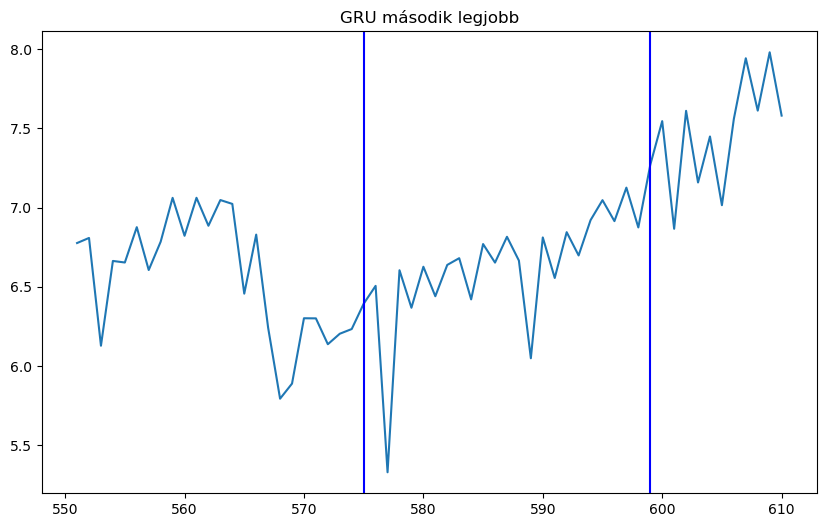

In [240]:
pre = pd.Series(dfGRU['Predikció'][1])
pre=Vilagossz['Total Fossil Fuels Production'].append(pre, ignore_index=True)
pre= pre.iloc[-60:]
pre.plot(figsize=(10,6))
plt.axvline(x = 575, color = 'b', label = 'axvline - full height')
plt.axvline(x = 599, color = 'b', label = 'axvline - full height')
plt.title('GRU második legjobb')

# Sandbox

## Encoder-decoder

In [ ]:
from tensorflow.keras.layers import RepeatVector, TimeDistributed

# Példa adatok: havi hőmérséklet idősor
temperature_data = np.array([15.0, 16.2, 17.8, 20.5, 22.3, 25.1, 28.6, 30.2, 27.5, 22.1, 18.7, 16.3, 14.8, 13.5, 12.9])

# Adatok előkészítése: idősor szekvenálása
def create_sequences(data, time_steps):
    X, y = [], []
    for i in range(len(data) - time_steps):
        X.append(data[i:i + time_steps])
        y.append(data[i + time_steps])
    return np.array(X), np.array(y)

time_steps = 3  # Az előző 3 havi adatot használjuk az előrejelzéshez
X, y = create_sequences(temperature_data, time_steps)

# Adatok felosztása tanító és tesztadathalmazra
train_size = int(0.8 * len(X))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

# Encoder-Decoder LSTM modell létrehozása
model = Sequential()
model.add(LSTM(100, activation='relu', input_shape=(time_steps, 1)))
model.add(RepeatVector(1))  # Az encoder kimenetét ismételjük meg
model.add(LSTM(100, activation='relu', return_sequences=True))
model.add(TimeDistributed(Dense(1)))  # Minden időlépésre egy előrejelzést generálunk

# Modell tanítása
model.compile(optimizer='adam', loss='mse')
model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

# Modell kiértékelése
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = np.array([[14.8, 13.5, 12.9]])  # Példa jövőbeli adatok
predictions = model.predict(future_data)
print("Jövőbeli értékek előrejelzése:")
print(predictions)


In [ ]:
data = np.array(Vilagossz['Total Primary Energy Consumption'].loc[467:586]) # 120 havi adat

# Adatok előkészítése a modell számára
time_steps = 12  # Az előző 12 havi adatot használjuk az előrejelzéshez
X, y = [], []
for i in range(len(data) - time_steps):
    X.append(data[i:i+time_steps])
    y.append(data[i+time_steps])
X = np.array(X).reshape(-1, time_steps, 1)
y = np.array(y)

# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(data))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]



# LSTM modell létrehozása
model = Sequential()
model.add(LSTM(32, activation='relu', input_shape=(time_steps, 1)))
model.add(RepeatVector(1))  # Az encoder kimenetét ismételjük meg
model.add(LSTM(32, activation='relu', return_sequences=True))
model.add(TimeDistributed(Dense(1)))  # Minden időlépésre egy előrejelzést generálunk
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=1000, batch_size=32, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []

for _ in range(12):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)

print("Jövőbeli értékek előrejelzése:")
print(prediction)

## CNN-LSTM

In [ ]:
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten
from tensorflow.keras.layers import Conv2D
from keras.layers import ConvLSTM1D
from keras.layers import ConvLSTM2D
from keras.layers import ConvLSTM3D

In [ ]:
data = np.array(Vilagossz['Total Primary Energy Consumption'].loc[467:586]) # 120 havi adat

# Adatok előkészítése a modell számára
time_steps = 12  # Az előző 12 havi adatot használjuk az előrejelzéshez
X, y = [], []
for i in range(len(data) - time_steps):
    X.append(data[i:i+time_steps])
    y.append(data[i+time_steps])
X = np.array(X).reshape(-1, time_steps, 1)
y = np.array(y)

# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(data))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]



# LSTM modell létrehozása
model = Sequential()
model.add(Conv1D(64, kernel_size=3, activation='relu', input_shape=(time_steps, 1)))
model.add(MaxPooling1D(pool_size=2))
model.add(LSTM(64, activation='relu', return_sequences=True))
model.add(LSTM(64, activation='relu', return_sequences=True))
model.add(LSTM(64, activation='relu'))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=500, batch_size=32, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []

for _ in range(12):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)

print("Jövőbeli értékek előrejelzése:")
print(predictions)

In [ ]:
data = np.array(Vilagossz['Total Primary Energy Consumption'].loc[467:586]) # 120 havi adat

# Adatok előkészítése a modell számára
time_steps = 12  # Az előző 12 havi adatot használjuk az előrejelzéshez
X, y = [], []
for i in range(len(data) - time_steps):
    X.append(data[i:i+time_steps])
    y.append(data[i+time_steps])
X = np.array(X).reshape(-1, time_steps, 1)
y = np.array(y)

# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(data))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]



# LSTM modell létrehozása
model = Sequential()
#model.add(LSTM(64, input_shape=(time_steps, 1)))
#model.add(LSTM(64, activation='relu', return_sequences=True, input_shape=(12, 2)))
#model.add(LSTM(64, activation='relu', return_sequences=True))
model.add(Bidirectional(LSTM(64, activation='relu')))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=1000, batch_size=32, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []

for _ in range(12):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)

print("Jövőbeli értékek előrejelzése:")
print(predictions)

In [ ]:
data = np.array(Vilagossz['Total Primary Energy Consumption'].loc[467:586]) # 120 havi adat

# Adatok előkészítése a modell számára
time_steps = 12  # Az előző 12 havi adatot használjuk az előrejelzéshez
X, y = [], []
for i in range(len(data) - time_steps):
    X.append(data[i:i+time_steps])
    y.append(data[i+time_steps])
X = np.array(X).reshape(-1, time_steps, 1)
y = np.array(y)

# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(data))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]



# LSTM modell létrehozása
model = Sequential()
model.add(Bidirectional(LSTM(64, return_sequences=True), input_shape=(time_steps, 1)))
model.add(Bidirectional(LSTM(64, return_sequences=True)))
model.add(Bidirectional(LSTM(64)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=1000, batch_size=32, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

# Jövőbeli értékek előrejelzése
future_data = data[-time_steps:].reshape(1, time_steps, 1)
predictions = []

for _ in range(12):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :], prediction.reshape(1, 1, 1)), axis=1)

print("Jövőbeli értékek előrejelzése:")
print(predictions)

## Conv LSTM

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import ConvLSTM2D, Dense

# Adatok előkészítése
data = np.array(Vilagossz['Total Primary Energy Consumption'].loc[467:586])  # 120 havi adat

# Adatok előkészítése a modell számára
time_steps = 12  # Az előző 12 havi adatot használjuk az előrejelzéshez
X, y = [], []
for i in range(len(data) - time_steps):
    X.append(data[i:i + time_steps])
    y.append(data[i + time_steps])
n_features = 1
n_seq = 1
n_steps = 12
X = np.array(X).reshape((-1, n_seq, 1, n_steps, n_features))
y = np.array(y)

# Adatok felosztása tanító és tesztadathalmazokra
train_size = int(0.8 * len(data))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]


# define model
model = Sequential()
model.add(ConvLSTM2D(filters=64, kernel_size=(1,2), activation='relu'))
model.add(Flatten())
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Modell tanítása
model.fit(X_train, y_train, epochs=10, batch_size=32, verbose=1)

# Modell kiértékelése a tesztadathalmazon
loss = model.evaluate(X_test, y_test)
print(f"Teszt hiba: {loss}")

future_data = data[-time_steps:].reshape(1, 1, 1, time_steps, 1)
predictions = []

for _ in range(12):
    prediction = model.predict(future_data)
    predictions.append(prediction[0][0])
    future_data = np.concatenate((future_data[:, 1:, :, :, :], prediction.reshape(1, 1, 1, 1, 1)), axis=1)

print("Jövőbeli értékek előrejelzése:")
print(predictions)
